In [1]:
from __future__ import print_function
import glob
from itertools import chain
import os
import cv2
import csv
import random
import zipfile
import os.path as osp
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import torch
from functools import reduce
import torch.nn as nn
from einops import rearrange, repeat
import torch.nn.functional as F
import torch.optim as optim
import torchvision
import pandas as pd
from torchvision.transforms import ToPILImage
# from linformer import Linformer
from PIL import Image
from imgaug import augmenters as iaa
from sklearn.model_selection import train_test_split
from torch.optim.lr_scheduler import StepLR
from torch.utils.data import DataLoader, Dataset
from torchvision import datasets, transforms
from tqdm.notebook import tqdm
# from vit_pytorch.efficient import ViT
# from model import BiSeNet
import torchvision.transforms as transforms
from skimage import io, img_as_float
import timm
from sklearn.metrics import log_loss, f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import accuracy_score


In [2]:
seed = 17
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True

seed_everything(seed)

In [3]:
device = 'cuda'
# device = 'cpu'

In [4]:
fakeavceleb_paths_df = pd.read_csv('File_Path_Dictionaries/fakeavceleb_paths.csv')
celebdf_paths_df = pd.read_csv('File_Path_Dictionaries/celebdf_paths.csv')
dfdc_paths_df = pd.read_csv('File_Path_Dictionaries/dfdc_paths.csv')
faceswap_paths_df = pd.read_csv('File_Path_Dictionaries/ff_paths.csv')


In [5]:
test_set_paths_dictionary = {
                            'FakeAVCeleb': [fakeavceleb_paths_df['Path'], fakeavceleb_paths_df['Label']], 
                            'DFDC': [dfdc_paths_df['Path'], dfdc_paths_df['Label']],
                            'CelebDFV2': [celebdf_paths_df['Path'], celebdf_paths_df['Label']],
                            'FaceForensics': [faceswap_paths_df['Path'], faceswap_paths_df['Label']]
                            }

In [6]:
import timm
models = ['xception', 'res2net101_26w_4s', 'tf_efficientnet_b7_ns', 'vit_base_patch16_224', 'swin_base_patch4_window7_224', 'mvitv2_base']
augs = ['No_Augmentations', 'Random_Cut_Out_Augs', 'Face_Cut_Out_Augs']
datasets = ['FakeAVCeleb', 'FaceForensics', 'DFDC', 'CelebDFV2']


In [7]:
def get_scores(predictions):
    true_labels = []
    predicted_labels = []
    predicted_probs = []

    for key, value in predictions.items():
        predicted_probs.append(value[0])
        true_labels.append(value[2])
        predicted_labels.append(value[1])

    logloss = log_loss(true_labels, predicted_probs)
    auc = roc_auc_score(true_labels, predicted_probs)
    f1 = f1_score(true_labels, predicted_labels)
    
    return logloss, auc, f1

def Evaluate(model, vids_path_dict, dataset, save_path):
    
    imgs_path = vids_path_dict[dataset][0]
    count = 0
    labels_map = ["fake", "real"]
    predictions = {}
    probs = {}
    for img in imgs_path:

        originallabel = None
        if 'fake' in img.split('/')[-3]:
            originallabel = 0
        elif 'real' in img.split('/')[-3]:
            originallabel = 1

        count+=1
        print(count)
        image = img.replace('\\','/')
        img = Image.open(image)
        tfms = transforms.Compose([transforms.Resize((224,224)), transforms.ToTensor(),
               transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))])
        img = tfms(img)
        with torch.no_grad():
            outputs = model(img.unsqueeze(0).to(device))

        predicted_prob = []
        predicted_label = None
        for idx in torch.topk(outputs[0], k=1).indices.tolist():
            prob = torch.softmax(outputs[0], 0)[idx].item()

        if labels_map[idx] == 'fake':
            predicted_prob = 1 - prob
            predictions[image] = [predicted_prob, 0, originallabel]
        else:
            predicted_prob = prob
            print(predicted_prob)
            predictions[image] = [predicted_prob, 1, originallabel]
        print('--------------')
        
    if 'neuraltextures' in image:
        originallabel = 'NeuralTextures'
    elif 'face2face' in image:
        originallabel = 'Face2Face'
    elif 'deepfakes' in image:
        originallabel = 'DeepFakes'
    elif 'faceswap' in image:
        originallabel = 'FaceSwap'
        
    with open(save_path + '.csv', 'w') as csvfile:
        fieldnames = ['ImagePath', 'ProbabilityScore', 'PredictedLabel', 'OriginalLabel']
        writer = csv.DictWriter(csvfile, fieldnames=fieldnames, lineterminator='\n',)

        writer.writeheader()
        for i in range(len(predictions)):
            img = list(predictions)[i]
            writer.writerow({'ImagePath': list(predictions)[i], 'ProbabilityScore': predictions[img][0], 'PredictedLabel': predictions[img][1], 'OriginalLabel': predictions[img][2]})
    
    
    logloss, auc, f1 = get_scores(predictions)
    fieldnames = ['LogLoss','AUC','F1-Score']
    with open(save_path + '.csv', 'a', newline='') as csvfile:
        writer = csv.DictWriter(csvfile, fieldnames=fieldnames, lineterminator='\n',)
        writer.writeheader()
        writer.writerow({'LogLoss': logloss, 'AUC': auc, 'F1-Score': f1})
    torch.cuda.empty_cache()
    #     break

In [10]:
for i in range(4):
    no_evaluation_on = datasets[i]
#     print("NO EVALUATION DATASET IS: ", no_evaluation_on)
    for model_name in models:
        for dataset in datasets:
#             if no_evaluation_on == dataset:
            if 1 == 2:
                pass
            else:
                # Load model weights
                PATH = '../model_weights/supervised_models/' + model_name + '/' + augs[0] + '/' + no_evaluation_on + '/' + '/'
                for file in os.listdir(PATH):
                    if file.endswith(".pth"):
                        model_path = os.path.join(PATH, file)
                        model_path = model_path.replace("//", "/")
                        print(model_path)
                        model = timm.create_model(model_name, pretrained=True, num_classes=2).to(device)
                        model.load_state_dict(torch.load(model_path), strict=True)
                        model.to(device)
                        model.eval()
                        print("loaded " + model_name + " weights!")
                        
                        if dataset == 'FakeAVCeleb':
                            #Evaluation code
                            print('Evaluating ' + model_name + ' on ' + dataset + ' trained on ' + no_evaluation_on)
                            save_path = ('CrossEvaluationTestScores/Image_by_Image_Evaluation/' + model_name + '_trained_on_' + 
                                         no_evaluation_on + '_evaluated_on_' + dataset)
                            Evaluate(model, test_set_paths_dictionary, dataset, save_path)

                        elif dataset == 'DFDC':
                            print('Evaluating ' + model_name + ' on ' + dataset + ' trained on ' + no_evaluation_on)
                            save_path = ('CrossEvaluationTestScores/Image_by_Image_Evaluation/' + model_name + '_trained_on_' + 
                                         no_evaluation_on + '_evaluated_on_' + dataset)
                            Evaluate(model, test_set_paths_dictionary, dataset, save_path)
                            
                        elif dataset == 'CelebDFV2':
                            print('Evaluating ' + model_name + ' on ' + dataset + ' trained on ' + no_evaluation_on)
                            save_path = ('CrossEvaluationTestScores/Image_by_Image_Evaluation/' + model_name + '_trained_on_' + 
                                         no_evaluation_on + '_evaluated_on_' + dataset)
                            Evaluate(model, test_set_paths_dictionary, dataset, save_path)
                            
                        elif dataset == 'FaceForensics':
                            print('Evaluating ' + model_name + ' on ' + dataset + ' trained on ' + no_evaluation_on)
                            save_path = ('CrossEvaluationTestScores/Image_by_Image_Evaluation/' + model_name + '_trained_on_' + 
                                         no_evaluation_on + '_evaluated_on_' + dataset)
                            Evaluate(model, test_set_paths_dictionary, dataset, save_path)
                                
                        print('====================================================================================================')
    print('')
    print('')

../model_weights/supervised_models/xception/No_Augmentations/FakeAVCeleb/5_epochs.pth
loaded xception weights!
Evaluating xception on FakeAVCeleb trained on FakeAVCeleb
1
0.9999983310699463
--------------
2
0.9999973773956299
--------------
3
0.9999929666519165
--------------
4
0.9999570846557617
--------------
5
0.9968775510787964
--------------
6
0.9999716281890869
--------------
7
1.0
--------------
8
0.9988818764686584
--------------
9
1.0
--------------
10
1.0
--------------
11
1.0
--------------
12
0.9999980926513672
--------------
13
0.9999971389770508
--------------
14
0.9999992847442627
--------------
15
0.9966465830802917
--------------
16
0.9999988079071045
--------------
17
0.9998250603675842
--------------
18
0.9999239444732666
--------------
19
0.9999998807907104
--------------
20
0.9997618794441223
--------------
21
0.9999998807907104
--------------
22
0.9983916878700256
--------------
23
0.9999902248382568
--------------
24
0.9994283318519592
--------------
25
0.9999998

240
0.9998131394386292
--------------
241
1.0
--------------
242
0.9999667406082153
--------------
243
0.9997130036354065
--------------
244
0.9999997615814209
--------------
245
0.9999639987945557
--------------
246
0.9998562335968018
--------------
247
0.9999998807907104
--------------
248
0.9999991655349731
--------------
249
0.9999901056289673
--------------
250
1.0
--------------
251
0.9996045231819153
--------------
252
1.0
--------------
253
0.9521450996398926
--------------
254
0.9999822378158569
--------------
255
0.9999974966049194
--------------
256
1.0
--------------
257
0.9999998807907104
--------------
258
1.0
--------------
259
0.9999430179595947
--------------
260
0.9999253749847412
--------------
261
1.0
--------------
262
0.9999938011169434
--------------
263
--------------
264
0.9999994039535522
--------------
265
0.9997299313545227
--------------
266
0.9993390440940857
--------------
267
1.0
--------------
268
0.9999599456787109
--------------
269
0.9999663829803467

489
1.0
--------------
490
0.999794065952301
--------------
491
0.9998328685760498
--------------
492
1.0
--------------
493
0.9999018907546997
--------------
494
0.9999991655349731
--------------
495
0.9993402361869812
--------------
496
0.9999992847442627
--------------
497
0.9999946355819702
--------------
498
0.999921441078186
--------------
499
0.7021068334579468
--------------
500
0.9999974966049194
--------------
501
0.9991641044616699
--------------
502
1.0
--------------
503
0.9999814033508301
--------------
504
0.9999904632568359
--------------
505
0.9999924898147583
--------------
506
0.999921441078186
--------------
507
0.9999996423721313
--------------
508
0.9999860525131226
--------------
509
1.0
--------------
510
0.9990237951278687
--------------
511
0.9999997615814209
--------------
512
1.0
--------------
513
0.9996979236602783
--------------
514
0.9997789263725281
--------------
515
0.9997087121009827
--------------
516
0.9999719858169556
--------------
517
1.0
------

725
0.9999812841415405
--------------
726
0.999167799949646
--------------
727
0.9996501207351685
--------------
728
1.0
--------------
729
0.9999903440475464
--------------
730
0.984531819820404
--------------
731
0.9999897480010986
--------------
732
0.9999996423721313
--------------
733
0.9999988079071045
--------------
734
0.9999955892562866
--------------
735
0.9999665021896362
--------------
736
0.9998370409011841
--------------
737
1.0
--------------
738
0.9999997615814209
--------------
739
0.9992119073867798
--------------
740
1.0
--------------
741
0.9999134540557861
--------------
742
0.9999992847442627
--------------
743
0.999420166015625
--------------
744
0.9999992847442627
--------------
745
0.9999998807907104
--------------
746
0.9999051094055176
--------------
747
1.0
--------------
748
0.9999880790710449
--------------
749
0.9999996423721313
--------------
750
1.0
--------------
751
1.0
--------------
752
0.9978744983673096
--------------
753
0.9999209642410278
------

964
0.9998534917831421
--------------
965
0.9999996423721313
--------------
966
1.0
--------------
967
0.9999998807907104
--------------
968
1.0
--------------
969
1.0
--------------
970
0.9999914169311523
--------------
971
1.0
--------------
972
1.0
--------------
973
0.9999998807907104
--------------
974
0.9855378866195679
--------------
975
1.0
--------------
976
0.9999998807907104
--------------
977
0.999830961227417
--------------
978
1.0
--------------
979
0.999760091304779
--------------
980
1.0
--------------
981
0.9999817609786987
--------------
982
0.9999924898147583
--------------
983
0.9996912479400635
--------------
984
0.9959917664527893
--------------
985
0.9999771118164062
--------------
986
0.9999862909317017
--------------
987
1.0
--------------
988
0.9999687671661377
--------------
989
0.9999090433120728
--------------
990
0.9993681311607361
--------------
991
0.9999947547912598
--------------
992
1.0
--------------
993
0.9999409914016724
--------------
994
0.999997

1203
0.9999939203262329
--------------
1204
0.9999885559082031
--------------
1205
0.9999921321868896
--------------
1206
0.9999994039535522
--------------
1207
0.9999508857727051
--------------
1208
1.0
--------------
1209
0.9998626708984375
--------------
1210
0.9999974966049194
--------------
1211
0.9999998807907104
--------------
1212
1.0
--------------
1213
1.0
--------------
1214
0.9999939203262329
--------------
1215
0.9998971223831177
--------------
1216
0.9999511241912842
--------------
1217
0.999994158744812
--------------
1218
0.9999982118606567
--------------
1219
0.9999786615371704
--------------
1220
0.9999992847442627
--------------
1221
0.9999704360961914
--------------
1222
0.9998513460159302
--------------
1223
1.0
--------------
1224
1.0
--------------
1225
1.0
--------------
1226
1.0
--------------
1227
0.9999878406524658
--------------
1228
0.9999712705612183
--------------
1229
1.0
--------------
1230
0.9996718168258667
--------------
1231
0.9997594952583313
-----

1441
0.9999964237213135
--------------
1442
1.0
--------------
1443
0.9999973773956299
--------------
1444
0.9982282519340515
--------------
1445
0.9993721842765808
--------------
1446
0.9999932050704956
--------------
1447
0.9999850988388062
--------------
1448
0.9993908405303955
--------------
1449
0.9962270259857178
--------------
1450
0.9668151140213013
--------------
1451
0.9995865225791931
--------------
1452
0.9959580302238464
--------------
1453
0.9999594688415527
--------------
1454
0.9999949932098389
--------------
1455
0.9995724558830261
--------------
1456
1.0
--------------
1457
0.9999938011169434
--------------
1458
0.9999994039535522
--------------
1459
0.9999998807907104
--------------
1460
1.0
--------------
1461
0.9999263286590576
--------------
1462
0.9997487664222717
--------------
1463
0.8577461242675781
--------------
1464
0.9999994039535522
--------------
1465
0.9999715089797974
--------------
1466
0.9999972581863403
--------------
1467
1.0
--------------
1468
0.

1677
0.9999995231628418
--------------
1678
0.9999920129776001
--------------
1679
0.9999918937683105
--------------
1680
0.9999899864196777
--------------
1681
0.9999829530715942
--------------
1682
0.9999996423721313
--------------
1683
1.0
--------------
1684
1.0
--------------
1685
0.9997275471687317
--------------
1686
0.9999778270721436
--------------
1687
0.9959238767623901
--------------
1688
0.9992688298225403
--------------
1689
1.0
--------------
1690
0.9999998807907104
--------------
1691
0.9999998807907104
--------------
1692
0.9999998807907104
--------------
1693
0.9999821186065674
--------------
1694
0.9999998807907104
--------------
1695
0.999408483505249
--------------
1696
1.0
--------------
1697
0.9999994039535522
--------------
1698
0.9999997615814209
--------------
1699
0.9999960660934448
--------------
1700
0.9999998807907104
--------------
1701
0.9999908208847046
--------------
1702
0.9999953508377075
--------------
1703
0.9999973773956299
--------------
1704
1.0

1914
0.9999977350234985
--------------
1915
1.0
--------------
1916
0.9766619205474854
--------------
1917
0.9972073435783386
--------------
1918
0.9894800186157227
--------------
1919
0.999763548374176
--------------
1920
0.9999997615814209
--------------
1921
0.9999990463256836
--------------
1922
1.0
--------------
1923
0.9999995231628418
--------------
1924
0.9999648332595825
--------------
1925
1.0
--------------
1926
0.9977467656135559
--------------
1927
0.9999998807907104
--------------
1928
0.9999998807907104
--------------
1929
0.999792754650116
--------------
1930
0.9999997615814209
--------------
1931
0.9998244643211365
--------------
1932
0.9998088479042053
--------------
1933
0.9999957084655762
--------------
1934
0.99880051612854
--------------
1935
1.0
--------------
1936
0.9999663829803467
--------------
1937
0.9999951124191284
--------------
1938
1.0
--------------
1939
0.9997511506080627
--------------
1940
0.9999954700469971
--------------
1941
0.9999990463256836
--

2261
--------------
2262
--------------
2263
--------------
2264
--------------
2265
--------------
2266
--------------
2267
--------------
2268
--------------
2269
--------------
2270
--------------
2271
--------------
2272
--------------
2273
--------------
2274
--------------
2275
--------------
2276
--------------
2277
--------------
2278
--------------
2279
--------------
2280
--------------
2281
--------------
2282
--------------
2283
--------------
2284
--------------
2285
--------------
2286
--------------
2287
--------------
2288
--------------
2289
--------------
2290
--------------
2291
--------------
2292
--------------
2293
--------------
2294
--------------
2295
--------------
2296
--------------
2297
--------------
2298
--------------
2299
--------------
2300
--------------
2301
--------------
2302
--------------
2303
--------------
2304
--------------
2305
--------------
2306
--------------
2307
--------------
2308
--------------
2309
--------------
2310
--------------


2676
--------------
2677
--------------
2678
--------------
2679
--------------
2680
--------------
2681
--------------
2682
--------------
2683
--------------
2684
--------------
2685
--------------
2686
--------------
2687
--------------
2688
--------------
2689
--------------
2690
--------------
2691
--------------
2692
--------------
2693
--------------
2694
--------------
2695
--------------
2696
--------------
2697
--------------
2698
--------------
2699
--------------
2700
--------------
2701
--------------
2702
--------------
2703
--------------
2704
--------------
2705
--------------
2706
--------------
2707
--------------
2708
--------------
2709
--------------
2710
--------------
2711
--------------
2712
--------------
2713
--------------
2714
--------------
2715
--------------
2716
--------------
2717
--------------
2718
--------------
2719
--------------
2720
--------------
2721
--------------
2722
--------------
2723
--------------
2724
--------------
2725
--------------


3086
--------------
3087
--------------
3088
--------------
3089
--------------
3090
--------------
3091
--------------
3092
--------------
3093
--------------
3094
--------------
3095
--------------
3096
--------------
3097
--------------
3098
--------------
3099
--------------
3100
--------------
3101
--------------
3102
--------------
3103
--------------
3104
--------------
3105
--------------
3106
--------------
3107
--------------
3108
--------------
3109
--------------
3110
--------------
3111
--------------
3112
--------------
3113
--------------
3114
--------------
3115
--------------
3116
--------------
3117
--------------
3118
--------------
3119
--------------
3120
--------------
3121
--------------
3122
--------------
3123
--------------
3124
--------------
3125
--------------
3126
--------------
3127
--------------
3128
--------------
3129
--------------
3130
--------------
3131
--------------
3132
--------------
3133
--------------
3134
--------------
3135
--------------


3497
--------------
3498
--------------
3499
--------------
3500
--------------
3501
--------------
3502
--------------
3503
--------------
3504
--------------
3505
--------------
3506
--------------
3507
--------------
3508
--------------
3509
--------------
3510
--------------
3511
--------------
3512
--------------
3513
--------------
3514
--------------
3515
--------------
3516
--------------
3517
--------------
3518
--------------
3519
--------------
3520
--------------
3521
--------------
3522
--------------
3523
--------------
3524
--------------
3525
--------------
3526
--------------
3527
--------------
3528
--------------
3529
--------------
3530
--------------
3531
--------------
3532
--------------
3533
--------------
3534
--------------
3535
--------------
3536
--------------
3537
--------------
3538
--------------
3539
--------------
3540
--------------
3541
--------------
3542
--------------
3543
--------------
3544
--------------
3545
--------------
3546
--------------


3908
--------------
3909
--------------
3910
--------------
3911
--------------
3912
--------------
3913
--------------
3914
--------------
3915
--------------
3916
--------------
3917
--------------
3918
--------------
3919
--------------
3920
--------------
3921
--------------
3922
--------------
3923
--------------
3924
--------------
3925
--------------
3926
--------------
3927
--------------
3928
--------------
3929
--------------
3930
--------------
3931
--------------
3932
--------------
3933
--------------
3934
--------------
3935
--------------
3936
--------------
3937
--------------
3938
--------------
3939
--------------
3940
--------------
3941
--------------
3942
--------------
3943
--------------
3944
--------------
3945
--------------
3946
--------------
3947
--------------
3948
--------------
3949
--------------
3950
--------------
3951
--------------
3952
--------------
3953
--------------
3954
--------------
3955
--------------
3956
--------------
3957
--------------


217
0.9999997615814209
--------------
218
0.9999995231628418
--------------
219
0.9993973970413208
--------------
220
0.9999986886978149
--------------
221
0.9999566078186035
--------------
222
1.0
--------------
223
1.0
--------------
224
0.9999964237213135
--------------
225
1.0
--------------
226
0.9999792575836182
--------------
227
1.0
--------------
228
0.9999963045120239
--------------
229
1.0
--------------
230
0.9994582533836365
--------------
231
0.9999942779541016
--------------
232
1.0
--------------
233
1.0
--------------
234
1.0
--------------
235
1.0
--------------
236
1.0
--------------
237
1.0
--------------
238
1.0
--------------
239
1.0
--------------
240
1.0
--------------
241
0.9999991655349731
--------------
242
0.9999978542327881
--------------
243
1.0
--------------
244
0.9982768297195435
--------------
245
1.0
--------------
246
0.9999990463256836
--------------
247
0.9999998807907104
--------------
248
0.9999983310699463
--------------
249
0.9999996423721313
-

498
0.9999998807907104
--------------
499
0.905560314655304
--------------
500
1.0
--------------
501
1.0
--------------
502
0.999143123626709
--------------
503
1.0
--------------
504
0.9999936819076538
--------------
505
1.0
--------------
506
0.9999994039535522
--------------
507
1.0
--------------
508
0.999996542930603
--------------
509
1.0
--------------
510
1.0
--------------
511
1.0
--------------
512
1.0
--------------
513
1.0
--------------
514
1.0
--------------
515
0.9999996423721313
--------------
516
1.0
--------------
517
1.0
--------------
518
1.0
--------------
519
0.9947493672370911
--------------
520
0.9999067783355713
--------------
521
1.0
--------------
522
0.9999996423721313
--------------
523
1.0
--------------
524
0.9999783039093018
--------------
525
0.9999982118606567
--------------
526
0.9999940395355225
--------------
527
0.9999985694885254
--------------
528
0.9999985694885254
--------------
529
0.9967688322067261
--------------
530
0.9999951124191284
----

769
1.0
--------------
770
1.0
--------------
771
0.9999998807907104
--------------
772
0.9999915361404419
--------------
773
0.9999797344207764
--------------
774
0.9999194145202637
--------------
775
1.0
--------------
776
0.9999997615814209
--------------
777
1.0
--------------
778
1.0
--------------
779
0.6896037459373474
--------------
780
0.9999979734420776
--------------
781
1.0
--------------
782
0.9999996423721313
--------------
783
1.0
--------------
784
0.9999936819076538
--------------
785
1.0
--------------
786
1.0
--------------
787
0.997266411781311
--------------
788
1.0
--------------
789
1.0
--------------
790
1.0
--------------
791
1.0
--------------
792
0.9999997615814209
--------------
793
1.0
--------------
794
0.9999614953994751
--------------
795
1.0
--------------
796
1.0
--------------
797
1.0
--------------
798
0.9995802044868469
--------------
799
0.99996018409729
--------------
800
1.0
--------------
801
0.9999979734420776
--------------
802
0.9998822212219

1045
1.0
--------------
1046
1.0
--------------
1047
0.9998216032981873
--------------
1048
0.9999991655349731
--------------
1049
1.0
--------------
1050
0.9982761144638062
--------------
1051
0.9999998807907104
--------------
1052
1.0
--------------
1053
1.0
--------------
1054
0.9999974966049194
--------------
1055
1.0
--------------
1056
0.9999991655349731
--------------
1057
1.0
--------------
1058
0.9999825954437256
--------------
1059
0.9752284288406372
--------------
1060
1.0
--------------
1061
1.0
--------------
1062
1.0
--------------
1063
1.0
--------------
1064
1.0
--------------
1065
0.9999997615814209
--------------
1066
0.9999974966049194
--------------
1067
1.0
--------------
1068
1.0
--------------
1069
1.0
--------------
1070
1.0
--------------
1071
0.9999998807907104
--------------
1072
0.9995644688606262
--------------
1073
1.0
--------------
1074
1.0
--------------
1075
1.0
--------------
1076
1.0
--------------
1077
0.9999998807907104
--------------
1078
1.0
----

1322
0.9999744892120361
--------------
1323
1.0
--------------
1324
1.0
--------------
1325
0.9925926327705383
--------------
1326
0.999988317489624
--------------
1327
1.0
--------------
1328
0.9999998807907104
--------------
1329
0.9999967813491821
--------------
1330
0.9999998807907104
--------------
1331
0.999995231628418
--------------
1332
0.999854326248169
--------------
1333
0.9845079183578491
--------------
1334
0.9999994039535522
--------------
1335
0.9999921321868896
--------------
1336
0.9999933242797852
--------------
1337
0.9999868869781494
--------------
1338
0.9983364939689636
--------------
1339
1.0
--------------
1340
1.0
--------------
1341
1.0
--------------
1342
1.0
--------------
1343
0.9999997615814209
--------------
1344
1.0
--------------
1345
1.0
--------------
1346
0.9999685287475586
--------------
1347
0.9999659061431885
--------------
1348
1.0
--------------
1349
0.9999991655349731
--------------
1350
1.0
--------------
1351
0.9999998807907104
-------------

1588
1.0
--------------
1589
0.9998148083686829
--------------
1590
1.0
--------------
1591
1.0
--------------
1592
1.0
--------------
1593
1.0
--------------
1594
0.9870834350585938
--------------
1595
1.0
--------------
1596
0.9999940395355225
--------------
1597
0.9999991655349731
--------------
1598
1.0
--------------
1599
1.0
--------------
1600
1.0
--------------
1601
0.9999982118606567
--------------
1602
1.0
--------------
1603
0.999976396560669
--------------
1604
0.9999336004257202
--------------
1605
0.9989063739776611
--------------
1606
1.0
--------------
1607
1.0
--------------
1608
0.9999866485595703
--------------
1609
1.0
--------------
1610
0.9998334646224976
--------------
1611
1.0
--------------
1612
1.0
--------------
1613
1.0
--------------
1614
0.9999998807907104
--------------
1615
1.0
--------------
1616
0.999955415725708
--------------
1617
1.0
--------------
1618
0.9999998807907104
--------------
1619
0.7948610186576843
--------------
1620
1.0
--------------


1861
1.0
--------------
1862
0.9999998807907104
--------------
1863
1.0
--------------
1864
1.0
--------------
1865
1.0
--------------
1866
0.9999997615814209
--------------
1867
0.9999198913574219
--------------
1868
1.0
--------------
1869
0.9999737739562988
--------------
1870
0.9999797344207764
--------------
1871
0.9999985694885254
--------------
1872
1.0
--------------
1873
0.9999427795410156
--------------
1874
0.9999953508377075
--------------
1875
1.0
--------------
1876
1.0
--------------
1877
1.0
--------------
1878
1.0
--------------
1879
0.9999992847442627
--------------
1880
0.9999583959579468
--------------
1881
1.0
--------------
1882
0.9999998807907104
--------------
1883
1.0
--------------
1884
0.9997968077659607
--------------
1885
0.9999395608901978
--------------
1886
0.9999997615814209
--------------
1887
1.0
--------------
1888
1.0
--------------
1889
1.0
--------------
1890
1.0
--------------
1891
1.0
--------------
1892
1.0
--------------
1893
1.0
-------------

0.9999991655349731
--------------
2141
1.0
--------------
2142
0.9999985694885254
--------------
2143
1.0
--------------
2144
1.0
--------------
2145
1.0
--------------
2146
0.9999998807907104
--------------
2147
1.0
--------------
2148
1.0
--------------
2149
0.9999896287918091
--------------
2150
1.0
--------------
2151
0.9999998807907104
--------------
2152
1.0
--------------
2153
1.0
--------------
2154
1.0
--------------
2155
1.0
--------------
2156
1.0
--------------
2157
1.0
--------------
2158
1.0
--------------
2159
1.0
--------------
2160
1.0
--------------
2161
0.9999963045120239
--------------
2162
1.0
--------------
2163
1.0
--------------
2164
0.9999022483825684
--------------
2165
1.0
--------------
2166
1.0
--------------
2167
0.9999769926071167
--------------
2168
0.9998859167098999
--------------
2169
1.0
--------------
2170
1.0
--------------
2171
1.0
--------------
2172
0.9999998807907104
--------------
2173
1.0
--------------
2174
1.0
--------------
2175
1.0
------

2432
1.0
--------------
2433
0.9999181032180786
--------------
2434
1.0
--------------
2435
0.9999961853027344
--------------
2436
1.0
--------------
2437
0.9999963045120239
--------------
2438
1.0
--------------
2439
0.9999935626983643
--------------
2440
1.0
--------------
2441
1.0
--------------
2442
1.0
--------------
2443
1.0
--------------
2444
1.0
--------------
2445
1.0
--------------
2446
1.0
--------------
2447
1.0
--------------
2448
1.0
--------------
2449
1.0
--------------
2450
1.0
--------------
2451
1.0
--------------
2452
0.9999663829803467
--------------
2453
0.9999998807907104
--------------
2454
0.9999971389770508
--------------
2455
1.0
--------------
2456
0.9999686479568481
--------------
2457
1.0
--------------
2458
0.9999909400939941
--------------
2459
1.0
--------------
2460
1.0
--------------
2461
0.9999116659164429
--------------
2462
1.0
--------------
2463
1.0
--------------
2464
0.9999970197677612
--------------
2465
0.9999998807907104
--------------
2466

2671
0.9999890327453613
--------------
2672
0.9999897480010986
--------------
2673
0.9998377561569214
--------------
2674
0.9658942222595215
--------------
2675
0.9879209995269775
--------------
2676
0.9999804496765137
--------------
2677
0.9583267569541931
--------------
2678
0.7985367774963379
--------------
2679
1.0
--------------
2680
0.9999496936798096
--------------
2681
0.9560285210609436
--------------
2682
0.9999856948852539
--------------
2683
1.0
--------------
2684
0.9964828491210938
--------------
2685
0.9999377727508545
--------------
2686
0.9999089241027832
--------------
2687
0.9999690055847168
--------------
2688
0.9999878406524658
--------------
2689
0.9989179372787476
--------------
2690
0.9992018342018127
--------------
2691
0.9999945163726807
--------------
2692
0.9999500513076782
--------------
2693
0.9972776770591736
--------------
2694
0.9716677665710449
--------------
2695
0.9917112588882446
--------------
2696
0.9955573678016663
--------------
2697
0.780307054

2890
0.9999452829360962
--------------
2891
1.0
--------------
2892
0.99997878074646
--------------
2893
0.9990478157997131
--------------
2894
0.8308085203170776
--------------
2895
0.9999803304672241
--------------
2896
0.9999978542327881
--------------
2897
0.9973574280738831
--------------
2898
0.9987205862998962
--------------
2899
0.9999994039535522
--------------
2900
0.803534984588623
--------------
2901
0.9998621940612793
--------------
2902
0.9999995231628418
--------------
2903
0.9999960660934448
--------------
2904
0.9999778270721436
--------------
2905
0.9710786938667297
--------------
2906
0.9990196228027344
--------------
2907
1.0
--------------
2908
0.9186958074569702
--------------
2909
0.9999879598617554
--------------
2910
0.8606529831886292
--------------
2911
0.685538649559021
--------------
2912
0.9996697902679443
--------------
2913
1.0
--------------
2914
0.9952502250671387
--------------
2915
0.9997925162315369
--------------
2916
0.9967585206031799
-----------

3130
0.9998769760131836
--------------
3131
0.9997146725654602
--------------
3132
1.0
--------------
3133
1.0
--------------
3134
0.9999982118606567
--------------
3135
1.0
--------------
3136
0.9981386661529541
--------------
3137
1.0
--------------
3138
0.9999988079071045
--------------
3139
1.0
--------------
3140
0.9999985694885254
--------------
3141
1.0
--------------
3142
0.999974250793457
--------------
3143
0.9999998807907104
--------------
3144
0.9999997615814209
--------------
3145
1.0
--------------
3146
0.9963735938072205
--------------
3147
0.9999301433563232
--------------
3148
0.9999991655349731
--------------
3149
0.999995231628418
--------------
3150
1.0
--------------
3151
0.9999953508377075
--------------
3152
1.0
--------------
3153
0.9999793767929077
--------------
3154
0.9999995231628418
--------------
3155
0.9992826581001282
--------------
3156
0.9999974966049194
--------------
3157
1.0
--------------
3158
0.9999998807907104
--------------
3159
0.99999797344207

3378
0.9999758005142212
--------------
3379
0.9999997615814209
--------------
3380
0.9999998807907104
--------------
3381
1.0
--------------
3382
0.9999998807907104
--------------
3383
0.9999998807907104
--------------
3384
0.9999994039535522
--------------
3385
0.9999982118606567
--------------
3386
1.0
--------------
3387
0.9956445693969727
--------------
3388
0.999976396560669
--------------
3389
0.9968169331550598
--------------
3390
0.999997615814209
--------------
3391
1.0
--------------
3392
1.0
--------------
3393
0.9999990463256836
--------------
3394
1.0
--------------
3395
0.9999879598617554
--------------
3396
1.0
--------------
3397
1.0
--------------
3398
0.9999986886978149
--------------
3399
0.9958940744400024
--------------
3400
0.9998600482940674
--------------
3401
0.9999920129776001
--------------
3402
0.9999992847442627
--------------
3403
0.999029278755188
--------------
3404
0.9999326467514038
--------------
3405
0.9998633861541748
--------------
3406
1.0
-------

0.9999433755874634
--------------
3617
0.9999995231628418
--------------
3618
0.9999983310699463
--------------
3619
0.9999160766601562
--------------
3620
0.9999980926513672
--------------
3621
1.0
--------------
3622
1.0
--------------
3623
1.0
--------------
3624
1.0
--------------
3625
1.0
--------------
3626
1.0
--------------
3627
0.9999988079071045
--------------
3628
0.9990197420120239
--------------
3629
0.9917245507240295
--------------
3630
0.9999799728393555
--------------
3631
0.9998855590820312
--------------
3632
1.0
--------------
3633
0.999994158744812
--------------
3634
0.9999380111694336
--------------
3635
0.9999666213989258
--------------
3636
0.9999990463256836
--------------
3637
1.0
--------------
3638
1.0
--------------
3639
0.9999998807907104
--------------
3640
0.9999995231628418
--------------
3641
0.9617297649383545
--------------
3642
0.9999998807907104
--------------
3643
0.6086118817329407
--------------
3644
0.9997666478157043
--------------
3645
0.999

3854
0.999883770942688
--------------
3855
0.9955359697341919
--------------
3856
0.9999961853027344
--------------
3857
0.9996095299720764
--------------
3858
0.9999921321868896
--------------
3859
1.0
--------------
3860
0.9999940395355225
--------------
3861
0.9997244477272034
--------------
3862
0.999944806098938
--------------
3863
1.0
--------------
3864
0.9990504384040833
--------------
3865
0.9979920387268066
--------------
3866
0.9999990463256836
--------------
3867
0.9999899864196777
--------------
3868
0.9999990463256836
--------------
3869
0.9999614953994751
--------------
3870
0.9999997615814209
--------------
3871
0.9998102784156799
--------------
3872
0.999758780002594
--------------
3873
0.9975078105926514
--------------
3874
0.9988620281219482
--------------
3875
1.0
--------------
3876
0.998515784740448
--------------
3877
0.9999967813491821
--------------
3878
1.0
--------------
3879
0.9999823570251465
--------------
3880
1.0
--------------
3881
1.0
--------------
38

92
0.9991322159767151
--------------
93
0.9999998807907104
--------------
94
0.999864935874939
--------------
95
0.999997615814209
--------------
96
0.9995272159576416
--------------
97
1.0
--------------
98
0.9999990463256836
--------------
99
1.0
--------------
100
0.9991612434387207
--------------
101
1.0
--------------
102
1.0
--------------
103
1.0
--------------
104
0.7546445727348328
--------------
105
1.0
--------------
106
0.9999998807907104
--------------
107
0.9999986886978149
--------------
108
0.9991070628166199
--------------
109
0.9855594635009766
--------------
110
0.9675105810165405
--------------
111
0.9995495676994324
--------------
112
0.999933123588562
--------------
113
0.9999533891677856
--------------
114
0.9999086856842041
--------------
115
1.0
--------------
116
0.9999997615814209
--------------
117
1.0
--------------
118
1.0
--------------
119
1.0
--------------
120
1.0
--------------
121
0.9999990463256836
--------------
122
0.9999886751174927
-------------

1.0
--------------
354
1.0
--------------
355
1.0
--------------
356
0.9999995231628418
--------------
357
0.9999473094940186
--------------
358
0.9988896250724792
--------------
359
0.9999995231628418
--------------
360
1.0
--------------
361
1.0
--------------
362
0.9999942779541016
--------------
363
0.9999997615814209
--------------
364
0.9999998807907104
--------------
365
0.9989184141159058
--------------
366
0.9999979734420776
--------------
367
1.0
--------------
368
0.9999185800552368
--------------
369
0.9999970197677612
--------------
370
0.9999542236328125
--------------
371
0.9999982118606567
--------------
372
1.0
--------------
373
0.9999880790710449
--------------
374
1.0
--------------
375
1.0
--------------
376
0.9998854398727417
--------------
377
0.9999896287918091
--------------
378
0.9999803304672241
--------------
379
1.0
--------------
380
1.0
--------------
381
1.0
--------------
382
0.9999994039535522
--------------
383
0.9999995231628418
--------------
384
1.

--------------
609
0.9994437098503113
--------------
610
0.9929360747337341
--------------
611
0.9997965693473816
--------------
612
0.9998855590820312
--------------
613
0.9999986886978149
--------------
614
1.0
--------------
615
0.9999822378158569
--------------
616
0.9988183379173279
--------------
617
0.9999655485153198
--------------
618
1.0
--------------
619
0.9999754428863525
--------------
620
1.0
--------------
621
0.9999833106994629
--------------
622
1.0
--------------
623
0.9999997615814209
--------------
624
1.0
--------------
625
1.0
--------------
626
1.0
--------------
627
0.9679436087608337
--------------
628
0.9999998807907104
--------------
629
0.9999377727508545
--------------
630
1.0
--------------
631
0.9999997615814209
--------------
632
0.999995231628418
--------------
633
0.9996883869171143
--------------
634
0.9999995231628418
--------------
635
1.0
--------------
636
0.9999300241470337
--------------
637
0.9999988079071045
--------------
638
0.9999891519546

857
0.9999996423721313
--------------
858
0.9999985694885254
--------------
859
0.9999996423721313
--------------
860
0.9999982118606567
--------------
861
0.9999985694885254
--------------
862
0.9999885559082031
--------------
863
0.5824003219604492
--------------
864
1.0
--------------
865
1.0
--------------
866
0.999933123588562
--------------
867
1.0
--------------
868
0.9999936819076538
--------------
869
1.0
--------------
870
0.9789659976959229
--------------
871
1.0
--------------
872
0.9912415742874146
--------------
873
0.9999648332595825
--------------
874
0.9999722242355347
--------------
875
1.0
--------------
876
1.0
--------------
877
0.9999990463256836
--------------
878
0.9863103628158569
--------------
879
0.7845468521118164
--------------
880
0.9999924898147583
--------------
881
0.9999998807907104
--------------
882
1.0
--------------
883
1.0
--------------
884
0.9999806880950928
--------------
885
0.9999988079071045
--------------
886
0.9999549388885498
-----------

1110
1.0
--------------
1111
0.9992792010307312
--------------
1112
0.9999998807907104
--------------
1113
0.9999998807907104
--------------
1114
1.0
--------------
1115
0.9999998807907104
--------------
1116
0.9999998807907104
--------------
1117
0.9999675750732422
--------------
1118
0.999982476234436
--------------
1119
0.9996671676635742
--------------
1120
1.0
--------------
1121
0.9997813105583191
--------------
1122
0.9999603033065796
--------------
1123
1.0
--------------
1124
0.9999923706054688
--------------
1125
0.9999233484268188
--------------
1126
0.9999852180480957
--------------
1127
0.9999998807907104
--------------
1128
1.0
--------------
1129
0.9999997615814209
--------------
1130
0.9245187640190125
--------------
1131
0.9999991655349731
--------------
1132
0.9999990463256836
--------------
1133
0.9999842643737793
--------------
1134
0.9981167316436768
--------------
1135
0.9984281063079834
--------------
1136
0.9999998807907104
--------------
1137
0.9999970197677612

1350
1.0
--------------
1351
0.9991050362586975
--------------
1352
0.9999995231628418
--------------
1353
1.0
--------------
1354
1.0
--------------
1355
1.0
--------------
1356
0.999990701675415
--------------
1357
0.999962568283081
--------------
1358
0.9999971389770508
--------------
1359
1.0
--------------
1360
0.997469425201416
--------------
1361
0.9999998807907104
--------------
1362
0.9999964237213135
--------------
1363
1.0
--------------
1364
0.9999858140945435
--------------
1365
1.0
--------------
1366
0.9999699592590332
--------------
1367
0.9999994039535522
--------------
1368
1.0
--------------
1369
0.7658044099807739
--------------
1370
1.0
--------------
1371
0.9999995231628418
--------------
1372
0.995157778263092
--------------
1373
0.9999998807907104
--------------
1374
1.0
--------------
1375
0.9999827146530151
--------------
1376
0.9999301433563232
--------------
1377
0.9999945163726807
--------------
1378
0.9999960660934448
--------------
1379
0.9999998807907104

1593
0.9982151985168457
--------------
1594
0.9999812841415405
--------------
1595
0.9932025671005249
--------------
1596
0.9999996423721313
--------------
1597
0.9999853372573853
--------------
1598
1.0
--------------
1599
1.0
--------------
1600
0.9999997615814209
--------------
1601
0.9999862909317017
--------------
1602
0.9999997615814209
--------------
1603
1.0
--------------
1604
0.9999969005584717
--------------
1605
1.0
--------------
1606
0.9999998807907104
--------------
1607
0.9999991655349731
--------------
1608
1.0
--------------
1609
0.999984622001648
--------------
1610
0.9999995231628418
--------------
1611
0.9999971389770508
--------------
1612
0.9999995231628418
--------------
1613
0.9999998807907104
--------------
1614
1.0
--------------
1615
0.9999836683273315
--------------
1616
0.999839186668396
--------------
1617
1.0
--------------
1618
0.9999998807907104
--------------
1619
0.9998594522476196
--------------
1620
0.9999628067016602
--------------
1621
0.99979251

1.0
--------------
1837
0.999983549118042
--------------
1838
1.0
--------------
1839
0.9995923638343811
--------------
1840
1.0
--------------
1841
0.8383737206459045
--------------
1842
0.9999996423721313
--------------
1843
0.9605359435081482
--------------
1844
0.9999574422836304
--------------
1845
0.9999967813491821
--------------
1846
0.9996935129165649
--------------
1847
0.9999967813491821
--------------
1848
0.9892036318778992
--------------
1849
0.999653697013855
--------------
1850
0.9998326301574707
--------------
1851
0.9999980926513672
--------------
1852
0.9999898672103882
--------------
1853
1.0
--------------
1854
0.9999943971633911
--------------
1855
0.9999996423721313
--------------
1856
0.9998466968536377
--------------
1857
0.9999990463256836
--------------
1858
1.0
--------------
1859
0.9999992847442627
--------------
1860
0.9998503923416138
--------------
1861
0.9995861649513245
--------------
1862
1.0
--------------
1863
1.0
--------------
1864
1.0
-----------

2079
0.9999946355819702
--------------
2080
0.9999997615814209
--------------
2081
0.9915946125984192
--------------
2082
1.0
--------------
2083
1.0
--------------
2084
0.9999849796295166
--------------
2085
1.0
--------------
2086
0.9999924898147583
--------------
2087
0.9924739003181458
--------------
2088
0.9958272576332092
--------------
2089
0.8100758790969849
--------------
2090
0.9999998807907104
--------------
2091
1.0
--------------
2092
0.9999967813491821
--------------
2093
0.9907387495040894
--------------
2094
0.9999607801437378
--------------
2095
0.9999996423721313
--------------
2096
1.0
--------------
2097
1.0
--------------
2098
0.9994338154792786
--------------
2099
0.9997778534889221
--------------
2100
0.9831827878952026
--------------
2101
1.0
--------------
2102
1.0
--------------
2103
1.0
--------------
2104
0.9995083808898926
--------------
2105
0.9999997615814209
--------------
2106
1.0
--------------
2107
0.9839994311332703
--------------
2108
0.801789820194

0.9998395442962646
--------------
2321
--------------
2322
1.0
--------------
2323
0.9999977350234985
--------------
2324
1.0
--------------
2325
0.9930792450904846
--------------
2326
0.9891766905784607
--------------
2327
0.999997615814209
--------------
2328
0.9999816417694092
--------------
2329
0.9999921321868896
--------------
2330
0.9995231628417969
--------------
2331
0.9999996423721313
--------------
2332
0.8271093368530273
--------------
2333
1.0
--------------
2334
1.0
--------------
2335
0.9999244213104248
--------------
2336
0.9999958276748657
--------------
2337
0.9995021820068359
--------------
2338
1.0
--------------
2339
0.9999877214431763
--------------
2340
0.9999412298202515
--------------
2341
0.6938098669052124
--------------
2342
0.9482781887054443
--------------
2343
1.0
--------------
2344
0.9999889135360718
--------------
2345
0.9999964237213135
--------------
2346
0.6077553629875183
--------------
2347
0.6946473121643066
--------------
2348
0.9979488253593445

2569
0.9999783039093018
--------------
2570
1.0
--------------
2571
0.8928458094596863
--------------
2572
0.8812733292579651
--------------
2573
0.9999943971633911
--------------
2574
0.9960875511169434
--------------
2575
0.9999874830245972
--------------
2576
0.9998045563697815
--------------
2577
0.9892503023147583
--------------
2578
0.9428265690803528
--------------
2579
1.0
--------------
2580
0.9999911785125732
--------------
2581
0.9977808594703674
--------------
2582
0.9999998807907104
--------------
2583
0.9998784065246582
--------------
2584
0.9999874830245972
--------------
2585
1.0
--------------
2586
0.9999312162399292
--------------
2587
0.9999998807907104
--------------
2588
0.9999980926513672
--------------
2589
0.9999681711196899
--------------
2590
0.999988317489624
--------------
2591
1.0
--------------
2592
1.0
--------------
2593
1.0
--------------
2594
1.0
--------------
2595
0.9999116659164429
--------------
2596
0.999914288520813
--------------
2597
0.99999964

2810
0.8169983625411987
--------------
2811
1.0
--------------
2812
0.9999830722808838
--------------
2813
0.9999909400939941
--------------
2814
0.9999997615814209
--------------
2815
0.9649516344070435
--------------
2816
0.9999953508377075
--------------
2817
0.9992936849594116
--------------
2818
0.9999480247497559
--------------
2819
1.0
--------------
2820
1.0
--------------
2821
0.9999884366989136
--------------
2822
1.0
--------------
2823
1.0
--------------
2824
1.0
--------------
2825
0.9996427297592163
--------------
2826
--------------
2827
1.0
--------------
2828
0.9972639083862305
--------------
2829
1.0
--------------
2830
1.0
--------------
2831
0.9989482760429382
--------------
2832
0.9999072551727295
--------------
2833
1.0
--------------
2834
0.9997721314430237
--------------
2835
1.0
--------------
2836
0.9998787641525269
--------------
2837
0.9923313856124878
--------------
2838
0.9995161294937134
--------------
2839
1.0
--------------
2840
0.9999861717224121
-----

3051
0.9988569021224976
--------------
3052
0.9999631643295288
--------------
3053
1.0
--------------
3054
1.0
--------------
3055
1.0
--------------
3056
0.9999673366546631
--------------
3057
0.9999978542327881
--------------
3058
0.9999997615814209
--------------
3059
0.9006364345550537
--------------
3060
1.0
--------------
3061
1.0
--------------
3062
0.9995623230934143
--------------
3063
1.0
--------------
3064
1.0
--------------
3065
0.9999295473098755
--------------
3066
0.9999994039535522
--------------
3067
1.0
--------------
3068
0.9999995231628418
--------------
3069
0.9371263980865479
--------------
3070
0.9089307188987732
--------------
3071
0.9999582767486572
--------------
3072
1.0
--------------
3073
0.9999972581863403
--------------
3074
0.9999903440475464
--------------
3075
0.9999979734420776
--------------
3076
1.0
--------------
3077
0.9999843835830688
--------------
3078
0.9999934434890747
--------------
3079
0.9998302459716797
--------------
3080
0.999999165534

3291
0.999994158744812
--------------
3292
0.9999866485595703
--------------
3293
0.9692294001579285
--------------
3294
1.0
--------------
3295
0.9999179840087891
--------------
3296
0.9999994039535522
--------------
3297
1.0
--------------
3298
1.0
--------------
3299
0.7777233719825745
--------------
3300
0.9869390726089478
--------------
3301
0.9846090078353882
--------------
3302
1.0
--------------
3303
0.9999980926513672
--------------
3304
0.9993667006492615
--------------
3305
1.0
--------------
3306
1.0
--------------
3307
1.0
--------------
3308
0.999996542930603
--------------
3309
0.999593198299408
--------------
3310
0.9999102354049683
--------------
3311
0.8963392972946167
--------------
3312
1.0
--------------
3313
0.9993621706962585
--------------
3314
0.995415210723877
--------------
3315
0.9997983574867249
--------------
3316
0.9999982118606567
--------------
3317
0.9999343156814575
--------------
3318
0.998363196849823
--------------
3319
0.9999994039535522
---------

3536
0.9598265886306763
--------------
3537
0.9999936819076538
--------------
3538
0.9999982118606567
--------------
3539
0.9493531584739685
--------------
3540
0.9999992847442627
--------------
3541
0.9999598264694214
--------------
3542
0.9991718530654907
--------------
3543
0.9999978542327881
--------------
3544
1.0
--------------
3545
0.9999997615814209
--------------
3546
0.9988204836845398
--------------
3547
0.976906955242157
--------------
3548
0.9985429048538208
--------------
3549
1.0
--------------
3550
0.7353201508522034
--------------
3551
1.0
--------------
3552
0.9983955025672913
--------------
3553
0.9999998807907104
--------------
3554
0.9988577365875244
--------------
3555
0.9999841451644897
--------------
3556
0.999998927116394
--------------
3557
0.9999032020568848
--------------
3558
0.9137933254241943
--------------
3559
0.9999995231628418
--------------
3560
0.9999290704727173
--------------
3561
0.999997615814209
--------------
3562
0.999994158744812
-----------

3779
0.9999774694442749
--------------
3780
1.0
--------------
3781
0.5678223967552185
--------------
3782
0.8714202642440796
--------------
3783
1.0
--------------
3784
0.9769590497016907
--------------
3785
0.9999995231628418
--------------
3786
1.0
--------------
3787
0.9999996423721313
--------------
3788
1.0
--------------
3789
0.9993438124656677
--------------
3790
0.9998970031738281
--------------
3791
0.9985197186470032
--------------
3792
1.0
--------------
3793
1.0
--------------
3794
0.9962649941444397
--------------
3795
0.9988829493522644
--------------
3796
0.9999995231628418
--------------
3797
0.7090557217597961
--------------
3798
1.0
--------------
3799
0.9997449517250061
--------------
3800
0.9997922778129578
--------------
3801
0.9995620846748352
--------------
3802
0.785334587097168
--------------
3803
1.0
--------------
3804
0.9999982118606567
--------------
3805
0.9999983310699463
--------------
3806
0.9999978542327881
--------------
3807
0.9915687441825867
-----

13
--------------
14
--------------
15
--------------
16
--------------
17
--------------
18
--------------
19
--------------
20
--------------
21
--------------
22
--------------
23
--------------
24
--------------
25
--------------
26
--------------
27
--------------
28
--------------
29
--------------
30
--------------
31
--------------
32
--------------
33
0.5686624646186829
--------------
34
0.7541613578796387
--------------
35
0.9467621445655823
--------------
36
--------------
37
0.6575714945793152
--------------
38
--------------
39
0.7726957201957703
--------------
40
0.5276659727096558
--------------
41
--------------
42
--------------
43
--------------
44
--------------
45
--------------
46
--------------
47
--------------
48
--------------
49
--------------
50
--------------
51
--------------
52
--------------
53
--------------
54
--------------
55
--------------
56
--------------
57
--------------
58
--------------
59
--------------
60
--------------
61
--------------
62
-

412
--------------
413
0.8184524178504944
--------------
414
0.9238994717597961
--------------
415
0.9737305641174316
--------------
416
--------------
417
--------------
418
--------------
419
--------------
420
--------------
421
--------------
422
--------------
423
--------------
424
--------------
425
--------------
426
--------------
427
--------------
428
--------------
429
--------------
430
--------------
431
--------------
432
--------------
433
--------------
434
--------------
435
--------------
436
--------------
437
--------------
438
--------------
439
--------------
440
--------------
441
0.9550530314445496
--------------
442
0.9559120535850525
--------------
443
0.879096508026123
--------------
444
0.9963678121566772
--------------
445
0.7376904487609863
--------------
446
0.7740586400032043
--------------
447
0.7917944192886353
--------------
448
0.9295538067817688
--------------
449
0.5941034555435181
--------------
450
0.7997487783432007
--------------
451
0.9651816

793
--------------
794
--------------
795
0.9219290018081665
--------------
796
0.7311673760414124
--------------
797
--------------
798
--------------
799
0.7326650619506836
--------------
800
0.764549970626831
--------------
801
--------------
802
--------------
803
--------------
804
--------------
805
--------------
806
--------------
807
--------------
808
--------------
809
--------------
810
--------------
811
--------------
812
--------------
813
--------------
814
--------------
815
--------------
816
--------------
817
--------------
818
--------------
819
--------------
820
--------------
821
--------------
822
--------------
823
--------------
824
--------------
825
--------------
826
--------------
827
--------------
828
--------------
829
--------------
830
--------------
831
--------------
832
--------------
833
--------------
834
--------------
835
--------------
836
--------------
837
--------------
838
--------------
839
--------------
840
--------------
841
---------

1192
--------------
1193
--------------
1194
--------------
1195
--------------
1196
--------------
1197
--------------
1198
--------------
1199
--------------
1200
--------------
1201
--------------
1202
--------------
1203
--------------
1204
--------------
1205
--------------
1206
--------------
1207
--------------
1208
--------------
1209
--------------
1210
--------------
1211
--------------
1212
--------------
1213
--------------
1214
--------------
1215
--------------
1216
--------------
1217
--------------
1218
--------------
1219
--------------
1220
--------------
1221
--------------
1222
--------------
1223
--------------
1224
--------------
1225
--------------
1226
--------------
1227
--------------
1228
--------------
1229
--------------
1230
--------------
1231
--------------
1232
--------------
1233
--------------
1234
--------------
1235
--------------
1236
--------------
1237
--------------
1238
--------------
1239
--------------
1240
--------------
1241
--------------


1596
--------------
1597
--------------
1598
--------------
1599
--------------
1600
--------------
1601
--------------
1602
--------------
1603
--------------
1604
--------------
1605
--------------
1606
--------------
1607
--------------
1608
--------------
1609
--------------
1610
--------------
1611
--------------
1612
--------------
1613
--------------
1614
--------------
1615
--------------
1616
--------------
1617
--------------
1618
--------------
1619
--------------
1620
--------------
1621
--------------
1622
--------------
1623
--------------
1624
--------------
1625
--------------
1626
--------------
1627
--------------
1628
--------------
1629
--------------
1630
--------------
1631
--------------
1632
--------------
1633
--------------
1634
--------------
1635
--------------
1636
--------------
1637
--------------
1638
--------------
1639
--------------
1640
--------------
1641
--------------
1642
--------------
1643
--------------
1644
--------------
1645
--------------


1998
--------------
1999
--------------
2000
--------------
../model_weights/supervised_models/res2net101_26w_4s/No_Augmentations/FakeAVCeleb/4_epochs.pth
loaded res2net101_26w_4s weights!
Evaluating res2net101_26w_4s on FakeAVCeleb trained on FakeAVCeleb
1
0.9999927282333374
--------------
2
0.9999853372573853
--------------
3
1.0
--------------
4
0.9999978542327881
--------------
5
0.9999990463256836
--------------
6
0.99885094165802
--------------
7
1.0
--------------
8
0.9999914169311523
--------------
9
1.0
--------------
10
0.9998931884765625
--------------
11
0.9980294108390808
--------------
12
0.999996542930603
--------------
13
0.9999521970748901
--------------
14
0.9999998807907104
--------------
15
0.9999555349349976
--------------
16
0.9980384707450867
--------------
17
0.9999903440475464
--------------
18
0.9999886751174927
--------------
19
0.9999717473983765
--------------
20
0.9999910593032837
--------------
21
0.9999922513961792
--------------
22
0.9999914169311523
--

227
0.9993265867233276
--------------
228
0.9999638795852661
--------------
229
1.0
--------------
230
0.9999935626983643
--------------
231
0.9999998807907104
--------------
232
1.0
--------------
233
0.9997636675834656
--------------
234
0.9999980926513672
--------------
235
0.9999642372131348
--------------
236
0.9999983310699463
--------------
237
0.9999570846557617
--------------
238
0.9998169541358948
--------------
239
0.9999595880508423
--------------
240
0.9999657869338989
--------------
241
0.9998389482498169
--------------
242
0.9999971389770508
--------------
243
0.9996283054351807
--------------
244
0.9999898672103882
--------------
245
0.9998838901519775
--------------
246
0.9999995231628418
--------------
247
0.9999872446060181
--------------
248
1.0
--------------
249
0.99854975938797
--------------
250
1.0
--------------
251
0.9997764229774475
--------------
252
1.0
--------------
253
0.9745063185691833
--------------
254
0.9931333661079407
--------------
255
0.9999716

0.9886931777000427
--------------
457
0.9999500513076782
--------------
458
0.9999599456787109
--------------
459
0.9994003772735596
--------------
460
0.9999279975891113
--------------
461
0.9998069405555725
--------------
462
0.9995653033256531
--------------
463
0.9999985694885254
--------------
464
0.9999998807907104
--------------
465
0.9999949932098389
--------------
466
0.9965618252754211
--------------
467
0.999913215637207
--------------
468
0.9999121427536011
--------------
469
0.9999864101409912
--------------
470
0.999972939491272
--------------
471
0.9974249601364136
--------------
472
0.9998441934585571
--------------
473
0.9999969005584717
--------------
474
0.9997348189353943
--------------
475
0.9991727471351624
--------------
476
1.0
--------------
477
0.9999842643737793
--------------
478
0.9999488592147827
--------------
479
0.9997413754463196
--------------
480
0.9993200302124023
--------------
481
0.9999949932098389
--------------
482
0.9999464750289917
----------

690
0.983662486076355
--------------
691
0.9999922513961792
--------------
692
0.999993085861206
--------------
693
0.9997724890708923
--------------
694
1.0
--------------
695
0.9999855756759644
--------------
696
0.9999748468399048
--------------
697
0.9999990463256836
--------------
698
0.9998155236244202
--------------
699
0.9999756813049316
--------------
700
0.9999885559082031
--------------
701
0.9999984502792358
--------------
702
1.0
--------------
703
0.9999749660491943
--------------
704
0.9997557997703552
--------------
705
0.9999939203262329
--------------
706
0.9999955892562866
--------------
707
0.9999991655349731
--------------
708
0.9999990463256836
--------------
709
0.9999992847442627
--------------
710
0.9975850582122803
--------------
711
0.9999977350234985
--------------
712
1.0
--------------
713
0.9999297857284546
--------------
714
0.9999938011169434
--------------
715
0.9999954700469971
--------------
716
0.9999995231628418
--------------
717
0.999898552894592

918
0.997426450252533
--------------
919
0.9999997615814209
--------------
920
1.0
--------------
921
1.0
--------------
922
0.9999806880950928
--------------
923
0.9988158941268921
--------------
924
0.9999998807907104
--------------
925
1.0
--------------
926
1.0
--------------
927
0.9991945624351501
--------------
928
0.9989155530929565
--------------
929
0.9999051094055176
--------------
930
0.9998264908790588
--------------
931
0.9999809265136719
--------------
932
0.9999228715896606
--------------
933
0.9999103546142578
--------------
934
1.0
--------------
935
0.999975323677063
--------------
936
1.0
--------------
937
0.9999997615814209
--------------
938
0.9994862079620361
--------------
939
0.6806854605674744
--------------
940
0.9999715089797974
--------------
941
0.9993638396263123
--------------
942
0.9999905824661255
--------------
943
1.0
--------------
944
1.0
--------------
945
0.9998890161514282
--------------
946
0.9999992847442627
--------------
947
0.99996566772460

1148
0.9973606467247009
--------------
1149
0.9999591112136841
--------------
1150
0.9999971389770508
--------------
1151
0.999900221824646
--------------
1152
1.0
--------------
1153
0.9999861717224121
--------------
1154
0.9999672174453735
--------------
1155
0.9997801184654236
--------------
1156
0.9999176263809204
--------------
1157
0.9992488026618958
--------------
1158
0.9999756813049316
--------------
1159
0.9999864101409912
--------------
1160
1.0
--------------
1161
0.9999964237213135
--------------
1162
1.0
--------------
1163
1.0
--------------
1164
0.9999985694885254
--------------
1165
0.9997386336326599
--------------
1166
0.9992883801460266
--------------
1167
0.9998113512992859
--------------
1168
1.0
--------------
1169
0.999911904335022
--------------
1170
1.0
--------------
1171
0.9984551668167114
--------------
1172
0.9999940395355225
--------------
1173
0.9999991655349731
--------------
1174
0.9999246597290039
--------------
1175
1.0
--------------
1176
0.99999213

0.9999679327011108
--------------
1372
0.9999526739120483
--------------
1373
0.999853253364563
--------------
1374
0.9999319314956665
--------------
1375
0.999966025352478
--------------
1376
0.9999923706054688
--------------
1377
0.999988317489624
--------------
1378
1.0
--------------
1379
0.9996576309204102
--------------
1380
0.9999600648880005
--------------
1381
0.9999427795410156
--------------
1382
0.9946355223655701
--------------
1383
0.9999536275863647
--------------
1384
0.9985993504524231
--------------
1385
0.9999116659164429
--------------
1386
0.997637152671814
--------------
1387
0.9998379945755005
--------------
1388
0.999951958656311
--------------
1389
0.9998996257781982
--------------
1390
0.999991774559021
--------------
1391
0.9999964237213135
--------------
1392
0.9999945163726807
--------------
1393
0.9995388984680176
--------------
1394
0.9999966621398926
--------------
1395
0.9997933506965637
--------------
1396
1.0
--------------
1397
0.9999996423721313
---

0.9999940395355225
--------------
1595
0.9999897480010986
--------------
1596
0.9997835755348206
--------------
1597
0.9999997615814209
--------------
1598
0.999658465385437
--------------
1599
0.9998687505722046
--------------
1600
0.9998101592063904
--------------
1601
0.9999303817749023
--------------
1602
0.9999922513961792
--------------
1603
0.8620741367340088
--------------
1604
0.9997559189796448
--------------
1605
0.9999802112579346
--------------
1606
0.9999973773956299
--------------
1607
0.999995231628418
--------------
1608
0.999977707862854
--------------
1609
0.9999995231628418
--------------
1610
1.0
--------------
1611
0.9999392032623291
--------------
1612
0.9999998807907104
--------------
1613
0.9999003410339355
--------------
1614
1.0
--------------
1615
0.9999963045120239
--------------
1616
1.0
--------------
1617
0.9999531507492065
--------------
1618
0.9999644756317139
--------------
1619
1.0
--------------
1620
0.9995999932289124
--------------
1621
0.99986386

1819
0.9999032020568848
--------------
1820
1.0
--------------
1821
0.9999991655349731
--------------
1822
0.9912104606628418
--------------
1823
0.9999997615814209
--------------
1824
0.9999997615814209
--------------
1825
0.9999986886978149
--------------
1826
0.9988619089126587
--------------
1827
0.9996786117553711
--------------
1828
0.9999804496765137
--------------
1829
0.9988478422164917
--------------
1830
0.9544132351875305
--------------
1831
1.0
--------------
1832
0.9999996423721313
--------------
1833
0.9993316531181335
--------------
1834
0.9998846054077148
--------------
1835
0.9999775886535645
--------------
1836
0.9999693632125854
--------------
1837
0.9999760389328003
--------------
1838
0.9999996423721313
--------------
1839
0.9999693632125854
--------------
1840
0.999977707862854
--------------
1841
0.9999998807907104
--------------
1842
0.99998939037323
--------------
1843
1.0
--------------
1844
0.9999167919158936
--------------
1845
0.9999959468841553
----------

2081
--------------
2082
--------------
2083
--------------
2084
--------------
2085
--------------
2086
--------------
2087
--------------
2088
--------------
2089
--------------
2090
--------------
2091
--------------
2092
--------------
2093
--------------
2094
--------------
2095
--------------
2096
--------------
2097
--------------
2098
--------------
2099
--------------
2100
--------------
2101
--------------
2102
--------------
2103
--------------
2104
--------------
2105
--------------
2106
--------------
2107
--------------
2108
--------------
2109
--------------
2110
--------------
2111
--------------
2112
--------------
2113
--------------
2114
--------------
2115
--------------
2116
--------------
2117
--------------
2118
--------------
2119
--------------
2120
--------------
2121
--------------
2122
--------------
2123
--------------
2124
--------------
2125
--------------
2126
--------------
2127
--------------
2128
--------------
2129
--------------
2130
--------------


2490
--------------
2491
--------------
2492
--------------
2493
--------------
2494
--------------
2495
--------------
2496
--------------
2497
--------------
2498
--------------
2499
--------------
2500
--------------
2501
--------------
2502
--------------
2503
--------------
2504
--------------
2505
--------------
2506
--------------
2507
--------------
2508
--------------
2509
--------------
2510
--------------
2511
--------------
2512
--------------
2513
--------------
2514
--------------
2515
--------------
2516
--------------
2517
--------------
2518
--------------
2519
--------------
2520
--------------
2521
--------------
2522
--------------
2523
--------------
2524
--------------
2525
--------------
2526
--------------
2527
--------------
2528
--------------
2529
--------------
2530
--------------
2531
--------------
2532
--------------
2533
--------------
2534
--------------
2535
--------------
2536
--------------
2537
--------------
2538
--------------
2539
--------------


--------------
2901
--------------
2902
--------------
2903
--------------
2904
--------------
2905
--------------
2906
--------------
2907
--------------
2908
--------------
2909
--------------
2910
--------------
2911
--------------
2912
--------------
2913
--------------
2914
--------------
2915
--------------
2916
--------------
2917
--------------
2918
--------------
2919
--------------
2920
--------------
2921
--------------
2922
--------------
2923
--------------
2924
--------------
2925
--------------
2926
--------------
2927
--------------
2928
--------------
2929
--------------
2930
--------------
2931
--------------
2932
--------------
2933
--------------
2934
--------------
2935
--------------
2936
--------------
2937
--------------
2938
--------------
2939
--------------
2940
--------------
2941
--------------
2942
--------------
2943
--------------
2944
--------------
2945
--------------
2946
--------------
2947
--------------
2948
--------------
2949
--------------
2950


3311
--------------
3312
--------------
3313
--------------
3314
--------------
3315
--------------
3316
--------------
3317
--------------
3318
--------------
3319
--------------
3320
--------------
3321
--------------
3322
--------------
3323
--------------
3324
--------------
3325
--------------
3326
--------------
3327
--------------
3328
--------------
3329
--------------
3330
--------------
3331
--------------
3332
--------------
3333
--------------
3334
--------------
3335
--------------
3336
--------------
3337
--------------
3338
--------------
3339
--------------
3340
--------------
3341
--------------
3342
--------------
3343
--------------
3344
--------------
3345
--------------
3346
--------------
3347
--------------
3348
--------------
3349
--------------
3350
--------------
3351
--------------
3352
--------------
3353
--------------
3354
--------------
3355
--------------
3356
--------------
3357
--------------
3358
--------------
3359
--------------
3360
--------------


--------------
3722
--------------
3723
--------------
3724
--------------
3725
--------------
3726
--------------
3727
--------------
3728
--------------
3729
--------------
3730
--------------
3731
--------------
3732
--------------
3733
--------------
3734
--------------
3735
--------------
3736
--------------
3737
--------------
3738
--------------
3739
--------------
3740
--------------
3741
--------------
3742
--------------
3743
--------------
3744
--------------
3745
--------------
3746
--------------
3747
--------------
3748
--------------
3749
--------------
3750
--------------
3751
--------------
3752
--------------
3753
--------------
3754
--------------
3755
--------------
3756
--------------
3757
--------------
3758
--------------
3759
--------------
3760
--------------
3761
--------------
3762
--------------
3763
--------------
3764
--------------
3765
--------------
3766
--------------
3767
--------------
3768
--------------
3769
--------------
3770
--------------
3771


83
0.9998785257339478
--------------
84
0.9999994039535522
--------------
85
1.0
--------------
86
1.0
--------------
87
1.0
--------------
88
1.0
--------------
89
0.9999884366989136
--------------
90
1.0
--------------
91
1.0
--------------
92
1.0
--------------
93
0.9987963438034058
--------------
94
1.0
--------------
95
0.9998352527618408
--------------
96
1.0
--------------
97
0.9999959468841553
--------------
98
1.0
--------------
99
1.0
--------------
100
1.0
--------------
101
0.9999980926513672
--------------
102
0.999995231628418
--------------
103
1.0
--------------
104
1.0
--------------
105
0.9999845027923584
--------------
106
0.9980124235153198
--------------
107
1.0
--------------
108
0.9997698664665222
--------------
109
1.0
--------------
110
1.0
--------------
111
1.0
--------------
112
1.0
--------------
113
0.9999998807907104
--------------
114
0.9999808073043823
--------------
115
0.9999918937683105
--------------
116
1.0
--------------
117
1.0
--------------
118

353
0.9999721050262451
--------------
354
1.0
--------------
355
1.0
--------------
356
1.0
--------------
357
1.0
--------------
358
1.0
--------------
359
0.9999885559082031
--------------
360
0.9999508857727051
--------------
361
1.0
--------------
362
0.9999556541442871
--------------
363
1.0
--------------
364
0.999930739402771
--------------
365
0.9999995231628418
--------------
366
1.0
--------------
367
1.0
--------------
368
0.9999997615814209
--------------
369
0.9999998807907104
--------------
370
0.9999178647994995
--------------
371
0.999900221824646
--------------
372
1.0
--------------
373
0.999998927116394
--------------
374
0.9996379613876343
--------------
375
0.9999984502792358
--------------
376
0.9999988079071045
--------------
377
1.0
--------------
378
0.9999942779541016
--------------
379
1.0
--------------
380
0.9999998807907104
--------------
381
0.9999922513961792
--------------
382
0.9999655485153198
--------------
383
0.9999997615814209
--------------
384
0

0.9999988079071045
--------------
622
0.9999998807907104
--------------
623
1.0
--------------
624
1.0
--------------
625
0.9899272918701172
--------------
626
0.9999995231628418
--------------
627
0.9999629259109497
--------------
628
1.0
--------------
629
0.9995891451835632
--------------
630
1.0
--------------
631
0.9998062252998352
--------------
632
0.999994158744812
--------------
633
0.9304425716400146
--------------
634
1.0
--------------
635
1.0
--------------
636
0.9999257326126099
--------------
637
0.9945141077041626
--------------
638
0.9999788999557495
--------------
639
0.9999786615371704
--------------
640
0.9999983310699463
--------------
641
0.9999810457229614
--------------
642
0.9999996423721313
--------------
643
1.0
--------------
644
0.9999997615814209
--------------
645
0.9999994039535522
--------------
646
0.9999678134918213
--------------
647
0.9997581839561462
--------------
648
0.9999129772186279
--------------
649
0.9999996423721313
--------------
650
1.0


894
1.0
--------------
895
0.9999682903289795
--------------
896
0.9999127388000488
--------------
897
0.9999997615814209
--------------
898
0.9999867677688599
--------------
899
0.9999886751174927
--------------
900
1.0
--------------
901
0.9999991655349731
--------------
902
0.9999889135360718
--------------
903
1.0
--------------
904
0.999729573726654
--------------
905
0.9999998807907104
--------------
906
0.9999977350234985
--------------
907
1.0
--------------
908
1.0
--------------
909
0.9999884366989136
--------------
910
0.9999929666519165
--------------
911
0.9999986886978149
--------------
912
0.9999563694000244
--------------
913
1.0
--------------
914
0.9999884366989136
--------------
915
0.9990636706352234
--------------
916
0.9999997615814209
--------------
917
0.9999023675918579
--------------
918
0.9999583959579468
--------------
919
0.9999648332595825
--------------
920
0.9999687671661377
--------------
921
0.9999959468841553
--------------
922
0.9999998807907104
----

1157
1.0
--------------
1158
0.9999169111251831
--------------
1159
0.9999994039535522
--------------
1160
0.9999442100524902
--------------
1161
0.9999779462814331
--------------
1162
1.0
--------------
1163
0.9990436434745789
--------------
1164
1.0
--------------
1165
1.0
--------------
1166
1.0
--------------
1167
0.9999998807907104
--------------
1168
0.9999979734420776
--------------
1169
0.9999971389770508
--------------
1170
1.0
--------------
1171
0.9999951124191284
--------------
1172
1.0
--------------
1173
1.0
--------------
1174
1.0
--------------
1175
1.0
--------------
1176
1.0
--------------
1177
0.9999997615814209
--------------
1178
1.0
--------------
1179
1.0
--------------
1180
0.9999980926513672
--------------
1181
1.0
--------------
1182
0.9999995231628418
--------------
1183
1.0
--------------
1184
1.0
--------------
1185
1.0
--------------
1186
0.9999998807907104
--------------
1187
0.9999083280563354
--------------
1188
1.0
--------------
1189
1.0
-------------

1417
0.999799907207489
--------------
1418
1.0
--------------
1419
1.0
--------------
1420
0.9999830722808838
--------------
1421
1.0
--------------
1422
1.0
--------------
1423
0.9999133348464966
--------------
1424
0.9999681711196899
--------------
1425
0.9978365302085876
--------------
1426
0.9999992847442627
--------------
1427
1.0
--------------
1428
0.9999982118606567
--------------
1429
0.9997859597206116
--------------
1430
1.0
--------------
1431
1.0
--------------
1432
0.9999998807907104
--------------
1433
1.0
--------------
1434
0.9999568462371826
--------------
1435
1.0
--------------
1436
1.0
--------------
1437
1.0
--------------
1438
1.0
--------------
1439
1.0
--------------
1440
0.9999998807907104
--------------
1441
1.0
--------------
1442
1.0
--------------
1443
0.9999994039535522
--------------
1444
1.0
--------------
1445
1.0
--------------
1446
0.9991757273674011
--------------
1447
1.0
--------------
1448
0.9999957084655762
--------------
1449
1.0
--------------

1679
1.0
--------------
1680
1.0
--------------
1681
1.0
--------------
1682
0.999997615814209
--------------
1683
1.0
--------------
1684
0.9999949932098389
--------------
1685
1.0
--------------
1686
1.0
--------------
1687
0.9992222785949707
--------------
1688
0.9999979734420776
--------------
1689
1.0
--------------
1690
1.0
--------------
1691
1.0
--------------
1692
1.0
--------------
1693
1.0
--------------
1694
0.999993085861206
--------------
1695
0.9999998807907104
--------------
1696
0.9999997615814209
--------------
1697
0.9998910427093506
--------------
1698
0.9999980926513672
--------------
1699
1.0
--------------
1700
--------------
1701
1.0
--------------
1702
0.9999927282333374
--------------
1703
1.0
--------------
1704
1.0
--------------
1705
1.0
--------------
1706
1.0
--------------
1707
0.9990791082382202
--------------
1708
0.999997615814209
--------------
1709
1.0
--------------
1710
1.0
--------------
1711
0.999987006187439
--------------
1712
0.99999988079071

1943
1.0
--------------
1944
1.0
--------------
1945
1.0
--------------
1946
0.9999998807907104
--------------
1947
0.9999996423721313
--------------
1948
1.0
--------------
1949
0.9999970197677612
--------------
1950
1.0
--------------
1951
1.0
--------------
1952
0.9999891519546509
--------------
1953
1.0
--------------
1954
1.0
--------------
1955
1.0
--------------
1956
0.9999998807907104
--------------
1957
1.0
--------------
1958
1.0
--------------
1959
1.0
--------------
1960
0.9999203681945801
--------------
1961
1.0
--------------
1962
1.0
--------------
1963
0.9999829530715942
--------------
1964
0.9999790191650391
--------------
1965
1.0
--------------
1966
1.0
--------------
1967
1.0
--------------
1968
0.9998160004615784
--------------
1969
0.999971866607666
--------------
1970
0.7934671640396118
--------------
1971
0.9999855756759644
--------------
1972
0.9999996423721313
--------------
1973
1.0
--------------
1974
1.0
--------------
1975
0.9999997615814209
--------------

2233
1.0
--------------
2234
1.0
--------------
2235
1.0
--------------
2236
0.9999991655349731
--------------
2237
1.0
--------------
2238
1.0
--------------
2239
1.0
--------------
2240
1.0
--------------
2241
1.0
--------------
2242
1.0
--------------
2243
0.9999940395355225
--------------
2244
1.0
--------------
2245
1.0
--------------
2246
1.0
--------------
2247
1.0
--------------
2248
1.0
--------------
2249
1.0
--------------
2250
1.0
--------------
2251
1.0
--------------
2252
1.0
--------------
2253
0.9999737739562988
--------------
2254
0.9999973773956299
--------------
2255
1.0
--------------
2256
0.9999971389770508
--------------
2257
0.9999984502792358
--------------
2258
0.9999998807907104
--------------
2259
1.0
--------------
2260
1.0
--------------
2261
1.0
--------------
2262
1.0
--------------
2263
1.0
--------------
2264
1.0
--------------
2265
0.9999996423721313
--------------
2266
1.0
--------------
2267
1.0
--------------
2268
1.0
--------------
2269
1.0
-------

2524
0.9999903440475464
--------------
2525
0.9999744892120361
--------------
2526
0.9998339414596558
--------------
2527
0.9959161877632141
--------------
2528
0.9999995231628418
--------------
2529
0.9999979734420776
--------------
2530
0.9998219609260559
--------------
2531
0.9991138577461243
--------------
2532
--------------
2533
1.0
--------------
2534
0.9999632835388184
--------------
2535
0.9996869564056396
--------------
2536
0.9999852180480957
--------------
2537
0.9999297857284546
--------------
2538
0.9998849630355835
--------------
2539
0.9999990463256836
--------------
2540
0.9912716746330261
--------------
2541
1.0
--------------
2542
0.999992847442627
--------------
2543
0.999980092048645
--------------
2544
0.8489935398101807
--------------
2545
0.9232363700866699
--------------
2546
0.9912857413291931
--------------
2547
0.9998689889907837
--------------
2548
0.9999889135360718
--------------
2549
0.9992960691452026
--------------
2550
0.9999469518661499
-------------

0.9999960660934448
--------------
2754
0.8862897753715515
--------------
2755
0.9999984502792358
--------------
2756
0.9999821186065674
--------------
2757
1.0
--------------
2758
0.9999978542327881
--------------
2759
0.9995569586753845
--------------
2760
0.9999998807907104
--------------
2761
0.9999788999557495
--------------
2762
0.816046953201294
--------------
2763
0.9999638795852661
--------------
2764
0.9993775486946106
--------------
2765
0.9851257801055908
--------------
2766
1.0
--------------
2767
0.9796297550201416
--------------
2768
1.0
--------------
2769
0.9999926090240479
--------------
2770
0.9999860525131226
--------------
2771
0.9998165965080261
--------------
2772
--------------
2773
0.9999518394470215
--------------
2774
0.9999995231628418
--------------
2775
0.999583899974823
--------------
2776
0.9933474659919739
--------------
2777
1.0
--------------
2778
0.9999837875366211
--------------
2779
0.9999996423721313
--------------
2780
0.9996285438537598
---------

2984
0.9991637468338013
--------------
2985
0.9999998807907104
--------------
2986
0.9999822378158569
--------------
2987
0.9999382495880127
--------------
2988
0.9999955892562866
--------------
2989
1.0
--------------
2990
0.9998718500137329
--------------
2991
1.0
--------------
2992
0.926534116268158
--------------
2993
0.9999998807907104
--------------
2994
0.9999220371246338
--------------
2995
0.9710814952850342
--------------
2996
1.0
--------------
2997
1.0
--------------
2998
1.0
--------------
2999
0.9981928467750549
--------------
3000
0.9999932050704956
--------------
3001
0.9999998807907104
--------------
3002
0.9979488253593445
--------------
3003
0.9999997615814209
--------------
3004
0.9999996423721313
--------------
3005
0.9999938011169434
--------------
3006
0.9999973773956299
--------------
3007
0.9999990463256836
--------------
3008
1.0
--------------
3009
0.9931080341339111
--------------
3010
0.9999982118606567
--------------
3011
0.9999872446060181
--------------

3229
0.9999988079071045
--------------
3230
1.0
--------------
3231
0.9999994039535522
--------------
3232
0.9994277358055115
--------------
3233
0.9997991919517517
--------------
3234
1.0
--------------
3235
0.9999997615814209
--------------
3236
0.9999951124191284
--------------
3237
0.9998942613601685
--------------
3238
0.999882698059082
--------------
3239
0.9999731779098511
--------------
3240
0.9996422529220581
--------------
3241
0.9994481205940247
--------------
3242
0.9994266033172607
--------------
3243
1.0
--------------
3244
0.9997661709785461
--------------
3245
0.9990828037261963
--------------
3246
0.9999998807907104
--------------
3247
1.0
--------------
3248
0.9999994039535522
--------------
3249
0.9999992847442627
--------------
3250
1.0
--------------
3251
1.0
--------------
3252
1.0
--------------
3253
1.0
--------------
3254
1.0
--------------
3255
1.0
--------------
3256
0.9999998807907104
--------------
3257
0.9999994039535522
--------------
3258
1.0
-----------

3476
0.9996065497398376
--------------
3477
1.0
--------------
3478
0.9978137016296387
--------------
3479
0.9999895095825195
--------------
3480
1.0
--------------
3481
1.0
--------------
3482
0.9999971389770508
--------------
3483
0.9999916553497314
--------------
3484
0.9996744394302368
--------------
3485
0.9999992847442627
--------------
3486
0.9999996423721313
--------------
3487
0.9998728036880493
--------------
3488
0.9999998807907104
--------------
3489
0.9999963045120239
--------------
3490
1.0
--------------
3491
0.9999529123306274
--------------
3492
0.9999991655349731
--------------
3493
1.0
--------------
3494
1.0
--------------
3495
1.0
--------------
3496
1.0
--------------
3497
0.9998970031738281
--------------
3498
1.0
--------------
3499
0.9999997615814209
--------------
3500
0.9999998807907104
--------------
3501
0.9997169375419617
--------------
3502
0.9999998807907104
--------------
3503
1.0
--------------
3504
0.9999927282333374
--------------
3505
0.999994516372

3715
0.9999089241027832
--------------
3716
0.9999911785125732
--------------
3717
0.9999994039535522
--------------
3718
1.0
--------------
3719
0.9999998807907104
--------------
3720
1.0
--------------
3721
1.0
--------------
3722
0.9996125102043152
--------------
3723
0.9999963045120239
--------------
3724
0.9999585151672363
--------------
3725
0.9999971389770508
--------------
3726
1.0
--------------
3727
1.0
--------------
3728
0.9999568462371826
--------------
3729
0.9998749494552612
--------------
3730
0.9999942779541016
--------------
3731
0.9994413256645203
--------------
3732
0.9999563694000244
--------------
3733
0.9999661445617676
--------------
3734
1.0
--------------
3735
0.9998838901519775
--------------
3736
0.9999969005584717
--------------
3737
0.9999854564666748
--------------
3738
0.9999994039535522
--------------
3739
1.0
--------------
3740
1.0
--------------
3741
0.9999998807907104
--------------
3742
0.9999997615814209
--------------
3743
0.9999157190322876
----

3953
0.9998107552528381
--------------
3954
0.9999656677246094
--------------
3955
0.9999862909317017
--------------
3956
0.999996542930603
--------------
3957
1.0
--------------
3958
1.0
--------------
3959
0.9992602467536926
--------------
3960
0.9845958352088928
--------------
3961
0.9996058344841003
--------------
3962
0.9998724460601807
--------------
3963
0.9448865056037903
--------------
3964
0.9999995231628418
--------------
3965
1.0
--------------
3966
0.9999861717224121
--------------
3967
1.0
--------------
3968
0.9999986886978149
--------------
3969
0.9972437620162964
--------------
3970
0.9999547004699707
--------------
3971
0.9981380701065063
--------------
3972
1.0
--------------
3973
0.9990177154541016
--------------
3974
0.999920129776001
--------------
3975
0.9999940395355225
--------------
3976
0.9999926090240479
--------------
3977
0.9999964237213135
--------------
3978
0.9999997615814209
--------------
3979
0.9999103546142578
--------------
3980
0.9994738698005676


212
0.9999144077301025
--------------
213
0.9999983310699463
--------------
214
0.9992921352386475
--------------
215
1.0
--------------
216
1.0
--------------
217
0.9997155070304871
--------------
218
0.9999208450317383
--------------
219
1.0
--------------
220
1.0
--------------
221
1.0
--------------
222
1.0
--------------
223
0.9999991655349731
--------------
224
1.0
--------------
225
0.9999995231628418
--------------
226
0.9995753169059753
--------------
227
0.9999997615814209
--------------
228
1.0
--------------
229
1.0
--------------
230
1.0
--------------
231
0.999997615814209
--------------
232
1.0
--------------
233
1.0
--------------
234
0.9999902248382568
--------------
235
1.0
--------------
236
0.9999984502792358
--------------
237
0.9999998807907104
--------------
238
1.0
--------------
239
0.9999756813049316
--------------
240
0.9999996423721313
--------------
241
1.0
--------------
242
1.0
--------------
243
1.0
--------------
244
0.9999942779541016
--------------
24

477
1.0
--------------
478
0.999994158744812
--------------
479
0.999998927116394
--------------
480
0.9999997615814209
--------------
481
1.0
--------------
482
0.9999796152114868
--------------
483
0.9999310970306396
--------------
484
0.9999998807907104
--------------
485
1.0
--------------
486
0.9999994039535522
--------------
487
0.9999998807907104
--------------
488
1.0
--------------
489
0.999998927116394
--------------
490
0.9997509121894836
--------------
491
0.9992823004722595
--------------
492
0.9999885559082031
--------------
493
1.0
--------------
494
1.0
--------------
495
0.9999995231628418
--------------
496
1.0
--------------
497
0.9999555349349976
--------------
498
1.0
--------------
499
1.0
--------------
500
0.9997743964195251
--------------
501
1.0
--------------
502
1.0
--------------
503
0.9999998807907104
--------------
504
0.9989678859710693
--------------
505
0.8936176896095276
--------------
506
1.0
--------------
507
0.9999997615814209
--------------
508
0

745
1.0
--------------
746
0.9999998807907104
--------------
747
1.0
--------------
748
1.0
--------------
749
1.0
--------------
750
0.9999992847442627
--------------
751
1.0
--------------
752
1.0
--------------
753
1.0
--------------
754
0.9952918291091919
--------------
755
0.9999998807907104
--------------
756
1.0
--------------
757
1.0
--------------
758
0.9999991655349731
--------------
759
1.0
--------------
760
1.0
--------------
761
1.0
--------------
762
0.9999823570251465
--------------
763
0.999871015548706
--------------
764
1.0
--------------
765
1.0
--------------
766
0.9999998807907104
--------------
767
0.999994158744812
--------------
768
1.0
--------------
769
1.0
--------------
770
1.0
--------------
771
0.9999889135360718
--------------
772
0.9999992847442627
--------------
773
1.0
--------------
774
1.0
--------------
775
1.0
--------------
776
1.0
--------------
777
1.0
--------------
778
1.0
--------------
779
1.0
--------------
780
1.0
--------------
781
1.0
-

1.0
--------------
1012
1.0
--------------
1013
1.0
--------------
1014
0.9999827146530151
--------------
1015
0.9998295307159424
--------------
1016
0.9998829364776611
--------------
1017
0.9999774694442749
--------------
1018
0.9999967813491821
--------------
1019
1.0
--------------
1020
0.9999998807907104
--------------
1021
1.0
--------------
1022
0.9999949932098389
--------------
1023
1.0
--------------
1024
0.9999995231628418
--------------
1025
0.9999998807907104
--------------
1026
1.0
--------------
1027
1.0
--------------
1028
0.9999957084655762
--------------
1029
1.0
--------------
1030
1.0
--------------
1031
0.9999996423721313
--------------
1032
0.9999878406524658
--------------
1033
0.9999958276748657
--------------
1034
1.0
--------------
1035
1.0
--------------
1036
1.0
--------------
1037
1.0
--------------
1038
0.9977108240127563
--------------
1039
1.0
--------------
1040
1.0
--------------
1041
1.0
--------------
1042
1.0
--------------
1043
0.9999531507492065
---

1.0
--------------
1274
0.9999988079071045
--------------
1275
1.0
--------------
1276
1.0
--------------
1277
0.999910831451416
--------------
1278
1.0
--------------
1279
1.0
--------------
1280
0.9999558925628662
--------------
1281
1.0
--------------
1282
0.9999996423721313
--------------
1283
1.0
--------------
1284
0.9999892711639404
--------------
1285
1.0
--------------
1286
0.9999892711639404
--------------
1287
1.0
--------------
1288
1.0
--------------
1289
0.9999560117721558
--------------
1290
1.0
--------------
1291
1.0
--------------
1292
0.9999994039535522
--------------
1293
1.0
--------------
1294
0.9999996423721313
--------------
1295
1.0
--------------
1296
1.0
--------------
1297
1.0
--------------
1298
0.9993007183074951
--------------
1299
0.9997552037239075
--------------
1300
0.999971866607666
--------------
1301
0.9999992847442627
--------------
1302
1.0
--------------
1303
0.999996542930603
--------------
1304
1.0
--------------
1305
0.9999998807907104
------

0.9999948740005493
--------------
1542
0.9999353885650635
--------------
1543
1.0
--------------
1544
0.9999963045120239
--------------
1545
0.9999924898147583
--------------
1546
0.9999983310699463
--------------
1547
0.9999810457229614
--------------
1548
1.0
--------------
1549
0.9999997615814209
--------------
1550
1.0
--------------
1551
0.9999630451202393
--------------
1552
0.9999691247940063
--------------
1553
0.9998676776885986
--------------
1554
0.9985296726226807
--------------
1555
1.0
--------------
1556
1.0
--------------
1557
0.9999879598617554
--------------
1558
0.9999878406524658
--------------
1559
0.9999984502792358
--------------
1560
0.9999969005584717
--------------
1561
1.0
--------------
1562
1.0
--------------
1563
0.9999985694885254
--------------
1564
0.9999974966049194
--------------
1565
1.0
--------------
1566
0.9999927282333374
--------------
1567
1.0
--------------
1568
1.0
--------------
1569
1.0
--------------
1570
0.9999945163726807
--------------


1801
1.0
--------------
1802
1.0
--------------
1803
0.9999979734420776
--------------
1804
0.9999890327453613
--------------
1805
1.0
--------------
1806
0.9999245405197144
--------------
1807
0.9999998807907104
--------------
1808
1.0
--------------
1809
0.9999825954437256
--------------
1810
0.9999150037765503
--------------
1811
1.0
--------------
1812
0.9999785423278809
--------------
1813
1.0
--------------
1814
1.0
--------------
1815
0.9999997615814209
--------------
1816
1.0
--------------
1817
1.0
--------------
1818
1.0
--------------
1819
0.9999465942382812
--------------
1820
1.0
--------------
1821
1.0
--------------
1822
0.9999648332595825
--------------
1823
0.9999998807907104
--------------
1824
0.9999961853027344
--------------
1825
0.9999920129776001
--------------
1826
1.0
--------------
1827
1.0
--------------
1828
0.9999552965164185
--------------
1829
1.0
--------------
1830
0.9999995231628418
--------------
1831
1.0
--------------
1832
0.9999996423721313
-------

0.9964876174926758
--------------
2059
0.9999994039535522
--------------
2060
0.9999991655349731
--------------
2061
0.8532152771949768
--------------
2062
0.9444855451583862
--------------
2063
0.9999979734420776
--------------
2064
0.9825584888458252
--------------
2065
0.9799614548683167
--------------
2066
0.999983549118042
--------------
2067
0.9999996423721313
--------------
2068
0.9999984502792358
--------------
2069
1.0
--------------
2070
0.9999963045120239
--------------
2071
0.9999998807907104
--------------
2072
--------------
2073
0.9985052347183228
--------------
2074
0.9999995231628418
--------------
2075
0.9915733933448792
--------------
2076
0.999578058719635
--------------
2077
1.0
--------------
2078
1.0
--------------
2079
0.9999998807907104
--------------
2080
0.9999350309371948
--------------
2081
0.9998383522033691
--------------
2082
1.0
--------------
2083
1.0
--------------
2084
0.9999793767929077
--------------
2085
0.9999998807907104
--------------
2086
1.0


2300
0.9994707703590393
--------------
2301
0.9999990463256836
--------------
2302
0.9990220069885254
--------------
2303
0.9999996423721313
--------------
2304
0.999987006187439
--------------
2305
0.9999682903289795
--------------
2306
0.9999964237213135
--------------
2307
0.9999407529830933
--------------
2308
0.9999902248382568
--------------
2309
0.9998537302017212
--------------
2310
0.9998010993003845
--------------
2311
0.9999935626983643
--------------
2312
0.999996542930603
--------------
2313
0.571321964263916
--------------
2314
0.9999998807907104
--------------
2315
1.0
--------------
2316
0.9396414756774902
--------------
2317
0.9999727010726929
--------------
2318
0.9995850920677185
--------------
2319
0.999864935874939
--------------
2320
1.0
--------------
2321
--------------
2322
0.9996702671051025
--------------
2323
1.0
--------------
2324
1.0
--------------
2325
0.9999831914901733
--------------
2326
0.9999212026596069
--------------
2327
0.9999815225601196
------

0.9999991655349731
--------------
2541
0.9999991655349731
--------------
2542
1.0
--------------
2543
0.9999947547912598
--------------
2544
0.9999890327453613
--------------
2545
0.9999995231628418
--------------
2546
1.0
--------------
2547
0.9997196793556213
--------------
2548
1.0
--------------
2549
0.9999954700469971
--------------
2550
0.9999732971191406
--------------
2551
1.0
--------------
2552
0.8506333827972412
--------------
2553
0.9999914169311523
--------------
2554
--------------
2555
0.9989915490150452
--------------
2556
0.9999967813491821
--------------
2557
0.9999942779541016
--------------
2558
1.0
--------------
2559
0.9998032450675964
--------------
2560
1.0
--------------
2561
1.0
--------------
2562
1.0
--------------
2563
1.0
--------------
2564
1.0
--------------
2565
1.0
--------------
2566
1.0
--------------
2567
0.9999500513076782
--------------
2568
0.9988975524902344
--------------
2569
0.9999997615814209
--------------
2570
0.9999929666519165
----------

2779
1.0
--------------
2780
1.0
--------------
2781
--------------
2782
0.8128149509429932
--------------
2783
0.99201500415802
--------------
2784
0.9998014569282532
--------------
2785
0.9999542236328125
--------------
2786
0.9999978542327881
--------------
2787
0.9999994039535522
--------------
2788
1.0
--------------
2789
1.0
--------------
2790
0.9999997615814209
--------------
2791
0.9999964237213135
--------------
2792
0.9999464750289917
--------------
2793
0.9978013634681702
--------------
2794
0.9999586343765259
--------------
2795
1.0
--------------
2796
0.9999591112136841
--------------
2797
1.0
--------------
2798
--------------
2799
--------------
2800
0.9999905824661255
--------------
2801
0.9999544620513916
--------------
2802
0.9939640164375305
--------------
2803
0.9999994039535522
--------------
2804
0.9997631907463074
--------------
2805
0.9999912977218628
--------------
2806
--------------
2807
0.9999920129776001
--------------
2808
0.9999383687973022
-------------

0.9982567429542542
--------------
3020
0.9998296499252319
--------------
3021
0.9999915361404419
--------------
3022
0.9999992847442627
--------------
3023
0.7080764174461365
--------------
3024
0.9999998807907104
--------------
3025
1.0
--------------
3026
0.645625650882721
--------------
3027
1.0
--------------
3028
1.0
--------------
3029
0.9999080896377563
--------------
3030
0.999998927116394
--------------
3031
0.999913215637207
--------------
3032
0.5083089470863342
--------------
3033
0.9999942779541016
--------------
3034
0.9999984502792358
--------------
3035
1.0
--------------
3036
0.9999958276748657
--------------
3037
0.9999995231628418
--------------
3038
1.0
--------------
3039
0.9904115796089172
--------------
3040
0.9999998807907104
--------------
3041
0.9076306223869324
--------------
3042
0.9998737573623657
--------------
3043
0.999674916267395
--------------
3044
1.0
--------------
3045
1.0
--------------
3046
0.9999895095825195
--------------
3047
0.999996542930603

3258
0.9999954700469971
--------------
3259
0.8681080341339111
--------------
3260
0.9995860457420349
--------------
3261
1.0
--------------
3262
0.9999995231628418
--------------
3263
0.9999949932098389
--------------
3264
0.9999997615814209
--------------
3265
0.9999175071716309
--------------
3266
1.0
--------------
3267
0.9999911785125732
--------------
3268
0.9999920129776001
--------------
3269
0.9992827773094177
--------------
3270
1.0
--------------
3271
0.5515074133872986
--------------
3272
1.0
--------------
3273
1.0
--------------
3274
0.9997963309288025
--------------
3275
0.9999933242797852
--------------
3276
0.9999996423721313
--------------
3277
0.9999998807907104
--------------
3278
0.9999991655349731
--------------
3279
1.0
--------------
3280
0.9770686030387878
--------------
3281
1.0
--------------
3282
0.9999550580978394
--------------
3283
0.9999697208404541
--------------
3284
0.9999921321868896
--------------
3285
1.0
--------------
3286
0.9999963045120239
----

1.0
--------------
3496
0.9999933242797852
--------------
3497
1.0
--------------
3498
1.0
--------------
3499
0.9935584664344788
--------------
3500
0.9999517202377319
--------------
3501
0.9999969005584717
--------------
3502
0.9992544054985046
--------------
3503
0.9999916553497314
--------------
3504
0.9999868869781494
--------------
3505
--------------
3506
0.9999957084655762
--------------
3507
0.9999998807907104
--------------
3508
0.9999985694885254
--------------
3509
0.9999939203262329
--------------
3510
0.9997969269752502
--------------
3511
0.5145599246025085
--------------
3512
0.9999822378158569
--------------
3513
0.9998606443405151
--------------
3514
0.9999271631240845
--------------
3515
1.0
--------------
3516
0.9999750852584839
--------------
3517
--------------
3518
0.9927136301994324
--------------
3519
1.0
--------------
3520
0.9998898506164551
--------------
3521
0.9999998807907104
--------------
3522
0.999915361404419
--------------
3523
1.0
--------------
352

1.0
--------------
3734
0.999985933303833
--------------
3735
1.0
--------------
3736
0.99996018409729
--------------
3737
1.0
--------------
3738
0.999762237071991
--------------
3739
0.9999978542327881
--------------
3740
0.9999972581863403
--------------
3741
0.9999107122421265
--------------
3742
0.9998794794082642
--------------
3743
0.9999985694885254
--------------
3744
--------------
3745
0.9996069073677063
--------------
3746
1.0
--------------
3747
0.9889565110206604
--------------
3748
1.0
--------------
3749
0.9999994039535522
--------------
3750
0.9998654127120972
--------------
3751
0.999797523021698
--------------
3752
0.9998021721839905
--------------
3753
0.9999997615814209
--------------
3754
0.9999579191207886
--------------
3755
0.9996579885482788
--------------
3756
1.0
--------------
3757
0.99994957447052
--------------
3758
0.9999984502792358
--------------
3759
0.9994946718215942
--------------
3760
0.9999958276748657
--------------
3761
--------------
3762
0.99

0.9999788999557495
--------------
3979
1.0
--------------
3980
0.9999974966049194
--------------
3981
0.9999954700469971
--------------
3982
0.9999934434890747
--------------
3983
0.9999985694885254
--------------
3984
0.9999970197677612
--------------
3985
0.9999839067459106
--------------
3986
1.0
--------------
3987
0.9999997615814209
--------------
3988
0.9996744394302368
--------------
3989
0.9960042834281921
--------------
3990
0.9999994039535522
--------------
3991
0.9978041052818298
--------------
3992
0.9999833106994629
--------------
3993
0.9999995231628418
--------------
3994
1.0
--------------
3995
0.9999529123306274
--------------
3996
0.998813271522522
--------------
3997
0.9995785355567932
--------------
3998
1.0
--------------
3999
1.0
--------------
4000
0.999832272529602
--------------
../model_weights/supervised_models/res2net101_26w_4s/No_Augmentations/FakeAVCeleb/4_epochs.pth
loaded res2net101_26w_4s weights!
Evaluating res2net101_26w_4s on CelebDFV2 trained on Fak

338
--------------
339
--------------
340
--------------
341
--------------
342
--------------
343
--------------
344
--------------
345
--------------
346
--------------
347
--------------
348
--------------
349
0.5127423405647278
--------------
350
--------------
351
--------------
352
0.890991747379303
--------------
353
--------------
354
--------------
355
--------------
356
--------------
357
--------------
358
--------------
359
--------------
360
--------------
361
--------------
362
--------------
363
--------------
364
--------------
365
--------------
366
--------------
367
--------------
368
--------------
369
--------------
370
--------------
371
--------------
372
--------------
373
--------------
374
--------------
375
--------------
376
--------------
377
--------------
378
--------------
379
--------------
380
--------------
381
--------------
382
--------------
383
--------------
384
--------------
385
--------------
386
--------------
387
--------------
388
---------

--------------
698
--------------
699
--------------
700
--------------
701
--------------
702
--------------
703
--------------
704
--------------
705
--------------
706
--------------
707
--------------
708
--------------
709
--------------
710
--------------
711
--------------
712
--------------
713
--------------
714
--------------
715
--------------
716
--------------
717
--------------
718
--------------
719
--------------
720
--------------
721
--------------
722
--------------
723
--------------
724
--------------
725
--------------
726
--------------
727
--------------
728
--------------
729
--------------
730
--------------
731
--------------
732
--------------
733
--------------
734
--------------
735
--------------
736
--------------
737
--------------
738
--------------
739
--------------
740
--------------
741
--------------
742
--------------
743
--------------
744
--------------
745
--------------
746
--------------
747
--------------
748
--------------
749
------------

1112
0.9870278835296631
--------------
1113
--------------
1114
--------------
1115
--------------
1116
--------------
1117
--------------
1118
--------------
1119
--------------
1120
--------------
1121
--------------
1122
--------------
1123
--------------
1124
--------------
1125
--------------
1126
--------------
1127
--------------
1128
--------------
1129
--------------
1130
--------------
1131
--------------
1132
--------------
1133
--------------
1134
--------------
1135
--------------
1136
0.560090959072113
--------------
1137
0.5258275866508484
--------------
1138
--------------
1139
0.5345280766487122
--------------
1140
--------------
1141
--------------
1142
--------------
1143
--------------
1144
0.5539314150810242
--------------
1145
0.6128271222114563
--------------
1146
0.5698244571685791
--------------
1147
--------------
1148
--------------
1149
--------------
1150
--------------
1151
--------------
1152
--------------
1153
--------------
1154
--------------
1155
---

--------------
1497
--------------
1498
--------------
1499
--------------
1500
--------------
1501
--------------
1502
--------------
1503
--------------
1504
--------------
1505
--------------
1506
--------------
1507
--------------
1508
--------------
1509
--------------
1510
--------------
1511
--------------
1512
--------------
1513
--------------
1514
--------------
1515
--------------
1516
--------------
1517
--------------
1518
--------------
1519
--------------
1520
--------------
1521
--------------
1522
--------------
1523
--------------
1524
--------------
1525
--------------
1526
--------------
1527
--------------
1528
--------------
1529
--------------
1530
--------------
1531
--------------
1532
--------------
1533
--------------
1534
--------------
1535
--------------
1536
--------------
1537
--------------
1538
--------------
1539
--------------
1540
--------------
1541
--------------
1542
--------------
1543
--------------
1544
--------------
1545
--------------
1546


0.5619968175888062
--------------
1905
--------------
1906
--------------
1907
--------------
1908
--------------
1909
--------------
1910
--------------
1911
0.8627837300300598
--------------
1912
0.6054620742797852
--------------
1913
--------------
1914
--------------
1915
--------------
1916
--------------
1917
--------------
1918
--------------
1919
--------------
1920
0.6973783373832703
--------------
1921
--------------
1922
--------------
1923
--------------
1924
--------------
1925
--------------
1926
--------------
1927
--------------
1928
--------------
1929
--------------
1930
--------------
1931
--------------
1932
--------------
1933
--------------
1934
--------------
1935
--------------
1936
--------------
1937
--------------
1938
--------------
1939
--------------
1940
--------------
1941
--------------
1942
--------------
1943
--------------
1944
--------------
1945
--------------
1946
--------------
1947
--------------
1948
--------------
1949
--------------
1950
----

1.0
--------------
217
1.0
--------------
218
1.0
--------------
219
1.0
--------------
220
1.0
--------------
221
1.0
--------------
222
0.9999998807907104
--------------
223
0.9999642372131348
--------------
224
1.0
--------------
225
1.0
--------------
226
0.9562766551971436
--------------
227
1.0
--------------
228
1.0
--------------
229
1.0
--------------
230
1.0
--------------
231
1.0
--------------
232
1.0
--------------
233
1.0
--------------
234
1.0
--------------
235
1.0
--------------
236
1.0
--------------
237
1.0
--------------
238
0.9999998807907104
--------------
239
1.0
--------------
240
1.0
--------------
241
1.0
--------------
242
1.0
--------------
243
0.9999955892562866
--------------
244
1.0
--------------
245
1.0
--------------
246
1.0
--------------
247
1.0
--------------
248
1.0
--------------
249
1.0
--------------
250
1.0
--------------
251
0.8883782029151917
--------------
252
1.0
--------------
253
1.0
--------------
254
0.9936652183532715
--------------
25

1.0
--------------
523
1.0
--------------
524
1.0
--------------
525
0.999998927116394
--------------
526
1.0
--------------
527
1.0
--------------
528
1.0
--------------
529
1.0
--------------
530
1.0
--------------
531
1.0
--------------
532
1.0
--------------
533
0.9999990463256836
--------------
534
0.9999997615814209
--------------
535
1.0
--------------
536
1.0
--------------
537
0.9999998807907104
--------------
538
0.9992424249649048
--------------
539
1.0
--------------
540
0.6691898703575134
--------------
541
1.0
--------------
542
1.0
--------------
543
1.0
--------------
544
1.0
--------------
545
1.0
--------------
546
1.0
--------------
547
0.9999556541442871
--------------
548
1.0
--------------
549
1.0
--------------
550
1.0
--------------
551
1.0
--------------
552
1.0
--------------
553
0.9999822378158569
--------------
554
1.0
--------------
555
1.0
--------------
556
1.0
--------------
557
1.0
--------------
558
1.0
--------------
559
0.9999827146530151
-----------

817
1.0
--------------
818
0.9999992847442627
--------------
819
1.0
--------------
820
0.9998308420181274
--------------
821
0.9877333641052246
--------------
822
1.0
--------------
823
1.0
--------------
824
1.0
--------------
825
1.0
--------------
826
1.0
--------------
827
1.0
--------------
828
1.0
--------------
829
1.0
--------------
830
1.0
--------------
831
1.0
--------------
832
0.9999998807907104
--------------
833
0.9999998807907104
--------------
834
1.0
--------------
835
1.0
--------------
836
0.9999997615814209
--------------
837
1.0
--------------
838
1.0
--------------
839
0.999980092048645
--------------
840
1.0
--------------
841
0.9999991655349731
--------------
842
1.0
--------------
843
0.999974250793457
--------------
844
1.0
--------------
845
1.0
--------------
846
1.0
--------------
847
1.0
--------------
848
1.0
--------------
849
0.9999998807907104
--------------
850
1.0
--------------
851
1.0
--------------
852
1.0
--------------
853
0.9999998807907104
-

1.0
--------------
1119
0.9999752044677734
--------------
1120
1.0
--------------
1121
0.9937001466751099
--------------
1122
1.0
--------------
1123
--------------
1124
0.9999427795410156
--------------
1125
0.9913195967674255
--------------
1126
1.0
--------------
1127
0.9997499585151672
--------------
1128
0.9999656677246094
--------------
1129
0.8588116765022278
--------------
1130
0.9999669790267944
--------------
1131
1.0
--------------
1132
1.0
--------------
1133
0.989078938961029
--------------
1134
1.0
--------------
1135
1.0
--------------
1136
1.0
--------------
1137
1.0
--------------
1138
0.9999403953552246
--------------
1139
0.9999997615814209
--------------
1140
0.9926890730857849
--------------
1141
0.9976300001144409
--------------
1142
0.9994437098503113
--------------
1143
0.9999645948410034
--------------
1144
0.9999876022338867
--------------
1145
1.0
--------------
1146
1.0
--------------
1147
1.0
--------------
1148
1.0
--------------
1149
0.9996986389160156
--

1.0
--------------
1403
1.0
--------------
1404
1.0
--------------
1405
1.0
--------------
1406
1.0
--------------
1407
1.0
--------------
1408
--------------
1409
1.0
--------------
1410
1.0
--------------
1411
0.9998688697814941
--------------
1412
0.9999997615814209
--------------
1413
1.0
--------------
1414
0.999854326248169
--------------
1415
1.0
--------------
1416
1.0
--------------
1417
1.0
--------------
1418
1.0
--------------
1419
1.0
--------------
1420
1.0
--------------
1421
0.9998409748077393
--------------
1422
1.0
--------------
1423
1.0
--------------
1424
1.0
--------------
1425
0.9999996423721313
--------------
1426
1.0
--------------
1427
1.0
--------------
1428
0.7469660639762878
--------------
1429
1.0
--------------
1430
0.9844181537628174
--------------
1431
1.0
--------------
1432
1.0
--------------
1433
1.0
--------------
1434
1.0
--------------
1435
1.0
--------------
1436
0.9999996423721313
--------------
1437
1.0
--------------
1438
1.0
--------------
14

1.0
--------------
1697
1.0
--------------
1698
1.0
--------------
1699
0.9999997615814209
--------------
1700
1.0
--------------
1701
1.0
--------------
1702
1.0
--------------
1703
1.0
--------------
1704
1.0
--------------
1705
1.0
--------------
1706
0.9999958276748657
--------------
1707
1.0
--------------
1708
0.9999948740005493
--------------
1709
0.9999836683273315
--------------
1710
0.9999995231628418
--------------
1711
1.0
--------------
1712
1.0
--------------
1713
1.0
--------------
1714
1.0
--------------
1715
1.0
--------------
1716
1.0
--------------
1717
1.0
--------------
1718
1.0
--------------
1719
1.0
--------------
1720
1.0
--------------
1721
1.0
--------------
1722
1.0
--------------
1723
0.9999997615814209
--------------
1724
1.0
--------------
1725
0.9999953508377075
--------------
1726
1.0
--------------
1727
0.9999988079071045
--------------
1728
1.0
--------------
1729
1.0
--------------
1730
1.0
--------------
1731
0.9998801946640015
--------------
1732
1

1.0
--------------
1989
0.9999998807907104
--------------
1990
1.0
--------------
1991
1.0
--------------
1992
1.0
--------------
1993
1.0
--------------
1994
0.9999961853027344
--------------
1995
0.9999926090240479
--------------
1996
1.0
--------------
1997
1.0
--------------
1998
0.9998189806938171
--------------
1999
1.0
--------------
2000
1.0
--------------
2001
--------------
2002
--------------
2003
--------------
2004
--------------
2005
--------------
2006
--------------
2007
--------------
2008
--------------
2009
--------------
2010
--------------
2011
--------------
2012
--------------
2013
--------------
2014
--------------
2015
--------------
2016
--------------
2017
--------------
2018
--------------
2019
--------------
2020
--------------
2021
--------------
2022
--------------
2023
--------------
2024
--------------
2025
--------------
2026
--------------
2027
--------------
2028
--------------
2029
--------------
2030
--------------
2031
--------------
2032
--------

2396
--------------
2397
--------------
2398
--------------
2399
--------------
2400
--------------
2401
--------------
2402
--------------
2403
--------------
2404
--------------
2405
--------------
2406
--------------
2407
--------------
2408
--------------
2409
--------------
2410
--------------
2411
--------------
2412
--------------
2413
--------------
2414
--------------
2415
--------------
2416
--------------
2417
--------------
2418
--------------
2419
--------------
2420
--------------
2421
--------------
2422
--------------
2423
--------------
2424
--------------
2425
--------------
2426
--------------
2427
--------------
2428
--------------
2429
--------------
2430
--------------
2431
--------------
2432
--------------
2433
--------------
2434
--------------
2435
--------------
2436
--------------
2437
--------------
2438
--------------
2439
--------------
2440
--------------
2441
--------------
2442
--------------
2443
--------------
2444
--------------
2445
--------------


2807
--------------
2808
--------------
2809
--------------
2810
--------------
2811
--------------
2812
--------------
2813
--------------
2814
--------------
2815
--------------
2816
--------------
2817
--------------
2818
--------------
2819
--------------
2820
--------------
2821
--------------
2822
--------------
2823
--------------
2824
--------------
2825
--------------
2826
--------------
2827
--------------
2828
--------------
2829
--------------
2830
--------------
2831
--------------
2832
--------------
2833
--------------
2834
--------------
2835
--------------
2836
--------------
2837
--------------
2838
--------------
2839
--------------
2840
--------------
2841
--------------
2842
--------------
2843
--------------
2844
--------------
2845
--------------
2846
--------------
2847
--------------
2848
--------------
2849
--------------
2850
--------------
2851
--------------
2852
--------------
2853
--------------
2854
--------------
2855
--------------
2856
--------------


--------------
3219
--------------
3220
--------------
3221
--------------
3222
--------------
3223
--------------
3224
--------------
3225
--------------
3226
--------------
3227
--------------
3228
--------------
3229
--------------
3230
--------------
3231
--------------
3232
--------------
3233
--------------
3234
--------------
3235
--------------
3236
--------------
3237
--------------
3238
--------------
3239
--------------
3240
--------------
3241
--------------
3242
--------------
3243
--------------
3244
--------------
3245
--------------
3246
--------------
3247
--------------
3248
--------------
3249
--------------
3250
--------------
3251
--------------
3252
--------------
3253
--------------
3254
--------------
3255
--------------
3256
--------------
3257
--------------
3258
--------------
3259
--------------
3260
--------------
3261
--------------
3262
--------------
3263
--------------
3264
--------------
3265
--------------
3266
--------------
3267
--------------
3268


--------------
3629
--------------
3630
--------------
3631
--------------
3632
--------------
3633
--------------
3634
--------------
3635
--------------
3636
--------------
3637
--------------
3638
--------------
3639
--------------
3640
--------------
3641
--------------
3642
--------------
3643
--------------
3644
--------------
3645
--------------
3646
--------------
3647
--------------
3648
--------------
3649
--------------
3650
--------------
3651
--------------
3652
--------------
3653
--------------
3654
--------------
3655
--------------
3656
--------------
3657
--------------
3658
--------------
3659
--------------
3660
--------------
3661
--------------
3662
--------------
3663
--------------
3664
--------------
3665
--------------
3666
--------------
3667
--------------
3668
--------------
3669
--------------
3670
--------------
3671
--------------
3672
--------------
3673
--------------
3674
--------------
3675
--------------
3676
--------------
3677
--------------
3678


17
0.999984860420227
--------------
18
1.0
--------------
19
1.0
--------------
20
1.0
--------------
21
1.0
--------------
22
1.0
--------------
23
1.0
--------------
24
1.0
--------------
25
0.9999945163726807
--------------
26
0.9971555471420288
--------------
27
1.0
--------------
28
1.0
--------------
29
0.9999986886978149
--------------
30
0.9999998807907104
--------------
31
0.762681782245636
--------------
32
0.9999895095825195
--------------
33
1.0
--------------
34
1.0
--------------
35
1.0
--------------
36
0.957431972026825
--------------
37
1.0
--------------
38
1.0
--------------
39
1.0
--------------
40
1.0
--------------
41
1.0
--------------
42
0.908225417137146
--------------
43
0.999998927116394
--------------
44
1.0
--------------
45
1.0
--------------
46
--------------
47
1.0
--------------
48
1.0
--------------
49
0.9999998807907104
--------------
50
1.0
--------------
51
1.0
--------------
52
1.0
--------------
53
1.0
--------------
54
1.0
--------------
55
1.0
-

322
1.0
--------------
323
1.0
--------------
324
1.0
--------------
325
1.0
--------------
326
1.0
--------------
327
1.0
--------------
328
1.0
--------------
329
1.0
--------------
330
1.0
--------------
331
1.0
--------------
332
1.0
--------------
333
--------------
334
1.0
--------------
335
0.9999996423721313
--------------
336
0.9857813715934753
--------------
337
1.0
--------------
338
1.0
--------------
339
0.998136043548584
--------------
340
1.0
--------------
341
0.9970080256462097
--------------
342
1.0
--------------
343
1.0
--------------
344
0.9997673630714417
--------------
345
0.9162970781326294
--------------
346
0.999634861946106
--------------
347
1.0
--------------
348
1.0
--------------
349
1.0
--------------
350
1.0
--------------
351
1.0
--------------
352
1.0
--------------
353
0.9999516010284424
--------------
354
1.0
--------------
355
1.0
--------------
356
1.0
--------------
357
1.0
--------------
358
1.0
--------------
359
1.0
--------------
360
1.0
----

1.0
--------------
627
1.0
--------------
628
1.0
--------------
629
1.0
--------------
630
1.0
--------------
631
0.9999994039535522
--------------
632
1.0
--------------
633
1.0
--------------
634
0.9999971389770508
--------------
635
1.0
--------------
636
0.9999986886978149
--------------
637
1.0
--------------
638
0.9999916553497314
--------------
639
0.9999852180480957
--------------
640
1.0
--------------
641
1.0
--------------
642
1.0
--------------
643
1.0
--------------
644
1.0
--------------
645
1.0
--------------
646
0.9999572038650513
--------------
647
0.9556691646575928
--------------
648
1.0
--------------
649
1.0
--------------
650
1.0
--------------
651
1.0
--------------
652
0.999984622001648
--------------
653
1.0
--------------
654
0.948259174823761
--------------
655
1.0
--------------
656
1.0
--------------
657
1.0
--------------
658
1.0
--------------
659
0.9978951215744019
--------------
660
0.9999998807907104
--------------
661
1.0
--------------
662
1.0
-----

1.0
--------------
935
1.0
--------------
936
1.0
--------------
937
1.0
--------------
938
1.0
--------------
939
1.0
--------------
940
1.0
--------------
941
1.0
--------------
942
1.0
--------------
943
1.0
--------------
944
1.0
--------------
945
1.0
--------------
946
1.0
--------------
947
1.0
--------------
948
1.0
--------------
949
1.0
--------------
950
1.0
--------------
951
1.0
--------------
952
0.9756423234939575
--------------
953
0.9999912977218628
--------------
954
0.9999984502792358
--------------
955
1.0
--------------
956
0.9999854564666748
--------------
957
1.0
--------------
958
1.0
--------------
959
1.0
--------------
960
1.0
--------------
961
0.9999995231628418
--------------
962
1.0
--------------
963
1.0
--------------
964
0.8375585079193115
--------------
965
1.0
--------------
966
1.0
--------------
967
1.0
--------------
968
1.0
--------------
969
1.0
--------------
970
1.0
--------------
971
1.0
--------------
972
1.0
--------------
973
0.99999701976

1231
1.0
--------------
1232
1.0
--------------
1233
1.0
--------------
1234
1.0
--------------
1235
1.0
--------------
1236
1.0
--------------
1237
1.0
--------------
1238
0.9928079843521118
--------------
1239
1.0
--------------
1240
0.9999459981918335
--------------
1241
0.9999997615814209
--------------
1242
0.9999980926513672
--------------
1243
1.0
--------------
1244
1.0
--------------
1245
1.0
--------------
1246
1.0
--------------
1247
1.0
--------------
1248
0.9998050332069397
--------------
1249
1.0
--------------
1250
0.9999998807907104
--------------
1251
0.9999957084655762
--------------
1252
1.0
--------------
1253
1.0
--------------
1254
1.0
--------------
1255
1.0
--------------
1256
1.0
--------------
1257
1.0
--------------
1258
0.9999994039535522
--------------
1259
1.0
--------------
1260
0.9895598888397217
--------------
1261
1.0
--------------
1262
0.9999535083770752
--------------
1263
1.0
--------------
1264
1.0
--------------
1265
0.9969710111618042
----------

1524
1.0
--------------
1525
1.0
--------------
1526
1.0
--------------
1527
1.0
--------------
1528
0.9999932050704956
--------------
1529
0.9999984502792358
--------------
1530
1.0
--------------
1531
1.0
--------------
1532
1.0
--------------
1533
1.0
--------------
1534
0.999941349029541
--------------
1535
1.0
--------------
1536
1.0
--------------
1537
1.0
--------------
1538
0.9997300505638123
--------------
1539
0.9999998807907104
--------------
1540
1.0
--------------
1541
1.0
--------------
1542
1.0
--------------
1543
1.0
--------------
1544
1.0
--------------
1545
1.0
--------------
1546
0.9999996423721313
--------------
1547
1.0
--------------
1548
1.0
--------------
1549
0.9998263716697693
--------------
1550
1.0
--------------
1551
1.0
--------------
1552
1.0
--------------
1553
0.9999997615814209
--------------
1554
0.9999970197677612
--------------
1555
0.9999998807907104
--------------
1556
0.9998098015785217
--------------
1557
1.0
--------------
1558
1.0
-----------

--------------
1820
0.9973121881484985
--------------
1821
0.9999724626541138
--------------
1822
1.0
--------------
1823
1.0
--------------
1824
1.0
--------------
1825
0.999988317489624
--------------
1826
1.0
--------------
1827
0.9263615012168884
--------------
1828
1.0
--------------
1829
1.0
--------------
1830
1.0
--------------
1831
1.0
--------------
1832
1.0
--------------
1833
1.0
--------------
1834
0.9999998807907104
--------------
1835
1.0
--------------
1836
1.0
--------------
1837
1.0
--------------
1838
0.9999997615814209
--------------
1839
1.0
--------------
1840
1.0
--------------
1841
1.0
--------------
1842
1.0
--------------
1843
1.0
--------------
1844
0.9999529123306274
--------------
1845
1.0
--------------
1846
1.0
--------------
1847
0.9999829530715942
--------------
1848
0.6618202924728394
--------------
1849
1.0
--------------
1850
1.0
--------------
1851
0.999996542930603
--------------
1852
1.0
--------------
1853
1.0
--------------
1854
0.99999690055847

2121
1.0
--------------
2122
1.0
--------------
2123
1.0
--------------
2124
1.0
--------------
2125
1.0
--------------
2126
1.0
--------------
2127
1.0
--------------
2128
1.0
--------------
2129
0.9999873638153076
--------------
2130
1.0
--------------
2131
1.0
--------------
2132
0.9999998807907104
--------------
2133
1.0
--------------
2134
1.0
--------------
2135
1.0
--------------
2136
1.0
--------------
2137
1.0
--------------
2138
1.0
--------------
2139
1.0
--------------
2140
1.0
--------------
2141
1.0
--------------
2142
1.0
--------------
2143
1.0
--------------
2144
1.0
--------------
2145
1.0
--------------
2146
1.0
--------------
2147
1.0
--------------
2148
1.0
--------------
2149
0.8557557463645935
--------------
2150
1.0
--------------
2151
0.9917718768119812
--------------
2152
1.0
--------------
2153
1.0
--------------
2154
1.0
--------------
2155
1.0
--------------
2156
1.0
--------------
2157
1.0
--------------
2158
1.0
--------------
2159
0.9992641806602478
----

1.0
--------------
2430
1.0
--------------
2431
1.0
--------------
2432
1.0
--------------
2433
0.9999997615814209
--------------
2434
1.0
--------------
2435
1.0
--------------
2436
1.0
--------------
2437
1.0
--------------
2438
0.9985471367835999
--------------
2439
0.9999992847442627
--------------
2440
1.0
--------------
2441
1.0
--------------
2442
1.0
--------------
2443
1.0
--------------
2444
1.0
--------------
2445
1.0
--------------
2446
1.0
--------------
2447
1.0
--------------
2448
1.0
--------------
2449
1.0
--------------
2450
0.9999973773956299
--------------
2451
1.0
--------------
2452
1.0
--------------
2453
1.0
--------------
2454
0.9957389831542969
--------------
2455
1.0
--------------
2456
1.0
--------------
2457
1.0
--------------
2458
1.0
--------------
2459
1.0
--------------
2460
1.0
--------------
2461
0.989780068397522
--------------
2462
1.0
--------------
2463
1.0
--------------
2464
1.0
--------------
2465
1.0
--------------
2466
1.0
--------------
2467

0.7499203085899353
--------------
2696
0.981330931186676
--------------
2697
--------------
2698
1.0
--------------
2699
--------------
2700
--------------
2701
0.9994669556617737
--------------
2702
1.0
--------------
2703
0.7548142075538635
--------------
2704
0.8059440851211548
--------------
2705
1.0
--------------
2706
0.9999476671218872
--------------
2707
1.0
--------------
2708
0.9995235204696655
--------------
2709
0.9997982382774353
--------------
2710
0.9985067248344421
--------------
2711
1.0
--------------
2712
0.9999998807907104
--------------
2713
0.9995055198669434
--------------
2714
1.0
--------------
2715
1.0
--------------
2716
0.9999955892562866
--------------
2717
0.9999997615814209
--------------
2718
0.9999992847442627
--------------
2719
0.8443273305892944
--------------
2720
0.9999996423721313
--------------
2721
0.9999998807907104
--------------
2722
--------------
2723
1.0
--------------
2724
0.9999778270721436
--------------
2725
--------------
2726
-------

0.9999464750289917
--------------
2946
0.9962122440338135
--------------
2947
0.9997590184211731
--------------
2948
0.9893202781677246
--------------
2949
0.9999982118606567
--------------
2950
--------------
2951
1.0
--------------
2952
1.0
--------------
2953
0.9813065528869629
--------------
2954
1.0
--------------
2955
0.9962964653968811
--------------
2956
0.9999974966049194
--------------
2957
0.9999977350234985
--------------
2958
0.9999997615814209
--------------
2959
1.0
--------------
2960
0.9776443839073181
--------------
2961
0.7932641506195068
--------------
2962
0.9708139300346375
--------------
2963
0.9998986721038818
--------------
2964
0.9998096823692322
--------------
2965
0.99997878074646
--------------
2966
--------------
2967
0.999998927116394
--------------
2968
0.9999344348907471
--------------
2969
0.7795394062995911
--------------
2970
1.0
--------------
2971
0.9999958276748657
--------------
2972
0.986089825630188
--------------
2973
0.9999998807907104
------

3203
1.0
--------------
3204
0.9993811845779419
--------------
3205
1.0
--------------
3206
0.9999985694885254
--------------
3207
1.0
--------------
3208
1.0
--------------
3209
1.0
--------------
3210
0.9996578693389893
--------------
3211
1.0
--------------
3212
0.9999507665634155
--------------
3213
0.9999842643737793
--------------
3214
0.7420915961265564
--------------
3215
0.9999990463256836
--------------
3216
0.8582445979118347
--------------
3217
0.5833417773246765
--------------
3218
1.0
--------------
3219
0.9999996423721313
--------------
3220
1.0
--------------
3221
1.0
--------------
3222
0.9999998807907104
--------------
3223
0.6950084567070007
--------------
3224
1.0
--------------
3225
0.9999998807907104
--------------
3226
0.99935382604599
--------------
3227
1.0
--------------
3228
0.9999916553497314
--------------
3229
1.0
--------------
3230
0.9999988079071045
--------------
3231
1.0
--------------
3232
0.9997014403343201
--------------
3233
0.9999998807907104
---

1.0
--------------
3460
0.9992904663085938
--------------
3461
1.0
--------------
3462
0.9997510313987732
--------------
3463
1.0
--------------
3464
1.0
--------------
3465
0.9999966621398926
--------------
3466
0.9999991655349731
--------------
3467
0.9336325526237488
--------------
3468
0.9999979734420776
--------------
3469
0.9999998807907104
--------------
3470
1.0
--------------
3471
0.9999966621398926
--------------
3472
1.0
--------------
3473
1.0
--------------
3474
0.7824643850326538
--------------
3475
1.0
--------------
3476
0.555368959903717
--------------
3477
1.0
--------------
3478
0.9999990463256836
--------------
3479
0.9999932050704956
--------------
3480
1.0
--------------
3481
1.0
--------------
3482
1.0
--------------
3483
0.9988164901733398
--------------
3484
1.0
--------------
3485
0.9999945163726807
--------------
3486
0.9999973773956299
--------------
3487
1.0
--------------
3488
0.9999977350234985
--------------
3489
0.9999980926513672
--------------
3490
1.

3717
1.0
--------------
3718
0.9999891519546509
--------------
3719
0.940807044506073
--------------
3720
0.9999983310699463
--------------
3721
0.98051917552948
--------------
3722
0.9871912002563477
--------------
3723
1.0
--------------
3724
0.999289870262146
--------------
3725
1.0
--------------
3726
1.0
--------------
3727
1.0
--------------
3728
0.9971165657043457
--------------
3729
1.0
--------------
3730
0.9981830716133118
--------------
3731
--------------
3732
0.9999624490737915
--------------
3733
0.9999997615814209
--------------
3734
1.0
--------------
3735
1.0
--------------
3736
0.9999771118164062
--------------
3737
1.0
--------------
3738
1.0
--------------
3739
0.9999998807907104
--------------
3740
0.9999935626983643
--------------
3741
1.0
--------------
3742
0.9999727010726929
--------------
3743
--------------
3744
1.0
--------------
3745
1.0
--------------
3746
0.9999998807907104
--------------
3747
0.9999310970306396
--------------
3748
0.9999967813491821
----

3981
0.9038345813751221
--------------
3982
0.9999939203262329
--------------
3983
1.0
--------------
3984
1.0
--------------
3985
0.9999984502792358
--------------
3986
0.9999996423721313
--------------
3987
0.9985072016716003
--------------
3988
1.0
--------------
3989
1.0
--------------
3990
0.8578677773475647
--------------
3991
0.9999451637268066
--------------
3992
0.9906049370765686
--------------
3993
0.9999938011169434
--------------
3994
0.5378432869911194
--------------
3995
1.0
--------------
3996
0.9999982118606567
--------------
3997
0.9999997615814209
--------------
3998
1.0
--------------
3999
1.0
--------------
4000
1.0
--------------
../model_weights/supervised_models/tf_efficientnet_b7_ns/No_Augmentations/FakeAVCeleb/4_epochs.pth
loaded tf_efficientnet_b7_ns weights!
Evaluating tf_efficientnet_b7_ns on DFDC trained on FakeAVCeleb
1
1.0
--------------
2
1.0
--------------
3
1.0
--------------
4
0.9999911785125732
--------------
5
0.9999998807907104
--------------
6
1.

0.9998421669006348
--------------
268
1.0
--------------
269
1.0
--------------
270
1.0
--------------
271
1.0
--------------
272
1.0
--------------
273
0.5081068277359009
--------------
274
0.980191707611084
--------------
275
1.0
--------------
276
0.8310133218765259
--------------
277
1.0
--------------
278
1.0
--------------
279
0.9999948740005493
--------------
280
1.0
--------------
281
1.0
--------------
282
1.0
--------------
283
1.0
--------------
284
1.0
--------------
285
0.9999934434890747
--------------
286
1.0
--------------
287
1.0
--------------
288
1.0
--------------
289
1.0
--------------
290
0.9999843835830688
--------------
291
0.9808472990989685
--------------
292
1.0
--------------
293
1.0
--------------
294
0.9999847412109375
--------------
295
--------------
296
1.0
--------------
297
0.9999904632568359
--------------
298
1.0
--------------
299
1.0
--------------
300
0.9999998807907104
--------------
301
1.0
--------------
302
1.0
--------------
303
1.0
--------

563
1.0
--------------
564
0.9998735189437866
--------------
565
1.0
--------------
566
1.0
--------------
567
1.0
--------------
568
1.0
--------------
569
1.0
--------------
570
0.9999984502792358
--------------
571
1.0
--------------
572
1.0
--------------
573
0.9999984502792358
--------------
574
1.0
--------------
575
1.0
--------------
576
1.0
--------------
577
1.0
--------------
578
0.9997953772544861
--------------
579
1.0
--------------
580
1.0
--------------
581
0.9999278783798218
--------------
582
1.0
--------------
583
1.0
--------------
584
0.9999997615814209
--------------
585
--------------
586
1.0
--------------
587
1.0
--------------
588
1.0
--------------
589
0.9999995231628418
--------------
590
1.0
--------------
591
1.0
--------------
592
1.0
--------------
593
0.9999996423721313
--------------
594
1.0
--------------
595
1.0
--------------
596
0.9997590184211731
--------------
597
1.0
--------------
598
1.0
--------------
599
1.0
--------------
600
1.0
----------

854
1.0
--------------
855
0.9999992847442627
--------------
856
1.0
--------------
857
1.0
--------------
858
1.0
--------------
859
1.0
--------------
860
0.6724532246589661
--------------
861
1.0
--------------
862
1.0
--------------
863
1.0
--------------
864
1.0
--------------
865
1.0
--------------
866
1.0
--------------
867
1.0
--------------
868
1.0
--------------
869
1.0
--------------
870
--------------
871
1.0
--------------
872
0.5313138961791992
--------------
873
1.0
--------------
874
0.9989420771598816
--------------
875
0.9997555613517761
--------------
876
1.0
--------------
877
1.0
--------------
878
0.9426397681236267
--------------
879
0.9997877478599548
--------------
880
1.0
--------------
881
1.0
--------------
882
1.0
--------------
883
1.0
--------------
884
1.0
--------------
885
0.9876130819320679
--------------
886
0.999972939491272
--------------
887
1.0
--------------
888
1.0
--------------
889
1.0
--------------
890
1.0
--------------
891
0.9938946366310

1151
1.0
--------------
1152
0.9182060360908508
--------------
1153
1.0
--------------
1154
0.9962188601493835
--------------
1155
0.9999997615814209
--------------
1156
1.0
--------------
1157
1.0
--------------
1158
0.9948211908340454
--------------
1159
0.999998927116394
--------------
1160
0.9999995231628418
--------------
1161
0.980251133441925
--------------
1162
1.0
--------------
1163
1.0
--------------
1164
1.0
--------------
1165
1.0
--------------
1166
1.0
--------------
1167
0.9999979734420776
--------------
1168
1.0
--------------
1169
0.9688892364501953
--------------
1170
1.0
--------------
1171
0.9970909357070923
--------------
1172
1.0
--------------
1173
0.9999914169311523
--------------
1174
1.0
--------------
1175
1.0
--------------
1176
0.9999845027923584
--------------
1177
1.0
--------------
1178
0.9464812874794006
--------------
1179
1.0
--------------
1180
1.0
--------------
1181
1.0
--------------
1182
1.0
--------------
1183
1.0
--------------
1184
1.0
------

1441
0.9999942779541016
--------------
1442
0.9999959468841553
--------------
1443
1.0
--------------
1444
1.0
--------------
1445
1.0
--------------
1446
1.0
--------------
1447
1.0
--------------
1448
1.0
--------------
1449
1.0
--------------
1450
1.0
--------------
1451
1.0
--------------
1452
0.9999943971633911
--------------
1453
0.999202311038971
--------------
1454
1.0
--------------
1455
0.9999979734420776
--------------
1456
1.0
--------------
1457
0.9999992847442627
--------------
1458
--------------
1459
0.9999997615814209
--------------
1460
--------------
1461
0.9999945163726807
--------------
1462
1.0
--------------
1463
1.0
--------------
1464
1.0
--------------
1465
0.9999837875366211
--------------
1466
1.0
--------------
1467
0.999996542930603
--------------
1468
1.0
--------------
1469
0.8686200976371765
--------------
1470
0.9999985694885254
--------------
1471
1.0
--------------
1472
1.0
--------------
1473
0.9999793767929077
--------------
1474
1.0
--------------

1.0
--------------
1723
1.0
--------------
1724
0.9999996423721313
--------------
1725
1.0
--------------
1726
0.9999990463256836
--------------
1727
1.0
--------------
1728
0.6932618618011475
--------------
1729
--------------
1730
1.0
--------------
1731
1.0
--------------
1732
0.9999890327453613
--------------
1733
0.9999895095825195
--------------
1734
1.0
--------------
1735
1.0
--------------
1736
1.0
--------------
1737
1.0
--------------
1738
1.0
--------------
1739
0.9974748492240906
--------------
1740
0.9999998807907104
--------------
1741
1.0
--------------
1742
0.8383250832557678
--------------
1743
0.999772846698761
--------------
1744
1.0
--------------
1745
0.9999673366546631
--------------
1746
1.0
--------------
1747
0.999971866607666
--------------
1748
1.0
--------------
1749
1.0
--------------
1750
0.9999407529830933
--------------
1751
--------------
1752
1.0
--------------
1753
1.0
--------------
1754
1.0
--------------
1755
1.0
--------------
1756
0.999999761581

0.9999737739562988
--------------
2007
0.9999833106994629
--------------
2008
0.9999328851699829
--------------
2009
0.9999990463256836
--------------
2010
1.0
--------------
2011
0.8721992373466492
--------------
2012
0.9999995231628418
--------------
2013
--------------
2014
0.9999927282333374
--------------
2015
0.9996356964111328
--------------
2016
1.0
--------------
2017
0.9999382495880127
--------------
2018
1.0
--------------
2019
1.0
--------------
2020
0.9999977350234985
--------------
2021
--------------
2022
0.9999995231628418
--------------
2023
0.9990501999855042
--------------
2024
0.9944022297859192
--------------
2025
1.0
--------------
2026
0.9996678829193115
--------------
2027
0.9999994039535522
--------------
2028
1.0
--------------
2029
1.0
--------------
2030
1.0
--------------
2031
0.9999996423721313
--------------
2032
0.9984092116355896
--------------
2033
0.999976396560669
--------------
2034
1.0
--------------
2035
1.0
--------------
2036
0.9999898672103882


2271
1.0
--------------
2272
0.9999997615814209
--------------
2273
--------------
2274
0.9991400241851807
--------------
2275
0.9711536765098572
--------------
2276
0.9898039102554321
--------------
2277
0.9998660087585449
--------------
2278
1.0
--------------
2279
0.9999954700469971
--------------
2280
--------------
2281
1.0
--------------
2282
0.9996404647827148
--------------
2283
--------------
2284
1.0
--------------
2285
1.0
--------------
2286
0.9999904632568359
--------------
2287
1.0
--------------
2288
--------------
2289
--------------
2290
1.0
--------------
2291
0.9999188184738159
--------------
2292
1.0
--------------
2293
1.0
--------------
2294
0.9999970197677612
--------------
2295
0.9987497329711914
--------------
2296
0.9749619960784912
--------------
2297
1.0
--------------
2298
1.0
--------------
2299
1.0
--------------
2300
0.9998385906219482
--------------
2301
1.0
--------------
2302
0.9999356269836426
--------------
2303
0.9999995231628418
--------------
230

0.9996335506439209
--------------
2538
1.0
--------------
2539
0.9999908208847046
--------------
2540
1.0
--------------
2541
1.0
--------------
2542
1.0
--------------
2543
1.0
--------------
2544
0.999365508556366
--------------
2545
1.0
--------------
2546
1.0
--------------
2547
0.9997177720069885
--------------
2548
1.0
--------------
2549
0.9926714897155762
--------------
2550
--------------
2551
0.9907687306404114
--------------
2552
0.6262562274932861
--------------
2553
0.9953914880752563
--------------
2554
--------------
2555
--------------
2556
0.9998074173927307
--------------
2557
0.9714836478233337
--------------
2558
1.0
--------------
2559
0.9995633959770203
--------------
2560
1.0
--------------
2561
1.0
--------------
2562
1.0
--------------
2563
1.0
--------------
2564
0.9999997615814209
--------------
2565
1.0
--------------
2566
0.9999959468841553
--------------
2567
1.0
--------------
2568
0.96273273229599
--------------
2569
0.9998966455459595
--------------
257

0.9999980926513672
--------------
2802
--------------
2803
0.9999585151672363
--------------
2804
1.0
--------------
2805
0.9999996423721313
--------------
2806
--------------
2807
0.7633800506591797
--------------
2808
0.9996066689491272
--------------
2809
--------------
2810
--------------
2811
1.0
--------------
2812
0.9843807220458984
--------------
2813
0.9999947547912598
--------------
2814
1.0
--------------
2815
0.9795408844947815
--------------
2816
0.9999979734420776
--------------
2817
0.9999992847442627
--------------
2818
0.9999998807907104
--------------
2819
1.0
--------------
2820
0.9999254941940308
--------------
2821
0.9869158267974854
--------------
2822
0.9999481439590454
--------------
2823
1.0
--------------
2824
0.9998981952667236
--------------
2825
1.0
--------------
2826
0.9496269822120667
--------------
2827
1.0
--------------
2828
0.9997760653495789
--------------
2829
0.9997705817222595
--------------
2830
1.0
--------------
2831
0.9295299649238586
-------

0.9999374151229858
--------------
3075
0.999998927116394
--------------
3076
1.0
--------------
3077
1.0
--------------
3078
0.982759952545166
--------------
3079
0.9999958276748657
--------------
3080
0.9999992847442627
--------------
3081
--------------
3082
--------------
3083
0.9999992847442627
--------------
3084
0.8432967662811279
--------------
3085
1.0
--------------
3086
1.0
--------------
3087
--------------
3088
--------------
3089
1.0
--------------
3090
1.0
--------------
3091
1.0
--------------
3092
0.9999901056289673
--------------
3093
1.0
--------------
3094
0.9999995231628418
--------------
3095
1.0
--------------
3096
1.0
--------------
3097
1.0
--------------
3098
0.9999446868896484
--------------
3099
--------------
3100
1.0
--------------
3101
0.9999949932098389
--------------
3102
--------------
3103
0.9999898672103882
--------------
3104
1.0
--------------
3105
1.0
--------------
3106
0.9984138011932373
--------------
3107
1.0
--------------
3108
1.0
-----------

0.9999616146087646
--------------
3343
0.9999717473983765
--------------
3344
1.0
--------------
3345
0.9999208450317383
--------------
3346
0.9999994039535522
--------------
3347
1.0
--------------
3348
0.9479725360870361
--------------
3349
0.9999994039535522
--------------
3350
--------------
3351
0.9989532232284546
--------------
3352
0.9881308078765869
--------------
3353
0.9999994039535522
--------------
3354
1.0
--------------
3355
0.9999994039535522
--------------
3356
0.9999721050262451
--------------
3357
1.0
--------------
3358
1.0
--------------
3359
1.0
--------------
3360
0.9999998807907104
--------------
3361
0.9941127896308899
--------------
3362
0.92282634973526
--------------
3363
--------------
3364
1.0
--------------
3365
0.9999850988388062
--------------
3366
1.0
--------------
3367
0.8657435178756714
--------------
3368
1.0
--------------
3369
1.0
--------------
3370
0.9999997615814209
--------------
3371
0.9988077878952026
--------------
3372
0.9529603719711304
-

0.9999953508377075
--------------
3615
0.9998502731323242
--------------
3616
1.0
--------------
3617
1.0
--------------
3618
1.0
--------------
3619
0.9999905824661255
--------------
3620
1.0
--------------
3621
0.9999806880950928
--------------
3622
0.932951807975769
--------------
3623
0.9999977350234985
--------------
3624
1.0
--------------
3625
1.0
--------------
3626
0.9999995231628418
--------------
3627
1.0
--------------
3628
0.9999997615814209
--------------
3629
1.0
--------------
3630
0.9999997615814209
--------------
3631
1.0
--------------
3632
1.0
--------------
3633
0.9944387674331665
--------------
3634
0.9999699592590332
--------------
3635
1.0
--------------
3636
1.0
--------------
3637
1.0
--------------
3638
0.9938557744026184
--------------
3639
1.0
--------------
3640
1.0
--------------
3641
0.9941654205322266
--------------
3642
0.9568839073181152
--------------
3643
0.9999929666519165
--------------
3644
1.0
--------------
3645
1.0
--------------
3646
0.951785

0.9999996423721313
--------------
3887
0.9974465370178223
--------------
3888
1.0
--------------
3889
1.0
--------------
3890
1.0
--------------
3891
0.9825543761253357
--------------
3892
0.9999661445617676
--------------
3893
--------------
3894
1.0
--------------
3895
0.9894773364067078
--------------
3896
0.9805629253387451
--------------
3897
1.0
--------------
3898
--------------
3899
1.0
--------------
3900
1.0
--------------
3901
0.9999998807907104
--------------
3902
--------------
3903
1.0
--------------
3904
--------------
3905
0.9999998807907104
--------------
3906
0.9971749782562256
--------------
3907
0.9999692440032959
--------------
3908
0.9999730587005615
--------------
3909
1.0
--------------
3910
0.9857529997825623
--------------
3911
0.9962536096572876
--------------
3912
1.0
--------------
3913
1.0
--------------
3914
0.9999998807907104
--------------
3915
--------------
3916
0.9999663829803467
--------------
3917
0.9999752044677734
--------------
3918
1.0
--------

--------------
222
--------------
223
--------------
224
--------------
225
--------------
226
--------------
227
--------------
228
--------------
229
--------------
230
--------------
231
--------------
232
--------------
233
--------------
234
--------------
235
--------------
236
--------------
237
--------------
238
--------------
239
--------------
240
--------------
241
--------------
242
--------------
243
--------------
244
--------------
245
--------------
246
--------------
247
--------------
248
--------------
249
--------------
250
--------------
251
--------------
252
--------------
253
--------------
254
--------------
255
--------------
256
--------------
257
--------------
258
--------------
259
--------------
260
--------------
261
--------------
262
--------------
263
--------------
264
--------------
265
--------------
266
--------------
267
--------------
268
--------------
269
--------------
270
--------------
271
--------------
272
--------------
273
------------

--------------
647
--------------
648
--------------
649
--------------
650
--------------
651
--------------
652
--------------
653
--------------
654
--------------
655
--------------
656
--------------
657
--------------
658
--------------
659
--------------
660
--------------
661
--------------
662
--------------
663
--------------
664
--------------
665
--------------
666
--------------
667
--------------
668
--------------
669
--------------
670
--------------
671
--------------
672
--------------
673
--------------
674
--------------
675
--------------
676
--------------
677
--------------
678
--------------
679
--------------
680
--------------
681
--------------
682
--------------
683
--------------
684
--------------
685
--------------
686
--------------
687
--------------
688
--------------
689
--------------
690
--------------
691
--------------
692
--------------
693
--------------
694
--------------
695
--------------
696
--------------
697
--------------
698
------------

1072
--------------
1073
--------------
1074
--------------
1075
--------------
1076
--------------
1077
--------------
1078
--------------
1079
--------------
1080
--------------
1081
--------------
1082
--------------
1083
--------------
1084
--------------
1085
--------------
1086
--------------
1087
--------------
1088
--------------
1089
--------------
1090
--------------
1091
--------------
1092
--------------
1093
--------------
1094
--------------
1095
--------------
1096
--------------
1097
--------------
1098
--------------
1099
--------------
1100
--------------
1101
--------------
1102
--------------
1103
--------------
1104
--------------
1105
--------------
1106
--------------
1107
--------------
1108
--------------
1109
--------------
1110
--------------
1111
--------------
1112
--------------
1113
--------------
1114
--------------
1115
--------------
1116
--------------
1117
--------------
1118
--------------
1119
--------------
1120
--------------
1121
--------------


1482
--------------
1483
--------------
1484
--------------
1485
--------------
1486
--------------
1487
--------------
1488
--------------
1489
--------------
1490
--------------
1491
--------------
1492
--------------
1493
--------------
1494
--------------
1495
--------------
1496
--------------
1497
--------------
1498
--------------
1499
--------------
1500
--------------
1501
--------------
1502
--------------
1503
--------------
1504
--------------
1505
--------------
1506
--------------
1507
--------------
1508
--------------
1509
--------------
1510
--------------
1511
--------------
1512
--------------
1513
--------------
1514
--------------
1515
--------------
1516
--------------
1517
--------------
1518
--------------
1519
--------------
1520
--------------
1521
--------------
1522
--------------
1523
--------------
1524
--------------
1525
--------------
1526
--------------
1527
--------------
1528
--------------
1529
--------------
1530
--------------
1531
--------------


1895
--------------
1896
--------------
1897
--------------
1898
--------------
1899
--------------
1900
--------------
1901
--------------
1902
--------------
1903
--------------
1904
--------------
1905
--------------
1906
--------------
1907
--------------
1908
--------------
1909
--------------
1910
--------------
1911
--------------
1912
--------------
1913
--------------
1914
--------------
1915
--------------
1916
--------------
1917
--------------
1918
--------------
1919
--------------
1920
--------------
1921
--------------
1922
--------------
1923
--------------
1924
--------------
1925
--------------
1926
--------------
1927
--------------
1928
--------------
1929
--------------
1930
--------------
1931
--------------
1932
--------------
1933
--------------
1934
--------------
1935
--------------
1936
--------------
1937
--------------
1938
--------------
1939
--------------
1940
--------------
1941
--------------
1942
--------------
1943
--------------
1944
--------------


200
0.9999998807907104
--------------
201
--------------
202
1.0
--------------
203
0.9999643564224243
--------------
204
0.9999998807907104
--------------
205
0.9999853372573853
--------------
206
0.9999948740005493
--------------
207
0.9636117219924927
--------------
208
--------------
209
0.9999995231628418
--------------
210
0.9999889135360718
--------------
211
--------------
212
0.9999998807907104
--------------
213
1.0
--------------
214
1.0
--------------
215
0.9999997615814209
--------------
216
--------------
217
0.9999957084655762
--------------
218
0.9999938011169434
--------------
219
--------------
220
1.0
--------------
221
0.9999520778656006
--------------
222
1.0
--------------
223
0.9999948740005493
--------------
224
0.9999997615814209
--------------
225
0.9999977350234985
--------------
226
--------------
227
0.9998369216918945
--------------
228
0.9999983310699463
--------------
229
--------------
230
0.9999971389770508
--------------
231
1.0
--------------
232
0.9

471
--------------
472
0.9999966621398926
--------------
473
1.0
--------------
474
0.9985939860343933
--------------
475
0.6230913400650024
--------------
476
0.9999997615814209
--------------
477
0.9999984502792358
--------------
478
1.0
--------------
479
0.9999996423721313
--------------
480
0.9893447756767273
--------------
481
0.9999703168869019
--------------
482
0.9999508857727051
--------------
483
1.0
--------------
484
1.0
--------------
485
0.9999998807907104
--------------
486
0.9999988079071045
--------------
487
1.0
--------------
488
0.9999791383743286
--------------
489
0.9999992847442627
--------------
490
0.9999110698699951
--------------
491
1.0
--------------
492
0.9519900679588318
--------------
493
0.999849796295166
--------------
494
1.0
--------------
495
--------------
496
1.0
--------------
497
0.8220544457435608
--------------
498
--------------
499
--------------
500
0.9849056601524353
--------------
501
--------------
502
0.9999995231628418
--------------


--------------
735
1.0
--------------
736
0.9997749924659729
--------------
737
1.0
--------------
738
--------------
739
--------------
740
1.0
--------------
741
0.9999998807907104
--------------
742
0.9999997615814209
--------------
743
0.9995538592338562
--------------
744
0.9999998807907104
--------------
745
0.9946921467781067
--------------
746
0.8164615035057068
--------------
747
1.0
--------------
748
0.5763675570487976
--------------
749
1.0
--------------
750
0.9992324113845825
--------------
751
0.9921188354492188
--------------
752
0.9999991655349731
--------------
753
0.5298329591751099
--------------
754
0.9973402619361877
--------------
755
0.9999996423721313
--------------
756
0.9995046854019165
--------------
757
--------------
758
--------------
759
1.0
--------------
760
1.0
--------------
761
0.9999932050704956
--------------
762
0.9998316764831543
--------------
763
0.9500851631164551
--------------
764
0.9999635219573975
--------------
765
--------------
766
0.9

1006
0.9998980760574341
--------------
1007
--------------
1008
0.9909616112709045
--------------
1009
0.9999998807907104
--------------
1010
0.9999996423721313
--------------
1011
0.9999996423721313
--------------
1012
0.9999997615814209
--------------
1013
--------------
1014
--------------
1015
0.9990631937980652
--------------
1016
1.0
--------------
1017
0.9990787506103516
--------------
1018
0.9994179010391235
--------------
1019
0.9999997615814209
--------------
1020
1.0
--------------
1021
0.9972587823867798
--------------
1022
1.0
--------------
1023
0.7597611546516418
--------------
1024
1.0
--------------
1025
--------------
1026
1.0
--------------
1027
0.999997615814209
--------------
1028
--------------
1029
--------------
1030
0.9999997615814209
--------------
1031
--------------
1032
0.9992326498031616
--------------
1033
0.9999698400497437
--------------
1034
0.9998020529747009
--------------
1035
1.0
--------------
1036
1.0
--------------
1037
0.945215106010437
-------

1264
0.9999996423721313
--------------
1265
0.9995991587638855
--------------
1266
0.9919405579566956
--------------
1267
0.553204357624054
--------------
1268
--------------
1269
0.9999991655349731
--------------
1270
1.0
--------------
1271
0.8553532361984253
--------------
1272
0.9999998807907104
--------------
1273
--------------
1274
1.0
--------------
1275
0.9999974966049194
--------------
1276
0.9999997615814209
--------------
1277
0.9999998807907104
--------------
1278
0.9200343489646912
--------------
1279
--------------
1280
0.999996542930603
--------------
1281
0.6076890826225281
--------------
1282
0.9999560117721558
--------------
1283
1.0
--------------
1284
1.0
--------------
1285
0.970955491065979
--------------
1286
0.9935593605041504
--------------
1287
0.999997615814209
--------------
1288
--------------
1289
0.5826370120048523
--------------
1290
0.9955021739006042
--------------
1291
0.9999997615814209
--------------
1292
0.9999980926513672
--------------
1293
----

1527
--------------
1528
0.999691367149353
--------------
1529
0.9984952211380005
--------------
1530
--------------
1531
--------------
1532
0.9981720447540283
--------------
1533
0.9958521127700806
--------------
1534
--------------
1535
0.9999969005584717
--------------
1536
0.9991971850395203
--------------
1537
1.0
--------------
1538
1.0
--------------
1539
0.9999827146530151
--------------
1540
--------------
1541
0.9999607801437378
--------------
1542
1.0
--------------
1543
0.9999954700469971
--------------
1544
0.999981164932251
--------------
1545
0.9894700050354004
--------------
1546
0.9999998807907104
--------------
1547
--------------
1548
--------------
1549
1.0
--------------
1550
1.0
--------------
1551
0.999893307685852
--------------
1552
0.9999978542327881
--------------
1553
1.0
--------------
1554
0.9999998807907104
--------------
1555
--------------
1556
0.9999985694885254
--------------
1557
0.7768297791481018
--------------
1558
1.0
--------------
1559
0.99726

1781
0.8382179141044617
--------------
1782
1.0
--------------
1783
0.9994014501571655
--------------
1784
0.9999520778656006
--------------
1785
1.0
--------------
1786
0.9922915101051331
--------------
1787
0.9988653659820557
--------------
1788
1.0
--------------
1789
--------------
1790
1.0
--------------
1791
0.9985322952270508
--------------
1792
0.7546849846839905
--------------
1793
0.999963641166687
--------------
1794
0.9991580247879028
--------------
1795
0.9999998807907104
--------------
1796
0.9999977350234985
--------------
1797
0.9998626708984375
--------------
1798
0.9999998807907104
--------------
1799
1.0
--------------
1800
0.9997363686561584
--------------
1801
0.9999682903289795
--------------
1802
--------------
1803
0.9999991655349731
--------------
1804
--------------
1805
0.9999997615814209
--------------
1806
0.9999988079071045
--------------
1807
0.9999997615814209
--------------
1808
0.9999945163726807
--------------
1809
--------------
1810
--------------
1

2052
--------------
2053
--------------
2054
--------------
2055
--------------
2056
--------------
2057
--------------
2058
--------------
2059
--------------
2060
--------------
2061
--------------
2062
--------------
2063
--------------
2064
--------------
2065
--------------
2066
--------------
2067
--------------
2068
--------------
2069
--------------
2070
--------------
2071
--------------
2072
--------------
2073
--------------
2074
--------------
2075
--------------
2076
--------------
2077
--------------
2078
--------------
2079
--------------
2080
--------------
2081
--------------
2082
--------------
2083
--------------
2084
--------------
2085
--------------
2086
--------------
2087
--------------
2088
--------------
2089
--------------
2090
--------------
2091
--------------
2092
--------------
2093
--------------
2094
--------------
2095
--------------
2096
--------------
2097
--------------
2098
--------------
2099
--------------
2100
--------------
2101
--------------


2468
--------------
2469
--------------
2470
--------------
2471
--------------
2472
--------------
2473
--------------
2474
--------------
2475
--------------
2476
--------------
2477
--------------
2478
--------------
2479
--------------
2480
--------------
2481
--------------
2482
--------------
2483
--------------
2484
--------------
2485
--------------
2486
--------------
2487
--------------
2488
--------------
2489
--------------
2490
--------------
2491
--------------
2492
--------------
2493
--------------
2494
--------------
2495
--------------
2496
--------------
2497
--------------
2498
--------------
2499
--------------
2500
--------------
2501
--------------
2502
--------------
2503
--------------
2504
--------------
2505
--------------
2506
--------------
2507
--------------
2508
--------------
2509
--------------
2510
--------------
2511
--------------
2512
--------------
2513
--------------
2514
--------------
2515
--------------
2516
--------------
2517
--------------


2877
--------------
2878
--------------
2879
--------------
2880
--------------
2881
--------------
2882
--------------
2883
--------------
2884
--------------
2885
--------------
2886
--------------
2887
--------------
2888
--------------
2889
--------------
2890
--------------
2891
--------------
2892
--------------
2893
--------------
2894
--------------
2895
--------------
2896
--------------
2897
--------------
2898
--------------
2899
--------------
2900
--------------
2901
--------------
2902
--------------
2903
--------------
2904
--------------
2905
--------------
2906
--------------
2907
--------------
2908
--------------
2909
--------------
2910
--------------
2911
--------------
2912
--------------
2913
--------------
2914
--------------
2915
--------------
2916
--------------
2917
--------------
2918
--------------
2919
--------------
2920
--------------
2921
--------------
2922
--------------
2923
--------------
2924
--------------
2925
--------------
2926
--------------


3293
--------------
3294
--------------
3295
--------------
3296
--------------
3297
--------------
3298
--------------
3299
--------------
3300
--------------
3301
--------------
3302
--------------
3303
--------------
3304
--------------
3305
--------------
3306
--------------
3307
--------------
3308
--------------
3309
--------------
3310
--------------
3311
--------------
3312
--------------
3313
--------------
3314
--------------
3315
--------------
3316
--------------
3317
--------------
3318
--------------
3319
--------------
3320
--------------
3321
--------------
3322
--------------
3323
--------------
3324
--------------
3325
--------------
3326
--------------
3327
--------------
3328
--------------
3329
--------------
3330
--------------
3331
--------------
3332
--------------
3333
--------------
3334
--------------
3335
--------------
3336
--------------
3337
--------------
3338
--------------
3339
--------------
3340
--------------
3341
--------------
3342
--------------


3710
--------------
3711
--------------
3712
--------------
3713
--------------
3714
--------------
3715
--------------
3716
--------------
3717
--------------
3718
--------------
3719
--------------
3720
--------------
3721
0.967621386051178
--------------
3722
--------------
3723
--------------
3724
--------------
3725
--------------
3726
--------------
3727
--------------
3728
--------------
3729
--------------
3730
--------------
3731
--------------
3732
--------------
3733
--------------
3734
--------------
3735
--------------
3736
--------------
3737
--------------
3738
--------------
3739
--------------
3740
--------------
3741
--------------
3742
--------------
3743
--------------
3744
--------------
3745
--------------
3746
--------------
3747
--------------
3748
--------------
3749
--------------
3750
--------------
3751
--------------
3752
--------------
3753
--------------
3754
--------------
3755
--------------
3756
--------------
3757
--------------
3758
--------------
37

86
0.9999957084655762
--------------
87
1.0
--------------
88
1.0
--------------
89
1.0
--------------
90
1.0
--------------
91
0.9999998807907104
--------------
92
1.0
--------------
93
1.0
--------------
94
0.8228321671485901
--------------
95
1.0
--------------
96
1.0
--------------
97
1.0
--------------
98
1.0
--------------
99
1.0
--------------
100
1.0
--------------
101
1.0
--------------
102
1.0
--------------
103
1.0
--------------
104
1.0
--------------
105
1.0
--------------
106
--------------
107
1.0
--------------
108
1.0
--------------
109
1.0
--------------
110
1.0
--------------
111
1.0
--------------
112
1.0
--------------
113
1.0
--------------
114
1.0
--------------
115
1.0
--------------
116
1.0
--------------
117
1.0
--------------
118
1.0
--------------
119
0.9999998807907104
--------------
120
1.0
--------------
121
1.0
--------------
122
1.0
--------------
123
0.9999988079071045
--------------
124
0.9999978542327881
--------------
125
1.0
--------------
126
0.99

407
1.0
--------------
408
--------------
409
0.9999994039535522
--------------
410
0.9603670239448547
--------------
411
0.9999955892562866
--------------
412
0.995823860168457
--------------
413
1.0
--------------
414
1.0
--------------
415
0.9998408555984497
--------------
416
1.0
--------------
417
0.9999949932098389
--------------
418
0.9975922107696533
--------------
419
1.0
--------------
420
1.0
--------------
421
1.0
--------------
422
1.0
--------------
423
1.0
--------------
424
1.0
--------------
425
1.0
--------------
426
1.0
--------------
427
1.0
--------------
428
0.9952800273895264
--------------
429
1.0
--------------
430
0.9815741181373596
--------------
431
0.9999831914901733
--------------
432
0.9999376535415649
--------------
433
1.0
--------------
434
1.0
--------------
435
1.0
--------------
436
1.0
--------------
437
1.0
--------------
438
1.0
--------------
439
1.0
--------------
440
1.0
--------------
441
1.0
--------------
442
1.0
--------------
443
0.966093

714
1.0
--------------
715
0.9999936819076538
--------------
716
1.0
--------------
717
0.9999994039535522
--------------
718
1.0
--------------
719
1.0
--------------
720
0.9997054934501648
--------------
721
1.0
--------------
722
1.0
--------------
723
1.0
--------------
724
1.0
--------------
725
1.0
--------------
726
0.9999949932098389
--------------
727
1.0
--------------
728
1.0
--------------
729
0.9999964237213135
--------------
730
0.9999949932098389
--------------
731
1.0
--------------
732
1.0
--------------
733
1.0
--------------
734
1.0
--------------
735
1.0
--------------
736
1.0
--------------
737
1.0
--------------
738
1.0
--------------
739
1.0
--------------
740
0.9999983310699463
--------------
741
0.9999805688858032
--------------
742
1.0
--------------
743
1.0
--------------
744
1.0
--------------
745
1.0
--------------
746
1.0
--------------
747
1.0
--------------
748
1.0
--------------
749
1.0
--------------
750
0.9998212456703186
--------------
751
1.0
------

1031
1.0
--------------
1032
1.0
--------------
1033
1.0
--------------
1034
1.0
--------------
1035
0.9999680519104004
--------------
1036
1.0
--------------
1037
1.0
--------------
1038
1.0
--------------
1039
1.0
--------------
1040
0.9999959468841553
--------------
1041
1.0
--------------
1042
1.0
--------------
1043
1.0
--------------
1044
0.9999986886978149
--------------
1045
1.0
--------------
1046
1.0
--------------
1047
0.9999935626983643
--------------
1048
1.0
--------------
1049
1.0
--------------
1050
1.0
--------------
1051
0.9999998807907104
--------------
1052
1.0
--------------
1053
1.0
--------------
1054
0.9999985694885254
--------------
1055
1.0
--------------
1056
1.0
--------------
1057
1.0
--------------
1058
1.0
--------------
1059
0.9999970197677612
--------------
1060
1.0
--------------
1061
1.0
--------------
1062
1.0
--------------
1063
1.0
--------------
1064
1.0
--------------
1065
1.0
--------------
1066
1.0
--------------
1067
1.0
--------------
1068
0.

1339
0.9999998807907104
--------------
1340
1.0
--------------
1341
1.0
--------------
1342
1.0
--------------
1343
1.0
--------------
1344
1.0
--------------
1345
1.0
--------------
1346
0.9999985694885254
--------------
1347
1.0
--------------
1348
1.0
--------------
1349
1.0
--------------
1350
1.0
--------------
1351
1.0
--------------
1352
1.0
--------------
1353
1.0
--------------
1354
1.0
--------------
1355
1.0
--------------
1356
0.9999977350234985
--------------
1357
1.0
--------------
1358
1.0
--------------
1359
1.0
--------------
1360
0.9999979734420776
--------------
1361
0.9999996423721313
--------------
1362
1.0
--------------
1363
1.0
--------------
1364
1.0
--------------
1365
1.0
--------------
1366
0.999998927116394
--------------
1367
1.0
--------------
1368
1.0
--------------
1369
0.9475691318511963
--------------
1370
1.0
--------------
1371
1.0
--------------
1372
1.0
--------------
1373
0.9999996423721313
--------------
1374
1.0
--------------
1375
1.0
--------

1636
1.0
--------------
1637
0.9999995231628418
--------------
1638
1.0
--------------
1639
1.0
--------------
1640
1.0
--------------
1641
1.0
--------------
1642
0.9997466206550598
--------------
1643
1.0
--------------
1644
1.0
--------------
1645
1.0
--------------
1646
0.9999351501464844
--------------
1647
1.0
--------------
1648
--------------
1649
1.0
--------------
1650
0.9999979734420776
--------------
1651
1.0
--------------
1652
1.0
--------------
1653
1.0
--------------
1654
1.0
--------------
1655
0.9961645603179932
--------------
1656
1.0
--------------
1657
1.0
--------------
1658
1.0
--------------
1659
1.0
--------------
1660
1.0
--------------
1661
1.0
--------------
1662
1.0
--------------
1663
1.0
--------------
1664
1.0
--------------
1665
1.0
--------------
1666
1.0
--------------
1667
1.0
--------------
1668
0.9999988079071045
--------------
1669
1.0
--------------
1670
1.0
--------------
1671
0.9999994039535522
--------------
1672
1.0
--------------
1673
1.0
--

1947
1.0
--------------
1948
1.0
--------------
1949
0.9999997615814209
--------------
1950
1.0
--------------
1951
1.0
--------------
1952
0.9999994039535522
--------------
1953
1.0
--------------
1954
1.0
--------------
1955
1.0
--------------
1956
1.0
--------------
1957
1.0
--------------
1958
1.0
--------------
1959
1.0
--------------
1960
0.999996542930603
--------------
1961
1.0
--------------
1962
1.0
--------------
1963
1.0
--------------
1964
1.0
--------------
1965
1.0
--------------
1966
1.0
--------------
1967
1.0
--------------
1968
1.0
--------------
1969
0.9893032312393188
--------------
1970
0.9071460366249084
--------------
1971
1.0
--------------
1972
1.0
--------------
1973
1.0
--------------
1974
1.0
--------------
1975
1.0
--------------
1976
1.0
--------------
1977
1.0
--------------
1978
1.0
--------------
1979
1.0
--------------
1980
0.9999995231628418
--------------
1981
1.0
--------------
1982
1.0
--------------
1983
0.9999998807907104
--------------
1984
0.9

1.0
--------------
2256
0.9999774694442749
--------------
2257
1.0
--------------
2258
0.9999501705169678
--------------
2259
1.0
--------------
2260
1.0
--------------
2261
1.0
--------------
2262
1.0
--------------
2263
0.9999954700469971
--------------
2264
1.0
--------------
2265
1.0
--------------
2266
1.0
--------------
2267
1.0
--------------
2268
1.0
--------------
2269
0.9999998807907104
--------------
2270
1.0
--------------
2271
1.0
--------------
2272
1.0
--------------
2273
1.0
--------------
2274
1.0
--------------
2275
1.0
--------------
2276
0.9999991655349731
--------------
2277
1.0
--------------
2278
1.0
--------------
2279
1.0
--------------
2280
1.0
--------------
2281
0.9999998807907104
--------------
2282
0.9999972581863403
--------------
2283
0.9999929666519165
--------------
2284
1.0
--------------
2285
1.0
--------------
2286
1.0
--------------
2287
0.9999996423721313
--------------
2288
1.0
--------------
2289
1.0
--------------
2290
1.0
--------------
2291
0

2551
0.9680722951889038
--------------
2552
1.0
--------------
2553
0.9999566078186035
--------------
2554
--------------
2555
0.9999997615814209
--------------
2556
0.9999997615814209
--------------
2557
1.0
--------------
2558
0.8839223384857178
--------------
2559
--------------
2560
0.999995231628418
--------------
2561
0.9999998807907104
--------------
2562
0.9999722242355347
--------------
2563
0.9999997615814209
--------------
2564
0.8065943121910095
--------------
2565
0.8136475086212158
--------------
2566
0.9999991655349731
--------------
2567
0.9999998807907104
--------------
2568
0.9999998807907104
--------------
2569
1.0
--------------
2570
1.0
--------------
2571
0.9999994039535522
--------------
2572
--------------
2573
0.9973005652427673
--------------
2574
--------------
2575
1.0
--------------
2576
1.0
--------------
2577
1.0
--------------
2578
0.9999996423721313
--------------
2579
--------------
2580
--------------
2581
0.9999966621398926
--------------
2582
1.0
--

2814
1.0
--------------
2815
--------------
2816
0.9999994039535522
--------------
2817
1.0
--------------
2818
0.9999717473983765
--------------
2819
0.9999982118606567
--------------
2820
0.9999992847442627
--------------
2821
0.999998927116394
--------------
2822
1.0
--------------
2823
0.9996709823608398
--------------
2824
0.9998488426208496
--------------
2825
0.9999998807907104
--------------
2826
0.991138756275177
--------------
2827
1.0
--------------
2828
0.9999983310699463
--------------
2829
0.9999983310699463
--------------
2830
0.9999986886978149
--------------
2831
0.9999998807907104
--------------
2832
--------------
2833
0.9999998807907104
--------------
2834
1.0
--------------
2835
0.9990769624710083
--------------
2836
0.9697523713111877
--------------
2837
0.9999805688858032
--------------
2838
0.9999940395355225
--------------
2839
1.0
--------------
2840
0.999925971031189
--------------
2841
0.9996318817138672
--------------
2842
1.0
--------------
2843
0.89962160

3084
1.0
--------------
3085
1.0
--------------
3086
--------------
3087
0.9999998807907104
--------------
3088
0.9999958276748657
--------------
3089
1.0
--------------
3090
1.0
--------------
3091
1.0
--------------
3092
1.0
--------------
3093
1.0
--------------
3094
1.0
--------------
3095
1.0
--------------
3096
1.0
--------------
3097
1.0
--------------
3098
1.0
--------------
3099
0.9999984502792358
--------------
3100
0.9999982118606567
--------------
3101
1.0
--------------
3102
1.0
--------------
3103
0.9801232218742371
--------------
3104
0.9794265031814575
--------------
3105
1.0
--------------
3106
0.9999997615814209
--------------
3107
1.0
--------------
3108
1.0
--------------
3109
1.0
--------------
3110
1.0
--------------
3111
0.99835604429245
--------------
3112
0.9999998807907104
--------------
3113
1.0
--------------
3114
1.0
--------------
3115
1.0
--------------
3116
1.0
--------------
3117
0.9999860525131226
--------------
3118
1.0
--------------
3119
-----------

1.0
--------------
3383
1.0
--------------
3384
0.9999977350234985
--------------
3385
1.0
--------------
3386
0.9999998807907104
--------------
3387
--------------
3388
0.9999990463256836
--------------
3389
0.6916395425796509
--------------
3390
1.0
--------------
3391
1.0
--------------
3392
1.0
--------------
3393
1.0
--------------
3394
1.0
--------------
3395
1.0
--------------
3396
1.0
--------------
3397
1.0
--------------
3398
1.0
--------------
3399
0.9999940395355225
--------------
3400
0.8618695139884949
--------------
3401
1.0
--------------
3402
1.0
--------------
3403
0.755407452583313
--------------
3404
1.0
--------------
3405
1.0
--------------
3406
1.0
--------------
3407
1.0
--------------
3408
0.9999983310699463
--------------
3409
0.9999363422393799
--------------
3410
0.9999955892562866
--------------
3411
0.9999998807907104
--------------
3412
1.0
--------------
3413
1.0
--------------
3414
0.6389849185943604
--------------
3415
1.0
--------------
3416
1.0
-----

3671
1.0
--------------
3672
0.9999996423721313
--------------
3673
1.0
--------------
3674
1.0
--------------
3675
1.0
--------------
3676
1.0
--------------
3677
1.0
--------------
3678
0.9590861797332764
--------------
3679
0.9999997615814209
--------------
3680
1.0
--------------
3681
0.9999943971633911
--------------
3682
1.0
--------------
3683
0.9999996423721313
--------------
3684
1.0
--------------
3685
1.0
--------------
3686
1.0
--------------
3687
1.0
--------------
3688
1.0
--------------
3689
1.0
--------------
3690
1.0
--------------
3691
1.0
--------------
3692
0.9978147745132446
--------------
3693
0.9999998807907104
--------------
3694
1.0
--------------
3695
0.9981524348258972
--------------
3696
1.0
--------------
3697
1.0
--------------
3698
1.0
--------------
3699
0.9999922513961792
--------------
3700
0.9999995231628418
--------------
3701
1.0
--------------
3702
1.0
--------------
3703
1.0
--------------
3704
1.0
--------------
3705
0.9999839067459106
----------

3962
0.5561596155166626
--------------
3963
--------------
3964
1.0
--------------
3965
0.9999998807907104
--------------
3966
0.9999995231628418
--------------
3967
0.999799907207489
--------------
3968
1.0
--------------
3969
0.9999958276748657
--------------
3970
0.9999918937683105
--------------
3971
0.9255605340003967
--------------
3972
0.9999990463256836
--------------
3973
1.0
--------------
3974
1.0
--------------
3975
1.0
--------------
3976
0.9999945163726807
--------------
3977
1.0
--------------
3978
1.0
--------------
3979
0.905998945236206
--------------
3980
0.9999998807907104
--------------
3981
0.999961256980896
--------------
3982
0.9999983310699463
--------------
3983
1.0
--------------
3984
1.0
--------------
3985
1.0
--------------
3986
1.0
--------------
3987
0.9999948740005493
--------------
3988
1.0
--------------
3989
1.0
--------------
3990
1.0
--------------
3991
0.9999991655349731
--------------
3992
0.9999583959579468
--------------
3993
1.0
--------------

241
0.9999998807907104
--------------
242
1.0
--------------
243
1.0
--------------
244
--------------
245
1.0
--------------
246
0.9999997615814209
--------------
247
1.0
--------------
248
0.9941368103027344
--------------
249
1.0
--------------
250
1.0
--------------
251
--------------
252
1.0
--------------
253
1.0
--------------
254
0.9999995231628418
--------------
255
1.0
--------------
256
1.0
--------------
257
1.0
--------------
258
1.0
--------------
259
0.999792754650116
--------------
260
1.0
--------------
261
1.0
--------------
262
0.9999990463256836
--------------
263
0.9999998807907104
--------------
264
0.9999973773956299
--------------
265
0.9999957084655762
--------------
266
1.0
--------------
267
1.0
--------------
268
1.0
--------------
269
1.0
--------------
270
1.0
--------------
271
1.0
--------------
272
1.0
--------------
273
1.0
--------------
274
1.0
--------------
275
1.0
--------------
276
0.9999576807022095
--------------
277
1.0
--------------
278
0.99

--------------
540
0.999936580657959
--------------
541
1.0
--------------
542
0.9999595880508423
--------------
543
0.8199163675308228
--------------
544
1.0
--------------
545
1.0
--------------
546
0.9999426603317261
--------------
547
1.0
--------------
548
1.0
--------------
549
0.9999998807907104
--------------
550
1.0
--------------
551
1.0
--------------
552
0.9999996423721313
--------------
553
0.9999977350234985
--------------
554
1.0
--------------
555
0.9999977350234985
--------------
556
1.0
--------------
557
1.0
--------------
558
1.0
--------------
559
0.999351441860199
--------------
560
0.9997281432151794
--------------
561
0.9999943971633911
--------------
562
1.0
--------------
563
1.0
--------------
564
0.5113586783409119
--------------
565
1.0
--------------
566
1.0
--------------
567
1.0
--------------
568
0.9999994039535522
--------------
569
1.0
--------------
570
1.0
--------------
571
1.0
--------------
572
0.9999998807907104
--------------
573
1.0
----------

844
0.9992515444755554
--------------
845
0.9999998807907104
--------------
846
0.9997099041938782
--------------
847
1.0
--------------
848
0.9999858140945435
--------------
849
0.9984954595565796
--------------
850
0.999995231628418
--------------
851
0.9990217685699463
--------------
852
0.9999996423721313
--------------
853
1.0
--------------
854
1.0
--------------
855
1.0
--------------
856
1.0
--------------
857
0.9999996423721313
--------------
858
0.9999983310699463
--------------
859
0.9999997615814209
--------------
860
--------------
861
1.0
--------------
862
0.9999996423721313
--------------
863
--------------
864
1.0
--------------
865
1.0
--------------
866
0.9999675750732422
--------------
867
1.0
--------------
868
0.9999996423721313
--------------
869
1.0
--------------
870
0.9901673793792725
--------------
871
1.0
--------------
872
0.9999480247497559
--------------
873
0.9999998807907104
--------------
874
0.6938380002975464
--------------
875
1.0
--------------
876

1125
1.0
--------------
1126
0.9999971389770508
--------------
1127
0.9999998807907104
--------------
1128
1.0
--------------
1129
1.0
--------------
1130
0.999523401260376
--------------
1131
1.0
--------------
1132
1.0
--------------
1133
1.0
--------------
1134
1.0
--------------
1135
--------------
1136
1.0
--------------
1137
1.0
--------------
1138
1.0
--------------
1139
--------------
1140
--------------
1141
--------------
1142
1.0
--------------
1143
1.0
--------------
1144
0.9999871253967285
--------------
1145
--------------
1146
0.9849069118499756
--------------
1147
1.0
--------------
1148
1.0
--------------
1149
0.9999980926513672
--------------
1150
0.9999986886978149
--------------
1151
0.9999959468841553
--------------
1152
--------------
1153
0.9999996423721313
--------------
1154
--------------
1155
1.0
--------------
1156
0.9999990463256836
--------------
1157
1.0
--------------
1158
1.0
--------------
1159
1.0
--------------
1160
1.0
--------------
1161
0.99999773

1421
0.9999978542327881
--------------
1422
1.0
--------------
1423
0.9999998807907104
--------------
1424
1.0
--------------
1425
1.0
--------------
1426
1.0
--------------
1427
1.0
--------------
1428
0.9999951124191284
--------------
1429
1.0
--------------
1430
1.0
--------------
1431
0.9999996423721313
--------------
1432
1.0
--------------
1433
1.0
--------------
1434
1.0
--------------
1435
1.0
--------------
1436
1.0
--------------
1437
1.0
--------------
1438
0.9810359477996826
--------------
1439
0.9999957084655762
--------------
1440
0.9999985694885254
--------------
1441
1.0
--------------
1442
1.0
--------------
1443
1.0
--------------
1444
1.0
--------------
1445
1.0
--------------
1446
0.9999996423721313
--------------
1447
1.0
--------------
1448
1.0
--------------
1449
1.0
--------------
1450
1.0
--------------
1451
1.0
--------------
1452
0.9998301267623901
--------------
1453
0.9999997615814209
--------------
1454
1.0
--------------
1455
0.97135990858078
------------

1.0
--------------
1717
0.9998914003372192
--------------
1718
1.0
--------------
1719
1.0
--------------
1720
0.9997257590293884
--------------
1721
0.9999998807907104
--------------
1722
0.9999998807907104
--------------
1723
1.0
--------------
1724
0.9999266862869263
--------------
1725
1.0
--------------
1726
1.0
--------------
1727
1.0
--------------
1728
0.9986888766288757
--------------
1729
0.9999998807907104
--------------
1730
1.0
--------------
1731
1.0
--------------
1732
--------------
1733
1.0
--------------
1734
0.9999982118606567
--------------
1735
1.0
--------------
1736
1.0
--------------
1737
0.9999998807907104
--------------
1738
1.0
--------------
1739
0.9969124794006348
--------------
1740
1.0
--------------
1741
0.999997615814209
--------------
1742
0.9999969005584717
--------------
1743
1.0
--------------
1744
0.9999880790710449
--------------
1745
--------------
1746
1.0
--------------
1747
0.9984124898910522
--------------
1748
1.0
--------------
1749
0.99614

1997
1.0
--------------
1998
1.0
--------------
1999
--------------
2000
1.0
--------------
2001
0.9999110698699951
--------------
2002
1.0
--------------
2003
0.9999997615814209
--------------
2004
--------------
2005
0.9999997615814209
--------------
2006
0.9999898672103882
--------------
2007
0.999981164932251
--------------
2008
0.9999991655349731
--------------
2009
0.9999998807907104
--------------
2010
0.9999991655349731
--------------
2011
--------------
2012
1.0
--------------
2013
--------------
2014
0.9999983310699463
--------------
2015
0.9908041954040527
--------------
2016
0.9999997615814209
--------------
2017
--------------
2018
1.0
--------------
2019
1.0
--------------
2020
0.999995231628418
--------------
2021
0.9434354305267334
--------------
2022
0.9998216032981873
--------------
2023
--------------
2024
0.7462302446365356
--------------
2025
--------------
2026
--------------
2027
0.9999816417694092
--------------
2028
--------------
2029
0.9825000762939453
------

1.0
--------------
2273
1.0
--------------
2274
0.9999697208404541
--------------
2275
--------------
2276
0.9999690055847168
--------------
2277
0.9272326827049255
--------------
2278
1.0
--------------
2279
--------------
2280
0.994879961013794
--------------
2281
--------------
2282
0.8282507658004761
--------------
2283
--------------
2284
1.0
--------------
2285
1.0
--------------
2286
0.9615604281425476
--------------
2287
1.0
--------------
2288
--------------
2289
--------------
2290
1.0
--------------
2291
0.9999269247055054
--------------
2292
0.9999998807907104
--------------
2293
1.0
--------------
2294
1.0
--------------
2295
--------------
2296
0.5439784526824951
--------------
2297
0.9999997615814209
--------------
2298
1.0
--------------
2299
1.0
--------------
2300
0.999893069267273
--------------
2301
1.0
--------------
2302
0.9209635853767395
--------------
2303
1.0
--------------
2304
--------------
2305
--------------
2306
0.9987035989761353
--------------
2307
0.9

2554
--------------
2555
--------------
2556
0.9999992847442627
--------------
2557
0.9981483221054077
--------------
2558
1.0
--------------
2559
0.9999969005584717
--------------
2560
0.9999998807907104
--------------
2561
1.0
--------------
2562
0.999998927116394
--------------
2563
0.9696559309959412
--------------
2564
--------------
2565
1.0
--------------
2566
--------------
2567
0.9999916553497314
--------------
2568
--------------
2569
0.9999997615814209
--------------
2570
1.0
--------------
2571
0.9924071431159973
--------------
2572
--------------
2573
1.0
--------------
2574
0.9999966621398926
--------------
2575
1.0
--------------
2576
1.0
--------------
2577
0.9983195662498474
--------------
2578
--------------
2579
1.0
--------------
2580
1.0
--------------
2581
--------------
2582
0.9999951124191284
--------------
2583
1.0
--------------
2584
1.0
--------------
2585
1.0
--------------
2586
--------------
2587
0.9995720982551575
--------------
2588
0.9999734163284302
--

2831
1.0
--------------
2832
0.9994257688522339
--------------
2833
0.9298203587532043
--------------
2834
0.874670684337616
--------------
2835
1.0
--------------
2836
--------------
2837
0.9998791217803955
--------------
2838
--------------
2839
1.0
--------------
2840
1.0
--------------
2841
0.9882733225822449
--------------
2842
1.0
--------------
2843
0.9999979734420776
--------------
2844
1.0
--------------
2845
1.0
--------------
2846
1.0
--------------
2847
1.0
--------------
2848
0.9998574256896973
--------------
2849
0.9999344348907471
--------------
2850
1.0
--------------
2851
0.9999997615814209
--------------
2852
--------------
2853
0.9999992847442627
--------------
2854
0.9991656541824341
--------------
2855
0.9999984502792358
--------------
2856
--------------
2857
0.999992847442627
--------------
2858
1.0
--------------
2859
0.9786593317985535
--------------
2860
0.9930636286735535
--------------
2861
0.9994600415229797
--------------
2862
--------------
2863
1.0
-----

3117
0.5100634694099426
--------------
3118
1.0
--------------
3119
0.9969515800476074
--------------
3120
--------------
3121
1.0
--------------
3122
1.0
--------------
3123
0.7495160698890686
--------------
3124
1.0
--------------
3125
0.9941096305847168
--------------
3126
1.0
--------------
3127
1.0
--------------
3128
1.0
--------------
3129
0.9999614953994751
--------------
3130
0.9999881982803345
--------------
3131
1.0
--------------
3132
0.9999977350234985
--------------
3133
0.9820621609687805
--------------
3134
--------------
3135
0.9999998807907104
--------------
3136
0.9999960660934448
--------------
3137
0.9997101426124573
--------------
3138
0.9999988079071045
--------------
3139
0.9427352547645569
--------------
3140
--------------
3141
0.9999542236328125
--------------
3142
1.0
--------------
3143
1.0
--------------
3144
0.9999903440475464
--------------
3145
1.0
--------------
3146
0.9964771866798401
--------------
3147
1.0
--------------
3148
1.0
--------------
3149

1.0
--------------
3397
1.0
--------------
3398
--------------
3399
--------------
3400
0.999972939491272
--------------
3401
0.9995705485343933
--------------
3402
0.7133914828300476
--------------
3403
0.8822634220123291
--------------
3404
0.6735162138938904
--------------
3405
1.0
--------------
3406
0.5168426632881165
--------------
3407
--------------
3408
0.9998717308044434
--------------
3409
1.0
--------------
3410
0.7219273447990417
--------------
3411
1.0
--------------
3412
1.0
--------------
3413
1.0
--------------
3414
1.0
--------------
3415
1.0
--------------
3416
0.9766305685043335
--------------
3417
0.9973190426826477
--------------
3418
1.0
--------------
3419
1.0
--------------
3420
--------------
3421
1.0
--------------
3422
1.0
--------------
3423
0.9999017715454102
--------------
3424
1.0
--------------
3425
0.9546640515327454
--------------
3426
--------------
3427
0.9913358688354492
--------------
3428
1.0
--------------
3429
--------------
3430
1.0
----------

3672
1.0
--------------
3673
0.9489920735359192
--------------
3674
0.6637790203094482
--------------
3675
0.9999995231628418
--------------
3676
0.8176836371421814
--------------
3677
1.0
--------------
3678
1.0
--------------
3679
--------------
3680
0.7700773477554321
--------------
3681
1.0
--------------
3682
0.9996172189712524
--------------
3683
1.0
--------------
3684
1.0
--------------
3685
1.0
--------------
3686
--------------
3687
0.8284551501274109
--------------
3688
--------------
3689
1.0
--------------
3690
0.9988466501235962
--------------
3691
1.0
--------------
3692
1.0
--------------
3693
--------------
3694
1.0
--------------
3695
--------------
3696
0.9999955892562866
--------------
3697
0.9999997615814209
--------------
3698
0.5099501609802246
--------------
3699
--------------
3700
0.9999967813491821
--------------
3701
0.9999843835830688
--------------
3702
1.0
--------------
3703
0.9999735355377197
--------------
3704
0.9999747276306152
--------------
3705
0.

3959
0.9996316432952881
--------------
3960
--------------
3961
--------------
3962
0.9998279809951782
--------------
3963
1.0
--------------
3964
1.0
--------------
3965
0.9999995231628418
--------------
3966
0.9999998807907104
--------------
3967
0.9999998807907104
--------------
3968
0.9999978542327881
--------------
3969
--------------
3970
1.0
--------------
3971
0.9999995231628418
--------------
3972
0.9999910593032837
--------------
3973
0.9999997615814209
--------------
3974
--------------
3975
0.9929310083389282
--------------
3976
1.0
--------------
3977
0.999932050704956
--------------
3978
0.9474239349365234
--------------
3979
1.0
--------------
3980
0.9999998807907104
--------------
3981
--------------
3982
0.9999769926071167
--------------
3983
0.776932418346405
--------------
3984
--------------
3985
0.999528169631958
--------------
3986
0.9999998807907104
--------------
3987
0.9999724626541138
--------------
3988
0.5953026413917542
--------------
3989
--------------
39

229
1.0
--------------
230
1.0
--------------
231
1.0
--------------
232
1.0
--------------
233
1.0
--------------
234
1.0
--------------
235
0.9999992847442627
--------------
236
0.9993016719818115
--------------
237
0.9999778270721436
--------------
238
0.9999983310699463
--------------
239
0.9996649026870728
--------------
240
0.9999856948852539
--------------
241
1.0
--------------
242
1.0
--------------
243
1.0
--------------
244
1.0
--------------
245
1.0
--------------
246
1.0
--------------
247
1.0
--------------
248
1.0
--------------
249
1.0
--------------
250
1.0
--------------
251
1.0
--------------
252
1.0
--------------
253
1.0
--------------
254
1.0
--------------
255
1.0
--------------
256
1.0
--------------
257
1.0
--------------
258
1.0
--------------
259
1.0
--------------
260
1.0
--------------
261
0.9999954700469971
--------------
262
0.9999768733978271
--------------
263
0.9989137649536133
--------------
264
0.9970205426216125
--------------
265
0.999984860420227


1.0
--------------
535
1.0
--------------
536
1.0
--------------
537
1.0
--------------
538
1.0
--------------
539
1.0
--------------
540
1.0
--------------
541
1.0
--------------
542
1.0
--------------
543
0.9999996423721313
--------------
544
0.9999997615814209
--------------
545
0.9999994039535522
--------------
546
0.999997615814209
--------------
547
0.9999998807907104
--------------
548
0.9999998807907104
--------------
549
0.9999998807907104
--------------
550
0.9999997615814209
--------------
551
0.9999997615814209
--------------
552
0.9999997615814209
--------------
553
1.0
--------------
554
1.0
--------------
555
1.0
--------------
556
1.0
--------------
557
1.0
--------------
558
1.0
--------------
559
1.0
--------------
560
1.0
--------------
561
1.0
--------------
562
1.0
--------------
563
1.0
--------------
564
1.0
--------------
565
1.0
--------------
566
1.0
--------------
567
1.0
--------------
568
1.0
--------------
569
1.0
--------------
570
1.0
--------------
571


809
0.9996817111968994
--------------
810
0.9999538660049438
--------------
811
0.9999699592590332
--------------
812
0.9999516010284424
--------------
813
0.9999567270278931
--------------
814
0.9999817609786987
--------------
815
0.9999691247940063
--------------
816
0.9999680519104004
--------------
817
0.9999701976776123
--------------
818
0.999954342842102
--------------
819
0.9999865293502808
--------------
820
0.999790370464325
--------------
821
0.9999995231628418
--------------
822
0.9999998807907104
--------------
823
0.9999997615814209
--------------
824
0.9999836683273315
--------------
825
0.999983549118042
--------------
826
0.9641541838645935
--------------
827
0.9999802112579346
--------------
828
0.9999610185623169
--------------
829
0.999976634979248
--------------
830
0.9992591738700867
--------------
831
0.9999239444732666
--------------
832
0.9998255372047424
--------------
833
0.9999933242797852
--------------
834
0.999982476234436
--------------
835
0.99989664554

1076
0.9779292941093445
--------------
1077
0.9962766766548157
--------------
1078
0.9994202852249146
--------------
1079
0.9999282360076904
--------------
1080
0.9999617338180542
--------------
1081
0.9999388456344604
--------------
1082
0.9992547631263733
--------------
1083
0.9997319579124451
--------------
1084
0.9999240636825562
--------------
1085
0.9999980926513672
--------------
1086
0.9999969005584717
--------------
1087
0.9999973773956299
--------------
1088
0.9999825954437256
--------------
1089
0.9999912977218628
--------------
1090
0.9999905824661255
--------------
1091
0.9999973773956299
--------------
1092
0.999993085861206
--------------
1093
0.9999791383743286
--------------
1094
0.9999258518218994
--------------
1095
0.9999535083770752
--------------
1096
0.9999667406082153
--------------
1097
0.9999849796295166
--------------
1098
0.9999758005142212
--------------
1099
0.999962329864502
--------------
1100
0.9999620914459229
--------------
1101
0.9999997615814209
---

1354
0.9994553923606873
--------------
1355
0.9932842254638672
--------------
1356
0.9939513206481934
--------------
1357
0.9936058521270752
--------------
1358
0.9979089498519897
--------------
1359
0.9771509170532227
--------------
1360
0.9892681241035461
--------------
1361
0.9999997615814209
--------------
1362
0.9999772310256958
--------------
1363
0.9999940395355225
--------------
1364
0.9999905824661255
--------------
1365
0.9999978542327881
--------------
1366
0.9999593496322632
--------------
1367
0.999996542930603
--------------
1368
0.9999901056289673
--------------
1369
0.9999898672103882
--------------
1370
0.9857879877090454
--------------
1371
0.9994304776191711
--------------
1372
0.6131497025489807
--------------
1373
0.9999904632568359
--------------
1374
0.9999904632568359
--------------
1375
0.9999996423721313
--------------
1376
0.9999991655349731
--------------
1377
0.9999997615814209
--------------
1378
1.0
--------------
1379
1.0
--------------
1380
1.0
--------

1601
0.9990676045417786
--------------
1602
0.9994214773178101
--------------
1603
0.9995922446250916
--------------
1604
0.9997730851173401
--------------
1605
0.9998427629470825
--------------
1606
0.9999372959136963
--------------
1607
0.9999808073043823
--------------
1608
0.9999842643737793
--------------
1609
0.9999188184738159
--------------
1610
0.9999862909317017
--------------
1611
0.9999886751174927
--------------
1612
0.9998947381973267
--------------
1613
0.9998472929000854
--------------
1614
0.9973215460777283
--------------
1615
0.9691199064254761
--------------
1616
0.9956998825073242
--------------
1617
0.9985511898994446
--------------
1618
0.9959047436714172
--------------
1619
0.9998528957366943
--------------
1620
0.9998626708984375
--------------
1621
0.9999997615814209
--------------
1622
0.9999996423721313
--------------
1623
0.9999996423721313
--------------
1624
0.9999996423721313
--------------
1625
0.9999996423721313
--------------
1626
0.9999997615814209
-

1862
0.9989105463027954
--------------
1863
0.9986926913261414
--------------
1864
0.9999692440032959
--------------
1865
0.999883770942688
--------------
1866
0.9999963045120239
--------------
1867
0.9950869679450989
--------------
1868
0.9988987445831299
--------------
1869
0.997632622718811
--------------
1870
0.9983892440795898
--------------
1871
0.9993854761123657
--------------
1872
0.9998127818107605
--------------
1873
0.9995912909507751
--------------
1874
0.9999217987060547
--------------
1875
0.9977700710296631
--------------
1876
0.9985594153404236
--------------
1877
0.9901047348976135
--------------
1878
0.9991304278373718
--------------
1879
0.9995015859603882
--------------
1880
0.9941347241401672
--------------
1881
0.7972791790962219
--------------
1882
0.7526607513427734
--------------
1883
0.93321293592453
--------------
1884
0.9899909496307373
--------------
1885
0.9916684627532959
--------------
1886
0.9995399713516235
--------------
1887
0.995498538017273
------

C:\Users\Sohail\.conda\envs\python_3_gpss\lib\site-packages\torch\functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\TensorShape.cpp:3191.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


loaded swin_base_patch4_window7_224 weights!
Evaluating swin_base_patch4_window7_224 on FakeAVCeleb trained on FakeAVCeleb
1
0.9999263286590576
--------------
2
0.9999966621398926
--------------
3
0.9999831914901733
--------------
4
0.9999836683273315
--------------
5
0.9962025284767151
--------------
6
0.9999910593032837
--------------
7
0.9999934434890747
--------------
8
0.9999969005584717
--------------
9
0.9999994039535522
--------------
10
0.999980092048645
--------------
11
0.999998927116394
--------------
12
0.999995231628418
--------------
13
0.9999864101409912
--------------
14
0.999991774559021
--------------
15
0.9999998807907104
--------------
16
0.9999964237213135
--------------
17
0.9999995231628418
--------------
18
0.9999929666519165
--------------
19
0.9999994039535522
--------------
20
0.9999979734420776
--------------
21
0.9999834299087524
--------------
22
0.9999979734420776
--------------
23
0.9999867677688599
--------------
24
0.9999990463256836
--------------
25

220
0.9999998807907104
--------------
221
0.9999934434890747
--------------
222
0.9999995231628418
--------------
223
0.9994507431983948
--------------
224
0.9995821118354797
--------------
225
0.9999996423721313
--------------
226
--------------
227
0.9999909400939941
--------------
228
0.9999997615814209
--------------
229
0.9999867677688599
--------------
230
0.9999994039535522
--------------
231
0.9999970197677612
--------------
232
0.9999996423721313
--------------
233
0.9999988079071045
--------------
234
0.9999967813491821
--------------
235
0.9999998807907104
--------------
236
1.0
--------------
237
0.9999258518218994
--------------
238
0.9999939203262329
--------------
239
0.9999781847000122
--------------
240
0.9999964237213135
--------------
241
0.999991774559021
--------------
242
0.9998302459716797
--------------
243
0.9999957084655762
--------------
244
0.9999819993972778
--------------
245
0.9999990463256836
--------------
246
0.9999943971633911
--------------
247
0.999

438
0.9999994039535522
--------------
439
0.9999878406524658
--------------
440
0.999985933303833
--------------
441
0.9999922513961792
--------------
442
0.9939553141593933
--------------
443
0.9999978542327881
--------------
444
0.9999973773956299
--------------
445
0.9999998807907104
--------------
446
0.9999955892562866
--------------
447
0.9999970197677612
--------------
448
0.9710143804550171
--------------
449
0.9999996423721313
--------------
450
0.9999964237213135
--------------
451
0.9999986886978149
--------------
452
0.999971866607666
--------------
453
0.9999632835388184
--------------
454
--------------
455
0.9999915361404419
--------------
456
0.9519750475883484
--------------
457
0.9999991655349731
--------------
458
0.999990701675415
--------------
459
0.9999992847442627
--------------
460
0.9999847412109375
--------------
461
0.9999940395355225
--------------
462
0.9997796416282654
--------------
463
0.9999397993087769
--------------
464
0.9999563694000244
-----------

660
0.9996817111968994
--------------
661
0.9999988079071045
--------------
662
0.999983549118042
--------------
663
0.9994478821754456
--------------
664
0.9999871253967285
--------------
665
0.999953031539917
--------------
666
0.9999383687973022
--------------
667
0.9999938011169434
--------------
668
0.9998623132705688
--------------
669
0.9999971389770508
--------------
670
0.9999990463256836
--------------
671
0.9999938011169434
--------------
672
0.9999996423721313
--------------
673
0.9999990463256836
--------------
674
0.9999915361404419
--------------
675
0.9999957084655762
--------------
676
0.9999996423721313
--------------
677
0.9999939203262329
--------------
678
0.9999995231628418
--------------
679
0.9996170997619629
--------------
680
0.9999982118606567
--------------
681
0.9999948740005493
--------------
682
0.9999830722808838
--------------
683
0.9999569654464722
--------------
684
0.9999997615814209
--------------
685
0.99669349193573
--------------
686
0.9999798536

878
0.9999995231628418
--------------
879
0.9999911785125732
--------------
880
0.9972980618476868
--------------
881
0.9999432563781738
--------------
882
0.9933087825775146
--------------
883
0.9999836683273315
--------------
884
0.9999942779541016
--------------
885
0.9999033212661743
--------------
886
0.9999954700469971
--------------
887
0.9999960660934448
--------------
888
0.9999948740005493
--------------
889
0.9999992847442627
--------------
890
0.9999537467956543
--------------
891
0.9999105930328369
--------------
892
0.9999995231628418
--------------
893
0.9999992847442627
--------------
894
0.9976624250411987
--------------
895
0.9998584985733032
--------------
896
0.9999990463256836
--------------
897
0.9999849796295166
--------------
898
0.9999996423721313
--------------
899
0.9999958276748657
--------------
900
0.9999994039535522
--------------
901
0.9999997615814209
--------------
902
0.9999996423721313
--------------
903
0.9999998807907104
--------------
904
0.997540

1099
0.999987006187439
--------------
1100
0.9999604225158691
--------------
1101
0.9999943971633911
--------------
1102
0.9999973773956299
--------------
1103
0.9999955892562866
--------------
1104
0.9999988079071045
--------------
1105
0.9999998807907104
--------------
1106
0.9999717473983765
--------------
1107
0.9999997615814209
--------------
1108
0.9999988079071045
--------------
1109
0.9999992847442627
--------------
1110
0.9999830722808838
--------------
1111
0.9999278783798218
--------------
1112
0.9999996423721313
--------------
1113
0.9998905658721924
--------------
1114
0.9999493360519409
--------------
1115
0.9999988079071045
--------------
1116
0.999984622001648
--------------
1117
0.9999959468841553
--------------
1118
0.9999991655349731
--------------
1119
0.9999955892562866
--------------
1120
0.9999982118606567
--------------
1121
0.9999954700469971
--------------
1122
0.9999997615814209
--------------
1123
0.988131046295166
--------------
1124
0.9999938011169434
----

1314
0.9999996423721313
--------------
1315
0.9999991655349731
--------------
1316
0.9999943971633911
--------------
1317
0.9999380111694336
--------------
1318
0.9995754361152649
--------------
1319
1.0
--------------
1320
0.9991355538368225
--------------
1321
0.9999417066574097
--------------
1322
0.9999997615814209
--------------
1323
0.9999939203262329
--------------
1324
0.9999939203262329
--------------
1325
0.9999853372573853
--------------
1326
0.9998438358306885
--------------
1327
0.9999504089355469
--------------
1328
0.9999891519546509
--------------
1329
0.9999966621398926
--------------
1330
0.9999542236328125
--------------
1331
0.9999853372573853
--------------
1332
0.9999923706054688
--------------
1333
0.9999836683273315
--------------
1334
0.9991034865379333
--------------
1335
0.9998645782470703
--------------
1336
0.9997280240058899
--------------
1337
0.9999995231628418
--------------
1338
0.9999996423721313
--------------
1339
0.999812662601471
--------------
13

1531
0.9997004270553589
--------------
1532
0.9999961853027344
--------------
1533
0.9999351501464844
--------------
1534
0.9999983310699463
--------------
1535
0.9999991655349731
--------------
1536
0.999998927116394
--------------
1537
0.9999994039535522
--------------
1538
0.9999995231628418
--------------
1539
0.999982476234436
--------------
1540
0.9886670708656311
--------------
1541
0.9999998807907104
--------------
1542
0.9999997615814209
--------------
1543
0.9999946355819702
--------------
1544
0.9999940395355225
--------------
1545
0.9999961853027344
--------------
1546
0.9999674558639526
--------------
1547
0.9998761415481567
--------------
1548
0.9998749494552612
--------------
1549
0.9999754428863525
--------------
1550
0.9999992847442627
--------------
1551
0.9995573163032532
--------------
1552
0.9999990463256836
--------------
1553
0.9999868869781494
--------------
1554
0.9999998807907104
--------------
1555
0.9996654987335205
--------------
1556
0.9999921321868896
---

1743
0.9999501705169678
--------------
1744
0.9999887943267822
--------------
1745
0.9999940395355225
--------------
1746
0.9979360103607178
--------------
1747
0.9999988079071045
--------------
1748
0.9999997615814209
--------------
1749
0.9999427795410156
--------------
1750
0.9999990463256836
--------------
1751
0.9999969005584717
--------------
1752
0.9995951056480408
--------------
1753
0.9996863603591919
--------------
1754
0.9999488592147827
--------------
1755
1.0
--------------
1756
0.999693751335144
--------------
1757
0.999997615814209
--------------
1758
0.9999996423721313
--------------
1759
0.9999942779541016
--------------
1760
0.9965683221817017
--------------
1761
0.9999996423721313
--------------
1762
0.9999974966049194
--------------
1763
0.9999984502792358
--------------
1764
1.0
--------------
1765
0.9999992847442627
--------------
1766
0.9999994039535522
--------------
1767
0.9999969005584717
--------------
1768
0.9999994039535522
--------------
1769
0.84497904777

1956
0.9999923706054688
--------------
1957
0.9999997615814209
--------------
1958
0.9999985694885254
--------------
1959
0.9994267225265503
--------------
1960
0.9999792575836182
--------------
1961
0.9989935755729675
--------------
1962
0.9999938011169434
--------------
1963
0.9999995231628418
--------------
1964
0.999996542930603
--------------
1965
0.9999998807907104
--------------
1966
0.9999947547912598
--------------
1967
0.9999864101409912
--------------
1968
0.9999990463256836
--------------
1969
0.999427080154419
--------------
1970
0.9999969005584717
--------------
1971
0.9999997615814209
--------------
1972
0.999679446220398
--------------
1973
0.9999029636383057
--------------
1974
0.9999991655349731
--------------
1975
0.9999995231628418
--------------
1976
0.9999997615814209
--------------
1977
0.9999915361404419
--------------
1978
0.9998832941055298
--------------
1979
1.0
--------------
1980
0.9999994039535522
--------------
1981
0.9998235106468201
--------------
1982

2327
--------------
2328
--------------
2329
--------------
2330
--------------
2331
--------------
2332
--------------
2333
--------------
2334
--------------
2335
--------------
2336
--------------
2337
--------------
2338
--------------
2339
--------------
2340
--------------
2341
--------------
2342
--------------
2343
--------------
2344
--------------
2345
--------------
2346
--------------
2347
--------------
2348
--------------
2349
--------------
2350
--------------
2351
--------------
2352
--------------
2353
--------------
2354
--------------
2355
--------------
2356
--------------
2357
--------------
2358
--------------
2359
--------------
2360
--------------
2361
--------------
2362
--------------
2363
--------------
2364
--------------
2365
--------------
2366
--------------
2367
--------------
2368
--------------
2369
--------------
2370
--------------
2371
--------------
2372
--------------
2373
--------------
2374
--------------
2375
--------------
2376
--------------


2742
--------------
2743
--------------
2744
--------------
2745
--------------
2746
--------------
2747
--------------
2748
--------------
2749
--------------
2750
--------------
2751
--------------
2752
--------------
2753
--------------
2754
--------------
2755
--------------
2756
--------------
2757
--------------
2758
--------------
2759
--------------
2760
--------------
2761
--------------
2762
--------------
2763
--------------
2764
--------------
2765
--------------
2766
--------------
2767
--------------
2768
--------------
2769
--------------
2770
--------------
2771
--------------
2772
--------------
2773
--------------
2774
--------------
2775
--------------
2776
--------------
2777
--------------
2778
--------------
2779
--------------
2780
--------------
2781
--------------
2782
--------------
2783
--------------
2784
--------------
2785
--------------
2786
--------------
2787
--------------
2788
--------------
2789
--------------
2790
--------------
2791
--------------


3159
--------------
3160
--------------
3161
--------------
3162
--------------
3163
--------------
3164
--------------
3165
--------------
3166
--------------
3167
--------------
3168
--------------
3169
--------------
3170
--------------
3171
--------------
3172
--------------
3173
--------------
3174
--------------
3175
--------------
3176
--------------
3177
--------------
3178
--------------
3179
--------------
3180
--------------
3181
--------------
3182
--------------
3183
--------------
3184
--------------
3185
--------------
3186
--------------
3187
--------------
3188
--------------
3189
--------------
3190
--------------
3191
--------------
3192
--------------
3193
--------------
3194
--------------
3195
--------------
3196
--------------
3197
--------------
3198
--------------
3199
--------------
3200
--------------
3201
--------------
3202
--------------
3203
--------------
3204
--------------
3205
--------------
3206
--------------
3207
--------------
3208
--------------


3570
--------------
3571
--------------
3572
--------------
3573
--------------
3574
--------------
3575
--------------
3576
--------------
3577
--------------
3578
--------------
3579
--------------
3580
--------------
3581
--------------
3582
--------------
3583
--------------
3584
--------------
3585
--------------
3586
--------------
3587
--------------
3588
--------------
3589
--------------
3590
--------------
3591
--------------
3592
--------------
3593
--------------
3594
--------------
3595
--------------
3596
--------------
3597
--------------
3598
--------------
3599
--------------
3600
--------------
3601
--------------
3602
--------------
3603
--------------
3604
--------------
3605
--------------
3606
--------------
3607
--------------
3608
--------------
3609
--------------
3610
--------------
3611
--------------
3612
--------------
3613
--------------
3614
--------------
3615
--------------
3616
--------------
3617
--------------
3618
--------------
3619
--------------


3985
--------------
3986
--------------
3987
--------------
3988
--------------
3989
--------------
3990
--------------
3991
--------------
3992
--------------
3993
--------------
3994
--------------
3995
--------------
3996
--------------
3997
--------------
3998
--------------
3999
--------------
4000
--------------
../model_weights/supervised_models/swin_base_patch4_window7_224/No_Augmentations/FakeAVCeleb/2_epochs.pth
loaded swin_base_patch4_window7_224 weights!
Evaluating swin_base_patch4_window7_224 on FaceForensics trained on FakeAVCeleb
1
0.999998927116394
--------------
2
0.9999996423721313
--------------
3
0.9998252987861633
--------------
4
0.9999992847442627
--------------
5
0.9999991655349731
--------------
6
0.9999996423721313
--------------
7
0.9999998807907104
--------------
8
0.9999837875366211
--------------
9
0.9999910593032837
--------------
10
0.9999403953552246
--------------
11
0.9999995231628418
--------------
12
0.9999990463256836
--------------
13
0.9999805688

205
0.9999960660934448
--------------
206
0.9999678134918213
--------------
207
0.9999966621398926
--------------
208
0.9999991655349731
--------------
209
0.9999897480010986
--------------
210
0.9999899864196777
--------------
211
0.9999977350234985
--------------
212
0.9999990463256836
--------------
213
0.999996542930603
--------------
214
0.9999978542327881
--------------
215
0.9999868869781494
--------------
216
0.9999995231628418
--------------
217
0.9999898672103882
--------------
218
0.9999924898147583
--------------
219
0.999937891960144
--------------
220
0.9999970197677612
--------------
221
0.9999940395355225
--------------
222
0.9999992847442627
--------------
223
0.9999998807907104
--------------
224
0.9999816417694092
--------------
225
0.9999997615814209
--------------
226
0.9999966621398926
--------------
227
0.9999991655349731
--------------
228
0.9999982118606567
--------------
229
0.9999994039535522
--------------
230
0.9999983310699463
--------------
231
0.99999892

0.9999995231628418
--------------
425
0.9999912977218628
--------------
426
0.999996542930603
--------------
427
0.9999997615814209
--------------
428
0.9999988079071045
--------------
429
0.9999984502792358
--------------
430
0.9995132684707642
--------------
431
0.9999974966049194
--------------
432
0.9999964237213135
--------------
433
0.9999992847442627
--------------
434
0.9999886751174927
--------------
435
0.9999994039535522
--------------
436
0.9999994039535522
--------------
437
0.999854326248169
--------------
438
0.9999954700469971
--------------
439
0.9999995231628418
--------------
440
0.9999998807907104
--------------
441
0.9999992847442627
--------------
442
0.9999990463256836
--------------
443
0.9999878406524658
--------------
444
0.9999895095825195
--------------
445
0.999998927116394
--------------
446
0.9999996423721313
--------------
447
0.9999995231628418
--------------
448
0.9999982118606567
--------------
449
0.9999985694885254
--------------
450
--------------


647
0.9999269247055054
--------------
648
0.999998927116394
--------------
649
0.9999991655349731
--------------
650
0.9999988079071045
--------------
651
0.9999988079071045
--------------
652
0.9999972581863403
--------------
653
0.9999984502792358
--------------
654
0.999980092048645
--------------
655
0.9999502897262573
--------------
656
0.9999996423721313
--------------
657
0.9999889135360718
--------------
658
0.9999995231628418
--------------
659
0.9990317821502686
--------------
660
0.9999985694885254
--------------
661
0.9999988079071045
--------------
662
0.9999982118606567
--------------
663
0.9999799728393555
--------------
664
0.9991869330406189
--------------
665
0.9999990463256836
--------------
666
0.9999996423721313
--------------
667
0.9999979734420776
--------------
668
0.9999984502792358
--------------
669
0.999997615814209
--------------
670
0.9999990463256836
--------------
671
0.9999980926513672
--------------
672
0.9990941286087036
--------------
673
0.999999046

867
0.999998927116394
--------------
868
0.99998939037323
--------------
869
0.999998927116394
--------------
870
0.9999971389770508
--------------
871
0.9998242259025574
--------------
872
0.9999984502792358
--------------
873
0.9999880790710449
--------------
874
0.9999992847442627
--------------
875
0.9999996423721313
--------------
876
0.9999980926513672
--------------
877
0.9999985694885254
--------------
878
0.9999991655349731
--------------
879
0.9999980926513672
--------------
880
0.9999998807907104
--------------
881
0.9998904466629028
--------------
882
0.9999991655349731
--------------
883
0.9999982118606567
--------------
884
0.9999407529830933
--------------
885
0.9999994039535522
--------------
886
0.9999942779541016
--------------
887
0.9999986886978149
--------------
888
0.9999926090240479
--------------
889
0.9999847412109375
--------------
890
0.9999891519546509
--------------
891
0.9999865293502808
--------------
892
0.9999997615814209
--------------
893
0.9999932050

1083
0.9999969005584717
--------------
1084
0.9999995231628418
--------------
1085
0.9999748468399048
--------------
1086
0.9999980926513672
--------------
1087
0.9999963045120239
--------------
1088
0.9651548862457275
--------------
1089
0.9999608993530273
--------------
1090
0.9999884366989136
--------------
1091
0.9999971389770508
--------------
1092
0.9999963045120239
--------------
1093
0.9996870756149292
--------------
1094
0.9999996423721313
--------------
1095
0.9999946355819702
--------------
1096
0.9999971389770508
--------------
1097
0.999994158744812
--------------
1098
0.9999986886978149
--------------
1099
0.9999992847442627
--------------
1100
0.9999974966049194
--------------
1101
0.9999607801437378
--------------
1102
0.9999992847442627
--------------
1103
0.9999986886978149
--------------
1104
0.9999990463256836
--------------
1105
0.9999969005584717
--------------
1106
0.9999983310699463
--------------
1107
0.9993878602981567
--------------
1108
0.9999988079071045
--

1296
0.9999974966049194
--------------
1297
0.9999979734420776
--------------
1298
0.9999563694000244
--------------
1299
0.9999992847442627
--------------
1300
0.9999970197677612
--------------
1301
0.9999972581863403
--------------
1302
0.9999980926513672
--------------
1303
0.9986909031867981
--------------
1304
0.9999982118606567
--------------
1305
0.9999985694885254
--------------
1306
0.9999988079071045
--------------
1307
0.9999970197677612
--------------
1308
0.9998732805252075
--------------
1309
0.999998927116394
--------------
1310
0.999998927116394
--------------
1311
0.9999988079071045
--------------
1312
0.9999984502792358
--------------
1313
0.9999997615814209
--------------
1314
0.9999825954437256
--------------
1315
0.9999964237213135
--------------
1316
0.9999985694885254
--------------
1317
0.9999996423721313
--------------
1318
0.9999991655349731
--------------
1319
0.9999972581863403
--------------
1320
0.9999998807907104
--------------
1321
0.9999986886978149
---

0.9999734163284302
--------------
1513
0.9998296499252319
--------------
1514
0.9999998807907104
--------------
1515
0.9999996423721313
--------------
1516
0.9999997615814209
--------------
1517
0.9999812841415405
--------------
1518
0.9998316764831543
--------------
1519
0.9999988079071045
--------------
1520
0.9999997615814209
--------------
1521
0.9999368190765381
--------------
1522
0.9999979734420776
--------------
1523
0.9999815225601196
--------------
1524
0.9999978542327881
--------------
1525
0.9999982118606567
--------------
1526
0.9999994039535522
--------------
1527
0.9999984502792358
--------------
1528
0.9999570846557617
--------------
1529
0.9999992847442627
--------------
1530
0.9999946355819702
--------------
1531
0.9999992847442627
--------------
1532
0.9999990463256836
--------------
1533
0.9999970197677612
--------------
1534
0.9999966621398926
--------------
1535
0.9999986886978149
--------------
1536
0.9999977350234985
--------------
1537
0.9999996423721313
------

0.9999611377716064
--------------
1724
0.9999951124191284
--------------
1725
0.9999576807022095
--------------
1726
0.9999842643737793
--------------
1727
0.9999943971633911
--------------
1728
0.9999958276748657
--------------
1729
0.999990701675415
--------------
1730
0.9999988079071045
--------------
1731
0.9999997615814209
--------------
1732
0.9999967813491821
--------------
1733
0.9999560117721558
--------------
1734
0.9999986886978149
--------------
1735
0.999993085861206
--------------
1736
0.9999929666519165
--------------
1737
0.9999970197677612
--------------
1738
0.9999990463256836
--------------
1739
0.999997615814209
--------------
1740
0.999981164932251
--------------
1741
0.9999996423721313
--------------
1742
0.9999943971633911
--------------
1743
0.9994900226593018
--------------
1744
0.9999988079071045
--------------
1745
0.9999886751174927
--------------
1746
0.9999973773956299
--------------
1747
0.999996542930603
--------------
1748
0.9999988079071045
-----------

1938
0.9999924898147583
--------------
1939
0.9999995231628418
--------------
1940
0.9999991655349731
--------------
1941
0.9999966621398926
--------------
1942
0.9999977350234985
--------------
1943
0.9999947547912598
--------------
1944
0.9999980926513672
--------------
1945
0.9999706745147705
--------------
1946
0.9999994039535522
--------------
1947
0.9999974966049194
--------------
1948
0.9999995231628418
--------------
1949
0.9999983310699463
--------------
1950
0.9999994039535522
--------------
1951
0.9999979734420776
--------------
1952
0.9999264478683472
--------------
1953
0.9999984502792358
--------------
1954
0.999996542930603
--------------
1955
0.999998927116394
--------------
1956
0.9999992847442627
--------------
1957
0.9999988079071045
--------------
1958
0.9999963045120239
--------------
1959
0.9999985694885254
--------------
1960
0.9999933242797852
--------------
1961
0.9999960660934448
--------------
1962
0.9999960660934448
--------------
1963
0.9999816417694092
---

2149
0.9999114274978638
--------------
2150
0.9999995231628418
--------------
2151
0.9999880790710449
--------------
2152
0.9999990463256836
--------------
2153
0.9999997615814209
--------------
2154
0.9999990463256836
--------------
2155
0.9999991655349731
--------------
2156
0.9999936819076538
--------------
2157
0.9999997615814209
--------------
2158
0.9999998807907104
--------------
2159
0.999998927116394
--------------
2160
0.9999988079071045
--------------
2161
0.9999961853027344
--------------
2162
0.9999997615814209
--------------
2163
0.9999992847442627
--------------
2164
0.9999969005584717
--------------
2165
0.9999973773956299
--------------
2166
0.9999988079071045
--------------
2167
0.9999967813491821
--------------
2168
0.9999982118606567
--------------
2169
0.9999961853027344
--------------
2170
0.9999897480010986
--------------
2171
0.9999996423721313
--------------
2172
0.9999983310699463
--------------
2173
0.9999992847442627
--------------
2174
0.9999994039535522
--

2362
0.9999786615371704
--------------
2363
0.999996542930603
--------------
2364
0.9999980926513672
--------------
2365
0.999995231628418
--------------
2366
0.9999996423721313
--------------
2367
0.999997615814209
--------------
2368
0.9999997615814209
--------------
2369
0.9999969005584717
--------------
2370
0.9999973773956299
--------------
2371
0.9999951124191284
--------------
2372
0.9999856948852539
--------------
2373
0.9999929666519165
--------------
2374
0.9999994039535522
--------------
2375
0.9999973773956299
--------------
2376
0.9999995231628418
--------------
2377
0.9999992847442627
--------------
2378
0.9999748468399048
--------------
2379
0.9999693632125854
--------------
2380
0.9999995231628418
--------------
2381
0.9999948740005493
--------------
2382
0.9999986886978149
--------------
2383
0.9999969005584717
--------------
2384
0.9999995231628418
--------------
2385
0.9999932050704956
--------------
2386
0.9999902248382568
--------------
2387
0.9999970197677612
----

2581
0.9999511241912842
--------------
2582
0.9999904632568359
--------------
2583
0.999968409538269
--------------
2584
0.9999957084655762
--------------
2585
0.7215477824211121
--------------
2586
0.9988719820976257
--------------
2587
0.9999065399169922
--------------
2588
0.9999958276748657
--------------
2589
0.9520584344863892
--------------
2590
0.9999575614929199
--------------
2591
0.9999523162841797
--------------
2592
0.7752856016159058
--------------
2593
0.9999904632568359
--------------
2594
0.9999686479568481
--------------
2595
0.9991012811660767
--------------
2596
0.999797523021698
--------------
2597
0.8405949473381042
--------------
2598
0.9999157190322876
--------------
2599
0.576828122138977
--------------
2600
0.999991774559021
--------------
2601
0.9999169111251831
--------------
2602
0.9999537467956543
--------------
2603
0.9999901056289673
--------------
2604
0.99998939037323
--------------
2605
0.9963573813438416
--------------
2606
0.9973505735397339
-------

2805
0.9998351335525513
--------------
2806
0.9999512434005737
--------------
2807
0.9996370077133179
--------------
2808
0.9999979734420776
--------------
2809
0.9875180125236511
--------------
2810
0.9999747276306152
--------------
2811
0.9984311461448669
--------------
2812
0.9999192953109741
--------------
2813
0.9999545812606812
--------------
2814
0.9979149699211121
--------------
2815
0.996451735496521
--------------
2816
0.9999910593032837
--------------
2817
0.9999978542327881
--------------
2818
0.9998244643211365
--------------
2819
0.9995970129966736
--------------
2820
0.999996542930603
--------------
2821
0.9999951124191284
--------------
2822
0.9999964237213135
--------------
2823
0.9995527863502502
--------------
2824
0.9999972581863403
--------------
2825
0.9999918937683105
--------------
2826
--------------
2827
0.9999966621398926
--------------
2828
0.9999961853027344
--------------
2829
0.9999955892562866
--------------
2830
0.9999508857727051
--------------
2831
0.

0.999997615814209
--------------
3024
0.9999979734420776
--------------
3025
0.999985933303833
--------------
3026
0.9975273013114929
--------------
3027
0.9999892711639404
--------------
3028
0.9999897480010986
--------------
3029
0.9999998807907104
--------------
3030
0.9999990463256836
--------------
3031
0.999994158744812
--------------
3032
0.9999995231628418
--------------
3033
0.999992847442627
--------------
3034
0.9999996423721313
--------------
3035
0.99988853931427
--------------
3036
0.9999946355819702
--------------
3037
0.9998666048049927
--------------
3038
0.999992847442627
--------------
3039
--------------
3040
0.9999933242797852
--------------
3041
0.9999922513961792
--------------
3042
0.9999986886978149
--------------
3043
0.9999994039535522
--------------
3044
0.9999905824661255
--------------
3045
0.9998425245285034
--------------
3046
0.9999977350234985
--------------
3047
0.9999957084655762
--------------
3048
0.9999966621398926
--------------
3049
0.9999971389

3240
0.9999476671218872
--------------
3241
0.9997473359107971
--------------
3242
0.9991342425346375
--------------
3243
0.9999966621398926
--------------
3244
0.999994158744812
--------------
3245
0.999893069267273
--------------
3246
0.9999874830245972
--------------
3247
0.9999996423721313
--------------
3248
0.9996125102043152
--------------
3249
0.9999990463256836
--------------
3250
0.9999899864196777
--------------
3251
0.999997615814209
--------------
3252
0.9999985694885254
--------------
3253
0.9999991655349731
--------------
3254
0.9999966621398926
--------------
3255
0.9999996423721313
--------------
3256
0.9999933242797852
--------------
3257
0.9999618530273438
--------------
3258
0.9999595880508423
--------------
3259
0.9999891519546509
--------------
3260
0.9999005794525146
--------------
3261
0.9999686479568481
--------------
3262
0.9999994039535522
--------------
3263
0.9999984502792358
--------------
3264
0.999996542930603
--------------
3265
0.9999986886978149
-----

3459
0.9999717473983765
--------------
3460
0.9998399019241333
--------------
3461
0.9999997615814209
--------------
3462
0.9996938705444336
--------------
3463
0.9999983310699463
--------------
3464
0.9998458623886108
--------------
3465
0.999974250793457
--------------
3466
0.9999972581863403
--------------
3467
0.9999970197677612
--------------
3468
0.9999905824661255
--------------
3469
0.9993414282798767
--------------
3470
0.9999988079071045
--------------
3471
0.9999723434448242
--------------
3472
0.9999932050704956
--------------
3473
0.9999990463256836
--------------
3474
0.9997352957725525
--------------
3475
0.9999998807907104
--------------
3476
0.9999489784240723
--------------
3477
0.9999955892562866
--------------
3478
0.9999568462371826
--------------
3479
0.9999986886978149
--------------
3480
0.9999736547470093
--------------
3481
0.9999980926513672
--------------
3482
0.9999994039535522
--------------
3483
0.9999980926513672
--------------
3484
0.9999983310699463
--

3676
0.9999808073043823
--------------
3677
0.9999990463256836
--------------
3678
0.999992847442627
--------------
3679
0.9999958276748657
--------------
3680
0.9999200105667114
--------------
3681
0.999900221824646
--------------
3682
0.9999996423721313
--------------
3683
0.9999281167984009
--------------
3684
0.9999901056289673
--------------
3685
0.9997280240058899
--------------
3686
0.9999994039535522
--------------
3687
0.9999990463256836
--------------
3688
0.9998805522918701
--------------
3689
0.999990701675415
--------------
3690
0.9999973773956299
--------------
3691
0.99998939037323
--------------
3692
0.9999866485595703
--------------
3693
0.9999921321868896
--------------
3694
0.9999997615814209
--------------
3695
0.9923127293586731
--------------
3696
0.9999977350234985
--------------
3697
0.9990313053131104
--------------
3698
0.9999985694885254
--------------
3699
0.9999457597732544
--------------
3700
0.999942421913147
--------------
3701
0.9999690055847168
-------

3888
0.9966681599617004
--------------
3889
0.9999986886978149
--------------
3890
0.9999630451202393
--------------
3891
0.999976396560669
--------------
3892
0.9997298121452332
--------------
3893
0.9996131062507629
--------------
3894
0.9999923706054688
--------------
3895
0.9995388984680176
--------------
3896
0.9999730587005615
--------------
3897
0.9999988079071045
--------------
3898
0.9998993873596191
--------------
3899
0.9998189806938171
--------------
3900
0.9999973773956299
--------------
3901
0.9999803304672241
--------------
3902
0.9999910593032837
--------------
3903
0.9999969005584717
--------------
3904
0.9998924732208252
--------------
3905
0.9998749494552612
--------------
3906
0.9999946355819702
--------------
3907
0.9998358488082886
--------------
3908
0.9999918937683105
--------------
3909
0.9999881982803345
--------------
3910
0.9999926090240479
--------------
3911
0.9999924898147583
--------------
3912
0.9999959468841553
--------------
3913
0.9999948740005493
--

98
0.99985671043396
--------------
99
0.9999996423721313
--------------
100
0.9998964071273804
--------------
101
0.9999985694885254
--------------
102
0.9999299049377441
--------------
103
0.9999996423721313
--------------
104
0.9994862079620361
--------------
105
0.9999955892562866
--------------
106
0.999996542930603
--------------
107
0.9999991655349731
--------------
108
0.9999402761459351
--------------
109
0.9948797225952148
--------------
110
0.9999964237213135
--------------
111
0.999393105506897
--------------
112
0.9999988079071045
--------------
113
0.9998555183410645
--------------
114
0.9999836683273315
--------------
115
0.9999545812606812
--------------
116
0.9999758005142212
--------------
117
0.9999992847442627
--------------
118
0.9999986886978149
--------------
119
0.9999992847442627
--------------
120
0.9999988079071045
--------------
121
0.9999992847442627
--------------
122
0.9999915361404419
--------------
123
0.999997615814209
--------------
124
0.9999995231628

318
0.999945878982544
--------------
319
0.9997833371162415
--------------
320
0.9998058676719666
--------------
321
0.9999980926513672
--------------
322
0.9999916553497314
--------------
323
0.9969102740287781
--------------
324
0.99998939037323
--------------
325
0.9999600648880005
--------------
326
0.9999829530715942
--------------
327
0.9999959468841553
--------------
328
0.9921633005142212
--------------
329
0.9911215305328369
--------------
330
0.9999977350234985
--------------
331
0.9999986886978149
--------------
332
0.999991774559021
--------------
333
0.9999994039535522
--------------
334
0.9999842643737793
--------------
335
0.9999994039535522
--------------
336
0.9999998807907104
--------------
337
0.9999963045120239
--------------
338
0.9999996423721313
--------------
339
0.9999990463256836
--------------
340
0.9999880790710449
--------------
341
0.9999988079071045
--------------
342
0.9999994039535522
--------------
343
0.9999979734420776
--------------
344
0.9999935626

537
0.9999984502792358
--------------
538
0.9999957084655762
--------------
539
0.999858021736145
--------------
540
0.9997733235359192
--------------
541
0.9999699592590332
--------------
542
0.997338593006134
--------------
543
0.999942421913147
--------------
544
0.9999994039535522
--------------
545
0.9999992847442627
--------------
546
0.9998518228530884
--------------
547
0.9999958276748657
--------------
548
0.9999990463256836
--------------
549
0.9995519518852234
--------------
550
0.9999935626983643
--------------
551
0.9999947547912598
--------------
552
0.99998939037323
--------------
553
0.9998714923858643
--------------
554
0.9999983310699463
--------------
555
0.9999581575393677
--------------
556
0.9999994039535522
--------------
557
0.9999966621398926
--------------
558
0.9999988079071045
--------------
559
0.9854029417037964
--------------
560
0.9999936819076538
--------------
561
0.9999349117279053
--------------
562
0.999969482421875
--------------
563
0.999994039535

757
0.9999585151672363
--------------
758
0.9999992847442627
--------------
759
0.9999872446060181
--------------
760
0.9999988079071045
--------------
761
0.999998927116394
--------------
762
0.9999990463256836
--------------
763
0.9950807094573975
--------------
764
0.9999991655349731
--------------
765
0.9999688863754272
--------------
766
0.999988317489624
--------------
767
0.9999985694885254
--------------
768
0.999998927116394
--------------
769
0.9999819993972778
--------------
770
0.9999886751174927
--------------
771
0.9999935626983643
--------------
772
0.9999990463256836
--------------
773
0.9999992847442627
--------------
774
0.9999980926513672
--------------
775
0.9999814033508301
--------------
776
0.9999995231628418
--------------
777
0.9999978542327881
--------------
778
0.999953031539917
--------------
779
0.999626636505127
--------------
780
0.9999982118606567
--------------
781
0.9999991655349731
--------------
782
0.9999988079071045
--------------
783
0.99999761581

978
0.9999995231628418
--------------
979
0.999998927116394
--------------
980
0.9999909400939941
--------------
981
0.9999934434890747
--------------
982
0.9999994039535522
--------------
983
0.9999984502792358
--------------
984
0.9999994039535522
--------------
985
0.9999997615814209
--------------
986
0.9999862909317017
--------------
987
0.9999945163726807
--------------
988
--------------
989
0.9999878406524658
--------------
990
--------------
991
0.9998657703399658
--------------
992
0.9999988079071045
--------------
993
0.9999963045120239
--------------
994
0.9999967813491821
--------------
995
0.9999974966049194
--------------
996
0.9999979734420776
--------------
997
0.9998910427093506
--------------
998
0.999977707862854
--------------
999
0.9998303651809692
--------------
1000
0.9999953508377075
--------------
1001
0.9998441934585571
--------------
1002
0.9999961853027344
--------------
1003
0.9999936819076538
--------------
1004
0.9999977350234985
--------------
1005
0.99

1192
0.9999685287475586
--------------
1193
0.999998927116394
--------------
1194
0.9999926090240479
--------------
1195
0.9999456405639648
--------------
1196
0.9998694658279419
--------------
1197
0.9999966621398926
--------------
1198
0.99988853931427
--------------
1199
0.9999181032180786
--------------
1200
0.9999991655349731
--------------
1201
0.9999507665634155
--------------
1202
0.9999151229858398
--------------
1203
0.9999958276748657
--------------
1204
0.9999912977218628
--------------
1205
0.9999823570251465
--------------
1206
0.9985840320587158
--------------
1207
0.9999992847442627
--------------
1208
0.9999940395355225
--------------
1209
0.9995335340499878
--------------
1210
0.9999995231628418
--------------
1211
0.9999868869781494
--------------
1212
0.9999990463256836
--------------
1213
0.9999330043792725
--------------
1214
0.9999972581863403
--------------
1215
0.9825049042701721
--------------
1216
0.9999997615814209
--------------
1217
0.9999967813491821
----

1407
0.9995858073234558
--------------
1408
0.9976995587348938
--------------
1409
0.9999939203262329
--------------
1410
0.999988317489624
--------------
1411
0.9999990463256836
--------------
1412
0.999997615814209
--------------
1413
0.99981290102005
--------------
1414
0.9999295473098755
--------------
1415
0.9999994039535522
--------------
1416
0.9999862909317017
--------------
1417
0.9999582767486572
--------------
1418
0.9999996423721313
--------------
1419
0.9999973773956299
--------------
1420
0.9999152421951294
--------------
1421
0.9999744892120361
--------------
1422
0.9999972581863403
--------------
1423
0.9999942779541016
--------------
1424
0.9999985694885254
--------------
1425
0.9999978542327881
--------------
1426
0.9999901056289673
--------------
1427
0.9999861717224121
--------------
1428
0.9998273253440857
--------------
1429
0.9999992847442627
--------------
1430
0.9999963045120239
--------------
1431
0.999880313873291
--------------
1432
0.9999986886978149
------

1625
0.9999889135360718
--------------
1626
0.9999943971633911
--------------
1627
0.9999996423721313
--------------
1628
0.9999737739562988
--------------
1629
0.9999834299087524
--------------
1630
0.9999901056289673
--------------
1631
0.9999774694442749
--------------
1632
0.9976634979248047
--------------
1633
0.9776968955993652
--------------
1634
0.9999990463256836
--------------
1635
0.9999059438705444
--------------
1636
0.9999988079071045
--------------
1637
0.9999990463256836
--------------
1638
0.9999967813491821
--------------
1639
0.9999979734420776
--------------
1640
0.9999091625213623
--------------
1641
0.999915599822998
--------------
1642
0.999997615814209
--------------
1643
0.9999970197677612
--------------
1644
0.999998927116394
--------------
1645
0.999976396560669
--------------
1646
0.99997878074646
--------------
1647
0.9999887943267822
--------------
1648
0.9999896287918091
--------------
1649
0.9999109506607056
--------------
1650
0.9999997615814209
-------

1838
0.999992847442627
--------------
1839
0.9982157945632935
--------------
1840
0.9999889135360718
--------------
1841
0.9998364448547363
--------------
1842
0.9999923706054688
--------------
1843
0.9998146891593933
--------------
1844
0.999901294708252
--------------
1845
0.9999979734420776
--------------
1846
0.9999994039535522
--------------
1847
0.9999996423721313
--------------
1848
0.9999346733093262
--------------
1849
0.9999688863754272
--------------
1850
0.9971491694450378
--------------
1851
0.9999942779541016
--------------
1852
0.9999723434448242
--------------
1853
0.9999966621398926
--------------
1854
0.9998615980148315
--------------
1855
0.9999175071716309
--------------
1856
0.9999977350234985
--------------
1857
0.9988225102424622
--------------
1858
0.999559223651886
--------------
1859
0.9999960660934448
--------------
1860
0.9901520609855652
--------------
1861
0.998898983001709
--------------
1862
0.9999961853027344
--------------
1863
0.9999957084655762
-----

2053
0.999446451663971
--------------
2054
0.9996312856674194
--------------
2055
0.9999984502792358
--------------
2056
0.9987747073173523
--------------
2057
0.9998914003372192
--------------
2058
--------------
2059
0.999998927116394
--------------
2060
0.9986860156059265
--------------
2061
0.702829897403717
--------------
2062
0.9982882142066956
--------------
2063
0.9999738931655884
--------------
2064
0.9981518387794495
--------------
2065
0.9550749659538269
--------------
2066
0.9999673366546631
--------------
2067
0.9999667406082153
--------------
2068
0.999990701675415
--------------
2069
0.9998849630355835
--------------
2070
0.9993744492530823
--------------
2071
0.9999902248382568
--------------
2072
--------------
2073
0.996594250202179
--------------
2074
0.99997878074646
--------------
2075
0.9906008243560791
--------------
2076
0.9999873638153076
--------------
2077
0.9999986886978149
--------------
2078
0.9999974966049194
--------------
2079
0.999112069606781
--------

0.9999585151672363
--------------
2271
0.9999961853027344
--------------
2272
0.999996542930603
--------------
2273
0.9999809265136719
--------------
2274
0.9999488592147827
--------------
2275
0.9949874877929688
--------------
2276
0.9998912811279297
--------------
2277
0.9999052286148071
--------------
2278
0.9999994039535522
--------------
2279
0.9998495578765869
--------------
2280
0.9998924732208252
--------------
2281
0.9999414682388306
--------------
2282
0.9999927282333374
--------------
2283
0.9840419292449951
--------------
2284
0.9999945163726807
--------------
2285
0.9999992847442627
--------------
2286
0.9996423721313477
--------------
2287
0.9999971389770508
--------------
2288
0.9945328235626221
--------------
2289
0.7684528231620789
--------------
2290
0.9999727010726929
--------------
2291
0.9970648884773254
--------------
2292
0.9999299049377441
--------------
2293
0.9999995231628418
--------------
2294
0.9999992847442627
--------------
2295
0.9281700849533081
-------

2490
0.9999995231628418
--------------
2491
0.9999395608901978
--------------
2492
0.9999994039535522
--------------
2493
0.9999150037765503
--------------
2494
0.9999850988388062
--------------
2495
0.9999715089797974
--------------
2496
0.9999973773956299
--------------
2497
0.9999994039535522
--------------
2498
0.9998791217803955
--------------
2499
0.999998927116394
--------------
2500
0.9692071676254272
--------------
2501
0.9610779285430908
--------------
2502
0.9999635219573975
--------------
2503
0.999997615814209
--------------
2504
0.9999973773956299
--------------
2505
0.9999148845672607
--------------
2506
0.9971914887428284
--------------
2507
0.99925297498703
--------------
2508
0.9928066730499268
--------------
2509
0.9685417413711548
--------------
2510
0.993868887424469
--------------
2511
0.9999938011169434
--------------
2512
0.999994158744812
--------------
2513
0.9999629259109497
--------------
2514
0.9999967813491821
--------------
2515
0.9746243953704834
-------

2709
0.9999374151229858
--------------
2710
0.9999409914016724
--------------
2711
0.9999939203262329
--------------
2712
0.9987591505050659
--------------
2713
0.9999746084213257
--------------
2714
0.9999219179153442
--------------
2715
0.999997615814209
--------------
2716
0.9991069436073303
--------------
2717
0.9999959468841553
--------------
2718
0.9808972477912903
--------------
2719
0.9984295964241028
--------------
2720
0.9999974966049194
--------------
2721
0.9999662637710571
--------------
2722
0.9994885921478271
--------------
2723
0.9997610449790955
--------------
2724
0.9998576641082764
--------------
2725
0.9999992847442627
--------------
2726
0.999829888343811
--------------
2727
0.9999922513961792
--------------
2728
--------------
2729
0.9999961853027344
--------------
2730
0.9999985694885254
--------------
2731
0.9999678134918213
--------------
2732
0.9999604225158691
--------------
2733
0.9998873472213745
--------------
2734
0.9999349117279053
--------------
2735
0.

2932
--------------
2933
0.999975323677063
--------------
2934
0.9999669790267944
--------------
2935
0.9743150472640991
--------------
2936
0.9999972581863403
--------------
2937
0.9999990463256836
--------------
2938
0.9998195767402649
--------------
2939
0.8854597806930542
--------------
2940
0.9999953508377075
--------------
2941
0.9999324083328247
--------------
2942
0.9999990463256836
--------------
2943
--------------
2944
0.9997331500053406
--------------
2945
0.9999314546585083
--------------
2946
0.9996439218521118
--------------
2947
0.9999960660934448
--------------
2948
0.9995504021644592
--------------
2949
0.9999839067459106
--------------
2950
0.9996848106384277
--------------
2951
0.9999996423721313
--------------
2952
0.9999734163284302
--------------
2953
0.9999994039535522
--------------
2954
0.9999783039093018
--------------
2955
0.9999361038208008
--------------
2956
0.9999908208847046
--------------
2957
0.9994376301765442
--------------
2958
0.9998823404312134
-

3149
0.9974833130836487
--------------
3150
0.9999741315841675
--------------
3151
0.9909482598304749
--------------
3152
0.9999995231628418
--------------
3153
0.9999953508377075
--------------
3154
0.9999953508377075
--------------
3155
0.999988317489624
--------------
3156
0.9999752044677734
--------------
3157
0.777644157409668
--------------
3158
0.9999909400939941
--------------
3159
0.9997968077659607
--------------
3160
0.9999972581863403
--------------
3161
0.9994107484817505
--------------
3162
--------------
3163
0.9999953508377075
--------------
3164
0.9919249415397644
--------------
3165
0.999754011631012
--------------
3166
0.9999998807907104
--------------
3167
0.9996159076690674
--------------
3168
0.5926278829574585
--------------
3169
0.9941245913505554
--------------
3170
0.9997242093086243
--------------
3171
0.9853158593177795
--------------
3172
0.9999721050262451
--------------
3173
0.9907667636871338
--------------
3174
--------------
3175
0.9999164342880249
---

3367
0.9999949932098389
--------------
3368
0.9999978542327881
--------------
3369
0.9999991655349731
--------------
3370
0.9999629259109497
--------------
3371
0.9982627034187317
--------------
3372
0.9871223568916321
--------------
3373
0.9999923706054688
--------------
3374
0.9997060894966125
--------------
3375
0.999977707862854
--------------
3376
0.9999805688858032
--------------
3377
0.9999997615814209
--------------
3378
0.9999805688858032
--------------
3379
0.9999991655349731
--------------
3380
0.9999814033508301
--------------
3381
0.9999972581863403
--------------
3382
0.9999983310699463
--------------
3383
0.9998090863227844
--------------
3384
0.9910998940467834
--------------
3385
0.9999866485595703
--------------
3386
0.9999977350234985
--------------
3387
0.9998194575309753
--------------
3388
0.9999785423278809
--------------
3389
0.9999967813491821
--------------
3390
0.9995898604393005
--------------
3391
0.9999977350234985
--------------
3392
0.9999914169311523
--

3583
0.9999955892562866
--------------
3584
0.6342767477035522
--------------
3585
--------------
3586
0.9999310970306396
--------------
3587
0.9999908208847046
--------------
3588
0.9999805688858032
--------------
3589
0.9999972581863403
--------------
3590
0.997336208820343
--------------
3591
0.9999995231628418
--------------
3592
0.9999990463256836
--------------
3593
0.9998515844345093
--------------
3594
0.999900221824646
--------------
3595
0.9999995231628418
--------------
3596
0.9999895095825195
--------------
3597
0.7317265272140503
--------------
3598
0.9999979734420776
--------------
3599
0.9999953508377075
--------------
3600
0.9992856383323669
--------------
3601
--------------
3602
0.9999991655349731
--------------
3603
0.9997418522834778
--------------
3604
0.9739391207695007
--------------
3605
0.705022931098938
--------------
3606
0.9999666213989258
--------------
3607
0.9999996423721313
--------------
3608
0.9999992847442627
--------------
3609
0.9999631643295288
---

--------------
3798
0.9999922513961792
--------------
3799
0.9998834133148193
--------------
3800
0.9956133365631104
--------------
3801
0.9998757839202881
--------------
3802
--------------
3803
0.9999358654022217
--------------
3804
0.9999945163726807
--------------
3805
0.9999852180480957
--------------
3806
0.999998927116394
--------------
3807
0.9999284744262695
--------------
3808
0.9999982118606567
--------------
3809
--------------
3810
0.9998952150344849
--------------
3811
0.99994957447052
--------------
3812
0.9998975992202759
--------------
3813
0.9998107552528381
--------------
3814
0.9999943971633911
--------------
3815
0.9999910593032837
--------------
3816
0.9999226331710815
--------------
3817
0.9756012558937073
--------------
3818
0.9999986886978149
--------------
3819
0.9999953508377075
--------------
3820
0.9999792575836182
--------------
3821
0.9999945163726807
--------------
3822
0.9998099207878113
--------------
3823
0.9999819993972778
--------------
3824
0.99999

15
--------------
16
--------------
17
--------------
18
--------------
19
--------------
20
--------------
21
0.9972115159034729
--------------
22
0.9982670545578003
--------------
23
0.9994459748268127
--------------
24
0.8460317850112915
--------------
25
0.9750800728797913
--------------
26
0.998405396938324
--------------
27
0.9995608925819397
--------------
28
0.9959930181503296
--------------
29
0.9966805577278137
--------------
30
0.9929792284965515
--------------
31
0.8909645080566406
--------------
32
0.8717309832572937
--------------
33
0.8386625647544861
--------------
34
0.9824995994567871
--------------
35
0.9940304160118103
--------------
36
--------------
37
0.6901962757110596
--------------
38
0.9151267409324646
--------------
39
0.9990513920783997
--------------
40
0.9996199607849121
--------------
41
--------------
42
--------------
43
--------------
44
--------------
45
--------------
46
--------------
47
--------------
48
--------------
49
0.8882558345794678
------

333
--------------
334
--------------
335
--------------
336
--------------
337
--------------
338
--------------
339
--------------
340
--------------
341
--------------
342
--------------
343
0.9996916055679321
--------------
344
0.9998509883880615
--------------
345
0.9991975426673889
--------------
346
0.9999459981918335
--------------
347
0.9999313354492188
--------------
348
0.9999686479568481
--------------
349
0.999991774559021
--------------
350
0.9999947547912598
--------------
351
0.9999849796295166
--------------
352
0.9999912977218628
--------------
353
--------------
354
0.8277177214622498
--------------
355
0.9891377091407776
--------------
356
0.9511483311653137
--------------
357
0.9999228715896606
--------------
358
0.999574601650238
--------------
359
0.997248113155365
--------------
360
0.9938380122184753
--------------
361
--------------
362
--------------
363
--------------
364
--------------
365
--------------
366
--------------
367
--------------
368
-----------

653
0.8592742085456848
--------------
654
0.8877553343772888
--------------
655
0.882595419883728
--------------
656
0.9980810880661011
--------------
657
0.9986429810523987
--------------
658
0.9989680051803589
--------------
659
0.9953585267066956
--------------
660
0.9965482354164124
--------------
661
--------------
662
--------------
663
--------------
664
--------------
665
--------------
666
--------------
667
--------------
668
--------------
669
--------------
670
--------------
671
--------------
672
--------------
673
--------------
674
--------------
675
--------------
676
--------------
677
--------------
678
--------------
679
--------------
680
--------------
681
--------------
682
--------------
683
--------------
684
--------------
685
0.7707004547119141
--------------
686
0.9988413453102112
--------------
687
--------------
688
0.9878385066986084
--------------
689
0.9986087679862976
--------------
690
0.9972001314163208
--------------
691
0.835690438747406
----------

1006
0.9998691082000732
--------------
1007
0.9801952242851257
--------------
1008
0.9977741837501526
--------------
1009
0.9974971413612366
--------------
1010
0.9830838441848755
--------------
1011
0.8514547348022461
--------------
1012
--------------
1013
--------------
1014
0.7708814144134521
--------------
1015
--------------
1016
--------------
1017
0.9997333884239197
--------------
1018
--------------
1019
0.9742419719696045
--------------
1020
0.9969881176948547
--------------
1021
--------------
1022
--------------
1023
--------------
1024
--------------
1025
--------------
1026
--------------
1027
--------------
1028
--------------
1029
0.8791160583496094
--------------
1030
0.9943863153457642
--------------
1031
0.9980833530426025
--------------
1032
0.7458885908126831
--------------
1033
--------------
1034
--------------
1035
--------------
1036
--------------
1037
--------------
1038
--------------
1039
--------------
1040
0.8757020235061646
--------------
1041
----------

1360
--------------
1361
--------------
1362
--------------
1363
--------------
1364
--------------
1365
--------------
1366
--------------
1367
--------------
1368
--------------
1369
--------------
1370
--------------
1371
--------------
1372
--------------
1373
--------------
1374
--------------
1375
--------------
1376
--------------
1377
--------------
1378
--------------
1379
--------------
1380
--------------
1381
--------------
1382
--------------
1383
--------------
1384
--------------
1385
--------------
1386
--------------
1387
--------------
1388
--------------
1389
--------------
1390
--------------
1391
--------------
1392
--------------
1393
--------------
1394
--------------
1395
--------------
1396
--------------
1397
--------------
1398
--------------
1399
--------------
1400
--------------
1401
--------------
1402
--------------
1403
--------------
1404
--------------
1405
--------------
1406
--------------
1407
--------------
1408
--------------
1409
--------------


0.9984330534934998
--------------
1769
0.9999271631240845
--------------
1770
0.9999710321426392
--------------
1771
0.9999966621398926
--------------
1772
0.9999947547912598
--------------
1773
--------------
1774
--------------
1775
0.9996575117111206
--------------
1776
0.9996612071990967
--------------
1777
0.9988359808921814
--------------
1778
0.9982746839523315
--------------
1779
0.9993487000465393
--------------
1780
0.9999097585678101
--------------
1781
--------------
1782
--------------
1783
--------------
1784
--------------
1785
--------------
1786
--------------
1787
--------------
1788
--------------
1789
--------------
1790
--------------
1791
--------------
1792
--------------
1793
--------------
1794
--------------
1795
--------------
1796
--------------
1797
--------------
1798
--------------
1799
--------------
1800
--------------
1801
--------------
1802
--------------
1803
--------------
1804
--------------
1805
--------------
1806
--------------
1807
-----------

84
0.9999784231185913
--------------
85
0.999983549118042
--------------
86
0.9999831914901733
--------------
87
0.9999940395355225
--------------
88
0.9999873638153076
--------------
89
0.999958872795105
--------------
90
0.9999936819076538
--------------
91
0.9999901056289673
--------------
92
0.9999629259109497
--------------
93
0.9999396800994873
--------------
94
0.9998270869255066
--------------
95
0.9999920129776001
--------------
96
0.9999879598617554
--------------
97
0.9999736547470093
--------------
98
0.9999581575393677
--------------
99
0.9996426105499268
--------------
100
0.999976634979248
--------------
101
0.9997751116752625
--------------
102
0.9999943971633911
--------------
103
0.9999713897705078
--------------
104
0.9999957084655762
--------------
105
0.9999760389328003
--------------
106
0.9999779462814331
--------------
107
0.999934196472168
--------------
108
0.999993085861206
--------------
109
0.999900221824646
--------------
110
0.9999815225601196
-----------

305
0.9996311664581299
--------------
306
0.9999895095825195
--------------
307
0.9999864101409912
--------------
308
0.9998866319656372
--------------
309
0.9999890327453613
--------------
310
0.9999767541885376
--------------
311
0.9999719858169556
--------------
312
0.9999938011169434
--------------
313
0.9999830722808838
--------------
314
0.9998428821563721
--------------
315
0.999993085861206
--------------
316
0.9999896287918091
--------------
317
0.9999929666519165
--------------
318
0.9998345375061035
--------------
319
0.9999884366989136
--------------
320
0.9999804496765137
--------------
321
0.9999663829803467
--------------
322
0.9999880790710449
--------------
323
0.9996577501296997
--------------
324
0.9998216032981873
--------------
325
0.99998939037323
--------------
326
0.9999866485595703
--------------
327
0.9999680519104004
--------------
328
0.9999879598617554
--------------
329
0.9999898672103882
--------------
330
0.9999955892562866
--------------
331
0.999891400

0.9999717473983765
--------------
523
0.9999911785125732
--------------
524
0.9999939203262329
--------------
525
0.9999809265136719
--------------
526
0.9999842643737793
--------------
527
0.9999854564666748
--------------
528
0.9999716281890869
--------------
529
0.9999871253967285
--------------
530
0.9999916553497314
--------------
531
0.9999376535415649
--------------
532
0.9999934434890747
--------------
533
0.9999963045120239
--------------
534
0.9999874830245972
--------------
535
0.9999306201934814
--------------
536
0.9999667406082153
--------------
537
0.9999876022338867
--------------
538
0.9999873638153076
--------------
539
0.9999879598617554
--------------
540
0.999972939491272
--------------
541
0.9999774694442749
--------------
542
0.9999836683273315
--------------
543
0.9999696016311646
--------------
544
0.9999901056289673
--------------
545
0.9999549388885498
--------------
546
0.9999691247940063
--------------
547
0.999963641166687
--------------
548
0.999993205070

0.9999891519546509
--------------
740
0.9999921321868896
--------------
741
0.999967098236084
--------------
742
0.9999868869781494
--------------
743
0.9999891519546509
--------------
744
0.9999954700469971
--------------
745
0.9999806880950928
--------------
746
0.9999909400939941
--------------
747
0.9999948740005493
--------------
748
0.9999551773071289
--------------
749
0.9999850988388062
--------------
750
0.9999735355377197
--------------
751
0.9999949932098389
--------------
752
0.999833345413208
--------------
753
0.9999693632125854
--------------
754
0.9999464750289917
--------------
755
0.9999696016311646
--------------
756
0.9999748468399048
--------------
757
0.9999712705612183
--------------
758
0.9980806112289429
--------------
759
0.9999874830245972
--------------
760
0.9999915361404419
--------------
761
0.9999110698699951
--------------
762
0.9999774694442749
--------------
763
0.9998769760131836
--------------
764
0.9999898672103882
--------------
765
0.999792397022

959
0.9999887943267822
--------------
960
0.9998918771743774
--------------
961
0.9999886751174927
--------------
962
0.9999716281890869
--------------
963
0.9999949932098389
--------------
964
0.9999507665634155
--------------
965
0.9999178647994995
--------------
966
0.9999872446060181
--------------
967
0.9999890327453613
--------------
968
0.9999815225601196
--------------
969
0.9999638795852661
--------------
970
0.9999271631240845
--------------
971
0.9999821186065674
--------------
972
0.9999862909317017
--------------
973
0.9997881054878235
--------------
974
0.9999905824661255
--------------
975
0.9999878406524658
--------------
976
0.9999561309814453
--------------
977
0.9999194145202637
--------------
978
0.9999866485595703
--------------
979
0.9998666048049927
--------------
980
0.99998939037323
--------------
981
0.9999771118164062
--------------
982
0.9999902248382568
--------------
983
0.9999547004699707
--------------
984
0.999896764755249
--------------
985
0.999990224

1172
0.99998939037323
--------------
1173
0.9997901320457458
--------------
1174
0.9985376596450806
--------------
1175
0.9999916553497314
--------------
1176
0.9999761581420898
--------------
1177
0.9999666213989258
--------------
1178
0.9999157190322876
--------------
1179
0.9999864101409912
--------------
1180
0.9999916553497314
--------------
1181
0.9999836683273315
--------------
1182
0.9999593496322632
--------------
1183
0.999941349029541
--------------
1184
0.9999481439590454
--------------
1185
0.9859268665313721
--------------
1186
0.9999923706054688
--------------
1187
0.9999626874923706
--------------
1188
0.9999287128448486
--------------
1189
0.999937891960144
--------------
1190
0.9994565844535828
--------------
1191
0.9999878406524658
--------------
1192
0.9999881982803345
--------------
1193
0.9999874830245972
--------------
1194
0.9999953508377075
--------------
1195
0.9999676942825317
--------------
1196
0.9999895095825195
--------------
1197
0.9999698400497437
-----

1384
0.9999817609786987
--------------
1385
0.9999730587005615
--------------
1386
0.9999864101409912
--------------
1387
0.9997361302375793
--------------
1388
0.9999743700027466
--------------
1389
0.9999727010726929
--------------
1390
0.9997813105583191
--------------
1391
0.9999904632568359
--------------
1392
0.9999898672103882
--------------
1393
0.999976396560669
--------------
1394
0.9999744892120361
--------------
1395
0.9999754428863525
--------------
1396
0.9999858140945435
--------------
1397
0.9999690055847168
--------------
1398
0.9998999834060669
--------------
1399
0.9999696016311646
--------------
1400
0.9999827146530151
--------------
1401
0.9999489784240723
--------------
1402
0.9987838864326477
--------------
1403
0.9999802112579346
--------------
1404
0.999853253364563
--------------
1405
0.9999932050704956
--------------
1406
0.9999958276748657
--------------
1407
0.999994158744812
--------------
1408
0.999543309211731
--------------
1409
0.9999840259552002
-----

0.9999909400939941
--------------
1596
0.9999855756759644
--------------
1597
0.999992847442627
--------------
1598
0.9999479055404663
--------------
1599
0.9999915361404419
--------------
1600
0.9999442100524902
--------------
1601
0.999976396560669
--------------
1602
0.999976634979248
--------------
1603
0.9999793767929077
--------------
1604
0.9999604225158691
--------------
1605
0.9999566078186035
--------------
1606
0.9999841451644897
--------------
1607
0.9998829364776611
--------------
1608
0.9999918937683105
--------------
1609
0.9999936819076538
--------------
1610
0.9999854564666748
--------------
1611
0.9999127388000488
--------------
1612
0.9999960660934448
--------------
1613
0.9999873638153076
--------------
1614
0.9999228715896606
--------------
1615
0.999983549118042
--------------
1616
0.9999825954437256
--------------
1617
0.9999643564224243
--------------
1618
0.9999862909317017
--------------
1619
0.9999890327453613
--------------
1620
0.9999921321868896
----------

0.9999861717224121
--------------
1808
0.9999781847000122
--------------
1809
0.9999861717224121
--------------
1810
0.9999222755432129
--------------
1811
0.9999886751174927
--------------
1812
0.9999597072601318
--------------
1813
0.9999823570251465
--------------
1814
0.9999791383743286
--------------
1815
0.9999897480010986
--------------
1816
0.9999901056289673
--------------
1817
0.9999905824661255
--------------
1818
0.9999717473983765
--------------
1819
0.9998708963394165
--------------
1820
0.9999518394470215
--------------
1821
0.9999828338623047
--------------
1822
0.9999402761459351
--------------
1823
0.9999904632568359
--------------
1824
0.9999864101409912
--------------
1825
0.9999649524688721
--------------
1826
0.999626636505127
--------------
1827
0.9999359846115112
--------------
1828
0.999948263168335
--------------
1829
0.9999701976776123
--------------
1830
0.9999812841415405
--------------
1831
0.9999877214431763
--------------
1832
0.9999798536300659
--------

--------------
2036
--------------
2037
--------------
2038
--------------
2039
--------------
2040
--------------
2041
--------------
2042
--------------
2043
--------------
2044
--------------
2045
--------------
2046
--------------
2047
--------------
2048
--------------
2049
--------------
2050
--------------
2051
--------------
2052
--------------
2053
--------------
2054
--------------
2055
--------------
2056
--------------
2057
--------------
2058
--------------
2059
--------------
2060
--------------
2061
--------------
2062
--------------
2063
--------------
2064
--------------
2065
--------------
2066
--------------
2067
--------------
2068
--------------
2069
--------------
2070
--------------
2071
--------------
2072
--------------
2073
--------------
2074
--------------
2075
--------------
2076
--------------
2077
--------------
2078
--------------
2079
--------------
2080
--------------
2081
--------------
2082
--------------
2083
--------------
2084
--------------
2085


2449
--------------
2450
--------------
2451
--------------
2452
--------------
2453
--------------
2454
--------------
2455
--------------
2456
--------------
2457
--------------
2458
--------------
2459
--------------
2460
--------------
2461
--------------
2462
--------------
2463
--------------
2464
--------------
2465
--------------
2466
--------------
2467
--------------
2468
--------------
2469
--------------
2470
--------------
2471
--------------
2472
--------------
2473
--------------
2474
--------------
2475
--------------
2476
--------------
2477
--------------
2478
--------------
2479
--------------
2480
--------------
2481
--------------
2482
--------------
2483
--------------
2484
--------------
2485
--------------
2486
--------------
2487
--------------
2488
--------------
2489
--------------
2490
--------------
2491
--------------
2492
--------------
2493
--------------
2494
--------------
2495
--------------
2496
--------------
2497
--------------
2498
--------------


--------------
2861
--------------
2862
--------------
2863
--------------
2864
--------------
2865
--------------
2866
--------------
2867
--------------
2868
--------------
2869
--------------
2870
--------------
2871
--------------
2872
--------------
2873
--------------
2874
--------------
2875
--------------
2876
--------------
2877
--------------
2878
--------------
2879
--------------
2880
--------------
2881
--------------
2882
--------------
2883
--------------
2884
--------------
2885
--------------
2886
--------------
2887
--------------
2888
--------------
2889
--------------
2890
--------------
2891
--------------
2892
--------------
2893
--------------
2894
--------------
2895
--------------
2896
--------------
2897
--------------
2898
--------------
2899
--------------
2900
--------------
2901
--------------
2902
--------------
2903
--------------
2904
--------------
2905
--------------
2906
--------------
2907
--------------
2908
--------------
2909
--------------
2910


--------------
3274
--------------
3275
--------------
3276
--------------
3277
--------------
3278
--------------
3279
--------------
3280
--------------
3281
--------------
3282
--------------
3283
--------------
3284
--------------
3285
--------------
3286
--------------
3287
--------------
3288
--------------
3289
--------------
3290
--------------
3291
--------------
3292
--------------
3293
--------------
3294
--------------
3295
--------------
3296
--------------
3297
--------------
3298
--------------
3299
--------------
3300
--------------
3301
--------------
3302
--------------
3303
--------------
3304
--------------
3305
--------------
3306
--------------
3307
--------------
3308
--------------
3309
--------------
3310
--------------
3311
--------------
3312
--------------
3313
--------------
3314
--------------
3315
--------------
3316
--------------
3317
--------------
3318
--------------
3319
--------------
3320
--------------
3321
--------------
3322
--------------
3323


3684
--------------
3685
--------------
3686
--------------
3687
--------------
3688
--------------
3689
--------------
3690
--------------
3691
--------------
3692
--------------
3693
--------------
3694
--------------
3695
--------------
3696
--------------
3697
--------------
3698
--------------
3699
--------------
3700
--------------
3701
--------------
3702
--------------
3703
--------------
3704
--------------
3705
--------------
3706
--------------
3707
--------------
3708
--------------
3709
--------------
3710
--------------
3711
--------------
3712
--------------
3713
--------------
3714
--------------
3715
--------------
3716
--------------
3717
--------------
3718
--------------
3719
--------------
3720
--------------
3721
--------------
3722
--------------
3723
--------------
3724
--------------
3725
--------------
3726
--------------
3727
--------------
3728
--------------
3729
--------------
3730
--------------
3731
--------------
3732
--------------
3733
--------------


48
0.9999065399169922
--------------
49
0.9999904632568359
--------------
50
0.9999539852142334
--------------
51
0.999992847442627
--------------
52
0.9999632835388184
--------------
53
0.9999580383300781
--------------
54
0.9998857975006104
--------------
55
0.9999959468841553
--------------
56
0.9999814033508301
--------------
57
0.9999740123748779
--------------
58
0.9998757839202881
--------------
59
0.9999417066574097
--------------
60
0.9999529123306274
--------------
61
0.9981091022491455
--------------
62
0.9999945163726807
--------------
63
0.999983549118042
--------------
64
0.9999737739562988
--------------
65
0.99980229139328
--------------
66
0.9999911785125732
--------------
67
0.9999926090240479
--------------
68
0.9999707937240601
--------------
69
0.9999538660049438
--------------
70
0.9999849796295166
--------------
71
0.9999911785125732
--------------
72
0.9999868869781494
--------------
73
0.9999363422393799
--------------
74
0.9997841715812683
--------------
75
0.

0.9999881982803345
--------------
268
0.9999918937683105
--------------
269
0.9999867677688599
--------------
270
0.9999954700469971
--------------
271
0.9999527931213379
--------------
272
0.9999926090240479
--------------
273
0.9997954964637756
--------------
274
0.9999865293502808
--------------
275
0.9999921321868896
--------------
276
0.9999539852142334
--------------
277
0.9999936819076538
--------------
278
0.9999662637710571
--------------
279
0.9998763799667358
--------------
280
0.9999929666519165
--------------
281
0.9999051094055176
--------------
282
0.9999896287918091
--------------
283
0.9999386072158813
--------------
284
0.9999619722366333
--------------
285
0.9999711513519287
--------------
286
0.9999932050704956
--------------
287
0.9999412298202515
--------------
288
0.9999839067459106
--------------
289
0.9999860525131226
--------------
290
0.9999939203262329
--------------
291
0.9999663829803467
--------------
292
0.9999922513961792
--------------
293
0.9999766349

0.9999587535858154
--------------
488
0.9999842643737793
--------------
489
0.9999818801879883
--------------
490
0.9999606609344482
--------------
491
0.9999947547912598
--------------
492
0.999980092048645
--------------
493
0.9999924898147583
--------------
494
0.9999709129333496
--------------
495
0.999984622001648
--------------
496
0.9999839067459106
--------------
497
0.9999891519546509
--------------
498
0.9999943971633911
--------------
499
0.9995379447937012
--------------
500
0.9999957084655762
--------------
501
0.999951958656311
--------------
502
0.9997988343238831
--------------
503
0.999994158744812
--------------
504
0.9990618824958801
--------------
505
0.9999878406524658
--------------
506
0.9999246597290039
--------------
507
0.9999786615371704
--------------
508
0.9999762773513794
--------------
509
0.9999889135360718
--------------
510
0.9998469352722168
--------------
511
0.9999804496765137
--------------
512
0.9999861717224121
--------------
513
0.99998974800109

707
0.9999712705612183
--------------
708
0.9999681711196899
--------------
709
0.9999806880950928
--------------
710
0.9999698400497437
--------------
711
0.9999867677688599
--------------
712
0.9999728202819824
--------------
713
0.9999908208847046
--------------
714
0.9998778104782104
--------------
715
0.9999810457229614
--------------
716
0.9999946355819702
--------------
717
0.9998413324356079
--------------
718
0.9999717473983765
--------------
719
0.9997683167457581
--------------
720
0.9999816417694092
--------------
721
0.9999927282333374
--------------
722
0.9999960660934448
--------------
723
0.9999896287918091
--------------
724
0.9998801946640015
--------------
725
0.9999873638153076
--------------
726
0.9999542236328125
--------------
727
0.9999850988388062
--------------
728
0.9999884366989136
--------------
729
0.999982476234436
--------------
730
0.9999678134918213
--------------
731
0.9999773502349854
--------------
732
0.9999794960021973
--------------
733
0.9999891

0.9999849796295166
--------------
928
0.999688982963562
--------------
929
0.9999388456344604
--------------
930
0.9999818801879883
--------------
931
0.9998319149017334
--------------
932
0.9999923706054688
--------------
933
0.9999222755432129
--------------
934
0.999961256980896
--------------
935
0.9999877214431763
--------------
936
0.9999794960021973
--------------
937
0.9999126195907593
--------------
938
0.9999839067459106
--------------
939
0.9999878406524658
--------------
940
0.9999526739120483
--------------
941
0.9999223947525024
--------------
942
0.999993085861206
--------------
943
0.9999858140945435
--------------
944
0.999984622001648
--------------
945
0.9999172687530518
--------------
946
0.9999966621398926
--------------
947
0.9999536275863647
--------------
948
0.9999970197677612
--------------
949
0.9999886751174927
--------------
950
0.9996132254600525
--------------
951
0.9999545812606812
--------------
952
0.9998146891593933
--------------
953
0.99996793270111

0.9999973773956299
--------------
1143
0.9998719692230225
--------------
1144
0.9998281002044678
--------------
1145
0.9999858140945435
--------------
1146
0.9999799728393555
--------------
1147
0.9999556541442871
--------------
1148
0.9999948740005493
--------------
1149
0.9999145269393921
--------------
1150
0.9999871253967285
--------------
1151
0.9999842643737793
--------------
1152
0.9998558759689331
--------------
1153
0.9999817609786987
--------------
1154
0.9999790191650391
--------------
1155
0.9998795986175537
--------------
1156
0.9994677901268005
--------------
1157
0.9999891519546509
--------------
1158
0.9998650550842285
--------------
1159
0.9999890327453613
--------------
1160
0.9999791383743286
--------------
1161
0.999300479888916
--------------
1162
0.9999793767929077
--------------
1163
0.9998811483383179
--------------
1164
0.999987006187439
--------------
1165
0.9999860525131226
--------------
1166
0.9999929666519165
--------------
1167
0.9998911619186401
--------

1353
0.9999850988388062
--------------
1354
0.9999456405639648
--------------
1355
0.9999960660934448
--------------
1356
0.9998342990875244
--------------
1357
0.9997758269309998
--------------
1358
0.9999949932098389
--------------
1359
0.9999856948852539
--------------
1360
0.999983549118042
--------------
1361
0.9999803304672241
--------------
1362
0.9999727010726929
--------------
1363
0.9999936819076538
--------------
1364
0.999984622001648
--------------
1365
0.999997615814209
--------------
1366
0.9999678134918213
--------------
1367
0.9999954700469971
--------------
1368
0.999992847442627
--------------
1369
0.9998793601989746
--------------
1370
0.9999817609786987
--------------
1371
0.9999897480010986
--------------
1372
0.9999818801879883
--------------
1373
0.9999159574508667
--------------
1374
0.9999942779541016
--------------
1375
0.9999816417694092
--------------
1376
0.9999736547470093
--------------
1377
0.9999754428863525
--------------
1378
0.9999843835830688
-----

1566
0.9999254941940308
--------------
1567
0.9999959468841553
--------------
1568
0.9999536275863647
--------------
1569
0.9999759197235107
--------------
1570
0.9999805688858032
--------------
1571
0.9999701976776123
--------------
1572
0.9999828338623047
--------------
1573
0.9999910593032837
--------------
1574
0.9999878406524658
--------------
1575
0.9998451471328735
--------------
1576
0.9999866485595703
--------------
1577
0.9998180270195007
--------------
1578
0.999168872833252
--------------
1579
0.9999781847000122
--------------
1580
0.999971866607666
--------------
1581
0.9999474287033081
--------------
1582
0.9998121857643127
--------------
1583
0.9999808073043823
--------------
1584
0.9999551773071289
--------------
1585
0.9999929666519165
--------------
1586
0.9999767541885376
--------------
1587
0.9999203681945801
--------------
1588
0.9999737739562988
--------------
1589
0.9997658133506775
--------------
1590
0.9999955892562866
--------------
1591
0.9999922513961792
---

0.9999909400939941
--------------
1781
0.9999895095825195
--------------
1782
0.9999555349349976
--------------
1783
0.9999830722808838
--------------
1784
0.9999862909317017
--------------
1785
0.9999771118164062
--------------
1786
0.9999829530715942
--------------
1787
0.9999923706054688
--------------
1788
0.9999957084655762
--------------
1789
0.9990434050559998
--------------
1790
0.9999773502349854
--------------
1791
0.999890923500061
--------------
1792
0.999980092048645
--------------
1793
0.9999932050704956
--------------
1794
0.9999721050262451
--------------
1795
0.9999951124191284
--------------
1796
0.9999512434005737
--------------
1797
0.9999858140945435
--------------
1798
0.999919056892395
--------------
1799
0.9999926090240479
--------------
1800
0.9999035596847534
--------------
1801
0.9999637603759766
--------------
1802
0.9999676942825317
--------------
1803
0.999987006187439
--------------
1804
0.9999723434448242
--------------
1805
0.9999896287918091
----------

1995
0.9999161958694458
--------------
1996
0.9999946355819702
--------------
1997
0.9999823570251465
--------------
1998
0.9999867677688599
--------------
1999
0.999942421913147
--------------
2000
0.998696506023407
--------------
2001
0.9999876022338867
--------------
2002
0.9999827146530151
--------------
2003
0.9999574422836304
--------------
2004
0.9999898672103882
--------------
2005
0.999983549118042
--------------
2006
0.9999934434890747
--------------
2007
0.9999798536300659
--------------
2008
0.9999827146530151
--------------
2009
0.9998133778572083
--------------
2010
0.999962568283081
--------------
2011
0.9999877214431763
--------------
2012
0.9999955892562866
--------------
2013
0.9999651908874512
--------------
2014
0.999972939491272
--------------
2015
0.9999840259552002
--------------
2016
0.9998912811279297
--------------
2017
0.9999797344207764
--------------
2018
0.999972939491272
--------------
2019
0.9999709129333496
--------------
2020
0.9999749660491943
-------

0.9999722242355347
--------------
2208
0.9999597072601318
--------------
2209
0.9999911785125732
--------------
2210
0.9999434947967529
--------------
2211
0.9999951124191284
--------------
2212
0.9999778270721436
--------------
2213
0.9923858642578125
--------------
2214
0.9999840259552002
--------------
2215
0.9999910593032837
--------------
2216
0.9999955892562866
--------------
2217
0.9999970197677612
--------------
2218
0.9999535083770752
--------------
2219
0.9999738931655884
--------------
2220
0.9999686479568481
--------------
2221
0.9999551773071289
--------------
2222
0.9999867677688599
--------------
2223
0.9999693632125854
--------------
2224
0.9999871253967285
--------------
2225
0.9999921321868896
--------------
2226
0.9999938011169434
--------------
2227
0.9999802112579346
--------------
2228
0.9999914169311523
--------------
2229
0.99997878074646
--------------
2230
0.9999836683273315
--------------
2231
0.9999903440475464
--------------
2232
0.9999814033508301
--------

2420
0.9999561309814453
--------------
2421
0.9999561309814453
--------------
2422
0.9999116659164429
--------------
2423
0.9999741315841675
--------------
2424
0.9999921321868896
--------------
2425
0.9999864101409912
--------------
2426
0.9999727010726929
--------------
2427
0.9998096823692322
--------------
2428
0.9999918937683105
--------------
2429
0.9999831914901733
--------------
2430
0.999996542930603
--------------
2431
0.9999910593032837
--------------
2432
0.9999794960021973
--------------
2433
0.9999805688858032
--------------
2434
0.9999610185623169
--------------
2435
0.9999305009841919
--------------
2436
0.9999953508377075
--------------
2437
0.9999902248382568
--------------
2438
0.9999216794967651
--------------
2439
0.9999716281890869
--------------
2440
0.9999854564666748
--------------
2441
0.9999957084655762
--------------
2442
0.9999158382415771
--------------
2443
0.9999622106552124
--------------
2444
0.9999419450759888
--------------
2445
0.9999872446060181
--

2637
0.9999713897705078
--------------
2638
0.9998934268951416
--------------
2639
0.9999160766601562
--------------
2640
0.999969482421875
--------------
2641
0.9839730262756348
--------------
2642
0.9930232763290405
--------------
2643
0.9999086856842041
--------------
2644
0.9992073178291321
--------------
2645
0.9999856948852539
--------------
2646
0.9999152421951294
--------------
2647
0.9948058724403381
--------------
2648
0.9999232292175293
--------------
2649
0.996364414691925
--------------
2650
0.9990363121032715
--------------
2651
0.9999555349349976
--------------
2652
0.9999884366989136
--------------
2653
0.999836802482605
--------------
2654
--------------
2655
0.9999223947525024
--------------
2656
0.9999815225601196
--------------
2657
0.9999909400939941
--------------
2658
0.9998070597648621
--------------
2659
0.6190819144248962
--------------
2660
0.999664306640625
--------------
2661
0.9974496960639954
--------------
2662
0.9999873638153076
--------------
2663
0.99

2859
0.9999486207962036
--------------
2860
0.9925230145454407
--------------
2861
0.9443523287773132
--------------
2862
0.9999815225601196
--------------
2863
0.955122709274292
--------------
2864
0.99991774559021
--------------
2865
0.999932050704956
--------------
2866
0.9998836517333984
--------------
2867
0.9997231364250183
--------------
2868
0.9999760389328003
--------------
2869
0.9998674392700195
--------------
2870
0.9999345541000366
--------------
2871
0.9999805688858032
--------------
2872
0.9854641556739807
--------------
2873
0.9999414682388306
--------------
2874
0.9993877410888672
--------------
2875
0.9997324347496033
--------------
2876
0.6977398991584778
--------------
2877
0.9998359680175781
--------------
2878
0.9996668100357056
--------------
2879
0.9990529417991638
--------------
2880
0.9998877048492432
--------------
2881
0.9999103546142578
--------------
2882
0.9998915195465088
--------------
2883
0.9999685287475586
--------------
2884
0.999809205532074
------

3080
0.9999780654907227
--------------
3081
0.9999469518661499
--------------
3082
0.9999709129333496
--------------
3083
0.9999954700469971
--------------
3084
0.9999765157699585
--------------
3085
0.999982476234436
--------------
3086
0.999845027923584
--------------
3087
0.9997660517692566
--------------
3088
0.9997480511665344
--------------
3089
0.9999873638153076
--------------
3090
0.999981164932251
--------------
3091
0.9999948740005493
--------------
3092
0.9999839067459106
--------------
3093
0.9999916553497314
--------------
3094
0.9999905824661255
--------------
3095
0.9997665286064148
--------------
3096
0.9999393224716187
--------------
3097
0.9999786615371704
--------------
3098
0.9999903440475464
--------------
3099
0.999875545501709
--------------
3100
0.9999449253082275
--------------
3101
0.9965634942054749
--------------
3102
0.9999617338180542
--------------
3103
0.9998136162757874
--------------
3104
0.999925971031189
--------------
3105
0.999854326248169
-------

0.999954342842102
--------------
3295
0.9999665021896362
--------------
3296
0.9996836185455322
--------------
3297
0.9998235106468201
--------------
3298
0.9999628067016602
--------------
3299
0.9999867677688599
--------------
3300
0.9999736547470093
--------------
3301
0.9999468326568604
--------------
3302
0.9999117851257324
--------------
3303
0.9999661445617676
--------------
3304
0.9999839067459106
--------------
3305
0.9997287392616272
--------------
3306
0.9999662637710571
--------------
3307
0.9997863173484802
--------------
3308
0.9999959468841553
--------------
3309
0.9999748468399048
--------------
3310
0.9999945163726807
--------------
3311
0.9999803304672241
--------------
3312
0.9999803304672241
--------------
3313
0.9994200468063354
--------------
3314
0.999975323677063
--------------
3315
0.9998700618743896
--------------
3316
0.9999943971633911
--------------
3317
0.9999523162841797
--------------
3318
0.9999908208847046
--------------
3319
0.9999226331710815
--------

3506
0.9992127418518066
--------------
3507
0.9999929666519165
--------------
3508
0.9999089241027832
--------------
3509
0.9998487234115601
--------------
3510
0.9999895095825195
--------------
3511
0.9387332797050476
--------------
3512
0.9997259974479675
--------------
3513
0.999909520149231
--------------
3514
0.9999895095825195
--------------
3515
0.9998965263366699
--------------
3516
0.9999967813491821
--------------
3517
0.9999433755874634
--------------
3518
0.99972003698349
--------------
3519
0.9992527365684509
--------------
3520
0.9999896287918091
--------------
3521
0.9998076558113098
--------------
3522
0.9995219707489014
--------------
3523
0.9999661445617676
--------------
3524
0.9999561309814453
--------------
3525
0.9999712705612183
--------------
3526
0.9999933242797852
--------------
3527
0.999957799911499
--------------
3528
0.9999589920043945
--------------
3529
0.9992401599884033
--------------
3530
0.9997310042381287
--------------
3531
0.9999487400054932
-----

3718
0.9999300241470337
--------------
3719
0.9999910593032837
--------------
3720
0.9997653365135193
--------------
3721
0.999992847442627
--------------
3722
0.9996483325958252
--------------
3723
0.9999862909317017
--------------
3724
0.9992517828941345
--------------
3725
0.9999746084213257
--------------
3726
0.9999880790710449
--------------
3727
0.9999860525131226
--------------
3728
0.9967736601829529
--------------
3729
0.9999802112579346
--------------
3730
0.9966300129890442
--------------
3731
0.9998302459716797
--------------
3732
0.9993975162506104
--------------
3733
0.9999840259552002
--------------
3734
0.9999960660934448
--------------
3735
0.9999721050262451
--------------
3736
0.9999912977218628
--------------
3737
0.999962568283081
--------------
3738
0.9999560117721558
--------------
3739
0.9999685287475586
--------------
3740
0.9999698400497437
--------------
3741
0.9999756813049316
--------------
3742
0.9999545812606812
--------------
3743
0.9998334646224976
---

0.9999904632568359
--------------
3930
0.9999682903289795
--------------
3931
0.9999812841415405
--------------
3932
0.9999779462814331
--------------
3933
0.9998668432235718
--------------
3934
0.9999692440032959
--------------
3935
0.9999891519546509
--------------
3936
0.9999818801879883
--------------
3937
0.9999443292617798
--------------
3938
0.9994097948074341
--------------
3939
0.9999866485595703
--------------
3940
0.9999901056289673
--------------
3941
0.9998903274536133
--------------
3942
0.9999833106994629
--------------
3943
0.9992550015449524
--------------
3944
0.9992719292640686
--------------
3945
0.9998829364776611
--------------
3946
0.9977681636810303
--------------
3947
0.9996328353881836
--------------
3948
0.9999827146530151
--------------
3949
0.999208390712738
--------------
3950
0.9998841285705566
--------------
3951
0.9999923706054688
--------------
3952
0.9999914169311523
--------------
3953
0.9984459280967712
--------------
3954
0.9999868869781494
-------

0.9998171925544739
--------------
143
0.9999741315841675
--------------
144
0.9999923706054688
--------------
145
0.9999701976776123
--------------
146
0.9997746348381042
--------------
147
0.9999721050262451
--------------
148
0.9999809265136719
--------------
149
0.9995062351226807
--------------
150
0.9999406337738037
--------------
151
0.9999624490737915
--------------
152
0.9999680519104004
--------------
153
0.9999963045120239
--------------
154
0.9999570846557617
--------------
155
0.9999003410339355
--------------
156
0.9999072551727295
--------------
157
0.9998148083686829
--------------
158
0.9999847412109375
--------------
159
0.9999798536300659
--------------
160
0.9999674558639526
--------------
161
0.999900221824646
--------------
162
0.9999834299087524
--------------
163
0.999992847442627
--------------
164
0.9999808073043823
--------------
165
0.9999468326568604
--------------
166
0.9999909400939941
--------------
167
0.999992847442627
--------------
168
0.9998092055320

359
0.9999741315841675
--------------
360
0.9999967813491821
--------------
361
0.9999818801879883
--------------
362
0.999969482421875
--------------
363
0.9999821186065674
--------------
364
0.9999548196792603
--------------
365
0.990117609500885
--------------
366
0.9995417594909668
--------------
367
0.9999697208404541
--------------
368
0.9999786615371704
--------------
369
0.9997320771217346
--------------
370
0.9998965263366699
--------------
371
0.9999680519104004
--------------
372
0.9999351501464844
--------------
373
0.9999799728393555
--------------
374
0.9999974966049194
--------------
375
0.9999902248382568
--------------
376
0.999916672706604
--------------
377
0.9999830722808838
--------------
378
0.9999517202377319
--------------
379
0.9999864101409912
--------------
380
0.9999840259552002
--------------
381
0.9997658133506775
--------------
382
0.9999954700469971
--------------
383
0.9998663663864136
--------------
384
0.9999500513076782
--------------
385
0.999972105

578
0.9998914003372192
--------------
579
0.9999744892120361
--------------
580
0.999941349029541
--------------
581
0.9999960660934448
--------------
582
0.9999197721481323
--------------
583
0.9999860525131226
--------------
584
0.9998981952667236
--------------
585
0.9999737739562988
--------------
586
0.9998871088027954
--------------
587
0.99977046251297
--------------
588
0.9999929666519165
--------------
589
0.9999806880950928
--------------
590
0.9999713897705078
--------------
591
0.9999555349349976
--------------
592
0.9999736547470093
--------------
593
0.9999719858169556
--------------
594
0.9997598528862
--------------
595
0.9999605417251587
--------------
596
0.9992364645004272
--------------
597
0.999982476234436
--------------
598
0.9999200105667114
--------------
599
0.9999701976776123
--------------
600
0.9999796152114868
--------------
601
0.9999594688415527
--------------
602
0.9988003969192505
--------------
603
0.9998201727867126
--------------
604
0.9998750686645

0.9999587535858154
--------------
796
0.9994497895240784
--------------
797
0.9999830722808838
--------------
798
0.9999715089797974
--------------
799
0.9999891519546509
--------------
800
0.9996531009674072
--------------
801
0.9999755620956421
--------------
802
0.9999721050262451
--------------
803
0.9999880790710449
--------------
804
0.9999535083770752
--------------
805
0.9999186992645264
--------------
806
0.9996610879898071
--------------
807
0.999992847442627
--------------
808
0.9999209642410278
--------------
809
0.9999828338623047
--------------
810
0.999976634979248
--------------
811
0.9999951124191284
--------------
812
0.9999866485595703
--------------
813
0.9998601675033569
--------------
814
0.9998301267623901
--------------
815
0.9998453855514526
--------------
816
0.9999697208404541
--------------
817
0.9997560381889343
--------------
818
0.9996500015258789
--------------
819
0.9997069239616394
--------------
820
0.9999780654907227
--------------
821
0.999955177307

0.9996263980865479
--------------
1016
0.9997976422309875
--------------
1017
0.9999666213989258
--------------
1018
0.9999805688858032
--------------
1019
0.9998511075973511
--------------
1020
0.9999368190765381
--------------
1021
0.9999518394470215
--------------
1022
0.9999634027481079
--------------
1023
0.9999836683273315
--------------
1024
0.9998549222946167
--------------
1025
0.9999938011169434
--------------
1026
0.9998809099197388
--------------
1027
0.9999616146087646
--------------
1028
0.9992820620536804
--------------
1029
0.999985933303833
--------------
1030
0.9998065829277039
--------------
1031
0.9999275207519531
--------------
1032
0.9998730421066284
--------------
1033
0.9999649524688721
--------------
1034
0.9997768998146057
--------------
1035
0.9999715089797974
--------------
1036
0.9999709129333496
--------------
1037
0.9999963045120239
--------------
1038
0.999286949634552
--------------
1039
0.9999655485153198
--------------
1040
0.9999799728393555
--------

1227
0.9999591112136841
--------------
1228
0.9999798536300659
--------------
1229
0.9998993873596191
--------------
1230
0.9999517202377319
--------------
1231
0.9999970197677612
--------------
1232
0.9999469518661499
--------------
1233
0.9999790191650391
--------------
1234
0.9995299577713013
--------------
1235
0.9998860359191895
--------------
1236
0.99866783618927
--------------
1237
0.9999823570251465
--------------
1238
0.9999817609786987
--------------
1239
0.9997523427009583
--------------
1240
0.9999880790710449
--------------
1241
0.9999058246612549
--------------
1242
0.9999622106552124
--------------
1243
0.9997817873954773
--------------
1244
0.9993579983711243
--------------
1245
0.9999676942825317
--------------
1246
0.9999827146530151
--------------
1247
0.9999940395355225
--------------
1248
0.9999681711196899
--------------
1249
0.9999624490737915
--------------
1250
0.9991045594215393
--------------
1251
0.9998369216918945
--------------
1252
0.9998587369918823
---

0.9999251365661621
--------------
1443
0.999967098236084
--------------
1444
0.9999949932098389
--------------
1445
0.9999587535858154
--------------
1446
0.9999803304672241
--------------
1447
0.9999687671661377
--------------
1448
0.999934196472168
--------------
1449
0.999849796295166
--------------
1450
0.9999849796295166
--------------
1451
0.999984860420227
--------------
1452
0.9994509816169739
--------------
1453
0.9999206066131592
--------------
1454
0.9997718930244446
--------------
1455
0.9971328973770142
--------------
1456
0.9999678134918213
--------------
1457
0.999839186668396
--------------
1458
0.9991762042045593
--------------
1459
0.9999749660491943
--------------
1460
0.9998999834060669
--------------
1461
0.9999899864196777
--------------
1462
0.9999899864196777
--------------
1463
0.9999501705169678
--------------
1464
0.9999730587005615
--------------
1465
0.9983628392219543
--------------
1466
0.9999465942382812
--------------
1467
0.9999773502349854
-----------

1657
0.9999533891677856
--------------
1658
0.999883770942688
--------------
1659
0.999955415725708
--------------
1660
0.999972939491272
--------------
1661
0.9999556541442871
--------------
1662
0.9999749660491943
--------------
1663
0.9999125003814697
--------------
1664
0.9999626874923706
--------------
1665
0.9999030828475952
--------------
1666
0.9997370839118958
--------------
1667
0.999988317489624
--------------
1668
0.999956488609314
--------------
1669
0.9998726844787598
--------------
1670
0.9999535083770752
--------------
1671
0.9999638795852661
--------------
1672
0.999840497970581
--------------
1673
0.999927282333374
--------------
1674
0.9999872446060181
--------------
1675
0.9999600648880005
--------------
1676
0.9997832179069519
--------------
1677
0.9999426603317261
--------------
1678
0.9999833106994629
--------------
1679
0.99986732006073
--------------
1680
0.5711027979850769
--------------
1681
0.9999856948852539
--------------
1682
0.9999966621398926
----------

0.9999380111694336
--------------
1873
--------------
1874
0.9998970031738281
--------------
1875
--------------
1876
0.9999146461486816
--------------
1877
0.999950647354126
--------------
1878
0.9999557733535767
--------------
1879
0.999935507774353
--------------
1880
0.9999550580978394
--------------
1881
0.9999804496765137
--------------
1882
0.999972939491272
--------------
1883
0.9999450445175171
--------------
1884
0.99997878074646
--------------
1885
0.9999955892562866
--------------
1886
0.9999755620956421
--------------
1887
0.9999884366989136
--------------
1888
0.9997665286064148
--------------
1889
0.999966025352478
--------------
1890
0.9999719858169556
--------------
1891
0.9999877214431763
--------------
1892
0.9998902082443237
--------------
1893
0.9902250170707703
--------------
1894
0.9999679327011108
--------------
1895
0.9999603033065796
--------------
1896
0.9999802112579346
--------------
1897
0.9998775720596313
--------------
1898
0.9999802112579346
-----------

2090
0.9998425245285034
--------------
2091
0.9999607801437378
--------------
2092
0.9999377727508545
--------------
2093
0.9999890327453613
--------------
2094
0.9998663663864136
--------------
2095
0.999954104423523
--------------
2096
0.9999531507492065
--------------
2097
0.9999852180480957
--------------
2098
0.9994562268257141
--------------
2099
0.9999809265136719
--------------
2100
0.987765908241272
--------------
2101
0.9999682903289795
--------------
2102
0.9997743964195251
--------------
2103
0.9999736547470093
--------------
2104
0.9999639987945557
--------------
2105
0.9999864101409912
--------------
2106
0.9995561242103577
--------------
2107
0.999164342880249
--------------
2108
0.9997469782829285
--------------
2109
0.9985119700431824
--------------
2110
0.9998610019683838
--------------
2111
0.9999598264694214
--------------
2112
0.9999194145202637
--------------
2113
0.9999450445175171
--------------
2114
0.9999682903289795
--------------
2115
0.9999254941940308
----

2306
0.9999473094940186
--------------
2307
0.9999709129333496
--------------
2308
--------------
2309
0.9999254941940308
--------------
2310
0.9998987913131714
--------------
2311
0.9998061060905457
--------------
2312
0.9999856948852539
--------------
2313
0.999431312084198
--------------
2314
0.9992176294326782
--------------
2315
0.9999581575393677
--------------
2316
0.9790409803390503
--------------
2317
0.999982476234436
--------------
2318
0.9999622106552124
--------------
2319
0.9997292160987854
--------------
2320
0.9999529123306274
--------------
2321
0.9481686949729919
--------------
2322
0.9999938011169434
--------------
2323
0.9999054670333862
--------------
2324
0.9998047947883606
--------------
2325
0.999453604221344
--------------
2326
0.9998070597648621
--------------
2327
0.9997408986091614
--------------
2328
0.999320387840271
--------------
2329
0.9998173117637634
--------------
2330
0.9996641874313354
--------------
2331
0.9999324083328247
--------------
2332
0.87

2519
0.9998489618301392
--------------
2520
0.9999887943267822
--------------
2521
0.9999912977218628
--------------
2522
0.9999505281448364
--------------
2523
0.9368592500686646
--------------
2524
0.999909520149231
--------------
2525
--------------
2526
0.9996939897537231
--------------
2527
0.9998512268066406
--------------
2528
0.9999792575836182
--------------
2529
0.9998513460159302
--------------
2530
0.9999924898147583
--------------
2531
0.9999902248382568
--------------
2532
0.9998167157173157
--------------
2533
0.9999536275863647
--------------
2534
0.9999940395355225
--------------
2535
0.9999932050704956
--------------
2536
0.9999505281448364
--------------
2537
0.9999945163726807
--------------
2538
0.9999926090240479
--------------
2539
0.9999645948410034
--------------
2540
0.9999679327011108
--------------
2541
0.9998382329940796
--------------
2542
0.999997615814209
--------------
2543
0.9999865293502808
--------------
2544
0.9999552965164185
--------------
2545
0.

0.999988317489624
--------------
2736
0.9995738863945007
--------------
2737
0.9999576807022095
--------------
2738
0.9999412298202515
--------------
2739
0.9996539354324341
--------------
2740
0.9998925924301147
--------------
2741
0.9999881982803345
--------------
2742
0.9999567270278931
--------------
2743
0.9999750852584839
--------------
2744
0.9999412298202515
--------------
2745
0.9999359846115112
--------------
2746
0.999981164932251
--------------
2747
0.999971866607666
--------------
2748
0.9993723034858704
--------------
2749
0.9966938495635986
--------------
2750
0.9999550580978394
--------------
2751
0.9999710321426392
--------------
2752
0.9998077750205994
--------------
2753
0.999990701675415
--------------
2754
0.990957498550415
--------------
2755
0.9999499320983887
--------------
2756
0.9983752965927124
--------------
2757
0.9998314380645752
--------------
2758
0.9995242357254028
--------------
2759
0.9999619722366333
--------------
2760
0.9997039437294006
-----------

2949
0.9997112154960632
--------------
2950
0.9999508857727051
--------------
2951
0.9999860525131226
--------------
2952
0.999958872795105
--------------
2953
0.9999958276748657
--------------
2954
0.9999511241912842
--------------
2955
0.9998849630355835
--------------
2956
0.9998581409454346
--------------
2957
0.9994624257087708
--------------
2958
0.9996682405471802
--------------
2959
0.9999557733535767
--------------
2960
0.9999899864196777
--------------
2961
0.9999923706054688
--------------
2962
0.9943315982818604
--------------
2963
0.992479681968689
--------------
2964
0.9998226761817932
--------------
2965
0.9999219179153442
--------------
2966
0.9999920129776001
--------------
2967
0.9999545812606812
--------------
2968
0.9999700784683228
--------------
2969
0.9999421834945679
--------------
2970
0.9999480247497559
--------------
2971
0.9991471767425537
--------------
2972
0.9999650716781616
--------------
2973
0.9999946355819702
--------------
2974
0.9999555349349976
---

0.9999910593032837
--------------
3164
0.9998931884765625
--------------
3165
0.9998319149017334
--------------
3166
0.9999873638153076
--------------
3167
0.9999159574508667
--------------
3168
0.9923978447914124
--------------
3169
0.9997988343238831
--------------
3170
0.9998877048492432
--------------
3171
0.9967033267021179
--------------
3172
0.9995230436325073
--------------
3173
0.991995096206665
--------------
3174
0.723816454410553
--------------
3175
0.9999514818191528
--------------
3176
0.9975582361221313
--------------
3177
0.9999270439147949
--------------
3178
0.9848820567131042
--------------
3179
0.7405884861946106
--------------
3180
0.9999364614486694
--------------
3181
0.9999468326568604
--------------
3182
0.9996824264526367
--------------
3183
0.9999884366989136
--------------
3184
0.9997816681861877
--------------
3185
0.9999905824661255
--------------
3186
0.9998799562454224
--------------
3187
0.9999382495880127
--------------
3188
0.9999903440475464
--------

3377
0.9999806880950928
--------------
3378
0.9995995163917542
--------------
3379
0.9999910593032837
--------------
3380
0.9998045563697815
--------------
3381
0.9999202489852905
--------------
3382
0.9999966621398926
--------------
3383
0.9999725818634033
--------------
3384
0.9999358654022217
--------------
3385
0.9999661445617676
--------------
3386
0.999994158744812
--------------
3387
0.9861780405044556
--------------
3388
0.9999678134918213
--------------
3389
0.9999922513961792
--------------
3390
0.9998243451118469
--------------
3391
0.9999167919158936
--------------
3392
0.9999924898147583
--------------
3393
0.9999723434448242
--------------
3394
0.9999619722366333
--------------
3395
0.9999977350234985
--------------
3396
0.9999949932098389
--------------
3397
0.999953031539917
--------------
3398
0.9985539317131042
--------------
3399
0.649944543838501
--------------
3400
0.9998601675033569
--------------
3401
0.9997362494468689
--------------
3402
0.9987008571624756
----

3593
0.9999271631240845
--------------
3594
0.9999591112136841
--------------
3595
0.9999977350234985
--------------
3596
0.9999040365219116
--------------
3597
0.9996892213821411
--------------
3598
0.9998979568481445
--------------
3599
0.9999845027923584
--------------
3600
0.9999756813049316
--------------
3601
0.9878710508346558
--------------
3602
0.9999922513961792
--------------
3603
0.9997208714485168
--------------
3604
0.6230097413063049
--------------
3605
0.9887610077857971
--------------
3606
0.9999431371688843
--------------
3607
0.9999921321868896
--------------
3608
0.9999948740005493
--------------
3609
0.9999780654907227
--------------
3610
0.9993228912353516
--------------
3611
0.999961256980896
--------------
3612
0.999972939491272
--------------
3613
0.9999202489852905
--------------
3614
0.9999806880950928
--------------
3615
0.9999884366989136
--------------
3616
0.9999854564666748
--------------
3617
0.9999563694000244
--------------
3618
0.9999700784683228
---

3807
0.9993745684623718
--------------
3808
0.99998939037323
--------------
3809
--------------
3810
0.9996151924133301
--------------
3811
0.9999715089797974
--------------
3812
0.999332845211029
--------------
3813
0.9999041557312012
--------------
3814
0.999970555305481
--------------
3815
0.9999358654022217
--------------
3816
0.9999712705612183
--------------
3817
0.999367892742157
--------------
3818
0.9999949932098389
--------------
3819
0.9999262094497681
--------------
3820
0.9988701939582825
--------------
3821
0.999943733215332
--------------
3822
0.9998579025268555
--------------
3823
0.9999017715454102
--------------
3824
0.9999854564666748
--------------
3825
0.9627305269241333
--------------
3826
0.9999392032623291
--------------
3827
0.9999887943267822
--------------
3828
0.9999717473983765
--------------
3829
0.9999524354934692
--------------
3830
0.9999889135360718
--------------
3831
0.9999350309371948
--------------
3832
0.9999920129776001
--------------
3833
0.9999

26
--------------
27
--------------
28
--------------
29
--------------
30
--------------
31
--------------
32
--------------
33
--------------
34
--------------
35
--------------
36
--------------
37
--------------
38
--------------
39
--------------
40
--------------
41
--------------
42
--------------
43
--------------
44
--------------
45
--------------
46
--------------
47
--------------
48
--------------
49
--------------
50
--------------
51
--------------
52
--------------
53
--------------
54
--------------
55
--------------
56
--------------
57
--------------
58
--------------
59
--------------
60
--------------
61
--------------
62
--------------
63
--------------
64
--------------
65
--------------
66
--------------
67
--------------
68
--------------
69
--------------
70
--------------
71
--------------
72
--------------
73
--------------
74
--------------
75
--------------
76
--------------
77
--------------
78
--------------
79
--------------
80
--------------
81
-------

403
0.9995799660682678
--------------
404
0.9991534948348999
--------------
405
0.9997712969779968
--------------
406
0.9999390840530396
--------------
407
0.999935507774353
--------------
408
0.999955415725708
--------------
409
0.9999576807022095
--------------
410
0.9999581575393677
--------------
411
0.8186526298522949
--------------
412
0.9575520753860474
--------------
413
0.9489423632621765
--------------
414
0.9970792531967163
--------------
415
0.9983518123626709
--------------
416
--------------
417
--------------
418
--------------
419
--------------
420
--------------
421
--------------
422
--------------
423
--------------
424
--------------
425
--------------
426
--------------
427
--------------
428
--------------
429
--------------
430
--------------
431
--------------
432
--------------
433
--------------
434
--------------
435
--------------
436
--------------
437
--------------
438
--------------
439
--------------
440
--------------
441
0.9852766394615173
----------

778
--------------
779
--------------
780
--------------
781
--------------
782
--------------
783
--------------
784
--------------
785
--------------
786
--------------
787
--------------
788
--------------
789
--------------
790
--------------
791
--------------
792
--------------
793
--------------
794
--------------
795
--------------
796
--------------
797
--------------
798
--------------
799
--------------
800
--------------
801
--------------
802
--------------
803
--------------
804
--------------
805
--------------
806
--------------
807
--------------
808
--------------
809
--------------
810
--------------
811
--------------
812
--------------
813
--------------
814
--------------
815
--------------
816
--------------
817
--------------
818
--------------
819
--------------
820
--------------
821
--------------
822
--------------
823
--------------
824
--------------
825
0.9746572375297546
--------------
826
0.8627468347549438
--------------
827
--------------
828
0.819424

--------------
1193
--------------
1194
--------------
1195
--------------
1196
--------------
1197
--------------
1198
--------------
1199
--------------
1200
--------------
1201
--------------
1202
--------------
1203
--------------
1204
--------------
1205
--------------
1206
--------------
1207
--------------
1208
--------------
1209
--------------
1210
--------------
1211
--------------
1212
--------------
1213
--------------
1214
--------------
1215
--------------
1216
--------------
1217
--------------
1218
--------------
1219
--------------
1220
--------------
1221
--------------
1222
--------------
1223
--------------
1224
--------------
1225
--------------
1226
--------------
1227
--------------
1228
--------------
1229
--------------
1230
--------------
1231
--------------
1232
--------------
1233
--------------
1234
--------------
1235
--------------
1236
--------------
1237
--------------
1238
--------------
1239
--------------
1240
--------------
1241
--------------
1242


1590
--------------
1591
--------------
1592
--------------
1593
--------------
1594
--------------
1595
--------------
1596
--------------
1597
--------------
1598
--------------
1599
--------------
1600
--------------
1601
--------------
1602
--------------
1603
--------------
1604
--------------
1605
--------------
1606
--------------
1607
--------------
1608
--------------
1609
--------------
1610
--------------
1611
--------------
1612
--------------
1613
--------------
1614
--------------
1615
--------------
1616
--------------
1617
--------------
1618
--------------
1619
--------------
1620
--------------
1621
--------------
1622
--------------
1623
--------------
1624
--------------
1625
--------------
1626
--------------
1627
--------------
1628
--------------
1629
--------------
1630
--------------
1631
--------------
1632
--------------
1633
--------------
1634
--------------
1635
--------------
1636
--------------
1637
--------------
1638
--------------
1639
--------------


--------------
1996
--------------
1997
--------------
1998
--------------
1999
--------------
2000
--------------


../model_weights/supervised_models/xception/No_Augmentations/FaceForensics/2_epochs.pth
loaded xception weights!
Evaluating xception on FakeAVCeleb trained on FaceForensics
1
--------------
2
--------------
3
0.9989821314811707
--------------
4
0.5969424843788147
--------------
5
--------------
6
0.9716691374778748
--------------
7
0.6074059009552002
--------------
8
0.9930151700973511
--------------
9
0.843184232711792
--------------
10
0.90129154920578
--------------
11
0.9059746861457825
--------------
12
0.980667233467102
--------------
13
--------------
14
0.9574726223945618
--------------
15
0.9963765740394592
--------------
16
0.9696471095085144
--------------
17
0.9649418592453003
--------------
18
0.9147562980651855
--------------
19
0.9622067809104919
--------------
20
0.9990872144699097
--------------
21
0.8885173797607422
--------------
22
0.5969643592834473


233
0.9903334975242615
--------------
234
--------------
235
0.9951093792915344
--------------
236
0.9979523420333862
--------------
237
0.9360882639884949
--------------
238
--------------
239
0.949152410030365
--------------
240
0.9867439270019531
--------------
241
--------------
242
0.8557509183883667
--------------
243
--------------
244
0.9233227372169495
--------------
245
0.5848508477210999
--------------
246
0.915005624294281
--------------
247
0.9664530754089355
--------------
248
0.9653626084327698
--------------
249
0.9853988885879517
--------------
250
0.9863343834877014
--------------
251
0.5016482472419739
--------------
252
0.5575366616249084
--------------
253
0.5798122882843018
--------------
254
0.7585380673408508
--------------
255
0.9597774147987366
--------------
256
0.9971681237220764
--------------
257
0.9496934413909912
--------------
258
0.9931495785713196
--------------
259
0.9719781875610352
--------------
260
0.8335139751434326
--------------
261
0.94223076

477
0.9832526445388794
--------------
478
0.9940745234489441
--------------
479
0.997579038143158
--------------
480
0.5212140679359436
--------------
481
0.9909166693687439
--------------
482
0.9685084223747253
--------------
483
0.9698717594146729
--------------
484
0.5992047786712646
--------------
485
0.5920109152793884
--------------
486
0.9116973876953125
--------------
487
0.9967746138572693
--------------
488
0.9724364280700684
--------------
489
0.9994082450866699
--------------
490
--------------
491
0.9985857009887695
--------------
492
0.5859822630882263
--------------
493
--------------
494
0.9203055500984192
--------------
495
0.9343178272247314
--------------
496
0.9610037803649902
--------------
497
0.8358488082885742
--------------
498
0.8996721506118774
--------------
499
0.7741739153862
--------------
500
0.8292165398597717
--------------
501
--------------
502
0.8316799998283386
--------------
503
--------------
504
0.9984564781188965
--------------
505
0.9920421242

0.842423141002655
--------------
731
0.9893509745597839
--------------
732
0.9926962852478027
--------------
733
0.9967957139015198
--------------
734
0.8574143052101135
--------------
735
0.9931554198265076
--------------
736
0.9854561686515808
--------------
737
0.986933171749115
--------------
738
0.699584424495697
--------------
739
0.9518641233444214
--------------
740
0.9421674013137817
--------------
741
--------------
742
0.9897915124893188
--------------
743
0.8758271932601929
--------------
744
0.8624701499938965
--------------
745
--------------
746
0.9929506778717041
--------------
747
0.9966431856155396
--------------
748
--------------
749
0.9732342958450317
--------------
750
0.9819807410240173
--------------
751
0.9799655675888062
--------------
752
0.9770438075065613
--------------
753
0.9879341125488281
--------------
754
0.8303743600845337
--------------
755
--------------
756
0.9243651032447815
--------------
757
0.8787453174591064
--------------
758
0.9318612813949

961
--------------
962
0.9974753260612488
--------------
963
0.9700766801834106
--------------
964
0.9538401365280151
--------------
965
--------------
966
0.9394319653511047
--------------
967
0.996052622795105
--------------
968
0.9075652360916138
--------------
969
0.9369893670082092
--------------
970
0.9940245747566223
--------------
971
0.9937998652458191
--------------
972
--------------
973
0.9957855343818665
--------------
974
--------------
975
0.9883646965026855
--------------
976
0.9924535155296326
--------------
977
0.8397083878517151
--------------
978
0.9978888630867004
--------------
979
0.8893413543701172
--------------
980
0.9876486659049988
--------------
981
0.9607767462730408
--------------
982
0.9391587376594543
--------------
983
0.9815346002578735
--------------
984
0.5672180652618408
--------------
985
0.9719731211662292
--------------
986
0.8678018450737
--------------
987
0.9999222755432129
--------------
988
0.8698417544364929
--------------
989
0.9338586926

1196
0.9624843001365662
--------------
1197
0.9500199556350708
--------------
1198
0.9980869293212891
--------------
1199
0.9770417809486389
--------------
1200
0.9343933463096619
--------------
1201
0.9028443098068237
--------------
1202
0.9725208282470703
--------------
1203
0.8296851515769958
--------------
1204
0.9491724967956543
--------------
1205
0.8345565795898438
--------------
1206
0.999196469783783
--------------
1207
0.8155453205108643
--------------
1208
0.9998311996459961
--------------
1209
0.9773122072219849
--------------
1210
0.9989207983016968
--------------
1211
0.992912232875824
--------------
1212
0.9260926842689514
--------------
1213
0.9940138459205627
--------------
1214
0.9671384692192078
--------------
1215
0.9724984169006348
--------------
1216
0.9683213829994202
--------------
1217
0.818857729434967
--------------
1218
0.9855443835258484
--------------
1219
0.9631980061531067
--------------
1220
0.9355735778808594
--------------
1221
0.7776826024055481
----

1433
--------------
1434
0.6503251194953918
--------------
1435
0.9497877359390259
--------------
1436
0.9931914210319519
--------------
1437
0.8970173001289368
--------------
1438
0.9868283271789551
--------------
1439
0.9400240182876587
--------------
1440
0.8481317162513733
--------------
1441
0.9913598895072937
--------------
1442
0.9971877932548523
--------------
1443
0.9995720982551575
--------------
1444
0.610212504863739
--------------
1445
0.9246141314506531
--------------
1446
--------------
1447
0.9838811159133911
--------------
1448
--------------
1449
0.8051018118858337
--------------
1450
--------------
1451
0.8359860777854919
--------------
1452
0.976855993270874
--------------
1453
0.5883026719093323
--------------
1454
0.93064284324646
--------------
1455
--------------
1456
0.9478883147239685
--------------
1457
0.9791064262390137
--------------
1458
--------------
1459
0.9774355292320251
--------------
1460
0.9846377968788147
--------------
1461
0.9990264177322388
--

0.9987074136734009
--------------
1670
--------------
1671
0.9709828495979309
--------------
1672
0.994807779788971
--------------
1673
--------------
1674
0.6942892670631409
--------------
1675
0.9857715368270874
--------------
1676
0.9950153231620789
--------------
1677
0.9963909983634949
--------------
1678
0.9754524230957031
--------------
1679
0.7711432576179504
--------------
1680
0.7808740139007568
--------------
1681
0.9504481554031372
--------------
1682
0.5616076588630676
--------------
1683
0.7879709601402283
--------------
1684
0.9993739724159241
--------------
1685
--------------
1686
--------------
1687
0.7334938049316406
--------------
1688
0.9769559502601624
--------------
1689
--------------
1690
0.9982965588569641
--------------
1691
0.6883256435394287
--------------
1692
0.9999058246612549
--------------
1693
0.6609081029891968
--------------
1694
0.9053968787193298
--------------
1695
0.9422962665557861
--------------
1696
0.6600440144538879
--------------
1697
0.98

--------------
1899
0.9519535303115845
--------------
1900
0.9944487810134888
--------------
1901
0.8717610836029053
--------------
1902
0.8626604676246643
--------------
1903
--------------
1904
0.8253354430198669
--------------
1905
--------------
1906
0.692988932132721
--------------
1907
0.9996298551559448
--------------
1908
0.9976406097412109
--------------
1909
0.9673104286193848
--------------
1910
0.886134684085846
--------------
1911
0.9646831750869751
--------------
1912
0.5339553952217102
--------------
1913
0.6192933917045593
--------------
1914
--------------
1915
0.9982554316520691
--------------
1916
0.6287944912910461
--------------
1917
0.8268065452575684
--------------
1918
0.9970933198928833
--------------
1919
--------------
1920
--------------
1921
0.9999141693115234
--------------
1922
0.9137176871299744
--------------
1923
--------------
1924
--------------
1925
0.9842701554298401
--------------
1926
0.9913943409919739
--------------
1927
0.9971708655357361
----

--------------
2166
0.9839972257614136
--------------
2167
0.9937222599983215
--------------
2168
--------------
2169
--------------
2170
--------------
2171
0.9888324737548828
--------------
2172
0.6349678039550781
--------------
2173
0.9978493452072144
--------------
2174
--------------
2175
0.8106666207313538
--------------
2176
0.8080394864082336
--------------
2177
0.5915899276733398
--------------
2178
0.9848561882972717
--------------
2179
0.6504403948783875
--------------
2180
0.8591947555541992
--------------
2181
--------------
2182
0.8637902140617371
--------------
2183
0.9800926446914673
--------------
2184
0.5878897905349731
--------------
2185
0.9666028618812561
--------------
2186
0.6026141047477722
--------------
2187
--------------
2188
--------------
2189
--------------
2190
--------------
2191
0.6841031908988953
--------------
2192
--------------
2193
--------------
2194
0.9482030272483826
--------------
2195
--------------
2196
--------------
2197
0.8954553008079529

--------------
2434
--------------
2435
0.6990289688110352
--------------
2436
0.9232467412948608
--------------
2437
0.9433236122131348
--------------
2438
--------------
2439
0.539352536201477
--------------
2440
0.8699132204055786
--------------
2441
--------------
2442
--------------
2443
--------------
2444
--------------
2445
--------------
2446
--------------
2447
--------------
2448
0.8206525444984436
--------------
2449
0.7858216762542725
--------------
2450
0.8943103551864624
--------------
2451
0.6145167350769043
--------------
2452
--------------
2453
--------------
2454
--------------
2455
--------------
2456
0.6175951361656189
--------------
2457
--------------
2458
--------------
2459
0.5671128630638123
--------------
2460
--------------
2461
--------------
2462
0.6888225674629211
--------------
2463
--------------
2464
--------------
2465
--------------
2466
0.9877585768699646
--------------
2467
0.8816895484924316
--------------
2468
0.9592830538749695
--------------
2

2731
0.6368448138237
--------------
2732
--------------
2733
0.7082087993621826
--------------
2734
--------------
2735
--------------
2736
--------------
2737
--------------
2738
0.9967713952064514
--------------
2739
0.5992024540901184
--------------
2740
0.8508621454238892
--------------
2741
--------------
2742
0.5190694332122803
--------------
2743
--------------
2744
--------------
2745
0.7616556286811829
--------------
2746
0.8676015734672546
--------------
2747
0.5802944898605347
--------------
2748
--------------
2749
0.8709698915481567
--------------
2750
--------------
2751
--------------
2752
0.9666110277175903
--------------
2753
--------------
2754
0.9925179481506348
--------------
2755
0.9795337915420532
--------------
2756
--------------
2757
0.9406452178955078
--------------
2758
--------------
2759
0.6391487121582031
--------------
2760
0.7917621731758118
--------------
2761
0.7887909412384033
--------------
2762
--------------
2763
0.9774720072746277
--------------
2

3014
0.7447537183761597
--------------
3015
0.9941242337226868
--------------
3016
0.8489487171173096
--------------
3017
0.9767823815345764
--------------
3018
--------------
3019
--------------
3020
--------------
3021
0.9654417037963867
--------------
3022
--------------
3023
0.8475017547607422
--------------
3024
--------------
3025
--------------
3026
--------------
3027
0.9773668646812439
--------------
3028
--------------
3029
--------------
3030
0.8133721351623535
--------------
3031
--------------
3032
0.580540657043457
--------------
3033
--------------
3034
0.6768122315406799
--------------
3035
0.856371283531189
--------------
3036
0.8876670598983765
--------------
3037
0.5047222375869751
--------------
3038
--------------
3039
0.9791820049285889
--------------
3040
0.6549608111381531
--------------
3041
0.8593865633010864
--------------
3042
0.5992127656936646
--------------
3043
0.843717634677887
--------------
3044
--------------
3045
--------------
3046
0.94065046310424

3310
0.5194597244262695
--------------
3311
--------------
3312
0.7683574557304382
--------------
3313
0.9994912147521973
--------------
3314
0.8081156611442566
--------------
3315
0.7410128712654114
--------------
3316
0.8697054386138916
--------------
3317
0.9566594362258911
--------------
3318
--------------
3319
0.980880618095398
--------------
3320
0.5492733716964722
--------------
3321
--------------
3322
0.6429421901702881
--------------
3323
0.8015154600143433
--------------
3324
--------------
3325
0.8388243317604065
--------------
3326
0.5221562385559082
--------------
3327
--------------
3328
--------------
3329
--------------
3330
--------------
3331
0.9760441780090332
--------------
3332
0.538814902305603
--------------
3333
0.8831197619438171
--------------
3334
--------------
3335
--------------
3336
0.9061467051506042
--------------
3337
0.9450143575668335
--------------
3338
0.8889194130897522
--------------
3339
0.7528486251831055
--------------
3340
0.987810909748077

3593
--------------
3594
--------------
3595
0.8052151799201965
--------------
3596
--------------
3597
--------------
3598
--------------
3599
0.9610272645950317
--------------
3600
--------------
3601
0.8968227505683899
--------------
3602
0.9596143364906311
--------------
3603
--------------
3604
0.8887553215026855
--------------
3605
--------------
3606
0.7063156962394714
--------------
3607
0.7656614184379578
--------------
3608
--------------
3609
--------------
3610
--------------
3611
0.9910663962364197
--------------
3612
0.6925515532493591
--------------
3613
0.7745440602302551
--------------
3614
0.9976289868354797
--------------
3615
--------------
3616
--------------
3617
0.8196063041687012
--------------
3618
--------------
3619
0.703026533126831
--------------
3620
0.876015305519104
--------------
3621
0.6978567242622375
--------------
3622
--------------
3623
0.7941212058067322
--------------
3624
0.9957438111305237
--------------
3625
0.7705172896385193
--------------


3874
0.9563571214675903
--------------
3875
--------------
3876
0.6773400902748108
--------------
3877
0.52012699842453
--------------
3878
0.8181066513061523
--------------
3879
--------------
3880
--------------
3881
--------------
3882
0.6365989446640015
--------------
3883
--------------
3884
--------------
3885
0.97525954246521
--------------
3886
0.7797049283981323
--------------
3887
--------------
3888
--------------
3889
--------------
3890
--------------
3891
0.9260420799255371
--------------
3892
--------------
3893
0.6116833090782166
--------------
3894
--------------
3895
--------------
3896
--------------
3897
0.9423434138298035
--------------
3898
--------------
3899
--------------
3900
--------------
3901
--------------
3902
0.70047926902771
--------------
3903
0.808445930480957
--------------
3904
0.7859588265419006
--------------
3905
--------------
3906
0.921087384223938
--------------
3907
0.9990828037261963
--------------
3908
--------------
3909
--------------
391

137
0.9988176226615906
--------------
138
0.6717917323112488
--------------
139
0.9184748530387878
--------------
140
0.9979302883148193
--------------
141
0.9709565043449402
--------------
142
0.6954029202461243
--------------
143
--------------
144
0.9774059653282166
--------------
145
0.8338284492492676
--------------
146
0.9996738433837891
--------------
147
0.9997095465660095
--------------
148
0.9926000833511353
--------------
149
0.5218502879142761
--------------
150
0.997423529624939
--------------
151
0.9839333295822144
--------------
152
0.9998956918716431
--------------
153
0.9982466697692871
--------------
154
0.9976931214332581
--------------
155
0.9965816140174866
--------------
156
0.9119597673416138
--------------
157
0.9974844455718994
--------------
158
0.9998356103897095
--------------
159
0.9994829893112183
--------------
160
0.9542732834815979
--------------
161
0.9570536613464355
--------------
162
0.9992485642433167
--------------
163
0.9857276082038879
---------

0.9976671934127808
--------------
365
0.9997223019599915
--------------
366
0.9956744313240051
--------------
367
0.9998699426651001
--------------
368
0.8877764940261841
--------------
369
0.9230019450187683
--------------
370
--------------
371
0.9997532963752747
--------------
372
0.9861099123954773
--------------
373
0.9382110834121704
--------------
374
--------------
375
0.999842643737793
--------------
376
0.9963210821151733
--------------
377
0.9987438321113586
--------------
378
--------------
379
0.9982566237449646
--------------
380
0.9889384508132935
--------------
381
0.9996722936630249
--------------
382
0.8638656735420227
--------------
383
0.9753533005714417
--------------
384
0.9848483204841614
--------------
385
0.9992043375968933
--------------
386
0.998976469039917
--------------
387
0.5180147290229797
--------------
388
0.961054801940918
--------------
389
0.9782876372337341
--------------
390
0.9528138041496277
--------------
391
0.996029257774353
--------------
3

587
0.9985997080802917
--------------
588
0.9919820427894592
--------------
589
0.9992507100105286
--------------
590
0.9995517134666443
--------------
591
0.9513248205184937
--------------
592
0.9957268238067627
--------------
593
0.9999837875366211
--------------
594
0.9998613595962524
--------------
595
0.7943910956382751
--------------
596
0.9973649382591248
--------------
597
0.9297245740890503
--------------
598
0.8463537096977234
--------------
599
0.999778687953949
--------------
600
0.9259931445121765
--------------
601
0.6441656947135925
--------------
602
0.9891970753669739
--------------
603
0.9987521171569824
--------------
604
0.9561507701873779
--------------
605
0.9583559036254883
--------------
606
--------------
607
0.9832063913345337
--------------
608
0.9989834427833557
--------------
609
0.9957283139228821
--------------
610
0.9994266033172607
--------------
611
0.9992225170135498
--------------
612
0.9352982044219971
--------------
613
0.9998764991760254
---------

0.9593895673751831
--------------
814
0.9994668364524841
--------------
815
0.9957417249679565
--------------
816
0.9112136363983154
--------------
817
0.9853655099868774
--------------
818
0.9999215602874756
--------------
819
0.9985085129737854
--------------
820
0.6914582252502441
--------------
821
0.9755679965019226
--------------
822
0.9501029253005981
--------------
823
0.774720311164856
--------------
824
0.9643548130989075
--------------
825
0.9554511904716492
--------------
826
0.9999983310699463
--------------
827
0.9998732805252075
--------------
828
0.9344161748886108
--------------
829
--------------
830
0.9984320998191833
--------------
831
0.8640186190605164
--------------
832
0.8376222252845764
--------------
833
0.9999734163284302
--------------
834
0.9836578965187073
--------------
835
0.9146056175231934
--------------
836
0.9044687747955322
--------------
837
0.6144059300422668
--------------
838
0.9776135683059692
--------------
839
0.85250324010849
--------------


1048
--------------
1049
0.9957962036132812
--------------
1050
0.9987165927886963
--------------
1051
0.9916449189186096
--------------
1052
0.9409765005111694
--------------
1053
0.9952503442764282
--------------
1054
0.9998216032981873
--------------
1055
0.9671857357025146
--------------
1056
0.9564947485923767
--------------
1057
0.9999520778656006
--------------
1058
0.9989855885505676
--------------
1059
0.8501259684562683
--------------
1060
0.9994478821754456
--------------
1061
0.8856034874916077
--------------
1062
0.9994572997093201
--------------
1063
0.9997294545173645
--------------
1064
0.9978013634681702
--------------
1065
--------------
1066
0.996288537979126
--------------
1067
0.9435129761695862
--------------
1068
0.9967377781867981
--------------
1069
0.8972178101539612
--------------
1070
--------------
1071
0.9484010338783264
--------------
1072
0.9588631987571716
--------------
1073
0.9555819630622864
--------------
1074
0.999988317489624
--------------
1075
0

0.9963243007659912
--------------
1282
0.9997739195823669
--------------
1283
0.8703857064247131
--------------
1284
0.8949118852615356
--------------
1285
0.9948200583457947
--------------
1286
0.8301557898521423
--------------
1287
0.9666671752929688
--------------
1288
0.9949251413345337
--------------
1289
0.999855637550354
--------------
1290
0.9999083280563354
--------------
1291
0.9986629486083984
--------------
1292
0.9983185529708862
--------------
1293
0.9795380234718323
--------------
1294
0.9719208478927612
--------------
1295
0.9902439713478088
--------------
1296
0.9543591737747192
--------------
1297
0.9986574649810791
--------------
1298
0.9876469373703003
--------------
1299
0.997063934803009
--------------
1300
0.9824529886245728
--------------
1301
0.5798358917236328
--------------
1302
0.9983916878700256
--------------
1303
0.5152863264083862
--------------
1304
0.9839960932731628
--------------
1305
0.9974488615989685
--------------
1306
0.9998844861984253
--------

1500
0.9967572093009949
--------------
1501
0.9978134632110596
--------------
1502
0.9926820397377014
--------------
1503
0.9983989596366882
--------------
1504
0.9924792051315308
--------------
1505
0.999710738658905
--------------
1506
0.9687733054161072
--------------
1507
0.9994742274284363
--------------
1508
0.9998972415924072
--------------
1509
0.9821038842201233
--------------
1510
--------------
1511
0.8282960653305054
--------------
1512
0.9838984608650208
--------------
1513
0.9693226218223572
--------------
1514
0.9848693609237671
--------------
1515
0.9995893836021423
--------------
1516
0.9846177101135254
--------------
1517
0.9197552800178528
--------------
1518
0.6817541718482971
--------------
1519
0.9972019195556641
--------------
1520
0.9839635491371155
--------------
1521
0.5759167075157166
--------------
1522
0.9445143938064575
--------------
1523
--------------
1524
0.9637759923934937
--------------
1525
0.9941534399986267
--------------
1526
0.9976040720939636
-

1722
0.9415673613548279
--------------
1723
0.9868518710136414
--------------
1724
0.9299677014350891
--------------
1725
0.9728833436965942
--------------
1726
--------------
1727
0.9764678478240967
--------------
1728
0.9997919201850891
--------------
1729
--------------
1730
0.9984233379364014
--------------
1731
0.9921896457672119
--------------
1732
0.998177170753479
--------------
1733
0.7892237305641174
--------------
1734
0.9991683959960938
--------------
1735
0.7997568249702454
--------------
1736
0.9868406057357788
--------------
1737
0.6301367282867432
--------------
1738
0.9989084005355835
--------------
1739
0.9635364413261414
--------------
1740
0.9429253339767456
--------------
1741
0.879173755645752
--------------
1742
0.9622122645378113
--------------
1743
0.7406288385391235
--------------
1744
0.9378917813301086
--------------
1745
0.9938369393348694
--------------
1746
--------------
1747
0.985527515411377
--------------
1748
0.9993714690208435
--------------
1749
0.

1940
0.9974809288978577
--------------
1941
0.9708966016769409
--------------
1942
0.966840386390686
--------------
1943
0.9925910234451294
--------------
1944
0.8679258823394775
--------------
1945
--------------
1946
0.989820122718811
--------------
1947
0.9985243678092957
--------------
1948
0.9993789196014404
--------------
1949
0.9826949238777161
--------------
1950
0.9999816417694092
--------------
1951
0.9990382194519043
--------------
1952
--------------
1953
0.9995611310005188
--------------
1954
0.8865988254547119
--------------
1955
0.9989333748817444
--------------
1956
0.995470404624939
--------------
1957
0.970268189907074
--------------
1958
0.998531699180603
--------------
1959
0.9973340034484863
--------------
1960
0.9797104597091675
--------------
1961
0.9942629933357239
--------------
1962
0.9960793852806091
--------------
1963
0.9642529487609863
--------------
1964
0.895455539226532
--------------
1965
0.9999088048934937
--------------
1966
--------------
1967
0.996

2270
--------------
2271
--------------
2272
--------------
2273
--------------
2274
--------------
2275
--------------
2276
--------------
2277
--------------
2278
--------------
2279
--------------
2280
0.8488983511924744
--------------
2281
--------------
2282
--------------
2283
--------------
2284
--------------
2285
--------------
2286
--------------
2287
--------------
2288
0.8926305174827576
--------------
2289
0.6021495461463928
--------------
2290
--------------
2291
0.9190430045127869
--------------
2292
--------------
2293
0.6324344277381897
--------------
2294
--------------
2295
--------------
2296
--------------
2297
--------------
2298
--------------
2299
--------------
2300
--------------
2301
--------------
2302
--------------
2303
--------------
2304
0.7652565836906433
--------------
2305
--------------
2306
--------------
2307
--------------
2308
--------------
2309
--------------
2310
0.7145400047302246
--------------
2311
--------------
2312
--------------
2313
--

2648
--------------
2649
--------------
2650
--------------
2651
--------------
2652
--------------
2653
--------------
2654
--------------
2655
--------------
2656
0.9997498393058777
--------------
2657
0.9942376613616943
--------------
2658
--------------
2659
--------------
2660
--------------
2661
--------------
2662
0.7126215696334839
--------------
2663
--------------
2664
0.6692323684692383
--------------
2665
--------------
2666
--------------
2667
--------------
2668
--------------
2669
--------------
2670
--------------
2671
--------------
2672
--------------
2673
--------------
2674
--------------
2675
--------------
2676
--------------
2677
--------------
2678
--------------
2679
--------------
2680
--------------
2681
--------------
2682
--------------
2683
--------------
2684
--------------
2685
0.9057663083076477
--------------
2686
0.902495801448822
--------------
2687
--------------
2688
--------------
2689
--------------
2690
--------------
2691
--------------
2692
--

3035
--------------
3036
--------------
3037
--------------
3038
--------------
3039
--------------
3040
--------------
3041
--------------
3042
--------------
3043
--------------
3044
--------------
3045
--------------
3046
--------------
3047
--------------
3048
--------------
3049
--------------
3050
--------------
3051
0.6161115169525146
--------------
3052
--------------
3053
0.9121577143669128
--------------
3054
--------------
3055
0.9834907054901123
--------------
3056
--------------
3057
--------------
3058
--------------
3059
0.9327460527420044
--------------
3060
--------------
3061
0.7323898673057556
--------------
3062
--------------
3063
0.8727415204048157
--------------
3064
--------------
3065
--------------
3066
--------------
3067
--------------
3068
--------------
3069
--------------
3070
--------------
3071
--------------
3072
0.6689468026161194
--------------
3073
--------------
3074
--------------
3075
--------------
3076
--------------
3077
--------------
3078
0.

3396
0.5805898308753967
--------------
3397
--------------
3398
--------------
3399
0.8609140515327454
--------------
3400
--------------
3401
0.7728601098060608
--------------
3402
0.5155854821205139
--------------
3403
--------------
3404
--------------
3405
--------------
3406
0.5106639266014099
--------------
3407
--------------
3408
--------------
3409
0.8362022042274475
--------------
3410
--------------
3411
--------------
3412
--------------
3413
--------------
3414
--------------
3415
--------------
3416
--------------
3417
--------------
3418
--------------
3419
--------------
3420
--------------
3421
--------------
3422
--------------
3423
--------------
3424
0.6488840579986572
--------------
3425
--------------
3426
--------------
3427
--------------
3428
--------------
3429
--------------
3430
--------------
3431
--------------
3432
0.9786639213562012
--------------
3433
--------------
3434
--------------
3435
--------------
3436
--------------
3437
--------------
3438
---

3735
--------------
3736
0.5323445200920105
--------------
3737
--------------
3738
0.9380653500556946
--------------
3739
--------------
3740
--------------
3741
--------------
3742
--------------
3743
--------------
3744
--------------
3745
--------------
3746
0.7223525643348694
--------------
3747
--------------
3748
--------------
3749
--------------
3750
0.5911008715629578
--------------
3751
--------------
3752
--------------
3753
0.9866825342178345
--------------
3754
--------------
3755
--------------
3756
--------------
3757
0.7149156332015991
--------------
3758
--------------
3759
--------------
3760
--------------
3761
0.8436635136604309
--------------
3762
--------------
3763
--------------
3764
--------------
3765
--------------
3766
--------------
3767
--------------
3768
--------------
3769
--------------
3770
0.704853892326355
--------------
3771
0.6330706477165222
--------------
3772
--------------
3773
0.9751262068748474
--------------
3774
--------------
3775
------

44
0.8045622110366821
--------------
45
0.7850760817527771
--------------
46
0.9811254739761353
--------------
47
0.758653461933136
--------------
48
0.5669233798980713
--------------
49
0.9811881184577942
--------------
50
--------------
51
0.9184192419052124
--------------
52
0.6296716332435608
--------------
53
0.9675259590148926
--------------
54
0.9976009726524353
--------------
55
0.9958178400993347
--------------
56
0.9992019534111023
--------------
57
--------------
58
0.8668258786201477
--------------
59
0.9871758818626404
--------------
60
0.9107130765914917
--------------
61
0.660802960395813
--------------
62
0.9983938336372375
--------------
63
0.99687659740448
--------------
64
--------------
65
0.8707188963890076
--------------
66
0.9959402084350586
--------------
67
0.9516931772232056
--------------
68
--------------
69
0.9648259878158569
--------------
70
0.9995356798171997
--------------
71
--------------
72
0.9268343448638916
--------------
73
0.9996883869171143
----

280
--------------
281
0.9984696507453918
--------------
282
0.7587346434593201
--------------
283
0.97784823179245
--------------
284
0.99212247133255
--------------
285
0.943539023399353
--------------
286
0.8230223059654236
--------------
287
--------------
288
0.99713134765625
--------------
289
0.9283388257026672
--------------
290
0.9855908155441284
--------------
291
0.5849089026451111
--------------
292
0.9876012802124023
--------------
293
0.9837296605110168
--------------
294
0.9452454447746277
--------------
295
0.8611437678337097
--------------
296
0.9979037046432495
--------------
297
0.9856312274932861
--------------
298
0.9973504543304443
--------------
299
0.7590638995170593
--------------
300
--------------
301
0.9886885285377502
--------------
302
0.9967255592346191
--------------
303
0.9669062495231628
--------------
304
0.7722682356834412
--------------
305
0.542009711265564
--------------
306
0.997336208820343
--------------
307
0.7774912118911743
--------------
30

521
0.9698651432991028
--------------
522
--------------
523
0.732266902923584
--------------
524
0.9978023171424866
--------------
525
0.9997805953025818
--------------
526
0.9970045685768127
--------------
527
0.9993301630020142
--------------
528
0.9999755620956421
--------------
529
0.5362334251403809
--------------
530
0.9430010318756104
--------------
531
0.6138673424720764
--------------
532
0.9534184336662292
--------------
533
0.563076376914978
--------------
534
0.8478607535362244
--------------
535
0.9322815537452698
--------------
536
--------------
537
0.9046477675437927
--------------
538
0.9989433884620667
--------------
539
0.9531958699226379
--------------
540
0.9544487595558167
--------------
541
0.9734419584274292
--------------
542
0.7139573693275452
--------------
543
0.9482446908950806
--------------
544
0.9993674159049988
--------------
545
0.9991389513015747
--------------
546
0.8446605205535889
--------------
547
0.9931008815765381
--------------
548
0.99494701

0.9147182106971741
--------------
753
0.6634759902954102
--------------
754
0.9698053598403931
--------------
755
0.8872823715209961
--------------
756
0.9461759924888611
--------------
757
0.918154239654541
--------------
758
0.9855387210845947
--------------
759
0.8196483254432678
--------------
760
0.9999861717224121
--------------
761
0.9997861981391907
--------------
762
0.9998818635940552
--------------
763
0.8915261030197144
--------------
764
0.9879504442214966
--------------
765
0.9114687442779541
--------------
766
0.9548755884170532
--------------
767
0.9966566562652588
--------------
768
0.9998846054077148
--------------
769
0.9906920790672302
--------------
770
0.5190872550010681
--------------
771
0.9848648309707642
--------------
772
0.9999375343322754
--------------
773
0.9998679161071777
--------------
774
0.9765020608901978
--------------
775
0.8586868643760681
--------------
776
0.9994858503341675
--------------
777
0.6083258390426636
--------------
778
0.98656946420

984
0.9966349005699158
--------------
985
0.9965397119522095
--------------
986
0.7944770455360413
--------------
987
0.8427744507789612
--------------
988
0.6055865287780762
--------------
989
0.9391399025917053
--------------
990
--------------
991
--------------
992
0.9986924529075623
--------------
993
0.8062472343444824
--------------
994
0.9999191761016846
--------------
995
0.947289764881134
--------------
996
0.9918892979621887
--------------
997
0.7107974290847778
--------------
998
0.7975282669067383
--------------
999
--------------
1000
0.971896767616272
--------------
1001
--------------
1002
0.9523729085922241
--------------
1003
0.7075375914573669
--------------
1004
0.999316930770874
--------------
1005
0.9987708926200867
--------------
1006
0.9921424388885498
--------------
1007
0.9415062665939331
--------------
1008
0.9639642834663391
--------------
1009
--------------
1010
0.8309526443481445
--------------
1011
0.7069492936134338
--------------
1012
--------------
10

1222
0.9082438945770264
--------------
1223
0.9586588144302368
--------------
1224
--------------
1225
0.8020364046096802
--------------
1226
--------------
1227
0.9954900145530701
--------------
1228
0.9080836772918701
--------------
1229
0.9486311674118042
--------------
1230
0.999067485332489
--------------
1231
0.9999872446060181
--------------
1232
0.9293506741523743
--------------
1233
0.9928977489471436
--------------
1234
0.999763548374176
--------------
1235
0.8872750401496887
--------------
1236
0.9903789758682251
--------------
1237
0.9495421051979065
--------------
1238
0.998938262462616
--------------
1239
0.98418128490448
--------------
1240
0.8865746259689331
--------------
1241
0.9291821122169495
--------------
1242
0.6324381232261658
--------------
1243
--------------
1244
0.9448095560073853
--------------
1245
0.7318270206451416
--------------
1246
0.999381422996521
--------------
1247
0.9990235567092896
--------------
1248
0.954012393951416
--------------
1249
0.9353

1459
0.999946117401123
--------------
1460
0.8693634867668152
--------------
1461
0.9828883409500122
--------------
1462
0.9988104104995728
--------------
1463
0.9991177916526794
--------------
1464
0.9879794120788574
--------------
1465
0.8814864754676819
--------------
1466
--------------
1467
0.9943941831588745
--------------
1468
0.9931314587593079
--------------
1469
0.9100767374038696
--------------
1470
--------------
1471
--------------
1472
0.7850279211997986
--------------
1473
0.8579745888710022
--------------
1474
0.9729822278022766
--------------
1475
0.9985368251800537
--------------
1476
0.9998325109481812
--------------
1477
0.9934146404266357
--------------
1478
0.6141155958175659
--------------
1479
0.7946939468383789
--------------
1480
0.7833049297332764
--------------
1481
0.9980681538581848
--------------
1482
--------------
1483
0.7725589871406555
--------------
1484
0.5064482092857361
--------------
1485
0.8493350744247437
--------------
1486
0.991203784942627
-

1688
0.9765211939811707
--------------
1689
0.9435411095619202
--------------
1690
0.9573808908462524
--------------
1691
0.9957988858222961
--------------
1692
0.6265485286712646
--------------
1693
--------------
1694
0.97421795129776
--------------
1695
0.7605030536651611
--------------
1696
0.9801930785179138
--------------
1697
0.8876920938491821
--------------
1698
--------------
1699
0.999839186668396
--------------
1700
0.9989224672317505
--------------
1701
0.9095101952552795
--------------
1702
0.9368147253990173
--------------
1703
0.6215181350708008
--------------
1704
0.755691647529602
--------------
1705
0.8708450198173523
--------------
1706
--------------
1707
0.9972695708274841
--------------
1708
0.9818888306617737
--------------
1709
0.9984311461448669
--------------
1710
0.9714463353157043
--------------
1711
0.9495102763175964
--------------
1712
0.9949353337287903
--------------
1713
0.9755730032920837
--------------
1714
0.9929297566413879
--------------
1715
0.9

1922
0.8153583407402039
--------------
1923
0.999024510383606
--------------
1924
0.9567923545837402
--------------
1925
--------------
1926
0.7658413052558899
--------------
1927
0.8357292413711548
--------------
1928
--------------
1929
0.9994408488273621
--------------
1930
0.989458441734314
--------------
1931
0.9962685108184814
--------------
1932
0.6894271969795227
--------------
1933
--------------
1934
0.7185174822807312
--------------
1935
0.9557502865791321
--------------
1936
0.9450258612632751
--------------
1937
0.5208065509796143
--------------
1938
0.9984124898910522
--------------
1939
0.9943723678588867
--------------
1940
--------------
1941
0.9925456643104553
--------------
1942
0.9988666772842407
--------------
1943
0.8591633439064026
--------------
1944
0.9089561104774475
--------------
1945
0.9966138005256653
--------------
1946
0.9323118329048157
--------------
1947
0.9994626641273499
--------------
1948
0.738105297088623
--------------
1949
0.9979658126831055
--

2160
0.9097930788993835
--------------
2161
0.7478513717651367
--------------
2162
0.9539535641670227
--------------
2163
0.8269122242927551
--------------
2164
0.7215166091918945
--------------
2165
0.9913513660430908
--------------
2166
0.7760927677154541
--------------
2167
--------------
2168
0.7773008346557617
--------------
2169
0.9075766801834106
--------------
2170
0.5470433831214905
--------------
2171
0.7400688529014587
--------------
2172
0.5524200797080994
--------------
2173
0.9098138213157654
--------------
2174
0.8247591257095337
--------------
2175
0.9993435740470886
--------------
2176
0.9854419231414795
--------------
2177
--------------
2178
--------------
2179
0.9344298839569092
--------------
2180
--------------
2181
0.5294798016548157
--------------
2182
0.9636202454566956
--------------
2183
0.9271636605262756
--------------
2184
0.9808807373046875
--------------
2185
0.7124122977256775
--------------
2186
0.9983179569244385
--------------
2187
0.8407585620880127

--------------
2401
0.889846920967102
--------------
2402
--------------
2403
0.9831323027610779
--------------
2404
0.9950266480445862
--------------
2405
0.6768758893013
--------------
2406
0.8554322123527527
--------------
2407
0.999963641166687
--------------
2408
0.7502464652061462
--------------
2409
0.9710584878921509
--------------
2410
0.8457403779029846
--------------
2411
0.6607593297958374
--------------
2412
0.9306954741477966
--------------
2413
0.984217643737793
--------------
2414
0.6143632531166077
--------------
2415
0.8919419646263123
--------------
2416
0.9907839298248291
--------------
2417
0.6894786357879639
--------------
2418
0.9103152751922607
--------------
2419
0.9509013295173645
--------------
2420
0.6831660270690918
--------------
2421
0.5523066520690918
--------------
2422
0.9085097908973694
--------------
2423
0.7994946241378784
--------------
2424
0.9999668598175049
--------------
2425
0.5710967779159546
--------------
2426
0.5578658580780029
-----------

2630
0.9798787832260132
--------------
2631
0.8785434365272522
--------------
2632
--------------
2633
0.6588364839553833
--------------
2634
0.9699448943138123
--------------
2635
--------------
2636
0.8799424171447754
--------------
2637
--------------
2638
0.9535012245178223
--------------
2639
0.9993853569030762
--------------
2640
0.9471096396446228
--------------
2641
0.9981548190116882
--------------
2642
0.9971099495887756
--------------
2643
0.7103720307350159
--------------
2644
0.8229281902313232
--------------
2645
0.8760579824447632
--------------
2646
--------------
2647
0.827913224697113
--------------
2648
0.8472974300384521
--------------
2649
--------------
2650
0.633571445941925
--------------
2651
--------------
2652
0.8435951471328735
--------------
2653
0.9605259299278259
--------------
2654
0.9996248483657837
--------------
2655
--------------
2656
0.9745684862136841
--------------
2657
0.9690400958061218
--------------
2658
0.8566434383392334
--------------
2659

2863
0.9897589683532715
--------------
2864
0.7033339738845825
--------------
2865
0.9181848168373108
--------------
2866
0.8677816987037659
--------------
2867
0.86045241355896
--------------
2868
0.9704017639160156
--------------
2869
0.8710497617721558
--------------
2870
0.7205789685249329
--------------
2871
0.9173682332038879
--------------
2872
0.9263380765914917
--------------
2873
0.9855759143829346
--------------
2874
0.9163901805877686
--------------
2875
--------------
2876
0.9844478368759155
--------------
2877
--------------
2878
0.6711094379425049
--------------
2879
0.6670854091644287
--------------
2880
0.7605575323104858
--------------
2881
--------------
2882
0.7995467782020569
--------------
2883
0.9779568910598755
--------------
2884
0.8882694840431213
--------------
2885
0.9795776009559631
--------------
2886
0.8498243689537048
--------------
2887
0.883095383644104
--------------
2888
0.9945884943008423
--------------
2889
0.9822434782981873
--------------
2890
0.

3099
0.9391371607780457
--------------
3100
--------------
3101
0.7940468788146973
--------------
3102
0.6492703557014465
--------------
3103
0.9778487086296082
--------------
3104
0.928422749042511
--------------
3105
--------------
3106
0.783830463886261
--------------
3107
0.9441194534301758
--------------
3108
0.9402463436126709
--------------
3109
0.8769034147262573
--------------
3110
0.6843064427375793
--------------
3111
0.5231179594993591
--------------
3112
0.6162534952163696
--------------
3113
0.7090662717819214
--------------
3114
0.9759644865989685
--------------
3115
0.9885426759719849
--------------
3116
0.6221432089805603
--------------
3117
0.8304479718208313
--------------
3118
0.9276846647262573
--------------
3119
0.5156345963478088
--------------
3120
0.7738326787948608
--------------
3121
0.5801111459732056
--------------
3122
0.9833697080612183
--------------
3123
0.7760151624679565
--------------
3124
--------------
3125
0.8501465916633606
--------------
3126
0

3334
0.9960034489631653
--------------
3335
0.9991759657859802
--------------
3336
0.9143728017807007
--------------
3337
0.5867003202438354
--------------
3338
0.7819453477859497
--------------
3339
0.9365988373756409
--------------
3340
0.9929499626159668
--------------
3341
0.9933392405509949
--------------
3342
0.7997750043869019
--------------
3343
0.8597073554992676
--------------
3344
0.9994611144065857
--------------
3345
--------------
3346
0.8804971575737
--------------
3347
0.9381669163703918
--------------
3348
0.6992369890213013
--------------
3349
0.8013835549354553
--------------
3350
0.9455304145812988
--------------
3351
0.9886565208435059
--------------
3352
--------------
3353
0.8162053227424622
--------------
3354
--------------
3355
0.5803731679916382
--------------
3356
0.9481066465377808
--------------
3357
0.8113088607788086
--------------
3358
0.9695019721984863
--------------
3359
0.9878244400024414
--------------
3360
0.7188114523887634
--------------
3361
0.

3565
--------------
3566
0.9996302127838135
--------------
3567
0.9997970461845398
--------------
3568
0.809241533279419
--------------
3569
0.8060866594314575
--------------
3570
0.8407326340675354
--------------
3571
0.9844549894332886
--------------
3572
0.879363477230072
--------------
3573
0.8002885580062866
--------------
3574
0.9874780178070068
--------------
3575
0.8001582026481628
--------------
3576
0.9528582692146301
--------------
3577
0.9798647165298462
--------------
3578
0.9993950128555298
--------------
3579
0.9268746972084045
--------------
3580
0.860237181186676
--------------
3581
0.9782614707946777
--------------
3582
0.8595861792564392
--------------
3583
0.9737181067466736
--------------
3584
0.6929989457130432
--------------
3585
0.5878974199295044
--------------
3586
--------------
3587
--------------
3588
0.9547010660171509
--------------
3589
0.9998008608818054
--------------
3590
0.7000865936279297
--------------
3591
0.9999493360519409
--------------
3592
0.

3797
0.6673751473426819
--------------
3798
0.8111196160316467
--------------
3799
0.9019166827201843
--------------
3800
0.8306750059127808
--------------
3801
0.9278762340545654
--------------
3802
0.7896172404289246
--------------
3803
--------------
3804
0.99910968542099
--------------
3805
0.8510183691978455
--------------
3806
0.9852892756462097
--------------
3807
--------------
3808
0.993546187877655
--------------
3809
0.6496636867523193
--------------
3810
0.9794284701347351
--------------
3811
--------------
3812
--------------
3813
0.5471324324607849
--------------
3814
0.9791539907455444
--------------
3815
0.9961440563201904
--------------
3816
0.9881296157836914
--------------
3817
0.6210200786590576
--------------
3818
0.8472474217414856
--------------
3819
0.9643033742904663
--------------
3820
--------------
3821
0.8338958024978638
--------------
3822
0.6285496354103088
--------------
3823
0.9918919801712036
--------------
3824
0.9910564422607422
--------------
3825
0

33
0.9968029260635376
--------------
34
0.9273537993431091
--------------
35
0.8415313959121704
--------------
36
0.8396009802818298
--------------
37
--------------
38
--------------
39
0.9511843323707581
--------------
40
0.7980010509490967
--------------
41
0.967901885509491
--------------
42
0.9795033931732178
--------------
43
0.5285965800285339
--------------
44
--------------
45
--------------
46
--------------
47
--------------
48
--------------
49
--------------
50
--------------
51
--------------
52
--------------
53
0.8817150592803955
--------------
54
0.9149067401885986
--------------
55
0.8800988793373108
--------------
56
0.8675996661186218
--------------
57
0.7607490420341492
--------------
58
--------------
59
0.8919642567634583
--------------
60
--------------
61
0.9804280400276184
--------------
62
0.7994279265403748
--------------
63
0.5682381391525269
--------------
64
0.7192372679710388
--------------
65
--------------
66
0.7301120758056641
--------------
67
0.5413

294
0.9765977263450623
--------------
295
0.9453516602516174
--------------
296
0.9399416446685791
--------------
297
0.972687840461731
--------------
298
0.9768906831741333
--------------
299
0.8669188022613525
--------------
300
0.9553767442703247
--------------
301
0.9814457297325134
--------------
302
0.9888018369674683
--------------
303
0.8927514553070068
--------------
304
0.8596222996711731
--------------
305
0.8563560843467712
--------------
306
0.7630937695503235
--------------
307
0.8839043974876404
--------------
308
0.9836975932121277
--------------
309
0.9700278639793396
--------------
310
0.9126858711242676
--------------
311
0.9539123773574829
--------------
312
0.9467335939407349
--------------
313
0.9901505708694458
--------------
314
0.9845784306526184
--------------
315
--------------
316
0.8004015684127808
--------------
317
0.9545392990112305
--------------
318
0.8885708451271057
--------------
319
0.929972231388092
--------------
320
0.9789940118789673
----------

531
0.9818475246429443
--------------
532
0.9653044939041138
--------------
533
0.9975395202636719
--------------
534
0.8674103021621704
--------------
535
0.8987235426902771
--------------
536
0.9179794192314148
--------------
537
0.925780177116394
--------------
538
--------------
539
0.9848055243492126
--------------
540
0.9753257632255554
--------------
541
0.9776500463485718
--------------
542
0.982342541217804
--------------
543
0.9634673595428467
--------------
544
0.964905858039856
--------------
545
0.8039645552635193
--------------
546
0.8075991868972778
--------------
547
0.8466017246246338
--------------
548
0.8811429738998413
--------------
549
0.8377000689506531
--------------
550
0.9242860078811646
--------------
551
0.9140640497207642
--------------
552
0.9315108060836792
--------------
553
0.9162770509719849
--------------
554
0.724054217338562
--------------
555
0.8147313594818115
--------------
556
0.6009154915809631
--------------
557
0.7063368558883667
------------

0.9968397617340088
--------------
794
0.9585586190223694
--------------
795
0.9623790979385376
--------------
796
0.9687577486038208
--------------
797
0.9750506281852722
--------------
798
0.9801595211029053
--------------
799
0.9629654884338379
--------------
800
0.9641081094741821
--------------
801
0.8502997159957886
--------------
802
--------------
803
0.5021761655807495
--------------
804
0.6623637080192566
--------------
805
0.6124899387359619
--------------
806
0.5978601574897766
--------------
807
0.7337824106216431
--------------
808
0.7752164602279663
--------------
809
0.7511177062988281
--------------
810
--------------
811
0.7251483798027039
--------------
812
0.5841455459594727
--------------
813
0.968555748462677
--------------
814
0.900983989238739
--------------
815
0.5947340130805969
--------------
816
0.650198757648468
--------------
817
0.7463866472244263
--------------
818
0.7505314350128174
--------------
819
0.7799197435379028
--------------
820
0.6354252696037

1031
--------------
1032
--------------
1033
0.9942584037780762
--------------
1034
0.990437924861908
--------------
1035
0.5991432666778564
--------------
1036
0.64985191822052
--------------
1037
0.7289044260978699
--------------
1038
--------------
1039
--------------
1040
--------------
1041
--------------
1042
--------------
1043
0.802519679069519
--------------
1044
0.671046257019043
--------------
1045
--------------
1046
0.8432956337928772
--------------
1047
0.795791745185852
--------------
1048
0.5790720582008362
--------------
1049
0.6544791460037231
--------------
1050
0.7654139995574951
--------------
1051
0.7805721163749695
--------------
1052
0.6339960098266602
--------------
1053
--------------
1054
--------------
1055
--------------
1056
0.8160473704338074
--------------
1057
--------------
1058
0.5561083555221558
--------------
1059
--------------
1060
--------------
1061
0.9985668063163757
--------------
1062
0.8534100651741028
--------------
1063
0.9313566088676453


1274
0.8538574576377869
--------------
1275
--------------
1276
--------------
1277
--------------
1278
--------------
1279
0.667968213558197
--------------
1280
--------------
1281
0.9991827607154846
--------------
1282
0.998113751411438
--------------
1283
0.9920765161514282
--------------
1284
0.9846122860908508
--------------
1285
0.9427191019058228
--------------
1286
0.960024893283844
--------------
1287
0.9646667242050171
--------------
1288
0.9917882084846497
--------------
1289
0.987023115158081
--------------
1290
0.9520481824874878
--------------
1291
0.8636031150817871
--------------
1292
0.9020487666130066
--------------
1293
0.9757559299468994
--------------
1294
0.9911971092224121
--------------
1295
0.9913793802261353
--------------
1296
0.8857501745223999
--------------
1297
0.966223418712616
--------------
1298
0.9409781098365784
--------------
1299
0.9111243486404419
--------------
1300
0.9392263293266296
--------------
1301
0.999550998210907
--------------
1302
0.99

1553
0.8978003263473511
--------------
1554
0.9788026809692383
--------------
1555
0.9658762216567993
--------------
1556
0.9140402674674988
--------------
1557
0.8425754904747009
--------------
1558
--------------
1559
0.5353036522865295
--------------
1560
0.9207761883735657
--------------
1561
0.967118501663208
--------------
1562
0.8864067792892456
--------------
1563
0.696670413017273
--------------
1564
0.9216684699058533
--------------
1565
0.8114852905273438
--------------
1566
--------------
1567
--------------
1568
--------------
1569
0.5598782896995544
--------------
1570
--------------
1571
--------------
1572
--------------
1573
0.9315604567527771
--------------
1574
0.8491965532302856
--------------
1575
0.5382998585700989
--------------
1576
--------------
1577
0.7218607068061829
--------------
1578
0.5866064429283142
--------------
1579
0.7950405478477478
--------------
1580
0.8826468586921692
--------------
1581
0.7765868902206421
--------------
1582
--------------
158

1820
0.7785128355026245
--------------
1821
--------------
1822
--------------
1823
--------------
1824
--------------
1825
--------------
1826
--------------
1827
--------------
1828
--------------
1829
--------------
1830
--------------
1831
--------------
1832
--------------
1833
--------------
1834
--------------
1835
--------------
1836
--------------
1837
--------------
1838
--------------
1839
--------------
1840
--------------
1841
0.9693942070007324
--------------
1842
0.9701613783836365
--------------
1843
0.7476263642311096
--------------
1844
--------------
1845
--------------
1846
--------------
1847
--------------
1848
--------------
1849
--------------
1850
--------------
1851
--------------
1852
--------------
1853
0.9527148008346558
--------------
1854
0.6517266631126404
--------------
1855
--------------
1856
--------------
1857
--------------
1858
--------------
1859
--------------
1860
0.7232971787452698
--------------
1861
0.9768482446670532
--------------
1862
0.9

0.9953358769416809
--------------
67
0.9068396687507629
--------------
68
0.9989701509475708
--------------
69
--------------
70
0.5798351168632507
--------------
71
0.9996191263198853
--------------
72
0.999969482421875
--------------
73
0.8448870182037354
--------------
74
0.9680780172348022
--------------
75
0.9989345669746399
--------------
76
0.9995154142379761
--------------
77
0.9999943971633911
--------------
78
0.9999991655349731
--------------
79
0.6276856660842896
--------------
80
0.9569913148880005
--------------
81
0.9999692440032959
--------------
82
0.8898066878318787
--------------
83
--------------
84
0.8398666381835938
--------------
85
0.5675371885299683
--------------
86
0.9738209843635559
--------------
87
0.5838609933853149
--------------
88
0.9867361187934875
--------------
89
--------------
90
--------------
91
0.9985847473144531
--------------
92
0.7419435381889343
--------------
93
0.9999914169311523
--------------
94
0.9847142100334167
--------------
95
0.99

318
0.5807129740715027
--------------
319
0.9314073920249939
--------------
320
0.9841330051422119
--------------
321
--------------
322
0.9996817111968994
--------------
323
0.9418871402740479
--------------
324
--------------
325
0.9899356961250305
--------------
326
--------------
327
0.5789662003517151
--------------
328
0.9920726418495178
--------------
329
--------------
330
0.8555130958557129
--------------
331
0.9990119934082031
--------------
332
0.9972767233848572
--------------
333
0.6256169676780701
--------------
334
--------------
335
0.9901978969573975
--------------
336
--------------
337
--------------
338
0.6419040560722351
--------------
339
0.9617166519165039
--------------
340
0.9962330460548401
--------------
341
0.6007378101348877
--------------
342
0.9999814033508301
--------------
343
0.9671499729156494
--------------
344
0.997199535369873
--------------
345
0.5511170625686646
--------------
346
0.9930771589279175
--------------
347
0.5939549207687378
---------

0.7698603868484497
--------------
564
--------------
565
0.9113959670066833
--------------
566
0.9964467883110046
--------------
567
--------------
568
0.9603386521339417
--------------
569
0.9984626770019531
--------------
570
--------------
571
0.9554381966590881
--------------
572
0.9930406808853149
--------------
573
0.9943746328353882
--------------
574
0.885825514793396
--------------
575
0.9999854564666748
--------------
576
0.9240475296974182
--------------
577
0.9897568821907043
--------------
578
0.9870499968528748
--------------
579
0.9943915009498596
--------------
580
0.9998385906219482
--------------
581
0.9190203547477722
--------------
582
0.6311156749725342
--------------
583
0.999539852142334
--------------
584
0.8034117221832275
--------------
585
0.9434769153594971
--------------
586
0.9997997879981995
--------------
587
--------------
588
0.99763023853302
--------------
589
0.9996805191040039
--------------
590
0.9129000306129456
--------------
591
--------------
5

0.9975990653038025
--------------
814
--------------
815
0.9998408555984497
--------------
816
0.9921047687530518
--------------
817
0.9258649945259094
--------------
818
--------------
819
0.9978088736534119
--------------
820
--------------
821
0.9093350172042847
--------------
822
0.7406027913093567
--------------
823
1.0
--------------
824
0.9796029925346375
--------------
825
1.0
--------------
826
0.9983652234077454
--------------
827
0.7581175565719604
--------------
828
0.9999927282333374
--------------
829
0.8768529295921326
--------------
830
0.9996540546417236
--------------
831
0.9995684027671814
--------------
832
0.7858544588088989
--------------
833
0.9999861717224121
--------------
834
0.8249907493591309
--------------
835
--------------
836
--------------
837
0.971128523349762
--------------
838
0.966041624546051
--------------
839
0.6200989484786987
--------------
840
0.5242448449134827
--------------
841
--------------
842
0.9854061603546143
--------------
843
0.5520

1065
--------------
1066
0.8313831090927124
--------------
1067
--------------
1068
--------------
1069
0.9316790699958801
--------------
1070
0.9582520127296448
--------------
1071
0.9999009370803833
--------------
1072
--------------
1073
0.9936712980270386
--------------
1074
0.8857446908950806
--------------
1075
0.9753261804580688
--------------
1076
0.9341248273849487
--------------
1077
0.7347373962402344
--------------
1078
0.8686059713363647
--------------
1079
0.5856320858001709
--------------
1080
0.9964631199836731
--------------
1081
0.7955620288848877
--------------
1082
--------------
1083
0.9886081218719482
--------------
1084
0.9997883439064026
--------------
1085
0.9991030693054199
--------------
1086
0.9997723698616028
--------------
1087
0.9793214201927185
--------------
1088
0.9999610185623169
--------------
1089
0.9941967725753784
--------------
1090
0.5845556855201721
--------------
1091
--------------
1092
--------------
1093
--------------
1094
0.98149800300598

1312
0.6839378476142883
--------------
1313
0.9954620003700256
--------------
1314
0.9271920919418335
--------------
1315
0.9996386766433716
--------------
1316
0.9981895089149475
--------------
1317
--------------
1318
--------------
1319
--------------
1320
0.9097955822944641
--------------
1321
--------------
1322
0.943860650062561
--------------
1323
--------------
1324
--------------
1325
--------------
1326
0.6335451602935791
--------------
1327
0.6574421525001526
--------------
1328
0.9931349754333496
--------------
1329
0.9913608431816101
--------------
1330
0.6305161118507385
--------------
1331
--------------
1332
0.9977854490280151
--------------
1333
--------------
1334
0.9838083386421204
--------------
1335
0.9930629134178162
--------------
1336
--------------
1337
--------------
1338
0.8666807413101196
--------------
1339
--------------
1340
0.999988317489624
--------------
1341
0.9965165853500366
--------------
1342
0.9999914169311523
--------------
1343
0.94687545299530

1556
0.9992444515228271
--------------
1557
0.9919272661209106
--------------
1558
0.9999909400939941
--------------
1559
0.6956514716148376
--------------
1560
0.9999994039535522
--------------
1561
0.8720859885215759
--------------
1562
0.8514665961265564
--------------
1563
0.9368409514427185
--------------
1564
--------------
1565
0.700416624546051
--------------
1566
0.997734785079956
--------------
1567
--------------
1568
--------------
1569
--------------
1570
0.9016387462615967
--------------
1571
0.9686356782913208
--------------
1572
0.9999971389770508
--------------
1573
--------------
1574
--------------
1575
--------------
1576
--------------
1577
0.9604142904281616
--------------
1578
--------------
1579
0.9971189498901367
--------------
1580
0.9998086094856262
--------------
1581
0.9906963109970093
--------------
1582
0.7013160586357117
--------------
1583
0.6408222317695618
--------------
1584
0.5409867167472839
--------------
1585
0.9977113008499146
--------------
158

0.9698899388313293
--------------
1799
0.9997883439064026
--------------
1800
--------------
1801
0.9999362230300903
--------------
1802
--------------
1803
0.8562549948692322
--------------
1804
0.8077484369277954
--------------
1805
0.9857181310653687
--------------
1806
--------------
1807
0.9884825348854065
--------------
1808
--------------
1809
--------------
1810
0.9998117089271545
--------------
1811
0.5482065081596375
--------------
1812
--------------
1813
--------------
1814
0.9900354743003845
--------------
1815
--------------
1816
0.9999914169311523
--------------
1817
0.7650929689407349
--------------
1818
0.8068020343780518
--------------
1819
--------------
1820
0.9988372921943665
--------------
1821
--------------
1822
--------------
1823
0.9999372959136963
--------------
1824
0.9858675599098206
--------------
1825
0.9742792844772339
--------------
1826
0.8312628865242004
--------------
1827
--------------
1828
0.9988885521888733
--------------
1829
0.9277822375297546


0.6441635489463806
--------------
2057
--------------
2058
--------------
2059
0.9256411194801331
--------------
2060
--------------
2061
--------------
2062
--------------
2063
--------------
2064
--------------
2065
0.7175871729850769
--------------
2066
--------------
2067
--------------
2068
0.7375749945640564
--------------
2069
0.5304759740829468
--------------
2070
--------------
2071
--------------
2072
--------------
2073
--------------
2074
0.5277727246284485
--------------
2075
--------------
2076
0.8554844260215759
--------------
2077
0.7594242095947266
--------------
2078
--------------
2079
0.7282062768936157
--------------
2080
--------------
2081
--------------
2082
--------------
2083
--------------
2084
--------------
2085
--------------
2086
--------------
2087
0.7573125958442688
--------------
2088
--------------
2089
0.8339546322822571
--------------
2090
--------------
2091
--------------
2092
--------------
2093
--------------
2094
--------------
2095
-----------

2390
--------------
2391
--------------
2392
--------------
2393
--------------
2394
--------------
2395
--------------
2396
--------------
2397
--------------
2398
--------------
2399
0.7317370176315308
--------------
2400
0.7900129556655884
--------------
2401
0.9315066933631897
--------------
2402
--------------
2403
--------------
2404
--------------
2405
--------------
2406
--------------
2407
--------------
2408
--------------
2409
--------------
2410
--------------
2411
--------------
2412
--------------
2413
--------------
2414
--------------
2415
0.8215557932853699
--------------
2416
0.8922458291053772
--------------
2417
0.65866619348526
--------------
2418
--------------
2419
--------------
2420
--------------
2421
--------------
2422
--------------
2423
--------------
2424
--------------
2425
--------------
2426
--------------
2427
--------------
2428
--------------
2429
--------------
2430
--------------
2431
0.5592958927154541
--------------
2432
--------------
2433
----

--------------
2732
--------------
2733
--------------
2734
--------------
2735
--------------
2736
--------------
2737
--------------
2738
--------------
2739
--------------
2740
--------------
2741
--------------
2742
--------------
2743
--------------
2744
--------------
2745
--------------
2746
--------------
2747
--------------
2748
--------------
2749
--------------
2750
--------------
2751
--------------
2752
0.5378994345664978
--------------
2753
--------------
2754
--------------
2755
0.5548531413078308
--------------
2756
--------------
2757
0.9862992167472839
--------------
2758
--------------
2759
--------------
2760
0.772744357585907
--------------
2761
0.988335371017456
--------------
2762
--------------
2763
--------------
2764
--------------
2765
--------------
2766
--------------
2767
--------------
2768
--------------
2769
0.8600152730941772
--------------
2770
--------------
2771
0.5093523859977722
--------------
2772
0.5300395488739014
--------------
2773
----------

3082
--------------
3083
--------------
3084
--------------
3085
0.5331509113311768
--------------
3086
--------------
3087
0.6181161999702454
--------------
3088
--------------
3089
--------------
3090
--------------
3091
--------------
3092
--------------
3093
--------------
3094
--------------
3095
--------------
3096
--------------
3097
0.5189768671989441
--------------
3098
--------------
3099
--------------
3100
--------------
3101
--------------
3102
--------------
3103
--------------
3104
--------------
3105
--------------
3106
0.8455348610877991
--------------
3107
0.8402729034423828
--------------
3108
--------------
3109
--------------
3110
--------------
3111
--------------
3112
--------------
3113
--------------
3114
--------------
3115
0.8697554469108582
--------------
3116
--------------
3117
--------------
3118
0.6832118630409241
--------------
3119
--------------
3120
--------------
3121
--------------
3122
--------------
3123
0.9395981431007385
--------------
3124
---

3430
--------------
3431
0.827204167842865
--------------
3432
0.6559264659881592
--------------
3433
--------------
3434
--------------
3435
0.9993118047714233
--------------
3436
--------------
3437
--------------
3438
--------------
3439
--------------
3440
--------------
3441
--------------
3442
0.7655248641967773
--------------
3443
--------------
3444
--------------
3445
--------------
3446
--------------
3447
--------------
3448
--------------
3449
--------------
3450
0.581270158290863
--------------
3451
--------------
3452
--------------
3453
--------------
3454
--------------
3455
--------------
3456
--------------
3457
0.5887617468833923
--------------
3458
0.7883962392807007
--------------
3459
0.6604986786842346
--------------
3460
--------------
3461
--------------
3462
--------------
3463
--------------
3464
--------------
3465
0.6558392643928528
--------------
3466
--------------
3467
--------------
3468
0.8004029393196106
--------------
3469
--------------
3470
-------

3770
0.6196135878562927
--------------
3771
--------------
3772
--------------
3773
--------------
3774
--------------
3775
--------------
3776
0.7010937333106995
--------------
3777
--------------
3778
0.5369605422019958
--------------
3779
--------------
3780
--------------
3781
0.7580757141113281
--------------
3782
--------------
3783
--------------
3784
--------------
3785
--------------
3786
--------------
3787
--------------
3788
0.5467723608016968
--------------
3789
--------------
3790
--------------
3791
--------------
3792
--------------
3793
--------------
3794
0.9871723055839539
--------------
3795
--------------
3796
--------------
3797
--------------
3798
--------------
3799
--------------
3800
0.6675118803977966
--------------
3801
0.8631224036216736
--------------
3802
--------------
3803
--------------
3804
--------------
3805
--------------
3806
0.8335958123207092
--------------
3807
--------------
3808
--------------
3809
--------------
3810
--------------
3811
----

--------------
75
0.9999995231628418
--------------
76
1.0
--------------
77
0.9999939203262329
--------------
78
0.8652461171150208
--------------
79
1.0
--------------
80
0.9999997615814209
--------------
81
0.9999231100082397
--------------
82
0.9992659687995911
--------------
83
0.9993939399719238
--------------
84
0.6339589953422546
--------------
85
0.9996953010559082
--------------
86
0.9927693605422974
--------------
87
0.9639109969139099
--------------
88
0.9999998807907104
--------------
89
0.9999951124191284
--------------
90
1.0
--------------
91
0.9999531507492065
--------------
92
1.0
--------------
93
0.9919205904006958
--------------
94
0.9998254179954529
--------------
95
0.9949468970298767
--------------
96
1.0
--------------
97
1.0
--------------
98
0.990810751914978
--------------
99
1.0
--------------
100
0.9998751878738403
--------------
101
1.0
--------------
102
0.9923456311225891
--------------
103
0.9999997615814209
--------------
104
0.998713493347168
-------

0.9999889135360718
--------------
321
0.9999978542327881
--------------
322
0.9950189590454102
--------------
323
0.9983299374580383
--------------
324
0.999483585357666
--------------
325
0.9895479679107666
--------------
326
--------------
327
1.0
--------------
328
0.9998680353164673
--------------
329
0.9999990463256836
--------------
330
1.0
--------------
331
0.9999998807907104
--------------
332
0.9282222390174866
--------------
333
0.9770022630691528
--------------
334
0.9259751439094543
--------------
335
0.9999581575393677
--------------
336
0.737047553062439
--------------
337
0.9982692003250122
--------------
338
0.9999889135360718
--------------
339
0.8775993585586548
--------------
340
0.9995773434638977
--------------
341
0.9999991655349731
--------------
342
0.646662175655365
--------------
343
0.9398282170295715
--------------
344
1.0
--------------
345
0.6265975832939148
--------------
346
1.0
--------------
347
0.9976623058319092
--------------
348
0.9998635053634644

0.9648755788803101
--------------
561
0.9999988079071045
--------------
562
1.0
--------------
563
0.9890946745872498
--------------
564
0.99996018409729
--------------
565
0.9971007704734802
--------------
566
--------------
567
1.0
--------------
568
0.9997455477714539
--------------
569
0.9997214674949646
--------------
570
0.9999781847000122
--------------
571
0.9996751546859741
--------------
572
--------------
573
0.9992701411247253
--------------
574
1.0
--------------
575
1.0
--------------
576
0.9976135492324829
--------------
577
--------------
578
0.9999998807907104
--------------
579
0.9975584745407104
--------------
580
0.9993958473205566
--------------
581
1.0
--------------
582
--------------
583
0.9840222001075745
--------------
584
0.9646843075752258
--------------
585
0.5111684203147888
--------------
586
0.9985867738723755
--------------
587
1.0
--------------
588
0.9947486519813538
--------------
589
0.9999961853027344
--------------
590
1.0
--------------
591
0.999

808
1.0
--------------
809
--------------
810
0.9072263836860657
--------------
811
0.99997878074646
--------------
812
1.0
--------------
813
0.9457923769950867
--------------
814
0.9998075366020203
--------------
815
0.9999717473983765
--------------
816
0.8804441094398499
--------------
817
0.9999996423721313
--------------
818
0.9998718500137329
--------------
819
0.9999815225601196
--------------
820
0.7626851201057434
--------------
821
0.7567422986030579
--------------
822
0.9986793398857117
--------------
823
0.9923945665359497
--------------
824
0.9920669794082642
--------------
825
0.9292837381362915
--------------
826
1.0
--------------
827
1.0
--------------
828
0.996721088886261
--------------
829
0.932959258556366
--------------
830
0.9999881982803345
--------------
831
0.9975597858428955
--------------
832
0.5833518505096436
--------------
833
1.0
--------------
834
0.999956488609314
--------------
835
0.9925812482833862
--------------
836
0.9994562268257141
------------

0.9828694462776184
--------------
1053
1.0
--------------
1054
1.0
--------------
1055
0.9793300032615662
--------------
1056
0.9992465972900391
--------------
1057
1.0
--------------
1058
0.9999923706054688
--------------
1059
0.9010456800460815
--------------
1060
0.9997329115867615
--------------
1061
0.9976969361305237
--------------
1062
1.0
--------------
1063
0.9979372024536133
--------------
1064
0.9976582527160645
--------------
1065
--------------
1066
0.779960036277771
--------------
1067
0.9950084686279297
--------------
1068
0.999998927116394
--------------
1069
0.9947117567062378
--------------
1070
--------------
1071
0.9822911024093628
--------------
1072
--------------
1073
0.9512734413146973
--------------
1074
1.0
--------------
1075
1.0
--------------
1076
0.9998078942298889
--------------
1077
0.9878072142601013
--------------
1078
--------------
1079
0.9989863038063049
--------------
1080
0.9579375982284546
--------------
1081
1.0
--------------
1082
0.99975174665

1293
0.9998131394386292
--------------
1294
0.9943220615386963
--------------
1295
0.999882698059082
--------------
1296
0.9999997615814209
--------------
1297
1.0
--------------
1298
0.9990733861923218
--------------
1299
0.999695897102356
--------------
1300
0.9999295473098755
--------------
1301
--------------
1302
1.0
--------------
1303
--------------
1304
0.9920521974563599
--------------
1305
1.0
--------------
1306
0.9999734163284302
--------------
1307
0.9999828338623047
--------------
1308
0.967555582523346
--------------
1309
1.0
--------------
1310
1.0
--------------
1311
0.9999998807907104
--------------
1312
1.0
--------------
1313
0.9999141693115234
--------------
1314
1.0
--------------
1315
0.9978476762771606
--------------
1316
0.9999042749404907
--------------
1317
0.9999926090240479
--------------
1318
1.0
--------------
1319
1.0
--------------
1320
0.9966304898262024
--------------
1321
1.0
--------------
1322
0.9977812170982361
--------------
1323
0.99993216991424

1530
0.9335088729858398
--------------
1531
0.9822328090667725
--------------
1532
0.9981789588928223
--------------
1533
0.9852016568183899
--------------
1534
0.9999982118606567
--------------
1535
0.9974958300590515
--------------
1536
0.9996961355209351
--------------
1537
0.9919260144233704
--------------
1538
--------------
1539
--------------
1540
0.9999997615814209
--------------
1541
--------------
1542
1.0
--------------
1543
--------------
1544
0.9999995231628418
--------------
1545
0.9999996423721313
--------------
1546
--------------
1547
1.0
--------------
1548
0.9763953685760498
--------------
1549
1.0
--------------
1550
0.9998654127120972
--------------
1551
0.9569305181503296
--------------
1552
0.9999984502792358
--------------
1553
0.9984081387519836
--------------
1554
0.9995760321617126
--------------
1555
0.9999796152114868
--------------
1556
0.622353196144104
--------------
1557
0.999984622001648
--------------
1558
1.0
--------------
1559
0.9999580383300781
--

1766
0.9994235038757324
--------------
1767
1.0
--------------
1768
1.0
--------------
1769
1.0
--------------
1770
1.0
--------------
1771
1.0
--------------
1772
0.9997847676277161
--------------
1773
0.9998998641967773
--------------
1774
1.0
--------------
1775
0.9999184608459473
--------------
1776
1.0
--------------
1777
--------------
1778
1.0
--------------
1779
0.9999997615814209
--------------
1780
0.6691166162490845
--------------
1781
0.9999961853027344
--------------
1782
0.9999538660049438
--------------
1783
0.9684889912605286
--------------
1784
0.9821021556854248
--------------
1785
1.0
--------------
1786
0.9997649788856506
--------------
1787
0.999993085861206
--------------
1788
0.9947629570960999
--------------
1789
0.9986991882324219
--------------
1790
0.999792754650116
--------------
1791
--------------
1792
0.9999821186065674
--------------
1793
0.998004138469696
--------------
1794
1.0
--------------
1795
0.7699923515319824
--------------
1796
0.99900573492050

2002
--------------
2003
0.573188841342926
--------------
2004
--------------
2005
--------------
2006
--------------
2007
--------------
2008
0.5049859285354614
--------------
2009
--------------
2010
--------------
2011
--------------
2012
--------------
2013
--------------
2014
--------------
2015
--------------
2016
--------------
2017
--------------
2018
--------------
2019
--------------
2020
--------------
2021
--------------
2022
--------------
2023
0.8884499073028564
--------------
2024
--------------
2025
0.9601004719734192
--------------
2026
--------------
2027
--------------
2028
--------------
2029
--------------
2030
--------------
2031
--------------
2032
--------------
2033
--------------
2034
--------------
2035
--------------
2036
--------------
2037
--------------
2038
--------------
2039
--------------
2040
--------------
2041
--------------
2042
--------------
2043
0.8388733267784119
--------------
2044
--------------
2045
--------------
2046
--------------
2047
-

2385
--------------
2386
--------------
2387
--------------
2388
--------------
2389
--------------
2390
--------------
2391
--------------
2392
--------------
2393
--------------
2394
0.9835658669471741
--------------
2395
--------------
2396
--------------
2397
--------------
2398
--------------
2399
--------------
2400
--------------
2401
--------------
2402
--------------
2403
--------------
2404
--------------
2405
--------------
2406
--------------
2407
--------------
2408
--------------
2409
--------------
2410
--------------
2411
0.7274650931358337
--------------
2412
--------------
2413
--------------
2414
--------------
2415
--------------
2416
--------------
2417
--------------
2418
--------------
2419
--------------
2420
--------------
2421
--------------
2422
--------------
2423
--------------
2424
0.7147648930549622
--------------
2425
--------------
2426
--------------
2427
--------------
2428
0.8064367175102234
--------------
2429
--------------
2430
--------------
2431

2782
--------------
2783
--------------
2784
0.9906226992607117
--------------
2785
--------------
2786
--------------
2787
--------------
2788
--------------
2789
--------------
2790
--------------
2791
--------------
2792
--------------
2793
--------------
2794
--------------
2795
0.9943702816963196
--------------
2796
--------------
2797
--------------
2798
--------------
2799
--------------
2800
--------------
2801
--------------
2802
--------------
2803
--------------
2804
0.6125307679176331
--------------
2805
--------------
2806
--------------
2807
--------------
2808
--------------
2809
--------------
2810
--------------
2811
--------------
2812
--------------
2813
--------------
2814
--------------
2815
--------------
2816
0.7012442946434021
--------------
2817
--------------
2818
--------------
2819
--------------
2820
--------------
2821
--------------
2822
--------------
2823
--------------
2824
0.6798003911972046
--------------
2825
0.8797643184661865
--------------
2826
-

3174
--------------
3175
--------------
3176
0.6704052686691284
--------------
3177
--------------
3178
--------------
3179
--------------
3180
--------------
3181
--------------
3182
--------------
3183
--------------
3184
--------------
3185
--------------
3186
--------------
3187
--------------
3188
--------------
3189
--------------
3190
--------------
3191
0.9282265305519104
--------------
3192
--------------
3193
--------------
3194
--------------
3195
--------------
3196
--------------
3197
--------------
3198
--------------
3199
0.8931233882904053
--------------
3200
0.769605278968811
--------------
3201
--------------
3202
--------------
3203
--------------
3204
--------------
3205
--------------
3206
--------------
3207
--------------
3208
--------------
3209
0.7642178535461426
--------------
3210
--------------
3211
--------------
3212
--------------
3213
--------------
3214
--------------
3215
--------------
3216
--------------
3217
--------------
3218
--------------
3219
-

--------------
3557
0.9999998807907104
--------------
3558
--------------
3559
--------------
3560
0.9922667145729065
--------------
3561
0.6541285514831543
--------------
3562
--------------
3563
--------------
3564
--------------
3565
0.999819815158844
--------------
3566
--------------
3567
--------------
3568
--------------
3569
--------------
3570
--------------
3571
0.9996657371520996
--------------
3572
--------------
3573
0.6872120499610901
--------------
3574
--------------
3575
--------------
3576
--------------
3577
--------------
3578
--------------
3579
--------------
3580
--------------
3581
--------------
3582
0.9999954700469971
--------------
3583
--------------
3584
--------------
3585
--------------
3586
0.9009842276573181
--------------
3587
--------------
3588
--------------
3589
--------------
3590
--------------
3591
--------------
3592
--------------
3593
--------------
3594
--------------
3595
--------------
3596
--------------
3597
--------------
3598
---------

3920
--------------
3921
--------------
3922
--------------
3923
--------------
3924
--------------
3925
--------------
3926
--------------
3927
--------------
3928
--------------
3929
--------------
3930
--------------
3931
--------------
3932
0.5746762752532959
--------------
3933
--------------
3934
--------------
3935
--------------
3936
0.9701924324035645
--------------
3937
--------------
3938
--------------
3939
0.9941381216049194
--------------
3940
--------------
3941
--------------
3942
0.9993550181388855
--------------
3943
--------------
3944
0.5802952647209167
--------------
3945
--------------
3946
--------------
3947
--------------
3948
--------------
3949
--------------
3950
--------------
3951
--------------
3952
0.7083803415298462
--------------
3953
--------------
3954
--------------
3955
--------------
3956
--------------
3957
0.978285551071167
--------------
3958
--------------
3959
--------------
3960
--------------
3961
--------------
3962
0.9900654554367065
----

194
1.0
--------------
195
0.9999229907989502
--------------
196
--------------
197
0.7581842541694641
--------------
198
0.9999861717224121
--------------
199
0.9902111291885376
--------------
200
--------------
201
0.9991839528083801
--------------
202
1.0
--------------
203
0.99787437915802
--------------
204
0.9988460540771484
--------------
205
0.7563800811767578
--------------
206
--------------
207
0.6256253719329834
--------------
208
0.9340997338294983
--------------
209
0.7791885137557983
--------------
210
--------------
211
0.6080819964408875
--------------
212
0.9675135016441345
--------------
213
0.9996803998947144
--------------
214
0.9999992847442627
--------------
215
0.988853931427002
--------------
216
0.9473220705986023
--------------
217
0.9487593770027161
--------------
218
--------------
219
0.9090641736984253
--------------
220
0.715831458568573
--------------
221
--------------
222
0.9999995231628418
--------------
223
0.9999914169311523
--------------
224
----

447
0.9983378648757935
--------------
448
1.0
--------------
449
0.8629015684127808
--------------
450
0.6649973392486572
--------------
451
0.9647747278213501
--------------
452
0.9999980926513672
--------------
453
0.6075817346572876
--------------
454
--------------
455
0.9441435933113098
--------------
456
--------------
457
0.9980972409248352
--------------
458
0.9999951124191284
--------------
459
0.5399546027183533
--------------
460
0.5583592653274536
--------------
461
0.8002015352249146
--------------
462
--------------
463
0.9388483166694641
--------------
464
--------------
465
0.7171579599380493
--------------
466
0.8403565287590027
--------------
467
--------------
468
0.999736487865448
--------------
469
0.832085132598877
--------------
470
0.9999991655349731
--------------
471
0.8057721853256226
--------------
472
1.0
--------------
473
0.9943365454673767
--------------
474
0.9999468326568604
--------------
475
0.9999992847442627
--------------
476
0.9793798923492432
--

698
0.7670798301696777
--------------
699
0.9977586269378662
--------------
700
0.9999964237213135
--------------
701
0.936784029006958
--------------
702
--------------
703
1.0
--------------
704
0.524966835975647
--------------
705
--------------
706
0.9797199368476868
--------------
707
0.9967219233512878
--------------
708
1.0
--------------
709
0.9795522093772888
--------------
710
0.9957060217857361
--------------
711
1.0
--------------
712
0.9990875720977783
--------------
713
0.9913365840911865
--------------
714
0.7740017771720886
--------------
715
0.5265414714813232
--------------
716
0.9999978542327881
--------------
717
--------------
718
0.765491247177124
--------------
719
0.9999456405639648
--------------
720
1.0
--------------
721
0.9917556047439575
--------------
722
--------------
723
0.9997890591621399
--------------
724
1.0
--------------
725
0.9877732396125793
--------------
726
0.9996637105941772
--------------
727
0.8779013156890869
--------------
728
0.82135498

954
0.995590329170227
--------------
955
1.0
--------------
956
--------------
957
1.0
--------------
958
0.9549310207366943
--------------
959
0.9889074563980103
--------------
960
1.0
--------------
961
--------------
962
0.9999998807907104
--------------
963
0.999906063079834
--------------
964
0.9901920557022095
--------------
965
0.963395357131958
--------------
966
0.8544401526451111
--------------
967
--------------
968
--------------
969
0.997565746307373
--------------
970
0.8955755233764648
--------------
971
0.9994364380836487
--------------
972
0.8962231874465942
--------------
973
0.9997643828392029
--------------
974
0.9989983439445496
--------------
975
1.0
--------------
976
--------------
977
1.0
--------------
978
0.9855762124061584
--------------
979
0.9932117462158203
--------------
980
--------------
981
0.7215253114700317
--------------
982
0.9350279569625854
--------------
983
0.9977819323539734
--------------
984
1.0
--------------
985
1.0
--------------
986
---

--------------
1204
--------------
1205
--------------
1206
--------------
1207
0.9999991655349731
--------------
1208
0.9819360375404358
--------------
1209
--------------
1210
0.9997571110725403
--------------
1211
0.5277118682861328
--------------
1212
1.0
--------------
1213
--------------
1214
0.9871636629104614
--------------
1215
0.9635452032089233
--------------
1216
0.9969562292098999
--------------
1217
0.9999994039535522
--------------
1218
0.9999998807907104
--------------
1219
--------------
1220
0.9965862035751343
--------------
1221
--------------
1222
0.9527693390846252
--------------
1223
--------------
1224
--------------
1225
0.9840535521507263
--------------
1226
0.6517781019210815
--------------
1227
0.9990008473396301
--------------
1228
0.9998841285705566
--------------
1229
0.9194698929786682
--------------
1230
0.9999074935913086
--------------
1231
1.0
--------------
1232
0.9896389245986938
--------------
1233
0.9999709129333496
--------------
1234
0.998925030

1446
0.9988358616828918
--------------
1447
0.9973313808441162
--------------
1448
--------------
1449
0.9993005990982056
--------------
1450
0.9955357313156128
--------------
1451
0.8900054097175598
--------------
1452
0.8597730398178101
--------------
1453
0.9964898228645325
--------------
1454
--------------
1455
0.9534741044044495
--------------
1456
0.8696222305297852
--------------
1457
--------------
1458
0.6470808982849121
--------------
1459
0.9961400628089905
--------------
1460
0.9792338609695435
--------------
1461
0.9977313876152039
--------------
1462
0.9997071623802185
--------------
1463
0.9999487400054932
--------------
1464
0.9909676909446716
--------------
1465
0.9768052101135254
--------------
1466
--------------
1467
0.9996446371078491
--------------
1468
0.9627248048782349
--------------
1469
0.9822431802749634
--------------
1470
0.9747155904769897
--------------
1471
--------------
1472
0.9119032621383667
--------------
1473
0.6513171792030334
--------------
147

1689
0.6532230973243713
--------------
1690
0.9875673055648804
--------------
1691
0.9998480081558228
--------------
1692
--------------
1693
0.8164548277854919
--------------
1694
0.9884329438209534
--------------
1695
0.7594404816627502
--------------
1696
0.9999996423721313
--------------
1697
0.9292787909507751
--------------
1698
--------------
1699
0.9999728202819824
--------------
1700
0.9569525718688965
--------------
1701
--------------
1702
--------------
1703
--------------
1704
0.9543397426605225
--------------
1705
0.8259751200675964
--------------
1706
--------------
1707
0.9990940093994141
--------------
1708
0.9992110729217529
--------------
1709
0.9991137385368347
--------------
1710
0.9981405735015869
--------------
1711
--------------
1712
0.9999377727508545
--------------
1713
--------------
1714
0.9327845573425293
--------------
1715
0.9999465942382812
--------------
1716
0.9959885478019714
--------------
1717
0.5853045582771301
--------------
1718
0.93882566690444

1930
0.9981548190116882
--------------
1931
1.0
--------------
1932
--------------
1933
--------------
1934
--------------
1935
0.9391597509384155
--------------
1936
0.991792619228363
--------------
1937
0.8655409216880798
--------------
1938
1.0
--------------
1939
0.9998212456703186
--------------
1940
--------------
1941
0.999450147151947
--------------
1942
0.9999951124191284
--------------
1943
0.9985455274581909
--------------
1944
--------------
1945
0.9999995231628418
--------------
1946
--------------
1947
0.9999994039535522
--------------
1948
--------------
1949
0.9997722506523132
--------------
1950
--------------
1951
0.991258442401886
--------------
1952
0.6244807243347168
--------------
1953
1.0
--------------
1954
0.9999879598617554
--------------
1955
0.7841150760650635
--------------
1956
0.9991785883903503
--------------
1957
0.9999997615814209
--------------
1958
0.9981111288070679
--------------
1959
0.9999977350234985
--------------
1960
0.5890872478485107
------

2201
0.9984822869300842
--------------
2202
0.9084675908088684
--------------
2203
0.8312497735023499
--------------
2204
0.774175226688385
--------------
2205
0.7079763412475586
--------------
2206
--------------
2207
0.9994286894798279
--------------
2208
--------------
2209
--------------
2210
--------------
2211
0.9984728693962097
--------------
2212
--------------
2213
--------------
2214
--------------
2215
0.7142654657363892
--------------
2216
0.8467751741409302
--------------
2217
1.0
--------------
2218
--------------
2219
--------------
2220
--------------
2221
0.999975323677063
--------------
2222
--------------
2223
0.5783042907714844
--------------
2224
--------------
2225
--------------
2226
--------------
2227
0.7232242226600647
--------------
2228
--------------
2229
0.9867515563964844
--------------
2230
--------------
2231
--------------
2232
0.9586279392242432
--------------
2233
0.9976750016212463
--------------
2234
--------------
2235
--------------
2236
0.647028

0.9682930111885071
--------------
2481
--------------
2482
0.8565754890441895
--------------
2483
0.9999850988388062
--------------
2484
0.9904577732086182
--------------
2485
0.9661230444908142
--------------
2486
0.6431998610496521
--------------
2487
0.9823271036148071
--------------
2488
0.9982116222381592
--------------
2489
0.7973174452781677
--------------
2490
1.0
--------------
2491
0.5847402811050415
--------------
2492
0.9999967813491821
--------------
2493
--------------
2494
--------------
2495
--------------
2496
--------------
2497
--------------
2498
0.5910013914108276
--------------
2499
--------------
2500
--------------
2501
--------------
2502
0.759275496006012
--------------
2503
0.9999375343322754
--------------
2504
0.9996040463447571
--------------
2505
--------------
2506
--------------
2507
0.8506578207015991
--------------
2508
0.5567606091499329
--------------
2509
--------------
2510
--------------
2511
--------------
2512
1.0
--------------
2513
----------

2768
--------------
2769
--------------
2770
0.8561659455299377
--------------
2771
--------------
2772
0.9632408022880554
--------------
2773
0.9571802616119385
--------------
2774
0.9084598422050476
--------------
2775
--------------
2776
--------------
2777
--------------
2778
--------------
2779
--------------
2780
0.9995296001434326
--------------
2781
0.8559407591819763
--------------
2782
0.9363635778427124
--------------
2783
--------------
2784
1.0
--------------
2785
0.9981570839881897
--------------
2786
--------------
2787
0.9040367603302002
--------------
2788
0.9100369811058044
--------------
2789
0.6316985487937927
--------------
2790
--------------
2791
1.0
--------------
2792
--------------
2793
0.9062222242355347
--------------
2794
--------------
2795
--------------
2796
--------------
2797
0.5981570482254028
--------------
2798
0.6821824312210083
--------------
2799
--------------
2800
--------------
2801
0.9999911785125732
--------------
2802
0.6979476809501648
---

3052
0.804813027381897
--------------
3053
--------------
3054
--------------
3055
--------------
3056
0.8574426174163818
--------------
3057
0.9905498623847961
--------------
3058
0.9739751219749451
--------------
3059
0.5260787606239319
--------------
3060
1.0
--------------
3061
0.9823220372200012
--------------
3062
--------------
3063
--------------
3064
0.8928880095481873
--------------
3065
--------------
3066
--------------
3067
0.8462204933166504
--------------
3068
0.9982730150222778
--------------
3069
--------------
3070
--------------
3071
0.9994115829467773
--------------
3072
0.8329753279685974
--------------
3073
--------------
3074
--------------
3075
--------------
3076
--------------
3077
0.8784516453742981
--------------
3078
0.8892806768417358
--------------
3079
--------------
3080
0.9953214526176453
--------------
3081
--------------
3082
0.72282475233078
--------------
3083
0.9999992847442627
--------------
3084
--------------
3085
0.9615612030029297
-----------

3325
--------------
3326
0.8666641712188721
--------------
3327
--------------
3328
--------------
3329
0.7657774686813354
--------------
3330
0.9427904486656189
--------------
3331
--------------
3332
--------------
3333
--------------
3334
0.9984398484230042
--------------
3335
1.0
--------------
3336
--------------
3337
0.7196047902107239
--------------
3338
--------------
3339
0.5550276041030884
--------------
3340
0.9543073773384094
--------------
3341
0.9885295033454895
--------------
3342
--------------
3343
--------------
3344
1.0
--------------
3345
--------------
3346
0.8240110278129578
--------------
3347
0.5420135855674744
--------------
3348
--------------
3349
0.9641569256782532
--------------
3350
0.7028325200080872
--------------
3351
0.9999539852142334
--------------
3352
--------------
3353
--------------
3354
--------------
3355
--------------
3356
--------------
3357
0.9785666465759277
--------------
3358
0.9985888600349426
--------------
3359
0.9995096921920776
---

3601
0.7697383761405945
--------------
3602
--------------
3603
--------------
3604
0.8818589448928833
--------------
3605
0.5518438220024109
--------------
3606
--------------
3607
--------------
3608
0.5164084434509277
--------------
3609
--------------
3610
0.929155707359314
--------------
3611
0.9932270646095276
--------------
3612
--------------
3613
0.9732345342636108
--------------
3614
0.6791008114814758
--------------
3615
0.6985187530517578
--------------
3616
1.0
--------------
3617
0.9619864821434021
--------------
3618
--------------
3619
--------------
3620
--------------
3621
--------------
3622
0.9021002650260925
--------------
3623
0.5227330923080444
--------------
3624
--------------
3625
0.9719370603561401
--------------
3626
--------------
3627
--------------
3628
0.9970408082008362
--------------
3629
0.9469378590583801
--------------
3630
--------------
3631
--------------
3632
0.8051803708076477
--------------
3633
0.9986488223075867
--------------
3634
0.7077085

3869
--------------
3870
--------------
3871
--------------
3872
--------------
3873
--------------
3874
0.9918721318244934
--------------
3875
0.9814454913139343
--------------
3876
--------------
3877
0.9286942481994629
--------------
3878
0.8926357626914978
--------------
3879
0.9267408847808838
--------------
3880
0.5229042768478394
--------------
3881
--------------
3882
--------------
3883
0.8827365040779114
--------------
3884
--------------
3885
0.999445378780365
--------------
3886
--------------
3887
0.973913848400116
--------------
3888
0.819465696811676
--------------
3889
--------------
3890
--------------
3891
0.7519593238830566
--------------
3892
--------------
3893
0.5693255066871643
--------------
3894
0.8721043467521667
--------------
3895
0.8688693046569824
--------------
3896
0.9994004964828491
--------------
3897
0.8719611167907715
--------------
3898
0.7052523493766785
--------------
3899
0.9994490742683411
--------------
3900
0.5430740714073181
--------------
39

158
--------------
159
0.8841102719306946
--------------
160
0.982245683670044
--------------
161
--------------
162
0.5699244737625122
--------------
163
0.7856218814849854
--------------
164
0.9432123303413391
--------------
165
0.8364740014076233
--------------
166
0.9681373238563538
--------------
167
0.9381106495857239
--------------
168
0.9117164015769958
--------------
169
0.93692946434021
--------------
170
0.7855367064476013
--------------
171
0.9835047721862793
--------------
172
0.9786787629127502
--------------
173
0.9889706373214722
--------------
174
0.932197630405426
--------------
175
0.943999171257019
--------------
176
0.850649893283844
--------------
177
0.9536487460136414
--------------
178
0.751940131187439
--------------
179
0.7940863370895386
--------------
180
0.7261760830879211
--------------
181
0.6590323448181152
--------------
182
--------------
183
--------------
184
--------------
185
--------------
186
--------------
187
--------------
188
--------------


444
1.0
--------------
445
1.0
--------------
446
1.0
--------------
447
1.0
--------------
448
1.0
--------------
449
1.0
--------------
450
1.0
--------------
451
1.0
--------------
452
1.0
--------------
453
1.0
--------------
454
1.0
--------------
455
1.0
--------------
456
1.0
--------------
457
0.9999996423721313
--------------
458
0.9999998807907104
--------------
459
0.9999998807907104
--------------
460
0.9999995231628418
--------------
461
--------------
462
--------------
463
--------------
464
--------------
465
--------------
466
--------------
467
--------------
468
--------------
469
--------------
470
--------------
471
--------------
472
--------------
473
0.8584867715835571
--------------
474
--------------
475
--------------
476
--------------
477
--------------
478
--------------
479
--------------
480
--------------
481
0.9579384922981262
--------------
482
0.963359534740448
--------------
483
0.9678958058357239
--------------
484
0.9772895574569702
--------------

--------------
749
--------------
750
--------------
751
--------------
752
--------------
753
--------------
754
--------------
755
--------------
756
--------------
757
--------------
758
--------------
759
--------------
760
--------------
761
--------------
762
--------------
763
--------------
764
--------------
765
--------------
766
--------------
767
--------------
768
--------------
769
--------------
770
--------------
771
--------------
772
--------------
773
--------------
774
--------------
775
--------------
776
--------------
777
--------------
778
--------------
779
--------------
780
--------------
781
0.8561699986457825
--------------
782
0.7059468030929565
--------------
783
--------------
784
--------------
785
--------------
786
--------------
787
--------------
788
--------------
789
--------------
790
--------------
791
--------------
792
--------------
793
0.9127371907234192
--------------
794
0.5094932913780212
--------------
795
0.6148489713668823
------------

--------------
1066
--------------
1067
0.9097557663917542
--------------
1068
0.848097026348114
--------------
1069
0.8067682981491089
--------------
1070
--------------
1071
--------------
1072
--------------
1073
0.9571930170059204
--------------
1074
--------------
1075
0.7112499475479126
--------------
1076
0.814379096031189
--------------
1077
0.834225594997406
--------------
1078
0.6086260080337524
--------------
1079
--------------
1080
0.6353594660758972
--------------
1081
--------------
1082
--------------
1083
--------------
1084
--------------
1085
--------------
1086
--------------
1087
--------------
1088
--------------
1089
--------------
1090
--------------
1091
--------------
1092
--------------
1093
--------------
1094
--------------
1095
--------------
1096
--------------
1097
--------------
1098
--------------
1099
--------------
1100
--------------
1101
0.9998757839202881
--------------
1102
0.9724032878875732
--------------
1103
--------------
1104
--------------

--------------
1386
--------------
1387
--------------
1388
--------------
1389
--------------
1390
--------------
1391
--------------
1392
--------------
1393
--------------
1394
--------------
1395
--------------
1396
--------------
1397
--------------
1398
--------------
1399
--------------
1400
--------------
1401
--------------
1402
--------------
1403
--------------
1404
--------------
1405
--------------
1406
--------------
1407
--------------
1408
--------------
1409
--------------
1410
--------------
1411
--------------
1412
--------------
1413
--------------
1414
--------------
1415
--------------
1416
--------------
1417
--------------
1418
--------------
1419
--------------
1420
--------------
1421
0.6754204034805298
--------------
1422
--------------
1423
--------------
1424
--------------
1425
--------------
1426
--------------
1427
--------------
1428
--------------
1429
--------------
1430
--------------
1431
--------------
1432
--------------
1433
--------------
1434
-

1727
--------------
1728
--------------
1729
--------------
1730
--------------
1731
--------------
1732
--------------
1733
0.9956183433532715
--------------
1734
0.7017611265182495
--------------
1735
0.7159810066223145
--------------
1736
0.8399618268013
--------------
1737
--------------
1738
0.5632442235946655
--------------
1739
0.6591953039169312
--------------
1740
--------------
1741
--------------
1742
--------------
1743
--------------
1744
--------------
1745
--------------
1746
--------------
1747
--------------
1748
--------------
1749
--------------
1750
--------------
1751
--------------
1752
--------------
1753
0.7681187987327576
--------------
1754
--------------
1755
--------------
1756
--------------
1757
--------------
1758
--------------
1759
--------------
1760
--------------
1761
0.9828994274139404
--------------
1762
--------------
1763
--------------
1764
--------------
1765
--------------
1766
--------------
1767
--------------
1768
--------------
1769
------

0.8990131616592407
--------------
21
0.9670151472091675
--------------
22
0.5855075120925903
--------------
23
0.9998420476913452
--------------
24
0.7128694653511047
--------------
25
0.9693393111228943
--------------
26
0.9414590001106262
--------------
27
0.9108655452728271
--------------
28
0.8586392402648926
--------------
29
0.6832164525985718
--------------
30
0.7160546183586121
--------------
31
0.8892596960067749
--------------
32
0.9841899275779724
--------------
33
0.9975981116294861
--------------
34
--------------
35
--------------
36
--------------
37
0.9999798536300659
--------------
38
--------------
39
0.9958488941192627
--------------
40
0.9526630640029907
--------------
41
0.9881919026374817
--------------
42
0.9809016585350037
--------------
43
0.9967117309570312
--------------
44
0.9641642570495605
--------------
45
0.917279064655304
--------------
46
0.9641775488853455
--------------
47
0.9218111038208008
--------------
48
--------------
49
0.9337359070777893
----

--------------
264
0.9646874070167542
--------------
265
0.7940037846565247
--------------
266
0.9076204895973206
--------------
267
0.9838849306106567
--------------
268
0.9898721575737
--------------
269
0.9843016266822815
--------------
270
0.8704058527946472
--------------
271
0.9695786237716675
--------------
272
--------------
273
0.6088879704475403
--------------
274
0.9317892789840698
--------------
275
0.9977924823760986
--------------
276
0.9764454960823059
--------------
277
0.9933702945709229
--------------
278
0.6746642589569092
--------------
279
0.9653529524803162
--------------
280
0.9950960278511047
--------------
281
0.9910269379615784
--------------
282
0.9763369560241699
--------------
283
--------------
284
0.9910193085670471
--------------
285
0.9834789037704468
--------------
286
--------------
287
0.9967857599258423
--------------
288
0.6725910305976868
--------------
289
0.9950172305107117
--------------
290
--------------
291
0.906086802482605
--------------
2

0.8275858759880066
--------------
509
0.9176474213600159
--------------
510
0.6489933729171753
--------------
511
0.5609599351882935
--------------
512
0.8253627419471741
--------------
513
0.9734681844711304
--------------
514
0.8633526563644409
--------------
515
0.9703309535980225
--------------
516
0.9897005558013916
--------------
517
0.9875374436378479
--------------
518
--------------
519
0.9742749929428101
--------------
520
0.8901691436767578
--------------
521
0.8977864980697632
--------------
522
--------------
523
0.7780354022979736
--------------
524
0.884791374206543
--------------
525
0.8913933038711548
--------------
526
0.8797084093093872
--------------
527
0.9961625337600708
--------------
528
0.8921124339103699
--------------
529
0.9416991472244263
--------------
530
0.9908051490783691
--------------
531
0.9987043142318726
--------------
532
0.8929060697555542
--------------
533
0.9990222454071045
--------------
534
0.9334527254104614
--------------
535
0.86789977550

0.985255241394043
--------------
748
--------------
749
0.899276077747345
--------------
750
0.9691787958145142
--------------
751
0.8363639116287231
--------------
752
0.9951338171958923
--------------
753
0.9966638684272766
--------------
754
--------------
755
0.8927595615386963
--------------
756
0.9951426982879639
--------------
757
0.9342049360275269
--------------
758
0.8374794721603394
--------------
759
0.9877609014511108
--------------
760
0.9736623167991638
--------------
761
0.7414620518684387
--------------
762
0.9943312406539917
--------------
763
--------------
764
--------------
765
--------------
766
0.8000370264053345
--------------
767
0.9638477563858032
--------------
768
0.9496883749961853
--------------
769
0.9914953708648682
--------------
770
0.7497860193252563
--------------
771
0.9953534603118896
--------------
772
0.9728929400444031
--------------
773
0.9987133741378784
--------------
774
--------------
775
--------------
776
0.9642278552055359
--------------

0.9958102703094482
--------------
996
--------------
997
0.9954602122306824
--------------
998
0.9984411597251892
--------------
999
0.7035295367240906
--------------
1000
--------------
1001
--------------
1002
--------------
1003
--------------
1004
0.9889046549797058
--------------
1005
0.8495305776596069
--------------
1006
0.6276271939277649
--------------
1007
0.6320037841796875
--------------
1008
0.6272386312484741
--------------
1009
0.8169314861297607
--------------
1010
0.9277727007865906
--------------
1011
0.5902602076530457
--------------
1012
0.953151285648346
--------------
1013
--------------
1014
--------------
1015
0.9892258048057556
--------------
1016
0.9756932854652405
--------------
1017
0.9266741275787354
--------------
1018
0.9748519659042358
--------------
1019
0.9879559874534607
--------------
1020
0.9995632767677307
--------------
1021
0.9597966074943542
--------------
1022
0.5167319178581238
--------------
1023
0.9754487872123718
--------------
1024
0.64036

0.8481928110122681
--------------
1232
0.991081714630127
--------------
1233
0.5650161504745483
--------------
1234
0.8703197240829468
--------------
1235
0.8989155292510986
--------------
1236
0.7713732123374939
--------------
1237
0.9891413450241089
--------------
1238
0.999985933303833
--------------
1239
0.5182210803031921
--------------
1240
0.9509062767028809
--------------
1241
--------------
1242
0.7210157513618469
--------------
1243
0.9770916104316711
--------------
1244
--------------
1245
0.9745127558708191
--------------
1246
0.6484214067459106
--------------
1247
0.9322830438613892
--------------
1248
0.9340535402297974
--------------
1249
0.9952462315559387
--------------
1250
--------------
1251
0.7896721363067627
--------------
1252
0.8301597833633423
--------------
1253
0.949928343296051
--------------
1254
0.9971436858177185
--------------
1255
0.7230720520019531
--------------
1256
--------------
1257
0.9491716027259827
--------------
1258
0.9966878294944763
-------

0.9918720126152039
--------------
1462
0.9995267391204834
--------------
1463
0.9499729871749878
--------------
1464
--------------
1465
0.8683505654335022
--------------
1466
0.8712573647499084
--------------
1467
0.997974693775177
--------------
1468
0.8996155261993408
--------------
1469
0.9826515316963196
--------------
1470
--------------
1471
--------------
1472
0.9267396330833435
--------------
1473
0.9968895316123962
--------------
1474
0.8974305391311646
--------------
1475
--------------
1476
0.9898368716239929
--------------
1477
0.9038006067276001
--------------
1478
--------------
1479
0.9620965123176575
--------------
1480
0.7933650612831116
--------------
1481
0.9900717735290527
--------------
1482
0.956990122795105
--------------
1483
0.9998695850372314
--------------
1484
--------------
1485
--------------
1486
0.9826869368553162
--------------
1487
0.9981222748756409
--------------
1488
0.9945390820503235
--------------
1489
0.7970432639122009
--------------
1490
0.61

--------------
1695
0.9988340735435486
--------------
1696
0.9928695559501648
--------------
1697
--------------
1698
0.9439765810966492
--------------
1699
--------------
1700
0.9755294322967529
--------------
1701
0.6441901922225952
--------------
1702
0.9268118143081665
--------------
1703
0.958396852016449
--------------
1704
0.9769764542579651
--------------
1705
0.9673978090286255
--------------
1706
0.8978351950645447
--------------
1707
--------------
1708
0.7809140086174011
--------------
1709
0.7228357195854187
--------------
1710
0.664918065071106
--------------
1711
0.9563104510307312
--------------
1712
--------------
1713
0.8281185030937195
--------------
1714
0.973340630531311
--------------
1715
0.5614352822303772
--------------
1716
0.9178704619407654
--------------
1717
0.5694394111633301
--------------
1718
0.7161527872085571
--------------
1719
0.9437696933746338
--------------
1720
0.9854545593261719
--------------
1721
--------------
1722
0.7439567446708679
------

1933
--------------
1934
0.665813148021698
--------------
1935
0.9137251377105713
--------------
1936
0.700126588344574
--------------
1937
--------------
1938
0.6661832332611084
--------------
1939
0.9512330889701843
--------------
1940
--------------
1941
--------------
1942
0.9533976912498474
--------------
1943
0.78631991147995
--------------
1944
0.9024903178215027
--------------
1945
0.9299627542495728
--------------
1946
0.9784557223320007
--------------
1947
0.6390373706817627
--------------
1948
0.7314246296882629
--------------
1949
0.7536245584487915
--------------
1950
0.9416390061378479
--------------
1951
0.6888678669929504
--------------
1952
0.8074638843536377
--------------
1953
0.9550471305847168
--------------
1954
0.9926827549934387
--------------
1955
0.9853491187095642
--------------
1956
0.7692679166793823
--------------
1957
0.8126559257507324
--------------
1958
0.9622189998626709
--------------
1959
--------------
1960
0.9672871232032776
--------------
1961
--

2214
--------------
2215
0.6578221917152405
--------------
2216
--------------
2217
--------------
2218
--------------
2219
--------------
2220
--------------
2221
0.9926612377166748
--------------
2222
0.9002225995063782
--------------
2223
0.5602198243141174
--------------
2224
--------------
2225
--------------
2226
--------------
2227
0.9106611609458923
--------------
2228
0.9640939831733704
--------------
2229
--------------
2230
--------------
2231
--------------
2232
--------------
2233
--------------
2234
--------------
2235
0.7010944485664368
--------------
2236
0.9963401556015015
--------------
2237
--------------
2238
--------------
2239
--------------
2240
0.8796776533126831
--------------
2241
--------------
2242
0.9151356220245361
--------------
2243
0.9276336431503296
--------------
2244
--------------
2245
--------------
2246
0.7423630952835083
--------------
2247
--------------
2248
--------------
2249
--------------
2250
0.8863754868507385
--------------
2251
--------

--------------
2514
0.9171534180641174
--------------
2515
--------------
2516
0.7466544508934021
--------------
2517
--------------
2518
0.8108643293380737
--------------
2519
--------------
2520
0.5549743175506592
--------------
2521
0.5337120294570923
--------------
2522
0.875435471534729
--------------
2523
--------------
2524
0.9891619682312012
--------------
2525
--------------
2526
--------------
2527
0.6724627614021301
--------------
2528
0.5078722834587097
--------------
2529
--------------
2530
--------------
2531
0.7066799998283386
--------------
2532
--------------
2533
--------------
2534
0.7953410148620605
--------------
2535
--------------
2536
0.6110702753067017
--------------
2537
--------------
2538
--------------
2539
--------------
2540
--------------
2541
--------------
2542
--------------
2543
--------------
2544
--------------
2545
--------------
2546
--------------
2547
--------------
2548
--------------
2549
0.7492622137069702
--------------
2550
--------------

--------------
2819
0.9750496745109558
--------------
2820
--------------
2821
--------------
2822
--------------
2823
0.9472217559814453
--------------
2824
0.9376033544540405
--------------
2825
0.687820553779602
--------------
2826
--------------
2827
--------------
2828
--------------
2829
--------------
2830
--------------
2831
0.6285216212272644
--------------
2832
--------------
2833
--------------
2834
--------------
2835
--------------
2836
--------------
2837
0.9555463790893555
--------------
2838
--------------
2839
--------------
2840
--------------
2841
--------------
2842
--------------
2843
--------------
2844
--------------
2845
0.9915285110473633
--------------
2846
0.944397509098053
--------------
2847
--------------
2848
0.9862827658653259
--------------
2849
0.9621812701225281
--------------
2850
--------------
2851
--------------
2852
0.9288407564163208
--------------
2853
0.8631430864334106
--------------
2854
0.6381473541259766
--------------
2855
--------------


0.9946845173835754
--------------
3128
--------------
3129
--------------
3130
--------------
3131
0.8762812614440918
--------------
3132
--------------
3133
0.6316380500793457
--------------
3134
--------------
3135
--------------
3136
0.6277101635932922
--------------
3137
0.8126831650733948
--------------
3138
0.9982507824897766
--------------
3139
--------------
3140
0.7859896421432495
--------------
3141
--------------
3142
--------------
3143
--------------
3144
--------------
3145
--------------
3146
--------------
3147
--------------
3148
--------------
3149
--------------
3150
--------------
3151
--------------
3152
0.9966985583305359
--------------
3153
--------------
3154
--------------
3155
--------------
3156
0.8701934218406677
--------------
3157
0.779815673828125
--------------
3158
--------------
3159
--------------
3160
--------------
3161
--------------
3162
--------------
3163
--------------
3164
--------------
3165
--------------
3166
--------------
3167
-----------

3425
0.9754236340522766
--------------
3426
--------------
3427
--------------
3428
--------------
3429
--------------
3430
0.7745004296302795
--------------
3431
0.8263571858406067
--------------
3432
0.7192807793617249
--------------
3433
0.506843626499176
--------------
3434
--------------
3435
0.9272798895835876
--------------
3436
--------------
3437
--------------
3438
--------------
3439
--------------
3440
0.8451235890388489
--------------
3441
0.5850815773010254
--------------
3442
--------------
3443
--------------
3444
0.9228094220161438
--------------
3445
--------------
3446
--------------
3447
0.683319628238678
--------------
3448
0.6372741460800171
--------------
3449
0.76025390625
--------------
3450
0.6627782583236694
--------------
3451
--------------
3452
--------------
3453
--------------
3454
--------------
3455
--------------
3456
0.5705574154853821
--------------
3457
0.5575231909751892
--------------
3458
--------------
3459
0.5155476331710815
--------------
346

--------------
3713
--------------
3714
--------------
3715
--------------
3716
0.5645569562911987
--------------
3717
0.9957612156867981
--------------
3718
--------------
3719
--------------
3720
--------------
3721
--------------
3722
0.9489239454269409
--------------
3723
0.9657719135284424
--------------
3724
--------------
3725
--------------
3726
--------------
3727
--------------
3728
--------------
3729
--------------
3730
--------------
3731
--------------
3732
0.9872287511825562
--------------
3733
0.7010063529014587
--------------
3734
--------------
3735
0.6747169494628906
--------------
3736
--------------
3737
0.9970752000808716
--------------
3738
0.9979133009910583
--------------
3739
0.8591566681861877
--------------
3740
--------------
3741
--------------
3742
0.9930959343910217
--------------
3743
0.5366089344024658
--------------
3744
0.7875405550003052
--------------
3745
--------------
3746
--------------
3747
0.9916099905967712
--------------
3748
--------------

0.9998409748077393
--------------
5
0.8709180951118469
--------------
6
0.5038811564445496
--------------
7
0.9997749924659729
--------------
8
0.9992864727973938
--------------
9
0.9472025632858276
--------------
10
0.7549548149108887
--------------
11
0.9939233660697937
--------------
12
--------------
13
0.9999637603759766
--------------
14
0.9996209144592285
--------------
15
0.9977245926856995
--------------
16
--------------
17
0.9993606209754944
--------------
18
0.9999995231628418
--------------
19
0.9277979135513306
--------------
20
0.9954028129577637
--------------
21
0.9997722506523132
--------------
22
0.5954599976539612
--------------
23
0.9686257243156433
--------------
24
0.9976164102554321
--------------
25
0.9999582767486572
--------------
26
0.9041215777397156
--------------
27
--------------
28
--------------
29
0.8960970044136047
--------------
30
0.9949914813041687
--------------
31
0.8300135135650635
--------------
32
0.999197781085968
--------------
33
0.9999730

0.530132532119751
--------------
236
0.9975200295448303
--------------
237
0.9999369382858276
--------------
238
0.9997997879981995
--------------
239
0.9999973773956299
--------------
240
0.8918728232383728
--------------
241
0.9048705697059631
--------------
242
0.9826951622962952
--------------
243
0.9827502965927124
--------------
244
0.9997650980949402
--------------
245
0.9937979578971863
--------------
246
0.9935367703437805
--------------
247
0.9519093632698059
--------------
248
0.9999829530715942
--------------
249
--------------
250
--------------
251
0.9997360110282898
--------------
252
0.9995397329330444
--------------
253
0.9783155918121338
--------------
254
0.9824187159538269
--------------
255
0.9983624815940857
--------------
256
0.9999600648880005
--------------
257
0.7118991613388062
--------------
258
0.8399593830108643
--------------
259
--------------
260
0.9651585817337036
--------------
261
0.9994763731956482
--------------
262
0.9986074566841125
-------------

0.9844195246696472
--------------
464
0.9977461695671082
--------------
465
0.9848047494888306
--------------
466
--------------
467
0.9999861717224121
--------------
468
0.9942933917045593
--------------
469
0.9975874423980713
--------------
470
0.9999891519546509
--------------
471
--------------
472
0.7976294159889221
--------------
473
0.9723283052444458
--------------
474
0.9997736811637878
--------------
475
0.9920241832733154
--------------
476
0.9999593496322632
--------------
477
0.9442992806434631
--------------
478
0.999752938747406
--------------
479
--------------
480
0.9970894455909729
--------------
481
0.9976791739463806
--------------
482
0.9996337890625
--------------
483
0.9997349381446838
--------------
484
0.9403566122055054
--------------
485
0.7659707069396973
--------------
486
0.9822324514389038
--------------
487
0.9817008376121521
--------------
488
0.9988253712654114
--------------
489
0.9991428852081299
--------------
490
0.9998428821563721
--------------
4

0.9997974038124084
--------------
696
0.9999880790710449
--------------
697
0.995607316493988
--------------
698
0.9502480030059814
--------------
699
0.9969316720962524
--------------
700
0.9999765157699585
--------------
701
--------------
702
0.999467670917511
--------------
703
--------------
704
0.9983459711074829
--------------
705
0.9637573957443237
--------------
706
0.9999480247497559
--------------
707
0.9959920048713684
--------------
708
0.5301371812820435
--------------
709
0.9996691942214966
--------------
710
0.9996652603149414
--------------
711
0.9995561242103577
--------------
712
0.9978001713752747
--------------
713
0.9987201690673828
--------------
714
0.9984908103942871
--------------
715
0.9997172951698303
--------------
716
0.9765757322311401
--------------
717
0.992425799369812
--------------
718
0.9427193403244019
--------------
719
0.755500316619873
--------------
720
0.9945566654205322
--------------
721
0.9958167672157288
--------------
722
0.99463766813278

0.9521821141242981
--------------
929
0.9978036284446716
--------------
930
--------------
931
0.9226232767105103
--------------
932
0.9950297474861145
--------------
933
0.9969612956047058
--------------
934
0.9911541938781738
--------------
935
0.916800856590271
--------------
936
0.9811619520187378
--------------
937
--------------
938
0.9745886325836182
--------------
939
--------------
940
0.9984630346298218
--------------
941
0.9587100148200989
--------------
942
0.9983925223350525
--------------
943
0.9999995231628418
--------------
944
0.7270823121070862
--------------
945
0.7239369750022888
--------------
946
0.9999762773513794
--------------
947
0.9990610480308533
--------------
948
0.825634777545929
--------------
949
0.9990922212600708
--------------
950
0.8407041430473328
--------------
951
0.9768592715263367
--------------
952
--------------
953
0.9712552428245544
--------------
954
0.9603226184844971
--------------
955
0.9980369210243225
--------------
956
0.999518632888

1152
0.9988866448402405
--------------
1153
0.9999254941940308
--------------
1154
0.9543001055717468
--------------
1155
0.7344707250595093
--------------
1156
0.9999387264251709
--------------
1157
0.8423112630844116
--------------
1158
0.8860692381858826
--------------
1159
0.9965819716453552
--------------
1160
0.959378719329834
--------------
1161
0.9999039173126221
--------------
1162
0.8665671944618225
--------------
1163
--------------
1164
0.7266481518745422
--------------
1165
0.9999966621398926
--------------
1166
0.9988414645195007
--------------
1167
0.9948116540908813
--------------
1168
0.996027946472168
--------------
1169
0.9977959394454956
--------------
1170
0.76585853099823
--------------
1171
0.983174741268158
--------------
1172
0.9971985816955566
--------------
1173
0.9185740947723389
--------------
1174
0.539328932762146
--------------
1175
--------------
1176
--------------
1177
--------------
1178
0.9999985694885254
--------------
1179
0.9847122430801392
-----

0.9999276399612427
--------------
1376
0.9801883697509766
--------------
1377
0.9893669486045837
--------------
1378
0.8743503093719482
--------------
1379
0.9999703168869019
--------------
1380
0.9100236296653748
--------------
1381
0.9715269804000854
--------------
1382
0.9531156420707703
--------------
1383
0.993303120136261
--------------
1384
0.9999916553497314
--------------
1385
0.9886791110038757
--------------
1386
0.8371620178222656
--------------
1387
0.9221582412719727
--------------
1388
0.9988407492637634
--------------
1389
0.8145158290863037
--------------
1390
0.9993616938591003
--------------
1391
0.9985530972480774
--------------
1392
0.9985743761062622
--------------
1393
0.9219233989715576
--------------
1394
--------------
1395
0.6665192246437073
--------------
1396
0.9997952580451965
--------------
1397
0.9999455213546753
--------------
1398
0.988563060760498
--------------
1399
0.9607598781585693
--------------
1400
0.9897536039352417
--------------
1401
0.98979

0.92931067943573
--------------
1599
0.8549453020095825
--------------
1600
0.9983106851577759
--------------
1601
0.99998939037323
--------------
1602
--------------
1603
0.7094669342041016
--------------
1604
0.9923009872436523
--------------
1605
0.5329875349998474
--------------
1606
0.9980873465538025
--------------
1607
--------------
1608
0.9581012725830078
--------------
1609
0.8448054194450378
--------------
1610
--------------
1611
0.9258176684379578
--------------
1612
0.9952111840248108
--------------
1613
0.996657133102417
--------------
1614
0.9991338849067688
--------------
1615
0.999997615814209
--------------
1616
0.9998277425765991
--------------
1617
0.9999873638153076
--------------
1618
0.9917278289794922
--------------
1619
0.9969164133071899
--------------
1620
--------------
1621
0.9997498393058777
--------------
1622
--------------
1623
0.9566218256950378
--------------
1624
--------------
1625
0.9986094236373901
--------------
1626
0.998769223690033
----------

0.9999983310699463
--------------
1824
0.999997615814209
--------------
1825
0.9999872446060181
--------------
1826
0.9999959468841553
--------------
1827
0.7686053514480591
--------------
1828
0.9985793828964233
--------------
1829
0.9962283372879028
--------------
1830
0.9985760450363159
--------------
1831
0.998090922832489
--------------
1832
0.9394667744636536
--------------
1833
0.9999998807907104
--------------
1834
0.7794035077095032
--------------
1835
0.9926925897598267
--------------
1836
0.999269425868988
--------------
1837
0.9920387268066406
--------------
1838
0.9995245933532715
--------------
1839
0.8166214823722839
--------------
1840
0.9673401117324829
--------------
1841
--------------
1842
0.9996337890625
--------------
1843
0.9998811483383179
--------------
1844
0.9931064248085022
--------------
1845
0.9960368275642395
--------------
1846
0.9818602204322815
--------------
1847
0.9882918000221252
--------------
1848
--------------
1849
0.9962390661239624
-----------

--------------
2072
--------------
2073
--------------
2074
--------------
2075
--------------
2076
--------------
2077
--------------
2078
0.8694353699684143
--------------
2079
--------------
2080
0.9635387659072876
--------------
2081
--------------
2082
--------------
2083
--------------
2084
0.9678456783294678
--------------
2085
--------------
2086
0.6800156235694885
--------------
2087
--------------
2088
--------------
2089
--------------
2090
--------------
2091
--------------
2092
--------------
2093
--------------
2094
--------------
2095
--------------
2096
--------------
2097
0.8942551612854004
--------------
2098
--------------
2099
0.5299495458602905
--------------
2100
--------------
2101
0.5705366134643555
--------------
2102
--------------
2103
--------------
2104
0.6635828018188477
--------------
2105
--------------
2106
--------------
2107
--------------
2108
--------------
2109
--------------
2110
--------------
2111
--------------
2112
--------------
2113
0.881734

--------------
2420
--------------
2421
--------------
2422
--------------
2423
--------------
2424
0.5714291930198669
--------------
2425
--------------
2426
--------------
2427
--------------
2428
0.5050727128982544
--------------
2429
--------------
2430
--------------
2431
--------------
2432
--------------
2433
0.9683160185813904
--------------
2434
0.8806362748146057
--------------
2435
--------------
2436
--------------
2437
0.5579599738121033
--------------
2438
--------------
2439
--------------
2440
--------------
2441
0.8339062333106995
--------------
2442
--------------
2443
--------------
2444
--------------
2445
--------------
2446
0.9669241905212402
--------------
2447
0.8645346164703369
--------------
2448
--------------
2449
--------------
2450
--------------
2451
--------------
2452
--------------
2453
0.732366144657135
--------------
2454
0.7449113726615906
--------------
2455
0.9787282347679138
--------------
2456
--------------
2457
--------------
2458
------------

--------------
2788
--------------
2789
--------------
2790
--------------
2791
--------------
2792
--------------
2793
--------------
2794
--------------
2795
0.8460280299186707
--------------
2796
--------------
2797
--------------
2798
--------------
2799
--------------
2800
--------------
2801
--------------
2802
--------------
2803
--------------
2804
--------------
2805
--------------
2806
--------------
2807
--------------
2808
--------------
2809
--------------
2810
--------------
2811
--------------
2812
--------------
2813
--------------
2814
--------------
2815
0.5246576070785522
--------------
2816
0.9624562859535217
--------------
2817
--------------
2818
--------------
2819
--------------
2820
0.583916962146759
--------------
2821
--------------
2822
--------------
2823
--------------
2824
0.5730868577957153
--------------
2825
0.9997921586036682
--------------
2826
--------------
2827
--------------
2828
--------------
2829
--------------
2830
--------------
2831
-------

--------------
3168
--------------
3169
--------------
3170
--------------
3171
--------------
3172
--------------
3173
--------------
3174
--------------
3175
--------------
3176
--------------
3177
--------------
3178
--------------
3179
--------------
3180
--------------
3181
--------------
3182
--------------
3183
--------------
3184
--------------
3185
--------------
3186
--------------
3187
--------------
3188
--------------
3189
--------------
3190
--------------
3191
0.9944837689399719
--------------
3192
0.7549471855163574
--------------
3193
0.5732013583183289
--------------
3194
0.8120220303535461
--------------
3195
--------------
3196
--------------
3197
--------------
3198
--------------
3199
0.6977034211158752
--------------
3200
--------------
3201
0.7844085693359375
--------------
3202
--------------
3203
--------------
3204
--------------
3205
--------------
3206
--------------
3207
--------------
3208
0.769730269908905
--------------
3209
0.6682114601135254
---------

--------------
3533
0.5741133689880371
--------------
3534
0.6489881277084351
--------------
3535
--------------
3536
0.6539144515991211
--------------
3537
--------------
3538
--------------
3539
--------------
3540
--------------
3541
--------------
3542
--------------
3543
--------------
3544
--------------
3545
0.8420446515083313
--------------
3546
--------------
3547
--------------
3548
--------------
3549
--------------
3550
0.9996997117996216
--------------
3551
0.9963762164115906
--------------
3552
--------------
3553
--------------
3554
0.9864785075187683
--------------
3555
0.9999338388442993
--------------
3556
--------------
3557
0.9999833106994629
--------------
3558
--------------
3559
--------------
3560
0.5727766752243042
--------------
3561
--------------
3562
--------------
3563
--------------
3564
--------------
3565
0.8343499898910522
--------------
3566
--------------
3567
--------------
3568
--------------
3569
0.9957356452941895
--------------
3570
------------

--------------
3873
--------------
3874
0.8722257018089294
--------------
3875
0.9104644656181335
--------------
3876
--------------
3877
--------------
3878
--------------
3879
--------------
3880
--------------
3881
--------------
3882
--------------
3883
0.9411056041717529
--------------
3884
--------------
3885
0.9999682903289795
--------------
3886
--------------
3887
--------------
3888
--------------
3889
--------------
3890
--------------
3891
--------------
3892
--------------
3893
0.8049097061157227
--------------
3894
--------------
3895
--------------
3896
0.6347823143005371
--------------
3897
0.9884418845176697
--------------
3898
--------------
3899
0.9658837914466858
--------------
3900
--------------
3901
--------------
3902
--------------
3903
--------------
3904
--------------
3905
--------------
3906
0.6843094825744629
--------------
3907
--------------
3908
--------------
3909
--------------
3910
--------------
3911
0.8053238391876221
--------------
3912
----------

150
0.9380227327346802
--------------
151
0.9997406601905823
--------------
152
0.9962426424026489
--------------
153
--------------
154
--------------
155
--------------
156
0.7391529083251953
--------------
157
0.5599135160446167
--------------
158
--------------
159
--------------
160
--------------
161
--------------
162
0.963668704032898
--------------
163
--------------
164
0.9788997769355774
--------------
165
--------------
166
0.8414148092269897
--------------
167
0.7585539817810059
--------------
168
0.9971350431442261
--------------
169
0.9598564505577087
--------------
170
0.9992159605026245
--------------
171
0.9989892840385437
--------------
172
0.9968355298042297
--------------
173
--------------
174
0.9889966249465942
--------------
175
0.9780310988426208
--------------
176
0.8899618983268738
--------------
177
0.9981535077095032
--------------
178
--------------
179
0.8828713297843933
--------------
180
0.9813777804374695
--------------
181
--------------
182
0.9604499

397
0.9313768744468689
--------------
398
0.8728752732276917
--------------
399
--------------
400
0.9493895769119263
--------------
401
--------------
402
--------------
403
0.9888098835945129
--------------
404
0.994021475315094
--------------
405
--------------
406
--------------
407
0.910947859287262
--------------
408
--------------
409
--------------
410
0.9975536465644836
--------------
411
--------------
412
--------------
413
--------------
414
0.9957464337348938
--------------
415
0.9937445521354675
--------------
416
0.9994138479232788
--------------
417
0.9999856948852539
--------------
418
0.6217265129089355
--------------
419
0.8315868973731995
--------------
420
0.9684938192367554
--------------
421
0.9980693459510803
--------------
422
--------------
423
--------------
424
0.8429943323135376
--------------
425
0.5583850145339966
--------------
426
0.9504097104072571
--------------
427
0.5699502229690552
--------------
428
0.5514817833900452
--------------
429
0.86835569

0.9466977119445801
--------------
646
0.870699405670166
--------------
647
0.685704231262207
--------------
648
--------------
649
0.7001097202301025
--------------
650
--------------
651
0.9974965453147888
--------------
652
--------------
653
0.8121101260185242
--------------
654
0.994674801826477
--------------
655
--------------
656
0.9830990433692932
--------------
657
--------------
658
0.8217796683311462
--------------
659
0.9999041557312012
--------------
660
--------------
661
0.8642529249191284
--------------
662
0.8687353134155273
--------------
663
0.9996746778488159
--------------
664
0.9194492101669312
--------------
665
0.8951291441917419
--------------
666
0.9995843768119812
--------------
667
--------------
668
--------------
669
0.9992430210113525
--------------
670
0.9993071556091309
--------------
671
0.7856080532073975
--------------
672
0.9966868758201599
--------------
673
0.9914025664329529
--------------
674
0.7613024711608887
--------------
675
0.8080602884292

--------------
894
--------------
895
0.869537353515625
--------------
896
0.9357895851135254
--------------
897
--------------
898
0.9804663062095642
--------------
899
0.9322001338005066
--------------
900
0.941100537776947
--------------
901
0.9995555281639099
--------------
902
0.9898837804794312
--------------
903
0.7140728831291199
--------------
904
0.9207301735877991
--------------
905
--------------
906
0.7624903917312622
--------------
907
0.9995928406715393
--------------
908
0.9667840003967285
--------------
909
--------------
910
--------------
911
0.992064893245697
--------------
912
0.8574134111404419
--------------
913
0.9973479509353638
--------------
914
0.841198742389679
--------------
915
0.7601262331008911
--------------
916
--------------
917
0.9982274174690247
--------------
918
--------------
919
--------------
920
0.9852529168128967
--------------
921
0.9954849481582642
--------------
922
--------------
923
0.9939495325088501
--------------
924
0.97508484125137

1139
--------------
1140
0.8643440008163452
--------------
1141
0.8946520090103149
--------------
1142
0.9970753192901611
--------------
1143
0.8538434505462646
--------------
1144
--------------
1145
--------------
1146
0.9435039758682251
--------------
1147
0.9999754428863525
--------------
1148
0.9958562254905701
--------------
1149
--------------
1150
--------------
1151
--------------
1152
0.8949013352394104
--------------
1153
--------------
1154
0.8301209807395935
--------------
1155
0.9944779872894287
--------------
1156
0.9554092884063721
--------------
1157
0.9317635893821716
--------------
1158
0.9996455907821655
--------------
1159
--------------
1160
0.9871521592140198
--------------
1161
0.5703125
--------------
1162
0.5252326130867004
--------------
1163
0.9754551649093628
--------------
1164
--------------
1165
--------------
1166
0.6631914377212524
--------------
1167
0.9762769341468811
--------------
1168
0.932661235332489
--------------
1169
0.8797180652618408
------

--------------
1383
0.9995740056037903
--------------
1384
0.994274914264679
--------------
1385
--------------
1386
0.9126719832420349
--------------
1387
--------------
1388
0.8604574203491211
--------------
1389
0.9999715089797974
--------------
1390
--------------
1391
--------------
1392
0.9845996499061584
--------------
1393
0.9948592185974121
--------------
1394
0.5956698060035706
--------------
1395
0.9995536208152771
--------------
1396
0.9966573715209961
--------------
1397
0.998434841632843
--------------
1398
--------------
1399
0.8925570249557495
--------------
1400
0.9952322840690613
--------------
1401
--------------
1402
--------------
1403
0.9399248957633972
--------------
1404
0.6301581263542175
--------------
1405
0.9999690055847168
--------------
1406
--------------
1407
--------------
1408
0.9790565967559814
--------------
1409
0.9761009812355042
--------------
1410
--------------
1411
0.963616132736206
--------------
1412
0.9847773313522339
--------------
1413
0.7

1628
0.873863935470581
--------------
1629
0.9984952211380005
--------------
1630
--------------
1631
0.6969351172447205
--------------
1632
0.7180394530296326
--------------
1633
0.7245645523071289
--------------
1634
0.9958005547523499
--------------
1635
--------------
1636
0.9962037205696106
--------------
1637
0.9159870147705078
--------------
1638
0.9999110698699951
--------------
1639
0.5813342332839966
--------------
1640
0.8834196925163269
--------------
1641
--------------
1642
0.9997493624687195
--------------
1643
0.9923462867736816
--------------
1644
0.7266624569892883
--------------
1645
0.9974279999732971
--------------
1646
--------------
1647
0.693998396396637
--------------
1648
0.9977214932441711
--------------
1649
--------------
1650
0.9810565114021301
--------------
1651
--------------
1652
0.993740975856781
--------------
1653
--------------
1654
0.9995718598365784
--------------
1655
0.9916815161705017
--------------
1656
0.6315074563026428
--------------
1657


--------------
1876
0.6470952033996582
--------------
1877
0.9992165565490723
--------------
1878
0.6863625049591064
--------------
1879
0.5085636377334595
--------------
1880
0.9954232573509216
--------------
1881
0.9781558513641357
--------------
1882
--------------
1883
0.99174565076828
--------------
1884
0.8085237145423889
--------------
1885
0.8620585203170776
--------------
1886
0.9902504682540894
--------------
1887
0.9318723678588867
--------------
1888
0.8554108738899231
--------------
1889
0.9991324543952942
--------------
1890
0.9776796698570251
--------------
1891
0.9996651411056519
--------------
1892
0.6002147197723389
--------------
1893
0.8678478598594666
--------------
1894
--------------
1895
--------------
1896
0.9625469446182251
--------------
1897
0.552117645740509
--------------
1898
0.9619089365005493
--------------
1899
--------------
1900
0.9320845603942871
--------------
1901
--------------
1902
0.999258816242218
--------------
1903
0.7647024989128113
-------

2142
--------------
2143
0.8360800743103027
--------------
2144
0.6139874458312988
--------------
2145
--------------
2146
--------------
2147
--------------
2148
0.889569103717804
--------------
2149
--------------
2150
--------------
2151
--------------
2152
--------------
2153
--------------
2154
0.9887047410011292
--------------
2155
0.9178487658500671
--------------
2156
0.9824720621109009
--------------
2157
0.5539644956588745
--------------
2158
--------------
2159
--------------
2160
--------------
2161
--------------
2162
0.9344953894615173
--------------
2163
0.8743975162506104
--------------
2164
--------------
2165
0.9931426048278809
--------------
2166
0.8964118957519531
--------------
2167
--------------
2168
0.572068452835083
--------------
2169
--------------
2170
--------------
2171
0.9263070821762085
--------------
2172
0.6521597504615784
--------------
2173
--------------
2174
--------------
2175
0.9982383251190186
--------------
2176
--------------
2177
------------

0.8360147476196289
--------------
2427
0.9999423027038574
--------------
2428
0.7109081149101257
--------------
2429
--------------
2430
0.9995166063308716
--------------
2431
0.9976116418838501
--------------
2432
--------------
2433
--------------
2434
0.9992801547050476
--------------
2435
0.8833585977554321
--------------
2436
--------------
2437
--------------
2438
--------------
2439
--------------
2440
0.9880502820014954
--------------
2441
--------------
2442
--------------
2443
0.999544084072113
--------------
2444
0.9968294501304626
--------------
2445
0.9627552628517151
--------------
2446
0.6946770548820496
--------------
2447
--------------
2448
--------------
2449
--------------
2450
0.8685098886489868
--------------
2451
0.9464863538742065
--------------
2452
--------------
2453
0.9734445810317993
--------------
2454
--------------
2455
0.609158456325531
--------------
2456
--------------
2457
0.9627453088760376
--------------
2458
0.9994121789932251
--------------
2459


2693
--------------
2694
--------------
2695
--------------
2696
--------------
2697
0.8600195050239563
--------------
2698
--------------
2699
--------------
2700
0.9865472316741943
--------------
2701
--------------
2702
0.8909516334533691
--------------
2703
0.9953107237815857
--------------
2704
0.9893143177032471
--------------
2705
--------------
2706
--------------
2707
0.9569233059883118
--------------
2708
--------------
2709
--------------
2710
--------------
2711
--------------
2712
--------------
2713
0.9988479614257812
--------------
2714
--------------
2715
--------------
2716
0.869231104850769
--------------
2717
--------------
2718
0.8198295831680298
--------------
2719
--------------
2720
0.967637836933136
--------------
2721
--------------
2722
0.8969196677207947
--------------
2723
--------------
2724
--------------
2725
--------------
2726
--------------
2727
0.9609090089797974
--------------
2728
0.9954831600189209
--------------
2729
0.6786606311798096
-----------

2969
--------------
2970
--------------
2971
--------------
2972
--------------
2973
0.9998080134391785
--------------
2974
--------------
2975
0.5477141737937927
--------------
2976
--------------
2977
0.9696032404899597
--------------
2978
--------------
2979
0.9847667813301086
--------------
2980
0.9434676766395569
--------------
2981
--------------
2982
--------------
2983
--------------
2984
--------------
2985
0.8800758123397827
--------------
2986
0.5344036817550659
--------------
2987
0.8803638815879822
--------------
2988
0.7752295136451721
--------------
2989
--------------
2990
--------------
2991
--------------
2992
0.989486813545227
--------------
2993
0.9974508881568909
--------------
2994
--------------
2995
0.5406257510185242
--------------
2996
0.9981793165206909
--------------
2997
--------------
2998
0.9864626526832581
--------------
2999
0.987043559551239
--------------
3000
0.9490252733230591
--------------
3001
--------------
3002
--------------
3003
-------------

0.9126453399658203
--------------
3237
0.6211089491844177
--------------
3238
0.7170224785804749
--------------
3239
--------------
3240
0.994416356086731
--------------
3241
0.6191530823707581
--------------
3242
--------------
3243
0.8561255931854248
--------------
3244
0.9905930161476135
--------------
3245
0.8647608160972595
--------------
3246
--------------
3247
0.9028176665306091
--------------
3248
0.999592125415802
--------------
3249
0.9922932386398315
--------------
3250
0.9981088638305664
--------------
3251
--------------
3252
0.9683365821838379
--------------
3253
0.6361441612243652
--------------
3254
--------------
3255
--------------
3256
0.9819205403327942
--------------
3257
0.9713128209114075
--------------
3258
0.5875205397605896
--------------
3259
0.9904398918151855
--------------
3260
0.9997804760932922
--------------
3261
0.9973496198654175
--------------
3262
0.9979066848754883
--------------
3263
--------------
3264
0.8592010140419006
--------------
3265
0.61

0.6098206043243408
--------------
3503
0.9699281454086304
--------------
3504
0.9647020101547241
--------------
3505
0.9729856848716736
--------------
3506
0.5072752237319946
--------------
3507
--------------
3508
0.9373610615730286
--------------
3509
--------------
3510
--------------
3511
0.9834007620811462
--------------
3512
--------------
3513
--------------
3514
--------------
3515
0.9996387958526611
--------------
3516
0.5337144732475281
--------------
3517
0.9934908747673035
--------------
3518
0.8567532300949097
--------------
3519
0.9457682967185974
--------------
3520
0.6022580862045288
--------------
3521
0.7737440466880798
--------------
3522
--------------
3523
0.5809100866317749
--------------
3524
--------------
3525
0.971554696559906
--------------
3526
0.9954500794410706
--------------
3527
--------------
3528
--------------
3529
0.9975998997688293
--------------
3530
0.9265723824501038
--------------
3531
0.5954582691192627
--------------
3532
0.980471134185791
---

0.9977887868881226
--------------
3771
0.9969115853309631
--------------
3772
0.559165358543396
--------------
3773
--------------
3774
--------------
3775
--------------
3776
0.9757859110832214
--------------
3777
0.9894323348999023
--------------
3778
0.750607967376709
--------------
3779
--------------
3780
0.9999967813491821
--------------
3781
0.9965907335281372
--------------
3782
0.7625831365585327
--------------
3783
--------------
3784
--------------
3785
--------------
3786
0.8148531913757324
--------------
3787
0.8215708136558533
--------------
3788
--------------
3789
0.9834645986557007
--------------
3790
0.9994307160377502
--------------
3791
--------------
3792
0.9407961368560791
--------------
3793
--------------
3794
--------------
3795
0.9823681712150574
--------------
3796
0.9818634986877441
--------------
3797
0.9802380800247192
--------------
3798
--------------
3799
0.6350452303886414
--------------
3800
0.8004540801048279
--------------
3801
0.825700044631958
---

0.7352962493896484
--------------
33
0.9992676377296448
--------------
34
0.9280246496200562
--------------
35
0.8824935555458069
--------------
36
--------------
37
--------------
38
--------------
39
0.6893509030342102
--------------
40
0.7886731028556824
--------------
41
0.9036877155303955
--------------
42
0.8516898155212402
--------------
43
0.5011364817619324
--------------
44
--------------
45
--------------
46
--------------
47
0.509145975112915
--------------
48
--------------
49
--------------
50
--------------
51
--------------
52
--------------
53
0.684255063533783
--------------
54
0.7221669554710388
--------------
55
0.9425039291381836
--------------
56
0.7831465601921082
--------------
57
--------------
58
--------------
59
0.5864776372909546
--------------
60
0.5074028968811035
--------------
61
--------------
62
--------------
63
--------------
64
--------------
65
--------------
66
--------------
67
--------------
68
--------------
69
--------------
70
--------------

0.8033903241157532
--------------
301
0.9935678839683533
--------------
302
0.995391845703125
--------------
303
0.9942881464958191
--------------
304
0.9901891350746155
--------------
305
0.9942593574523926
--------------
306
0.9876399636268616
--------------
307
0.9972363710403442
--------------
308
0.9915571212768555
--------------
309
0.9939099550247192
--------------
310
0.9976373910903931
--------------
311
0.9992944002151489
--------------
312
0.9673996567726135
--------------
313
0.9836588501930237
--------------
314
0.994803249835968
--------------
315
0.9458028078079224
--------------
316
0.9949058294296265
--------------
317
0.9550393223762512
--------------
318
0.9752047657966614
--------------
319
0.9716159105300903
--------------
320
0.9997730851173401
--------------
321
0.999993085861206
--------------
322
0.9999006986618042
--------------
323
0.9992457628250122
--------------
324
0.9995228052139282
--------------
325
0.9982538819313049
--------------
326
0.9903014898300

543
--------------
544
--------------
545
0.5259077548980713
--------------
546
0.5351009368896484
--------------
547
--------------
548
--------------
549
--------------
550
--------------
551
--------------
552
--------------
553
0.7777113914489746
--------------
554
0.8754534125328064
--------------
555
0.8298614621162415
--------------
556
0.7898125052452087
--------------
557
0.7121865749359131
--------------
558
0.7012419104576111
--------------
559
0.6985436081886292
--------------
560
--------------
561
0.8930739760398865
--------------
562
0.6148355007171631
--------------
563
0.8009822964668274
--------------
564
0.7752545475959778
--------------
565
--------------
566
0.6596980094909668
--------------
567
0.8703165650367737
--------------
568
--------------
569
--------------
570
--------------
571
--------------
572
--------------
573
0.9990895986557007
--------------
574
0.9978747367858887
--------------
575
0.9957125186920166
--------------
576
0.9732257127761841
--------

0.9981478452682495
--------------
799
0.9959480166435242
--------------
800
0.9959641695022583
--------------
801
0.9819939732551575
--------------
802
0.9729809761047363
--------------
803
0.9645204544067383
--------------
804
0.902534008026123
--------------
805
0.9465036392211914
--------------
806
0.9415735006332397
--------------
807
0.9581316113471985
--------------
808
0.9375962615013123
--------------
809
0.9278483390808105
--------------
810
0.8046488761901855
--------------
811
0.8059937357902527
--------------
812
0.8732249736785889
--------------
813
0.9344281554222107
--------------
814
0.985288679599762
--------------
815
0.9562072157859802
--------------
816
0.9572858810424805
--------------
817
0.966105043888092
--------------
818
0.9006087183952332
--------------
819
0.9470762014389038
--------------
820
0.8435653448104858
--------------
821
0.9935473799705505
--------------
822
0.984835684299469
--------------
823
0.9852821230888367
--------------
824
0.77408260107040

0.7899543046951294
--------------
1056
0.9890879392623901
--------------
1057
0.9870997667312622
--------------
1058
0.9901289343833923
--------------
1059
0.9830910563468933
--------------
1060
0.9904807209968567
--------------
1061
0.6779732704162598
--------------
1062
--------------
1063
0.5597747564315796
--------------
1064
--------------
1065
--------------
1066
0.6179805994033813
--------------
1067
--------------
1068
--------------
1069
0.6332510113716125
--------------
1070
0.700093150138855
--------------
1071
--------------
1072
--------------
1073
0.9367464780807495
--------------
1074
--------------
1075
--------------
1076
--------------
1077
--------------
1078
--------------
1079
--------------
1080
--------------
1081
--------------
1082
--------------
1083
--------------
1084
--------------
1085
--------------
1086
--------------
1087
--------------
1088
--------------
1089
--------------
1090
--------------
1091
--------------
1092
--------------
1093
-------------

--------------
1351
--------------
1352
--------------
1353
--------------
1354
--------------
1355
--------------
1356
--------------
1357
--------------
1358
--------------
1359
--------------
1360
--------------
1361
0.8842585682868958
--------------
1362
0.8658464550971985
--------------
1363
0.9288686513900757
--------------
1364
0.7890470027923584
--------------
1365
0.8062719106674194
--------------
1366
0.5977937579154968
--------------
1367
0.5770992040634155
--------------
1368
--------------
1369
--------------
1370
0.6622154712677002
--------------
1371
0.8767260909080505
--------------
1372
0.6387841105461121
--------------
1373
0.7236719131469727
--------------
1374
0.7715992331504822
--------------
1375
0.521035373210907
--------------
1376
--------------
1377
--------------
1378
--------------
1379
--------------
1380
--------------
1381
0.6909976005554199
--------------
1382
0.6069498658180237
--------------
1383
0.8765515685081482
--------------
1384
--------------
13

1614
0.9241291880607605
--------------
1615
--------------
1616
--------------
1617
--------------
1618
--------------
1619
--------------
1620
--------------
1621
0.9852169156074524
--------------
1622
0.9656437635421753
--------------
1623
0.981586754322052
--------------
1624
0.9733481407165527
--------------
1625
0.9710733890533447
--------------
1626
0.9745460748672485
--------------
1627
0.9729625582695007
--------------
1628
0.954590916633606
--------------
1629
0.8851231932640076
--------------
1630
0.8616635203361511
--------------
1631
0.8065186738967896
--------------
1632
0.5168026089668274
--------------
1633
0.9987718462944031
--------------
1634
0.9480665922164917
--------------
1635
0.832362711429596
--------------
1636
0.502381443977356
--------------
1637
0.6059979796409607
--------------
1638
0.7778990268707275
--------------
1639
0.6507803201675415
--------------
1640
0.6818602085113525
--------------
1641
--------------
1642
--------------
1643
--------------
1644


--------------
1915
--------------
1916
0.8375726938247681
--------------
1917
--------------
1918
0.9891620874404907
--------------
1919
0.8283717036247253
--------------
1920
0.9736191034317017
--------------
1921
0.9910349249839783
--------------
1922
0.9407058358192444
--------------
1923
0.9861191511154175
--------------
1924
0.9750300049781799
--------------
1925
0.981143593788147
--------------
1926
0.8800112009048462
--------------
1927
0.9966006875038147
--------------
1928
0.996653139591217
--------------
1929
0.9272327423095703
--------------
1930
0.8719898462295532
--------------
1931
0.93243408203125
--------------
1932
0.9506087303161621
--------------
1933
0.7496436238288879
--------------
1934
0.8025429248809814
--------------
1935
0.678306519985199
--------------
1936
0.9641333222389221
--------------
1937
0.9693117141723633
--------------
1938
0.9856742024421692
--------------
1939
0.9166535139083862
--------------
1940
0.7600180506706238
--------------
1941
---------

169
0.9779415130615234
--------------
170
0.8928457498550415
--------------
171
0.9910249710083008
--------------
172
0.7136625647544861
--------------
173
0.8540995717048645
--------------
174
--------------
175
--------------
176
0.9507594704627991
--------------
177
--------------
178
--------------
179
--------------
180
0.932167112827301
--------------
181
--------------
182
0.5703026652336121
--------------
183
0.5945396423339844
--------------
184
--------------
185
0.9670774936676025
--------------
186
0.999762237071991
--------------
187
0.7984801530838013
--------------
188
--------------
189
--------------
190
--------------
191
0.670013427734375
--------------
192
--------------
193
0.6919707655906677
--------------
194
--------------
195
--------------
196
--------------
197
0.9657842516899109
--------------
198
0.9906066656112671
--------------
199
--------------
200
0.9662409424781799
--------------
201
--------------
202
--------------
203
0.879448413848877
------------

458
0.8910143375396729
--------------
459
--------------
460
0.6110447645187378
--------------
461
--------------
462
--------------
463
0.7546728849411011
--------------
464
--------------
465
--------------
466
--------------
467
--------------
468
--------------
469
--------------
470
0.8907257318496704
--------------
471
--------------
472
0.8172584772109985
--------------
473
0.9553849101066589
--------------
474
0.7827606797218323
--------------
475
0.7252242565155029
--------------
476
0.7142972946166992
--------------
477
--------------
478
0.6953538060188293
--------------
479
0.9740303158760071
--------------
480
0.8439765572547913
--------------
481
0.6308481693267822
--------------
482
--------------
483
0.9301254749298096
--------------
484
0.9575367569923401
--------------
485
0.8808300495147705
--------------
486
0.8209100961685181
--------------
487
0.6052460670471191
--------------
488
--------------
489
0.9979422688484192
--------------
490
0.8758102655410767
--------

732
0.9601653218269348
--------------
733
0.9927464127540588
--------------
734
--------------
735
0.8260653018951416
--------------
736
0.7316749691963196
--------------
737
0.934997022151947
--------------
738
--------------
739
0.9370721578598022
--------------
740
--------------
741
--------------
742
0.9943019151687622
--------------
743
0.6205726265907288
--------------
744
--------------
745
--------------
746
0.9319486618041992
--------------
747
0.9506646394729614
--------------
748
--------------
749
0.9852617383003235
--------------
750
--------------
751
--------------
752
0.7523508071899414
--------------
753
0.874596893787384
--------------
754
0.8605307936668396
--------------
755
--------------
756
0.8905594944953918
--------------
757
--------------
758
--------------
759
0.9469378590583801
--------------
760
0.8944594860076904
--------------
761
--------------
762
0.9446151852607727
--------------
763
0.9589909315109253
--------------
764
0.9410412311553955
----------

1004
0.9357114434242249
--------------
1005
--------------
1006
0.9443278908729553
--------------
1007
0.6499261856079102
--------------
1008
0.6440356373786926
--------------
1009
--------------
1010
0.8273117542266846
--------------
1011
--------------
1012
0.7468516826629639
--------------
1013
--------------
1014
--------------
1015
0.9283009171485901
--------------
1016
0.5192118883132935
--------------
1017
--------------
1018
--------------
1019
--------------
1020
--------------
1021
--------------
1022
0.8538645505905151
--------------
1023
0.6022245287895203
--------------
1024
0.67454594373703
--------------
1025
0.7880187630653381
--------------
1026
0.9991200566291809
--------------
1027
--------------
1028
--------------
1029
--------------
1030
0.9897224307060242
--------------
1031
0.5071864724159241
--------------
1032
--------------
1033
0.9575138092041016
--------------
1034
0.9876139163970947
--------------
1035
0.8679407238960266
--------------
1036
--------------


1279
--------------
1280
0.9445837140083313
--------------
1281
--------------
1282
0.9715408086776733
--------------
1283
0.8687434196472168
--------------
1284
0.940410852432251
--------------
1285
0.9333332777023315
--------------
1286
0.6353021860122681
--------------
1287
0.7857257127761841
--------------
1288
--------------
1289
--------------
1290
--------------
1291
--------------
1292
0.7099453806877136
--------------
1293
0.9974842071533203
--------------
1294
0.9171144366264343
--------------
1295
--------------
1296
0.6899586319923401
--------------
1297
0.9832514524459839
--------------
1298
0.8029084205627441
--------------
1299
--------------
1300
0.9877231121063232
--------------
1301
0.9827069640159607
--------------
1302
0.9237861037254333
--------------
1303
--------------
1304
0.999085545539856
--------------
1305
0.7203463912010193
--------------
1306
--------------
1307
--------------
1308
0.6399745941162109
--------------
1309
0.953098714351654
--------------
131

1551
--------------
1552
0.5265341997146606
--------------
1553
--------------
1554
0.9964465498924255
--------------
1555
0.569641649723053
--------------
1556
0.8893888592720032
--------------
1557
--------------
1558
0.9364166855812073
--------------
1559
--------------
1560
0.8296817541122437
--------------
1561
--------------
1562
0.9376054406166077
--------------
1563
0.9110054969787598
--------------
1564
0.81497722864151
--------------
1565
--------------
1566
0.934856653213501
--------------
1567
0.8290397524833679
--------------
1568
--------------
1569
--------------
1570
--------------
1571
0.8843652606010437
--------------
1572
0.9563971161842346
--------------
1573
0.7022497653961182
--------------
1574
0.9770578145980835
--------------
1575
--------------
1576
0.712246298789978
--------------
1577
0.9504110217094421
--------------
1578
--------------
1579
0.724170446395874
--------------
1580
0.9877716302871704
--------------
1581
--------------
1582
0.9795971512794495
-

1822
--------------
1823
0.9595789909362793
--------------
1824
0.8951952457427979
--------------
1825
0.9516587257385254
--------------
1826
0.9892817735671997
--------------
1827
--------------
1828
--------------
1829
0.9361159205436707
--------------
1830
--------------
1831
0.8877262473106384
--------------
1832
0.8208792805671692
--------------
1833
0.7655051946640015
--------------
1834
0.5013710260391235
--------------
1835
0.5103615522384644
--------------
1836
0.7397578954696655
--------------
1837
--------------
1838
0.85801100730896
--------------
1839
0.9921620488166809
--------------
1840
--------------
1841
--------------
1842
0.9581769108772278
--------------
1843
0.6576908826828003
--------------
1844
0.7952002286911011
--------------
1845
0.7872140407562256
--------------
1846
0.8527899384498596
--------------
1847
--------------
1848
--------------
1849
0.7080361843109131
--------------
1850
--------------
1851
--------------
1852
--------------
1853
0.70031058788299

2125
--------------
2126
--------------
2127
--------------
2128
--------------
2129
--------------
2130
--------------
2131
--------------
2132
--------------
2133
--------------
2134
0.9278576374053955
--------------
2135
--------------
2136
0.9962674975395203
--------------
2137
--------------
2138
--------------
2139
--------------
2140
0.6502511501312256
--------------
2141
--------------
2142
--------------
2143
--------------
2144
--------------
2145
--------------
2146
0.5890288352966309
--------------
2147
0.7362403869628906
--------------
2148
--------------
2149
--------------
2150
--------------
2151
--------------
2152
--------------
2153
--------------
2154
--------------
2155
--------------
2156
--------------
2157
--------------
2158
--------------
2159
--------------
2160
0.9185141921043396
--------------
2161
--------------
2162
0.5484185814857483
--------------
2163
--------------
2164
--------------
2165
--------------
2166
0.933849573135376
--------------
2167
----

2475
--------------
2476
--------------
2477
--------------
2478
--------------
2479
--------------
2480
0.7854769825935364
--------------
2481
--------------
2482
--------------
2483
--------------
2484
--------------
2485
--------------
2486
--------------
2487
0.9561741948127747
--------------
2488
--------------
2489
0.8749944567680359
--------------
2490
--------------
2491
--------------
2492
0.7895090579986572
--------------
2493
--------------
2494
--------------
2495
--------------
2496
--------------
2497
--------------
2498
0.9734773635864258
--------------
2499
0.8394041657447815
--------------
2500
--------------
2501
--------------
2502
--------------
2503
--------------
2504
--------------
2505
--------------
2506
--------------
2507
0.8601887226104736
--------------
2508
--------------
2509
--------------
2510
0.837536096572876
--------------
2511
0.613583505153656
--------------
2512
--------------
2513
0.6946142315864563
--------------
2514
--------------
2515
0.56846

2836
--------------
2837
--------------
2838
--------------
2839
--------------
2840
--------------
2841
--------------
2842
--------------
2843
--------------
2844
--------------
2845
0.7384132742881775
--------------
2846
--------------
2847
0.9639443159103394
--------------
2848
0.9404262900352478
--------------
2849
--------------
2850
0.6565896272659302
--------------
2851
0.5302794575691223
--------------
2852
--------------
2853
0.7158410549163818
--------------
2854
0.9244908690452576
--------------
2855
--------------
2856
--------------
2857
0.6540873646736145
--------------
2858
0.8190376162528992
--------------
2859
0.9803799390792847
--------------
2860
0.9284887313842773
--------------
2861
--------------
2862
--------------
2863
--------------
2864
--------------
2865
0.6822813749313354
--------------
2866
--------------
2867
--------------
2868
--------------
2869
--------------
2870
--------------
2871
0.664730429649353
--------------
2872
--------------
2873
---------

3201
0.7493600845336914
--------------
3202
--------------
3203
--------------
3204
--------------
3205
--------------
3206
--------------
3207
0.7298577427864075
--------------
3208
--------------
3209
0.5051672458648682
--------------
3210
--------------
3211
--------------
3212
--------------
3213
--------------
3214
--------------
3215
0.7209348678588867
--------------
3216
--------------
3217
--------------
3218
--------------
3219
--------------
3220
--------------
3221
--------------
3222
0.5144825577735901
--------------
3223
--------------
3224
--------------
3225
--------------
3226
--------------
3227
--------------
3228
0.5806513428688049
--------------
3229
--------------
3230
--------------
3231
--------------
3232
--------------
3233
0.981147289276123
--------------
3234
--------------
3235
--------------
3236
--------------
3237
--------------
3238
--------------
3239
0.8505377769470215
--------------
3240
--------------
3241
--------------
3242
--------------
3243
----

3543
--------------
3544
--------------
3545
--------------
3546
--------------
3547
--------------
3548
0.7219246029853821
--------------
3549
--------------
3550
--------------
3551
--------------
3552
--------------
3553
--------------
3554
0.6967085003852844
--------------
3555
0.8529013395309448
--------------
3556
--------------
3557
--------------
3558
--------------
3559
--------------
3560
--------------
3561
--------------
3562
--------------
3563
--------------
3564
--------------
3565
--------------
3566
--------------
3567
--------------
3568
--------------
3569
--------------
3570
--------------
3571
0.7571468353271484
--------------
3572
--------------
3573
--------------
3574
--------------
3575
--------------
3576
--------------
3577
0.5012672543525696
--------------
3578
--------------
3579
--------------
3580
0.703787088394165
--------------
3581
--------------
3582
--------------
3583
0.5955622792243958
--------------
3584
--------------
3585
--------------
3586
0.6

3890
--------------
3891
--------------
3892
--------------
3893
0.5002526640892029
--------------
3894
0.789581298828125
--------------
3895
--------------
3896
--------------
3897
0.7695318460464478
--------------
3898
--------------
3899
--------------
3900
--------------
3901
--------------
3902
--------------
3903
--------------
3904
0.7150008082389832
--------------
3905
--------------
3906
--------------
3907
0.9778962135314941
--------------
3908
--------------
3909
--------------
3910
--------------
3911
--------------
3912
--------------
3913
--------------
3914
--------------
3915
0.7636773586273193
--------------
3916
--------------
3917
--------------
3918
--------------
3919
--------------
3920
--------------
3921
--------------
3922
--------------
3923
--------------
3924
0.7218868732452393
--------------
3925
--------------
3926
--------------
3927
--------------
3928
--------------
3929
0.9586718678474426
--------------
3930
--------------
3931
--------------
3932
----

158
0.9823476076126099
--------------
159
0.9723219871520996
--------------
160
0.8300876021385193
--------------
161
0.8533769845962524
--------------
162
0.9145727157592773
--------------
163
0.61575847864151
--------------
164
0.8549351096153259
--------------
165
0.9976330995559692
--------------
166
0.8415500521659851
--------------
167
--------------
168
0.9990828037261963
--------------
169
0.9875602126121521
--------------
170
0.9997057318687439
--------------
171
--------------
172
0.8316072821617126
--------------
173
0.8618553876876831
--------------
174
--------------
175
0.9957452416419983
--------------
176
0.9790908098220825
--------------
177
--------------
178
0.9963322281837463
--------------
179
0.9009073972702026
--------------
180
--------------
181
--------------
182
0.9969621300697327
--------------
183
0.9856045246124268
--------------
184
0.9686561822891235
--------------
185
0.9524523615837097
--------------
186
0.9986806511878967
--------------
187
0.85450971

415
--------------
416
0.5607054829597473
--------------
417
0.9998457431793213
--------------
418
--------------
419
0.9343349933624268
--------------
420
0.500056266784668
--------------
421
0.7587173581123352
--------------
422
--------------
423
0.7512494921684265
--------------
424
0.5502780675888062
--------------
425
--------------
426
0.9908077120780945
--------------
427
0.7561770677566528
--------------
428
0.7462779879570007
--------------
429
0.9977099895477295
--------------
430
0.6882033348083496
--------------
431
--------------
432
--------------
433
0.6204759478569031
--------------
434
0.6843780875205994
--------------
435
0.9869394302368164
--------------
436
--------------
437
0.924324095249176
--------------
438
0.9497699737548828
--------------
439
0.8357850313186646
--------------
440
0.982211172580719
--------------
441
0.9316851496696472
--------------
442
0.7116850018501282
--------------
443
0.9977514147758484
--------------
444
0.8586070537567139
-----------

668
0.994536817073822
--------------
669
0.5268107056617737
--------------
670
0.9602493643760681
--------------
671
0.9710535407066345
--------------
672
0.9550069570541382
--------------
673
0.9767141342163086
--------------
674
0.9122676849365234
--------------
675
0.9925047159194946
--------------
676
0.6239057183265686
--------------
677
0.9386059641838074
--------------
678
0.891802191734314
--------------
679
0.9981691837310791
--------------
680
0.8664036989212036
--------------
681
0.9997400641441345
--------------
682
0.9898686408996582
--------------
683
0.5270478129386902
--------------
684
--------------
685
0.9996331930160522
--------------
686
0.8224614262580872
--------------
687
0.9840195178985596
--------------
688
0.9760513305664062
--------------
689
0.9999610185623169
--------------
690
0.9996881484985352
--------------
691
0.9423821568489075
--------------
692
--------------
693
--------------
694
0.9980583786964417
--------------
695
0.9764359593391418
----------

922
--------------
923
0.9716895818710327
--------------
924
0.7797388434410095
--------------
925
0.5174311995506287
--------------
926
0.9919393658638
--------------
927
0.9758602380752563
--------------
928
0.991647481918335
--------------
929
0.8885498642921448
--------------
930
0.9697840809822083
--------------
931
--------------
932
0.9334256052970886
--------------
933
0.9522849917411804
--------------
934
0.9542580842971802
--------------
935
0.8887971639633179
--------------
936
--------------
937
0.9487668871879578
--------------
938
0.9299479126930237
--------------
939
0.5835800766944885
--------------
940
0.8081627488136292
--------------
941
--------------
942
--------------
943
0.9995548129081726
--------------
944
0.933809757232666
--------------
945
0.9999144077301025
--------------
946
0.9936112761497498
--------------
947
--------------
948
0.9853113889694214
--------------
949
0.5607767105102539
--------------
950
0.9821075797080994
--------------
951
-------------

1163
0.5127968192100525
--------------
1164
0.9917002320289612
--------------
1165
0.9980265498161316
--------------
1166
0.942926287651062
--------------
1167
0.9071871638298035
--------------
1168
0.9656896591186523
--------------
1169
0.6194177865982056
--------------
1170
0.6707376837730408
--------------
1171
0.7792873978614807
--------------
1172
0.937079668045044
--------------
1173
0.9702284932136536
--------------
1174
0.6570316553115845
--------------
1175
--------------
1176
--------------
1177
0.9609718918800354
--------------
1178
0.9940429329872131
--------------
1179
--------------
1180
--------------
1181
0.9998216032981873
--------------
1182
0.9943670630455017
--------------
1183
--------------
1184
0.7863669395446777
--------------
1185
--------------
1186
--------------
1187
0.9999643564224243
--------------
1188
0.9958474040031433
--------------
1189
0.9418267607688904
--------------
1190
0.5966894626617432
--------------
1191
0.9367200136184692
--------------
1192

1415
0.9990782737731934
--------------
1416
0.8507966995239258
--------------
1417
--------------
1418
0.9889481067657471
--------------
1419
0.7756778001785278
--------------
1420
--------------
1421
--------------
1422
0.9905871748924255
--------------
1423
0.9698837399482727
--------------
1424
0.9799100160598755
--------------
1425
0.8299047350883484
--------------
1426
0.9457575082778931
--------------
1427
0.9993313550949097
--------------
1428
--------------
1429
0.9905597567558289
--------------
1430
0.5867137312889099
--------------
1431
0.953036367893219
--------------
1432
0.7302455902099609
--------------
1433
0.9980390667915344
--------------
1434
0.822002649307251
--------------
1435
0.9531244039535522
--------------
1436
0.8990503549575806
--------------
1437
0.8837677836418152
--------------
1438
0.9856627583503723
--------------
1439
0.9994149208068848
--------------
1440
--------------
1441
--------------
1442
0.7238000631332397
--------------
1443
0.9879939556121826


1663
0.6208229064941406
--------------
1664
0.926437258720398
--------------
1665
0.5504564046859741
--------------
1666
--------------
1667
0.9689597487449646
--------------
1668
--------------
1669
0.9830620288848877
--------------
1670
0.961642324924469
--------------
1671
0.5079737901687622
--------------
1672
0.982053279876709
--------------
1673
--------------
1674
0.6644821166992188
--------------
1675
0.9900014400482178
--------------
1676
0.7258257865905762
--------------
1677
--------------
1678
--------------
1679
0.9996211528778076
--------------
1680
0.9962282180786133
--------------
1681
0.9019271731376648
--------------
1682
0.9946101903915405
--------------
1683
0.5757741332054138
--------------
1684
--------------
1685
0.9906338453292847
--------------
1686
0.9338067173957825
--------------
1687
0.8770758509635925
--------------
1688
--------------
1689
0.9960277080535889
--------------
1690
0.9579765796661377
--------------
1691
0.9096501469612122
--------------
1692


1905
0.9997366070747375
--------------
1906
0.6543861031532288
--------------
1907
0.7990593910217285
--------------
1908
0.9141431450843811
--------------
1909
0.8964078426361084
--------------
1910
0.8771568536758423
--------------
1911
0.5107128620147705
--------------
1912
0.9662074446678162
--------------
1913
0.990382969379425
--------------
1914
0.5232961773872375
--------------
1915
0.730323314666748
--------------
1916
0.7888197898864746
--------------
1917
0.9999266862869263
--------------
1918
--------------
1919
0.9831053614616394
--------------
1920
--------------
1921
0.998449444770813
--------------
1922
0.9862309098243713
--------------
1923
--------------
1924
--------------
1925
0.9844128489494324
--------------
1926
0.674091100692749
--------------
1927
0.6607198715209961
--------------
1928
0.9329917430877686
--------------
1929
0.9142472743988037
--------------
1930
0.9983922839164734
--------------
1931
0.9373739361763
--------------
1932
0.8944077491760254
------

2230
--------------
2231
0.9292548298835754
--------------
2232
0.8438538908958435
--------------
2233
--------------
2234
--------------
2235
--------------
2236
--------------
2237
--------------
2238
--------------
2239
--------------
2240
--------------
2241
--------------
2242
--------------
2243
--------------
2244
--------------
2245
--------------
2246
--------------
2247
--------------
2248
--------------
2249
--------------
2250
--------------
2251
--------------
2252
--------------
2253
--------------
2254
--------------
2255
--------------
2256
--------------
2257
--------------
2258
--------------
2259
--------------
2260
--------------
2261
--------------
2262
--------------
2263
--------------
2264
--------------
2265
--------------
2266
0.5329286456108093
--------------
2267
0.9746205806732178
--------------
2268
--------------
2269
--------------
2270
0.720186173915863
--------------
2271
--------------
2272
--------------
2273
--------------
2274
--------------
2275
-

2622
--------------
2623
--------------
2624
--------------
2625
--------------
2626
--------------
2627
--------------
2628
--------------
2629
--------------
2630
--------------
2631
--------------
2632
--------------
2633
--------------
2634
--------------
2635
--------------
2636
--------------
2637
0.674423336982727
--------------
2638
--------------
2639
--------------
2640
--------------
2641
--------------
2642
--------------
2643
--------------
2644
--------------
2645
--------------
2646
--------------
2647
--------------
2648
--------------
2649
--------------
2650
--------------
2651
--------------
2652
--------------
2653
--------------
2654
--------------
2655
--------------
2656
0.9913932085037231
--------------
2657
--------------
2658
0.5831899642944336
--------------
2659
--------------
2660
--------------
2661
--------------
2662
--------------
2663
0.579365074634552
--------------
2664
--------------
2665
--------------
2666
--------------
2667
--------------
2668
-

3014
--------------
3015
0.9973711967468262
--------------
3016
--------------
3017
--------------
3018
--------------
3019
--------------
3020
--------------
3021
0.9110475778579712
--------------
3022
--------------
3023
--------------
3024
--------------
3025
--------------
3026
--------------
3027
--------------
3028
--------------
3029
--------------
3030
0.7312430143356323
--------------
3031
--------------
3032
--------------
3033
--------------
3034
--------------
3035
--------------
3036
--------------
3037
--------------
3038
--------------
3039
--------------
3040
--------------
3041
--------------
3042
--------------
3043
--------------
3044
--------------
3045
--------------
3046
--------------
3047
--------------
3048
--------------
3049
--------------
3050
--------------
3051
--------------
3052
--------------
3053
--------------
3054
--------------
3055
--------------
3056
--------------
3057
--------------
3058
--------------
3059
--------------
3060
--------------
306

3409
0.8302642703056335
--------------
3410
--------------
3411
--------------
3412
--------------
3413
--------------
3414
--------------
3415
--------------
3416
--------------
3417
--------------
3418
--------------
3419
--------------
3420
--------------
3421
--------------
3422
--------------
3423
--------------
3424
--------------
3425
0.6346602439880371
--------------
3426
--------------
3427
--------------
3428
--------------
3429
--------------
3430
--------------
3431
--------------
3432
0.695850133895874
--------------
3433
--------------
3434
--------------
3435
--------------
3436
--------------
3437
--------------
3438
--------------
3439
--------------
3440
--------------
3441
--------------
3442
--------------
3443
--------------
3444
--------------
3445
0.6510318517684937
--------------
3446
--------------
3447
--------------
3448
--------------
3449
--------------
3450
--------------
3451
--------------
3452
0.9470018744468689
--------------
3453
--------------
3454
-

3759
--------------
3760
--------------
3761
--------------
3762
--------------
3763
--------------
3764
--------------
3765
--------------
3766
--------------
3767
--------------
3768
--------------
3769
--------------
3770
--------------
3771
0.8036867380142212
--------------
3772
--------------
3773
0.5569540858268738
--------------
3774
--------------
3775
--------------
3776
--------------
3777
--------------
3778
--------------
3779
--------------
3780
--------------
3781
--------------
3782
--------------
3783
--------------
3784
--------------
3785
--------------
3786
--------------
3787
--------------
3788
--------------
3789
--------------
3790
--------------
3791
--------------
3792
--------------
3793
0.8987881541252136
--------------
3794
--------------
3795
--------------
3796
--------------
3797
--------------
3798
--------------
3799
--------------
3800
--------------
3801
--------------
3802
--------------
3803
--------------
3804
--------------
3805
--------------
380

0.7748723030090332
--------------
85
--------------
86
--------------
87
0.988303542137146
--------------
88
0.9859638214111328
--------------
89
0.9995251893997192
--------------
90
0.9887071847915649
--------------
91
0.9315389394760132
--------------
92
0.975798487663269
--------------
93
0.9611485004425049
--------------
94
0.8503562808036804
--------------
95
--------------
96
0.9904096126556396
--------------
97
0.6378659009933472
--------------
98
--------------
99
0.9946328401565552
--------------
100
0.596567690372467
--------------
101
0.6843333840370178
--------------
102
0.9872716069221497
--------------
103
--------------
104
--------------
105
0.9902796149253845
--------------
106
0.9094949960708618
--------------
107
0.9338982105255127
--------------
108
--------------
109
--------------
110
0.5836759209632874
--------------
111
0.9809533953666687
--------------
112
0.9998143315315247
--------------
113
0.8945935964584351
--------------
114
0.6453967690467834
-----------

362
0.8760215640068054
--------------
363
--------------
364
0.5367169976234436
--------------
365
0.8627599477767944
--------------
366
--------------
367
0.8832999467849731
--------------
368
0.9046388268470764
--------------
369
0.9698210954666138
--------------
370
--------------
371
0.9600768089294434
--------------
372
--------------
373
0.6958892345428467
--------------
374
0.9727604985237122
--------------
375
0.8933836221694946
--------------
376
0.7853490710258484
--------------
377
0.988895058631897
--------------
378
0.993678867816925
--------------
379
--------------
380
0.9956696033477783
--------------
381
0.9996260404586792
--------------
382
--------------
383
0.9349822998046875
--------------
384
--------------
385
0.855396568775177
--------------
386
0.7170750498771667
--------------
387
0.9923580288887024
--------------
388
--------------
389
0.9586177468299866
--------------
390
--------------
391
0.9180451035499573
--------------
392
--------------
393
0.684382200

0.6810528039932251
--------------
641
--------------
642
--------------
643
0.9976582527160645
--------------
644
0.8742430806159973
--------------
645
0.5930337905883789
--------------
646
--------------
647
0.9895058274269104
--------------
648
--------------
649
0.9894735217094421
--------------
650
0.5752058029174805
--------------
651
0.6866783499717712
--------------
652
--------------
653
0.5102696418762207
--------------
654
0.8426833748817444
--------------
655
0.5333375334739685
--------------
656
0.865259051322937
--------------
657
0.717187762260437
--------------
658
0.7257660627365112
--------------
659
0.8960312604904175
--------------
660
--------------
661
0.9704271554946899
--------------
662
0.9936286807060242
--------------
663
0.9992820620536804
--------------
664
0.9953474402427673
--------------
665
--------------
666
0.9967827796936035
--------------
667
0.8965238928794861
--------------
668
--------------
669
0.9995269775390625
--------------
670
0.982793927192

924
0.7203467488288879
--------------
925
--------------
926
0.9538928270339966
--------------
927
0.9697126746177673
--------------
928
--------------
929
--------------
930
0.8644846677780151
--------------
931
--------------
932
0.7239581346511841
--------------
933
0.9971122741699219
--------------
934
0.5855926871299744
--------------
935
0.5478604435920715
--------------
936
--------------
937
--------------
938
0.8491190671920776
--------------
939
0.8669664859771729
--------------
940
0.7817548513412476
--------------
941
--------------
942
0.8664788603782654
--------------
943
--------------
944
0.9929465651512146
--------------
945
--------------
946
--------------
947
0.9570507407188416
--------------
948
0.9979735016822815
--------------
949
0.9261226654052734
--------------
950
0.9998630285263062
--------------
951
0.6944794058799744
--------------
952
--------------
953
0.9016274809837341
--------------
954
0.9871110916137695
--------------
955
0.9997076392173767
--------

1196
--------------
1197
0.6958617568016052
--------------
1198
0.8484827876091003
--------------
1199
--------------
1200
0.7760068774223328
--------------
1201
--------------
1202
0.8479675650596619
--------------
1203
--------------
1204
0.733157753944397
--------------
1205
0.617544949054718
--------------
1206
--------------
1207
0.9928440451622009
--------------
1208
0.6747426390647888
--------------
1209
--------------
1210
--------------
1211
--------------
1212
0.9982908368110657
--------------
1213
--------------
1214
0.9673482775688171
--------------
1215
--------------
1216
0.9234105944633484
--------------
1217
--------------
1218
0.9633780717849731
--------------
1219
--------------
1220
0.9925398230552673
--------------
1221
0.953461766242981
--------------
1222
--------------
1223
--------------
1224
--------------
1225
0.8724556565284729
--------------
1226
--------------
1227
0.986079752445221
--------------
1228
0.9242557287216187
--------------
1229
0.88077825307846

1457
0.5175825357437134
--------------
1458
0.7240626215934753
--------------
1459
0.5220890045166016
--------------
1460
0.7986975908279419
--------------
1461
--------------
1462
0.9976750016212463
--------------
1463
0.9544190168380737
--------------
1464
0.5728462338447571
--------------
1465
0.8054901361465454
--------------
1466
--------------
1467
0.970600962638855
--------------
1468
--------------
1469
--------------
1470
--------------
1471
0.5546131134033203
--------------
1472
0.9948309063911438
--------------
1473
--------------
1474
0.9920386075973511
--------------
1475
0.9998451471328735
--------------
1476
0.9913797378540039
--------------
1477
0.8306607007980347
--------------
1478
0.6140363812446594
--------------
1479
0.6595068573951721
--------------
1480
0.6455078125
--------------
1481
0.6645236015319824
--------------
1482
--------------
1483
0.9424648284912109
--------------
1484
--------------
1485
0.5418466925621033
--------------
1486
0.9822176098823547
----

1723
0.9313128590583801
--------------
1724
--------------
1725
--------------
1726
0.9999531507492065
--------------
1727
0.7043160200119019
--------------
1728
--------------
1729
0.6668587327003479
--------------
1730
--------------
1731
0.9999568462371826
--------------
1732
--------------
1733
0.5066866278648376
--------------
1734
--------------
1735
0.9984844326972961
--------------
1736
0.7749935984611511
--------------
1737
--------------
1738
0.9796150326728821
--------------
1739
--------------
1740
0.9904449582099915
--------------
1741
0.9693284034729004
--------------
1742
--------------
1743
0.9995438456535339
--------------
1744
0.541361391544342
--------------
1745
0.7586030960083008
--------------
1746
0.9678828716278076
--------------
1747
0.8064506649971008
--------------
1748
--------------
1749
--------------
1750
0.8149757981300354
--------------
1751
--------------
1752
--------------
1753
--------------
1754
--------------
1755
--------------
1756
0.71980518102

1988
--------------
1989
0.9886494874954224
--------------
1990
0.9548028111457825
--------------
1991
--------------
1992
0.881489634513855
--------------
1993
0.5708030462265015
--------------
1994
0.9860116839408875
--------------
1995
--------------
1996
0.9976189732551575
--------------
1997
--------------
1998
0.9739657044410706
--------------
1999
--------------
2000
0.8036062717437744
--------------
2001
--------------
2002
0.7235327363014221
--------------
2003
0.6278167963027954
--------------
2004
--------------
2005
0.8560807704925537
--------------
2006
--------------
2007
--------------
2008
--------------
2009
--------------
2010
0.9282305836677551
--------------
2011
--------------
2012
0.8502953052520752
--------------
2013
--------------
2014
0.8234878182411194
--------------
2015
0.6304343938827515
--------------
2016
0.6828731894493103
--------------
2017
0.7739452123641968
--------------
2018
--------------
2019
--------------
2020
0.699490487575531
--------------


2297
--------------
2298
--------------
2299
0.8372536301612854
--------------
2300
--------------
2301
--------------
2302
--------------
2303
0.9802454113960266
--------------
2304
0.6071626543998718
--------------
2305
--------------
2306
--------------
2307
--------------
2308
0.6051411032676697
--------------
2309
--------------
2310
--------------
2311
0.8422573804855347
--------------
2312
--------------
2313
0.8267914652824402
--------------
2314
--------------
2315
--------------
2316
--------------
2317
--------------
2318
--------------
2319
--------------
2320
--------------
2321
0.901644766330719
--------------
2322
0.901923656463623
--------------
2323
--------------
2324
--------------
2325
--------------
2326
0.5532806515693665
--------------
2327
0.8651875257492065
--------------
2328
0.5672975778579712
--------------
2329
--------------
2330
--------------
2331
0.5635784864425659
--------------
2332
0.682822585105896
--------------
2333
0.6565856337547302
------------

2622
--------------
2623
0.7039756774902344
--------------
2624
--------------
2625
0.5411213636398315
--------------
2626
--------------
2627
0.821892261505127
--------------
2628
--------------
2629
0.7213632464408875
--------------
2630
--------------
2631
0.7502811551094055
--------------
2632
--------------
2633
--------------
2634
--------------
2635
--------------
2636
0.9651134610176086
--------------
2637
--------------
2638
0.9855145215988159
--------------
2639
0.859589695930481
--------------
2640
0.8029667139053345
--------------
2641
0.851690948009491
--------------
2642
--------------
2643
--------------
2644
--------------
2645
--------------
2646
--------------
2647
0.6955546736717224
--------------
2648
--------------
2649
0.79032301902771
--------------
2650
--------------
2651
--------------
2652
0.8557295203208923
--------------
2653
--------------
2654
0.567941427230835
--------------
2655
--------------
2656
0.9883592128753662
--------------
2657
--------------
2

2931
--------------
2932
0.786411464214325
--------------
2933
0.9468229413032532
--------------
2934
0.8991922736167908
--------------
2935
--------------
2936
0.8245194554328918
--------------
2937
0.9572449922561646
--------------
2938
0.8210762739181519
--------------
2939
--------------
2940
0.9669106006622314
--------------
2941
--------------
2942
--------------
2943
--------------
2944
--------------
2945
--------------
2946
--------------
2947
0.8942034840583801
--------------
2948
--------------
2949
0.9315920472145081
--------------
2950
--------------
2951
--------------
2952
--------------
2953
--------------
2954
--------------
2955
--------------
2956
0.796058714389801
--------------
2957
--------------
2958
--------------
2959
--------------
2960
--------------
2961
0.9871037602424622
--------------
2962
--------------
2963
--------------
2964
--------------
2965
--------------
2966
--------------
2967
--------------
2968
--------------
2969
--------------
2970
--------

3245
0.9198649525642395
--------------
3246
--------------
3247
0.7496345639228821
--------------
3248
0.8474623560905457
--------------
3249
0.6405612230300903
--------------
3250
--------------
3251
--------------
3252
--------------
3253
0.9830295443534851
--------------
3254
0.9781236052513123
--------------
3255
--------------
3256
--------------
3257
0.9108022451400757
--------------
3258
--------------
3259
0.7403692603111267
--------------
3260
0.6681534051895142
--------------
3261
0.7740940451622009
--------------
3262
0.940622091293335
--------------
3263
0.631095826625824
--------------
3264
0.8125608563423157
--------------
3265
--------------
3266
--------------
3267
0.9746649861335754
--------------
3268
--------------
3269
--------------
3270
0.6655085682868958
--------------
3271
--------------
3272
--------------
3273
0.8912884593009949
--------------
3274
--------------
3275
--------------
3276
0.7496460676193237
--------------
3277
--------------
3278
--------------

3560
0.937422513961792
--------------
3561
--------------
3562
--------------
3563
--------------
3564
--------------
3565
0.699351966381073
--------------
3566
0.9934404492378235
--------------
3567
0.9622842669487
--------------
3568
--------------
3569
--------------
3570
0.8939418196678162
--------------
3571
--------------
3572
--------------
3573
0.5891414880752563
--------------
3574
--------------
3575
0.5888696312904358
--------------
3576
0.5953478217124939
--------------
3577
0.677482545375824
--------------
3578
--------------
3579
0.62818843126297
--------------
3580
--------------
3581
0.6826134324073792
--------------
3582
--------------
3583
--------------
3584
--------------
3585
--------------
3586
--------------
3587
--------------
3588
--------------
3589
0.7404108643531799
--------------
3590
0.8916649222373962
--------------
3591
0.9964112639427185
--------------
3592
--------------
3593
--------------
3594
--------------
3595
0.931925892829895
--------------
3596

3868
--------------
3869
--------------
3870
--------------
3871
--------------
3872
0.8516032695770264
--------------
3873
0.9668660163879395
--------------
3874
0.979834258556366
--------------
3875
0.7867652773857117
--------------
3876
--------------
3877
0.7482119202613831
--------------
3878
0.9768387675285339
--------------
3879
--------------
3880
--------------
3881
--------------
3882
--------------
3883
--------------
3884
--------------
3885
--------------
3886
--------------
3887
--------------
3888
--------------
3889
--------------
3890
--------------
3891
--------------
3892
0.5486375093460083
--------------
3893
0.9506184458732605
--------------
3894
--------------
3895
0.8025722503662109
--------------
3896
0.7573610544204712
--------------
3897
--------------
3898
0.5207912921905518
--------------
3899
--------------
3900
0.961473822593689
--------------
3901
--------------
3902
0.8464745283126831
--------------
3903
--------------
3904
0.7223065495491028
-----------

178
0.7382829189300537
--------------
179
0.5156609416007996
--------------
180
--------------
181
0.663479745388031
--------------
182
--------------
183
--------------
184
--------------
185
--------------
186
--------------
187
--------------
188
--------------
189
--------------
190
--------------
191
0.7527369856834412
--------------
192
0.6921116709709167
--------------
193
--------------
194
0.5876246690750122
--------------
195
--------------
196
--------------
197
--------------
198
--------------
199
--------------
200
--------------
201
0.5799760818481445
--------------
202
0.5315324664115906
--------------
203
0.5801355242729187
--------------
204
--------------
205
--------------
206
0.7386938333511353
--------------
207
0.675320565700531
--------------
208
0.8773777484893799
--------------
209
0.6835715770721436
--------------
210
0.7050597071647644
--------------
211
0.9465798735618591
--------------
212
0.7776210904121399
--------------
213
0.7299513220787048
----------

0.7634766697883606
--------------
485
0.7593684196472168
--------------
486
0.8319842219352722
--------------
487
0.8668678402900696
--------------
488
0.8567063212394714
--------------
489
0.8524982333183289
--------------
490
0.8292943239212036
--------------
491
0.8986511826515198
--------------
492
0.8916522264480591
--------------
493
--------------
494
--------------
495
--------------
496
--------------
497
--------------
498
--------------
499
--------------
500
--------------
501
0.7273489236831665
--------------
502
0.7401836514472961
--------------
503
0.741500198841095
--------------
504
0.741500198841095
--------------
505
--------------
506
--------------
507
--------------
508
--------------
509
--------------
510
--------------
511
--------------
512
--------------
513
--------------
514
--------------
515
--------------
516
--------------
517
--------------
518
--------------
519
--------------
520
--------------
521
--------------
522
0.7172278761863708
--------------

792
0.9936562180519104
--------------
793
0.9991483688354492
--------------
794
0.9979029893875122
--------------
795
0.9961045980453491
--------------
796
0.9906566143035889
--------------
797
0.9927718043327332
--------------
798
0.9934925436973572
--------------
799
0.9927283525466919
--------------
800
0.9930155277252197
--------------
801
0.7468156218528748
--------------
802
0.7482545375823975
--------------
803
0.7566359639167786
--------------
804
0.5553497076034546
--------------
805
0.6575730443000793
--------------
806
0.5400438904762268
--------------
807
0.5756045579910278
--------------
808
--------------
809
--------------
810
0.5348052382469177
--------------
811
--------------
812
0.5270294547080994
--------------
813
0.5849686861038208
--------------
814
0.6654295325279236
--------------
815
0.5645760893821716
--------------
816
0.5620115995407104
--------------
817
0.5950539112091064
--------------
818
0.5776416659355164
--------------
819
0.5322893857955933
--------

1143
--------------
1144
--------------
1145
0.6335566639900208
--------------
1146
--------------
1147
--------------
1148
--------------
1149
--------------
1150
--------------
1151
--------------
1152
--------------
1153
0.7279846668243408
--------------
1154
0.6252400279045105
--------------
1155
0.6591976881027222
--------------
1156
0.6379399299621582
--------------
1157
0.6406979560852051
--------------
1158
0.5693364143371582
--------------
1159
--------------
1160
--------------
1161
--------------
1162
--------------
1163
--------------
1164
--------------
1165
--------------
1166
--------------
1167
--------------
1168
--------------
1169
--------------
1170
--------------
1171
--------------
1172
--------------
1173
--------------
1174
--------------
1175
--------------
1176
--------------
1177
--------------
1178
--------------
1179
--------------
1180
--------------
1181
--------------
1182
--------------
1183
--------------
1184
--------------
1185
--------------
1186
--

1526
--------------
1527
--------------
1528
--------------
1529
--------------
1530
--------------
1531
--------------
1532
--------------
1533
0.7006961107254028
--------------
1534
--------------
1535
--------------
1536
0.7407981157302856
--------------
1537
--------------
1538
--------------
1539
--------------
1540
--------------
1541
--------------
1542
--------------
1543
--------------
1544
--------------
1545
--------------
1546
--------------
1547
--------------
1548
--------------
1549
--------------
1550
--------------
1551
--------------
1552
--------------
1553
--------------
1554
--------------
1555
--------------
1556
--------------
1557
--------------
1558
--------------
1559
--------------
1560
--------------
1561
--------------
1562
--------------
1563
--------------
1564
--------------
1565
--------------
1566
--------------
1567
--------------
1568
--------------
1569
--------------
1570
--------------
1571
--------------
1572
--------------
1573
--------------
15

1918
--------------
1919
--------------
1920
--------------
1921
0.9463521242141724
--------------
1922
--------------
1923
0.5214712023735046
--------------
1924
0.5446323156356812
--------------
1925
--------------
1926
--------------
1927
0.75711989402771
--------------
1928
0.6086151003837585
--------------
1929
0.9193299412727356
--------------
1930
0.8156976699829102
--------------
1931
0.765263020992279
--------------
1932
0.7060363292694092
--------------
1933
--------------
1934
--------------
1935
--------------
1936
0.8711050152778625
--------------
1937
0.5997000336647034
--------------
1938
0.8396571278572083
--------------
1939
0.7741144895553589
--------------
1940
0.7835851907730103
--------------
1941
0.90940260887146
--------------
1942
0.9256510734558105
--------------
1943
0.8826899528503418
--------------
1944
0.8804604411125183
--------------
1945
0.8840774893760681
--------------
1946
0.8907003402709961
--------------
1947
0.8911279439926147
--------------
1948
0

149
0.947486400604248
--------------
150
0.9771367907524109
--------------
151
0.6347627639770508
--------------
152
0.946380078792572
--------------
153
--------------
154
0.9872002601623535
--------------
155
0.9828040599822998
--------------
156
0.9737110137939453
--------------
157
0.9771518111228943
--------------
158
0.9073211550712585
--------------
159
0.9909836053848267
--------------
160
0.965969443321228
--------------
161
0.9838545918464661
--------------
162
0.9484646916389465
--------------
163
0.9867798686027527
--------------
164
0.7373210787773132
--------------
165
0.9926066398620605
--------------
166
0.9952698349952698
--------------
167
0.9748387336730957
--------------
168
0.9910236597061157
--------------
169
0.9955276846885681
--------------
170
0.9881701469421387
--------------
171
0.999708354473114
--------------
172
0.9863743782043457
--------------
173
0.9964444041252136
--------------
174
0.9521987438201904
--------------
175
0.9734312295913696
------------

373
0.9319528341293335
--------------
374
0.9854393005371094
--------------
375
0.9804201126098633
--------------
376
0.7959676384925842
--------------
377
0.8760347962379456
--------------
378
0.9398568868637085
--------------
379
0.9509289264678955
--------------
380
0.9899252653121948
--------------
381
0.9867451786994934
--------------
382
0.873262345790863
--------------
383
0.9963254332542419
--------------
384
0.9478920698165894
--------------
385
0.9754716157913208
--------------
386
0.9835830330848694
--------------
387
--------------
388
0.9959397315979004
--------------
389
0.6142878532409668
--------------
390
0.9055536389350891
--------------
391
0.830252468585968
--------------
392
0.9008213877677917
--------------
393
0.9068951606750488
--------------
394
0.9942677021026611
--------------
395
0.9555140733718872
--------------
396
0.690538227558136
--------------
397
0.9942530989646912
--------------
398
0.9953892230987549
--------------
399
0.938744843006134
------------

600
0.5386396646499634
--------------
601
0.9998292922973633
--------------
602
0.9964876174926758
--------------
603
0.937578558921814
--------------
604
0.9851974844932556
--------------
605
0.9981181621551514
--------------
606
0.955289900302887
--------------
607
0.8305988311767578
--------------
608
0.9576878547668457
--------------
609
0.8662347793579102
--------------
610
0.9755880236625671
--------------
611
0.9856253266334534
--------------
612
0.9482616782188416
--------------
613
0.9004787802696228
--------------
614
0.951033353805542
--------------
615
0.9951528310775757
--------------
616
0.8680912852287292
--------------
617
0.9631783366203308
--------------
618
0.9525715708732605
--------------
619
0.6955579519271851
--------------
620
0.9825647473335266
--------------
621
0.9728626012802124
--------------
622
0.9201920628547668
--------------
623
0.8173330426216125
--------------
624
0.9966095685958862
--------------
625
0.9653509259223938
--------------
626
0.963857948

826
0.9979158043861389
--------------
827
0.8240397572517395
--------------
828
0.9705224633216858
--------------
829
0.9702280163764954
--------------
830
0.9188613891601562
--------------
831
0.939723789691925
--------------
832
0.9839109182357788
--------------
833
0.9853559136390686
--------------
834
0.9405564665794373
--------------
835
0.997077226638794
--------------
836
0.998802661895752
--------------
837
0.7181592583656311
--------------
838
0.9869152903556824
--------------
839
0.9097847938537598
--------------
840
0.9851524829864502
--------------
841
0.9266759753227234
--------------
842
0.9247652888298035
--------------
843
0.9233379364013672
--------------
844
0.9884931445121765
--------------
845
0.9556269645690918
--------------
846
0.9709595441818237
--------------
847
0.9974000453948975
--------------
848
0.9878601431846619
--------------
849
0.9996415376663208
--------------
850
0.9976291060447693
--------------
851
0.9717439413070679
--------------
852
0.991594970

1045
0.9954230189323425
--------------
1046
0.690487802028656
--------------
1047
0.9614907503128052
--------------
1048
0.6795979738235474
--------------
1049
0.8473260402679443
--------------
1050
0.9982489347457886
--------------
1051
0.9835339188575745
--------------
1052
0.9979870319366455
--------------
1053
0.9931674599647522
--------------
1054
0.7274426221847534
--------------
1055
--------------
1056
0.9927581548690796
--------------
1057
0.9799498915672302
--------------
1058
0.9794098138809204
--------------
1059
0.6719516515731812
--------------
1060
0.9771226644515991
--------------
1061
0.9701507091522217
--------------
1062
0.9547205567359924
--------------
1063
0.9376916289329529
--------------
1064
0.9663070440292358
--------------
1065
0.9046041965484619
--------------
1066
0.975970983505249
--------------
1067
0.6502563953399658
--------------
1068
0.774303674697876
--------------
1069
0.9141374826431274
--------------
1070
0.980690062046051
--------------
1071
0.98

1267
0.9827755093574524
--------------
1268
0.9936619997024536
--------------
1269
0.5665728449821472
--------------
1270
0.9986764788627625
--------------
1271
0.9859471321105957
--------------
1272
0.9910663962364197
--------------
1273
0.9599019289016724
--------------
1274
0.9645363092422485
--------------
1275
0.7546876668930054
--------------
1276
0.8667100071907043
--------------
1277
0.8515169620513916
--------------
1278
0.96426922082901
--------------
1279
0.9203291535377502
--------------
1280
0.9950366616249084
--------------
1281
0.9601088166236877
--------------
1282
0.9887019395828247
--------------
1283
0.8217442631721497
--------------
1284
0.935508131980896
--------------
1285
0.9937013387680054
--------------
1286
0.9639614224433899
--------------
1287
0.9776995182037354
--------------
1288
0.8067678809165955
--------------
1289
0.8758125305175781
--------------
1290
0.993517279624939
--------------
1291
0.9851472973823547
--------------
1292
0.9951900243759155
-----

1483
0.9998238682746887
--------------
1484
0.9752857089042664
--------------
1485
--------------
1486
0.9944772124290466
--------------
1487
0.9991337656974792
--------------
1488
0.9843643307685852
--------------
1489
0.9637151956558228
--------------
1490
0.9691311120986938
--------------
1491
0.9977403879165649
--------------
1492
0.927362322807312
--------------
1493
0.9138562083244324
--------------
1494
0.9986832737922668
--------------
1495
0.8946073651313782
--------------
1496
0.9873760938644409
--------------
1497
0.9677764773368835
--------------
1498
0.673284113407135
--------------
1499
0.9977465271949768
--------------
1500
0.9315651059150696
--------------
1501
0.9188609719276428
--------------
1502
--------------
1503
0.8173311352729797
--------------
1504
0.9559662938117981
--------------
1505
0.952252209186554
--------------
1506
0.8339009284973145
--------------
1507
0.9978592991828918
--------------
1508
0.5207919478416443
--------------
1509
0.957952618598938
----

1699
0.9726682305335999
--------------
1700
0.860236644744873
--------------
1701
0.9977364540100098
--------------
1702
0.9552822709083557
--------------
1703
0.9986904263496399
--------------
1704
0.9018061757087708
--------------
1705
0.9830317497253418
--------------
1706
0.7863488793373108
--------------
1707
0.9055997133255005
--------------
1708
--------------
1709
0.8198947310447693
--------------
1710
0.9896013140678406
--------------
1711
0.9338850975036621
--------------
1712
0.9654515981674194
--------------
1713
0.9994440674781799
--------------
1714
0.9848896861076355
--------------
1715
0.9845028519630432
--------------
1716
0.9928445219993591
--------------
1717
0.9786314964294434
--------------
1718
0.9817131161689758
--------------
1719
0.9810739159584045
--------------
1720
0.975615918636322
--------------
1721
0.9428592324256897
--------------
1722
0.9255519509315491
--------------
1723
0.9685391783714294
--------------
1724
0.9758357405662537
--------------
1725
0.

1921
0.9999773502349854
--------------
1922
0.9750155806541443
--------------
1923
0.8017668724060059
--------------
1924
0.9616032242774963
--------------
1925
0.8947905898094177
--------------
1926
0.9802655577659607
--------------
1927
0.9948906898498535
--------------
1928
0.9973510503768921
--------------
1929
0.997412383556366
--------------
1930
0.9855680465698242
--------------
1931
0.9009290337562561
--------------
1932
0.9804423451423645
--------------
1933
0.8687185645103455
--------------
1934
0.9260494709014893
--------------
1935
0.9807056784629822
--------------
1936
--------------
1937
0.9689339995384216
--------------
1938
0.9592236876487732
--------------
1939
0.9863561391830444
--------------
1940
0.9719693660736084
--------------
1941
0.8512139320373535
--------------
1942
0.9968223571777344
--------------
1943
0.9830921292304993
--------------
1944
0.9369857907295227
--------------
1945
0.9734984636306763
--------------
1946
0.9747846722602844
--------------
1947
0

2183
0.9215200543403625
--------------
2184
0.9422821998596191
--------------
2185
0.5922865867614746
--------------
2186
0.80511873960495
--------------
2187
--------------
2188
--------------
2189
0.6065559983253479
--------------
2190
--------------
2191
--------------
2192
0.5754567384719849
--------------
2193
--------------
2194
--------------
2195
--------------
2196
0.7996647357940674
--------------
2197
0.970518171787262
--------------
2198
--------------
2199
0.8775500655174255
--------------
2200
--------------
2201
--------------
2202
0.5048167109489441
--------------
2203
0.9382098317146301
--------------
2204
--------------
2205
0.5850818157196045
--------------
2206
--------------
2207
--------------
2208
--------------
2209
0.9988150596618652
--------------
2210
0.6627602577209473
--------------
2211
0.6580272912979126
--------------
2212
--------------
2213
0.8595280051231384
--------------
2214
0.9297813177108765
--------------
2215
--------------
2216
--------------


2465
--------------
2466
0.8812681436538696
--------------
2467
0.5462141036987305
--------------
2468
0.8519421815872192
--------------
2469
0.946565568447113
--------------
2470
--------------
2471
--------------
2472
0.9497096538543701
--------------
2473
0.712795615196228
--------------
2474
--------------
2475
--------------
2476
--------------
2477
--------------
2478
0.7108456492424011
--------------
2479
--------------
2480
0.9247430562973022
--------------
2481
--------------
2482
--------------
2483
--------------
2484
--------------
2485
0.75656658411026
--------------
2486
--------------
2487
0.6494044661521912
--------------
2488
--------------
2489
0.9832292199134827
--------------
2490
--------------
2491
--------------
2492
0.7942512035369873
--------------
2493
0.5997090339660645
--------------
2494
--------------
2495
0.7952591180801392
--------------
2496
0.612025260925293
--------------
2497
--------------
2498
0.9950153231620789
--------------
2499
--------------
2

2737
0.5872193574905396
--------------
2738
0.7258296608924866
--------------
2739
0.6305112242698669
--------------
2740
0.7495836019515991
--------------
2741
--------------
2742
--------------
2743
--------------
2744
--------------
2745
--------------
2746
0.94784015417099
--------------
2747
0.8931476473808289
--------------
2748
--------------
2749
0.8431095480918884
--------------
2750
0.5420477986335754
--------------
2751
--------------
2752
0.968252420425415
--------------
2753
--------------
2754
0.8934000134468079
--------------
2755
0.90574049949646
--------------
2756
--------------
2757
0.8717725872993469
--------------
2758
--------------
2759
0.8830378651618958
--------------
2760
0.9203250408172607
--------------
2761
0.9250887632369995
--------------
2762
--------------
2763
0.8098587989807129
--------------
2764
--------------
2765
--------------
2766
0.8241199254989624
--------------
2767
0.9578274488449097
--------------
2768
--------------
2769
0.9464573860168457

3019
0.9796501398086548
--------------
3020
0.6582517027854919
--------------
3021
0.9528615474700928
--------------
3022
--------------
3023
0.9978613257408142
--------------
3024
--------------
3025
0.6042044758796692
--------------
3026
--------------
3027
0.8397146463394165
--------------
3028
--------------
3029
0.6577005982398987
--------------
3030
0.8619101643562317
--------------
3031
0.718444287776947
--------------
3032
0.6469054222106934
--------------
3033
--------------
3034
--------------
3035
0.7926332950592041
--------------
3036
0.6939908266067505
--------------
3037
--------------
3038
--------------
3039
--------------
3040
0.7287435531616211
--------------
3041
--------------
3042
--------------
3043
0.6418460607528687
--------------
3044
--------------
3045
--------------
3046
0.806894063949585
--------------
3047
--------------
3048
0.681908130645752
--------------
3049
0.7006892561912537
--------------
3050
0.7320581674575806
--------------
3051
--------------
3

3295
0.9799020290374756
--------------
3296
--------------
3297
--------------
3298
0.9495028257369995
--------------
3299
--------------
3300
--------------
3301
--------------
3302
--------------
3303
0.9163678288459778
--------------
3304
--------------
3305
0.5369718670845032
--------------
3306
0.9926182627677917
--------------
3307
0.9612124562263489
--------------
3308
0.960161566734314
--------------
3309
0.6319512724876404
--------------
3310
--------------
3311
0.9237754344940186
--------------
3312
0.6240706443786621
--------------
3313
0.7695773839950562
--------------
3314
0.8587608933448792
--------------
3315
0.5723060369491577
--------------
3316
0.9557352662086487
--------------
3317
--------------
3318
0.7001264095306396
--------------
3319
0.9505065083503723
--------------
3320
--------------
3321
0.8583973050117493
--------------
3322
0.862206220626831
--------------
3323
0.9646151661872864
--------------
3324
--------------
3325
0.9716060757637024
--------------
33

3567
0.5067156553268433
--------------
3568
0.8920024037361145
--------------
3569
--------------
3570
--------------
3571
--------------
3572
--------------
3573
--------------
3574
--------------
3575
--------------
3576
0.8186003565788269
--------------
3577
--------------
3578
--------------
3579
--------------
3580
0.9363235831260681
--------------
3581
0.5731802582740784
--------------
3582
0.8231813311576843
--------------
3583
0.9796226620674133
--------------
3584
0.5931996703147888
--------------
3585
0.5061043500900269
--------------
3586
--------------
3587
0.5851275324821472
--------------
3588
--------------
3589
--------------
3590
0.7293801307678223
--------------
3591
--------------
3592
0.5987585186958313
--------------
3593
0.6061838865280151
--------------
3594
0.9977619647979736
--------------
3595
0.8274067044258118
--------------
3596
--------------
3597
--------------
3598
0.5619503259658813
--------------
3599
0.7048352360725403
--------------
3600
0.8022542595

3839
0.8469451665878296
--------------
3840
--------------
3841
0.5583974123001099
--------------
3842
0.9089972972869873
--------------
3843
0.8653210997581482
--------------
3844
0.624923586845398
--------------
3845
0.6003901958465576
--------------
3846
0.7076235413551331
--------------
3847
0.872745156288147
--------------
3848
0.9020113348960876
--------------
3849
--------------
3850
0.8109752535820007
--------------
3851
--------------
3852
--------------
3853
--------------
3854
--------------
3855
0.862087607383728
--------------
3856
--------------
3857
0.5437939763069153
--------------
3858
0.9786720275878906
--------------
3859
0.9432495832443237
--------------
3860
0.78070068359375
--------------
3861
--------------
3862
--------------
3863
0.7133937478065491
--------------
3864
0.6728051900863647
--------------
3865
--------------
3866
--------------
3867
--------------
3868
0.8051522374153137
--------------
3869
0.8418715000152588
--------------
3870
--------------
3871

83
0.9911303520202637
--------------
84
--------------
85
0.9993265867233276
--------------
86
0.9963364601135254
--------------
87
0.958341121673584
--------------
88
0.9997155070304871
--------------
89
0.972131609916687
--------------
90
0.9997650980949402
--------------
91
0.9998219609260559
--------------
92
0.9998350143432617
--------------
93
0.9952947497367859
--------------
94
0.9944201111793518
--------------
95
0.9029821157455444
--------------
96
0.9691565036773682
--------------
97
0.9507291913032532
--------------
98
0.9179278016090393
--------------
99
0.9997562766075134
--------------
100
0.9950307607650757
--------------
101
0.9999836683273315
--------------
102
0.9610666632652283
--------------
103
0.9912722706794739
--------------
104
0.9892328977584839
--------------
105
0.9999464750289917
--------------
106
0.9878100156784058
--------------
107
0.9974058270454407
--------------
108
0.7332009673118591
--------------
109
0.9968298077583313
--------------
110
0.994217

312
0.9890159964561462
--------------
313
0.9994893074035645
--------------
314
0.9954516291618347
--------------
315
0.9828389286994934
--------------
316
--------------
317
0.9214333891868591
--------------
318
0.9945769309997559
--------------
319
0.9966592788696289
--------------
320
0.9966694712638855
--------------
321
0.9164576530456543
--------------
322
0.9861876964569092
--------------
323
0.9964461922645569
--------------
324
0.9979779124259949
--------------
325
0.970855176448822
--------------
326
0.9968979358673096
--------------
327
0.9997183680534363
--------------
328
0.9988083839416504
--------------
329
0.9937955141067505
--------------
330
0.9998774528503418
--------------
331
0.9946883916854858
--------------
332
0.9936562180519104
--------------
333
0.8513194918632507
--------------
334
0.9838448166847229
--------------
335
0.9681885242462158
--------------
336
0.9752703905105591
--------------
337
0.9923692941665649
--------------
338
0.9993301630020142
---------

534
0.9377244114875793
--------------
535
0.9929904937744141
--------------
536
0.9444969296455383
--------------
537
--------------
538
0.9933488965034485
--------------
539
0.9091012477874756
--------------
540
0.9987115859985352
--------------
541
0.9986781477928162
--------------
542
0.9992621541023254
--------------
543
0.9997099041938782
--------------
544
0.9825290441513062
--------------
545
0.9977874755859375
--------------
546
0.9998441934585571
--------------
547
0.9992484450340271
--------------
548
0.999849796295166
--------------
549
0.9903227686882019
--------------
550
0.9981119632720947
--------------
551
0.9653308391571045
--------------
552
--------------
553
0.999921441078186
--------------
554
0.9911024570465088
--------------
555
0.9688270092010498
--------------
556
0.9979395270347595
--------------
557
0.9578580856323242
--------------
558
0.9810815453529358
--------------
559
0.9996364116668701
--------------
560
0.9987468719482422
--------------
561
0.99981480

755
0.9999470710754395
--------------
756
0.9977357387542725
--------------
757
0.9955077171325684
--------------
758
0.9996418952941895
--------------
759
0.9912416934967041
--------------
760
0.9369187355041504
--------------
761
0.9949668049812317
--------------
762
0.9968295693397522
--------------
763
0.985878586769104
--------------
764
0.998641312122345
--------------
765
--------------
766
0.9998268485069275
--------------
767
0.9990060925483704
--------------
768
0.9990817308425903
--------------
769
0.9913923740386963
--------------
770
0.9997465014457703
--------------
771
0.9999518394470215
--------------
772
0.9906296133995056
--------------
773
0.999152421951294
--------------
774
0.9922767281532288
--------------
775
0.999087929725647
--------------
776
--------------
777
0.9991820454597473
--------------
778
0.9964358806610107
--------------
779
--------------
780
0.8653958439826965
--------------
781
0.9969423413276672
--------------
782
0.9997424483299255
------------

0.9917185306549072
--------------
978
0.9955411553382874
--------------
979
0.9998378753662109
--------------
980
0.9929303526878357
--------------
981
0.9343421459197998
--------------
982
--------------
983
0.9996644258499146
--------------
984
0.9964584708213806
--------------
985
--------------
986
0.9974839687347412
--------------
987
0.9959760308265686
--------------
988
0.9957536458969116
--------------
989
0.8834556341171265
--------------
990
0.7367725372314453
--------------
991
0.9995887875556946
--------------
992
0.9991483688354492
--------------
993
0.8687076568603516
--------------
994
0.9996893405914307
--------------
995
0.9850385785102844
--------------
996
0.8708187937736511
--------------
997
0.9974644184112549
--------------
998
0.9849364161491394
--------------
999
0.9996520280838013
--------------
1000
0.9991344809532166
--------------
1001
0.9998424053192139
--------------
1002
0.9953970313072205
--------------
1003
0.9998838901519775
--------------
1004
0.90142

1192
0.9683124423027039
--------------
1193
0.9981603026390076
--------------
1194
0.993035078048706
--------------
1195
0.999169111251831
--------------
1196
0.9966263771057129
--------------
1197
0.9027377367019653
--------------
1198
0.9999769926071167
--------------
1199
0.9998495578765869
--------------
1200
0.9998594522476196
--------------
1201
0.9998704195022583
--------------
1202
--------------
1203
--------------
1204
0.9997275471687317
--------------
1205
0.9238892793655396
--------------
1206
0.956436812877655
--------------
1207
0.9877291917800903
--------------
1208
0.9992647767066956
--------------
1209
0.9636256694793701
--------------
1210
0.9870463609695435
--------------
1211
0.993536651134491
--------------
1212
0.9914790987968445
--------------
1213
0.9996505975723267
--------------
1214
0.9662441611289978
--------------
1215
0.9854586124420166
--------------
1216
0.8924573063850403
--------------
1217
0.9703852534294128
--------------
1218
0.999401330947876
-----

1412
0.9999531507492065
--------------
1413
0.997194766998291
--------------
1414
0.9992607235908508
--------------
1415
0.9951568245887756
--------------
1416
0.9998897314071655
--------------
1417
0.9182268977165222
--------------
1418
0.9922722578048706
--------------
1419
0.9993745684623718
--------------
1420
0.9223981499671936
--------------
1421
--------------
1422
0.9995651841163635
--------------
1423
0.999024510383606
--------------
1424
0.9774041175842285
--------------
1425
0.9853138327598572
--------------
1426
0.9816309809684753
--------------
1427
0.9993776679039001
--------------
1428
--------------
1429
0.999380350112915
--------------
1430
0.99666827917099
--------------
1431
0.8299891948699951
--------------
1432
0.9857169389724731
--------------
1433
0.9998610019683838
--------------
1434
0.9996527433395386
--------------
1435
0.9903208613395691
--------------
1436
0.9905771017074585
--------------
1437
0.9979332685470581
--------------
1438
0.9996254444122314
-----

1630
0.999161958694458
--------------
1631
0.9950775504112244
--------------
1632
0.8696000576019287
--------------
1633
0.9994528889656067
--------------
1634
0.994940996170044
--------------
1635
0.9883922934532166
--------------
1636
0.9480698108673096
--------------
1637
0.9850446581840515
--------------
1638
0.9997331500053406
--------------
1639
0.9964273571968079
--------------
1640
0.9850562214851379
--------------
1641
0.9935140609741211
--------------
1642
0.8654632568359375
--------------
1643
0.9979187846183777
--------------
1644
0.9941650032997131
--------------
1645
0.8713991045951843
--------------
1646
0.9627099633216858
--------------
1647
0.9987301230430603
--------------
1648
0.9814836382865906
--------------
1649
0.9754058122634888
--------------
1650
0.9985042810440063
--------------
1651
0.9927729964256287
--------------
1652
0.9569593667984009
--------------
1653
0.9989622831344604
--------------
1654
0.9883258938789368
--------------
1655
0.9561271071434021
---

1845
0.9893333315849304
--------------
1846
0.9015772938728333
--------------
1847
0.9684199094772339
--------------
1848
--------------
1849
0.9971787929534912
--------------
1850
0.9997288584709167
--------------
1851
0.9991733431816101
--------------
1852
0.9300352334976196
--------------
1853
0.8224653005599976
--------------
1854
0.9966968297958374
--------------
1855
0.999321699142456
--------------
1856
0.9942499399185181
--------------
1857
0.8676659464836121
--------------
1858
0.9850353002548218
--------------
1859
0.996459424495697
--------------
1860
0.9908115863800049
--------------
1861
0.9998660087585449
--------------
1862
0.9964311122894287
--------------
1863
0.7722091674804688
--------------
1864
0.9679506421089172
--------------
1865
0.9975903034210205
--------------
1866
0.9836651682853699
--------------
1867
0.9997263550758362
--------------
1868
0.8955411911010742
--------------
1869
0.981624186038971
--------------
1870
0.9872244596481323
--------------
1871
---

2105
--------------
2106
0.9060795903205872
--------------
2107
--------------
2108
--------------
2109
--------------
2110
--------------
2111
--------------
2112
--------------
2113
0.9944460391998291
--------------
2114
0.8681089282035828
--------------
2115
--------------
2116
--------------
2117
--------------
2118
--------------
2119
--------------
2120
--------------
2121
--------------
2122
--------------
2123
--------------
2124
--------------
2125
--------------
2126
--------------
2127
--------------
2128
--------------
2129
--------------
2130
--------------
2131
--------------
2132
--------------
2133
--------------
2134
--------------
2135
--------------
2136
--------------
2137
--------------
2138
--------------
2139
--------------
2140
--------------
2141
--------------
2142
--------------
2143
--------------
2144
--------------
2145
--------------
2146
--------------
2147
--------------
2148
--------------
2149
--------------
2150
--------------
2151
--------------
215

2488
--------------
2489
--------------
2490
--------------
2491
--------------
2492
--------------
2493
--------------
2494
--------------
2495
--------------
2496
--------------
2497
--------------
2498
--------------
2499
--------------
2500
--------------
2501
--------------
2502
--------------
2503
--------------
2504
--------------
2505
--------------
2506
--------------
2507
--------------
2508
--------------
2509
--------------
2510
--------------
2511
--------------
2512
--------------
2513
--------------
2514
--------------
2515
--------------
2516
--------------
2517
--------------
2518
--------------
2519
--------------
2520
--------------
2521
--------------
2522
--------------
2523
--------------
2524
--------------
2525
--------------
2526
--------------
2527
--------------
2528
--------------
2529
--------------
2530
--------------
2531
--------------
2532
--------------
2533
0.746599018573761
--------------
2534
--------------
2535
--------------
2536
--------------
25

2874
--------------
2875
--------------
2876
--------------
2877
--------------
2878
--------------
2879
--------------
2880
--------------
2881
--------------
2882
--------------
2883
0.9580456018447876
--------------
2884
--------------
2885
--------------
2886
--------------
2887
--------------
2888
--------------
2889
--------------
2890
--------------
2891
--------------
2892
--------------
2893
--------------
2894
--------------
2895
--------------
2896
--------------
2897
--------------
2898
--------------
2899
0.8074557781219482
--------------
2900
0.8523508906364441
--------------
2901
--------------
2902
--------------
2903
--------------
2904
--------------
2905
--------------
2906
--------------
2907
--------------
2908
--------------
2909
--------------
2910
--------------
2911
0.7544555068016052
--------------
2912
--------------
2913
--------------
2914
--------------
2915
--------------
2916
--------------
2917
--------------
2918
--------------
2919
--------------
2920

3254
0.8878695368766785
--------------
3255
--------------
3256
0.9959050416946411
--------------
3257
--------------
3258
--------------
3259
--------------
3260
--------------
3261
--------------
3262
--------------
3263
--------------
3264
0.9739071726799011
--------------
3265
--------------
3266
--------------
3267
--------------
3268
--------------
3269
--------------
3270
--------------
3271
--------------
3272
--------------
3273
--------------
3274
--------------
3275
--------------
3276
0.7153887152671814
--------------
3277
--------------
3278
0.7342023253440857
--------------
3279
--------------
3280
--------------
3281
--------------
3282
--------------
3283
--------------
3284
0.6861661672592163
--------------
3285
--------------
3286
--------------
3287
--------------
3288
--------------
3289
--------------
3290
--------------
3291
--------------
3292
--------------
3293
--------------
3294
--------------
3295
--------------
3296
--------------
3297
--------------
3298
-

3611
--------------
3612
--------------
3613
--------------
3614
--------------
3615
0.8135560154914856
--------------
3616
--------------
3617
0.8464820981025696
--------------
3618
--------------
3619
--------------
3620
--------------
3621
--------------
3622
0.990279495716095
--------------
3623
0.6669695973396301
--------------
3624
--------------
3625
0.5511746406555176
--------------
3626
0.8134915828704834
--------------
3627
--------------
3628
--------------
3629
--------------
3630
--------------
3631
--------------
3632
0.9988779425621033
--------------
3633
--------------
3634
--------------
3635
--------------
3636
--------------
3637
--------------
3638
--------------
3639
--------------
3640
--------------
3641
--------------
3642
--------------
3643
--------------
3644
--------------
3645
--------------
3646
--------------
3647
--------------
3648
--------------
3649
--------------
3650
0.9659537672996521
--------------
3651
--------------
3652
0.734504759311676
------

3960
--------------
3961
0.8839643597602844
--------------
3962
0.7289584875106812
--------------
3963
--------------
3964
--------------
3965
--------------
3966
0.6032085418701172
--------------
3967
--------------
3968
--------------
3969
--------------
3970
0.8988963961601257
--------------
3971
--------------
3972
0.6683216094970703
--------------
3973
0.7991562485694885
--------------
3974
--------------
3975
--------------
3976
--------------
3977
--------------
3978
--------------
3979
0.765178382396698
--------------
3980
--------------
3981
--------------
3982
--------------
3983
--------------
3984
0.9886667728424072
--------------
3985
--------------
3986
--------------
3987
--------------
3988
--------------
3989
--------------
3990
--------------
3991
--------------
3992
--------------
3993
--------------
3994
--------------
3995
0.5450093746185303
--------------
3996
0.8888885974884033
--------------
3997
--------------
3998
--------------
3999
--------------
4000
------

198
0.9718713164329529
--------------
199
0.9479237794876099
--------------
200
--------------
201
0.9985069632530212
--------------
202
0.9999678134918213
--------------
203
0.9903838634490967
--------------
204
0.9997249245643616
--------------
205
0.9799470901489258
--------------
206
0.9551306962966919
--------------
207
0.9850436449050903
--------------
208
0.8817610144615173
--------------
209
0.9070415496826172
--------------
210
0.8853366374969482
--------------
211
0.9823815226554871
--------------
212
0.9834823608398438
--------------
213
0.9949878454208374
--------------
214
0.9967145919799805
--------------
215
0.9587265253067017
--------------
216
0.9959315657615662
--------------
217
0.7996066808700562
--------------
218
--------------
219
0.8320282697677612
--------------
220
0.981445848941803
--------------
221
0.9948214292526245
--------------
222
0.9998331069946289
--------------
223
0.8711324334144592
--------------
224
--------------
225
--------------
226
0.9749403

431
0.919200599193573
--------------
432
0.9332988858222961
--------------
433
0.9997155070304871
--------------
434
0.9956251978874207
--------------
435
0.9952138662338257
--------------
436
0.9906272888183594
--------------
437
0.9994940757751465
--------------
438
0.9356749057769775
--------------
439
0.9878986477851868
--------------
440
0.9960975646972656
--------------
441
0.9834602475166321
--------------
442
0.9816305041313171
--------------
443
0.5335463881492615
--------------
444
0.9815238118171692
--------------
445
0.8259300589561462
--------------
446
0.9955095052719116
--------------
447
0.9994220733642578
--------------
448
0.9993789196014404
--------------
449
0.9532797336578369
--------------
450
0.9647895693778992
--------------
451
0.963654637336731
--------------
452
0.9960144758224487
--------------
453
0.936123251914978
--------------
454
0.9766163229942322
--------------
455
0.8962953090667725
--------------
456
0.9930434226989746
--------------
457
0.983271062

659
0.9982153177261353
--------------
660
0.701393187046051
--------------
661
0.9967959523200989
--------------
662
0.9949328303337097
--------------
663
0.9984533786773682
--------------
664
0.9850670099258423
--------------
665
0.7518035769462585
--------------
666
0.9994086027145386
--------------
667
0.954529881477356
--------------
668
0.8267075419425964
--------------
669
0.9981871247291565
--------------
670
0.9992254972457886
--------------
671
0.9776340126991272
--------------
672
0.9477404356002808
--------------
673
0.9925185441970825
--------------
674
0.9978618025779724
--------------
675
0.9733161330223083
--------------
676
0.9993109703063965
--------------
677
0.5569612383842468
--------------
678
0.6482810974121094
--------------
679
0.976428747177124
--------------
680
0.880948543548584
--------------
681
0.9160187840461731
--------------
682
0.9999430179595947
--------------
683
0.9841963648796082
--------------
684
0.9858632683753967
--------------
685
0.9921327233

890
0.7008439898490906
--------------
891
0.9822832942008972
--------------
892
0.9656376242637634
--------------
893
0.9596797823905945
--------------
894
0.8229905962944031
--------------
895
0.9879999756813049
--------------
896
0.9869349002838135
--------------
897
0.866584300994873
--------------
898
0.9971228241920471
--------------
899
0.9822555780410767
--------------
900
0.9987390637397766
--------------
901
0.9999648332595825
--------------
902
0.9037638902664185
--------------
903
0.9798566699028015
--------------
904
0.9472475051879883
--------------
905
0.8030491471290588
--------------
906
0.8658153414726257
--------------
907
0.9907652139663696
--------------
908
0.971006453037262
--------------
909
0.8262035250663757
--------------
910
0.851567804813385
--------------
911
0.9862896203994751
--------------
912
0.8164905905723572
--------------
913
0.995322048664093
--------------
914
0.9930484294891357
--------------
915
0.65252685546875
--------------
916
0.960586726665

1111
0.9697626829147339
--------------
1112
0.992968738079071
--------------
1113
0.983924388885498
--------------
1114
0.9538087844848633
--------------
1115
0.5151418447494507
--------------
1116
0.7754194140434265
--------------
1117
0.9272609353065491
--------------
1118
0.5993284583091736
--------------
1119
0.9414373636245728
--------------
1120
0.9992927312850952
--------------
1121
0.8509156107902527
--------------
1122
0.8628852367401123
--------------
1123
0.9912447333335876
--------------
1124
0.7519724369049072
--------------
1125
0.9810184240341187
--------------
1126
0.9563107490539551
--------------
1127
0.9364469051361084
--------------
1128
0.9915643930435181
--------------
1129
0.9974976181983948
--------------
1130
0.834625244140625
--------------
1131
0.999800980091095
--------------
1132
0.9999865293502808
--------------
1133
0.9914085268974304
--------------
1134
0.9995417594909668
--------------
1135
--------------
1136
0.9879053831100464
--------------
1137
0.96

1335
0.9899064898490906
--------------
1336
0.998640239238739
--------------
1337
0.9814120531082153
--------------
1338
0.9971444010734558
--------------
1339
0.9708815813064575
--------------
1340
0.9359031915664673
--------------
1341
0.7170960903167725
--------------
1342
0.5712978839874268
--------------
1343
0.9211776852607727
--------------
1344
0.9875906705856323
--------------
1345
0.9970947504043579
--------------
1346
0.7495703101158142
--------------
1347
0.9715436697006226
--------------
1348
0.9997220635414124
--------------
1349
0.8442102074623108
--------------
1350
0.9983659386634827
--------------
1351
0.8113694190979004
--------------
1352
0.9446011781692505
--------------
1353
0.9273735880851746
--------------
1354
0.6609498858451843
--------------
1355
0.9996143579483032
--------------
1356
0.9929327964782715
--------------
1357
0.7234060764312744
--------------
1358
0.9731721878051758
--------------
1359
0.8018043041229248
--------------
1360
0.9885810017585754
--

1553
0.9975122213363647
--------------
1554
0.6427180767059326
--------------
1555
0.9757482409477234
--------------
1556
0.9989475607872009
--------------
1557
0.9999842643737793
--------------
1558
--------------
1559
0.9772672653198242
--------------
1560
0.9937246441841125
--------------
1561
0.9872915148735046
--------------
1562
0.997364342212677
--------------
1563
0.9871095418930054
--------------
1564
--------------
1565
0.8082882761955261
--------------
1566
0.9921033978462219
--------------
1567
0.9975528120994568
--------------
1568
0.9851064682006836
--------------
1569
0.9686683416366577
--------------
1570
0.9954577684402466
--------------
1571
0.909942090511322
--------------
1572
--------------
1573
0.9617072939872742
--------------
1574
0.8574687242507935
--------------
1575
0.667264461517334
--------------
1576
0.9999145269393921
--------------
1577
0.9879781007766724
--------------
1578
--------------
1579
0.9654930233955383
--------------
1580
0.9490135908126831
--

1784
0.9803075194358826
--------------
1785
0.9902205467224121
--------------
1786
0.9842872619628906
--------------
1787
0.9724297523498535
--------------
1788
0.9982547163963318
--------------
1789
0.9682301878929138
--------------
1790
0.9966157078742981
--------------
1791
--------------
1792
0.9974629878997803
--------------
1793
0.9997163414955139
--------------
1794
0.9999841451644897
--------------
1795
0.9962854385375977
--------------
1796
0.9847800731658936
--------------
1797
0.9913865327835083
--------------
1798
0.8847971558570862
--------------
1799
0.9819137454032898
--------------
1800
0.9797691106796265
--------------
1801
0.8962634205818176
--------------
1802
0.9151495099067688
--------------
1803
0.7505320906639099
--------------
1804
0.6783360838890076
--------------
1805
0.9786278605461121
--------------
1806
0.9456668496131897
--------------
1807
0.9947264790534973
--------------
1808
0.9751085042953491
--------------
1809
0.6304561495780945
--------------
1810


2005
0.9840319752693176
--------------
2006
--------------
2007
--------------
2008
--------------
2009
--------------
2010
0.9874513745307922
--------------
2011
0.9033885598182678
--------------
2012
--------------
2013
0.7536975145339966
--------------
2014
0.9767581224441528
--------------
2015
0.6478351950645447
--------------
2016
0.9165927171707153
--------------
2017
--------------
2018
0.9503433108329773
--------------
2019
0.9031252861022949
--------------
2020
0.9661688208580017
--------------
2021
0.798900306224823
--------------
2022
--------------
2023
--------------
2024
0.8456741571426392
--------------
2025
0.7131029367446899
--------------
2026
0.8301756978034973
--------------
2027
0.7202025055885315
--------------
2028
--------------
2029
0.6973837018013
--------------
2030
0.9998972415924072
--------------
2031
0.9430503249168396
--------------
2032
0.964717447757721
--------------
2033
0.9219692349433899
--------------
2034
--------------
2035
0.9997883439064026
-

2254
0.9562581181526184
--------------
2255
0.8547521233558655
--------------
2256
0.9603588581085205
--------------
2257
0.9963510036468506
--------------
2258
0.8909558057785034
--------------
2259
0.9323382377624512
--------------
2260
0.936859667301178
--------------
2261
0.874230146408081
--------------
2262
0.9887019395828247
--------------
2263
--------------
2264
0.9952237010002136
--------------
2265
0.8691025972366333
--------------
2266
--------------
2267
0.8798701167106628
--------------
2268
0.586599588394165
--------------
2269
--------------
2270
--------------
2271
0.879074215888977
--------------
2272
0.6907787322998047
--------------
2273
0.9950609803199768
--------------
2274
--------------
2275
--------------
2276
--------------
2277
0.814140260219574
--------------
2278
0.9836283922195435
--------------
2279
--------------
2280
0.7896473407745361
--------------
2281
0.5924665331840515
--------------
2282
0.8968484997749329
--------------
2283
0.6211084723472595
--

2505
0.9326099157333374
--------------
2506
--------------
2507
0.9089974164962769
--------------
2508
0.7559469938278198
--------------
2509
0.666021466255188
--------------
2510
--------------
2511
0.9770194888114929
--------------
2512
0.977742612361908
--------------
2513
0.5708600282669067
--------------
2514
0.9998114705085754
--------------
2515
--------------
2516
0.8867418169975281
--------------
2517
0.5902765393257141
--------------
2518
--------------
2519
0.571890115737915
--------------
2520
0.964405357837677
--------------
2521
--------------
2522
--------------
2523
--------------
2524
--------------
2525
--------------
2526
0.9513746500015259
--------------
2527
--------------
2528
0.9274850487709045
--------------
2529
0.8108116388320923
--------------
2530
0.543956458568573
--------------
2531
0.9969486594200134
--------------
2532
--------------
2533
--------------
2534
0.5004911422729492
--------------
2535
0.9235488176345825
--------------
2536
--------------
2537

2757
--------------
2758
0.8080845475196838
--------------
2759
0.9682496190071106
--------------
2760
0.8652969002723694
--------------
2761
0.5962458848953247
--------------
2762
--------------
2763
0.7571737766265869
--------------
2764
0.8406886458396912
--------------
2765
0.9510073065757751
--------------
2766
0.6745530962944031
--------------
2767
--------------
2768
--------------
2769
0.6286116242408752
--------------
2770
0.8073234558105469
--------------
2771
0.8218285441398621
--------------
2772
0.9841949939727783
--------------
2773
0.5243279933929443
--------------
2774
0.5400403141975403
--------------
2775
--------------
2776
0.774604082107544
--------------
2777
--------------
2778
0.8216755986213684
--------------
2779
--------------
2780
0.9991909861564636
--------------
2781
0.9151999950408936
--------------
2782
--------------
2783
0.5076335072517395
--------------
2784
0.9999434947967529
--------------
2785
0.9654045701026917
--------------
2786
0.733072996139526

3010
0.8671855330467224
--------------
3011
0.9800595641136169
--------------
3012
--------------
3013
0.9671821594238281
--------------
3014
--------------
3015
0.9485074281692505
--------------
3016
0.7048904895782471
--------------
3017
0.9831721782684326
--------------
3018
0.9834950566291809
--------------
3019
0.9699791073799133
--------------
3020
0.794573187828064
--------------
3021
--------------
3022
0.9868054389953613
--------------
3023
0.9565631151199341
--------------
3024
--------------
3025
0.9907710552215576
--------------
3026
0.9805748462677002
--------------
3027
0.9681993722915649
--------------
3028
0.7463703751564026
--------------
3029
0.5584753751754761
--------------
3030
0.8470062017440796
--------------
3031
0.8927726745605469
--------------
3032
--------------
3033
0.9991913437843323
--------------
3034
0.9990856647491455
--------------
3035
0.9846004843711853
--------------
3036
0.9972261786460876
--------------
3037
0.6093207001686096
--------------
3038

3256
--------------
3257
0.9751535058021545
--------------
3258
0.9977647066116333
--------------
3259
0.895824134349823
--------------
3260
0.9977705478668213
--------------
3261
0.9779271483421326
--------------
3262
0.9756361246109009
--------------
3263
0.6679677963256836
--------------
3264
0.9703941345214844
--------------
3265
0.6829790472984314
--------------
3266
--------------
3267
0.9663945436477661
--------------
3268
--------------
3269
--------------
3270
0.9070488214492798
--------------
3271
--------------
3272
--------------
3273
0.9851284623146057
--------------
3274
0.9557170867919922
--------------
3275
--------------
3276
0.7698041796684265
--------------
3277
--------------
3278
0.9578576683998108
--------------
3279
0.9018406867980957
--------------
3280
0.9394693374633789
--------------
3281
0.9824256896972656
--------------
3282
0.9997374415397644
--------------
3283
0.9899757504463196
--------------
3284
0.9591735601425171
--------------
3285
0.991398572921752

3504
0.9452039003372192
--------------
3505
0.8333722949028015
--------------
3506
0.7827143669128418
--------------
3507
--------------
3508
--------------
3509
--------------
3510
--------------
3511
0.6948001980781555
--------------
3512
--------------
3513
0.6945482492446899
--------------
3514
0.8538353443145752
--------------
3515
0.9945704340934753
--------------
3516
0.588498055934906
--------------
3517
--------------
3518
0.7627316117286682
--------------
3519
0.9484845399856567
--------------
3520
0.5556439161300659
--------------
3521
0.9423752427101135
--------------
3522
0.7706688642501831
--------------
3523
0.7983375191688538
--------------
3524
0.965210497379303
--------------
3525
0.5193220376968384
--------------
3526
0.9522701501846313
--------------
3527
--------------
3528
--------------
3529
0.9991127848625183
--------------
3530
0.6062461137771606
--------------
3531
0.9821473360061646
--------------
3532
0.995072066783905
--------------
3533
0.9621906280517578


3746
0.5000909566879272
--------------
3747
--------------
3748
0.8720422983169556
--------------
3749
0.779363751411438
--------------
3750
0.6567038893699646
--------------
3751
--------------
3752
0.6622374653816223
--------------
3753
0.9854780435562134
--------------
3754
0.9947850108146667
--------------
3755
--------------
3756
0.9906407594680786
--------------
3757
--------------
3758
0.9242982864379883
--------------
3759
0.9627767205238342
--------------
3760
0.9984368681907654
--------------
3761
0.8109188079833984
--------------
3762
--------------
3763
--------------
3764
--------------
3765
0.9387415051460266
--------------
3766
0.9472800493240356
--------------
3767
0.9241379499435425
--------------
3768
--------------
3769
0.9935116171836853
--------------
3770
--------------
3771
0.996157705783844
--------------
3772
--------------
3773
--------------
3774
0.5108380317687988
--------------
3775
0.5973587036132812
--------------
3776
0.9381983876228333
--------------
37

0.9855660796165466
--------------
3995
--------------
3996
--------------
3997
0.9555703401565552
--------------
3998
--------------
3999
0.8993891477584839
--------------
4000
--------------
../model_weights/supervised_models/swin_base_patch4_window7_224/No_Augmentations/FaceForensics/2_epochs.pth
loaded swin_base_patch4_window7_224 weights!
Evaluating swin_base_patch4_window7_224 on CelebDFV2 trained on FaceForensics
1
0.8963375687599182
--------------
2
0.6688130497932434
--------------
3
0.917427659034729
--------------
4
0.8869713544845581
--------------
5
0.866635799407959
--------------
6
0.683762788772583
--------------
7
--------------
8
0.5047352910041809
--------------
9
0.5451855659484863
--------------
10
--------------
11
0.5340321660041809
--------------
12
0.597590982913971
--------------
13
0.7873683571815491
--------------
14
0.6421223282814026
--------------
15
--------------
16
--------------
17
--------------
18
0.5818132758140564
--------------
19
0.72502380609512

--------------
265
0.9841787219047546
--------------
266
0.9326525330543518
--------------
267
0.9571527242660522
--------------
268
0.9562920331954956
--------------
269
0.9759221076965332
--------------
270
0.9774793982505798
--------------
271
0.9571966528892517
--------------
272
0.9439133405685425
--------------
273
0.7359198331832886
--------------
274
0.6505116820335388
--------------
275
0.6335082650184631
--------------
276
0.836576521396637
--------------
277
0.9815713763237
--------------
278
0.964277446269989
--------------
279
0.9322046637535095
--------------
280
0.9416512846946716
--------------
281
0.9718180298805237
--------------
282
0.943511962890625
--------------
283
0.9510113000869751
--------------
284
0.93867427110672
--------------
285
0.9569501876831055
--------------
286
0.9224600195884705
--------------
287
0.9274090528488159
--------------
288
0.9106441736221313
--------------
289
0.8397462964057922
--------------
290
0.8848926424980164
--------------
291
0

0.8661583065986633
--------------
503
0.8715160489082336
--------------
504
0.8715160489082336
--------------
505
0.7475079298019409
--------------
506
0.7239803075790405
--------------
507
0.6929638981819153
--------------
508
0.7350239753723145
--------------
509
0.6781617999076843
--------------
510
0.7041694521903992
--------------
511
0.6633039712905884
--------------
512
--------------
513
0.693039059638977
--------------
514
0.5518215298652649
--------------
515
0.6667450070381165
--------------
516
0.7125380635261536
--------------
517
--------------
518
--------------
519
0.5547938942909241
--------------
520
--------------
521
0.7046591639518738
--------------
522
0.7146205902099609
--------------
523
0.7046301364898682
--------------
524
0.6047069430351257
--------------
525
0.6887432932853699
--------------
526
0.5895175933837891
--------------
527
--------------
528
0.515529453754425
--------------
529
0.6313038468360901
--------------
530
0.8955520987510681
--------------

770
--------------
771
0.8032549023628235
--------------
772
--------------
773
--------------
774
--------------
775
--------------
776
--------------
777
--------------
778
--------------
779
--------------
780
--------------
781
0.9817201495170593
--------------
782
0.8400150537490845
--------------
783
0.5953359007835388
--------------
784
0.5585088133811951
--------------
785
--------------
786
--------------
787
0.5436170101165771
--------------
788
0.7538429498672485
--------------
789
0.8484681844711304
--------------
790
0.95896315574646
--------------
791
0.9092794060707092
--------------
792
0.9418465495109558
--------------
793
0.9902058243751526
--------------
794
0.882573127746582
--------------
795
0.9572915434837341
--------------
796
0.9515817761421204
--------------
797
0.9451677799224854
--------------
798
0.9431123733520508
--------------
799
0.9145243167877197
--------------
800
0.908951997756958
--------------
801
0.9706964492797852
--------------
802
0.9698581695

1025
--------------
1026
--------------
1027
--------------
1028
--------------
1029
--------------
1030
--------------
1031
--------------
1032
--------------
1033
0.9729580879211426
--------------
1034
0.9718675017356873
--------------
1035
--------------
1036
--------------
1037
--------------
1038
--------------
1039
--------------
1040
0.6650994420051575
--------------
1041
--------------
1042
--------------
1043
--------------
1044
--------------
1045
--------------
1046
0.6153361201286316
--------------
1047
0.6591654419898987
--------------
1048
--------------
1049
--------------
1050
--------------
1051
--------------
1052
--------------
1053
--------------
1054
--------------
1055
--------------
1056
--------------
1057
--------------
1058
--------------
1059
--------------
1060
--------------
1061
--------------
1062
--------------
1063
--------------
1064
--------------
1065
--------------
1066
--------------
1067
0.5519251823425293
--------------
1068
--------------
1069
-

1324
--------------
1325
--------------
1326
--------------
1327
--------------
1328
--------------
1329
--------------
1330
--------------
1331
--------------
1332
--------------
1333
--------------
1334
--------------
1335
--------------
1336
--------------
1337
--------------
1338
--------------
1339
--------------
1340
--------------
1341
--------------
1342
0.5075558423995972
--------------
1343
--------------
1344
0.5134713053703308
--------------
1345
--------------
1346
--------------
1347
--------------
1348
--------------
1349
--------------
1350
--------------
1351
--------------
1352
--------------
1353
--------------
1354
--------------
1355
--------------
1356
--------------
1357
--------------
1358
--------------
1359
--------------
1360
--------------
1361
0.8941498398780823
--------------
1362
0.93360435962677
--------------
1363
0.9279963374137878
--------------
1364
0.8270401358604431
--------------
1365
0.7667794823646545
--------------
1366
0.5967826247215271
-----

1613
0.7753177881240845
--------------
1614
0.5824514031410217
--------------
1615
--------------
1616
--------------
1617
--------------
1618
--------------
1619
--------------
1620
--------------
1621
0.8827030062675476
--------------
1622
0.8639798760414124
--------------
1623
0.9025762677192688
--------------
1624
0.9244183301925659
--------------
1625
0.854953944683075
--------------
1626
0.8263395428657532
--------------
1627
0.8502179980278015
--------------
1628
0.7623119950294495
--------------
1629
0.7529014348983765
--------------
1630
0.6202569603919983
--------------
1631
--------------
1632
--------------
1633
0.6216552257537842
--------------
1634
--------------
1635
--------------
1636
--------------
1637
--------------
1638
--------------
1639
--------------
1640
--------------
1641
0.6089093089103699
--------------
1642
--------------
1643
--------------
1644
--------------
1645
0.5664732456207275
--------------
1646
--------------
1647
--------------
1648
0.610424101

1916
--------------
1917
--------------
1918
--------------
1919
--------------
1920
--------------
1921
0.9453765749931335
--------------
1922
0.9184255599975586
--------------
1923
0.9191727042198181
--------------
1924
0.926785409450531
--------------
1925
0.912869393825531
--------------
1926
0.9513428211212158
--------------
1927
0.9578913450241089
--------------
1928
0.9405785202980042
--------------
1929
0.9663280844688416
--------------
1930
0.9687926769256592
--------------
1931
0.957344114780426
--------------
1932
0.9674155116081238
--------------
1933
0.9715110063552856
--------------
1934
0.9516555666923523
--------------
1935
0.9524322748184204
--------------
1936
0.9731318950653076
--------------
1937
0.9407501816749573
--------------
1938
0.9141049981117249
--------------
1939
0.5842583775520325
--------------
1940
0.5015997290611267
--------------
1941
--------------
1942
0.5501452684402466
--------------
1943
--------------
1944
--------------
1945
--------------
1946

0.8169086575508118
--------------
155
0.8181794881820679
--------------
156
0.893327534198761
--------------
157
0.8073865175247192
--------------
158
0.9330028295516968
--------------
159
0.9742239713668823
--------------
160
0.8062584400177002
--------------
161
0.5237987637519836
--------------
162
0.722339391708374
--------------
163
--------------
164
--------------
165
0.9224269390106201
--------------
166
0.9117515087127686
--------------
167
0.9622834920883179
--------------
168
0.9023011326789856
--------------
169
0.9630892872810364
--------------
170
0.8873679637908936
--------------
171
0.9899778366088867
--------------
172
0.8534871935844421
--------------
173
0.8833808898925781
--------------
174
--------------
175
0.9278273582458496
--------------
176
0.9084158539772034
--------------
177
0.5859461426734924
--------------
178
0.956683337688446
--------------
179
0.8303552865982056
--------------
180
0.738014817237854
--------------
181
--------------
182
0.91362977027893

0.5866054892539978
--------------
390
0.7921002507209778
--------------
391
0.9549176692962646
--------------
392
0.8898569941520691
--------------
393
0.9877954721450806
--------------
394
0.9367201328277588
--------------
395
0.9139863848686218
--------------
396
0.8705994486808777
--------------
397
0.9370180368423462
--------------
398
0.9648094177246094
--------------
399
0.7390738129615784
--------------
400
0.8152547478675842
--------------
401
0.9706518054008484
--------------
402
0.7871509790420532
--------------
403
0.8381352424621582
--------------
404
--------------
405
0.5941219925880432
--------------
406
--------------
407
0.9625701308250427
--------------
408
0.6038568019866943
--------------
409
--------------
410
0.688126802444458
--------------
411
0.8978506922721863
--------------
412
0.8722302317619324
--------------
413
0.898460328578949
--------------
414
0.9921033978462219
--------------
415
0.5251967310905457
--------------
416
0.5135611295700073
--------------

619
--------------
620
0.9661073684692383
--------------
621
--------------
622
0.8580665588378906
--------------
623
0.6390838027000427
--------------
624
0.9936293959617615
--------------
625
0.9544843435287476
--------------
626
0.7097997665405273
--------------
627
0.8469207882881165
--------------
628
0.9860979318618774
--------------
629
0.7300177812576294
--------------
630
0.9619662165641785
--------------
631
0.9715525507926941
--------------
632
0.9256672859191895
--------------
633
0.7415507435798645
--------------
634
0.7057368159294128
--------------
635
0.9463292360305786
--------------
636
0.9651915431022644
--------------
637
0.859868586063385
--------------
638
0.9819461703300476
--------------
639
--------------
640
0.5381805300712585
--------------
641
0.620145320892334
--------------
642
0.8472822904586792
--------------
643
0.9786158800125122
--------------
644
0.9145780801773071
--------------
645
--------------
646
0.8580551743507385
--------------
647
0.86890727

852
0.5636364817619324
--------------
853
0.8051229119300842
--------------
854
0.8099042773246765
--------------
855
0.8091091513633728
--------------
856
--------------
857
0.9265481233596802
--------------
858
0.6469523906707764
--------------
859
0.5295474529266357
--------------
860
0.9724916815757751
--------------
861
0.7658271789550781
--------------
862
0.5652677416801453
--------------
863
0.8830707669258118
--------------
864
0.5950332283973694
--------------
865
0.9843062162399292
--------------
866
0.5702378153800964
--------------
867
0.7709851264953613
--------------
868
0.8944902420043945
--------------
869
0.7590867280960083
--------------
870
0.9321686625480652
--------------
871
0.8949729204177856
--------------
872
0.9651633501052856
--------------
873
0.7611894011497498
--------------
874
0.9728676676750183
--------------
875
0.9189773201942444
--------------
876
0.6882233619689941
--------------
877
0.9070985317230225
--------------
878
0.940009355545044
---------

0.8968486189842224
--------------
1083
0.9872786998748779
--------------
1084
--------------
1085
0.9742693305015564
--------------
1086
0.9727784395217896
--------------
1087
0.6880695223808289
--------------
1088
0.8817728757858276
--------------
1089
0.7255943417549133
--------------
1090
0.9052425026893616
--------------
1091
--------------
1092
--------------
1093
--------------
1094
0.9875784516334534
--------------
1095
0.7361205220222473
--------------
1096
0.8132892847061157
--------------
1097
0.8743361830711365
--------------
1098
0.8206177949905396
--------------
1099
0.5446252226829529
--------------
1100
0.5005186200141907
--------------
1101
--------------
1102
0.9348044395446777
--------------
1103
0.6070205569267273
--------------
1104
0.94795161485672
--------------
1105
0.713657557964325
--------------
1106
0.7255604267120361
--------------
1107
0.9950094223022461
--------------
1108
0.9555756449699402
--------------
1109
0.9395543336868286
--------------
1110
0.9342

1309
0.8958745002746582
--------------
1310
0.9972032308578491
--------------
1311
0.7480716705322266
--------------
1312
0.9671741724014282
--------------
1313
0.9014763832092285
--------------
1314
0.9820777773857117
--------------
1315
0.9438304305076599
--------------
1316
0.9341756701469421
--------------
1317
0.910997211933136
--------------
1318
--------------
1319
0.9468265771865845
--------------
1320
0.9392455816268921
--------------
1321
0.691079318523407
--------------
1322
0.8815521001815796
--------------
1323
0.8997151851654053
--------------
1324
--------------
1325
0.5708291530609131
--------------
1326
0.5328094363212585
--------------
1327
0.5828260183334351
--------------
1328
0.9120215177536011
--------------
1329
0.8519781827926636
--------------
1330
0.7734394073486328
--------------
1331
--------------
1332
0.65833580493927
--------------
1333
--------------
1334
0.6945663690567017
--------------
1335
0.6829438805580139
--------------
1336
0.9159647822380066
---

1538
0.9897429347038269
--------------
1539
0.864892840385437
--------------
1540
0.5069588422775269
--------------
1541
0.933495283126831
--------------
1542
0.9168605208396912
--------------
1543
0.891413152217865
--------------
1544
0.942240834236145
--------------
1545
--------------
1546
0.8058439493179321
--------------
1547
0.5665435194969177
--------------
1548
0.8700948357582092
--------------
1549
--------------
1550
0.6069534420967102
--------------
1551
0.6031532287597656
--------------
1552
0.9825307726860046
--------------
1553
0.8876664638519287
--------------
1554
0.9579408764839172
--------------
1555
0.6743925213813782
--------------
1556
0.989041268825531
--------------
1557
0.8037530779838562
--------------
1558
0.9681370258331299
--------------
1559
0.5566747784614563
--------------
1560
0.9644659161567688
--------------
1561
--------------
1562
0.9390351176261902
--------------
1563
0.8123818039894104
--------------
1564
0.9497721791267395
--------------
1565
0.69

1759
--------------
1760
0.5293639302253723
--------------
1761
0.9106233716011047
--------------
1762
0.9734196066856384
--------------
1763
0.9077338576316833
--------------
1764
0.7681204676628113
--------------
1765
0.6826385855674744
--------------
1766
0.564044713973999
--------------
1767
0.9917089343070984
--------------
1768
0.9760189056396484
--------------
1769
0.7234518527984619
--------------
1770
0.8278286457061768
--------------
1771
0.9419058561325073
--------------
1772
0.7516859173774719
--------------
1773
0.881354808807373
--------------
1774
0.9676036834716797
--------------
1775
0.7224763631820679
--------------
1776
0.799347460269928
--------------
1777
0.9390560984611511
--------------
1778
0.7049639225006104
--------------
1779
0.7941766977310181
--------------
1780
0.9754760265350342
--------------
1781
0.9206541180610657
--------------
1782
0.9849115610122681
--------------
1783
0.926980197429657
--------------
1784
0.7151870727539062
--------------
1785
0.82

1988
0.7427710890769958
--------------
1989
0.9559909105300903
--------------
1990
0.9642775058746338
--------------
1991
0.6273024082183838
--------------
1992
0.9306393265724182
--------------
1993
0.8945090174674988
--------------
1994
0.9002804756164551
--------------
1995
0.7842754125595093
--------------
1996
0.9718480110168457
--------------
1997
0.7440532445907593
--------------
1998
0.9702543020248413
--------------
1999
0.9929907321929932
--------------
2000
0.9776362776756287
--------------
2001
--------------
2002
--------------
2003
--------------
2004
--------------
2005
--------------
2006
--------------
2007
0.6389140486717224
--------------
2008
--------------
2009
0.8739769458770752
--------------
2010
--------------
2011
--------------
2012
--------------
2013
0.7835135459899902
--------------
2014
--------------
2015
--------------
2016
--------------
2017
--------------
2018
--------------
2019
--------------
2020
--------------
2021
--------------
2022
-----------

2321
--------------
2322
--------------
2323
--------------
2324
--------------
2325
--------------
2326
0.9739868640899658
--------------
2327
--------------
2328
0.783014178276062
--------------
2329
--------------
2330
--------------
2331
--------------
2332
--------------
2333
--------------
2334
0.6585907936096191
--------------
2335
--------------
2336
--------------
2337
--------------
2338
--------------
2339
--------------
2340
--------------
2341
0.6077767014503479
--------------
2342
--------------
2343
0.666636049747467
--------------
2344
--------------
2345
--------------
2346
0.800865113735199
--------------
2347
--------------
2348
--------------
2349
--------------
2350
--------------
2351
--------------
2352
--------------
2353
--------------
2354
--------------
2355
--------------
2356
--------------
2357
--------------
2358
--------------
2359
--------------
2360
--------------
2361
0.9064881801605225
--------------
2362
--------------
2363
0.7214363217353821
------

2661
--------------
2662
--------------
2663
--------------
2664
--------------
2665
--------------
2666
--------------
2667
--------------
2668
--------------
2669
--------------
2670
--------------
2671
--------------
2672
0.9068384170532227
--------------
2673
--------------
2674
--------------
2675
0.7875964641571045
--------------
2676
--------------
2677
--------------
2678
--------------
2679
0.6528723835945129
--------------
2680
--------------
2681
--------------
2682
--------------
2683
--------------
2684
--------------
2685
--------------
2686
--------------
2687
--------------
2688
--------------
2689
--------------
2690
--------------
2691
0.6265183687210083
--------------
2692
--------------
2693
--------------
2694
0.5397013425827026
--------------
2695
--------------
2696
--------------
2697
--------------
2698
--------------
2699
--------------
2700
--------------
2701
--------------
2702
0.5487757921218872
--------------
2703
--------------
2704
0.840680718421936
---

3001
--------------
3002
0.7918819189071655
--------------
3003
--------------
3004
0.975721001625061
--------------
3005
--------------
3006
--------------
3007
0.5850700736045837
--------------
3008
--------------
3009
--------------
3010
--------------
3011
--------------
3012
--------------
3013
--------------
3014
--------------
3015
0.7251169681549072
--------------
3016
--------------
3017
--------------
3018
--------------
3019
0.8730219006538391
--------------
3020
0.6424205303192139
--------------
3021
--------------
3022
--------------
3023
0.8288975954055786
--------------
3024
--------------
3025
--------------
3026
--------------
3027
0.9169749617576599
--------------
3028
--------------
3029
--------------
3030
--------------
3031
--------------
3032
--------------
3033
--------------
3034
--------------
3035
0.5417559742927551
--------------
3036
--------------
3037
--------------
3038
--------------
3039
--------------
3040
--------------
3041
--------------
3042
-----

3342
0.7533368468284607
--------------
3343
--------------
3344
--------------
3345
--------------
3346
--------------
3347
--------------
3348
--------------
3349
--------------
3350
0.6352269053459167
--------------
3351
--------------
3352
--------------
3353
--------------
3354
--------------
3355
0.6634005308151245
--------------
3356
--------------
3357
--------------
3358
0.7031339406967163
--------------
3359
--------------
3360
--------------
3361
--------------
3362
--------------
3363
--------------
3364
--------------
3365
0.7305461168289185
--------------
3366
--------------
3367
--------------
3368
0.635600209236145
--------------
3369
0.8242753148078918
--------------
3370
--------------
3371
--------------
3372
--------------
3373
--------------
3374
0.5897291898727417
--------------
3375
--------------
3376
--------------
3377
--------------
3378
--------------
3379
--------------
3380
0.6805457472801208
--------------
3381
--------------
3382
--------------
3383
-----

3674
0.5436047315597534
--------------
3675
0.8643177151679993
--------------
3676
--------------
3677
--------------
3678
--------------
3679
0.7218572497367859
--------------
3680
--------------
3681
--------------
3682
--------------
3683
0.7656962275505066
--------------
3684
0.6195451021194458
--------------
3685
--------------
3686
0.6507096886634827
--------------
3687
--------------
3688
--------------
3689
--------------
3690
--------------
3691
--------------
3692
--------------
3693
--------------
3694
--------------
3695
--------------
3696
--------------
3697
--------------
3698
--------------
3699
--------------
3700
0.5634520649909973
--------------
3701
0.8109531402587891
--------------
3702
--------------
3703
--------------
3704
0.799970269203186
--------------
3705
0.6197038888931274
--------------
3706
--------------
3707
0.9769697189331055
--------------
3708
--------------
3709
--------------
3710
0.5059366226196289
--------------
3711
0.7720716595649719
---------

../model_weights/supervised_models/mvitv2_base/No_Augmentations/FaceForensics/1_epochs.pth
loaded mvitv2_base weights!
Evaluating mvitv2_base on FaceForensics trained on FaceForensics
1
0.9961586594581604
--------------
2
0.9979861974716187
--------------
3
0.9688276648521423
--------------
4
0.9940821528434753
--------------
5
0.8479512333869934
--------------
6
0.9695377349853516
--------------
7
0.9971469044685364
--------------
8
0.9953510761260986
--------------
9
0.9753826856613159
--------------
10
0.9792871475219727
--------------
11
0.9871769547462463
--------------
12
--------------
13
0.9968355298042297
--------------
14
0.9861171841621399
--------------
15
0.9975918531417847
--------------
16
0.9713998436927795
--------------
17
0.963696300983429
--------------
18
0.9987483024597168
--------------
19
0.9925124645233154
--------------
20
0.8345367908477783
--------------
21
0.9940053820610046
--------------
22
0.9818965196609497
--------------
23
0.6216661930084229
---------

223
0.9868467450141907
--------------
224
0.9932829141616821
--------------
225
0.9993428587913513
--------------
226
0.8248600959777832
--------------
227
0.9954084753990173
--------------
228
0.9872103929519653
--------------
229
0.9058918356895447
--------------
230
0.9872103929519653
--------------
231
0.9966503977775574
--------------
232
0.9931496977806091
--------------
233
0.9944302439689636
--------------
234
0.9458358883857727
--------------
235
0.9423731565475464
--------------
236
0.9834285378456116
--------------
237
0.9958557486534119
--------------
238
0.9950462579727173
--------------
239
0.9965947270393372
--------------
240
0.9677644968032837
--------------
241
0.7064477205276489
--------------
242
0.7158604264259338
--------------
243
0.9043359160423279
--------------
244
0.8878136277198792
--------------
245
0.9957646131515503
--------------
246
0.9715178608894348
--------------
247
--------------
248
0.9962691068649292
--------------
249
0.939261794090271
---------

--------------
446
0.8937599062919617
--------------
447
0.9284367561340332
--------------
448
0.9843661785125732
--------------
449
0.9931934475898743
--------------
450
0.6589421629905701
--------------
451
0.9778373837471008
--------------
452
0.9989525079727173
--------------
453
0.9992542862892151
--------------
454
0.9850788116455078
--------------
455
0.7161720395088196
--------------
456
0.9982530474662781
--------------
457
0.9964118599891663
--------------
458
0.968721866607666
--------------
459
0.977594256401062
--------------
460
0.9969435334205627
--------------
461
0.8886648416519165
--------------
462
0.9963770508766174
--------------
463
0.9847499132156372
--------------
464
0.9613063335418701
--------------
465
0.9862951636314392
--------------
466
--------------
467
0.9992389678955078
--------------
468
0.998847484588623
--------------
469
0.9965270161628723
--------------
470
0.998806357383728
--------------
471
0.7837228178977966
--------------
472
0.74556684494018

670
0.9752098917961121
--------------
671
0.9947745203971863
--------------
672
0.6130756139755249
--------------
673
0.780911386013031
--------------
674
0.9906290173530579
--------------
675
0.9923147559165955
--------------
676
0.9613301157951355
--------------
677
0.715344250202179
--------------
678
0.9955770969390869
--------------
679
0.9989970326423645
--------------
680
0.9965649247169495
--------------
681
0.9990781545639038
--------------
682
0.9960442781448364
--------------
683
--------------
684
--------------
685
0.9994493126869202
--------------
686
0.9941694736480713
--------------
687
0.9984868764877319
--------------
688
0.9934984445571899
--------------
689
0.9983716607093811
--------------
690
0.958568811416626
--------------
691
0.9916130304336548
--------------
692
--------------
693
0.9453920125961304
--------------
694
0.998167872428894
--------------
695
0.9851351380348206
--------------
696
0.9975981116294861
--------------
697
0.9992327690124512
------------

896
0.998018741607666
--------------
897
0.9981677532196045
--------------
898
0.9447084069252014
--------------
899
0.9647665023803711
--------------
900
0.9968917965888977
--------------
901
0.8731536269187927
--------------
902
0.9986802935600281
--------------
903
0.9853453040122986
--------------
904
0.992057740688324
--------------
905
0.9970786571502686
--------------
906
0.9685279130935669
--------------
907
0.9969730377197266
--------------
908
0.9491548538208008
--------------
909
0.999687671661377
--------------
910
0.9988285899162292
--------------
911
0.9912678599357605
--------------
912
0.9991711378097534
--------------
913
0.9904152154922485
--------------
914
0.9944638609886169
--------------
915
0.9497656226158142
--------------
916
0.998824417591095
--------------
917
0.8225478529930115
--------------
918
0.9936461448669434
--------------
919
0.9986225366592407
--------------
920
0.9990376234054565
--------------
921
0.9069851040840149
--------------
922
0.9985314607

1117
0.9986302852630615
--------------
1118
0.9783238768577576
--------------
1119
0.9952096343040466
--------------
1120
0.6146900057792664
--------------
1121
0.9979179501533508
--------------
1122
--------------
1123
0.981067419052124
--------------
1124
0.9761385917663574
--------------
1125
0.9950961470603943
--------------
1126
0.9994080066680908
--------------
1127
0.9076157808303833
--------------
1128
--------------
1129
0.997890055179596
--------------
1130
0.9557081460952759
--------------
1131
0.5820621252059937
--------------
1132
0.9953704476356506
--------------
1133
0.9993512034416199
--------------
1134
0.9863558411598206
--------------
1135
0.9978883862495422
--------------
1136
0.8798314929008484
--------------
1137
--------------
1138
0.9967526197433472
--------------
1139
0.9930946826934814
--------------
1140
0.9573273658752441
--------------
1141
0.9987408518791199
--------------
1142
0.9951773881912231
--------------
1143
0.9388174414634705
--------------
1144
0

1334
0.9920004606246948
--------------
1335
0.9471668601036072
--------------
1336
0.9836283922195435
--------------
1337
0.9708168506622314
--------------
1338
0.8770572543144226
--------------
1339
0.999078631401062
--------------
1340
0.639798104763031
--------------
1341
0.9961487054824829
--------------
1342
0.9980636239051819
--------------
1343
0.9763262867927551
--------------
1344
0.7405945658683777
--------------
1345
0.9890559911727905
--------------
1346
0.9565344452857971
--------------
1347
0.9722035527229309
--------------
1348
0.9988086223602295
--------------
1349
0.9706108570098877
--------------
1350
0.9815836548805237
--------------
1351
0.9996273517608643
--------------
1352
0.9978140592575073
--------------
1353
0.9981701374053955
--------------
1354
0.8602340817451477
--------------
1355
0.9971574544906616
--------------
1356
0.9670429229736328
--------------
1357
0.9965544939041138
--------------
1358
0.9953509569168091
--------------
1359
0.750234067440033
----

1554
0.9749572277069092
--------------
1555
0.9020636081695557
--------------
1556
--------------
1557
0.959113597869873
--------------
1558
0.9941300749778748
--------------
1559
0.9865067005157471
--------------
1560
0.9989169836044312
--------------
1561
0.8719561696052551
--------------
1562
0.8063586354255676
--------------
1563
0.9959558248519897
--------------
1564
0.8171444535255432
--------------
1565
0.9627708792686462
--------------
1566
0.977700412273407
--------------
1567
0.9720665812492371
--------------
1568
0.9898496866226196
--------------
1569
0.8884073495864868
--------------
1570
0.9775735139846802
--------------
1571
0.9910009503364563
--------------
1572
0.8611571788787842
--------------
1573
0.9987347722053528
--------------
1574
0.8959256410598755
--------------
1575
0.9953168630599976
--------------
1576
0.9813035726547241
--------------
1577
--------------
1578
0.9947308301925659
--------------
1579
0.9917736649513245
--------------
1580
0.948626697063446
---

1775
0.9911723732948303
--------------
1776
0.9947350025177002
--------------
1777
0.9296261668205261
--------------
1778
0.9992942810058594
--------------
1779
0.9909660816192627
--------------
1780
0.9690200686454773
--------------
1781
0.7017907500267029
--------------
1782
0.9417816400527954
--------------
1783
0.9440409541130066
--------------
1784
0.8816933631896973
--------------
1785
0.9989761114120483
--------------
1786
0.9989814162254333
--------------
1787
0.9978094696998596
--------------
1788
0.9984873533248901
--------------
1789
0.9911495447158813
--------------
1790
0.9858302474021912
--------------
1791
0.5739482641220093
--------------
1792
0.9222126007080078
--------------
1793
0.9521141052246094
--------------
1794
0.9918376803398132
--------------
1795
0.9489714503288269
--------------
1796
0.995846688747406
--------------
1797
0.9985223412513733
--------------
1798
0.9912471175193787
--------------
1799
0.9908429384231567
--------------
1800
0.8572090268135071
--

0.9533878564834595
--------------
1992
0.9730933904647827
--------------
1993
0.971904993057251
--------------
1994
0.9989892840385437
--------------
1995
0.9929389953613281
--------------
1996
0.9653393626213074
--------------
1997
0.9581618309020996
--------------
1998
0.9875169396400452
--------------
1999
0.9837746620178223
--------------
2000
0.9131311178207397
--------------
2001
--------------
2002
--------------
2003
--------------
2004
--------------
2005
--------------
2006
--------------
2007
--------------
2008
0.9222412705421448
--------------
2009
--------------
2010
--------------
2011
--------------
2012
--------------
2013
--------------
2014
--------------
2015
--------------
2016
--------------
2017
--------------
2018
--------------
2019
--------------
2020
0.9048189520835876
--------------
2021
--------------
2022
--------------
2023
0.9436023831367493
--------------
2024
--------------
2025
0.6592806577682495
--------------
2026
--------------
2027
--------------


2361
--------------
2362
0.6973722577095032
--------------
2363
--------------
2364
--------------
2365
--------------
2366
--------------
2367
--------------
2368
--------------
2369
--------------
2370
--------------
2371
--------------
2372
--------------
2373
--------------
2374
--------------
2375
--------------
2376
0.790493905544281
--------------
2377
--------------
2378
--------------
2379
--------------
2380
--------------
2381
--------------
2382
--------------
2383
--------------
2384
--------------
2385
--------------
2386
--------------
2387
--------------
2388
--------------
2389
--------------
2390
--------------
2391
0.5814059376716614
--------------
2392
--------------
2393
--------------
2394
--------------
2395
--------------
2396
--------------
2397
--------------
2398
--------------
2399
--------------
2400
--------------
2401
--------------
2402
--------------
2403
--------------
2404
--------------
2405
--------------
2406
--------------
2407
0.7993165850639343


2751
--------------
2752
--------------
2753
--------------
2754
--------------
2755
--------------
2756
--------------
2757
--------------
2758
--------------
2759
--------------
2760
--------------
2761
--------------
2762
--------------
2763
--------------
2764
--------------
2765
--------------
2766
--------------
2767
--------------
2768
0.9975480437278748
--------------
2769
--------------
2770
0.6040294766426086
--------------
2771
--------------
2772
--------------
2773
--------------
2774
--------------
2775
--------------
2776
--------------
2777
--------------
2778
--------------
2779
--------------
2780
--------------
2781
--------------
2782
--------------
2783
--------------
2784
0.9549036622047424
--------------
2785
--------------
2786
--------------
2787
--------------
2788
--------------
2789
--------------
2790
--------------
2791
--------------
2792
--------------
2793
--------------
2794
--------------
2795
0.9705011248588562
--------------
2796
--------------
2797

3140
--------------
3141
--------------
3142
--------------
3143
--------------
3144
--------------
3145
--------------
3146
0.6844115853309631
--------------
3147
0.6276772022247314
--------------
3148
--------------
3149
--------------
3150
0.7633504867553711
--------------
3151
--------------
3152
--------------
3153
--------------
3154
--------------
3155
--------------
3156
--------------
3157
--------------
3158
--------------
3159
--------------
3160
--------------
3161
--------------
3162
--------------
3163
--------------
3164
--------------
3165
--------------
3166
--------------
3167
--------------
3168
--------------
3169
--------------
3170
--------------
3171
--------------
3172
--------------
3173
--------------
3174
--------------
3175
--------------
3176
--------------
3177
--------------
3178
--------------
3179
--------------
3180
--------------
3181
--------------
3182
--------------
3183
--------------
3184
--------------
3185
--------------
3186
--------------
318

3528
--------------
3529
--------------
3530
--------------
3531
--------------
3532
--------------
3533
--------------
3534
--------------
3535
--------------
3536
0.9422892928123474
--------------
3537
--------------
3538
--------------
3539
--------------
3540
--------------
3541
--------------
3542
--------------
3543
--------------
3544
--------------
3545
--------------
3546
--------------
3547
--------------
3548
--------------
3549
--------------
3550
0.9728962182998657
--------------
3551
0.7244400382041931
--------------
3552
--------------
3553
--------------
3554
0.9432222247123718
--------------
3555
0.9924013614654541
--------------
3556
--------------
3557
0.9926856756210327
--------------
3558
--------------
3559
--------------
3560
--------------
3561
0.5899125933647156
--------------
3562
--------------
3563
--------------
3564
--------------
3565
0.9161585569381714
--------------
3566
--------------
3567
--------------
3568
--------------
3569
--------------
3570
---

3897
0.9408122897148132
--------------
3898
--------------
3899
--------------
3900
--------------
3901
--------------
3902
--------------
3903
--------------
3904
--------------
3905
--------------
3906
--------------
3907
--------------
3908
--------------
3909
--------------
3910
--------------
3911
--------------
3912
--------------
3913
0.7932970523834229
--------------
3914
--------------
3915
--------------
3916
0.8283490538597107
--------------
3917
--------------
3918
--------------
3919
--------------
3920
--------------
3921
--------------
3922
--------------
3923
--------------
3924
--------------
3925
--------------
3926
--------------
3927
--------------
3928
--------------
3929
--------------
3930
--------------
3931
--------------
3932
--------------
3933
--------------
3934
--------------
3935
0.7047247886657715
--------------
3936
0.5690258741378784
--------------
3937
--------------
3938
--------------
3939
0.6108996868133545
--------------
3940
--------------
3941
-

0.9836260676383972
--------------
169
0.9966337084770203
--------------
170
0.9974120259284973
--------------
171
0.9957946538925171
--------------
172
0.9618820548057556
--------------
173
0.9936304688453674
--------------
174
0.9229112267494202
--------------
175
0.5597806572914124
--------------
176
0.832642138004303
--------------
177
--------------
178
0.8576045036315918
--------------
179
0.9446126222610474
--------------
180
0.7816380262374878
--------------
181
--------------
182
0.9653455018997192
--------------
183
0.9802888631820679
--------------
184
0.9997629523277283
--------------
185
--------------
186
0.9989783763885498
--------------
187
0.9951874017715454
--------------
188
--------------
189
0.9374871850013733
--------------
190
0.575140118598938
--------------
191
0.9955081939697266
--------------
192
0.971941351890564
--------------
193
0.6999748945236206
--------------
194
0.9996210336685181
--------------
195
0.9795162081718445
--------------
196
--------------


0.9522573351860046
--------------
408
--------------
409
0.6481940150260925
--------------
410
0.9694458246231079
--------------
411
0.956125020980835
--------------
412
0.9713142514228821
--------------
413
--------------
414
0.9973071813583374
--------------
415
0.9777350425720215
--------------
416
0.998992383480072
--------------
417
0.9972521662712097
--------------
418
0.9865192770957947
--------------
419
0.9742804169654846
--------------
420
0.9605966210365295
--------------
421
0.9115208387374878
--------------
422
--------------
423
--------------
424
0.8978234529495239
--------------
425
0.5732691287994385
--------------
426
0.9629506468772888
--------------
427
0.8692976832389832
--------------
428
0.9629746675491333
--------------
429
0.8490641117095947
--------------
430
0.7666034698486328
--------------
431
0.865953266620636
--------------
432
0.9918112754821777
--------------
433
0.9975913763046265
--------------
434
0.9920782446861267
--------------
435
0.9402704834938

648
0.7053520083427429
--------------
649
0.8789889216423035
--------------
650
0.9444282054901123
--------------
651
0.9887545108795166
--------------
652
--------------
653
0.9255939722061157
--------------
654
0.9627277851104736
--------------
655
0.634260356426239
--------------
656
0.9876178503036499
--------------
657
0.9196251034736633
--------------
658
0.9813734889030457
--------------
659
0.9968746900558472
--------------
660
--------------
661
0.9911380410194397
--------------
662
0.9690073132514954
--------------
663
0.998890221118927
--------------
664
0.9543893337249756
--------------
665
0.5246993899345398
--------------
666
0.9971218705177307
--------------
667
0.9938408136367798
--------------
668
0.7538661360740662
--------------
669
0.9983239769935608
--------------
670
0.983986496925354
--------------
671
0.8404691219329834
--------------
672
--------------
673
0.8593902587890625
--------------
674
0.953181803226471
--------------
675
--------------
676
0.8972315192

0.9740628600120544
--------------
890
0.619189977645874
--------------
891
0.9126664996147156
--------------
892
0.6791815757751465
--------------
893
0.947279155254364
--------------
894
0.8780633211135864
--------------
895
0.9575058221817017
--------------
896
0.9746524095535278
--------------
897
0.7360355257987976
--------------
898
0.97323077917099
--------------
899
0.9569977521896362
--------------
900
0.8530625104904175
--------------
901
0.999427318572998
--------------
902
0.9874361753463745
--------------
903
0.8720825910568237
--------------
904
--------------
905
--------------
906
0.7950308322906494
--------------
907
0.9454297423362732
--------------
908
0.9759225845336914
--------------
909
0.6186469197273254
--------------
910
--------------
911
0.9838857650756836
--------------
912
--------------
913
0.9946122169494629
--------------
914
0.9643076658248901
--------------
915
--------------
916
0.9030345678329468
--------------
917
0.9994075298309326
--------------
91

1123
0.6646581292152405
--------------
1124
0.6545466780662537
--------------
1125
0.9673993587493896
--------------
1126
0.9188960790634155
--------------
1127
0.8819229602813721
--------------
1128
0.8417372703552246
--------------
1129
0.9971862435340881
--------------
1130
0.9404671788215637
--------------
1131
0.9979733824729919
--------------
1132
0.9995718598365784
--------------
1133
0.7490889430046082
--------------
1134
0.9957218170166016
--------------
1135
--------------
1136
0.7762985825538635
--------------
1137
0.8645139336585999
--------------
1138
0.998847246170044
--------------
1139
0.8724396228790283
--------------
1140
0.8906913995742798
--------------
1141
--------------
1142
0.9967161417007446
--------------
1143
0.9715600609779358
--------------
1144
--------------
1145
0.5608426928520203
--------------
1146
0.964477002620697
--------------
1147
0.9990372657775879
--------------
1148
0.9229111671447754
--------------
1149
0.7203043699264526
--------------
1150
-

1352
0.9735262393951416
--------------
1353
--------------
1354
0.7816286683082581
--------------
1355
0.9985179305076599
--------------
1356
0.8655825257301331
--------------
1357
0.6063257455825806
--------------
1358
0.8637357950210571
--------------
1359
--------------
1360
0.7095595002174377
--------------
1361
--------------
1362
0.9942587614059448
--------------
1363
0.9728421568870544
--------------
1364
0.9579213261604309
--------------
1365
0.7522186040878296
--------------
1366
0.8480145335197449
--------------
1367
0.9961913824081421
--------------
1368
0.6673305630683899
--------------
1369
--------------
1370
0.9386341571807861
--------------
1371
--------------
1372
--------------
1373
0.8489091396331787
--------------
1374
0.6152576804161072
--------------
1375
0.7153705358505249
--------------
1376
--------------
1377
0.9043108224868774
--------------
1378
0.9511027932167053
--------------
1379
--------------
1380
0.7646095752716064
--------------
1381
0.92435228824615

1583
0.6516015529632568
--------------
1584
0.9783798456192017
--------------
1585
0.9011784791946411
--------------
1586
0.9278432726860046
--------------
1587
0.993270218372345
--------------
1588
0.9353473782539368
--------------
1589
0.7313240170478821
--------------
1590
--------------
1591
0.8924859762191772
--------------
1592
--------------
1593
0.9299377799034119
--------------
1594
0.9977734684944153
--------------
1595
0.9975638389587402
--------------
1596
--------------
1597
0.9614643454551697
--------------
1598
0.8180263042449951
--------------
1599
0.9347167611122131
--------------
1600
0.9100595116615295
--------------
1601
0.7869528532028198
--------------
1602
0.9796711802482605
--------------
1603
0.9382628798484802
--------------
1604
0.9980320334434509
--------------
1605
0.774703860282898
--------------
1606
--------------
1607
--------------
1608
0.981071412563324
--------------
1609
0.8458445072174072
--------------
1610
0.9869731068611145
--------------
1611
0

--------------
1822
0.8729062676429749
--------------
1823
--------------
1824
0.9973500967025757
--------------
1825
0.9924880266189575
--------------
1826
0.9917175769805908
--------------
1827
0.9953219294548035
--------------
1828
--------------
1829
0.8363314867019653
--------------
1830
0.9121899008750916
--------------
1831
0.6289182901382446
--------------
1832
0.9948707818984985
--------------
1833
0.9016119241714478
--------------
1834
0.9845811724662781
--------------
1835
0.9519545435905457
--------------
1836
--------------
1837
0.889398455619812
--------------
1838
--------------
1839
--------------
1840
0.9950264096260071
--------------
1841
0.9579772353172302
--------------
1842
0.9097774028778076
--------------
1843
0.9709022641181946
--------------
1844
0.8601146340370178
--------------
1845
0.9130342602729797
--------------
1846
0.9937415719032288
--------------
1847
0.6438482999801636
--------------
1848
0.8637391924858093
--------------
1849
0.9672638177871704
----

2064
0.915580689907074
--------------
2065
0.8399829268455505
--------------
2066
--------------
2067
0.5361422300338745
--------------
2068
--------------
2069
0.74106365442276
--------------
2070
0.8686632513999939
--------------
2071
0.8978450894355774
--------------
2072
0.7896535992622375
--------------
2073
0.677592933177948
--------------
2074
0.5538572072982788
--------------
2075
0.8480851650238037
--------------
2076
0.8008436560630798
--------------
2077
0.9485780596733093
--------------
2078
0.949137806892395
--------------
2079
--------------
2080
--------------
2081
0.8052096962928772
--------------
2082
0.70411217212677
--------------
2083
0.8736085891723633
--------------
2084
0.9238040447235107
--------------
2085
--------------
2086
--------------
2087
0.8326758742332458
--------------
2088
--------------
2089
0.8257513642311096
--------------
2090
--------------
2091
0.7678351402282715
--------------
2092
--------------
2093
0.5385243892669678
--------------
2094
0.8

2322
0.9906655550003052
--------------
2323
--------------
2324
0.8260431885719299
--------------
2325
--------------
2326
--------------
2327
0.94411700963974
--------------
2328
0.5949210524559021
--------------
2329
--------------
2330
--------------
2331
0.9215161204338074
--------------
2332
--------------
2333
0.8483870029449463
--------------
2334
0.8056759238243103
--------------
2335
--------------
2336
--------------
2337
0.7712214589118958
--------------
2338
0.8226767778396606
--------------
2339
0.900562584400177
--------------
2340
--------------
2341
0.7573102712631226
--------------
2342
0.9260406494140625
--------------
2343
--------------
2344
--------------
2345
--------------
2346
--------------
2347
0.8492867946624756
--------------
2348
0.9782232642173767
--------------
2349
--------------
2350
--------------
2351
--------------
2352
0.7541677355766296
--------------
2353
0.9337998628616333
--------------
2354
0.9513839483261108
--------------
2355
--------------


2581
--------------
2582
0.6113612055778503
--------------
2583
0.9686565399169922
--------------
2584
0.9863595366477966
--------------
2585
0.9196927547454834
--------------
2586
--------------
2587
0.6307440996170044
--------------
2588
0.6875582337379456
--------------
2589
0.9081370234489441
--------------
2590
--------------
2591
0.9737200736999512
--------------
2592
--------------
2593
--------------
2594
--------------
2595
0.5122819542884827
--------------
2596
0.9047718048095703
--------------
2597
--------------
2598
0.9041492342948914
--------------
2599
--------------
2600
0.5674044489860535
--------------
2601
0.5085302591323853
--------------
2602
0.7275651097297668
--------------
2603
0.7006804943084717
--------------
2604
--------------
2605
--------------
2606
--------------
2607
--------------
2608
0.6294415593147278
--------------
2609
0.8064227104187012
--------------
2610
--------------
2611
0.8734132051467896
--------------
2612
0.8627707958221436
--------------

--------------
2835
0.9917136430740356
--------------
2836
0.8152177929878235
--------------
2837
--------------
2838
--------------
2839
0.9880616664886475
--------------
2840
0.5998599529266357
--------------
2841
--------------
2842
--------------
2843
--------------
2844
0.713525116443634
--------------
2845
0.9169789552688599
--------------
2846
0.9754501581192017
--------------
2847
0.946086585521698
--------------
2848
0.7330068349838257
--------------
2849
--------------
2850
0.8134345412254333
--------------
2851
--------------
2852
0.6069309115409851
--------------
2853
0.7035539746284485
--------------
2854
--------------
2855
0.8855445981025696
--------------
2856
0.8642908334732056
--------------
2857
0.9505143165588379
--------------
2858
0.9103570580482483
--------------
2859
0.7276666164398193
--------------
2860
--------------
2861
0.949873685836792
--------------
2862
0.8715013265609741
--------------
2863
0.6988943815231323
--------------
2864
0.8646889925003052
----

3094
0.9389925003051758
--------------
3095
0.9455822110176086
--------------
3096
0.768068790435791
--------------
3097
0.9982926249504089
--------------
3098
--------------
3099
--------------
3100
0.5428484082221985
--------------
3101
0.9715737700462341
--------------
3102
0.7117131948471069
--------------
3103
0.9326316118240356
--------------
3104
0.9585731625556946
--------------
3105
--------------
3106
--------------
3107
--------------
3108
0.8764283657073975
--------------
3109
0.8872456550598145
--------------
3110
--------------
3111
--------------
3112
--------------
3113
0.8542793393135071
--------------
3114
--------------
3115
--------------
3116
--------------
3117
--------------
3118
0.6657395958900452
--------------
3119
--------------
3120
0.7937209606170654
--------------
3121
--------------
3122
0.6287927031517029
--------------
3123
0.8627668619155884
--------------
3124
0.7949698567390442
--------------
3125
0.8478193879127502
--------------
3126
0.892694354057

3343
--------------
3344
0.9884512424468994
--------------
3345
--------------
3346
0.7990972399711609
--------------
3347
0.9495574831962585
--------------
3348
--------------
3349
0.853489100933075
--------------
3350
0.5453963279724121
--------------
3351
0.940985381603241
--------------
3352
0.8347691893577576
--------------
3353
--------------
3354
0.9277501106262207
--------------
3355
--------------
3356
--------------
3357
0.8649188280105591
--------------
3358
--------------
3359
0.9681249260902405
--------------
3360
--------------
3361
--------------
3362
0.8983913660049438
--------------
3363
--------------
3364
0.7217068076133728
--------------
3365
0.8638749122619629
--------------
3366
0.9143438935279846
--------------
3367
0.7497004866600037
--------------
3368
0.9987164735794067
--------------
3369
0.6937209367752075
--------------
3370
--------------
3371
--------------
3372
--------------
3373
0.9384327530860901
--------------
3374
0.8933097124099731
--------------
3

0.9437251687049866
--------------
3599
--------------
3600
--------------
3601
0.5261902213096619
--------------
3602
0.9455728530883789
--------------
3603
0.7920318841934204
--------------
3604
0.6770603060722351
--------------
3605
--------------
3606
0.688956618309021
--------------
3607
0.9130375981330872
--------------
3608
0.9852796792984009
--------------
3609
0.6428399682044983
--------------
3610
0.5937948226928711
--------------
3611
0.9478899240493774
--------------
3612
0.7916409373283386
--------------
3613
--------------
3614
0.7780217528343201
--------------
3615
0.8386022448539734
--------------
3616
0.8682512640953064
--------------
3617
0.9914783835411072
--------------
3618
--------------
3619
--------------
3620
0.6473510265350342
--------------
3621
--------------
3622
0.6896377801895142
--------------
3623
0.6084243655204773
--------------
3624
0.8711609244346619
--------------
3625
0.9174699783325195
--------------
3626
--------------
3627
0.8162930607795715
---

3855
--------------
3856
0.6294540762901306
--------------
3857
0.7598631978034973
--------------
3858
0.9672161936759949
--------------
3859
0.7366247773170471
--------------
3860
0.9872281551361084
--------------
3861
0.9283209443092346
--------------
3862
0.8717074394226074
--------------
3863
0.9423602223396301
--------------
3864
0.8886950612068176
--------------
3865
0.9868885278701782
--------------
3866
0.9219157099723816
--------------
3867
--------------
3868
--------------
3869
--------------
3870
0.7302748560905457
--------------
3871
--------------
3872
0.5797558426856995
--------------
3873
0.9466835260391235
--------------
3874
0.9865840077400208
--------------
3875
0.9957318902015686
--------------
3876
--------------
3877
0.5751447677612305
--------------
3878
0.8009800314903259
--------------
3879
0.605663001537323
--------------
3880
--------------
3881
--------------
3882
--------------
3883
--------------
3884
--------------
3885
0.8400925993919373
--------------
3

133
0.9939133524894714
--------------
134
0.9854147434234619
--------------
135
0.8509548306465149
--------------
136
0.809479832649231
--------------
137
0.8934590220451355
--------------
138
--------------
139
--------------
140
--------------
141
0.9242274165153503
--------------
142
0.5931518077850342
--------------
143
--------------
144
0.611008882522583
--------------
145
--------------
146
--------------
147
--------------
148
--------------
149
0.630723237991333
--------------
150
--------------
151
0.591130793094635
--------------
152
0.5789688229560852
--------------
153
0.8921725749969482
--------------
154
0.9188646078109741
--------------
155
0.9398275017738342
--------------
156
0.9141953587532043
--------------
157
0.5583987236022949
--------------
158
0.5883451700210571
--------------
159
0.7614688277244568
--------------
160
0.6697422862052917
--------------
161
0.9421038031578064
--------------
162
0.879043459892273
--------------
163
0.9142069220542908
-------------

--------------
396
0.6963657736778259
--------------
397
0.7028089761734009
--------------
398
0.6020460724830627
--------------
399
--------------
400
--------------
401
0.9952811598777771
--------------
402
0.993374764919281
--------------
403
0.9919352531433105
--------------
404
0.9937173128128052
--------------
405
0.9063707590103149
--------------
406
0.7974840402603149
--------------
407
0.7296109199523926
--------------
408
0.8048866987228394
--------------
409
0.8798705339431763
--------------
410
0.8772753477096558
--------------
411
0.9929255247116089
--------------
412
0.9923696517944336
--------------
413
0.9769823551177979
--------------
414
0.9863682389259338
--------------
415
0.9814357161521912
--------------
416
0.8839811682701111
--------------
417
0.9119802713394165
--------------
418
0.8961864113807678
--------------
419
0.9152301549911499
--------------
420
0.9733096957206726
--------------
421
0.9658850431442261
--------------
422
0.9700581431388855
-------------

0.7233744859695435
--------------
671
0.7825654149055481
--------------
672
0.8384267687797546
--------------
673
0.9263611435890198
--------------
674
0.891201913356781
--------------
675
0.8750850558280945
--------------
676
0.8681129813194275
--------------
677
0.874584436416626
--------------
678
0.8538447618484497
--------------
679
0.8065145015716553
--------------
680
0.7866686582565308
--------------
681
0.9216107726097107
--------------
682
0.9321333169937134
--------------
683
0.9584354758262634
--------------
684
0.9594390988349915
--------------
685
0.9293927550315857
--------------
686
0.9167047142982483
--------------
687
0.7612718343734741
--------------
688
0.7745183706283569
--------------
689
0.8049875497817993
--------------
690
0.8051895499229431
--------------
691
--------------
692
--------------
693
0.96123206615448
--------------
694
0.9643517136573792
--------------
695
0.9602195024490356
--------------
696
--------------
697
--------------
698
0.53091251850128

0.9385265111923218
--------------
941
0.8438503742218018
--------------
942
0.8618078827857971
--------------
943
0.7607104778289795
--------------
944
0.6842111349105835
--------------
945
0.5195004940032959
--------------
946
--------------
947
--------------
948
--------------
949
0.8201653957366943
--------------
950
0.74411541223526
--------------
951
0.6561673283576965
--------------
952
0.741158664226532
--------------
953
0.9153634905815125
--------------
954
0.9291686415672302
--------------
955
0.889970064163208
--------------
956
0.8579952120780945
--------------
957
0.9681610465049744
--------------
958
0.8501216173171997
--------------
959
0.6980122327804565
--------------
960
0.7497513294219971
--------------
961
0.934775173664093
--------------
962
0.9394001960754395
--------------
963
0.8481643795967102
--------------
964
0.7472987174987793
--------------
965
0.7767908573150635
--------------
966
0.6842619776725769
--------------
967
--------------
968
--------------
96

1237
--------------
1238
--------------
1239
--------------
1240
--------------
1241
0.8330018520355225
--------------
1242
0.8057333827018738
--------------
1243
0.6838014125823975
--------------
1244
0.718074381351471
--------------
1245
0.6440688371658325
--------------
1246
0.6980187892913818
--------------
1247
0.6570290327072144
--------------
1248
0.5885515809059143
--------------
1249
0.5807578563690186
--------------
1250
0.6136592030525208
--------------
1251
0.6708770990371704
--------------
1252
0.648908257484436
--------------
1253
0.5772994756698608
--------------
1254
--------------
1255
--------------
1256
--------------
1257
--------------
1258
--------------
1259
--------------
1260
--------------
1261
0.9458268284797668
--------------
1262
0.9476556777954102
--------------
1263
0.8549515008926392
--------------
1264
0.8893688321113586
--------------
1265
0.8382492065429688
--------------
1266
0.8944990634918213
--------------
1267
0.8328359723091125
--------------
12

1550
--------------
1551
--------------
1552
0.6445972323417664
--------------
1553
0.7980294823646545
--------------
1554
0.7555973529815674
--------------
1555
0.7391018867492676
--------------
1556
0.8009598851203918
--------------
1557
--------------
1558
--------------
1559
--------------
1560
--------------
1561
0.7586970329284668
--------------
1562
--------------
1563
0.568618655204773
--------------
1564
0.7461042404174805
--------------
1565
--------------
1566
--------------
1567
0.5405575633049011
--------------
1568
0.6651502847671509
--------------
1569
0.6604973077774048
--------------
1570
--------------
1571
--------------
1572
0.5975014567375183
--------------
1573
--------------
1574
--------------
1575
--------------
1576
--------------
1577
0.6325876116752625
--------------
1578
0.5681777000427246
--------------
1579
--------------
1580
--------------
1581
0.7225538492202759
--------------
1582
0.577326774597168
--------------
1583
0.5214037299156189
--------------

1864
--------------
1865
--------------
1866
0.5871220827102661
--------------
1867
--------------
1868
0.5258695483207703
--------------
1869
--------------
1870
--------------
1871
0.517075777053833
--------------
1872
0.7379659414291382
--------------
1873
0.624100387096405
--------------
1874
0.5111194849014282
--------------
1875
0.6415903568267822
--------------
1876
0.5469623804092407
--------------
1877
--------------
1878
--------------
1879
--------------
1880
--------------
1881
0.6420748829841614
--------------
1882
--------------
1883
--------------
1884
--------------
1885
0.7574962973594666
--------------
1886
0.6153336763381958
--------------
1887
--------------
1888
--------------
1889
--------------
1890
--------------
1891
--------------
1892
--------------
1893
0.8763881921768188
--------------
1894
0.8755244612693787
--------------
1895
--------------
1896
--------------
1897
--------------
1898
--------------
1899
--------------
1900
--------------
1901
0.73595625

124
0.9761289358139038
--------------
125
0.9998998641967773
--------------
126
0.903587281703949
--------------
127
--------------
128
0.9954850673675537
--------------
129
0.9956287145614624
--------------
130
0.9999858140945435
--------------
131
0.8325532078742981
--------------
132
--------------
133
0.984567403793335
--------------
134
0.9936891794204712
--------------
135
0.9262336492538452
--------------
136
0.9967716336250305
--------------
137
0.9929881691932678
--------------
138
0.999996542930603
--------------
139
0.9985791444778442
--------------
140
0.948320209980011
--------------
141
0.9827876091003418
--------------
142
0.9487924575805664
--------------
143
0.9938735961914062
--------------
144
--------------
145
0.9905756711959839
--------------
146
--------------
147
--------------
148
0.9974496960639954
--------------
149
0.9947644472122192
--------------
150
0.986186146736145
--------------
151
0.9976316690444946
--------------
152
--------------
153
0.99962067604

370
0.9943870306015015
--------------
371
--------------
372
0.9544999003410339
--------------
373
0.9664268493652344
--------------
374
0.987782895565033
--------------
375
0.9623669385910034
--------------
376
0.8947082161903381
--------------
377
0.9275135397911072
--------------
378
0.9979918003082275
--------------
379
0.996367335319519
--------------
380
--------------
381
0.7626288533210754
--------------
382
0.9990628361701965
--------------
383
0.7096162438392639
--------------
384
0.9762637615203857
--------------
385
0.8922702074050903
--------------
386
0.9805287718772888
--------------
387
0.8440173864364624
--------------
388
0.999953031539917
--------------
389
0.999954104423523
--------------
390
0.9978808760643005
--------------
391
0.9999750852584839
--------------
392
0.9988858103752136
--------------
393
0.9150746464729309
--------------
394
0.999212384223938
--------------
395
0.9834476709365845
--------------
396
--------------
397
0.9998729228973389
-------------

609
0.9977399110794067
--------------
610
0.9984921216964722
--------------
611
0.8823665976524353
--------------
612
0.9918832778930664
--------------
613
0.9998382329940796
--------------
614
--------------
615
0.9717854261398315
--------------
616
0.8516215682029724
--------------
617
--------------
618
0.6158514618873596
--------------
619
--------------
620
--------------
621
0.984614372253418
--------------
622
0.9669510722160339
--------------
623
0.9997522234916687
--------------
624
0.8202881813049316
--------------
625
0.9785878658294678
--------------
626
0.996010422706604
--------------
627
0.9982061386108398
--------------
628
0.8308552503585815
--------------
629
0.995008111000061
--------------
630
0.981083333492279
--------------
631
0.9993900060653687
--------------
632
0.9995496869087219
--------------
633
0.9961671233177185
--------------
634
--------------
635
0.9994184970855713
--------------
636
0.733628511428833
--------------
637
0.9938802719116211
-------------

848
0.9935399889945984
--------------
849
0.9322283267974854
--------------
850
--------------
851
0.9854329228401184
--------------
852
0.6573019027709961
--------------
853
--------------
854
0.997209370136261
--------------
855
0.9725464582443237
--------------
856
--------------
857
0.9999673366546631
--------------
858
0.9710009098052979
--------------
859
--------------
860
0.9973564147949219
--------------
861
0.9989022016525269
--------------
862
0.9989257454872131
--------------
863
0.572706401348114
--------------
864
0.9655984044075012
--------------
865
--------------
866
0.9984976053237915
--------------
867
0.8413278460502625
--------------
868
0.9876754283905029
--------------
869
0.9540107846260071
--------------
870
0.9608780741691589
--------------
871
0.9960948824882507
--------------
872
0.9702363014221191
--------------
873
0.9996424913406372
--------------
874
0.9999988079071045
--------------
875
0.9608587026596069
--------------
876
0.9999996423721313
----------

1090
0.9989677667617798
--------------
1091
0.7050397396087646
--------------
1092
0.9990972280502319
--------------
1093
--------------
1094
0.9921370148658752
--------------
1095
0.9948508143424988
--------------
1096
0.977088987827301
--------------
1097
0.9895999431610107
--------------
1098
0.9884821176528931
--------------
1099
0.8126233220100403
--------------
1100
0.9888521432876587
--------------
1101
0.990810751914978
--------------
1102
0.9296325445175171
--------------
1103
0.9985839128494263
--------------
1104
0.9161394238471985
--------------
1105
0.9997698664665222
--------------
1106
0.9995699524879456
--------------
1107
0.9484736323356628
--------------
1108
0.9382784366607666
--------------
1109
0.9797160625457764
--------------
1110
0.9688991904258728
--------------
1111
0.9994743466377258
--------------
1112
0.9937664270401001
--------------
1113
--------------
1114
0.9865416288375854
--------------
1115
--------------
1116
0.8041620850563049
--------------
1117
0

1324
0.9868294596672058
--------------
1325
--------------
1326
0.9918462634086609
--------------
1327
--------------
1328
--------------
1329
--------------
1330
0.7588801383972168
--------------
1331
0.9974573254585266
--------------
1332
0.8552781939506531
--------------
1333
0.9876818060874939
--------------
1334
0.9993870258331299
--------------
1335
0.9390119910240173
--------------
1336
--------------
1337
0.9999594688415527
--------------
1338
0.9967504739761353
--------------
1339
0.993985116481781
--------------
1340
--------------
1341
0.9194980263710022
--------------
1342
0.9998360872268677
--------------
1343
0.9575965404510498
--------------
1344
--------------
1345
0.9996143579483032
--------------
1346
0.992027223110199
--------------
1347
0.7567840814590454
--------------
1348
0.8494455814361572
--------------
1349
0.9890338182449341
--------------
1350
0.9993693232536316
--------------
1351
0.9048956632614136
--------------
1352
0.9606167674064636
--------------
1353

1553
0.9133538603782654
--------------
1554
0.8972116112709045
--------------
1555
0.990748941898346
--------------
1556
0.9938704967498779
--------------
1557
0.9471889138221741
--------------
1558
0.5653954148292542
--------------
1559
0.5932981967926025
--------------
1560
0.995740532875061
--------------
1561
0.9099966883659363
--------------
1562
--------------
1563
0.9992425441741943
--------------
1564
0.63816899061203
--------------
1565
0.9972870349884033
--------------
1566
--------------
1567
0.9628270864486694
--------------
1568
0.6961168646812439
--------------
1569
0.9492518901824951
--------------
1570
0.7113896012306213
--------------
1571
0.9554053544998169
--------------
1572
0.9999797344207764
--------------
1573
0.9983899593353271
--------------
1574
0.6260858774185181
--------------
1575
0.9462035298347473
--------------
1576
0.9501445889472961
--------------
1577
0.9990307092666626
--------------
1578
0.9999109506607056
--------------
1579
--------------
1580
0.9

1784
0.9496206641197205
--------------
1785
0.9954160451889038
--------------
1786
--------------
1787
0.9824087023735046
--------------
1788
0.8344736099243164
--------------
1789
0.9497502446174622
--------------
1790
0.9854883551597595
--------------
1791
0.9980990290641785
--------------
1792
--------------
1793
0.99671471118927
--------------
1794
0.9994630217552185
--------------
1795
0.99982750415802
--------------
1796
--------------
1797
--------------
1798
0.9098352193832397
--------------
1799
0.9995437264442444
--------------
1800
0.9929763674736023
--------------
1801
0.999885082244873
--------------
1802
--------------
1803
0.9637982845306396
--------------
1804
0.980442464351654
--------------
1805
--------------
1806
0.9996716976165771
--------------
1807
--------------
1808
0.8529672622680664
--------------
1809
0.9902712106704712
--------------
1810
--------------
1811
--------------
1812
0.9412687420845032
--------------
1813
0.9151815176010132
--------------
1814
0.

2023
--------------
2024
0.9999287128448486
--------------
2025
--------------
2026
0.7808898091316223
--------------
2027
0.9991507530212402
--------------
2028
0.9274793267250061
--------------
2029
0.9999935626983643
--------------
2030
0.9132001399993896
--------------
2031
0.9992185831069946
--------------
2032
0.9995043277740479
--------------
2033
0.9876351952552795
--------------
2034
0.9317527413368225
--------------
2035
0.9994932413101196
--------------
2036
0.9999819993972778
--------------
2037
0.9999212026596069
--------------
2038
--------------
2039
--------------
2040
0.998875081539154
--------------
2041
0.82370924949646
--------------
2042
0.9583127498626709
--------------
2043
--------------
2044
0.9836416244506836
--------------
2045
0.9691296815872192
--------------
2046
0.9886794686317444
--------------
2047
0.9971060156822205
--------------
2048
0.8968530893325806
--------------
2049
--------------
2050
--------------
2051
0.9871916770935059
--------------
2052


2268
0.9923266768455505
--------------
2269
0.9908299446105957
--------------
2270
0.9919923543930054
--------------
2271
0.9993601441383362
--------------
2272
0.9725354313850403
--------------
2273
0.9983647465705872
--------------
2274
0.9922561645507812
--------------
2275
0.9452945590019226
--------------
2276
0.92597895860672
--------------
2277
0.692149817943573
--------------
2278
--------------
2279
0.9136680960655212
--------------
2280
0.8305903673171997
--------------
2281
0.9448394775390625
--------------
2282
0.8861618041992188
--------------
2283
0.9416294693946838
--------------
2284
--------------
2285
--------------
2286
0.9999912977218628
--------------
2287
0.6858426928520203
--------------
2288
0.9829504489898682
--------------
2289
0.9991334080696106
--------------
2290
0.9985263347625732
--------------
2291
0.538581371307373
--------------
2292
0.9841707348823547
--------------
2293
--------------
2294
0.8796411156654358
--------------
2295
0.9956514239311218
---

2514
--------------
2515
0.9618801474571228
--------------
2516
0.5099279880523682
--------------
2517
0.8714243769645691
--------------
2518
--------------
2519
0.9708638191223145
--------------
2520
--------------
2521
0.7614293098449707
--------------
2522
0.9951497912406921
--------------
2523
0.996199905872345
--------------
2524
0.9946448802947998
--------------
2525
0.6812640428543091
--------------
2526
0.9665011763572693
--------------
2527
--------------
2528
--------------
2529
0.9560390710830688
--------------
2530
0.9160770177841187
--------------
2531
0.8739022016525269
--------------
2532
0.9976422190666199
--------------
2533
0.9285137057304382
--------------
2534
0.6350041627883911
--------------
2535
0.8996027112007141
--------------
2536
0.965604841709137
--------------
2537
--------------
2538
0.9258339405059814
--------------
2539
0.9885216951370239
--------------
2540
0.9999614953994751
--------------
2541
0.8436358571052551
--------------
2542
0.6326722502708435


2767
0.9995810389518738
--------------
2768
0.99797123670578
--------------
2769
0.9977586269378662
--------------
2770
0.9825471043586731
--------------
2771
0.9996384382247925
--------------
2772
0.9995160102844238
--------------
2773
0.8592952489852905
--------------
2774
0.9639132022857666
--------------
2775
--------------
2776
0.9678645730018616
--------------
2777
0.9977911710739136
--------------
2778
0.9797279238700867
--------------
2779
0.5544710755348206
--------------
2780
0.574163019657135
--------------
2781
0.9998433589935303
--------------
2782
0.8854891657829285
--------------
2783
--------------
2784
0.990284264087677
--------------
2785
--------------
2786
0.7331106066703796
--------------
2787
--------------
2788
--------------
2789
0.959836483001709
--------------
2790
--------------
2791
--------------
2792
0.9999302625656128
--------------
2793
--------------
2794
--------------
2795
0.9810990691184998
--------------
2796
--------------
2797
0.9253409504890442
-

3005
0.9292920827865601
--------------
3006
0.985481321811676
--------------
3007
0.9922892451286316
--------------
3008
0.8467432856559753
--------------
3009
--------------
3010
0.581581711769104
--------------
3011
0.7052608132362366
--------------
3012
--------------
3013
0.7040855288505554
--------------
3014
0.9854387044906616
--------------
3015
0.5826217532157898
--------------
3016
0.9999784231185913
--------------
3017
--------------
3018
--------------
3019
0.9821480512619019
--------------
3020
0.9988226294517517
--------------
3021
0.9935548901557922
--------------
3022
0.9664036631584167
--------------
3023
--------------
3024
0.9967288970947266
--------------
3025
0.9963693618774414
--------------
3026
0.9974812865257263
--------------
3027
0.9949185252189636
--------------
3028
0.9555172324180603
--------------
3029
0.9901586174964905
--------------
3030
0.7303401231765747
--------------
3031
0.9959473013877869
--------------
3032
0.972561240196228
--------------
3033
0

3252
0.9731724262237549
--------------
3253
0.9995254278182983
--------------
3254
0.9983409643173218
--------------
3255
0.9307229518890381
--------------
3256
0.9992110729217529
--------------
3257
0.9974921941757202
--------------
3258
0.9708088636398315
--------------
3259
0.957586407661438
--------------
3260
0.9998555183410645
--------------
3261
0.9119471907615662
--------------
3262
0.8667393922805786
--------------
3263
0.9999806880950928
--------------
3264
0.9968518614768982
--------------
3265
0.6790913343429565
--------------
3266
0.6331917643547058
--------------
3267
0.9684842824935913
--------------
3268
0.9620444178581238
--------------
3269
0.6492948532104492
--------------
3270
0.8567008972167969
--------------
3271
0.9787738919258118
--------------
3272
0.9975232481956482
--------------
3273
0.9713682532310486
--------------
3274
--------------
3275
0.8864639401435852
--------------
3276
0.9975276589393616
--------------
3277
0.9375630021095276
--------------
3278
-

3492
0.9734706878662109
--------------
3493
0.7524628043174744
--------------
3494
0.9930395483970642
--------------
3495
--------------
3496
0.9996514320373535
--------------
3497
0.9690560102462769
--------------
3498
--------------
3499
0.907444953918457
--------------
3500
0.6606053113937378
--------------
3501
0.6895859837532043
--------------
3502
--------------
3503
0.9514569640159607
--------------
3504
0.5408328175544739
--------------
3505
0.9997103810310364
--------------
3506
0.9442367553710938
--------------
3507
0.9129794836044312
--------------
3508
0.7875087857246399
--------------
3509
0.9299755096435547
--------------
3510
0.9833956956863403
--------------
3511
0.999984622001648
--------------
3512
0.994279146194458
--------------
3513
--------------
3514
0.997041642665863
--------------
3515
--------------
3516
0.9647620320320129
--------------
3517
--------------
3518
0.9995195865631104
--------------
3519
--------------
3520
0.9798638820648193
--------------
3521
0

3740
0.8180348873138428
--------------
3741
--------------
3742
0.9997556805610657
--------------
3743
0.7313047647476196
--------------
3744
0.6810550093650818
--------------
3745
0.9997674822807312
--------------
3746
0.8155640363693237
--------------
3747
0.9999949932098389
--------------
3748
0.976693332195282
--------------
3749
0.9735638499259949
--------------
3750
0.7381305694580078
--------------
3751
0.999925971031189
--------------
3752
0.9639651775360107
--------------
3753
--------------
3754
0.9765303730964661
--------------
3755
0.9965135455131531
--------------
3756
0.9990825653076172
--------------
3757
0.9962190985679626
--------------
3758
0.9991724491119385
--------------
3759
0.8889840245246887
--------------
3760
0.9925512075424194
--------------
3761
0.9523235559463501
--------------
3762
0.9550231099128723
--------------
3763
0.8813831210136414
--------------
3764
0.9909920692443848
--------------
3765
0.9993526339530945
--------------
3766
0.9999158382415771
--

3994
--------------
3995
0.9369427561759949
--------------
3996
0.9998899698257446
--------------
3997
0.9670192003250122
--------------
3998
0.529120922088623
--------------
3999
0.8713381886482239
--------------
4000
0.9999403953552246
--------------
../model_weights/supervised_models/xception/No_Augmentations/DFDC/3_epochs.pth
loaded xception weights!
Evaluating xception on FaceForensics trained on DFDC
1
0.973308265209198
--------------
2
0.9897494912147522
--------------
3
0.9579070806503296
--------------
4
0.9955350160598755
--------------
5
0.833356499671936
--------------
6
0.9947167038917542
--------------
7
0.8233301043510437
--------------
8
0.9763496518135071
--------------
9
0.9492335915565491
--------------
10
0.98529052734375
--------------
11
0.9489061832427979
--------------
12
0.9999394416809082
--------------
13
0.9914775490760803
--------------
14
0.9995916485786438
--------------
15
--------------
16
0.996185839176178
--------------
17
0.9728817939758301
---------

233
--------------
234
0.9999173879623413
--------------
235
0.86188805103302
--------------
236
0.9843660593032837
--------------
237
0.9015498161315918
--------------
238
0.9803028106689453
--------------
239
0.8767068982124329
--------------
240
0.7446237206459045
--------------
241
0.991802990436554
--------------
242
0.9987620115280151
--------------
243
0.9999828338623047
--------------
244
0.9755562543869019
--------------
245
0.9996188879013062
--------------
246
0.9948429465293884
--------------
247
0.994606077671051
--------------
248
0.9770975112915039
--------------
249
0.9999212026596069
--------------
250
0.9052696824073792
--------------
251
0.9969910383224487
--------------
252
--------------
253
--------------
254
--------------
255
0.5490905046463013
--------------
256
0.9530977606773376
--------------
257
0.5103081464767456
--------------
258
0.9906788468360901
--------------
259
0.911596953868866
--------------
260
0.8338298201560974
--------------
261
0.98994678258

474
--------------
475
--------------
476
0.9954692125320435
--------------
477
0.9791533946990967
--------------
478
0.9963980913162231
--------------
479
0.9999951124191284
--------------
480
0.9409533143043518
--------------
481
0.9095506072044373
--------------
482
--------------
483
0.8316154479980469
--------------
484
0.6312896013259888
--------------
485
0.9974721074104309
--------------
486
--------------
487
0.8325963616371155
--------------
488
--------------
489
0.9455263614654541
--------------
490
0.9848873019218445
--------------
491
0.9953279495239258
--------------
492
0.9117590188980103
--------------
493
0.9653986692428589
--------------
494
0.5361695289611816
--------------
495
0.7299108505249023
--------------
496
0.9531017541885376
--------------
497
0.73974609375
--------------
498
0.993055522441864
--------------
499
0.901948869228363
--------------
500
0.9985107779502869
--------------
501
0.9693803191184998
--------------
502
--------------
503
0.7700926661491

727
0.5307713150978088
--------------
728
--------------
729
0.772240400314331
--------------
730
--------------
731
0.9999210834503174
--------------
732
--------------
733
0.9912921786308289
--------------
734
0.9996910095214844
--------------
735
--------------
736
0.9999053478240967
--------------
737
0.999984622001648
--------------
738
--------------
739
0.9852843880653381
--------------
740
--------------
741
0.7156597375869751
--------------
742
0.9178342819213867
--------------
743
0.7987486124038696
--------------
744
0.9808276295661926
--------------
745
0.996541440486908
--------------
746
--------------
747
0.9637329578399658
--------------
748
0.8936821222305298
--------------
749
0.9999982118606567
--------------
750
0.8977206349372864
--------------
751
0.9741946458816528
--------------
752
0.9998946189880371
--------------
753
0.9658712148666382
--------------
754
0.8889067769050598
--------------
755
0.9450101256370544
--------------
756
0.8499636054039001
-----------

987
0.9996634721755981
--------------
988
0.9826838374137878
--------------
989
0.9998468160629272
--------------
990
--------------
991
0.9499298334121704
--------------
992
0.9990377426147461
--------------
993
0.9969936609268188
--------------
994
0.9934606552124023
--------------
995
--------------
996
0.9997209906578064
--------------
997
--------------
998
0.5237473249435425
--------------
999
0.9998292922973633
--------------
1000
0.7007408142089844
--------------
1001
0.9955263733863831
--------------
1002
0.9934044480323792
--------------
1003
0.999968409538269
--------------
1004
0.9901875853538513
--------------
1005
0.999840497970581
--------------
1006
--------------
1007
--------------
1008
0.5711860656738281
--------------
1009
0.9362797737121582
--------------
1010
--------------
1011
0.9746078848838806
--------------
1012
--------------
1013
0.9205961227416992
--------------
1014
0.5936408042907715
--------------
1015
0.5577393770217896
--------------
1016
------------

1234
0.8940525650978088
--------------
1235
--------------
1236
0.7369977235794067
--------------
1237
--------------
1238
0.9976075887680054
--------------
1239
0.9982635378837585
--------------
1240
0.9999971389770508
--------------
1241
0.9683158993721008
--------------
1242
--------------
1243
0.986847460269928
--------------
1244
0.9998262524604797
--------------
1245
0.992662787437439
--------------
1246
0.9824286103248596
--------------
1247
0.9953256845474243
--------------
1248
0.8712019920349121
--------------
1249
0.9062989354133606
--------------
1250
0.9903035759925842
--------------
1251
--------------
1252
0.9990455508232117
--------------
1253
0.9978569149971008
--------------
1254
0.9996267557144165
--------------
1255
0.8947645425796509
--------------
1256
0.9899281859397888
--------------
1257
0.9964914917945862
--------------
1258
0.9419242739677429
--------------
1259
0.995010495185852
--------------
1260
0.995213508605957
--------------
1261
--------------
1262
--

1467
--------------
1468
--------------
1469
0.9252442717552185
--------------
1470
0.6111876964569092
--------------
1471
0.9994856119155884
--------------
1472
0.9309685826301575
--------------
1473
--------------
1474
0.9878387451171875
--------------
1475
0.7551019191741943
--------------
1476
0.9699258208274841
--------------
1477
--------------
1478
0.6419558525085449
--------------
1479
0.9915359020233154
--------------
1480
0.9996556043624878
--------------
1481
0.6005114316940308
--------------
1482
0.9979832172393799
--------------
1483
--------------
1484
--------------
1485
0.9999399185180664
--------------
1486
0.9882776141166687
--------------
1487
0.9931963682174683
--------------
1488
0.9997560381889343
--------------
1489
--------------
1490
0.9321403503417969
--------------
1491
0.9876607656478882
--------------
1492
0.9109987020492554
--------------
1493
0.9991999268531799
--------------
1494
0.9512397050857544
--------------
1495
--------------
1496
0.98915696144104

1723
0.9989486336708069
--------------
1724
0.7445781230926514
--------------
1725
0.9629496932029724
--------------
1726
0.9889363646507263
--------------
1727
0.970844030380249
--------------
1728
--------------
1729
0.8406159281730652
--------------
1730
0.915964663028717
--------------
1731
0.9919482469558716
--------------
1732
--------------
1733
--------------
1734
0.9991699457168579
--------------
1735
0.999468982219696
--------------
1736
0.946117103099823
--------------
1737
0.8535109758377075
--------------
1738
0.9418893456459045
--------------
1739
0.9998984336853027
--------------
1740
--------------
1741
0.9807887673377991
--------------
1742
0.9999071359634399
--------------
1743
--------------
1744
--------------
1745
0.9982247948646545
--------------
1746
0.9138345122337341
--------------
1747
0.8453031778335571
--------------
1748
0.9994032382965088
--------------
1749
0.9523370862007141
--------------
1750
0.9072328805923462
--------------
1751
0.8874205350875854
--

1965
0.9980236291885376
--------------
1966
0.9999890327453613
--------------
1967
0.9761446118354797
--------------
1968
0.7865926027297974
--------------
1969
0.9989834427833557
--------------
1970
--------------
1971
--------------
1972
--------------
1973
0.9970179796218872
--------------
1974
0.5883243680000305
--------------
1975
0.9869804978370667
--------------
1976
0.9799490571022034
--------------
1977
0.999990701675415
--------------
1978
0.9297466278076172
--------------
1979
0.9984094500541687
--------------
1980
0.9854707717895508
--------------
1981
--------------
1982
0.8933438062667847
--------------
1983
--------------
1984
0.8062698245048523
--------------
1985
0.8750404119491577
--------------
1986
0.9793357253074646
--------------
1987
0.8684313893318176
--------------
1988
0.8898029327392578
--------------
1989
--------------
1990
0.9650317430496216
--------------
1991
0.741632342338562
--------------
1992
--------------
1993
--------------
1994
0.9938182234764099

2255
0.6334354877471924
--------------
2256
0.9502423405647278
--------------
2257
--------------
2258
--------------
2259
--------------
2260
0.996362030506134
--------------
2261
--------------
2262
--------------
2263
--------------
2264
0.994195818901062
--------------
2265
--------------
2266
--------------
2267
--------------
2268
--------------
2269
0.6726589798927307
--------------
2270
0.9679131507873535
--------------
2271
--------------
2272
--------------
2273
--------------
2274
--------------
2275
--------------
2276
--------------
2277
0.9794055819511414
--------------
2278
--------------
2279
0.8183720111846924
--------------
2280
0.6125862002372742
--------------
2281
0.5995674729347229
--------------
2282
0.9998329877853394
--------------
2283
--------------
2284
--------------
2285
--------------
2286
--------------
2287
0.5462099313735962
--------------
2288
--------------
2289
--------------
2290
--------------
2291
--------------
2292
0.9995094537734985
----------

2565
--------------
2566
0.9761624336242676
--------------
2567
--------------
2568
0.9869847297668457
--------------
2569
0.9987723231315613
--------------
2570
--------------
2571
--------------
2572
--------------
2573
0.822197675704956
--------------
2574
--------------
2575
--------------
2576
--------------
2577
--------------
2578
0.990233302116394
--------------
2579
--------------
2580
0.6851825714111328
--------------
2581
0.9967778325080872
--------------
2582
0.9998352527618408
--------------
2583
--------------
2584
0.9911194443702698
--------------
2585
0.9445626735687256
--------------
2586
--------------
2587
--------------
2588
--------------
2589
--------------
2590
0.7921462059020996
--------------
2591
--------------
2592
--------------
2593
0.7313059568405151
--------------
2594
--------------
2595
0.9623699188232422
--------------
2596
--------------
2597
--------------
2598
0.8088858127593994
--------------
2599
0.9194769263267517
--------------
2600
0.9275627136

2871
0.9943448305130005
--------------
2872
0.763627827167511
--------------
2873
--------------
2874
0.9519987106323242
--------------
2875
0.8644769191741943
--------------
2876
0.9849666357040405
--------------
2877
--------------
2878
--------------
2879
--------------
2880
0.7774999141693115
--------------
2881
--------------
2882
--------------
2883
--------------
2884
0.9986530542373657
--------------
2885
--------------
2886
--------------
2887
0.7830536365509033
--------------
2888
0.9989413619041443
--------------
2889
0.9973184466362
--------------
2890
0.812664270401001
--------------
2891
0.970607340335846
--------------
2892
--------------
2893
0.9983901977539062
--------------
2894
0.9934201836585999
--------------
2895
--------------
2896
--------------
2897
0.9772293567657471
--------------
2898
0.9673933386802673
--------------
2899
--------------
2900
--------------
2901
0.9598339796066284
--------------
2902
--------------
2903
--------------
2904
0.9915105104446411

3146
--------------
3147
0.999049961566925
--------------
3148
0.8608723878860474
--------------
3149
0.9195752143859863
--------------
3150
--------------
3151
0.5941705107688904
--------------
3152
--------------
3153
0.9941552877426147
--------------
3154
0.7870699167251587
--------------
3155
0.8452650904655457
--------------
3156
0.9891881346702576
--------------
3157
0.8387436866760254
--------------
3158
0.7330495119094849
--------------
3159
0.9982064962387085
--------------
3160
0.5603984594345093
--------------
3161
--------------
3162
--------------
3163
0.8557180762290955
--------------
3164
0.9545446634292603
--------------
3165
--------------
3166
--------------
3167
--------------
3168
0.6339989304542542
--------------
3169
--------------
3170
--------------
3171
0.5267883539199829
--------------
3172
0.89619380235672
--------------
3173
--------------
3174
--------------
3175
0.7781375646591187
--------------
3176
--------------
3177
0.9965888261795044
--------------
31

3420
0.8002967238426208
--------------
3421
--------------
3422
0.9880160689353943
--------------
3423
0.9627635478973389
--------------
3424
--------------
3425
0.5376573801040649
--------------
3426
0.9998599290847778
--------------
3427
0.9519280791282654
--------------
3428
0.8994618654251099
--------------
3429
--------------
3430
0.5017710328102112
--------------
3431
--------------
3432
--------------
3433
0.8657682538032532
--------------
3434
--------------
3435
--------------
3436
--------------
3437
0.9950023293495178
--------------
3438
--------------
3439
--------------
3440
--------------
3441
--------------
3442
0.9512409567832947
--------------
3443
--------------
3444
0.9934532642364502
--------------
3445
0.9999982118606567
--------------
3446
--------------
3447
--------------
3448
--------------
3449
0.9999986886978149
--------------
3450
--------------
3451
0.9842719435691833
--------------
3452
0.9999732971191406
--------------
3453
--------------
3454
0.999543845

3683
--------------
3684
0.9998699426651001
--------------
3685
0.9941883087158203
--------------
3686
0.9850922226905823
--------------
3687
--------------
3688
0.9999933242797852
--------------
3689
0.8163555860519409
--------------
3690
--------------
3691
0.7470654249191284
--------------
3692
--------------
3693
0.9958966970443726
--------------
3694
--------------
3695
--------------
3696
0.970699667930603
--------------
3697
0.9555832743644714
--------------
3698
0.9999352693557739
--------------
3699
--------------
3700
--------------
3701
0.9950011372566223
--------------
3702
--------------
3703
--------------
3704
0.9986082911491394
--------------
3705
0.9593520760536194
--------------
3706
0.9771069884300232
--------------
3707
0.9748449325561523
--------------
3708
--------------
3709
0.9353103637695312
--------------
3710
--------------
3711
--------------
3712
0.7103716731071472
--------------
3713
0.9625600576400757
--------------
3714
0.9978581070899963
--------------


3943
0.7418420314788818
--------------
3944
0.9516535401344299
--------------
3945
--------------
3946
0.9998401403427124
--------------
3947
--------------
3948
--------------
3949
0.9999083280563354
--------------
3950
0.8953107595443726
--------------
3951
0.9553024172782898
--------------
3952
--------------
3953
0.9999884366989136
--------------
3954
0.9988570213317871
--------------
3955
0.999835729598999
--------------
3956
0.9616057276725769
--------------
3957
--------------
3958
--------------
3959
0.976047158241272
--------------
3960
--------------
3961
0.9931390881538391
--------------
3962
--------------
3963
--------------
3964
0.9999606609344482
--------------
3965
--------------
3966
0.999232292175293
--------------
3967
--------------
3968
0.7738268375396729
--------------
3969
0.8938583731651306
--------------
3970
0.9961854815483093
--------------
3971
--------------
3972
0.8322502374649048
--------------
3973
0.9984514713287354
--------------
3974
0.994153439998626

0.9992823004722595
--------------
187
0.99996018409729
--------------
188
0.9799680709838867
--------------
189
0.9879264831542969
--------------
190
0.9651623368263245
--------------
191
0.9818681478500366
--------------
192
0.988610565662384
--------------
193
0.9976693987846375
--------------
194
0.9998675584793091
--------------
195
0.9999418258666992
--------------
196
0.991780698299408
--------------
197
0.99700528383255
--------------
198
0.9998346567153931
--------------
199
--------------
200
0.9895389676094055
--------------
201
0.9978141784667969
--------------
202
0.9980930685997009
--------------
203
0.7426872849464417
--------------
204
0.998344898223877
--------------
205
0.9999985694885254
--------------
206
0.9999744892120361
--------------
207
0.9996128678321838
--------------
208
0.9908478260040283
--------------
209
0.7095233798027039
--------------
210
0.9894485473632812
--------------
211
0.7189731597900391
--------------
212
0.9492180347442627
--------------
213


418
0.8480306267738342
--------------
419
0.9861554503440857
--------------
420
0.9992052912712097
--------------
421
--------------
422
0.945145845413208
--------------
423
0.9826020002365112
--------------
424
0.9401032328605652
--------------
425
0.9998935461044312
--------------
426
0.9838099479675293
--------------
427
0.9157903790473938
--------------
428
0.9831691980361938
--------------
429
0.9665455222129822
--------------
430
0.9913288354873657
--------------
431
0.9930186867713928
--------------
432
0.9999985694885254
--------------
433
0.9845747947692871
--------------
434
0.8792442083358765
--------------
435
0.9995101690292358
--------------
436
0.973173201084137
--------------
437
0.9652234315872192
--------------
438
0.976940393447876
--------------
439
0.9998643398284912
--------------
440
0.9994450211524963
--------------
441
0.9990824460983276
--------------
442
0.988686203956604
--------------
443
0.9223384261131287
--------------
444
0.9657716751098633
------------

651
0.837289035320282
--------------
652
0.900941014289856
--------------
653
0.9988059997558594
--------------
654
0.9952129125595093
--------------
655
0.994786262512207
--------------
656
0.9723550081253052
--------------
657
0.9772959351539612
--------------
658
0.9994589686393738
--------------
659
0.9997817873954773
--------------
660
0.9778098464012146
--------------
661
0.9992407560348511
--------------
662
0.9998767375946045
--------------
663
0.9999912977218628
--------------
664
0.998347282409668
--------------
665
0.9998326301574707
--------------
666
0.9999905824661255
--------------
667
0.9999852180480957
--------------
668
0.9832646250724792
--------------
669
0.9999873638153076
--------------
670
0.9885940551757812
--------------
671
0.970478355884552
--------------
672
0.819305956363678
--------------
673
0.8500694036483765
--------------
674
0.9976015686988831
--------------
675
--------------
676
0.9976263642311096
--------------
677
--------------
678
0.852272927761

881
0.9975538849830627
--------------
882
0.9796351790428162
--------------
883
0.9994481205940247
--------------
884
0.9997187256813049
--------------
885
0.9860316514968872
--------------
886
0.6359103918075562
--------------
887
0.9766564965248108
--------------
888
0.9935125708580017
--------------
889
0.9466447234153748
--------------
890
0.9999964237213135
--------------
891
0.6496708989143372
--------------
892
0.652215838432312
--------------
893
0.6821511387825012
--------------
894
0.9300304651260376
--------------
895
0.9639633893966675
--------------
896
--------------
897
0.997627317905426
--------------
898
0.9882007837295532
--------------
899
--------------
900
0.9446107149124146
--------------
901
0.9994487166404724
--------------
902
--------------
903
0.9722161889076233
--------------
904
0.9999079704284668
--------------
905
0.9801597595214844
--------------
906
0.9068251848220825
--------------
907
0.8562466502189636
--------------
908
0.9428591132164001
----------

1113
0.9999902248382568
--------------
1114
0.9848292469978333
--------------
1115
0.9998992681503296
--------------
1116
0.9873723387718201
--------------
1117
0.9890357851982117
--------------
1118
0.8331654667854309
--------------
1119
0.9987591505050659
--------------
1120
0.9978739023208618
--------------
1121
0.9590983390808105
--------------
1122
0.9863905906677246
--------------
1123
0.9856147170066833
--------------
1124
0.9957234859466553
--------------
1125
0.9842686653137207
--------------
1126
0.9999963045120239
--------------
1127
--------------
1128
0.9998574256896973
--------------
1129
0.9999767541885376
--------------
1130
0.9998396635055542
--------------
1131
0.9990636706352234
--------------
1132
0.9999310970306396
--------------
1133
--------------
1134
--------------
1135
--------------
1136
0.950812816619873
--------------
1137
0.9979093670845032
--------------
1138
0.9996439218521118
--------------
1139
0.9879996180534363
--------------
1140
0.9175763726234436


1346
--------------
1347
0.9997184872627258
--------------
1348
0.9986283779144287
--------------
1349
0.9810351729393005
--------------
1350
0.9999336004257202
--------------
1351
--------------
1352
--------------
1353
0.9654849171638489
--------------
1354
0.8571398258209229
--------------
1355
0.9902076125144958
--------------
1356
0.9821457266807556
--------------
1357
0.8989080190658569
--------------
1358
0.9999959468841553
--------------
1359
0.9911451935768127
--------------
1360
0.9399452209472656
--------------
1361
0.9684611558914185
--------------
1362
0.9950979351997375
--------------
1363
0.997020423412323
--------------
1364
0.9721513986587524
--------------
1365
--------------
1366
0.8273486495018005
--------------
1367
0.9996289014816284
--------------
1368
--------------
1369
0.9896474480628967
--------------
1370
0.755801796913147
--------------
1371
0.9922162294387817
--------------
1372
--------------
1373
0.9999172687530518
--------------
1374
0.9241418838500977


1573
0.9658037424087524
--------------
1574
0.9332240223884583
--------------
1575
0.9624089002609253
--------------
1576
0.9993377327919006
--------------
1577
0.9999229907989502
--------------
1578
0.9999963045120239
--------------
1579
0.9161874055862427
--------------
1580
0.9996292591094971
--------------
1581
0.9814669489860535
--------------
1582
0.9033886790275574
--------------
1583
0.978590190410614
--------------
1584
0.9947189092636108
--------------
1585
0.9999828338623047
--------------
1586
0.9526252150535583
--------------
1587
0.9999892711639404
--------------
1588
0.9532412886619568
--------------
1589
--------------
1590
0.9373649954795837
--------------
1591
--------------
1592
0.9896774291992188
--------------
1593
0.9688597917556763
--------------
1594
0.9999122619628906
--------------
1595
0.678981363773346
--------------
1596
0.939260721206665
--------------
1597
0.995103120803833
--------------
1598
0.9987311959266663
--------------
1599
0.5708404779434204
----

1803
0.9305670857429504
--------------
1804
0.9979827404022217
--------------
1805
0.8158652186393738
--------------
1806
0.9999872446060181
--------------
1807
0.9999399185180664
--------------
1808
0.9985796213150024
--------------
1809
0.8613793253898621
--------------
1810
0.9113983511924744
--------------
1811
0.9998748302459717
--------------
1812
0.9999929666519165
--------------
1813
0.9943552017211914
--------------
1814
0.9991118311882019
--------------
1815
0.9986995458602905
--------------
1816
0.9998577833175659
--------------
1817
0.9742047190666199
--------------
1818
0.9933153986930847
--------------
1819
0.9490674734115601
--------------
1820
0.999775230884552
--------------
1821
0.8525744676589966
--------------
1822
0.9933434724807739
--------------
1823
0.9872803092002869
--------------
1824
0.998066246509552
--------------
1825
0.999464213848114
--------------
1826
0.9999507665634155
--------------
1827
0.9943714737892151
--------------
1828
0.9836146235466003
----

2024
0.5868955850601196
--------------
2025
0.6725074052810669
--------------
2026
0.9088446497917175
--------------
2027
0.9935888051986694
--------------
2028
--------------
2029
0.9957506656646729
--------------
2030
--------------
2031
--------------
2032
--------------
2033
--------------
2034
--------------
2035
--------------
2036
--------------
2037
0.7982352375984192
--------------
2038
--------------
2039
0.7740775346755981
--------------
2040
0.5757920742034912
--------------
2041
0.9906514883041382
--------------
2042
0.6537532210350037
--------------
2043
--------------
2044
--------------
2045
--------------
2046
--------------
2047
--------------
2048
--------------
2049
--------------
2050
--------------
2051
--------------
2052
--------------
2053
0.960220456123352
--------------
2054
--------------
2055
0.7661529183387756
--------------
2056
0.8248072266578674
--------------
2057
--------------
2058
--------------
2059
--------------
2060
0.9650779366493225
----------

2342
--------------
2343
--------------
2344
--------------
2345
0.9989724159240723
--------------
2346
--------------
2347
--------------
2348
--------------
2349
0.8993664979934692
--------------
2350
0.7521838545799255
--------------
2351
--------------
2352
--------------
2353
--------------
2354
0.9969064593315125
--------------
2355
--------------
2356
--------------
2357
0.8210824728012085
--------------
2358
0.8371393084526062
--------------
2359
--------------
2360
--------------
2361
0.6445007920265198
--------------
2362
--------------
2363
--------------
2364
--------------
2365
--------------
2366
0.7816541194915771
--------------
2367
--------------
2368
--------------
2369
0.5595107674598694
--------------
2370
0.9113644957542419
--------------
2371
0.9692394137382507
--------------
2372
--------------
2373
--------------
2374
0.7376984357833862
--------------
2375
--------------
2376
0.9171800017356873
--------------
2377
--------------
2378
--------------
2379
0.876944

2655
0.5539429783821106
--------------
2656
--------------
2657
--------------
2658
0.8976424932479858
--------------
2659
--------------
2660
--------------
2661
--------------
2662
--------------
2663
--------------
2664
--------------
2665
0.9372798800468445
--------------
2666
0.9616933465003967
--------------
2667
--------------
2668
0.8321872353553772
--------------
2669
0.9016178250312805
--------------
2670
--------------
2671
--------------
2672
--------------
2673
--------------
2674
0.8258730173110962
--------------
2675
--------------
2676
0.9247047305107117
--------------
2677
0.5575574040412903
--------------
2678
0.9566565155982971
--------------
2679
--------------
2680
0.6039554476737976
--------------
2681
0.6919341087341309
--------------
2682
--------------
2683
--------------
2684
0.9047725796699524
--------------
2685
--------------
2686
--------------
2687
0.9726066589355469
--------------
2688
--------------
2689
--------------
2690
0.8725976943969727
----------

2964
--------------
2965
0.9844521284103394
--------------
2966
--------------
2967
--------------
2968
--------------
2969
--------------
2970
--------------
2971
--------------
2972
0.8748039603233337
--------------
2973
--------------
2974
--------------
2975
--------------
2976
--------------
2977
--------------
2978
0.9466515779495239
--------------
2979
--------------
2980
--------------
2981
--------------
2982
0.9896790981292725
--------------
2983
--------------
2984
--------------
2985
--------------
2986
0.6010143160820007
--------------
2987
--------------
2988
0.6578409075737
--------------
2989
0.9852333664894104
--------------
2990
--------------
2991
--------------
2992
--------------
2993
--------------
2994
--------------
2995
--------------
2996
0.7188218832015991
--------------
2997
--------------
2998
--------------
2999
0.8815730810165405
--------------
3000
--------------
3001
--------------
3002
--------------
3003
--------------
3004
--------------
3005
-------

3305
--------------
3306
--------------
3307
--------------
3308
0.9853846430778503
--------------
3309
--------------
3310
--------------
3311
0.5017368793487549
--------------
3312
--------------
3313
0.5035884380340576
--------------
3314
--------------
3315
--------------
3316
--------------
3317
--------------
3318
--------------
3319
--------------
3320
0.7497846484184265
--------------
3321
0.8711594939231873
--------------
3322
--------------
3323
--------------
3324
0.66193687915802
--------------
3325
0.9573045372962952
--------------
3326
--------------
3327
0.5151481628417969
--------------
3328
0.7210745215415955
--------------
3329
--------------
3330
0.7443358302116394
--------------
3331
0.5971575975418091
--------------
3332
0.856768786907196
--------------
3333
--------------
3334
--------------
3335
--------------
3336
0.9553398489952087
--------------
3337
0.5080386996269226
--------------
3338
--------------
3339
0.9946749210357666
--------------
3340
0.93453907966

3621
0.8292796611785889
--------------
3622
--------------
3623
0.7899597883224487
--------------
3624
0.9512149691581726
--------------
3625
--------------
3626
0.7031885981559753
--------------
3627
0.877711832523346
--------------
3628
--------------
3629
--------------
3630
--------------
3631
0.9893937110900879
--------------
3632
0.5948182940483093
--------------
3633
--------------
3634
--------------
3635
--------------
3636
--------------
3637
0.874519407749176
--------------
3638
--------------
3639
--------------
3640
0.9808802008628845
--------------
3641
--------------
3642
--------------
3643
--------------
3644
0.981408953666687
--------------
3645
--------------
3646
--------------
3647
0.8643862009048462
--------------
3648
--------------
3649
0.9996545314788818
--------------
3650
--------------
3651
--------------
3652
--------------
3653
--------------
3654
--------------
3655
--------------
3656
0.837208092212677
--------------
3657
--------------
3658
------------

3942
--------------
3943
--------------
3944
--------------
3945
0.8592172861099243
--------------
3946
--------------
3947
--------------
3948
0.9813157320022583
--------------
3949
--------------
3950
--------------
3951
0.9915689826011658
--------------
3952
--------------
3953
--------------
3954
--------------
3955
0.6790066361427307
--------------
3956
0.6899531483650208
--------------
3957
0.9071601629257202
--------------
3958
--------------
3959
--------------
3960
0.5164696574211121
--------------
3961
--------------
3962
0.9910737872123718
--------------
3963
--------------
3964
0.9307883381843567
--------------
3965
--------------
3966
--------------
3967
--------------
3968
--------------
3969
0.9981037378311157
--------------
3970
--------------
3971
0.9352774024009705
--------------
3972
--------------
3973
--------------
3974
--------------
3975
--------------
3976
--------------
3977
0.6793938279151917
--------------
3978
0.9468105435371399
--------------
3979
--------

199
0.9716219902038574
--------------
200
0.9614207744598389
--------------
201
0.8676691651344299
--------------
202
0.954904317855835
--------------
203
0.939228355884552
--------------
204
0.9476601481437683
--------------
205
0.9980753660202026
--------------
206
0.7616478204727173
--------------
207
0.739306628704071
--------------
208
0.9686878323554993
--------------
209
0.944648265838623
--------------
210
0.9526962637901306
--------------
211
0.9668172001838684
--------------
212
0.9338881373405457
--------------
213
0.98067307472229
--------------
214
0.7624872326850891
--------------
215
0.9879152774810791
--------------
216
0.9966835379600525
--------------
217
0.9762236475944519
--------------
218
0.9846221804618835
--------------
219
0.9764555096626282
--------------
220
0.9801803827285767
--------------
221
0.9973879456520081
--------------
222
0.998134195804596
--------------
223
0.9930192828178406
--------------
224
0.9786416292190552
--------------
225
0.9964720010757

445
0.9961484670639038
--------------
446
0.9974754452705383
--------------
447
0.9988096952438354
--------------
448
0.9986514449119568
--------------
449
0.9996144771575928
--------------
450
0.9985501170158386
--------------
451
0.9933488965034485
--------------
452
0.9527775645256042
--------------
453
0.9997881054878235
--------------
454
0.9992571473121643
--------------
455
0.9998233914375305
--------------
456
0.999860405921936
--------------
457
0.9998225569725037
--------------
458
0.9999727010726929
--------------
459
0.9999468326568604
--------------
460
0.9995511174201965
--------------
461
0.9530261754989624
--------------
462
0.9729016423225403
--------------
463
0.9652382731437683
--------------
464
0.8492850661277771
--------------
465
0.8978488445281982
--------------
466
0.9480153918266296
--------------
467
0.9505676031112671
--------------
468
0.748907744884491
--------------
469
0.7855239510536194
--------------
470
0.7478314638137817
--------------
471
0.83523821

673
0.9991884827613831
--------------
674
0.9989792704582214
--------------
675
0.9635007977485657
--------------
676
0.9795412421226501
--------------
677
0.9473335146903992
--------------
678
0.9824740290641785
--------------
679
0.982157826423645
--------------
680
0.97213214635849
--------------
681
0.9998863935470581
--------------
682
0.9788674116134644
--------------
683
0.9439653158187866
--------------
684
0.9172038435935974
--------------
685
0.8718741536140442
--------------
686
0.7322584390640259
--------------
687
0.8840440511703491
--------------
688
0.7113281488418579
--------------
689
--------------
690
--------------
691
0.8555321097373962
--------------
692
0.7163437008857727
--------------
693
0.9985877275466919
--------------
694
0.9998121857643127
--------------
695
0.9975305199623108
--------------
696
0.9964652061462402
--------------
697
0.99722820520401
--------------
698
0.9505596160888672
--------------
699
0.932651162147522
--------------
700
0.952768564224

908
0.5834393501281738
--------------
909
--------------
910
--------------
911
0.5690845847129822
--------------
912
0.5099049210548401
--------------
913
0.9941191673278809
--------------
914
0.9586567282676697
--------------
915
0.9479060173034668
--------------
916
0.8762362003326416
--------------
917
0.7848619222640991
--------------
918
0.7933139204978943
--------------
919
0.8305947184562683
--------------
920
--------------
921
0.999980092048645
--------------
922
0.999977707862854
--------------
923
0.9998550415039062
--------------
924
0.9999909400939941
--------------
925
0.9999977350234985
--------------
926
0.9997956156730652
--------------
927
0.9998778104782104
--------------
928
0.9992449283599854
--------------
929
0.9995622038841248
--------------
930
0.9999580383300781
--------------
931
0.999969482421875
--------------
932
0.9999874830245972
--------------
933
0.9999997615814209
--------------
934
0.9999604225158691
--------------
935
0.9986605644226074
-----------

1165
0.9824679493904114
--------------
1166
0.9006197452545166
--------------
1167
0.8396680355072021
--------------
1168
0.8532972931861877
--------------
1169
0.8973881006240845
--------------
1170
0.7388983368873596
--------------
1171
0.6879658102989197
--------------
1172
--------------
1173
0.951565146446228
--------------
1174
0.9411450028419495
--------------
1175
0.9062487483024597
--------------
1176
0.9087890386581421
--------------
1177
0.949906051158905
--------------
1178
--------------
1179
0.7677257061004639
--------------
1180
0.7505286931991577
--------------
1181
0.9468054175376892
--------------
1182
0.9710934162139893
--------------
1183
0.816034197807312
--------------
1184
0.9113473892211914
--------------
1185
0.8073990941047668
--------------
1186
0.9670170545578003
--------------
1187
0.9496795535087585
--------------
1188
0.9654994606971741
--------------
1189
0.9740936160087585
--------------
1190
0.7449195384979248
--------------
1191
0.9260337352752686
---

1431
--------------
1432
--------------
1433
0.7994660139083862
--------------
1434
0.7973721027374268
--------------
1435
--------------
1436
0.6224743127822876
--------------
1437
--------------
1438
--------------
1439
--------------
1440
--------------
1441
0.9687063097953796
--------------
1442
--------------
1443
--------------
1444
--------------
1445
--------------
1446
--------------
1447
--------------
1448
--------------
1449
--------------
1450
--------------
1451
--------------
1452
--------------
1453
--------------
1454
--------------
1455
--------------
1456
--------------
1457
--------------
1458
--------------
1459
--------------
1460
--------------
1461
0.9885755181312561
--------------
1462
0.987815797328949
--------------
1463
0.9655649065971375
--------------
1464
0.6369949579238892
--------------
1465
0.9409993886947632
--------------
1466
0.8107991814613342
--------------
1467
0.9385145306587219
--------------
1468
0.9455605149269104
--------------
1469
0.924086

1692
--------------
1693
0.6196243166923523
--------------
1694
--------------
1695
--------------
1696
--------------
1697
--------------
1698
--------------
1699
--------------
1700
--------------
1701
0.9999794960021973
--------------
1702
0.9999685287475586
--------------
1703
0.9999121427536011
--------------
1704
0.999594509601593
--------------
1705
0.9995354413986206
--------------
1706
0.9981990456581116
--------------
1707
0.9987465143203735
--------------
1708
0.9979536533355713
--------------
1709
0.9988260865211487
--------------
1710
0.9998058676719666
--------------
1711
0.9999145269393921
--------------
1712
0.9998205304145813
--------------
1713
0.9999314546585083
--------------
1714
0.997676432132721
--------------
1715
0.9959496259689331
--------------
1716
0.9954653382301331
--------------
1717
0.9975112676620483
--------------
1718
0.9934979677200317
--------------
1719
0.9941359758377075
--------------
1720
0.997584342956543
--------------
1721
0.9970511198043823


1941
0.9993096590042114
--------------
1942
0.9879400730133057
--------------
1943
0.9613723158836365
--------------
1944
0.9127540588378906
--------------
1945
0.9674835801124573
--------------
1946
0.9183634519577026
--------------
1947
0.9460375905036926
--------------
1948
0.8929377198219299
--------------
1949
0.8933784365653992
--------------
1950
0.9583771228790283
--------------
1951
0.9365959763526917
--------------
1952
0.9072709083557129
--------------
1953
0.9995192289352417
--------------
1954
0.9953179359436035
--------------
1955
0.9843118786811829
--------------
1956
0.986781895160675
--------------
1957
0.9554521441459656
--------------
1958
0.9754551649093628
--------------
1959
0.9644268751144409
--------------
1960
0.9842562079429626
--------------
1961
0.9979963898658752
--------------
1962
0.995705783367157
--------------
1963
0.943252444267273
--------------
1964
0.9841364622116089
--------------
1965
0.717519998550415
--------------
1966
0.9212767481803894
-----

209
0.5820378065109253
--------------
210
0.792313277721405
--------------
211
--------------
212
0.6223722100257874
--------------
213
--------------
214
1.0
--------------
215
--------------
216
0.9685046076774597
--------------
217
--------------
218
--------------
219
--------------
220
--------------
221
0.9717167019844055
--------------
222
--------------
223
--------------
224
0.9998158812522888
--------------
225
--------------
226
--------------
227
--------------
228
--------------
229
--------------
230
--------------
231
--------------
232
--------------
233
--------------
234
0.9729825258255005
--------------
235
--------------
236
--------------
237
0.7784813046455383
--------------
238
--------------
239
--------------
240
--------------
241
0.9407780170440674
--------------
242
--------------
243
0.9898799657821655
--------------
244
0.9994173049926758
--------------
245
0.7478561401367188
--------------
246
--------------
247
0.9218372106552124
--------------
248
0.999

--------------
521
--------------
522
0.842035174369812
--------------
523
--------------
524
0.9917957186698914
--------------
525
0.6474965810775757
--------------
526
0.7668226361274719
--------------
527
0.7747254371643066
--------------
528
--------------
529
0.6234351992607117
--------------
530
0.577149510383606
--------------
531
0.9986934065818787
--------------
532
0.9651445746421814
--------------
533
0.9973324537277222
--------------
534
0.9992535710334778
--------------
535
--------------
536
--------------
537
--------------
538
--------------
539
--------------
540
--------------
541
--------------
542
0.7323377728462219
--------------
543
--------------
544
0.9703050255775452
--------------
545
0.9787198901176453
--------------
546
0.9590526223182678
--------------
547
--------------
548
0.9826723337173462
--------------
549
0.9999027252197266
--------------
550
0.9953243732452393
--------------
551
--------------
552
--------------
553
0.802051842212677
--------------


821
--------------
822
--------------
823
0.9610753655433655
--------------
824
--------------
825
1.0
--------------
826
0.7221174240112305
--------------
827
0.8193807601928711
--------------
828
--------------
829
0.9635508060455322
--------------
830
--------------
831
0.8391678333282471
--------------
832
--------------
833
0.9167603850364685
--------------
834
--------------
835
0.9973024129867554
--------------
836
--------------
837
0.8466262817382812
--------------
838
--------------
839
0.9948961138725281
--------------
840
0.9065674543380737
--------------
841
--------------
842
0.938503623008728
--------------
843
--------------
844
--------------
845
--------------
846
--------------
847
0.6717665791511536
--------------
848
--------------
849
0.6570772528648376
--------------
850
0.5471674799919128
--------------
851
--------------
852
--------------
853
--------------
854
0.6020172834396362
--------------
855
--------------
856
--------------
857
--------------
858
-----

1117
--------------
1118
--------------
1119
--------------
1120
--------------
1121
--------------
1122
0.6873632669448853
--------------
1123
--------------
1124
0.963901937007904
--------------
1125
0.9862886667251587
--------------
1126
0.9908400177955627
--------------
1127
0.6271858811378479
--------------
1128
0.8928606510162354
--------------
1129
--------------
1130
--------------
1131
0.6649076342582703
--------------
1132
--------------
1133
--------------
1134
0.791914701461792
--------------
1135
0.9165211915969849
--------------
1136
0.7909349203109741
--------------
1137
--------------
1138
0.9740338921546936
--------------
1139
--------------
1140
0.9992874264717102
--------------
1141
0.9997654557228088
--------------
1142
0.999932050704956
--------------
1143
--------------
1144
--------------
1145
--------------
1146
0.5854490995407104
--------------
1147
0.5281798839569092
--------------
1148
--------------
1149
0.7162302732467651
--------------
1150
--------------


1406
--------------
1407
--------------
1408
--------------
1409
--------------
1410
0.7186838388442993
--------------
1411
--------------
1412
--------------
1413
0.7007564306259155
--------------
1414
0.9246402382850647
--------------
1415
0.5661810636520386
--------------
1416
--------------
1417
--------------
1418
--------------
1419
--------------
1420
0.9268656969070435
--------------
1421
--------------
1422
0.9999910593032837
--------------
1423
0.8145481944084167
--------------
1424
--------------
1425
--------------
1426
0.9504313468933105
--------------
1427
0.7529394626617432
--------------
1428
--------------
1429
--------------
1430
0.9488130807876587
--------------
1431
--------------
1432
--------------
1433
--------------
1434
--------------
1435
0.9997796416282654
--------------
1436
0.9645288586616516
--------------
1437
--------------
1438
--------------
1439
--------------
1440
0.9824222922325134
--------------
1441
0.677740216255188
--------------
1442
0.99983704

1698
0.9977032542228699
--------------
1699
--------------
1700
--------------
1701
0.9959618449211121
--------------
1702
--------------
1703
0.9720556735992432
--------------
1704
0.9874732494354248
--------------
1705
--------------
1706
0.984993577003479
--------------
1707
0.9999446868896484
--------------
1708
--------------
1709
--------------
1710
0.9898877739906311
--------------
1711
0.9653892517089844
--------------
1712
--------------
1713
0.9672383666038513
--------------
1714
--------------
1715
0.9999967813491821
--------------
1716
--------------
1717
0.9993517994880676
--------------
1718
0.924441933631897
--------------
1719
--------------
1720
0.817388117313385
--------------
1721
0.5683420896530151
--------------
1722
--------------
1723
0.8598726391792297
--------------
1724
0.946947455406189
--------------
1725
0.9999922513961792
--------------
1726
--------------
1727
0.9784294366836548
--------------
1728
0.9543254971504211
--------------
1729
--------------
173

1990
--------------
1991
--------------
1992
0.9989646673202515
--------------
1993
--------------
1994
--------------
1995
--------------
1996
0.9993152618408203
--------------
1997
0.6199181079864502
--------------
1998
--------------
1999
--------------
2000
0.9762791395187378
--------------
2001
0.7173328995704651
--------------
2002
--------------
2003
--------------
2004
--------------
2005
--------------
2006
--------------
2007
--------------
2008
0.8355425000190735
--------------
2009
0.9038972854614258
--------------
2010
--------------
2011
0.9055492281913757
--------------
2012
--------------
2013
--------------
2014
--------------
2015
--------------
2016
--------------
2017
--------------
2018
0.9510811567306519
--------------
2019
0.9986302852630615
--------------
2020
0.7915370464324951
--------------
2021
--------------
2022
--------------
2023
--------------
2024
0.5998726487159729
--------------
2025
--------------
2026
--------------
2027
0.989044189453125
---------

--------------
2297
--------------
2298
--------------
2299
--------------
2300
--------------
2301
--------------
2302
--------------
2303
0.6268849968910217
--------------
2304
--------------
2305
--------------
2306
--------------
2307
0.9998906850814819
--------------
2308
--------------
2309
0.7645659446716309
--------------
2310
0.6398122906684875
--------------
2311
--------------
2312
--------------
2313
--------------
2314
--------------
2315
0.9987185001373291
--------------
2316
--------------
2317
--------------
2318
0.9805884957313538
--------------
2319
--------------
2320
0.929385244846344
--------------
2321
--------------
2322
--------------
2323
--------------
2324
--------------
2325
0.8505970239639282
--------------
2326
--------------
2327
--------------
2328
--------------
2329
0.7267334461212158
--------------
2330
0.953537106513977
--------------
2331
--------------
2332
0.7221678495407104
--------------
2333
--------------
2334
0.9524037837982178
--------------

2609
--------------
2610
--------------
2611
--------------
2612
0.833339273929596
--------------
2613
--------------
2614
--------------
2615
--------------
2616
--------------
2617
0.9592186808586121
--------------
2618
--------------
2619
--------------
2620
--------------
2621
--------------
2622
--------------
2623
--------------
2624
--------------
2625
0.9830649495124817
--------------
2626
--------------
2627
0.7219442129135132
--------------
2628
--------------
2629
--------------
2630
--------------
2631
--------------
2632
--------------
2633
--------------
2634
0.6402654647827148
--------------
2635
--------------
2636
0.9653022885322571
--------------
2637
--------------
2638
--------------
2639
--------------
2640
0.9092211723327637
--------------
2641
--------------
2642
0.9999436140060425
--------------
2643
--------------
2644
0.5290741920471191
--------------
2645
--------------
2646
--------------
2647
--------------
2648
0.7398667931556702
--------------
2649
------

2936
--------------
2937
--------------
2938
--------------
2939
--------------
2940
--------------
2941
0.8357976078987122
--------------
2942
0.9316741824150085
--------------
2943
0.6841862797737122
--------------
2944
0.7907204031944275
--------------
2945
--------------
2946
--------------
2947
--------------
2948
--------------
2949
0.9933498501777649
--------------
2950
--------------
2951
--------------
2952
--------------
2953
0.6414059996604919
--------------
2954
0.9999923706054688
--------------
2955
0.9869903922080994
--------------
2956
--------------
2957
0.8021431565284729
--------------
2958
--------------
2959
--------------
2960
--------------
2961
0.8592549562454224
--------------
2962
--------------
2963
0.5472335815429688
--------------
2964
--------------
2965
--------------
2966
0.8566482663154602
--------------
2967
--------------
2968
0.6227253079414368
--------------
2969
--------------
2970
0.7589277029037476
--------------
2971
0.9980840682983398
----------

3252
--------------
3253
0.9726543426513672
--------------
3254
0.8560222387313843
--------------
3255
0.9942784309387207
--------------
3256
0.9999977350234985
--------------
3257
--------------
3258
--------------
3259
0.7377294301986694
--------------
3260
0.9326305389404297
--------------
3261
--------------
3262
0.936344563961029
--------------
3263
0.9957748055458069
--------------
3264
--------------
3265
--------------
3266
--------------
3267
0.9663796424865723
--------------
3268
--------------
3269
--------------
3270
--------------
3271
--------------
3272
--------------
3273
--------------
3274
0.7089496850967407
--------------
3275
0.8891567587852478
--------------
3276
0.9782538414001465
--------------
3277
--------------
3278
--------------
3279
--------------
3280
--------------
3281
--------------
3282
--------------
3283
0.7876977920532227
--------------
3284
0.7408101558685303
--------------
3285
--------------
3286
0.7322474718093872
--------------
3287
-----------

3560
0.6825037002563477
--------------
3561
0.9961978793144226
--------------
3562
--------------
3563
0.9626316428184509
--------------
3564
--------------
3565
0.828946053981781
--------------
3566
--------------
3567
--------------
3568
--------------
3569
0.9010037779808044
--------------
3570
--------------
3571
0.7763068675994873
--------------
3572
0.923083484172821
--------------
3573
0.9321786761283875
--------------
3574
--------------
3575
--------------
3576
0.999923586845398
--------------
3577
--------------
3578
--------------
3579
--------------
3580
0.9515304565429688
--------------
3581
0.7751013040542603
--------------
3582
--------------
3583
--------------
3584
0.9445991516113281
--------------
3585
--------------
3586
--------------
3587
--------------
3588
--------------
3589
--------------
3590
--------------
3591
0.5647552013397217
--------------
3592
0.6815915703773499
--------------
3593
0.9932839870452881
--------------
3594
0.9031235575675964
--------------

3869
0.7995150685310364
--------------
3870
--------------
3871
--------------
3872
0.525759756565094
--------------
3873
--------------
3874
--------------
3875
0.9854711294174194
--------------
3876
--------------
3877
--------------
3878
0.5522603392601013
--------------
3879
--------------
3880
0.9728551506996155
--------------
3881
--------------
3882
0.9651211500167847
--------------
3883
--------------
3884
--------------
3885
0.6117680072784424
--------------
3886
0.9783947467803955
--------------
3887
--------------
3888
0.8128072619438171
--------------
3889
--------------
3890
0.6592214107513428
--------------
3891
--------------
3892
--------------
3893
0.8087385296821594
--------------
3894
0.928246259689331
--------------
3895
0.9903224110603333
--------------
3896
--------------
3897
--------------
3898
0.9609087109565735
--------------
3899
--------------
3900
--------------
3901
0.9989315867424011
--------------
3902
--------------
3903
--------------
3904
------------

164
0.9999997615814209
--------------
165
0.9808128476142883
--------------
166
--------------
167
0.9999996423721313
--------------
168
--------------
169
0.9177282452583313
--------------
170
0.998598039150238
--------------
171
--------------
172
0.8004652857780457
--------------
173
1.0
--------------
174
--------------
175
--------------
176
0.6919981837272644
--------------
177
0.9313473105430603
--------------
178
--------------
179
--------------
180
0.9961907863616943
--------------
181
--------------
182
0.9997300505638123
--------------
183
--------------
184
--------------
185
0.9746729135513306
--------------
186
--------------
187
--------------
188
0.5307639837265015
--------------
189
0.727003276348114
--------------
190
--------------
191
0.9898922443389893
--------------
192
0.9977501034736633
--------------
193
0.7688985466957092
--------------
194
--------------
195
--------------
196
0.9452877044677734
--------------
197
0.8036009669303894
--------------
198
------

456
--------------
457
0.9984918832778931
--------------
458
0.7116271257400513
--------------
459
0.9996148347854614
--------------
460
1.0
--------------
461
--------------
462
0.9959437251091003
--------------
463
--------------
464
0.9997504353523254
--------------
465
0.9999995231628418
--------------
466
0.5041435360908508
--------------
467
--------------
468
--------------
469
0.5618987083435059
--------------
470
--------------
471
0.5762332677841187
--------------
472
0.7937270402908325
--------------
473
--------------
474
0.9585084319114685
--------------
475
0.8153199553489685
--------------
476
--------------
477
--------------
478
--------------
479
1.0
--------------
480
--------------
481
--------------
482
--------------
483
--------------
484
--------------
485
0.6513590216636658
--------------
486
--------------
487
--------------
488
--------------
489
--------------
490
--------------
491
--------------
492
--------------
493
--------------
494
--------------
495


754
--------------
755
--------------
756
--------------
757
--------------
758
0.9152372479438782
--------------
759
0.9818363785743713
--------------
760
--------------
761
--------------
762
--------------
763
--------------
764
0.8936141729354858
--------------
765
0.8786501884460449
--------------
766
0.9929284453392029
--------------
767
--------------
768
--------------
769
--------------
770
--------------
771
--------------
772
--------------
773
--------------
774
0.9921916127204895
--------------
775
0.8689239025115967
--------------
776
--------------
777
0.9986649751663208
--------------
778
0.9723598957061768
--------------
779
--------------
780
0.6983795166015625
--------------
781
0.9949967861175537
--------------
782
0.5881763100624084
--------------
783
--------------
784
0.9999972581863403
--------------
785
--------------
786
0.8950924873352051
--------------
787
--------------
788
--------------
789
--------------
790
--------------
791
0.9729108810424805
--------

--------------
1046
--------------
1047
--------------
1048
--------------
1049
0.8919641375541687
--------------
1050
0.9927935600280762
--------------
1051
--------------
1052
--------------
1053
0.9793510437011719
--------------
1054
--------------
1055
--------------
1056
--------------
1057
--------------
1058
0.5268409848213196
--------------
1059
--------------
1060
0.9996030926704407
--------------
1061
--------------
1062
--------------
1063
--------------
1064
--------------
1065
--------------
1066
1.0
--------------
1067
--------------
1068
--------------
1069
--------------
1070
--------------
1071
0.9999998807907104
--------------
1072
1.0
--------------
1073
--------------
1074
0.7847124934196472
--------------
1075
--------------
1076
--------------
1077
0.9981467723846436
--------------
1078
0.9934691190719604
--------------
1079
--------------
1080
1.0
--------------
1081
--------------
1082
--------------
1083
0.9999978542327881
--------------
1084
--------------
108

1342
--------------
1343
--------------
1344
--------------
1345
0.9405449032783508
--------------
1346
--------------
1347
--------------
1348
0.999993085861206
--------------
1349
0.9999994039535522
--------------
1350
0.8935756087303162
--------------
1351
0.9999896287918091
--------------
1352
--------------
1353
0.9999997615814209
--------------
1354
1.0
--------------
1355
0.5410847663879395
--------------
1356
--------------
1357
0.9957006573677063
--------------
1358
--------------
1359
0.9442389011383057
--------------
1360
--------------
1361
--------------
1362
--------------
1363
0.6037070751190186
--------------
1364
0.9943048357963562
--------------
1365
0.7132517099380493
--------------
1366
0.6709414720535278
--------------
1367
0.9994627833366394
--------------
1368
--------------
1369
0.8662989139556885
--------------
1370
0.9981440305709839
--------------
1371
0.9999675750732422
--------------
1372
0.8384778499603271
--------------
1373
0.9999986886978149
-----------

--------------
1622
--------------
1623
--------------
1624
1.0
--------------
1625
--------------
1626
0.9994457364082336
--------------
1627
0.9686877131462097
--------------
1628
--------------
1629
0.9777685403823853
--------------
1630
0.9990310668945312
--------------
1631
0.7604641914367676
--------------
1632
--------------
1633
1.0
--------------
1634
--------------
1635
0.9993730187416077
--------------
1636
--------------
1637
--------------
1638
0.9379973411560059
--------------
1639
--------------
1640
--------------
1641
0.9407662153244019
--------------
1642
--------------
1643
0.9943814873695374
--------------
1644
--------------
1645
0.9832295775413513
--------------
1646
--------------
1647
0.9497847557067871
--------------
1648
--------------
1649
0.6005732417106628
--------------
1650
--------------
1651
--------------
1652
--------------
1653
0.9931000471115112
--------------
1654
--------------
1655
--------------
1656
0.9804510474205017
--------------
1657
------

1922
--------------
1923
0.5495781302452087
--------------
1924
--------------
1925
--------------
1926
--------------
1927
--------------
1928
--------------
1929
0.9581902623176575
--------------
1930
0.5300614833831787
--------------
1931
0.7151809334754944
--------------
1932
--------------
1933
--------------
1934
0.9731740951538086
--------------
1935
0.6510577201843262
--------------
1936
--------------
1937
0.9971936941146851
--------------
1938
--------------
1939
--------------
1940
--------------
1941
0.9123446941375732
--------------
1942
0.8516491651535034
--------------
1943
0.8347314596176147
--------------
1944
0.6847808957099915
--------------
1945
0.9951056241989136
--------------
1946
0.5673794150352478
--------------
1947
0.9564891457557678
--------------
1948
--------------
1949
--------------
1950
--------------
1951
--------------
1952
0.7320265173912048
--------------
1953
--------------
1954
1.0
--------------
1955
--------------
1956
--------------
1957
0.8074

2255
--------------
2256
0.9920902252197266
--------------
2257
--------------
2258
--------------
2259
--------------
2260
--------------
2261
--------------
2262
--------------
2263
0.7419874668121338
--------------
2264
0.9993014335632324
--------------
2265
--------------
2266
--------------
2267
--------------
2268
--------------
2269
--------------
2270
0.9999998807907104
--------------
2271
--------------
2272
--------------
2273
--------------
2274
--------------
2275
--------------
2276
0.9197374582290649
--------------
2277
0.9543387293815613
--------------
2278
--------------
2279
0.5037103891372681
--------------
2280
--------------
2281
--------------
2282
0.9722290635108948
--------------
2283
--------------
2284
--------------
2285
--------------
2286
--------------
2287
--------------
2288
0.5741596221923828
--------------
2289
--------------
2290
--------------
2291
--------------
2292
0.9318971037864685
--------------
2293
--------------
2294
--------------
2295
-----

--------------
2597
--------------
2598
--------------
2599
0.9621402025222778
--------------
2600
--------------
2601
--------------
2602
--------------
2603
--------------
2604
--------------
2605
--------------
2606
0.6856322884559631
--------------
2607
--------------
2608
--------------
2609
--------------
2610
--------------
2611
--------------
2612
--------------
2613
--------------
2614
--------------
2615
--------------
2616
--------------
2617
--------------
2618
--------------
2619
--------------
2620
0.679155170917511
--------------
2621
--------------
2622
--------------
2623
--------------
2624
--------------
2625
0.8816271424293518
--------------
2626
--------------
2627
--------------
2628
--------------
2629
--------------
2630
--------------
2631
--------------
2632
--------------
2633
--------------
2634
--------------
2635
--------------
2636
--------------
2637
--------------
2638
--------------
2639
0.9037237763404846
--------------
2640
--------------
2641
------

2963
0.9811582565307617
--------------
2964
--------------
2965
--------------
2966
--------------
2967
--------------
2968
--------------
2969
--------------
2970
--------------
2971
--------------
2972
--------------
2973
--------------
2974
--------------
2975
--------------
2976
--------------
2977
--------------
2978
--------------
2979
--------------
2980
--------------
2981
--------------
2982
0.7586896419525146
--------------
2983
0.9820989370346069
--------------
2984
--------------
2985
--------------
2986
--------------
2987
--------------
2988
0.5508605241775513
--------------
2989
--------------
2990
--------------
2991
--------------
2992
--------------
2993
--------------
2994
--------------
2995
--------------
2996
0.9979458451271057
--------------
2997
--------------
2998
--------------
2999
--------------
3000
--------------
3001
0.5440120697021484
--------------
3002
--------------
3003
--------------
3004
--------------
3005
0.989324152469635
--------------
3006
---

3287
--------------
3288
0.9999934434890747
--------------
3289
--------------
3290
--------------
3291
--------------
3292
--------------
3293
--------------
3294
--------------
3295
--------------
3296
--------------
3297
--------------
3298
--------------
3299
--------------
3300
--------------
3301
--------------
3302
--------------
3303
--------------
3304
--------------
3305
--------------
3306
0.9987301230430603
--------------
3307
--------------
3308
--------------
3309
--------------
3310
--------------
3311
--------------
3312
--------------
3313
0.992089033126831
--------------
3314
--------------
3315
0.7456334829330444
--------------
3316
0.9999984502792358
--------------
3317
--------------
3318
--------------
3319
0.9868785738945007
--------------
3320
--------------
3321
--------------
3322
--------------
3323
--------------
3324
1.0
--------------
3325
--------------
3326
--------------
3327
--------------
3328
--------------
3329
--------------
3330
0.8231337666511536

3607
0.7195499539375305
--------------
3608
0.9993554949760437
--------------
3609
--------------
3610
--------------
3611
--------------
3612
--------------
3613
--------------
3614
0.8244199156761169
--------------
3615
--------------
3616
--------------
3617
--------------
3618
--------------
3619
0.9823312759399414
--------------
3620
--------------
3621
--------------
3622
--------------
3623
0.8586035966873169
--------------
3624
--------------
3625
0.9999994039535522
--------------
3626
--------------
3627
--------------
3628
--------------
3629
0.8890435099601746
--------------
3630
--------------
3631
0.9979514479637146
--------------
3632
--------------
3633
0.9885645508766174
--------------
3634
--------------
3635
--------------
3636
--------------
3637
0.9678094983100891
--------------
3638
--------------
3639
--------------
3640
0.7716039419174194
--------------
3641
0.9202601313591003
--------------
3642
--------------
3643
--------------
3644
0.8961438536643982
--------

3906
--------------
3907
1.0
--------------
3908
1.0
--------------
3909
--------------
3910
--------------
3911
--------------
3912
0.9896038770675659
--------------
3913
0.6569523811340332
--------------
3914
--------------
3915
--------------
3916
--------------
3917
0.9521680474281311
--------------
3918
0.9999991655349731
--------------
3919
--------------
3920
1.0
--------------
3921
--------------
3922
--------------
3923
--------------
3924
--------------
3925
0.9819775223731995
--------------
3926
0.9993783235549927
--------------
3927
--------------
3928
0.7275615334510803
--------------
3929
0.9938316345214844
--------------
3930
--------------
3931
0.9186283349990845
--------------
3932
0.9999898672103882
--------------
3933
--------------
3934
--------------
3935
--------------
3936
0.9875389337539673
--------------
3937
--------------
3938
--------------
3939
--------------
3940
0.999363124370575
--------------
3941
--------------
3942
--------------
3943
0.98978793621063

0.9940014481544495
--------------
170
0.8199951648712158
--------------
171
0.9993209838867188
--------------
172
1.0
--------------
173
0.9990925788879395
--------------
174
0.9969526529312134
--------------
175
0.9270272850990295
--------------
176
0.9550467133522034
--------------
177
0.9916871190071106
--------------
178
--------------
179
0.999650239944458
--------------
180
0.9989429116249084
--------------
181
0.9958032965660095
--------------
182
0.9995684027671814
--------------
183
1.0
--------------
184
1.0
--------------
185
0.988330602645874
--------------
186
0.9999969005584717
--------------
187
1.0
--------------
188
0.9743919968605042
--------------
189
--------------
190
0.9999994039535522
--------------
191
0.9457921385765076
--------------
192
0.9999614953994751
--------------
193
0.9999966621398926
--------------
194
1.0
--------------
195
0.9999974966049194
--------------
196
0.999990701675415
--------------
197
0.9963717460632324
--------------
198
0.999992251396

431
--------------
432
0.9999842643737793
--------------
433
0.9983056783676147
--------------
434
0.8731310963630676
--------------
435
1.0
--------------
436
0.9871345162391663
--------------
437
0.9995489716529846
--------------
438
--------------
439
0.9889529943466187
--------------
440
0.995918333530426
--------------
441
1.0
--------------
442
0.9999573230743408
--------------
443
0.8909043073654175
--------------
444
0.8392806649208069
--------------
445
1.0
--------------
446
1.0
--------------
447
1.0
--------------
448
0.8992974758148193
--------------
449
--------------
450
0.9020416140556335
--------------
451
0.6177719831466675
--------------
452
0.7381532788276672
--------------
453
0.9977990984916687
--------------
454
0.6792751550674438
--------------
455
1.0
--------------
456
0.8227558732032776
--------------
457
0.524364173412323
--------------
458
--------------
459
0.9999865293502808
--------------
460
0.9425875544548035
--------------
461
0.9989199638366699
-----

0.9994319081306458
--------------
680
0.9983522891998291
--------------
681
0.9554442763328552
--------------
682
0.986949622631073
--------------
683
0.9999866485595703
--------------
684
0.9999476671218872
--------------
685
0.9909396171569824
--------------
686
1.0
--------------
687
0.9999992847442627
--------------
688
0.5423667430877686
--------------
689
0.9998766183853149
--------------
690
--------------
691
0.9943432807922363
--------------
692
0.999976634979248
--------------
693
--------------
694
0.9996647834777832
--------------
695
--------------
696
0.9998860359191895
--------------
697
0.9999159574508667
--------------
698
0.8647809028625488
--------------
699
0.6303143501281738
--------------
700
1.0
--------------
701
--------------
702
0.9964119791984558
--------------
703
1.0
--------------
704
--------------
705
0.9999014139175415
--------------
706
0.999966025352478
--------------
707
--------------
708
1.0
--------------
709
0.999175488948822
--------------
710


934
0.999987006187439
--------------
935
0.9944294691085815
--------------
936
0.999772846698761
--------------
937
0.999975323677063
--------------
938
1.0
--------------
939
0.9934864044189453
--------------
940
0.9999997615814209
--------------
941
0.9502196907997131
--------------
942
0.9999860525131226
--------------
943
1.0
--------------
944
0.9692534804344177
--------------
945
0.9999988079071045
--------------
946
0.968795657157898
--------------
947
0.9999637603759766
--------------
948
0.9999938011169434
--------------
949
1.0
--------------
950
0.9999996423721313
--------------
951
--------------
952
1.0
--------------
953
0.9999887943267822
--------------
954
0.9999920129776001
--------------
955
1.0
--------------
956
--------------
957
0.9947711825370789
--------------
958
0.9932461977005005
--------------
959
0.999982476234436
--------------
960
1.0
--------------
961
0.9999998807907104
--------------
962
0.9912604689598083
--------------
963
1.0
--------------
964
1.0


1186
0.9999992847442627
--------------
1187
1.0
--------------
1188
0.9999994039535522
--------------
1189
1.0
--------------
1190
0.9999991655349731
--------------
1191
0.5932244062423706
--------------
1192
0.9956484436988831
--------------
1193
0.8534435629844666
--------------
1194
0.7570282816886902
--------------
1195
0.8680093288421631
--------------
1196
0.976426362991333
--------------
1197
0.9999754428863525
--------------
1198
0.8420986533164978
--------------
1199
--------------
1200
1.0
--------------
1201
0.9999991655349731
--------------
1202
1.0
--------------
1203
0.9985009431838989
--------------
1204
0.9998723268508911
--------------
1205
0.8847814798355103
--------------
1206
0.9999974966049194
--------------
1207
0.984430730342865
--------------
1208
0.9730562567710876
--------------
1209
--------------
1210
0.9999847412109375
--------------
1211
0.998490571975708
--------------
1212
1.0
--------------
1213
0.9999994039535522
--------------
1214
0.9980407357215881


1432
0.9510486721992493
--------------
1433
0.9997372031211853
--------------
1434
0.9946237802505493
--------------
1435
0.9999860525131226
--------------
1436
0.6167045831680298
--------------
1437
0.9999996423721313
--------------
1438
0.9999905824661255
--------------
1439
0.9999593496322632
--------------
1440
0.9962940812110901
--------------
1441
1.0
--------------
1442
0.9982501864433289
--------------
1443
0.9996535778045654
--------------
1444
0.9999074935913086
--------------
1445
0.9513235092163086
--------------
1446
0.999998927116394
--------------
1447
0.9995868802070618
--------------
1448
0.9999611377716064
--------------
1449
0.9608618021011353
--------------
1450
0.9976871013641357
--------------
1451
0.999980092048645
--------------
1452
0.9842729568481445
--------------
1453
0.9998223185539246
--------------
1454
0.9999953508377075
--------------
1455
0.9949361085891724
--------------
1456
0.7254054546356201
--------------
1457
--------------
1458
0.984838128089904

1677
0.9615143537521362
--------------
1678
--------------
1679
0.999971866607666
--------------
1680
0.9919328093528748
--------------
1681
0.6786866188049316
--------------
1682
0.9994757771492004
--------------
1683
1.0
--------------
1684
0.5263339877128601
--------------
1685
0.9910565614700317
--------------
1686
0.9866058230400085
--------------
1687
--------------
1688
--------------
1689
0.98492830991745
--------------
1690
0.9910059571266174
--------------
1691
0.9412681460380554
--------------
1692
0.7177082300186157
--------------
1693
0.980542778968811
--------------
1694
0.9969441294670105
--------------
1695
1.0
--------------
1696
1.0
--------------
1697
--------------
1698
--------------
1699
0.9990623593330383
--------------
1700
1.0
--------------
1701
0.999638557434082
--------------
1702
0.6152793765068054
--------------
1703
0.9999983310699463
--------------
1704
--------------
1705
--------------
1706
--------------
1707
0.9999475479125977
--------------
1708
0.9

1918
--------------
1919
0.999993085861206
--------------
1920
0.9986781477928162
--------------
1921
0.9939781427383423
--------------
1922
0.9959222078323364
--------------
1923
0.9999986886978149
--------------
1924
0.9979693293571472
--------------
1925
0.942564070224762
--------------
1926
0.9795448780059814
--------------
1927
0.9991055130958557
--------------
1928
0.9615222811698914
--------------
1929
0.9860639572143555
--------------
1930
0.9999749660491943
--------------
1931
0.9999990463256836
--------------
1932
0.9601942896842957
--------------
1933
0.9561019539833069
--------------
1934
--------------
1935
0.9999939203262329
--------------
1936
0.9999996423721313
--------------
1937
--------------
1938
0.9999983310699463
--------------
1939
1.0
--------------
1940
--------------
1941
1.0
--------------
1942
0.9999781847000122
--------------
1943
0.9990336894989014
--------------
1944
0.5408427715301514
--------------
1945
1.0
--------------
1946
0.9914931654930115
-------

2226
--------------
2227
0.9889005422592163
--------------
2228
--------------
2229
--------------
2230
--------------
2231
--------------
2232
0.9996815919876099
--------------
2233
--------------
2234
--------------
2235
0.9998667240142822
--------------
2236
--------------
2237
--------------
2238
--------------
2239
--------------
2240
0.9947254061698914
--------------
2241
--------------
2242
--------------
2243
--------------
2244
--------------
2245
0.9566618204116821
--------------
2246
--------------
2247
--------------
2248
--------------
2249
--------------
2250
--------------
2251
--------------
2252
--------------
2253
--------------
2254
--------------
2255
0.5608776211738586
--------------
2256
--------------
2257
--------------
2258
0.9973781108856201
--------------
2259
--------------
2260
0.6023220419883728
--------------
2261
--------------
2262
--------------
2263
--------------
2264
--------------
2265
--------------
2266
--------------
2267
--------------
2268
---

2585
--------------
2586
--------------
2587
--------------
2588
--------------
2589
--------------
2590
--------------
2591
--------------
2592
--------------
2593
--------------
2594
0.8817618489265442
--------------
2595
--------------
2596
--------------
2597
--------------
2598
0.6507341861724854
--------------
2599
--------------
2600
--------------
2601
0.9999597072601318
--------------
2602
0.7291821837425232
--------------
2603
--------------
2604
--------------
2605
--------------
2606
0.9068731069564819
--------------
2607
--------------
2608
0.5857242345809937
--------------
2609
--------------
2610
0.5764909386634827
--------------
2611
--------------
2612
0.9851035475730896
--------------
2613
--------------
2614
--------------
2615
--------------
2616
--------------
2617
--------------
2618
--------------
2619
--------------
2620
--------------
2621
--------------
2622
0.8360064029693604
--------------
2623
0.9333163499832153
--------------
2624
0.9357895851135254
------

2928
--------------
2929
--------------
2930
0.5591991543769836
--------------
2931
--------------
2932
--------------
2933
0.9996533393859863
--------------
2934
--------------
2935
--------------
2936
--------------
2937
--------------
2938
--------------
2939
--------------
2940
--------------
2941
--------------
2942
--------------
2943
--------------
2944
--------------
2945
--------------
2946
0.9852268695831299
--------------
2947
--------------
2948
--------------
2949
0.8842333555221558
--------------
2950
--------------
2951
--------------
2952
--------------
2953
--------------
2954
--------------
2955
--------------
2956
--------------
2957
--------------
2958
--------------
2959
--------------
2960
--------------
2961
0.9953877329826355
--------------
2962
--------------
2963
--------------
2964
--------------
2965
--------------
2966
--------------
2967
--------------
2968
0.9834919571876526
--------------
2969
--------------
2970
--------------
2971
--------------
2972
-

3286
--------------
3287
--------------
3288
--------------
3289
--------------
3290
--------------
3291
--------------
3292
--------------
3293
--------------
3294
0.9985221028327942
--------------
3295
0.9637033939361572
--------------
3296
--------------
3297
--------------
3298
--------------
3299
--------------
3300
--------------
3301
--------------
3302
--------------
3303
--------------
3304
--------------
3305
--------------
3306
--------------
3307
--------------
3308
--------------
3309
--------------
3310
--------------
3311
0.5925652384757996
--------------
3312
--------------
3313
--------------
3314
--------------
3315
--------------
3316
--------------
3317
--------------
3318
--------------
3319
0.9649732708930969
--------------
3320
0.9875984787940979
--------------
3321
--------------
3322
--------------
3323
--------------
3324
0.693564772605896
--------------
3325
0.9021421670913696
--------------
3326
--------------
3327
--------------
3328
0.9008693695068359
----

3645
--------------
3646
0.607608437538147
--------------
3647
0.9538282155990601
--------------
3648
--------------
3649
0.9281911253929138
--------------
3650
--------------
3651
--------------
3652
--------------
3653
--------------
3654
--------------
3655
--------------
3656
--------------
3657
--------------
3658
--------------
3659
--------------
3660
0.8427734375
--------------
3661
--------------
3662
--------------
3663
--------------
3664
--------------
3665
--------------
3666
0.9670279622077942
--------------
3667
--------------
3668
--------------
3669
--------------
3670
--------------
3671
0.5636376142501831
--------------
3672
--------------
3673
--------------
3674
0.9926444292068481
--------------
3675
0.902076780796051
--------------
3676
0.6931818723678589
--------------
3677
--------------
3678
--------------
3679
--------------
3680
--------------
3681
--------------
3682
0.9926371574401855
--------------
3683
--------------
3684
--------------
3685
-------------

--------------
3999
--------------
4000
--------------
../model_weights/supervised_models/res2net101_26w_4s/No_Augmentations/DFDC/3_epochs.pth
loaded res2net101_26w_4s weights!
Evaluating res2net101_26w_4s on CelebDFV2 trained on DFDC
1
--------------
2
--------------
3
--------------
4
--------------
5
--------------
6
--------------
7
--------------
8
--------------
9
--------------
10
--------------
11
--------------
12
--------------
13
--------------
14
--------------
15
--------------
16
--------------
17
--------------
18
--------------
19
--------------
20
--------------
21
--------------
22
--------------
23
--------------
24
--------------
25
--------------
26
--------------
27
--------------
28
--------------
29
--------------
30
--------------
31
--------------
32
--------------
33
0.5589166879653931
--------------
34
--------------
35
0.5546824932098389
--------------
36
--------------
37
--------------
38
--------------
39
--------------
40
--------------
41
-------------

--------------
320
--------------
321
0.9606793522834778
--------------
322
0.8635163307189941
--------------
323
--------------
324
0.850945234298706
--------------
325
0.9716458320617676
--------------
326
0.8948253393173218
--------------
327
0.5091519951820374
--------------
328
--------------
329
--------------
330
0.5270975828170776
--------------
331
--------------
332
--------------
333
0.9948071837425232
--------------
334
0.9979070425033569
--------------
335
0.9894894957542419
--------------
336
0.9698533415794373
--------------
337
0.9832155108451843
--------------
338
0.9513577222824097
--------------
339
0.9259260892868042
--------------
340
0.8625405430793762
--------------
341
0.9999932050704956
--------------
342
0.9988040924072266
--------------
343
0.9998574256896973
--------------
344
0.9991772770881653
--------------
345
0.9993509650230408
--------------
346
0.9999992847442627
--------------
347
0.9999992847442627
--------------
348
0.9996689558029175
-------------

580
0.7894062399864197
--------------
581
0.9449990391731262
--------------
582
0.8659904599189758
--------------
583
0.8557009696960449
--------------
584
0.9461977481842041
--------------
585
0.8848052620887756
--------------
586
0.8236187696456909
--------------
587
0.8388281464576721
--------------
588
0.6313941478729248
--------------
589
0.9029029011726379
--------------
590
--------------
591
--------------
592
--------------
593
--------------
594
--------------
595
--------------
596
--------------
597
--------------
598
--------------
599
--------------
600
--------------
601
1.0
--------------
602
0.9999994039535522
--------------
603
1.0
--------------
604
0.9999997615814209
--------------
605
0.9999997615814209
--------------
606
0.9999991655349731
--------------
607
0.9999996423721313
--------------
608
0.9999986886978149
--------------
609
0.9999942779541016
--------------
610
0.9999663829803467
--------------
611
0.9999884366989136
--------------
612
0.9999996423721313


852
--------------
853
--------------
854
--------------
855
--------------
856
--------------
857
--------------
858
--------------
859
--------------
860
--------------
861
--------------
862
--------------
863
--------------
864
--------------
865
--------------
866
--------------
867
--------------
868
--------------
869
--------------
870
--------------
871
--------------
872
--------------
873
--------------
874
--------------
875
--------------
876
--------------
877
--------------
878
--------------
879
--------------
880
--------------
881
0.8452675342559814
--------------
882
--------------
883
--------------
884
--------------
885
--------------
886
--------------
887
--------------
888
--------------
889
--------------
890
--------------
891
--------------
892
--------------
893
--------------
894
--------------
895
--------------
896
--------------
897
--------------
898
--------------
899
--------------
900
0.6326901316642761
--------------
901
--------------
902
--------

0.9845555424690247
--------------
1223
--------------
1224
--------------
1225
--------------
1226
--------------
1227
--------------
1228
--------------
1229
--------------
1230
--------------
1231
--------------
1232
--------------
1233
0.9769192337989807
--------------
1234
0.9199697375297546
--------------
1235
0.8401514291763306
--------------
1236
--------------
1237
0.606844961643219
--------------
1238
0.5415168404579163
--------------
1239
--------------
1240
--------------
1241
--------------
1242
--------------
1243
--------------
1244
--------------
1245
--------------
1246
--------------
1247
--------------
1248
--------------
1249
--------------
1250
--------------
1251
--------------
1252
--------------
1253
--------------
1254
--------------
1255
--------------
1256
--------------
1257
--------------
1258
--------------
1259
--------------
1260
--------------
1261
--------------
1262
--------------
1263
--------------
1264
--------------
1265
--------------
1266
-------

1598
--------------
1599
--------------
1600
--------------
1601
--------------
1602
--------------
1603
--------------
1604
--------------
1605
--------------
1606
--------------
1607
--------------
1608
--------------
1609
--------------
1610
--------------
1611
--------------
1612
--------------
1613
--------------
1614
--------------
1615
--------------
1616
--------------
1617
--------------
1618
--------------
1619
--------------
1620
--------------
1621
--------------
1622
--------------
1623
--------------
1624
--------------
1625
--------------
1626
--------------
1627
--------------
1628
--------------
1629
--------------
1630
--------------
1631
--------------
1632
--------------
1633
--------------
1634
--------------
1635
--------------
1636
--------------
1637
--------------
1638
--------------
1639
--------------
1640
--------------
1641
--------------
1642
--------------
1643
--------------
1644
--------------
1645
--------------
1646
--------------
1647
--------------


1986
--------------
1987
--------------
1988
--------------
1989
--------------
1990
--------------
1991
--------------
1992
--------------
1993
--------------
1994
--------------
1995
--------------
1996
--------------
1997
--------------
1998
--------------
1999
--------------
2000
--------------
../model_weights/supervised_models/tf_efficientnet_b7_ns/No_Augmentations/DFDC/4_epochs.pth
loaded tf_efficientnet_b7_ns weights!
Evaluating tf_efficientnet_b7_ns on FakeAVCeleb trained on DFDC
1
0.9990139007568359
--------------
2
0.9187944531440735
--------------
3
--------------
4
--------------
5
0.6196860671043396
--------------
6
0.9951503872871399
--------------
7
--------------
8
0.9809572696685791
--------------
9
0.5763911008834839
--------------
10
0.9488787055015564
--------------
11
0.9989215135574341
--------------
12
0.8943274617195129
--------------
13
0.5815436840057373
--------------
14
--------------
15
--------------
16
0.8637246489524841
--------------
17
0.7231814265251

0.7001906037330627
--------------
258
--------------
259
0.9998716115951538
--------------
260
0.5911299586296082
--------------
261
--------------
262
0.8761643767356873
--------------
263
0.9699474573135376
--------------
264
0.9882903099060059
--------------
265
0.994911253452301
--------------
266
0.8140256404876709
--------------
267
--------------
268
--------------
269
--------------
270
--------------
271
0.9945165514945984
--------------
272
0.8839479684829712
--------------
273
--------------
274
0.5207502245903015
--------------
275
0.9997026324272156
--------------
276
--------------
277
0.8099619746208191
--------------
278
0.9149681329727173
--------------
279
0.5998346209526062
--------------
280
0.9939379692077637
--------------
281
--------------
282
0.9740175008773804
--------------
283
--------------
284
--------------
285
0.756541907787323
--------------
286
0.7112358808517456
--------------
287
0.7576752305030823
--------------
288
--------------
289
--------------

0.6161960363388062
--------------
529
0.997902512550354
--------------
530
0.9962915182113647
--------------
531
0.9827704429626465
--------------
532
0.9983634352684021
--------------
533
0.9919597506523132
--------------
534
0.8061553239822388
--------------
535
--------------
536
--------------
537
0.8355798721313477
--------------
538
0.8593319654464722
--------------
539
0.9892393350601196
--------------
540
0.8059786558151245
--------------
541
0.8680776953697205
--------------
542
0.9999139308929443
--------------
543
--------------
544
--------------
545
--------------
546
0.999852180480957
--------------
547
--------------
548
0.9980173110961914
--------------
549
0.9999145269393921
--------------
550
0.9559732675552368
--------------
551
--------------
552
0.9108691215515137
--------------
553
--------------
554
0.9664994478225708
--------------
555
0.865395188331604
--------------
556
0.9999330043792725
--------------
557
--------------
558
0.996353030204773
--------------
5

796
0.9998922348022461
--------------
797
0.9784284234046936
--------------
798
0.9821734428405762
--------------
799
0.7118204832077026
--------------
800
--------------
801
0.8714593648910522
--------------
802
0.9984259605407715
--------------
803
0.9811497926712036
--------------
804
0.9788563251495361
--------------
805
--------------
806
--------------
807
--------------
808
0.9948871731758118
--------------
809
--------------
810
0.9576367735862732
--------------
811
0.9996545314788818
--------------
812
--------------
813
0.9771803617477417
--------------
814
--------------
815
0.9912044405937195
--------------
816
0.7516660094261169
--------------
817
0.9761514067649841
--------------
818
--------------
819
0.9998679161071777
--------------
820
--------------
821
--------------
822
--------------
823
--------------
824
--------------
825
0.9711751341819763
--------------
826
0.9959442019462585
--------------
827
--------------
828
--------------
829
0.9999926090240479
--------

1067
0.8355342149734497
--------------
1068
--------------
1069
0.9968050718307495
--------------
1070
0.9988203644752502
--------------
1071
--------------
1072
--------------
1073
0.997779905796051
--------------
1074
0.5671853423118591
--------------
1075
0.924237847328186
--------------
1076
--------------
1077
--------------
1078
--------------
1079
--------------
1080
--------------
1081
--------------
1082
--------------
1083
0.698001503944397
--------------
1084
--------------
1085
0.9805205464363098
--------------
1086
0.9279623627662659
--------------
1087
--------------
1088
0.9947762489318848
--------------
1089
0.9999345541000366
--------------
1090
0.9183647632598877
--------------
1091
0.7087330222129822
--------------
1092
0.937111496925354
--------------
1093
0.5250182151794434
--------------
1094
0.9537990093231201
--------------
1095
0.8835194110870361
--------------
1096
0.8635910153388977
--------------
1097
0.9065352082252502
--------------
1098
0.7683956623077393

1332
0.819544792175293
--------------
1333
--------------
1334
0.6611874103546143
--------------
1335
0.5668395757675171
--------------
1336
0.5474515557289124
--------------
1337
0.9468649625778198
--------------
1338
0.9982051849365234
--------------
1339
0.9794488549232483
--------------
1340
0.7677919268608093
--------------
1341
--------------
1342
0.9935645461082458
--------------
1343
0.5821079015731812
--------------
1344
--------------
1345
0.9362311959266663
--------------
1346
0.9973251819610596
--------------
1347
0.9238121509552002
--------------
1348
--------------
1349
0.8260548114776611
--------------
1350
--------------
1351
--------------
1352
--------------
1353
--------------
1354
--------------
1355
--------------
1356
0.9962838292121887
--------------
1357
0.7041608691215515
--------------
1358
0.9733841419219971
--------------
1359
0.9930498600006104
--------------
1360
0.7458160519599915
--------------
1361
0.8456043004989624
--------------
1362
--------------
1

--------------
1591
--------------
1592
0.9848559498786926
--------------
1593
0.9977353811264038
--------------
1594
--------------
1595
0.9765793085098267
--------------
1596
0.9986502528190613
--------------
1597
0.998626708984375
--------------
1598
--------------
1599
--------------
1600
--------------
1601
--------------
1602
0.5184862613677979
--------------
1603
--------------
1604
--------------
1605
0.6106407642364502
--------------
1606
--------------
1607
0.9247429966926575
--------------
1608
--------------
1609
--------------
1610
0.9972231388092041
--------------
1611
--------------
1612
0.9980352520942688
--------------
1613
0.9998531341552734
--------------
1614
0.7680004239082336
--------------
1615
0.7526933550834656
--------------
1616
0.9999595880508423
--------------
1617
--------------
1618
0.6611828804016113
--------------
1619
0.8261021375656128
--------------
1620
--------------
1621
0.8131200075149536
--------------
1622
--------------
1623
0.9977148771286011

0.9940073490142822
--------------
1846
--------------
1847
--------------
1848
--------------
1849
0.9008280634880066
--------------
1850
--------------
1851
0.9751297235488892
--------------
1852
--------------
1853
--------------
1854
--------------
1855
--------------
1856
0.8804609775543213
--------------
1857
0.9968295693397522
--------------
1858
--------------
1859
0.9740393161773682
--------------
1860
0.9085977673530579
--------------
1861
--------------
1862
0.5340315103530884
--------------
1863
0.9998403787612915
--------------
1864
--------------
1865
0.9131807684898376
--------------
1866
--------------
1867
0.9728055000305176
--------------
1868
0.6947318911552429
--------------
1869
0.9999885559082031
--------------
1870
0.9848570823669434
--------------
1871
0.9998944997787476
--------------
1872
--------------
1873
0.974514365196228
--------------
1874
--------------
1875
--------------
1876
0.9848464727401733
--------------
1877
--------------
1878
0.9291293621063232

--------------
2130
--------------
2131
--------------
2132
--------------
2133
0.686590850353241
--------------
2134
0.9158728122711182
--------------
2135
0.6521002054214478
--------------
2136
--------------
2137
--------------
2138
--------------
2139
--------------
2140
--------------
2141
0.9360023140907288
--------------
2142
--------------
2143
--------------
2144
--------------
2145
--------------
2146
0.9972853660583496
--------------
2147
--------------
2148
0.9873892068862915
--------------
2149
--------------
2150
--------------
2151
--------------
2152
--------------
2153
--------------
2154
0.9996405839920044
--------------
2155
0.7396163940429688
--------------
2156
--------------
2157
--------------
2158
--------------
2159
--------------
2160
--------------
2161
0.8291117548942566
--------------
2162
--------------
2163
--------------
2164
--------------
2165
--------------
2166
0.9821960926055908
--------------
2167
--------------
2168
--------------
2169
-----------

2452
--------------
2453
--------------
2454
0.998045802116394
--------------
2455
--------------
2456
--------------
2457
0.9181454181671143
--------------
2458
--------------
2459
--------------
2460
--------------
2461
--------------
2462
--------------
2463
--------------
2464
0.969860315322876
--------------
2465
--------------
2466
0.974980354309082
--------------
2467
0.7471370100975037
--------------
2468
0.8074368834495544
--------------
2469
--------------
2470
0.9955508708953857
--------------
2471
--------------
2472
0.9590417742729187
--------------
2473
--------------
2474
--------------
2475
--------------
2476
--------------
2477
--------------
2478
--------------
2479
0.963459312915802
--------------
2480
0.862531304359436
--------------
2481
--------------
2482
--------------
2483
0.9734782576560974
--------------
2484
0.9215050339698792
--------------
2485
--------------
2486
--------------
2487
0.5958762168884277
--------------
2488
--------------
2489
0.98396748304

--------------
2783
--------------
2784
--------------
2785
--------------
2786
--------------
2787
--------------
2788
--------------
2789
--------------
2790
--------------
2791
--------------
2792
--------------
2793
--------------
2794
--------------
2795
--------------
2796
--------------
2797
--------------
2798
--------------
2799
--------------
2800
--------------
2801
--------------
2802
--------------
2803
--------------
2804
--------------
2805
--------------
2806
0.5435813069343567
--------------
2807
--------------
2808
--------------
2809
0.999915361404419
--------------
2810
0.6611318588256836
--------------
2811
--------------
2812
--------------
2813
--------------
2814
--------------
2815
--------------
2816
--------------
2817
0.8806923627853394
--------------
2818
--------------
2819
0.9967145919799805
--------------
2820
--------------
2821
0.9227396845817566
--------------
2822
--------------
2823
--------------
2824
--------------
2825
0.6932017207145691
--------

--------------
3110
0.6970531940460205
--------------
3111
0.9004708528518677
--------------
3112
0.7328338623046875
--------------
3113
0.8514035940170288
--------------
3114
--------------
3115
--------------
3116
--------------
3117
--------------
3118
--------------
3119
--------------
3120
--------------
3121
--------------
3122
--------------
3123
--------------
3124
--------------
3125
--------------
3126
0.9208462238311768
--------------
3127
0.9349632263183594
--------------
3128
0.7098875641822815
--------------
3129
0.6357777714729309
--------------
3130
0.8773617148399353
--------------
3131
0.5782269835472107
--------------
3132
--------------
3133
0.8594753742218018
--------------
3134
0.9250007271766663
--------------
3135
--------------
3136
--------------
3137
--------------
3138
--------------
3139
--------------
3140
0.5040193200111389
--------------
3141
--------------
3142
--------------
3143
0.9998810291290283
--------------
3144
--------------
3145
--------------

--------------
3428
--------------
3429
0.7426602840423584
--------------
3430
0.9005327224731445
--------------
3431
--------------
3432
0.998791515827179
--------------
3433
--------------
3434
--------------
3435
0.8169595003128052
--------------
3436
--------------
3437
--------------
3438
0.979367733001709
--------------
3439
--------------
3440
--------------
3441
0.7336323261260986
--------------
3442
--------------
3443
--------------
3444
--------------
3445
0.969290018081665
--------------
3446
--------------
3447
0.8491747975349426
--------------
3448
--------------
3449
0.9547809362411499
--------------
3450
--------------
3451
--------------
3452
--------------
3453
0.5414493680000305
--------------
3454
--------------
3455
--------------
3456
--------------
3457
--------------
3458
--------------
3459
0.9500268697738647
--------------
3460
--------------
3461
--------------
3462
--------------
3463
--------------
3464
--------------
3465
0.953553318977356
--------------
3

3736
--------------
3737
0.7124621868133545
--------------
3738
0.8072068095207214
--------------
3739
0.9490694999694824
--------------
3740
--------------
3741
--------------
3742
0.6857070326805115
--------------
3743
0.6167313456535339
--------------
3744
--------------
3745
0.6493157744407654
--------------
3746
--------------
3747
0.9986701011657715
--------------
3748
0.6408573985099792
--------------
3749
--------------
3750
0.8761789202690125
--------------
3751
0.9334442019462585
--------------
3752
--------------
3753
--------------
3754
--------------
3755
0.8102620840072632
--------------
3756
0.9618838429450989
--------------
3757
0.5381155014038086
--------------
3758
0.9481607675552368
--------------
3759
--------------
3760
--------------
3761
--------------
3762
--------------
3763
--------------
3764
0.9963917136192322
--------------
3765
0.9856245517730713
--------------
3766
0.9961203932762146
--------------
3767
--------------
3768
--------------
3769
------------

0.8477158546447754
--------------
33
0.9457032084465027
--------------
34
0.999677300453186
--------------
35
0.9423078298568726
--------------
36
0.9994644522666931
--------------
37
0.8191569447517395
--------------
38
0.863412082195282
--------------
39
0.9999287128448486
--------------
40
0.9949415326118469
--------------
41
--------------
42
0.9999954700469971
--------------
43
0.9293332695960999
--------------
44
0.9803337454795837
--------------
45
--------------
46
0.5461274981498718
--------------
47
0.9932907819747925
--------------
48
--------------
49
--------------
50
0.9967066645622253
--------------
51
0.9042590856552124
--------------
52
0.9993590712547302
--------------
53
0.999855637550354
--------------
54
--------------
55
0.9738513827323914
--------------
56
0.9999809265136719
--------------
57
0.9996451139450073
--------------
58
0.9792624711990356
--------------
59
0.6917963027954102
--------------
60
0.9998181462287903
--------------
61
0.9999028444290161
------

0.836706280708313
--------------
297
--------------
298
0.9962401390075684
--------------
299
--------------
300
0.9990532994270325
--------------
301
0.8958014249801636
--------------
302
0.8833019137382507
--------------
303
0.9908438920974731
--------------
304
--------------
305
0.978347659111023
--------------
306
0.9996442794799805
--------------
307
--------------
308
0.9980424642562866
--------------
309
0.9999947547912598
--------------
310
--------------
311
0.999846339225769
--------------
312
0.9538561701774597
--------------
313
0.9991649389266968
--------------
314
0.9929692149162292
--------------
315
--------------
316
0.9457142353057861
--------------
317
0.9979275465011597
--------------
318
0.9900515675544739
--------------
319
--------------
320
--------------
321
0.9773867130279541
--------------
322
--------------
323
--------------
324
--------------
325
0.5408806204795837
--------------
326
0.9996349811553955
--------------
327
--------------
328
--------------


568
0.9985747337341309
--------------
569
0.6568901538848877
--------------
570
--------------
571
--------------
572
--------------
573
0.9667823314666748
--------------
574
0.7908462882041931
--------------
575
0.999264657497406
--------------
576
--------------
577
0.5178309679031372
--------------
578
0.9737018346786499
--------------
579
0.9972983002662659
--------------
580
--------------
581
0.9826207756996155
--------------
582
0.8661613464355469
--------------
583
0.9520166516304016
--------------
584
--------------
585
0.9997283816337585
--------------
586
0.997962474822998
--------------
587
0.9994288086891174
--------------
588
--------------
589
--------------
590
0.7798773050308228
--------------
591
0.7448835968971252
--------------
592
0.9698932766914368
--------------
593
0.9996084570884705
--------------
594
--------------
595
0.9999489784240723
--------------
596
0.8888566493988037
--------------
597
0.9920921325683594
--------------
598
--------------
599
----------

--------------
831
--------------
832
--------------
833
--------------
834
0.96800696849823
--------------
835
--------------
836
--------------
837
--------------
838
--------------
839
0.9995620846748352
--------------
840
0.6770265698432922
--------------
841
0.9971140623092651
--------------
842
--------------
843
--------------
844
--------------
845
0.9960773587226868
--------------
846
0.5075085163116455
--------------
847
0.9879761338233948
--------------
848
--------------
849
0.5790061950683594
--------------
850
--------------
851
0.9996470212936401
--------------
852
0.6648414731025696
--------------
853
0.9841769933700562
--------------
854
0.9921284914016724
--------------
855
0.9686855673789978
--------------
856
--------------
857
0.9944369792938232
--------------
858
0.9987780451774597
--------------
859
--------------
860
--------------
861
0.9943951368331909
--------------
862
--------------
863
--------------
864
--------------
865
0.9971479773521423
--------------

1101
--------------
1102
0.832207977771759
--------------
1103
--------------
1104
--------------
1105
0.9951009154319763
--------------
1106
0.976466953754425
--------------
1107
0.9999991655349731
--------------
1108
0.9966699481010437
--------------
1109
0.9835240244865417
--------------
1110
0.9993662238121033
--------------
1111
0.9999597072601318
--------------
1112
1.0
--------------
1113
0.9857985973358154
--------------
1114
0.907844066619873
--------------
1115
0.9648327231407166
--------------
1116
0.9992048144340515
--------------
1117
0.9743150472640991
--------------
1118
0.7666603326797485
--------------
1119
0.8936955332756042
--------------
1120
0.9999666213989258
--------------
1121
0.9996336698532104
--------------
1122
--------------
1123
--------------
1124
0.8783890008926392
--------------
1125
0.8534935116767883
--------------
1126
0.9923238754272461
--------------
1127
0.9917663931846619
--------------
1128
0.7025017738342285
--------------
1129
0.97422748804092

1361
0.65400230884552
--------------
1362
0.8481305241584778
--------------
1363
0.6768700480461121
--------------
1364
0.9947245717048645
--------------
1365
0.9363052845001221
--------------
1366
--------------
1367
--------------
1368
0.9786093235015869
--------------
1369
--------------
1370
0.9982532858848572
--------------
1371
0.9924450516700745
--------------
1372
0.999964714050293
--------------
1373
0.9461583495140076
--------------
1374
0.7680437564849854
--------------
1375
0.9459314346313477
--------------
1376
0.6672444343566895
--------------
1377
0.5305240154266357
--------------
1378
0.7602136731147766
--------------
1379
0.9999021291732788
--------------
1380
0.9204882383346558
--------------
1381
0.9996329545974731
--------------
1382
--------------
1383
--------------
1384
0.9987025260925293
--------------
1385
--------------
1386
0.9804213047027588
--------------
1387
--------------
1388
0.982082724571228
--------------
1389
--------------
1390
--------------
1391


1618
--------------
1619
--------------
1620
0.8725090026855469
--------------
1621
0.9052518010139465
--------------
1622
--------------
1623
0.9426928758621216
--------------
1624
0.9953725934028625
--------------
1625
--------------
1626
0.9996170997619629
--------------
1627
0.9860806465148926
--------------
1628
0.7303978800773621
--------------
1629
--------------
1630
0.9815651774406433
--------------
1631
0.9922040700912476
--------------
1632
--------------
1633
0.9985664486885071
--------------
1634
0.9595444202423096
--------------
1635
0.9967697858810425
--------------
1636
0.99796462059021
--------------
1637
--------------
1638
--------------
1639
0.9995275735855103
--------------
1640
--------------
1641
--------------
1642
--------------
1643
0.9970344305038452
--------------
1644
0.7222694754600525
--------------
1645
0.9847285151481628
--------------
1646
0.914598822593689
--------------
1647
0.999669075012207
--------------
1648
--------------
1649
--------------
165

--------------
1883
--------------
1884
--------------
1885
0.9993919134140015
--------------
1886
0.9898363947868347
--------------
1887
0.9905417561531067
--------------
1888
--------------
1889
0.8220241665840149
--------------
1890
0.9052963256835938
--------------
1891
0.9958535432815552
--------------
1892
0.8490518927574158
--------------
1893
0.9483574628829956
--------------
1894
0.9985564351081848
--------------
1895
--------------
1896
--------------
1897
0.8351446390151978
--------------
1898
--------------
1899
--------------
1900
0.9982000589370728
--------------
1901
0.9992985725402832
--------------
1902
--------------
1903
0.6110102534294128
--------------
1904
--------------
1905
0.9992938041687012
--------------
1906
--------------
1907
--------------
1908
0.6327773332595825
--------------
1909
--------------
1910
0.9355576038360596
--------------
1911
0.9996523857116699
--------------
1912
--------------
1913
0.9971524477005005
--------------
1914
0.999221920967102


--------------
2185
--------------
2186
0.9827575087547302
--------------
2187
--------------
2188
--------------
2189
0.9574061632156372
--------------
2190
--------------
2191
--------------
2192
--------------
2193
--------------
2194
--------------
2195
--------------
2196
--------------
2197
--------------
2198
--------------
2199
--------------
2200
--------------
2201
--------------
2202
0.9996289014816284
--------------
2203
--------------
2204
--------------
2205
--------------
2206
--------------
2207
--------------
2208
--------------
2209
0.9998376369476318
--------------
2210
--------------
2211
0.9338555932044983
--------------
2212
0.9981985688209534
--------------
2213
--------------
2214
--------------
2215
0.6582202911376953
--------------
2216
0.9671816229820251
--------------
2217
--------------
2218
--------------
2219
--------------
2220
0.999470055103302
--------------
2221
--------------
2222
--------------
2223
--------------
2224
0.9928672313690186
-----------

--------------
2514
--------------
2515
--------------
2516
--------------
2517
--------------
2518
--------------
2519
--------------
2520
--------------
2521
0.5304257273674011
--------------
2522
--------------
2523
--------------
2524
--------------
2525
--------------
2526
--------------
2527
--------------
2528
--------------
2529
--------------
2530
--------------
2531
--------------
2532
0.6280830502510071
--------------
2533
--------------
2534
--------------
2535
--------------
2536
--------------
2537
--------------
2538
--------------
2539
--------------
2540
--------------
2541
--------------
2542
--------------
2543
--------------
2544
--------------
2545
--------------
2546
--------------
2547
--------------
2548
--------------
2549
--------------
2550
--------------
2551
--------------
2552
0.9778714776039124
--------------
2553
--------------
2554
--------------
2555
--------------
2556
0.9972195625305176
--------------
2557
0.9920756816864014
--------------
2558
-----

2892
--------------
2893
--------------
2894
0.6819385290145874
--------------
2895
--------------
2896
--------------
2897
--------------
2898
--------------
2899
--------------
2900
--------------
2901
--------------
2902
--------------
2903
--------------
2904
0.9974289536476135
--------------
2905
--------------
2906
--------------
2907
--------------
2908
--------------
2909
--------------
2910
--------------
2911
--------------
2912
--------------
2913
--------------
2914
--------------
2915
--------------
2916
--------------
2917
--------------
2918
0.977411150932312
--------------
2919
--------------
2920
0.9927635788917542
--------------
2921
--------------
2922
--------------
2923
--------------
2924
--------------
2925
0.9999371767044067
--------------
2926
0.8828863501548767
--------------
2927
0.8956488966941833
--------------
2928
--------------
2929
--------------
2930
--------------
2931
--------------
2932
--------------
2933
--------------
2934
--------------
2935
---

--------------
3209
--------------
3210
--------------
3211
--------------
3212
--------------
3213
--------------
3214
0.9955334663391113
--------------
3215
0.69512939453125
--------------
3216
0.9959259033203125
--------------
3217
0.9947643280029297
--------------
3218
--------------
3219
--------------
3220
--------------
3221
--------------
3222
0.8347790837287903
--------------
3223
0.9978318810462952
--------------
3224
0.8625630140304565
--------------
3225
--------------
3226
0.8245176672935486
--------------
3227
--------------
3228
--------------
3229
0.9902887344360352
--------------
3230
0.842369794845581
--------------
3231
--------------
3232
--------------
3233
--------------
3234
0.8438783884048462
--------------
3235
--------------
3236
--------------
3237
--------------
3238
0.8861907124519348
--------------
3239
--------------
3240
--------------
3241
--------------
3242
--------------
3243
--------------
3244
--------------
3245
0.9443919658660889
--------------
3

3515
--------------
3516
0.9991926550865173
--------------
3517
--------------
3518
--------------
3519
--------------
3520
0.8864829540252686
--------------
3521
0.9990293979644775
--------------
3522
--------------
3523
0.7721567749977112
--------------
3524
--------------
3525
0.6029613614082336
--------------
3526
--------------
3527
0.9836609959602356
--------------
3528
--------------
3529
--------------
3530
0.9307929873466492
--------------
3531
--------------
3532
--------------
3533
0.9638316035270691
--------------
3534
0.9393267631530762
--------------
3535
--------------
3536
0.7536930441856384
--------------
3537
0.9236810207366943
--------------
3538
0.9562628269195557
--------------
3539
0.9847370982170105
--------------
3540
--------------
3541
--------------
3542
0.9942337870597839
--------------
3543
0.9994775652885437
--------------
3544
--------------
3545
--------------
3546
--------------
3547
0.8264367580413818
--------------
3548
0.9786611795425415
------------

--------------
3798
0.5755409598350525
--------------
3799
--------------
3800
--------------
3801
0.9396207332611084
--------------
3802
--------------
3803
--------------
3804
0.9939674139022827
--------------
3805
0.8053103089332581
--------------
3806
--------------
3807
0.993669331073761
--------------
3808
0.5667850375175476
--------------
3809
0.9519333243370056
--------------
3810
0.9672708511352539
--------------
3811
0.9929283261299133
--------------
3812
0.9767299294471741
--------------
3813
0.9999662637710571
--------------
3814
0.9455515146255493
--------------
3815
0.7630183696746826
--------------
3816
--------------
3817
--------------
3818
0.6875681281089783
--------------
3819
0.9995383024215698
--------------
3820
--------------
3821
--------------
3822
0.99639493227005
--------------
3823
--------------
3824
0.7630425691604614
--------------
3825
0.924505889415741
--------------
3826
--------------
3827
0.8886963129043579
--------------
3828
0.9926619529724121
----

57
0.9994156360626221
--------------
58
--------------
59
0.9222072958946228
--------------
60
0.9861519932746887
--------------
61
0.9996840953826904
--------------
62
0.9922674298286438
--------------
63
0.99993896484375
--------------
64
0.9998183846473694
--------------
65
0.9999442100524902
--------------
66
0.9967599511146545
--------------
67
0.9928724765777588
--------------
68
0.97139972448349
--------------
69
0.9785653948783875
--------------
70
0.9086039662361145
--------------
71
0.7394646406173706
--------------
72
0.9953562617301941
--------------
73
0.9999979734420776
--------------
74
0.999332845211029
--------------
75
0.8042870759963989
--------------
76
0.9914633631706238
--------------
77
0.999968409538269
--------------
78
0.9997870326042175
--------------
79
0.9999963045120239
--------------
80
0.948127269744873
--------------
81
0.999901533126831
--------------
82
0.9712293744087219
--------------
83
0.9882979989051819
--------------
84
0.9863576889038086
------

--------------
288
0.9999797344207764
--------------
289
0.9995817542076111
--------------
290
0.999996542930603
--------------
291
--------------
292
0.9938699007034302
--------------
293
0.6568099856376648
--------------
294
--------------
295
0.9999994039535522
--------------
296
0.9999978542327881
--------------
297
0.999961256980896
--------------
298
0.9986653327941895
--------------
299
0.9608789682388306
--------------
300
0.8460453152656555
--------------
301
0.9999634027481079
--------------
302
0.9999452829360962
--------------
303
0.9512747526168823
--------------
304
0.9974834322929382
--------------
305
0.9235843420028687
--------------
306
0.9999978542327881
--------------
307
0.9975693821907043
--------------
308
0.9993512034416199
--------------
309
0.6327167749404907
--------------
310
0.9999839067459106
--------------
311
0.9999855756759644
--------------
312
0.9999672174453735
--------------
313
0.6365509033203125
--------------
314
0.9999676942825317
--------------

0.9972688555717468
--------------
523
0.9994183778762817
--------------
524
0.9999574422836304
--------------
525
0.9999779462814331
--------------
526
0.9996589422225952
--------------
527
0.999755322933197
--------------
528
0.9999765157699585
--------------
529
0.9998461008071899
--------------
530
0.9999998807907104
--------------
531
0.9935666918754578
--------------
532
0.9965094923973083
--------------
533
0.9949540495872498
--------------
534
0.9990788698196411
--------------
535
0.5136271119117737
--------------
536
0.8695996403694153
--------------
537
0.9985318183898926
--------------
538
0.6396669745445251
--------------
539
0.9936258792877197
--------------
540
0.9998067021369934
--------------
541
0.7114384770393372
--------------
542
0.8689907193183899
--------------
543
--------------
544
0.885998010635376
--------------
545
0.9999310970306396
--------------
546
0.9988862872123718
--------------
547
0.9997151494026184
--------------
548
0.9966304898262024
--------------

0.934518575668335
--------------
754
0.5950453281402588
--------------
755
0.9432426691055298
--------------
756
0.999086856842041
--------------
757
--------------
758
0.9139177799224854
--------------
759
0.9796404242515564
--------------
760
0.9999819993972778
--------------
761
0.9999994039535522
--------------
762
0.9996652603149414
--------------
763
--------------
764
0.9797048568725586
--------------
765
0.7544684410095215
--------------
766
0.9999746084213257
--------------
767
0.9999972581863403
--------------
768
0.9931104183197021
--------------
769
--------------
770
1.0
--------------
771
0.9972543120384216
--------------
772
1.0
--------------
773
1.0
--------------
774
0.9999998807907104
--------------
775
0.9992275238037109
--------------
776
0.9529154300689697
--------------
777
0.9998376369476318
--------------
778
0.9997896552085876
--------------
779
0.9165598750114441
--------------
780
0.658189058303833
--------------
781
0.99216628074646
--------------
782
0.999

991
0.9939640164375305
--------------
992
0.999702513217926
--------------
993
0.9589051008224487
--------------
994
0.9846394062042236
--------------
995
0.6565853357315063
--------------
996
0.999929666519165
--------------
997
0.999995231628418
--------------
998
--------------
999
--------------
1000
0.5043721199035645
--------------
1001
0.9876337051391602
--------------
1002
0.9611719250679016
--------------
1003
0.8524986505508423
--------------
1004
0.9999998807907104
--------------
1005
0.9998660087585449
--------------
1006
0.9996153116226196
--------------
1007
0.9402052164077759
--------------
1008
0.9996376037597656
--------------
1009
0.5980662107467651
--------------
1010
--------------
1011
0.9866385459899902
--------------
1012
0.9668450951576233
--------------
1013
--------------
1014
0.9994736313819885
--------------
1015
0.9989392161369324
--------------
1016
0.9999933242797852
--------------
1017
0.9999152421951294
--------------
1018
0.9784318804740906
-----------

1216
0.9990606904029846
--------------
1217
0.996631920337677
--------------
1218
0.9999934434890747
--------------
1219
--------------
1220
0.9996234178543091
--------------
1221
0.9615475535392761
--------------
1222
0.9826883673667908
--------------
1223
0.9712491631507874
--------------
1224
0.998433530330658
--------------
1225
0.9806564450263977
--------------
1226
0.9997684359550476
--------------
1227
0.9820781350135803
--------------
1228
0.9984695315361023
--------------
1229
0.9789938926696777
--------------
1230
0.9999935626983643
--------------
1231
0.9999924898147583
--------------
1232
0.9957941770553589
--------------
1233
0.9999560117721558
--------------
1234
0.9980760812759399
--------------
1235
1.0
--------------
1236
0.9673017263412476
--------------
1237
0.9949383735656738
--------------
1238
0.9999181032180786
--------------
1239
0.9560196995735168
--------------
1240
0.9954299926757812
--------------
1241
0.9999997615814209
--------------
1242
0.999503731727600

1440
0.9392108917236328
--------------
1441
0.9997690320014954
--------------
1442
0.9889867305755615
--------------
1443
0.9999970197677612
--------------
1444
0.9995135068893433
--------------
1445
0.9484100341796875
--------------
1446
0.9996055960655212
--------------
1447
0.9916306138038635
--------------
1448
0.9999955892562866
--------------
1449
0.845693826675415
--------------
1450
0.9941741824150085
--------------
1451
0.9998760223388672
--------------
1452
0.962078332901001
--------------
1453
0.9999970197677612
--------------
1454
0.9926209449768066
--------------
1455
--------------
1456
0.9932944178581238
--------------
1457
0.851932942867279
--------------
1458
0.9954835176467896
--------------
1459
0.9999955892562866
--------------
1460
0.9999994039535522
--------------
1461
0.9999935626983643
--------------
1462
0.9994662404060364
--------------
1463
0.9889316558837891
--------------
1464
0.9989125728607178
--------------
1465
0.9999396800994873
--------------
1466
0.7

0.9686343669891357
--------------
1665
0.9983982443809509
--------------
1666
0.9997580647468567
--------------
1667
0.9999996423721313
--------------
1668
0.9999997615814209
--------------
1669
0.9998476505279541
--------------
1670
0.99132239818573
--------------
1671
0.998702883720398
--------------
1672
0.9997289776802063
--------------
1673
0.9661803841590881
--------------
1674
--------------
1675
0.9837443232536316
--------------
1676
0.9967219233512878
--------------
1677
0.8463919758796692
--------------
1678
--------------
1679
0.9999721050262451
--------------
1680
--------------
1681
0.9657871723175049
--------------
1682
0.9987099170684814
--------------
1683
1.0
--------------
1684
--------------
1685
0.9992577433586121
--------------
1686
0.7580463886260986
--------------
1687
0.9289572238922119
--------------
1688
--------------
1689
--------------
1690
0.9987781643867493
--------------
1691
0.9990045428276062
--------------
1692
0.6349503397941589
--------------
1693
-

0.999872088432312
--------------
1891
0.9413986802101135
--------------
1892
0.9985567927360535
--------------
1893
0.9999582767486572
--------------
1894
0.9937688112258911
--------------
1895
0.985025942325592
--------------
1896
0.9987119436264038
--------------
1897
0.9999997615814209
--------------
1898
0.9996055960655212
--------------
1899
0.8685063719749451
--------------
1900
0.9654477834701538
--------------
1901
0.9940631985664368
--------------
1902
0.999961256980896
--------------
1903
0.9487278461456299
--------------
1904
0.9998440742492676
--------------
1905
0.795052170753479
--------------
1906
0.9992895126342773
--------------
1907
0.9853472709655762
--------------
1908
0.9932481050491333
--------------
1909
0.9999098777770996
--------------
1910
0.9747440218925476
--------------
1911
0.999922513961792
--------------
1912
0.8770509958267212
--------------
1913
0.9735113382339478
--------------
1914
0.9756408929824829
--------------
1915
0.9600249528884888
-----------

--------------
2166
--------------
2167
--------------
2168
0.8431908488273621
--------------
2169
0.726115345954895
--------------
2170
--------------
2171
--------------
2172
0.907256007194519
--------------
2173
--------------
2174
--------------
2175
--------------
2176
--------------
2177
--------------
2178
--------------
2179
--------------
2180
--------------
2181
--------------
2182
0.8660230040550232
--------------
2183
--------------
2184
--------------
2185
--------------
2186
--------------
2187
--------------
2188
--------------
2189
--------------
2190
--------------
2191
0.9876580238342285
--------------
2192
--------------
2193
--------------
2194
0.5609534382820129
--------------
2195
--------------
2196
--------------
2197
--------------
2198
--------------
2199
--------------
2200
--------------
2201
--------------
2202
0.9413104057312012
--------------
2203
--------------
2204
--------------
2205
--------------
2206
--------------
2207
--------------
2208
---------

0.9918712377548218
--------------
2510
0.7814139127731323
--------------
2511
0.7429542541503906
--------------
2512
--------------
2513
--------------
2514
0.8816671371459961
--------------
2515
--------------
2516
0.9698053598403931
--------------
2517
--------------
2518
--------------
2519
--------------
2520
--------------
2521
--------------
2522
--------------
2523
--------------
2524
--------------
2525
--------------
2526
--------------
2527
0.9098642468452454
--------------
2528
--------------
2529
0.5537936687469482
--------------
2530
--------------
2531
--------------
2532
--------------
2533
--------------
2534
--------------
2535
--------------
2536
--------------
2537
--------------
2538
--------------
2539
0.621748685836792
--------------
2540
0.985122561454773
--------------
2541
--------------
2542
--------------
2543
--------------
2544
0.5337599515914917
--------------
2545
--------------
2546
--------------
2547
0.903296947479248
--------------
2548
--------------

0.8596698641777039
--------------
2855
0.8189172744750977
--------------
2856
--------------
2857
--------------
2858
0.9770871996879578
--------------
2859
--------------
2860
--------------
2861
--------------
2862
--------------
2863
--------------
2864
--------------
2865
0.5207892060279846
--------------
2866
--------------
2867
--------------
2868
0.7089406847953796
--------------
2869
--------------
2870
--------------
2871
--------------
2872
0.9238823652267456
--------------
2873
--------------
2874
0.851315438747406
--------------
2875
--------------
2876
--------------
2877
--------------
2878
--------------
2879
--------------
2880
0.6906120181083679
--------------
2881
--------------
2882
--------------
2883
--------------
2884
--------------
2885
--------------
2886
--------------
2887
0.6840736865997314
--------------
2888
0.9994551539421082
--------------
2889
--------------
2890
--------------
2891
--------------
2892
--------------
2893
--------------
2894
0.989713430

--------------
3194
--------------
3195
--------------
3196
--------------
3197
--------------
3198
--------------
3199
--------------
3200
--------------
3201
--------------
3202
0.8606154322624207
--------------
3203
0.7542780637741089
--------------
3204
--------------
3205
--------------
3206
--------------
3207
--------------
3208
--------------
3209
0.9549694061279297
--------------
3210
--------------
3211
--------------
3212
--------------
3213
--------------
3214
--------------
3215
--------------
3216
--------------
3217
--------------
3218
--------------
3219
0.9624601006507874
--------------
3220
--------------
3221
--------------
3222
--------------
3223
0.7642540335655212
--------------
3224
--------------
3225
--------------
3226
--------------
3227
0.9548137784004211
--------------
3228
--------------
3229
--------------
3230
--------------
3231
--------------
3232
0.8856692910194397
--------------
3233
--------------
3234
--------------
3235
--------------
3236
-------

3555
--------------
3556
0.789608895778656
--------------
3557
--------------
3558
--------------
3559
0.7136656045913696
--------------
3560
--------------
3561
0.8050685524940491
--------------
3562
--------------
3563
--------------
3564
--------------
3565
--------------
3566
--------------
3567
--------------
3568
--------------
3569
--------------
3570
--------------
3571
0.9640712738037109
--------------
3572
--------------
3573
--------------
3574
--------------
3575
--------------
3576
--------------
3577
0.757964015007019
--------------
3578
--------------
3579
0.7287896871566772
--------------
3580
--------------
3581
0.9948499798774719
--------------
3582
--------------
3583
--------------
3584
--------------
3585
0.636294424533844
--------------
3586
--------------
3587
--------------
3588
--------------
3589
--------------
3590
--------------
3591
0.5915729999542236
--------------
3592
--------------
3593
--------------
3594
--------------
3595
--------------
3596
-------

3889
0.9493789672851562
--------------
3890
--------------
3891
--------------
3892
0.5188251733779907
--------------
3893
--------------
3894
--------------
3895
--------------
3896
--------------
3897
--------------
3898
--------------
3899
0.6830921769142151
--------------
3900
0.6904353499412537
--------------
3901
--------------
3902
--------------
3903
--------------
3904
--------------
3905
0.9721264243125916
--------------
3906
0.6797325611114502
--------------
3907
--------------
3908
0.9690157771110535
--------------
3909
0.979676365852356
--------------
3910
--------------
3911
--------------
3912
--------------
3913
--------------
3914
0.6082537174224854
--------------
3915
--------------
3916
0.9260659217834473
--------------
3917
--------------
3918
--------------
3919
0.7361075282096863
--------------
3920
--------------
3921
--------------
3922
0.5400440096855164
--------------
3923
--------------
3924
--------------
3925
--------------
3926
--------------
3927
--------

0.9281405806541443
--------------
200
0.8856924176216125
--------------
201
0.9920485615730286
--------------
202
0.9972779154777527
--------------
203
0.9964202642440796
--------------
204
0.9956217408180237
--------------
205
0.9964663982391357
--------------
206
0.9373691082000732
--------------
207
0.9804980754852295
--------------
208
0.9352321624755859
--------------
209
0.9749547243118286
--------------
210
0.9823567867279053
--------------
211
0.9918781518936157
--------------
212
0.8309361338615417
--------------
213
0.9862696528434753
--------------
214
0.9156717658042908
--------------
215
0.9888131022453308
--------------
216
0.9922022819519043
--------------
217
0.9848913550376892
--------------
218
0.9811853766441345
--------------
219
0.9997876286506653
--------------
220
0.9991388320922852
--------------
221
0.7943717837333679
--------------
222
--------------
223
--------------
224
--------------
225
--------------
226
--------------
227
--------------
228
------------

--------------
477
--------------
478
--------------
479
--------------
480
--------------
481
0.9998672008514404
--------------
482
0.9996633529663086
--------------
483
0.9996023774147034
--------------
484
0.9995348453521729
--------------
485
0.9995742440223694
--------------
486
0.9957160353660583
--------------
487
0.9939379692077637
--------------
488
0.9830368161201477
--------------
489
0.9994109869003296
--------------
490
0.9998002648353577
--------------
491
0.9999148845672607
--------------
492
0.9999058246612549
--------------
493
0.9995162487030029
--------------
494
0.9995307922363281
--------------
495
0.9995750784873962
--------------
496
0.9995750784873962
--------------
497
0.9988309741020203
--------------
498
0.9970552921295166
--------------
499
0.9973383545875549
--------------
500
--------------
501
0.953981876373291
--------------
502
0.9542551636695862
--------------
503
0.9552719593048096
--------------
504
0.9552719593048096
--------------
505
-------------

--------------
725
0.9998816251754761
--------------
726
0.9994562268257141
--------------
727
0.9999088048934937
--------------
728
0.997369647026062
--------------
729
0.9993727803230286
--------------
730
0.9996635913848877
--------------
731
0.9999852180480957
--------------
732
0.9999881982803345
--------------
733
0.9998703002929688
--------------
734
0.999376118183136
--------------
735
0.999977707862854
--------------
736
0.9994780421257019
--------------
737
0.9999734163284302
--------------
738
0.9998910427093506
--------------
739
0.9998352527618408
--------------
740
0.9999895095825195
--------------
741
0.9999881982803345
--------------
742
0.9999850988388062
--------------
743
0.9999606609344482
--------------
744
0.9999719858169556
--------------
745
0.999981164932251
--------------
746
0.9999998807907104
--------------
747
0.9997612833976746
--------------
748
0.9998570680618286
--------------
749
0.996697187423706
--------------
750
0.9947769641876221
--------------
75

--------------
1037
--------------
1038
--------------
1039
--------------
1040
--------------
1041
--------------
1042
--------------
1043
--------------
1044
--------------
1045
--------------
1046
--------------
1047
--------------
1048
--------------
1049
--------------
1050
--------------
1051
--------------
1052
--------------
1053
--------------
1054
--------------
1055
--------------
1056
--------------
1057
--------------
1058
--------------
1059
--------------
1060
--------------
1061
--------------
1062
--------------
1063
--------------
1064
--------------
1065
--------------
1066
--------------
1067
--------------
1068
--------------
1069
--------------
1070
--------------
1071
--------------
1072
--------------
1073
--------------
1074
--------------
1075
--------------
1076
--------------
1077
--------------
1078
--------------
1079
--------------
1080
--------------
1081
--------------
1082
--------------
1083
--------------
1084
--------------
1085
--------------
1086


0.9171187281608582
--------------
1408
0.8392296433448792
--------------
1409
0.9121275544166565
--------------
1410
--------------
1411
--------------
1412
--------------
1413
0.9277243614196777
--------------
1414
0.9039131999015808
--------------
1415
0.6818694472312927
--------------
1416
0.6719449162483215
--------------
1417
0.7183138132095337
--------------
1418
0.5441433191299438
--------------
1419
0.515286386013031
--------------
1420
0.6786248087882996
--------------
1421
--------------
1422
--------------
1423
--------------
1424
--------------
1425
--------------
1426
--------------
1427
--------------
1428
--------------
1429
--------------
1430
--------------
1431
--------------
1432
--------------
1433
--------------
1434
--------------
1435
--------------
1436
--------------
1437
--------------
1438
--------------
1439
--------------
1440
--------------
1441
--------------
1442
--------------
1443
--------------
1444
--------------
1445
--------------
1446
------------

1754
--------------
1755
--------------
1756
--------------
1757
--------------
1758
--------------
1759
--------------
1760
--------------
1761
--------------
1762
--------------
1763
--------------
1764
--------------
1765
--------------
1766
--------------
1767
--------------
1768
--------------
1769
--------------
1770
--------------
1771
--------------
1772
--------------
1773
--------------
1774
--------------
1775
--------------
1776
--------------
1777
--------------
1778
--------------
1779
--------------
1780
--------------
1781
--------------
1782
--------------
1783
--------------
1784
--------------
1785
--------------
1786
--------------
1787
--------------
1788
--------------
1789
--------------
1790
--------------
1791
--------------
1792
--------------
1793
0.5885224342346191
--------------
1794
--------------
1795
0.7539020776748657
--------------
1796
--------------
1797
--------------
1798
--------------
1799
--------------
1800
--------------
1801
0.855429351329803

79
--------------
80
--------------
81
0.7673212885856628
--------------
82
--------------
83
--------------
84
0.9655287265777588
--------------
85
0.5056360363960266
--------------
86
0.948788046836853
--------------
87
0.5862694978713989
--------------
88
0.5223504304885864
--------------
89
--------------
90
0.9872587323188782
--------------
91
0.9953774213790894
--------------
92
0.7652075886726379
--------------
93
--------------
94
0.8755656480789185
--------------
95
0.755670428276062
--------------
96
0.9975966811180115
--------------
97
0.7459416389465332
--------------
98
0.9976946711540222
--------------
99
--------------
100
0.7749108076095581
--------------
101
0.9999678134918213
--------------
102
0.9592536687850952
--------------
103
0.8118913769721985
--------------
104
0.6756452322006226
--------------
105
--------------
106
0.6468098759651184
--------------
107
0.9111574292182922
--------------
108
0.6163899898529053
--------------
109
0.9068582057952881
------------

345
0.9987719655036926
--------------
346
0.7757130265235901
--------------
347
0.9770030975341797
--------------
348
0.8154553771018982
--------------
349
--------------
350
--------------
351
--------------
352
0.7511165142059326
--------------
353
0.8381820321083069
--------------
354
--------------
355
0.9797882437705994
--------------
356
0.9889821410179138
--------------
357
--------------
358
0.9957501888275146
--------------
359
0.9620276689529419
--------------
360
0.9959284663200378
--------------
361
0.8835349678993225
--------------
362
0.9787054657936096
--------------
363
0.819520115852356
--------------
364
0.7779838442802429
--------------
365
0.6605576276779175
--------------
366
0.9519113302230835
--------------
367
0.6304196715354919
--------------
368
0.9596216082572937
--------------
369
0.940053403377533
--------------
370
0.8406618237495422
--------------
371
--------------
372
--------------
373
0.9716218709945679
--------------
374
0.8522438406944275
----------

606
0.597529947757721
--------------
607
0.5926837921142578
--------------
608
0.7739880084991455
--------------
609
--------------
610
0.6966579556465149
--------------
611
--------------
612
0.8946751356124878
--------------
613
0.8926997780799866
--------------
614
--------------
615
0.9019647836685181
--------------
616
--------------
617
--------------
618
0.696388840675354
--------------
619
0.8464223146438599
--------------
620
--------------
621
--------------
622
0.9759229421615601
--------------
623
0.9644583463668823
--------------
624
0.85472172498703
--------------
625
0.998239278793335
--------------
626
0.997414231300354
--------------
627
0.8647034764289856
--------------
628
0.8522791862487793
--------------
629
0.9423682689666748
--------------
630
0.9753338098526001
--------------
631
--------------
632
0.9996670484542847
--------------
633
0.9806895852088928
--------------
634
0.5425289869308472
--------------
635
--------------
636
--------------
637
0.986060976982

872
0.9971381425857544
--------------
873
0.9729218482971191
--------------
874
0.9995986819267273
--------------
875
0.5887817740440369
--------------
876
0.9440231919288635
--------------
877
0.7092955112457275
--------------
878
0.8871459364891052
--------------
879
--------------
880
--------------
881
--------------
882
0.9217457175254822
--------------
883
0.8319644927978516
--------------
884
0.9971669316291809
--------------
885
--------------
886
--------------
887
0.963104784488678
--------------
888
0.9626182913780212
--------------
889
0.9759244322776794
--------------
890
0.5528990030288696
--------------
891
0.8503093719482422
--------------
892
0.9802148342132568
--------------
893
0.9983433485031128
--------------
894
0.9478635787963867
--------------
895
0.6680945754051208
--------------
896
--------------
897
0.9997989535331726
--------------
898
0.8746303915977478
--------------
899
0.6839724183082581
--------------
900
0.9998458623886108
--------------
901
0.8866184

1115
--------------
1116
--------------
1117
0.9551612138748169
--------------
1118
0.9718480110168457
--------------
1119
0.9947751760482788
--------------
1120
0.5320047736167908
--------------
1121
--------------
1122
--------------
1123
--------------
1124
0.8201974630355835
--------------
1125
0.9975029826164246
--------------
1126
0.9439215064048767
--------------
1127
0.5721002817153931
--------------
1128
0.9048941135406494
--------------
1129
0.7771925330162048
--------------
1130
--------------
1131
--------------
1132
0.8835060596466064
--------------
1133
0.957275927066803
--------------
1134
--------------
1135
0.9328700304031372
--------------
1136
0.9880186319351196
--------------
1137
0.7967385053634644
--------------
1138
0.9859588742256165
--------------
1139
0.8450167179107666
--------------
1140
0.981984555721283
--------------
1141
0.6804971098899841
--------------
1142
0.9940750598907471
--------------
1143
--------------
1144
0.8585385084152222
--------------
114

1371
--------------
1372
--------------
1373
0.5821461081504822
--------------
1374
0.720676839351654
--------------
1375
0.8904725909233093
--------------
1376
0.9358254075050354
--------------
1377
0.8044446706771851
--------------
1378
0.8527476191520691
--------------
1379
--------------
1380
--------------
1381
0.8649848103523254
--------------
1382
0.985895037651062
--------------
1383
0.6385098695755005
--------------
1384
0.5066514611244202
--------------
1385
0.9493315815925598
--------------
1386
0.9564257264137268
--------------
1387
0.9427834153175354
--------------
1388
0.5117383003234863
--------------
1389
0.9335155487060547
--------------
1390
--------------
1391
0.6749005913734436
--------------
1392
0.8799872398376465
--------------
1393
0.8554723858833313
--------------
1394
--------------
1395
--------------
1396
0.9412258863449097
--------------
1397
0.9962210655212402
--------------
1398
0.9339399933815002
--------------
1399
--------------
1400
0.8345808982849121

1631
--------------
1632
0.9953298568725586
--------------
1633
0.8175579905509949
--------------
1634
--------------
1635
--------------
1636
0.9992813467979431
--------------
1637
0.9087787866592407
--------------
1638
0.9564946293830872
--------------
1639
--------------
1640
0.8999383449554443
--------------
1641
0.667943000793457
--------------
1642
0.9413295984268188
--------------
1643
0.5089844465255737
--------------
1644
0.8117767572402954
--------------
1645
--------------
1646
0.6774023175239563
--------------
1647
0.9702057838439941
--------------
1648
0.9891877770423889
--------------
1649
0.9363027811050415
--------------
1650
0.8442023396492004
--------------
1651
--------------
1652
0.7309726476669312
--------------
1653
0.8480103015899658
--------------
1654
0.5051699280738831
--------------
1655
--------------
1656
0.9168046712875366
--------------
1657
0.906917154788971
--------------
1658
0.8125124573707581
--------------
1659
--------------
1660
0.9999151229858398

1890
0.6606820821762085
--------------
1891
0.5019123554229736
--------------
1892
0.9934203028678894
--------------
1893
0.9121882319450378
--------------
1894
0.9334388971328735
--------------
1895
0.7292889356613159
--------------
1896
0.7671031355857849
--------------
1897
--------------
1898
--------------
1899
0.8673496842384338
--------------
1900
0.5040636658668518
--------------
1901
--------------
1902
--------------
1903
0.7401747703552246
--------------
1904
0.9737001657485962
--------------
1905
0.6970974206924438
--------------
1906
0.9941306710243225
--------------
1907
0.9784479737281799
--------------
1908
0.9818681478500366
--------------
1909
0.9609647393226624
--------------
1910
0.8621708750724792
--------------
1911
0.9980280995368958
--------------
1912
--------------
1913
0.5814406871795654
--------------
1914
--------------
1915
--------------
1916
0.9953697323799133
--------------
1917
0.5115503668785095
--------------
1918
0.6367806196212769
--------------
19

2158
--------------
2159
--------------
2160
0.8668815493583679
--------------
2161
0.9866737127304077
--------------
2162
0.5726377367973328
--------------
2163
--------------
2164
--------------
2165
0.8609995245933533
--------------
2166
0.9448661804199219
--------------
2167
0.950616717338562
--------------
2168
--------------
2169
0.9989394545555115
--------------
2170
--------------
2171
--------------
2172
--------------
2173
0.7859373688697815
--------------
2174
0.8881974220275879
--------------
2175
--------------
2176
--------------
2177
0.5742543935775757
--------------
2178
--------------
2179
0.7553991675376892
--------------
2180
--------------
2181
0.9005921483039856
--------------
2182
0.8203744888305664
--------------
2183
0.5054702758789062
--------------
2184
0.9071165323257446
--------------
2185
0.9778313636779785
--------------
2186
--------------
2187
0.8654207587242126
--------------
2188
--------------
2189
--------------
2190
--------------
2191
0.98058748245

2438
0.8915417194366455
--------------
2439
0.96639084815979
--------------
2440
--------------
2441
--------------
2442
--------------
2443
0.6950482130050659
--------------
2444
--------------
2445
--------------
2446
0.8153854608535767
--------------
2447
0.9997275471687317
--------------
2448
--------------
2449
0.6506212949752808
--------------
2450
--------------
2451
0.9990552067756653
--------------
2452
--------------
2453
0.8406404256820679
--------------
2454
0.9854869842529297
--------------
2455
--------------
2456
0.9935612678527832
--------------
2457
0.9694333076477051
--------------
2458
0.941984236240387
--------------
2459
0.672184407711029
--------------
2460
--------------
2461
0.966001033782959
--------------
2462
--------------
2463
--------------
2464
0.9985858201980591
--------------
2465
--------------
2466
--------------
2467
0.9951099753379822
--------------
2468
0.8918675184249878
--------------
2469
0.9838904738426208
--------------
2470
0.9969274401664734

2722
0.9010728597640991
--------------
2723
--------------
2724
--------------
2725
--------------
2726
0.6763234734535217
--------------
2727
--------------
2728
0.9626254439353943
--------------
2729
--------------
2730
0.9753156304359436
--------------
2731
0.6701192259788513
--------------
2732
0.920859694480896
--------------
2733
--------------
2734
0.5938453078269958
--------------
2735
0.9260051250457764
--------------
2736
--------------
2737
0.9502658843994141
--------------
2738
--------------
2739
0.9934309124946594
--------------
2740
--------------
2741
0.774314820766449
--------------
2742
--------------
2743
0.9563309550285339
--------------
2744
--------------
2745
--------------
2746
0.7035040855407715
--------------
2747
0.8667201399803162
--------------
2748
0.9113090634346008
--------------
2749
0.9772619009017944
--------------
2750
0.8289767503738403
--------------
2751
--------------
2752
0.6032374501228333
--------------
2753
--------------
2754
0.6346797347068

3004
0.969598114490509
--------------
3005
0.9234437346458435
--------------
3006
0.9954002499580383
--------------
3007
0.9393929243087769
--------------
3008
--------------
3009
0.9867347478866577
--------------
3010
--------------
3011
--------------
3012
--------------
3013
0.9946895837783813
--------------
3014
0.8638655543327332
--------------
3015
0.760771632194519
--------------
3016
0.9506004452705383
--------------
3017
0.9038616418838501
--------------
3018
--------------
3019
0.9002302885055542
--------------
3020
0.9667174220085144
--------------
3021
--------------
3022
--------------
3023
0.9835993051528931
--------------
3024
--------------
3025
0.8211792707443237
--------------
3026
0.9971948862075806
--------------
3027
0.9981359243392944
--------------
3028
--------------
3029
0.9435072541236877
--------------
3030
0.955229640007019
--------------
3031
0.9877538084983826
--------------
3032
0.9881600141525269
--------------
3033
--------------
3034
0.9559752345085144

3274
0.6739933490753174
--------------
3275
0.8561055660247803
--------------
3276
--------------
3277
--------------
3278
--------------
3279
--------------
3280
0.8626078963279724
--------------
3281
--------------
3282
0.5025796890258789
--------------
3283
0.9755589365959167
--------------
3284
0.676409125328064
--------------
3285
--------------
3286
--------------
3287
0.9094626307487488
--------------
3288
0.9651640057563782
--------------
3289
--------------
3290
0.9940353631973267
--------------
3291
0.8126183748245239
--------------
3292
0.993118405342102
--------------
3293
0.8804056644439697
--------------
3294
0.9352384209632874
--------------
3295
0.7584474682807922
--------------
3296
--------------
3297
--------------
3298
0.8683653473854065
--------------
3299
0.7862443923950195
--------------
3300
--------------
3301
--------------
3302
--------------
3303
0.7509722113609314
--------------
3304
0.9469245076179504
--------------
3305
0.6718879342079163
--------------
3

3551
0.822299063205719
--------------
3552
--------------
3553
0.9820294976234436
--------------
3554
0.9735050201416016
--------------
3555
0.6242165565490723
--------------
3556
--------------
3557
0.7649333477020264
--------------
3558
0.5531970858573914
--------------
3559
0.9145562648773193
--------------
3560
0.9815457463264465
--------------
3561
0.9655615091323853
--------------
3562
--------------
3563
--------------
3564
0.9062355160713196
--------------
3565
0.9982636570930481
--------------
3566
--------------
3567
--------------
3568
--------------
3569
--------------
3570
0.9538781642913818
--------------
3571
0.9896288514137268
--------------
3572
0.9899007678031921
--------------
3573
0.7618381977081299
--------------
3574
--------------
3575
--------------
3576
0.9980136156082153
--------------
3577
--------------
3578
--------------
3579
0.5132594108581543
--------------
3580
0.6165431141853333
--------------
3581
0.8990367650985718
--------------
3582
0.8464022278785

3827
0.7433494925498962
--------------
3828
0.820186972618103
--------------
3829
0.7707756161689758
--------------
3830
0.8146512508392334
--------------
3831
--------------
3832
0.7429294586181641
--------------
3833
0.5308075547218323
--------------
3834
0.9193738698959351
--------------
3835
0.6390464305877686
--------------
3836
--------------
3837
--------------
3838
0.9717499613761902
--------------
3839
0.8317733407020569
--------------
3840
--------------
3841
0.7876825332641602
--------------
3842
0.9853898286819458
--------------
3843
0.5451274514198303
--------------
3844
--------------
3845
0.9896032214164734
--------------
3846
--------------
3847
--------------
3848
0.9979590177536011
--------------
3849
--------------
3850
0.9537022113800049
--------------
3851
0.9170331954956055
--------------
3852
0.9015260338783264
--------------
3853
0.5696668028831482
--------------
3854
--------------
3855
0.7082415819168091
--------------
3856
--------------
3857
0.99283325672149

106
--------------
107
0.8291199803352356
--------------
108
0.9999333620071411
--------------
109
--------------
110
--------------
111
0.7105710506439209
--------------
112
0.922656238079071
--------------
113
0.9865994453430176
--------------
114
0.8208321928977966
--------------
115
0.9990711212158203
--------------
116
0.8391513824462891
--------------
117
0.9978312849998474
--------------
118
0.6973418593406677
--------------
119
--------------
120
0.5655674338340759
--------------
121
--------------
122
0.5970950126647949
--------------
123
0.9997310042381287
--------------
124
0.9820818305015564
--------------
125
0.890039324760437
--------------
126
0.9623934030532837
--------------
127
0.9097886681556702
--------------
128
0.7146198749542236
--------------
129
0.9869537949562073
--------------
130
--------------
131
0.9633095860481262
--------------
132
--------------
133
0.6192125678062439
--------------
134
--------------
135
0.7915531396865845
--------------
136
----------

386
--------------
387
0.9332748055458069
--------------
388
0.9695048928260803
--------------
389
--------------
390
0.9451172351837158
--------------
391
--------------
392
0.9603853821754456
--------------
393
--------------
394
--------------
395
0.893298864364624
--------------
396
0.9903532266616821
--------------
397
0.6778284907341003
--------------
398
0.9362355470657349
--------------
399
0.9653358459472656
--------------
400
0.9993120431900024
--------------
401
0.6540437340736389
--------------
402
--------------
403
--------------
404
0.9949215054512024
--------------
405
--------------
406
0.994293749332428
--------------
407
0.6497728228569031
--------------
408
--------------
409
0.9128308892250061
--------------
410
0.6129090785980225
--------------
411
--------------
412
--------------
413
--------------
414
0.9997327923774719
--------------
415
0.9983112812042236
--------------
416
0.9541013836860657
--------------
417
--------------
418
--------------
419
----------

690
0.8398979306221008
--------------
691
0.9366918802261353
--------------
692
0.9850001335144043
--------------
693
0.8130125999450684
--------------
694
0.5503841638565063
--------------
695
0.9741665124893188
--------------
696
--------------
697
--------------
698
--------------
699
0.9876104593276978
--------------
700
--------------
701
--------------
702
0.8508830070495605
--------------
703
--------------
704
0.8413573503494263
--------------
705
0.8372065424919128
--------------
706
0.8863179683685303
--------------
707
0.9986763596534729
--------------
708
0.84397953748703
--------------
709
0.9821751713752747
--------------
710
0.9379010796546936
--------------
711
--------------
712
0.9763192534446716
--------------
713
0.6911154985427856
--------------
714
0.9987803101539612
--------------
715
--------------
716
--------------
717
0.938236653804779
--------------
718
0.6709755659103394
--------------
719
0.9995183944702148
--------------
720
0.9807995557785034
-----------

991
0.9328081011772156
--------------
992
0.9946832060813904
--------------
993
0.7439829111099243
--------------
994
0.9868883490562439
--------------
995
0.837604820728302
--------------
996
0.9998610019683838
--------------
997
--------------
998
0.9981942772865295
--------------
999
0.9818198680877686
--------------
1000
--------------
1001
--------------
1002
--------------
1003
0.9983668923377991
--------------
1004
0.9997722506523132
--------------
1005
0.9226580858230591
--------------
1006
--------------
1007
--------------
1008
--------------
1009
0.7520791292190552
--------------
1010
--------------
1011
--------------
1012
--------------
1013
0.9982324242591858
--------------
1014
--------------
1015
--------------
1016
--------------
1017
--------------
1018
0.9939711093902588
--------------
1019
--------------
1020
--------------
1021
--------------
1022
0.9980394244194031
--------------
1023
--------------
1024
--------------
1025
0.9902448654174805
--------------
1026
-

1287
0.8041211366653442
--------------
1288
--------------
1289
0.9630760550498962
--------------
1290
--------------
1291
--------------
1292
--------------
1293
--------------
1294
--------------
1295
0.9693084955215454
--------------
1296
0.9907263517379761
--------------
1297
--------------
1298
0.549727201461792
--------------
1299
0.9923793077468872
--------------
1300
0.5977897644042969
--------------
1301
0.8790022730827332
--------------
1302
--------------
1303
0.9999030828475952
--------------
1304
0.8967673182487488
--------------
1305
0.9992555975914001
--------------
1306
--------------
1307
--------------
1308
--------------
1309
--------------
1310
--------------
1311
--------------
1312
--------------
1313
0.8972788453102112
--------------
1314
0.9936145544052124
--------------
1315
0.6551176309585571
--------------
1316
0.7084843516349792
--------------
1317
--------------
1318
--------------
1319
--------------
1320
--------------
1321
--------------
1322
0.881899058

1574
--------------
1575
0.9824381470680237
--------------
1576
0.5973949432373047
--------------
1577
0.6475875377655029
--------------
1578
--------------
1579
0.8975889682769775
--------------
1580
0.9629256725311279
--------------
1581
0.6932802200317383
--------------
1582
0.9622695446014404
--------------
1583
--------------
1584
--------------
1585
--------------
1586
--------------
1587
0.9364606142044067
--------------
1588
--------------
1589
0.9999949932098389
--------------
1590
--------------
1591
0.9999250173568726
--------------
1592
--------------
1593
--------------
1594
--------------
1595
--------------
1596
--------------
1597
0.9993051290512085
--------------
1598
--------------
1599
--------------
1600
--------------
1601
--------------
1602
--------------
1603
--------------
1604
--------------
1605
0.9620798230171204
--------------
1606
0.9005316495895386
--------------
1607
--------------
1608
--------------
1609
--------------
1610
--------------
1611
0.631893

1875
--------------
1876
0.989263117313385
--------------
1877
--------------
1878
--------------
1879
--------------
1880
--------------
1881
0.640010416507721
--------------
1882
0.6227163076400757
--------------
1883
0.9183874726295471
--------------
1884
--------------
1885
0.9968971014022827
--------------
1886
0.9942154288291931
--------------
1887
--------------
1888
0.9774507880210876
--------------
1889
0.8759725093841553
--------------
1890
--------------
1891
--------------
1892
--------------
1893
--------------
1894
0.7396606206893921
--------------
1895
--------------
1896
0.9498499035835266
--------------
1897
--------------
1898
0.6018982529640198
--------------
1899
--------------
1900
0.9983437061309814
--------------
1901
0.8944573402404785
--------------
1902
--------------
1903
--------------
1904
--------------
1905
--------------
1906
--------------
1907
--------------
1908
--------------
1909
0.6519755125045776
--------------
1910
0.6918389201164246
------------

2189
0.9658921360969543
--------------
2190
--------------
2191
--------------
2192
--------------
2193
0.6314029097557068
--------------
2194
0.9265498518943787
--------------
2195
--------------
2196
--------------
2197
--------------
2198
--------------
2199
--------------
2200
--------------
2201
--------------
2202
--------------
2203
--------------
2204
--------------
2205
--------------
2206
--------------
2207
--------------
2208
--------------
2209
--------------
2210
--------------
2211
--------------
2212
--------------
2213
0.8783614039421082
--------------
2214
0.5546894669532776
--------------
2215
--------------
2216
--------------
2217
--------------
2218
0.6814529299736023
--------------
2219
0.5739760994911194
--------------
2220
0.9998446702957153
--------------
2221
0.844600260257721
--------------
2222
--------------
2223
--------------
2224
--------------
2225
--------------
2226
--------------
2227
--------------
2228
--------------
2229
--------------
2230
0.655

2526
0.98089200258255
--------------
2527
--------------
2528
--------------
2529
--------------
2530
--------------
2531
--------------
2532
--------------
2533
0.8041650056838989
--------------
2534
--------------
2535
0.8997445106506348
--------------
2536
--------------
2537
--------------
2538
--------------
2539
--------------
2540
0.7717785835266113
--------------
2541
--------------
2542
--------------
2543
--------------
2544
--------------
2545
0.9223697781562805
--------------
2546
--------------
2547
--------------
2548
--------------
2549
0.9542613625526428
--------------
2550
0.9910250902175903
--------------
2551
--------------
2552
--------------
2553
--------------
2554
--------------
2555
--------------
2556
0.9950496554374695
--------------
2557
--------------
2558
0.8179524540901184
--------------
2559
--------------
2560
--------------
2561
--------------
2562
--------------
2563
--------------
2564
--------------
2565
--------------
2566
0.9567552208900452
-------

2894
--------------
2895
--------------
2896
--------------
2897
0.987919807434082
--------------
2898
0.9351425170898438
--------------
2899
--------------
2900
--------------
2901
--------------
2902
--------------
2903
--------------
2904
--------------
2905
--------------
2906
0.9740904569625854
--------------
2907
--------------
2908
--------------
2909
--------------
2910
0.9487054347991943
--------------
2911
--------------
2912
--------------
2913
--------------
2914
--------------
2915
--------------
2916
--------------
2917
--------------
2918
0.982846200466156
--------------
2919
--------------
2920
0.9953101277351379
--------------
2921
--------------
2922
--------------
2923
0.7503463625907898
--------------
2924
--------------
2925
0.9987177848815918
--------------
2926
0.9636949300765991
--------------
2927
--------------
2928
--------------
2929
--------------
2930
--------------
2931
--------------
2932
--------------
2933
--------------
2934
0.9871093034744263
-------

3213
--------------
3214
0.9986419081687927
--------------
3215
--------------
3216
0.9985890984535217
--------------
3217
0.7539930939674377
--------------
3218
--------------
3219
--------------
3220
0.8234028816223145
--------------
3221
0.79818195104599
--------------
3222
0.9872820973396301
--------------
3223
0.9996267557144165
--------------
3224
--------------
3225
0.7862974405288696
--------------
3226
0.9870834350585938
--------------
3227
0.9846264719963074
--------------
3228
--------------
3229
--------------
3230
--------------
3231
--------------
3232
0.5791676640510559
--------------
3233
--------------
3234
0.837717592716217
--------------
3235
--------------
3236
--------------
3237
--------------
3238
--------------
3239
--------------
3240
--------------
3241
--------------
3242
0.986239492893219
--------------
3243
--------------
3244
--------------
3245
0.6992407441139221
--------------
3246
0.9999122619628906
--------------
3247
--------------
3248
0.651711821556

3514
0.5623494982719421
--------------
3515
0.5719909071922302
--------------
3516
--------------
3517
0.992314875125885
--------------
3518
--------------
3519
--------------
3520
0.9991506338119507
--------------
3521
--------------
3522
0.8012353777885437
--------------
3523
--------------
3524
--------------
3525
0.8163300156593323
--------------
3526
--------------
3527
0.9302987456321716
--------------
3528
--------------
3529
--------------
3530
--------------
3531
--------------
3532
--------------
3533
0.9987725615501404
--------------
3534
--------------
3535
--------------
3536
0.9924548864364624
--------------
3537
--------------
3538
--------------
3539
--------------
3540
0.8471810221672058
--------------
3541
--------------
3542
0.9979085922241211
--------------
3543
0.9996781349182129
--------------
3544
--------------
3545
--------------
3546
--------------
3547
0.9985024929046631
--------------
3548
0.9728531241416931
--------------
3549
0.7413405776023865
-----------

3807
--------------
3808
0.8225546479225159
--------------
3809
0.926561713218689
--------------
3810
0.9780550599098206
--------------
3811
--------------
3812
0.919901967048645
--------------
3813
0.9995331764221191
--------------
3814
--------------
3815
0.7212122082710266
--------------
3816
--------------
3817
--------------
3818
--------------
3819
0.9160093069076538
--------------
3820
--------------
3821
--------------
3822
0.9838873744010925
--------------
3823
--------------
3824
--------------
3825
0.9516854882240295
--------------
3826
0.9670377969741821
--------------
3827
0.9802942276000977
--------------
3828
0.9995237588882446
--------------
3829
0.999714195728302
--------------
3830
0.8935246467590332
--------------
3831
--------------
3832
--------------
3833
--------------
3834
--------------
3835
--------------
3836
--------------
3837
0.9517514705657959
--------------
3838
--------------
3839
--------------
3840
--------------
3841
0.9270574450492859
--------------

72
0.9956049919128418
--------------
73
0.9968112111091614
--------------
74
0.9702174663543701
--------------
75
0.8048394918441772
--------------
76
0.7925978899002075
--------------
77
0.9973374009132385
--------------
78
0.999782383441925
--------------
79
0.9963371753692627
--------------
80
0.9822419881820679
--------------
81
0.9930108189582825
--------------
82
0.9801363945007324
--------------
83
0.7634047865867615
--------------
84
0.9240983128547668
--------------
85
0.9382752776145935
--------------
86
0.9991880059242249
--------------
87
0.9933003187179565
--------------
88
0.9538177847862244
--------------
89
0.9999680519104004
--------------
90
--------------
91
--------------
92
0.8800218105316162
--------------
93
0.9994648098945618
--------------
94
0.9998624324798584
--------------
95
0.9996102452278137
--------------
96
0.9607022404670715
--------------
97
0.982740581035614
--------------
98
0.9576297998428345
--------------
99
0.999064028263092
--------------
100
0

305
0.7181041836738586
--------------
306
0.999953031539917
--------------
307
0.9816068410873413
--------------
308
0.9962957501411438
--------------
309
0.9702293872833252
--------------
310
0.9989809393882751
--------------
311
0.9995348453521729
--------------
312
0.9999983310699463
--------------
313
0.8021906018257141
--------------
314
0.9994245767593384
--------------
315
0.9715566039085388
--------------
316
0.9997971653938293
--------------
317
0.9999758005142212
--------------
318
0.8555956482887268
--------------
319
0.9997877478599548
--------------
320
0.8150244355201721
--------------
321
--------------
322
0.8832517862319946
--------------
323
0.8539779186248779
--------------
324
0.9964283108711243
--------------
325
0.9514952898025513
--------------
326
0.8398885726928711
--------------
327
0.9973874688148499
--------------
328
0.9997615218162537
--------------
329
0.815485417842865
--------------
330
0.997277557849884
--------------
331
0.6032490730285645
-----------

533
0.989838719367981
--------------
534
0.9794867038726807
--------------
535
0.8266738057136536
--------------
536
0.7289205193519592
--------------
537
0.9867929220199585
--------------
538
0.997914731502533
--------------
539
0.8066620230674744
--------------
540
0.9995018243789673
--------------
541
0.9475638270378113
--------------
542
0.7499101758003235
--------------
543
0.7339401245117188
--------------
544
0.9158400893211365
--------------
545
0.9988044500350952
--------------
546
0.9996621608734131
--------------
547
0.9997202754020691
--------------
548
0.994573175907135
--------------
549
0.9999052286148071
--------------
550
0.9645558595657349
--------------
551
0.9834233522415161
--------------
552
0.9999762773513794
--------------
553
0.9972385168075562
--------------
554
0.7844071984291077
--------------
555
0.9814102649688721
--------------
556
0.9979039430618286
--------------
557
0.999784529209137
--------------
558
0.978621244430542
--------------
559
0.95539402961

769
0.9842351675033569
--------------
770
0.9999455213546753
--------------
771
0.9859457612037659
--------------
772
0.9986191987991333
--------------
773
0.999896764755249
--------------
774
0.9802539944648743
--------------
775
0.8987568020820618
--------------
776
0.9648140668869019
--------------
777
0.9965745210647583
--------------
778
0.9997966885566711
--------------
779
0.9954994320869446
--------------
780
--------------
781
0.9833226799964905
--------------
782
0.9999402761459351
--------------
783
0.9901745319366455
--------------
784
0.9964612126350403
--------------
785
0.9979482293128967
--------------
786
0.9869658946990967
--------------
787
0.6859225630760193
--------------
788
0.963241696357727
--------------
789
0.9927186965942383
--------------
790
0.9106407761573792
--------------
791
0.9595000743865967
--------------
792
--------------
793
0.9952887296676636
--------------
794
0.9251761436462402
--------------
795
0.999869704246521
--------------
796
-----------

1000
0.9954509139060974
--------------
1001
0.8422539234161377
--------------
1002
0.9997397065162659
--------------
1003
0.9623546600341797
--------------
1004
0.9995021820068359
--------------
1005
0.9965292811393738
--------------
1006
0.9984174966812134
--------------
1007
0.9216235876083374
--------------
1008
0.9996234178543091
--------------
1009
0.6810873746871948
--------------
1010
0.7556825280189514
--------------
1011
--------------
1012
--------------
1013
0.8495381474494934
--------------
1014
0.9960950016975403
--------------
1015
0.8854961395263672
--------------
1016
0.9976794123649597
--------------
1017
0.9987896084785461
--------------
1018
0.9304934740066528
--------------
1019
0.9964179992675781
--------------
1020
0.9827876091003418
--------------
1021
0.5979441404342651
--------------
1022
0.9997194409370422
--------------
1023
0.9962416887283325
--------------
1024
0.8767989873886108
--------------
1025
0.9650143384933472
--------------
1026
0.9994722008705139


1233
0.9959357976913452
--------------
1234
0.970222532749176
--------------
1235
0.999993085861206
--------------
1236
0.9991874098777771
--------------
1237
0.9395859241485596
--------------
1238
0.9972270131111145
--------------
1239
0.9077792167663574
--------------
1240
0.9982393980026245
--------------
1241
0.9926607608795166
--------------
1242
0.9961303472518921
--------------
1243
--------------
1244
0.9995474219322205
--------------
1245
0.7813999056816101
--------------
1246
--------------
1247
0.9993423819541931
--------------
1248
0.9926431775093079
--------------
1249
0.8688955903053284
--------------
1250
0.9997629523277283
--------------
1251
0.9031269550323486
--------------
1252
0.9917379021644592
--------------
1253
0.9969961643218994
--------------
1254
0.563443660736084
--------------
1255
0.9997751116752625
--------------
1256
0.9314264059066772
--------------
1257
0.9965308308601379
--------------
1258
0.99988853931427
--------------
1259
0.9028214812278748
-----

1460
0.9830781817436218
--------------
1461
0.9433395266532898
--------------
1462
0.9999860525131226
--------------
1463
0.9999830722808838
--------------
1464
0.999792754650116
--------------
1465
0.9747529625892639
--------------
1466
--------------
1467
0.8190633058547974
--------------
1468
0.9960210919380188
--------------
1469
0.9904952049255371
--------------
1470
0.9279751777648926
--------------
1471
0.9781088829040527
--------------
1472
0.8058557510375977
--------------
1473
0.9711222052574158
--------------
1474
0.9715422987937927
--------------
1475
0.9938030242919922
--------------
1476
0.6659459471702576
--------------
1477
0.9999796152114868
--------------
1478
0.7144106030464172
--------------
1479
--------------
1480
0.9933163523674011
--------------
1481
0.7389104962348938
--------------
1482
0.9875378608703613
--------------
1483
0.9942253232002258
--------------
1484
0.8665973544120789
--------------
1485
0.9994924068450928
--------------
1486
0.674608051776886
--

1684
0.7163515090942383
--------------
1685
0.8535875082015991
--------------
1686
0.7905030250549316
--------------
1687
0.9638280272483826
--------------
1688
--------------
1689
0.8912647366523743
--------------
1690
0.9927113056182861
--------------
1691
--------------
1692
0.7348661422729492
--------------
1693
0.8594786524772644
--------------
1694
0.9668984413146973
--------------
1695
0.9998596906661987
--------------
1696
0.9999344348907471
--------------
1697
0.7946026921272278
--------------
1698
0.676571786403656
--------------
1699
0.9999291896820068
--------------
1700
0.9997283816337585
--------------
1701
0.9145951271057129
--------------
1702
--------------
1703
0.9972500205039978
--------------
1704
--------------
1705
0.8628174662590027
--------------
1706
0.9360144138336182
--------------
1707
0.9962711334228516
--------------
1708
0.961100697517395
--------------
1709
0.9996706247329712
--------------
1710
0.9931694269180298
--------------
1711
0.8628634810447693
-

1919
0.9578676223754883
--------------
1920
0.910250186920166
--------------
1921
0.9618406891822815
--------------
1922
0.9745091795921326
--------------
1923
0.999504566192627
--------------
1924
0.9931384921073914
--------------
1925
0.6714790463447571
--------------
1926
0.892930805683136
--------------
1927
0.9887385368347168
--------------
1928
0.9977782368659973
--------------
1929
0.9637255072593689
--------------
1930
0.9985705614089966
--------------
1931
0.9999477863311768
--------------
1932
0.9839473962783813
--------------
1933
0.9978055357933044
--------------
1934
0.5829787850379944
--------------
1935
0.9784947633743286
--------------
1936
0.9984341263771057
--------------
1937
0.9169276356697083
--------------
1938
0.996717631816864
--------------
1939
0.9930734038352966
--------------
1940
0.9881454706192017
--------------
1941
0.9998968839645386
--------------
1942
0.9999598264694214
--------------
1943
0.9979687333106995
--------------
1944
--------------
1945
0.99

2200
--------------
2201
--------------
2202
0.9607874155044556
--------------
2203
0.9527044892311096
--------------
2204
0.6966812610626221
--------------
2205
--------------
2206
--------------
2207
--------------
2208
--------------
2209
--------------
2210
--------------
2211
--------------
2212
--------------
2213
0.8959569334983826
--------------
2214
0.998865008354187
--------------
2215
0.8984906673431396
--------------
2216
--------------
2217
--------------
2218
--------------
2219
--------------
2220
--------------
2221
0.9905099272727966
--------------
2222
0.7757083773612976
--------------
2223
--------------
2224
0.9892230033874512
--------------
2225
--------------
2226
--------------
2227
0.9961508512496948
--------------
2228
--------------
2229
--------------
2230
0.7971173524856567
--------------
2231
--------------
2232
0.9757726192474365
--------------
2233
--------------
2234
--------------
2235
0.7126700282096863
--------------
2236
--------------
2237
---------

2513
--------------
2514
0.8578880429267883
--------------
2515
0.5457848906517029
--------------
2516
0.8345536589622498
--------------
2517
--------------
2518
--------------
2519
--------------
2520
--------------
2521
--------------
2522
0.9114512205123901
--------------
2523
--------------
2524
0.8497377634048462
--------------
2525
0.5153382420539856
--------------
2526
0.8291324377059937
--------------
2527
0.9760836362838745
--------------
2528
0.7998258471488953
--------------
2529
--------------
2530
0.9837550520896912
--------------
2531
--------------
2532
--------------
2533
--------------
2534
0.9273930788040161
--------------
2535
--------------
2536
0.8346862196922302
--------------
2537
--------------
2538
--------------
2539
--------------
2540
--------------
2541
0.9773452281951904
--------------
2542
--------------
2543
0.9399856925010681
--------------
2544
0.8019324541091919
--------------
2545
--------------
2546
--------------
2547
--------------
2548
----------

2834
0.6231225728988647
--------------
2835
--------------
2836
--------------
2837
0.9988503456115723
--------------
2838
0.944625735282898
--------------
2839
--------------
2840
--------------
2841
--------------
2842
--------------
2843
--------------
2844
--------------
2845
--------------
2846
--------------
2847
--------------
2848
0.5997788906097412
--------------
2849
--------------
2850
--------------
2851
--------------
2852
0.8752023577690125
--------------
2853
--------------
2854
--------------
2855
0.9562475681304932
--------------
2856
0.5466893315315247
--------------
2857
--------------
2858
0.9838629364967346
--------------
2859
0.7356157898902893
--------------
2860
--------------
2861
0.5498108267784119
--------------
2862
--------------
2863
--------------
2864
0.6364656090736389
--------------
2865
0.802848219871521
--------------
2866
--------------
2867
--------------
2868
0.9901517033576965
--------------
2869
0.8390729427337646
--------------
2870
-----------

3137
--------------
3138
--------------
3139
0.9879521727561951
--------------
3140
0.8595664501190186
--------------
3141
0.9992744326591492
--------------
3142
--------------
3143
0.9750193357467651
--------------
3144
--------------
3145
--------------
3146
0.9903250932693481
--------------
3147
0.5791743993759155
--------------
3148
--------------
3149
--------------
3150
--------------
3151
0.746567964553833
--------------
3152
--------------
3153
--------------
3154
--------------
3155
--------------
3156
--------------
3157
--------------
3158
--------------
3159
--------------
3160
--------------
3161
--------------
3162
0.8219560384750366
--------------
3163
--------------
3164
0.5451767444610596
--------------
3165
0.9746577143669128
--------------
3166
--------------
3167
--------------
3168
0.5200176239013672
--------------
3169
--------------
3170
--------------
3171
--------------
3172
--------------
3173
--------------
3174
--------------
3175
0.5941607356071472
--------

3463
--------------
3464
0.6315666437149048
--------------
3465
--------------
3466
0.8740691542625427
--------------
3467
--------------
3468
--------------
3469
0.8187723159790039
--------------
3470
0.9583742618560791
--------------
3471
0.9353957772254944
--------------
3472
--------------
3473
--------------
3474
0.6891315579414368
--------------
3475
--------------
3476
0.9897775053977966
--------------
3477
--------------
3478
--------------
3479
--------------
3480
--------------
3481
--------------
3482
0.7861117124557495
--------------
3483
--------------
3484
--------------
3485
--------------
3486
0.8761448860168457
--------------
3487
0.5948725938796997
--------------
3488
--------------
3489
0.7369330525398254
--------------
3490
--------------
3491
--------------
3492
0.5063340067863464
--------------
3493
--------------
3494
0.9308957457542419
--------------
3495
0.6986138820648193
--------------
3496
--------------
3497
0.581060528755188
--------------
3498
-----------

3784
--------------
3785
--------------
3786
--------------
3787
--------------
3788
--------------
3789
--------------
3790
--------------
3791
--------------
3792
--------------
3793
0.8537212014198303
--------------
3794
--------------
3795
--------------
3796
--------------
3797
--------------
3798
--------------
3799
0.9894222617149353
--------------
3800
--------------
3801
--------------
3802
0.6390325427055359
--------------
3803
0.9483199715614319
--------------
3804
--------------
3805
--------------
3806
--------------
3807
0.5637725591659546
--------------
3808
--------------
3809
--------------
3810
0.9923519492149353
--------------
3811
--------------
3812
--------------
3813
--------------
3814
--------------
3815
--------------
3816
--------------
3817
0.9989558458328247
--------------
3818
--------------
3819
--------------
3820
--------------
3821
--------------
3822
--------------
3823
0.9944638609886169
--------------
3824
--------------
3825
0.8958776593208313
----

89
--------------
90
--------------
91
--------------
92
--------------
93
0.7593570351600647
--------------
94
0.6633468270301819
--------------
95
0.8065674304962158
--------------
96
0.8719404935836792
--------------
97
0.7928501963615417
--------------
98
0.8406184315681458
--------------
99
0.86830735206604
--------------
100
0.883554220199585
--------------
101
--------------
102
--------------
103
--------------
104
--------------
105
--------------
106
--------------
107
--------------
108
--------------
109
--------------
110
--------------
111
--------------
112
--------------
113
--------------
114
--------------
115
--------------
116
--------------
117
--------------
118
--------------
119
--------------
120
--------------
121
0.9945477843284607
--------------
122
0.9951504468917847
--------------
123
0.9947009086608887
--------------
124
0.9947324991226196
--------------
125
0.9963119626045227
--------------
126
0.9954015016555786
--------------
127
0.9870308041572571
---

350
0.9992868304252625
--------------
351
0.9993388056755066
--------------
352
0.9991519451141357
--------------
353
0.9992386102676392
--------------
354
0.9974976181983948
--------------
355
0.9987055063247681
--------------
356
0.9990647435188293
--------------
357
0.9988221526145935
--------------
358
0.9993243217468262
--------------
359
0.9990506768226624
--------------
360
0.9968386888504028
--------------
361
--------------
362
--------------
363
--------------
364
--------------
365
--------------
366
0.5061450004577637
--------------
367
--------------
368
--------------
369
--------------
370
--------------
371
--------------
372
--------------
373
--------------
374
--------------
375
--------------
376
--------------
377
--------------
378
0.7643088698387146
--------------
379
0.7294428944587708
--------------
380
0.6869393587112427
--------------
381
0.9745961427688599
--------------
382
0.9885566234588623
--------------
383
0.9912759065628052
--------------
384
0.967246

614
0.999785840511322
--------------
615
0.9979382157325745
--------------
616
0.9984866380691528
--------------
617
0.9987480640411377
--------------
618
0.9963459372520447
--------------
619
0.9920222759246826
--------------
620
0.9908470511436462
--------------
621
0.9930106997489929
--------------
622
0.9968461394309998
--------------
623
0.9976018071174622
--------------
624
0.9969283938407898
--------------
625
0.9970667958259583
--------------
626
0.9920252561569214
--------------
627
0.9959207773208618
--------------
628
0.9983683228492737
--------------
629
0.9984662532806396
--------------
630
0.9993966817855835
--------------
631
0.9996656179428101
--------------
632
0.9996640682220459
--------------
633
0.9994722008705139
--------------
634
0.9993274211883545
--------------
635
0.9985206723213196
--------------
636
0.9952372312545776
--------------
637
0.9948110580444336
--------------
638
0.9965266585350037
--------------
639
0.9974824786186218
--------------
640
0.9967944

860
0.9478535056114197
--------------
861
--------------
862
--------------
863
--------------
864
--------------
865
--------------
866
--------------
867
--------------
868
0.5479501485824585
--------------
869
0.6413744688034058
--------------
870
0.6770456433296204
--------------
871
0.5653285384178162
--------------
872
0.6438707113265991
--------------
873
0.6501676440238953
--------------
874
--------------
875
--------------
876
--------------
877
--------------
878
--------------
879
0.5009579062461853
--------------
880
--------------
881
--------------
882
0.5197057127952576
--------------
883
--------------
884
--------------
885
--------------
886
--------------
887
--------------
888
--------------
889
--------------
890
0.5775036811828613
--------------
891
--------------
892
--------------
893
0.5188707709312439
--------------
894
0.593744695186615
--------------
895
0.6890259981155396
--------------
896
0.7389724850654602
--------------
897
0.750347375869751
----------

1161
--------------
1162
--------------
1163
--------------
1164
--------------
1165
--------------
1166
--------------
1167
--------------
1168
--------------
1169
--------------
1170
--------------
1171
--------------
1172
--------------
1173
--------------
1174
--------------
1175
--------------
1176
--------------
1177
--------------
1178
--------------
1179
--------------
1180
--------------
1181
--------------
1182
--------------
1183
--------------
1184
--------------
1185
--------------
1186
--------------
1187
--------------
1188
--------------
1189
--------------
1190
--------------
1191
--------------
1192
--------------
1193
--------------
1194
--------------
1195
--------------
1196
--------------
1197
--------------
1198
--------------
1199
--------------
1200
--------------
1201
0.528023898601532
--------------
1202
0.5517116189002991
--------------
1203
--------------
1204
--------------
1205
--------------
1206
--------------
1207
--------------
1208
--------------
120

1491
--------------
1492
--------------
1493
--------------
1494
--------------
1495
--------------
1496
--------------
1497
--------------
1498
--------------
1499
--------------
1500
--------------
1501
0.5355796217918396
--------------
1502
--------------
1503
--------------
1504
--------------
1505
--------------
1506
--------------
1507
--------------
1508
--------------
1509
--------------
1510
--------------
1511
--------------
1512
--------------
1513
0.8294606804847717
--------------
1514
0.5885525941848755
--------------
1515
--------------
1516
--------------
1517
--------------
1518
--------------
1519
--------------
1520
--------------
1521
--------------
1522
--------------
1523
--------------
1524
--------------
1525
--------------
1526
--------------
1527
--------------
1528
--------------
1529
--------------
1530
--------------
1531
--------------
1532
--------------
1533
--------------
1534
--------------
1535
--------------
1536
--------------
1537
--------------
153

1788
--------------
1789
0.5350916385650635
--------------
1790
0.6352745890617371
--------------
1791
--------------
1792
0.52008455991745
--------------
1793
--------------
1794
--------------
1795
--------------
1796
--------------
1797
--------------
1798
--------------
1799
--------------
1800
--------------
1801
--------------
1802
0.967584490776062
--------------
1803
0.9522534012794495
--------------
1804
0.9287006258964539
--------------
1805
0.899907648563385
--------------
1806
0.8793665170669556
--------------
1807
0.60088711977005
--------------
1808
0.7620546817779541
--------------
1809
0.7429082989692688
--------------
1810
0.7382768988609314
--------------
1811
0.6122061014175415
--------------
1812
0.6044579148292542
--------------
1813
--------------
1814
--------------
1815
0.6665191054344177
--------------
1816
0.6923208236694336
--------------
1817
0.7927204966545105
--------------
1818
0.8221454620361328
--------------
1819
0.8002020716667175
--------------
1820


70
0.56107097864151
--------------
71
--------------
72
0.9736975431442261
--------------
73
--------------
74
0.991727352142334
--------------
75
--------------
76
0.9942864775657654
--------------
77
0.6351034045219421
--------------
78
--------------
79
--------------
80
0.980604887008667
--------------
81
--------------
82
0.9252161383628845
--------------
83
0.9381328821182251
--------------
84
0.9333465695381165
--------------
85
0.702650249004364
--------------
86
0.964896559715271
--------------
87
--------------
88
--------------
89
0.5346112251281738
--------------
90
--------------
91
0.9988627433776855
--------------
92
0.8238924741744995
--------------
93
--------------
94
--------------
95
--------------
96
--------------
97
0.999221682548523
--------------
98
0.5904951095581055
--------------
99
0.7985336780548096
--------------
100
--------------
101
0.9988516569137573
--------------
102
--------------
103
0.5983304381370544
--------------
104
--------------
105
-------

341
0.8277214169502258
--------------
342
--------------
343
0.9666391015052795
--------------
344
0.881248414516449
--------------
345
--------------
346
0.5803723335266113
--------------
347
0.6293497681617737
--------------
348
0.8605366945266724
--------------
349
0.8804137110710144
--------------
350
--------------
351
--------------
352
--------------
353
--------------
354
--------------
355
0.9986597299575806
--------------
356
0.9927660226821899
--------------
357
--------------
358
0.8253570795059204
--------------
359
0.9644448161125183
--------------
360
0.9994754195213318
--------------
361
--------------
362
0.9930054545402527
--------------
363
0.8351121544837952
--------------
364
0.9893136620521545
--------------
365
0.5102277994155884
--------------
366
--------------
367
--------------
368
0.6678667664527893
--------------
369
0.8924875259399414
--------------
370
0.8946316838264465
--------------
371
0.7339563965797424
--------------
372
--------------
373
---------

608
0.8793949484825134
--------------
609
--------------
610
0.8560336828231812
--------------
611
--------------
612
--------------
613
0.9371843934059143
--------------
614
--------------
615
0.5480838418006897
--------------
616
0.9654124975204468
--------------
617
--------------
618
0.6220669746398926
--------------
619
0.852556586265564
--------------
620
--------------
621
--------------
622
0.9970056414604187
--------------
623
0.9795748591423035
--------------
624
0.70784991979599
--------------
625
0.847220242023468
--------------
626
0.6776959300041199
--------------
627
0.8799375295639038
--------------
628
0.6463148593902588
--------------
629
0.9559428691864014
--------------
630
--------------
631
0.8827089071273804
--------------
632
0.94551020860672
--------------
633
0.9630311727523804
--------------
634
0.8785080313682556
--------------
635
--------------
636
--------------
637
0.5751091837882996
--------------
638
--------------
639
0.9978293776512146
--------------

0.9970508813858032
--------------
875
--------------
876
--------------
877
0.9881956577301025
--------------
878
--------------
879
0.6439365744590759
--------------
880
0.8160416483879089
--------------
881
--------------
882
--------------
883
--------------
884
0.997019350528717
--------------
885
--------------
886
--------------
887
--------------
888
--------------
889
--------------
890
0.8522254228591919
--------------
891
0.9431099891662598
--------------
892
0.9803613424301147
--------------
893
0.8547217845916748
--------------
894
0.9636383652687073
--------------
895
0.8371973037719727
--------------
896
--------------
897
0.9499239921569824
--------------
898
0.945125937461853
--------------
899
0.9316936135292053
--------------
900
0.9926786422729492
--------------
901
--------------
902
0.8535345792770386
--------------
903
0.955653727054596
--------------
904
0.9970682263374329
--------------
905
0.7779970169067383
--------------
906
0.9928277134895325
--------------


1139
--------------
1140
0.9756744503974915
--------------
1141
0.8090469241142273
--------------
1142
0.9606168866157532
--------------
1143
--------------
1144
0.9812527298927307
--------------
1145
0.7159723043441772
--------------
1146
0.9152977466583252
--------------
1147
0.8505775928497314
--------------
1148
0.9827661514282227
--------------
1149
0.9427832365036011
--------------
1150
0.9662671685218811
--------------
1151
0.7852389812469482
--------------
1152
0.9936487078666687
--------------
1153
0.6124669313430786
--------------
1154
0.9968727231025696
--------------
1155
--------------
1156
--------------
1157
--------------
1158
0.6546846628189087
--------------
1159
--------------
1160
0.8540279269218445
--------------
1161
0.9100981950759888
--------------
1162
0.8897007703781128
--------------
1163
0.5014016628265381
--------------
1164
--------------
1165
--------------
1166
0.6668449640274048
--------------
1167
--------------
1168
0.9766126871109009
--------------
1

1398
0.8857274651527405
--------------
1399
0.8932657837867737
--------------
1400
0.9875512719154358
--------------
1401
0.9775490164756775
--------------
1402
--------------
1403
0.9504243731498718
--------------
1404
0.5265098810195923
--------------
1405
0.9947530031204224
--------------
1406
--------------
1407
0.8349969387054443
--------------
1408
0.9937521815299988
--------------
1409
0.9752223491668701
--------------
1410
--------------
1411
--------------
1412
0.6916147470474243
--------------
1413
0.5824548006057739
--------------
1414
0.8329612612724304
--------------
1415
--------------
1416
--------------
1417
0.9610252976417542
--------------
1418
0.989756166934967
--------------
1419
--------------
1420
0.6022928357124329
--------------
1421
0.5071321129798889
--------------
1422
0.9990973472595215
--------------
1423
0.8583080172538757
--------------
1424
0.9595292806625366
--------------
1425
0.9320775270462036
--------------
1426
0.5678820013999939
--------------
142

--------------
1646
0.8191989660263062
--------------
1647
0.6425665020942688
--------------
1648
0.8634893298149109
--------------
1649
0.9750023484230042
--------------
1650
0.6272812485694885
--------------
1651
0.977738618850708
--------------
1652
0.6064269542694092
--------------
1653
0.9720668196678162
--------------
1654
0.9988654851913452
--------------
1655
0.9991067051887512
--------------
1656
0.9814813137054443
--------------
1657
0.7503648400306702
--------------
1658
0.9777511358261108
--------------
1659
0.9823375940322876
--------------
1660
0.9993883371353149
--------------
1661
--------------
1662
0.7682244181632996
--------------
1663
--------------
1664
0.6683431267738342
--------------
1665
--------------
1666
0.9717649221420288
--------------
1667
0.9632789492607117
--------------
1668
0.815999448299408
--------------
1669
0.9015712141990662
--------------
1670
0.9686645865440369
--------------
1671
0.6120068430900574
--------------
1672
0.9250105619430542
------

1901
--------------
1902
0.9876891374588013
--------------
1903
0.8672971129417419
--------------
1904
0.9378734230995178
--------------
1905
--------------
1906
--------------
1907
0.899178147315979
--------------
1908
0.7684919238090515
--------------
1909
0.9857487082481384
--------------
1910
--------------
1911
--------------
1912
--------------
1913
--------------
1914
0.9274039268493652
--------------
1915
--------------
1916
0.9236999750137329
--------------
1917
0.8400949239730835
--------------
1918
--------------
1919
0.8582505583763123
--------------
1920
0.8502838611602783
--------------
1921
0.9983324408531189
--------------
1922
0.7153132557868958
--------------
1923
0.7318845391273499
--------------
1924
--------------
1925
--------------
1926
--------------
1927
--------------
1928
--------------
1929
--------------
1930
--------------
1931
--------------
1932
0.691040575504303
--------------
1933
--------------
1934
--------------
1935
0.5467670559883118
-------------

2185
0.7113891243934631
--------------
2186
--------------
2187
--------------
2188
--------------
2189
0.6333919167518616
--------------
2190
0.6834094524383545
--------------
2191
--------------
2192
0.9691798090934753
--------------
2193
0.7245323061943054
--------------
2194
--------------
2195
--------------
2196
--------------
2197
--------------
2198
--------------
2199
--------------
2200
0.9400112628936768
--------------
2201
--------------
2202
--------------
2203
--------------
2204
0.6090908646583557
--------------
2205
--------------
2206
0.9923413991928101
--------------
2207
0.9811071157455444
--------------
2208
--------------
2209
0.9173892140388489
--------------
2210
--------------
2211
--------------
2212
0.5572644472122192
--------------
2213
0.8239793181419373
--------------
2214
--------------
2215
0.9811604619026184
--------------
2216
0.8876879215240479
--------------
2217
--------------
2218
--------------
2219
--------------
2220
--------------
2221
0.9315224

2474
--------------
2475
--------------
2476
0.9863319396972656
--------------
2477
--------------
2478
0.8493509888648987
--------------
2479
0.9956206679344177
--------------
2480
0.989202082157135
--------------
2481
--------------
2482
--------------
2483
--------------
2484
0.8132748603820801
--------------
2485
--------------
2486
--------------
2487
0.928392767906189
--------------
2488
--------------
2489
0.9989619255065918
--------------
2490
--------------
2491
--------------
2492
0.6964577436447144
--------------
2493
0.9073641896247864
--------------
2494
--------------
2495
--------------
2496
--------------
2497
--------------
2498
0.9629145264625549
--------------
2499
--------------
2500
--------------
2501
--------------
2502
--------------
2503
0.9970889687538147
--------------
2504
--------------
2505
--------------
2506
--------------
2507
--------------
2508
0.989427387714386
--------------
2509
--------------
2510
--------------
2511
0.8895536065101624
-----------

2775
--------------
2776
--------------
2777
0.8387848734855652
--------------
2778
0.5384971499443054
--------------
2779
--------------
2780
--------------
2781
--------------
2782
0.9442459940910339
--------------
2783
--------------
2784
--------------
2785
0.6846393942832947
--------------
2786
--------------
2787
--------------
2788
--------------
2789
--------------
2790
--------------
2791
--------------
2792
--------------
2793
--------------
2794
--------------
2795
--------------
2796
--------------
2797
--------------
2798
--------------
2799
--------------
2800
--------------
2801
0.9459789991378784
--------------
2802
0.5053144693374634
--------------
2803
--------------
2804
--------------
2805
--------------
2806
--------------
2807
--------------
2808
--------------
2809
0.9805712699890137
--------------
2810
0.9648181200027466
--------------
2811
--------------
2812
--------------
2813
0.6605900526046753
--------------
2814
--------------
2815
0.6272855401039124
-----

3067
--------------
3068
--------------
3069
0.9240829944610596
--------------
3070
--------------
3071
0.9920496344566345
--------------
3072
0.9788190126419067
--------------
3073
--------------
3074
--------------
3075
--------------
3076
--------------
3077
0.9827157258987427
--------------
3078
--------------
3079
--------------
3080
--------------
3081
--------------
3082
--------------
3083
0.7590641975402832
--------------
3084
--------------
3085
--------------
3086
--------------
3087
0.7379159331321716
--------------
3088
--------------
3089
0.5066375136375427
--------------
3090
0.9789207577705383
--------------
3091
--------------
3092
0.8559306263923645
--------------
3093
--------------
3094
--------------
3095
--------------
3096
--------------
3097
0.9229608774185181
--------------
3098
0.6345701217651367
--------------
3099
--------------
3100
--------------
3101
0.7934544682502747
--------------
3102
--------------
3103
--------------
3104
--------------
3105
-------

3363
--------------
3364
--------------
3365
0.9998478889465332
--------------
3366
0.7359740734100342
--------------
3367
--------------
3368
--------------
3369
--------------
3370
--------------
3371
--------------
3372
0.5918061137199402
--------------
3373
0.9865376949310303
--------------
3374
0.9301235675811768
--------------
3375
--------------
3376
0.6851725578308105
--------------
3377
--------------
3378
--------------
3379
0.8838021159172058
--------------
3380
0.9703946113586426
--------------
3381
--------------
3382
--------------
3383
--------------
3384
0.7680135369300842
--------------
3385
--------------
3386
--------------
3387
--------------
3388
--------------
3389
0.8281095623970032
--------------
3390
--------------
3391
--------------
3392
0.9948750138282776
--------------
3393
--------------
3394
0.6119926571846008
--------------
3395
--------------
3396
--------------
3397
--------------
3398
0.8481793999671936
--------------
3399
0.6013316512107849
---------

3658
--------------
3659
--------------
3660
--------------
3661
0.9886580109596252
--------------
3662
0.7902688384056091
--------------
3663
0.8503180742263794
--------------
3664
0.9787337779998779
--------------
3665
0.9997968077659607
--------------
3666
--------------
3667
0.6367196440696716
--------------
3668
--------------
3669
0.7372732758522034
--------------
3670
--------------
3671
0.9637497663497925
--------------
3672
--------------
3673
0.9746052622795105
--------------
3674
--------------
3675
0.6208661198616028
--------------
3676
0.8391044735908508
--------------
3677
--------------
3678
0.8951156139373779
--------------
3679
0.7831754088401794
--------------
3680
0.998008668422699
--------------
3681
0.9943669438362122
--------------
3682
0.8105317950248718
--------------
3683
--------------
3684
0.8423896431922913
--------------
3685
--------------
3686
--------------
3687
--------------
3688
0.5987857580184937
--------------
3689
--------------
3690
0.990980923175

3935
0.9429000020027161
--------------
3936
--------------
3937
--------------
3938
--------------
3939
0.5746496319770813
--------------
3940
--------------
3941
--------------
3942
--------------
3943
0.9538552165031433
--------------
3944
--------------
3945
--------------
3946
0.6281877160072327
--------------
3947
0.6890278458595276
--------------
3948
0.8519287109375
--------------
3949
--------------
3950
0.9985693693161011
--------------
3951
--------------
3952
0.9285971522331238
--------------
3953
0.7146263122558594
--------------
3954
0.8873393535614014
--------------
3955
--------------
3956
0.963693380355835
--------------
3957
--------------
3958
0.6006372570991516
--------------
3959
0.9298977851867676
--------------
3960
--------------
3961
0.9926635026931763
--------------
3962
0.8062343597412109
--------------
3963
0.8509677648544312
--------------
3964
0.9872867465019226
--------------
3965
0.725963294506073
--------------
3966
--------------
3967
--------------
396

211
--------------
212
0.6484552025794983
--------------
213
0.6609578728675842
--------------
214
0.7252341508865356
--------------
215
--------------
216
--------------
217
0.99964439868927
--------------
218
0.9847612380981445
--------------
219
0.8836479783058167
--------------
220
0.5545346736907959
--------------
221
0.9994761347770691
--------------
222
0.603247344493866
--------------
223
0.731703519821167
--------------
224
--------------
225
--------------
226
--------------
227
--------------
228
--------------
229
--------------
230
--------------
231
--------------
232
--------------
233
--------------
234
--------------
235
0.8502066135406494
--------------
236
0.7478798031806946
--------------
237
--------------
238
0.8464837074279785
--------------
239
--------------
240
0.8943974375724792
--------------
241
0.9834031462669373
--------------
242
0.9428861141204834
--------------
243
0.9356942772865295
--------------
244
0.9871048927307129
--------------
245
0.8967145085

509
0.9173141717910767
--------------
510
0.9998557567596436
--------------
511
--------------
512
0.7592015266418457
--------------
513
0.869254469871521
--------------
514
--------------
515
--------------
516
0.5167974829673767
--------------
517
--------------
518
--------------
519
0.873985230922699
--------------
520
0.9786378741264343
--------------
521
--------------
522
--------------
523
0.6768361330032349
--------------
524
--------------
525
0.5437990427017212
--------------
526
--------------
527
0.9844334125518799
--------------
528
--------------
529
--------------
530
0.9934658408164978
--------------
531
--------------
532
0.9970487952232361
--------------
533
--------------
534
0.975335955619812
--------------
535
0.674793004989624
--------------
536
0.9911519885063171
--------------
537
0.9906784892082214
--------------
538
--------------
539
0.9969346523284912
--------------
540
--------------
541
--------------
542
0.9971016049385071
--------------
543
------------

806
0.9699234366416931
--------------
807
0.7052620053291321
--------------
808
0.8924738168716431
--------------
809
0.5454205870628357
--------------
810
--------------
811
--------------
812
0.8439978957176208
--------------
813
--------------
814
--------------
815
0.9709556102752686
--------------
816
0.9983236193656921
--------------
817
0.696238100528717
--------------
818
--------------
819
0.828199565410614
--------------
820
--------------
821
0.9403577446937561
--------------
822
--------------
823
0.831599771976471
--------------
824
0.9956071972846985
--------------
825
0.9822799563407898
--------------
826
0.9417558312416077
--------------
827
--------------
828
--------------
829
--------------
830
0.950111448764801
--------------
831
--------------
832
--------------
833
--------------
834
--------------
835
--------------
836
--------------
837
0.5771638751029968
--------------
838
0.9747195243835449
--------------
839
0.9988611936569214
--------------
840
------------

1095
--------------
1096
--------------
1097
0.9994961023330688
--------------
1098
0.6190913915634155
--------------
1099
--------------
1100
--------------
1101
--------------
1102
--------------
1103
0.7474822402000427
--------------
1104
--------------
1105
0.5981801748275757
--------------
1106
0.9219731688499451
--------------
1107
0.9886963367462158
--------------
1108
--------------
1109
0.5654741525650024
--------------
1110
0.8724457621574402
--------------
1111
0.7950596809387207
--------------
1112
0.9946513772010803
--------------
1113
0.951552152633667
--------------
1114
--------------
1115
0.8714350461959839
--------------
1116
0.9559755325317383
--------------
1117
0.9957373142242432
--------------
1118
--------------
1119
--------------
1120
0.9999114274978638
--------------
1121
0.6090561151504517
--------------
1122
--------------
1123
--------------
1124
0.9647470712661743
--------------
1125
0.9937800765037537
--------------
1126
--------------
1127
0.991260945796

1379
0.9420212507247925
--------------
1380
--------------
1381
--------------
1382
0.6802234649658203
--------------
1383
0.9876980185508728
--------------
1384
--------------
1385
--------------
1386
0.997796893119812
--------------
1387
--------------
1388
0.995324969291687
--------------
1389
--------------
1390
0.9756868481636047
--------------
1391
0.8835180401802063
--------------
1392
0.8291945457458496
--------------
1393
0.963155210018158
--------------
1394
--------------
1395
0.8158122301101685
--------------
1396
0.8969178199768066
--------------
1397
0.9932529330253601
--------------
1398
0.6578033566474915
--------------
1399
0.999987006187439
--------------
1400
0.9987127780914307
--------------
1401
--------------
1402
0.8698294162750244
--------------
1403
0.9983823299407959
--------------
1404
0.888663649559021
--------------
1405
--------------
1406
--------------
1407
0.9996688365936279
--------------
1408
0.6358848214149475
--------------
1409
--------------
1410


1666
0.9970500469207764
--------------
1667
--------------
1668
0.8887813091278076
--------------
1669
0.9837862849235535
--------------
1670
--------------
1671
0.8577866554260254
--------------
1672
--------------
1673
--------------
1674
--------------
1675
0.712311863899231
--------------
1676
--------------
1677
--------------
1678
--------------
1679
0.9583763480186462
--------------
1680
--------------
1681
--------------
1682
--------------
1683
0.8893592357635498
--------------
1684
0.9815040826797485
--------------
1685
--------------
1686
0.777836263179779
--------------
1687
--------------
1688
--------------
1689
0.9388319253921509
--------------
1690
--------------
1691
--------------
1692
--------------
1693
--------------
1694
--------------
1695
0.9917731881141663
--------------
1696
--------------
1697
0.98875892162323
--------------
1698
0.9965003728866577
--------------
1699
0.8730039596557617
--------------
1700
--------------
1701
--------------
1702
-------------

1959
--------------
1960
--------------
1961
0.5139539241790771
--------------
1962
--------------
1963
0.70537269115448
--------------
1964
--------------
1965
0.5434668660163879
--------------
1966
0.9961846470832825
--------------
1967
0.7927313446998596
--------------
1968
0.988569438457489
--------------
1969
0.9651164412498474
--------------
1970
--------------
1971
--------------
1972
0.8350011110305786
--------------
1973
0.9808140993118286
--------------
1974
--------------
1975
0.9888560175895691
--------------
1976
0.9364110231399536
--------------
1977
--------------
1978
--------------
1979
0.919827938079834
--------------
1980
--------------
1981
--------------
1982
--------------
1983
--------------
1984
0.885894238948822
--------------
1985
--------------
1986
--------------
1987
--------------
1988
--------------
1989
--------------
1990
--------------
1991
--------------
1992
--------------
1993
--------------
1994
0.6347967982292175
--------------
1995
0.996214568614

2296
0.9709855318069458
--------------
2297
--------------
2298
--------------
2299
--------------
2300
0.9930315017700195
--------------
2301
--------------
2302
--------------
2303
--------------
2304
--------------
2305
--------------
2306
--------------
2307
--------------
2308
--------------
2309
--------------
2310
--------------
2311
0.9610381722450256
--------------
2312
--------------
2313
0.5171425938606262
--------------
2314
--------------
2315
--------------
2316
--------------
2317
--------------
2318
--------------
2319
--------------
2320
--------------
2321
--------------
2322
--------------
2323
--------------
2324
--------------
2325
0.8965548276901245
--------------
2326
--------------
2327
--------------
2328
--------------
2329
--------------
2330
0.9328843355178833
--------------
2331
0.8473325371742249
--------------
2332
0.5552721619606018
--------------
2333
--------------
2334
0.994164764881134
--------------
2335
--------------
2336
0.9343016743659973
------

2655
--------------
2656
--------------
2657
0.966658890247345
--------------
2658
--------------
2659
--------------
2660
--------------
2661
--------------
2662
--------------
2663
--------------
2664
0.7717235088348389
--------------
2665
--------------
2666
--------------
2667
--------------
2668
--------------
2669
--------------
2670
--------------
2671
0.8021947145462036
--------------
2672
--------------
2673
--------------
2674
--------------
2675
--------------
2676
--------------
2677
--------------
2678
--------------
2679
--------------
2680
--------------
2681
--------------
2682
--------------
2683
--------------
2684
--------------
2685
--------------
2686
0.8196837902069092
--------------
2687
--------------
2688
--------------
2689
--------------
2690
--------------
2691
--------------
2692
--------------
2693
--------------
2694
--------------
2695
0.7495537996292114
--------------
2696
--------------
2697
--------------
2698
--------------
2699
--------------
2700
-

3031
0.9878805875778198
--------------
3032
--------------
3033
--------------
3034
--------------
3035
0.97340989112854
--------------
3036
--------------
3037
--------------
3038
0.850469172000885
--------------
3039
--------------
3040
--------------
3041
0.9130558967590332
--------------
3042
--------------
3043
--------------
3044
0.9338693022727966
--------------
3045
--------------
3046
0.9351174831390381
--------------
3047
--------------
3048
--------------
3049
--------------
3050
0.8661035895347595
--------------
3051
--------------
3052
0.8061856031417847
--------------
3053
0.901470959186554
--------------
3054
0.7477795481681824
--------------
3055
0.9441824555397034
--------------
3056
0.9314402937889099
--------------
3057
--------------
3058
0.9992361068725586
--------------
3059
0.8663555383682251
--------------
3060
0.6958746314048767
--------------
3061
0.7502233982086182
--------------
3062
--------------
3063
0.8890447020530701
--------------
3064
0.98265486955642

3344
0.9209880828857422
--------------
3345
--------------
3346
--------------
3347
--------------
3348
--------------
3349
--------------
3350
0.763667643070221
--------------
3351
--------------
3352
0.9785621762275696
--------------
3353
0.993285596370697
--------------
3354
--------------
3355
0.9934477210044861
--------------
3356
--------------
3357
0.9754189848899841
--------------
3358
0.9888243079185486
--------------
3359
0.8095692992210388
--------------
3360
0.9771186113357544
--------------
3361
0.9900527596473694
--------------
3362
--------------
3363
--------------
3364
--------------
3365
--------------
3366
--------------
3367
--------------
3368
0.9728366732597351
--------------
3369
0.6083725690841675
--------------
3370
--------------
3371
--------------
3372
--------------
3373
--------------
3374
0.9915516376495361
--------------
3375
--------------
3376
0.9395118355751038
--------------
3377
0.7444635629653931
--------------
3378
--------------
3379
0.9778274893

3642
--------------
3643
--------------
3644
0.9256373643875122
--------------
3645
0.9759930968284607
--------------
3646
--------------
3647
0.8697567582130432
--------------
3648
--------------
3649
--------------
3650
0.9982286095619202
--------------
3651
0.968758225440979
--------------
3652
0.9476088881492615
--------------
3653
--------------
3654
--------------
3655
--------------
3656
0.9895436763763428
--------------
3657
0.5468720197677612
--------------
3658
0.9964235424995422
--------------
3659
--------------
3660
0.9955659508705139
--------------
3661
0.9920415282249451
--------------
3662
--------------
3663
--------------
3664
0.6560675501823425
--------------
3665
--------------
3666
0.9603593349456787
--------------
3667
--------------
3668
0.6867297291755676
--------------
3669
0.9433296322822571
--------------
3670
--------------
3671
0.9767688512802124
--------------
3672
--------------
3673
--------------
3674
--------------
3675
--------------
3676
0.9501510262

3931
--------------
3932
0.9810658097267151
--------------
3933
--------------
3934
--------------
3935
--------------
3936
--------------
3937
0.9881069660186768
--------------
3938
--------------
3939
--------------
3940
0.7719547152519226
--------------
3941
--------------
3942
--------------
3943
0.9827112555503845
--------------
3944
0.9834480285644531
--------------
3945
--------------
3946
0.9952698349952698
--------------
3947
--------------
3948
--------------
3949
0.9966303706169128
--------------
3950
0.967680037021637
--------------
3951
--------------
3952
--------------
3953
0.975066602230072
--------------
3954
--------------
3955
0.9851572513580322
--------------
3956
0.7088537812232971
--------------
3957
--------------
3958
--------------
3959
0.6055695414543152
--------------
3960
--------------
3961
0.9763685464859009
--------------
3962
--------------
3963
--------------
3964
0.9170976877212524
--------------
3965
0.7702694535255432
--------------
3966
------------

179
0.9978938698768616
--------------
180
0.9997637867927551
--------------
181
0.988412082195282
--------------
182
0.9902468919754028
--------------
183
0.99918133020401
--------------
184
0.9856981635093689
--------------
185
0.767347514629364
--------------
186
0.9773181676864624
--------------
187
0.9957308173179626
--------------
188
0.9737733006477356
--------------
189
--------------
190
0.9984850287437439
--------------
191
--------------
192
0.9996500015258789
--------------
193
0.9994342923164368
--------------
194
0.9729633927345276
--------------
195
0.9389013051986694
--------------
196
0.9519708156585693
--------------
197
0.9977073669433594
--------------
198
0.943609356880188
--------------
199
0.9543330073356628
--------------
200
0.9930021166801453
--------------
201
0.9482313990592957
--------------
202
0.9996026158332825
--------------
203
0.7590810656547546
--------------
204
0.9998717308044434
--------------
205
0.999953031539917
--------------
206
0.999996304512

419
0.9996789693832397
--------------
420
0.9654632806777954
--------------
421
0.7551622986793518
--------------
422
0.953975260257721
--------------
423
0.9614658951759338
--------------
424
--------------
425
0.9998816251754761
--------------
426
0.9810591340065002
--------------
427
0.9925537705421448
--------------
428
--------------
429
0.9892388582229614
--------------
430
0.9894444346427917
--------------
431
0.9374532103538513
--------------
432
0.9911676645278931
--------------
433
0.9885668754577637
--------------
434
0.9991890788078308
--------------
435
0.9973257780075073
--------------
436
0.9812342524528503
--------------
437
0.999110758304596
--------------
438
0.950795590877533
--------------
439
--------------
440
0.8977377414703369
--------------
441
0.9987449645996094
--------------
442
0.9868305325508118
--------------
443
0.9831485748291016
--------------
444
0.940934956073761
--------------
445
0.9768754243850708
--------------
446
0.9961344003677368
------------

654
--------------
655
0.8189919590950012
--------------
656
0.6487669348716736
--------------
657
0.8819006085395813
--------------
658
0.9970263838768005
--------------
659
0.9956941604614258
--------------
660
0.9998548030853271
--------------
661
0.9989506006240845
--------------
662
0.9713034629821777
--------------
663
0.9760397672653198
--------------
664
0.9728561639785767
--------------
665
0.9509946703910828
--------------
666
0.9871127009391785
--------------
667
0.9952947497367859
--------------
668
0.999153733253479
--------------
669
0.9776380658149719
--------------
670
0.9888866543769836
--------------
671
--------------
672
0.9866618514060974
--------------
673
--------------
674
0.9974033236503601
--------------
675
0.5794562101364136
--------------
676
--------------
677
0.991050124168396
--------------
678
--------------
679
0.9967511892318726
--------------
680
0.9959872364997864
--------------
681
0.9862344264984131
--------------
682
0.9639400243759155
----------

890
0.9999643564224243
--------------
891
0.9995371103286743
--------------
892
0.9169483780860901
--------------
893
0.9710444211959839
--------------
894
--------------
895
0.9518528580665588
--------------
896
0.8228908181190491
--------------
897
0.9918140172958374
--------------
898
0.9986321330070496
--------------
899
0.9267136454582214
--------------
900
0.97267746925354
--------------
901
0.9895541667938232
--------------
902
0.9789487719535828
--------------
903
0.9842830300331116
--------------
904
0.9414577484130859
--------------
905
0.9973462820053101
--------------
906
0.9983357787132263
--------------
907
0.999068558216095
--------------
908
0.9721883535385132
--------------
909
0.9740737080574036
--------------
910
--------------
911
0.8177911639213562
--------------
912
--------------
913
0.9654441475868225
--------------
914
0.9959802627563477
--------------
915
0.9824175238609314
--------------
916
0.9665263891220093
--------------
917
0.9759279489517212
-----------

1123
0.9998266100883484
--------------
1124
0.954595685005188
--------------
1125
0.9381170272827148
--------------
1126
0.999991774559021
--------------
1127
0.9157969951629639
--------------
1128
0.9995365142822266
--------------
1129
0.9986967444419861
--------------
1130
0.9963715076446533
--------------
1131
0.7648358345031738
--------------
1132
0.9847387075424194
--------------
1133
--------------
1134
--------------
1135
--------------
1136
0.9991195797920227
--------------
1137
0.9986740350723267
--------------
1138
0.9419525861740112
--------------
1139
0.9995260238647461
--------------
1140
0.982377290725708
--------------
1141
--------------
1142
0.97343510389328
--------------
1143
0.9709864258766174
--------------
1144
0.7995634078979492
--------------
1145
0.9066454172134399
--------------
1146
0.9926084876060486
--------------
1147
0.9668789505958557
--------------
1148
--------------
1149
0.9927849769592285
--------------
1150
0.9259142279624939
--------------
1151
0.8

1350
0.9994474053382874
--------------
1351
--------------
1352
0.9109721779823303
--------------
1353
0.9188583493232727
--------------
1354
--------------
1355
0.9973469972610474
--------------
1356
0.9922091960906982
--------------
1357
0.9413869976997375
--------------
1358
0.9999561309814453
--------------
1359
0.9980161190032959
--------------
1360
0.9676167368888855
--------------
1361
--------------
1362
0.999042809009552
--------------
1363
0.99741530418396
--------------
1364
0.9995537400245667
--------------
1365
--------------
1366
0.9030749201774597
--------------
1367
0.9855468273162842
--------------
1368
--------------
1369
--------------
1370
0.5152854323387146
--------------
1371
0.9889304041862488
--------------
1372
--------------
1373
0.9998451471328735
--------------
1374
--------------
1375
0.9999756813049316
--------------
1376
0.9879372715950012
--------------
1377
0.9767295122146606
--------------
1378
0.9836282730102539
--------------
1379
0.986890971660614
-

1587
0.9880296587944031
--------------
1588
0.8294466733932495
--------------
1589
--------------
1590
0.9335322380065918
--------------
1591
0.6058077216148376
--------------
1592
0.5817980170249939
--------------
1593
0.99069744348526
--------------
1594
0.9996970891952515
--------------
1595
--------------
1596
0.9752389788627625
--------------
1597
0.9983683228492737
--------------
1598
0.9990792274475098
--------------
1599
--------------
1600
0.9999786615371704
--------------
1601
0.9960029721260071
--------------
1602
--------------
1603
--------------
1604
0.9978734254837036
--------------
1605
0.9871860146522522
--------------
1606
--------------
1607
--------------
1608
--------------
1609
0.75349360704422
--------------
1610
0.9947762489318848
--------------
1611
0.9962387084960938
--------------
1612
0.9460078477859497
--------------
1613
0.9982534050941467
--------------
1614
--------------
1615
0.5082794427871704
--------------
1616
0.9927642941474915
--------------
1617


1821
--------------
1822
0.9996439218521118
--------------
1823
0.9803992509841919
--------------
1824
0.99992835521698
--------------
1825
0.9951895475387573
--------------
1826
0.9983974099159241
--------------
1827
--------------
1828
0.9915109276771545
--------------
1829
0.9988465309143066
--------------
1830
0.5091461539268494
--------------
1831
0.9854576587677002
--------------
1832
--------------
1833
0.9986352324485779
--------------
1834
0.999671220779419
--------------
1835
0.9626889824867249
--------------
1836
0.9088686108589172
--------------
1837
0.9977051615715027
--------------
1838
0.9609861969947815
--------------
1839
0.6399046778678894
--------------
1840
--------------
1841
0.9996575117111206
--------------
1842
0.9840832352638245
--------------
1843
0.9976879358291626
--------------
1844
--------------
1845
0.9944808483123779
--------------
1846
--------------
1847
0.9931742548942566
--------------
1848
0.9053263068199158
--------------
1849
0.9985795021057129
-

--------------
2078
--------------
2079
--------------
2080
0.9124988317489624
--------------
2081
0.5853738784790039
--------------
2082
0.8757275938987732
--------------
2083
--------------
2084
--------------
2085
--------------
2086
--------------
2087
--------------
2088
0.9872960448265076
--------------
2089
--------------
2090
--------------
2091
--------------
2092
--------------
2093
--------------
2094
0.7742245197296143
--------------
2095
--------------
2096
0.6113097667694092
--------------
2097
0.9423617124557495
--------------
2098
--------------
2099
--------------
2100
--------------
2101
--------------
2102
0.5453222990036011
--------------
2103
--------------
2104
0.6149162650108337
--------------
2105
--------------
2106
0.6101551055908203
--------------
2107
--------------
2108
--------------
2109
--------------
2110
--------------
2111
--------------
2112
0.91571044921875
--------------
2113
--------------
2114
0.9331896901130676
--------------
2115
0.872711002826

2409
--------------
2410
0.9791066646575928
--------------
2411
--------------
2412
0.8682886362075806
--------------
2413
0.925780177116394
--------------
2414
--------------
2415
--------------
2416
--------------
2417
0.8663191199302673
--------------
2418
--------------
2419
0.9618834853172302
--------------
2420
0.5822756886482239
--------------
2421
--------------
2422
--------------
2423
0.7449977397918701
--------------
2424
--------------
2425
--------------
2426
--------------
2427
--------------
2428
--------------
2429
0.8689365983009338
--------------
2430
--------------
2431
--------------
2432
--------------
2433
--------------
2434
--------------
2435
--------------
2436
0.9954113364219666
--------------
2437
0.5800876617431641
--------------
2438
--------------
2439
--------------
2440
--------------
2441
--------------
2442
--------------
2443
--------------
2444
0.8314268589019775
--------------
2445
--------------
2446
--------------
2447
--------------
2448
0.90375

2730
--------------
2731
0.9804911613464355
--------------
2732
--------------
2733
0.9485203623771667
--------------
2734
0.9770572185516357
--------------
2735
--------------
2736
0.8916622996330261
--------------
2737
--------------
2738
--------------
2739
--------------
2740
0.7175807952880859
--------------
2741
0.9382970929145813
--------------
2742
--------------
2743
--------------
2744
--------------
2745
--------------
2746
--------------
2747
0.8618873953819275
--------------
2748
--------------
2749
--------------
2750
--------------
2751
0.8796215057373047
--------------
2752
--------------
2753
--------------
2754
--------------
2755
0.9144478440284729
--------------
2756
--------------
2757
--------------
2758
--------------
2759
--------------
2760
--------------
2761
--------------
2762
0.7012258768081665
--------------
2763
0.5812509655952454
--------------
2764
--------------
2765
--------------
2766
--------------
2767
--------------
2768
--------------
2769
------

3059
--------------
3060
--------------
3061
--------------
3062
--------------
3063
0.7931963801383972
--------------
3064
--------------
3065
0.993924081325531
--------------
3066
--------------
3067
--------------
3068
--------------
3069
--------------
3070
--------------
3071
--------------
3072
--------------
3073
0.5405879020690918
--------------
3074
--------------
3075
0.9207560420036316
--------------
3076
--------------
3077
0.9696270227432251
--------------
3078
0.8696435689926147
--------------
3079
--------------
3080
--------------
3081
--------------
3082
--------------
3083
--------------
3084
--------------
3085
--------------
3086
--------------
3087
--------------
3088
--------------
3089
--------------
3090
--------------
3091
--------------
3092
--------------
3093
0.9939318895339966
--------------
3094
--------------
3095
--------------
3096
--------------
3097
--------------
3098
--------------
3099
--------------
3100
--------------
3101
0.504019021987915
-----

3401
--------------
3402
--------------
3403
--------------
3404
--------------
3405
0.7072516679763794
--------------
3406
0.9548519253730774
--------------
3407
--------------
3408
--------------
3409
--------------
3410
0.8888245820999146
--------------
3411
--------------
3412
--------------
3413
--------------
3414
--------------
3415
--------------
3416
0.9714496731758118
--------------
3417
0.5320418477058411
--------------
3418
--------------
3419
--------------
3420
--------------
3421
--------------
3422
--------------
3423
--------------
3424
--------------
3425
--------------
3426
--------------
3427
--------------
3428
0.6252294182777405
--------------
3429
--------------
3430
--------------
3431
0.8019938468933105
--------------
3432
--------------
3433
0.7295106649398804
--------------
3434
--------------
3435
--------------
3436
0.7927113771438599
--------------
3437
--------------
3438
0.8356510400772095
--------------
3439
0.7109425067901611
--------------
3440
0.5797

3730
--------------
3731
--------------
3732
--------------
3733
--------------
3734
0.7031630873680115
--------------
3735
--------------
3736
0.9392108917236328
--------------
3737
--------------
3738
--------------
3739
--------------
3740
--------------
3741
--------------
3742
--------------
3743
--------------
3744
--------------
3745
--------------
3746
--------------
3747
0.5892195701599121
--------------
3748
--------------
3749
0.9739097356796265
--------------
3750
0.7713689208030701
--------------
3751
0.8462142944335938
--------------
3752
--------------
3753
0.9676198363304138
--------------
3754
0.8377224802970886
--------------
3755
--------------
3756
--------------
3757
--------------
3758
--------------
3759
--------------
3760
--------------
3761
--------------
3762
0.6538658142089844
--------------
3763
--------------
3764
--------------
3765
0.9547522664070129
--------------
3766
--------------
3767
--------------
3768
0.9402721524238586
--------------
3769
------

50
--------------
51
--------------
52
--------------
53
--------------
54
--------------
55
--------------
56
--------------
57
--------------
58
--------------
59
--------------
60
--------------
61
--------------
62
--------------
63
--------------
64
--------------
65
--------------
66
--------------
67
--------------
68
--------------
69
--------------
70
--------------
71
--------------
72
--------------
73
--------------
74
--------------
75
--------------
76
--------------
77
--------------
78
--------------
79
--------------
80
--------------
81
--------------
82
--------------
83
--------------
84
--------------
85
--------------
86
--------------
87
--------------
88
--------------
89
--------------
90
--------------
91
--------------
92
--------------
93
--------------
94
--------------
95
--------------
96
--------------
97
--------------
98
--------------
99
--------------
100
--------------
101
--------------
102
--------------
103
--------------
104
--------------
105
-

--------------
383
0.8907051682472229
--------------
384
0.8437121510505676
--------------
385
0.9242048263549805
--------------
386
0.9329751133918762
--------------
387
0.9429029822349548
--------------
388
0.8845541477203369
--------------
389
0.8120485544204712
--------------
390
0.8451677560806274
--------------
391
0.9050866365432739
--------------
392
0.9468454718589783
--------------
393
0.8808283805847168
--------------
394
0.8328566551208496
--------------
395
0.8698773980140686
--------------
396
0.8697815537452698
--------------
397
0.8310607671737671
--------------
398
0.9042078852653503
--------------
399
0.8861110806465149
--------------
400
0.8709917068481445
--------------
401
--------------
402
--------------
403
0.6366588473320007
--------------
404
0.6222167015075684
--------------
405
0.6088525056838989
--------------
406
0.6184283494949341
--------------
407
0.5638765692710876
--------------
408
0.522783637046814
--------------
409
0.5248697400093079
-------------

651
0.9999967813491821
--------------
652
0.9999961853027344
--------------
653
0.9999982118606567
--------------
654
0.9999984502792358
--------------
655
0.9999980926513672
--------------
656
0.9999974966049194
--------------
657
0.9999983310699463
--------------
658
0.9999978542327881
--------------
659
0.9999982118606567
--------------
660
0.9999979734420776
--------------
661
0.9171491265296936
--------------
662
0.6953136920928955
--------------
663
0.7559610605239868
--------------
664
0.7227863073348999
--------------
665
0.7674818634986877
--------------
666
0.6353132128715515
--------------
667
0.6463704109191895
--------------
668
0.530211865901947
--------------
669
0.6288376450538635
--------------
670
0.8776689767837524
--------------
671
0.8891616463661194
--------------
672
0.8157069683074951
--------------
673
0.9684792757034302
--------------
674
0.9673914313316345
--------------
675
0.9725562334060669
--------------
676
0.965014636516571
--------------
677
0.97439384

904
--------------
905
0.6082062721252441
--------------
906
0.6533474922180176
--------------
907
0.6496776342391968
--------------
908
0.6614241003990173
--------------
909
0.6842426657676697
--------------
910
0.6963663101196289
--------------
911
0.6929998397827148
--------------
912
0.7419788241386414
--------------
913
0.6899389028549194
--------------
914
0.7056210041046143
--------------
915
0.6438349485397339
--------------
916
0.7514879107475281
--------------
917
0.6875576376914978
--------------
918
0.6684662699699402
--------------
919
0.6338193416595459
--------------
920
0.7135245203971863
--------------
921
0.9768567681312561
--------------
922
0.9834315180778503
--------------
923
0.9786273837089539
--------------
924
0.9599855542182922
--------------
925
0.9603550434112549
--------------
926
0.9307084083557129
--------------
927
0.9333001375198364
--------------
928
0.9403122067451477
--------------
929
0.9743230938911438
--------------
930
0.9633677005767822
--------

1247
0.8644981980323792
--------------
1248
0.8461158871650696
--------------
1249
0.8576452136039734
--------------
1250
0.8490216135978699
--------------
1251
0.8350210189819336
--------------
1252
0.8395193219184875
--------------
1253
0.8457383513450623
--------------
1254
0.8120723366737366
--------------
1255
0.8080078959465027
--------------
1256
0.7998896837234497
--------------
1257
0.7810143232345581
--------------
1258
0.7786799073219299
--------------
1259
0.7585670948028564
--------------
1260
0.7526283264160156
--------------
1261
--------------
1262
--------------
1263
--------------
1264
--------------
1265
--------------
1266
--------------
1267
--------------
1268
--------------
1269
--------------
1270
--------------
1271
--------------
1272
--------------
1273
--------------
1274
--------------
1275
--------------
1276
--------------
1277
--------------
1278
--------------
1279
--------------
1280
--------------
1281
--------------
1282
--------------
1283
---------

--------------
1602
--------------
1603
--------------
1604
--------------
1605
--------------
1606
--------------
1607
--------------
1608
--------------
1609
--------------
1610
--------------
1611
--------------
1612
--------------
1613
--------------
1614
--------------
1615
--------------
1616
--------------
1617
--------------
1618
--------------
1619
--------------
1620
--------------
1621
--------------
1622
--------------
1623
--------------
1624
--------------
1625
--------------
1626
--------------
1627
--------------
1628
--------------
1629
--------------
1630
--------------
1631
--------------
1632
--------------
1633
--------------
1634
--------------
1635
--------------
1636
--------------
1637
--------------
1638
--------------
1639
--------------
1640
--------------
1641
--------------
1642
--------------
1643
--------------
1644
--------------
1645
--------------
1646
--------------
1647
--------------
1648
--------------
1649
--------------
1650
--------------
1651


1990
--------------
1991
--------------
1992
--------------
1993
--------------
1994
--------------
1995
--------------
1996
--------------
1997
--------------
1998
--------------
1999
--------------
2000
--------------
../model_weights/supervised_models/mvitv2_base/No_Augmentations/DFDC/3_epochs.pth
loaded mvitv2_base weights!
Evaluating mvitv2_base on FakeAVCeleb trained on DFDC
1
0.5784677863121033
--------------
2
0.9013564586639404
--------------
3
0.8268791437149048
--------------
4
0.9982051849365234
--------------
5
--------------
6
0.9963579773902893
--------------
7
0.8404146432876587
--------------
8
0.9734054803848267
--------------
9
0.9765979051589966
--------------
10
0.9956205487251282
--------------
11
0.9854610562324524
--------------
12
0.966902494430542
--------------
13
--------------
14
0.769495964050293
--------------
15
--------------
16
0.9786534309387207
--------------
17
0.5105378031730652
--------------
18
0.8280084133148193
--------------
19
--------------


250
0.9486289024353027
--------------
251
--------------
252
0.9987815022468567
--------------
253
0.5671342611312866
--------------
254
0.936507523059845
--------------
255
--------------
256
--------------
257
0.8220981955528259
--------------
258
--------------
259
0.7175456285476685
--------------
260
0.9725727438926697
--------------
261
--------------
262
0.9770855903625488
--------------
263
0.7238603234291077
--------------
264
0.9857237935066223
--------------
265
0.864600658416748
--------------
266
0.9906116127967834
--------------
267
0.8083285093307495
--------------
268
--------------
269
0.9892143607139587
--------------
270
--------------
271
--------------
272
--------------
273
0.997443437576294
--------------
274
0.7095159292221069
--------------
275
0.9891045093536377
--------------
276
0.7353760600090027
--------------
277
0.9968547821044922
--------------
278
0.95904541015625
--------------
279
--------------
280
--------------
281
--------------
282
0.78201097249

513
0.7465471625328064
--------------
514
0.9822153449058533
--------------
515
0.7683172821998596
--------------
516
--------------
517
0.9979501366615295
--------------
518
0.9993776679039001
--------------
519
0.9961327314376831
--------------
520
--------------
521
--------------
522
0.9714351892471313
--------------
523
0.996325671672821
--------------
524
0.9614159464836121
--------------
525
--------------
526
0.9957320094108582
--------------
527
0.8398768901824951
--------------
528
0.76346355676651
--------------
529
0.9955220222473145
--------------
530
0.8829572796821594
--------------
531
0.9999719858169556
--------------
532
0.9434539079666138
--------------
533
0.968468189239502
--------------
534
--------------
535
--------------
536
0.999426007270813
--------------
537
0.7892508506774902
--------------
538
0.9929285645484924
--------------
539
--------------
540
0.8402445316314697
--------------
541
0.896556556224823
--------------
542
0.9862295389175415
--------------

772
--------------
773
--------------
774
0.8264464735984802
--------------
775
0.6332879066467285
--------------
776
0.9697307348251343
--------------
777
0.9949513673782349
--------------
778
0.9786576628684998
--------------
779
0.9993158578872681
--------------
780
--------------
781
0.9999934434890747
--------------
782
0.9999561309814453
--------------
783
0.9670608639717102
--------------
784
0.9990750551223755
--------------
785
--------------
786
0.9635505080223083
--------------
787
--------------
788
0.9688021540641785
--------------
789
--------------
790
0.9970013499259949
--------------
791
0.9629666805267334
--------------
792
0.8350124955177307
--------------
793
0.9955053329467773
--------------
794
0.8471555709838867
--------------
795
--------------
796
0.9738209843635559
--------------
797
--------------
798
0.9339714050292969
--------------
799
0.8649418950080872
--------------
800
0.6079137325286865
--------------
801
0.9877949953079224
--------------
802
0.996618

1031
0.557029128074646
--------------
1032
0.9571495652198792
--------------
1033
0.7188494205474854
--------------
1034
--------------
1035
--------------
1036
0.9885441660881042
--------------
1037
--------------
1038
0.6832351088523865
--------------
1039
0.954135537147522
--------------
1040
0.9528582692146301
--------------
1041
0.9043430089950562
--------------
1042
--------------
1043
0.9916573762893677
--------------
1044
0.9995971322059631
--------------
1045
0.7508872151374817
--------------
1046
0.9921231865882874
--------------
1047
--------------
1048
0.7004506587982178
--------------
1049
--------------
1050
0.9999006986618042
--------------
1051
0.7505120038986206
--------------
1052
--------------
1053
0.996469259262085
--------------
1054
--------------
1055
0.9938183426856995
--------------
1056
0.9576677083969116
--------------
1057
--------------
1058
0.6087875366210938
--------------
1059
0.9980870485305786
--------------
1060
--------------
1061
0.9289513230323792

--------------
1286
--------------
1287
0.9531424641609192
--------------
1288
--------------
1289
0.6532106995582581
--------------
1290
0.9623041152954102
--------------
1291
0.9776986837387085
--------------
1292
--------------
1293
0.7509964108467102
--------------
1294
--------------
1295
--------------
1296
--------------
1297
0.577826201915741
--------------
1298
--------------
1299
0.9972610473632812
--------------
1300
0.9987565279006958
--------------
1301
0.7740092873573303
--------------
1302
--------------
1303
0.8556358814239502
--------------
1304
0.9999899864196777
--------------
1305
--------------
1306
--------------
1307
0.8711308836936951
--------------
1308
--------------
1309
--------------
1310
0.9981744289398193
--------------
1311
0.8234386444091797
--------------
1312
0.9678826332092285
--------------
1313
0.9910408854484558
--------------
1314
0.9502444863319397
--------------
1315
--------------
1316
--------------
1317
--------------
1318
0.9960348010063171

1537
--------------
1538
--------------
1539
0.9988945126533508
--------------
1540
0.5720884799957275
--------------
1541
0.9869602918624878
--------------
1542
0.9382210373878479
--------------
1543
--------------
1544
0.9561486840248108
--------------
1545
0.600074291229248
--------------
1546
--------------
1547
0.8786367774009705
--------------
1548
0.9821711778640747
--------------
1549
0.971656084060669
--------------
1550
0.9002897143363953
--------------
1551
0.9922593235969543
--------------
1552
--------------
1553
0.9874037504196167
--------------
1554
--------------
1555
0.6007202863693237
--------------
1556
--------------
1557
--------------
1558
0.5456576943397522
--------------
1559
--------------
1560
0.9884217381477356
--------------
1561
0.9143334627151489
--------------
1562
--------------
1563
0.9811307191848755
--------------
1564
0.9808986783027649
--------------
1565
0.5191707015037537
--------------
1566
0.9930160045623779
--------------
1567
0.631236016750335

1781
0.9662975668907166
--------------
1782
--------------
1783
--------------
1784
0.9849370121955872
--------------
1785
--------------
1786
--------------
1787
0.6093015670776367
--------------
1788
0.9949679970741272
--------------
1789
0.914559543132782
--------------
1790
--------------
1791
0.513886570930481
--------------
1792
--------------
1793
0.9507848024368286
--------------
1794
0.9194809794425964
--------------
1795
0.9905502796173096
--------------
1796
--------------
1797
0.8699682354927063
--------------
1798
0.9601848721504211
--------------
1799
0.98866206407547
--------------
1800
0.9558302164077759
--------------
1801
0.9945411086082458
--------------
1802
0.9575286507606506
--------------
1803
0.9970007538795471
--------------
1804
0.9656285047531128
--------------
1805
0.7256371378898621
--------------
1806
0.9988241791725159
--------------
1807
--------------
1808
0.998717188835144
--------------
1809
0.9989815354347229
--------------
1810
0.9868800640106201
--

2038
--------------
2039
--------------
2040
0.9843506813049316
--------------
2041
0.9610393643379211
--------------
2042
--------------
2043
--------------
2044
0.6321132183074951
--------------
2045
--------------
2046
--------------
2047
0.9808089733123779
--------------
2048
--------------
2049
--------------
2050
--------------
2051
0.9988906979560852
--------------
2052
0.7571219801902771
--------------
2053
--------------
2054
0.8661558628082275
--------------
2055
--------------
2056
0.9616259336471558
--------------
2057
--------------
2058
--------------
2059
--------------
2060
0.6954292058944702
--------------
2061
0.9907869696617126
--------------
2062
--------------
2063
0.576132595539093
--------------
2064
0.9726662039756775
--------------
2065
0.6307505965232849
--------------
2066
--------------
2067
0.867324948310852
--------------
2068
--------------
2069
--------------
2070
--------------
2071
--------------
2072
--------------
2073
0.9341574907302856
------------

2334
--------------
2335
--------------
2336
--------------
2337
0.5674093961715698
--------------
2338
--------------
2339
--------------
2340
--------------
2341
--------------
2342
0.9807012677192688
--------------
2343
0.9971246123313904
--------------
2344
0.8546285033226013
--------------
2345
0.5116790533065796
--------------
2346
0.7574301362037659
--------------
2347
0.988251268863678
--------------
2348
0.9863242506980896
--------------
2349
--------------
2350
0.9801620244979858
--------------
2351
--------------
2352
0.9854645133018494
--------------
2353
--------------
2354
--------------
2355
0.9967913031578064
--------------
2356
0.9997033476829529
--------------
2357
--------------
2358
--------------
2359
0.9950666427612305
--------------
2360
0.992599606513977
--------------
2361
0.9787800312042236
--------------
2362
--------------
2363
0.764934241771698
--------------
2364
--------------
2365
0.8480748534202576
--------------
2366
0.6633349657058716
--------------
2

--------------
2622
--------------
2623
0.8179850578308105
--------------
2624
--------------
2625
0.9985516667366028
--------------
2626
--------------
2627
0.9987609386444092
--------------
2628
0.7912577986717224
--------------
2629
0.7411853075027466
--------------
2630
--------------
2631
--------------
2632
--------------
2633
0.9096121788024902
--------------
2634
0.6093344688415527
--------------
2635
--------------
2636
0.8319507837295532
--------------
2637
0.5176033973693848
--------------
2638
--------------
2639
--------------
2640
--------------
2641
0.6199720501899719
--------------
2642
0.9057119488716125
--------------
2643
0.8769953846931458
--------------
2644
--------------
2645
0.7263653874397278
--------------
2646
0.8801893591880798
--------------
2647
--------------
2648
--------------
2649
--------------
2650
0.9993959665298462
--------------
2651
--------------
2652
0.8989453911781311
--------------
2653
--------------
2654
--------------
2655
0.98191189765930

2912
--------------
2913
--------------
2914
--------------
2915
0.6025524735450745
--------------
2916
0.9540305137634277
--------------
2917
--------------
2918
0.8010224103927612
--------------
2919
--------------
2920
0.9600386023521423
--------------
2921
--------------
2922
--------------
2923
0.9883348941802979
--------------
2924
0.9920899868011475
--------------
2925
--------------
2926
--------------
2927
0.9975448250770569
--------------
2928
--------------
2929
--------------
2930
0.9959495067596436
--------------
2931
--------------
2932
0.772983729839325
--------------
2933
--------------
2934
--------------
2935
0.9251980781555176
--------------
2936
--------------
2937
0.6717705130577087
--------------
2938
--------------
2939
--------------
2940
--------------
2941
0.9913698434829712
--------------
2942
0.9890562295913696
--------------
2943
--------------
2944
--------------
2945
--------------
2946
0.5709103345870972
--------------
2947
0.9058873057365417
-----------

3200
--------------
3201
--------------
3202
--------------
3203
--------------
3204
--------------
3205
--------------
3206
--------------
3207
--------------
3208
--------------
3209
0.9428129196166992
--------------
3210
0.56536865234375
--------------
3211
0.8545022010803223
--------------
3212
--------------
3213
--------------
3214
--------------
3215
--------------
3216
--------------
3217
0.7321757674217224
--------------
3218
--------------
3219
0.937683641910553
--------------
3220
0.8652186393737793
--------------
3221
--------------
3222
0.9940280914306641
--------------
3223
--------------
3224
0.9582153558731079
--------------
3225
--------------
3226
0.8238115906715393
--------------
3227
--------------
3228
--------------
3229
0.968956708908081
--------------
3230
--------------
3231
0.8914785385131836
--------------
3232
--------------
3233
0.8651297688484192
--------------
3234
--------------
3235
--------------
3236
0.8062823414802551
--------------
3237
0.9405925869

3484
--------------
3485
--------------
3486
--------------
3487
--------------
3488
--------------
3489
0.9619762301445007
--------------
3490
0.9845528602600098
--------------
3491
0.9980304837226868
--------------
3492
0.9479413628578186
--------------
3493
--------------
3494
0.996538519859314
--------------
3495
0.552277684211731
--------------
3496
0.8080323338508606
--------------
3497
--------------
3498
--------------
3499
0.8593541383743286
--------------
3500
--------------
3501
0.9590383768081665
--------------
3502
0.5753729939460754
--------------
3503
--------------
3504
0.8996459245681763
--------------
3505
--------------
3506
0.5633655786514282
--------------
3507
--------------
3508
--------------
3509
0.9958904981613159
--------------
3510
--------------
3511
--------------
3512
--------------
3513
--------------
3514
--------------
3515
--------------
3516
--------------
3517
--------------
3518
--------------
3519
--------------
3520
0.9847550988197327
-----------

3769
--------------
3770
0.9912180304527283
--------------
3771
0.9956639409065247
--------------
3772
--------------
3773
--------------
3774
--------------
3775
--------------
3776
--------------
3777
--------------
3778
0.9990047812461853
--------------
3779
0.8044497966766357
--------------
3780
--------------
3781
--------------
3782
--------------
3783
--------------
3784
--------------
3785
--------------
3786
0.9965161085128784
--------------
3787
--------------
3788
0.9567276239395142
--------------
3789
0.9751909375190735
--------------
3790
--------------
3791
--------------
3792
--------------
3793
--------------
3794
0.9073083400726318
--------------
3795
--------------
3796
--------------
3797
0.8002262711524963
--------------
3798
0.9770170450210571
--------------
3799
--------------
3800
--------------
3801
0.9415507316589355
--------------
3802
--------------
3803
--------------
3804
0.9880507588386536
--------------
3805
0.9700287580490112
--------------
3806
--------

0.9981308579444885
--------------
57
0.9963346719741821
--------------
58
0.9562335014343262
--------------
59
--------------
60
0.9993638396263123
--------------
61
0.9703255295753479
--------------
62
0.9808050394058228
--------------
63
0.9894123673439026
--------------
64
0.8941759467124939
--------------
65
0.9922497272491455
--------------
66
--------------
67
--------------
68
0.9996548891067505
--------------
69
0.9852575659751892
--------------
70
--------------
71
--------------
72
--------------
73
--------------
74
0.997170627117157
--------------
75
0.8615274429321289
--------------
76
0.5457223653793335
--------------
77
0.9996914863586426
--------------
78
--------------
79
--------------
80
--------------
81
0.5394448041915894
--------------
82
0.8976452350616455
--------------
83
--------------
84
0.9971434473991394
--------------
85
0.9999610185623169
--------------
86
0.9922048449516296
--------------
87
0.9931651949882507
--------------
88
--------------
89
0.964829

328
--------------
329
0.818019688129425
--------------
330
0.9999693632125854
--------------
331
--------------
332
0.9996355772018433
--------------
333
0.9948798418045044
--------------
334
--------------
335
--------------
336
0.9991021156311035
--------------
337
0.9950856566429138
--------------
338
0.9955883026123047
--------------
339
0.999890923500061
--------------
340
0.9418559670448303
--------------
341
0.9969793558120728
--------------
342
--------------
343
0.9685741066932678
--------------
344
--------------
345
0.9986496567726135
--------------
346
--------------
347
--------------
348
--------------
349
0.9974067807197571
--------------
350
0.8814692497253418
--------------
351
0.9988812804222107
--------------
352
0.9966446161270142
--------------
353
0.9607134461402893
--------------
354
--------------
355
--------------
356
--------------
357
0.9889177083969116
--------------
358
0.5324195027351379
--------------
359
--------------
360
0.9517030119895935
----------

--------------
615
--------------
616
0.9379178881645203
--------------
617
--------------
618
0.9957364797592163
--------------
619
--------------
620
0.9682672023773193
--------------
621
0.9929220676422119
--------------
622
--------------
623
0.9976536631584167
--------------
624
0.9994218349456787
--------------
625
--------------
626
0.9988332390785217
--------------
627
--------------
628
0.9786679148674011
--------------
629
0.9665461778640747
--------------
630
--------------
631
0.9977559447288513
--------------
632
0.9968469738960266
--------------
633
--------------
634
--------------
635
0.9966099858283997
--------------
636
0.9985460042953491
--------------
637
0.8043138980865479
--------------
638
--------------
639
0.9987264275550842
--------------
640
--------------
641
--------------
642
0.9305883049964905
--------------
643
0.8698599338531494
--------------
644
0.9999361038208008
--------------
645
0.8669748902320862
--------------
646
0.9999442100524902
------------

0.9788889288902283
--------------
896
0.9993053674697876
--------------
897
0.9962206482887268
--------------
898
0.994510293006897
--------------
899
--------------
900
0.9901596903800964
--------------
901
--------------
902
--------------
903
0.5554244518280029
--------------
904
0.9981604218482971
--------------
905
0.8840131759643555
--------------
906
0.9826751947402954
--------------
907
0.8761298060417175
--------------
908
--------------
909
0.9491164088249207
--------------
910
0.9995195865631104
--------------
911
--------------
912
0.9982459545135498
--------------
913
0.923905074596405
--------------
914
--------------
915
--------------
916
0.9982960820198059
--------------
917
0.9756578803062439
--------------
918
0.9987228512763977
--------------
919
0.9994621872901917
--------------
920
0.9998807907104492
--------------
921
0.9669568538665771
--------------
922
0.5274932384490967
--------------
923
--------------
924
--------------
925
0.9834834337234497
--------------

--------------
1167
0.9649527072906494
--------------
1168
0.9979649782180786
--------------
1169
--------------
1170
--------------
1171
--------------
1172
--------------
1173
0.9823949933052063
--------------
1174
--------------
1175
--------------
1176
--------------
1177
0.9991325736045837
--------------
1178
--------------
1179
0.9994519352912903
--------------
1180
0.9907572865486145
--------------
1181
--------------
1182
0.6089252829551697
--------------
1183
--------------
1184
0.8727163672447205
--------------
1185
--------------
1186
--------------
1187
0.9983192086219788
--------------
1188
--------------
1189
0.9749897718429565
--------------
1190
--------------
1191
0.91922926902771
--------------
1192
0.7852247953414917
--------------
1193
0.9527511596679688
--------------
1194
0.622610867023468
--------------
1195
0.9933556318283081
--------------
1196
--------------
1197
0.9923451542854309
--------------
1198
0.9996412992477417
--------------
1199
--------------
1200


1432
0.5779390931129456
--------------
1433
0.9970603585243225
--------------
1434
0.997833788394928
--------------
1435
0.9982315897941589
--------------
1436
--------------
1437
0.8207835555076599
--------------
1438
--------------
1439
0.961056113243103
--------------
1440
--------------
1441
--------------
1442
0.9481135606765747
--------------
1443
0.9997580647468567
--------------
1444
--------------
1445
--------------
1446
0.991248369216919
--------------
1447
0.5836820006370544
--------------
1448
--------------
1449
--------------
1450
--------------
1451
--------------
1452
0.5489171147346497
--------------
1453
0.508340060710907
--------------
1454
--------------
1455
0.9960135221481323
--------------
1456
0.9199392795562744
--------------
1457
0.8557820320129395
--------------
1458
0.9984293580055237
--------------
1459
--------------
1460
--------------
1461
--------------
1462
0.97988361120224
--------------
1463
0.9995490908622742
--------------
1464
--------------
1465

1705
--------------
1706
--------------
1707
--------------
1708
--------------
1709
--------------
1710
0.9913762211799622
--------------
1711
--------------
1712
0.9851177930831909
--------------
1713
0.8424029350280762
--------------
1714
--------------
1715
--------------
1716
0.9817017316818237
--------------
1717
--------------
1718
0.9994962215423584
--------------
1719
0.9889532327651978
--------------
1720
--------------
1721
0.999728262424469
--------------
1722
0.9999669790267944
--------------
1723
0.9119805693626404
--------------
1724
--------------
1725
0.9624223709106445
--------------
1726
0.9937623143196106
--------------
1727
--------------
1728
--------------
1729
--------------
1730
0.9890066385269165
--------------
1731
--------------
1732
--------------
1733
--------------
1734
0.9768295884132385
--------------
1735
0.9921877384185791
--------------
1736
0.9910613894462585
--------------
1737
--------------
1738
0.8687270879745483
--------------
1739
0.9972143769

1974
0.992255449295044
--------------
1975
0.9981315732002258
--------------
1976
0.9977311491966248
--------------
1977
0.9681428074836731
--------------
1978
--------------
1979
0.6493756175041199
--------------
1980
0.9956438541412354
--------------
1981
--------------
1982
0.9777483940124512
--------------
1983
--------------
1984
0.9873664379119873
--------------
1985
--------------
1986
--------------
1987
--------------
1988
0.8599945902824402
--------------
1989
0.8727030754089355
--------------
1990
0.9457651972770691
--------------
1991
0.9784542322158813
--------------
1992
--------------
1993
--------------
1994
--------------
1995
0.9939736723899841
--------------
1996
--------------
1997
0.9818596243858337
--------------
1998
0.9967674016952515
--------------
1999
0.9992867112159729
--------------
2000
--------------
2001
--------------
2002
--------------
2003
--------------
2004
--------------
2005
--------------
2006
--------------
2007
--------------
2008
------------

--------------
2313
--------------
2314
--------------
2315
--------------
2316
--------------
2317
--------------
2318
--------------
2319
--------------
2320
0.5862786173820496
--------------
2321
--------------
2322
--------------
2323
--------------
2324
--------------
2325
0.6258499622344971
--------------
2326
--------------
2327
--------------
2328
0.5190819501876831
--------------
2329
--------------
2330
--------------
2331
0.6178931593894958
--------------
2332
--------------
2333
--------------
2334
0.9503888487815857
--------------
2335
--------------
2336
0.9249711632728577
--------------
2337
--------------
2338
--------------
2339
--------------
2340
--------------
2341
--------------
2342
--------------
2343
--------------
2344
--------------
2345
--------------
2346
--------------
2347
--------------
2348
0.9887925982475281
--------------
2349
--------------
2350
0.9783617854118347
--------------
2351
0.9936071634292603
--------------
2352
--------------
2353
---------

2674
--------------
2675
--------------
2676
--------------
2677
--------------
2678
--------------
2679
--------------
2680
--------------
2681
--------------
2682
--------------
2683
--------------
2684
--------------
2685
--------------
2686
--------------
2687
--------------
2688
--------------
2689
--------------
2690
--------------
2691
--------------
2692
--------------
2693
0.9929332733154297
--------------
2694
--------------
2695
0.9937665462493896
--------------
2696
--------------
2697
--------------
2698
--------------
2699
--------------
2700
--------------
2701
--------------
2702
--------------
2703
--------------
2704
--------------
2705
--------------
2706
--------------
2707
--------------
2708
--------------
2709
--------------
2710
--------------
2711
--------------
2712
--------------
2713
--------------
2714
--------------
2715
--------------
2716
--------------
2717
--------------
2718
--------------
2719
--------------
2720
--------------
2721
--------------
27

3043
--------------
3044
0.9689226746559143
--------------
3045
--------------
3046
0.952570378780365
--------------
3047
--------------
3048
--------------
3049
--------------
3050
0.961506187915802
--------------
3051
0.8503434062004089
--------------
3052
--------------
3053
0.930033802986145
--------------
3054
--------------
3055
0.9749916791915894
--------------
3056
0.976065993309021
--------------
3057
--------------
3058
0.9447356462478638
--------------
3059
0.7250038981437683
--------------
3060
0.9997808337211609
--------------
3061
--------------
3062
--------------
3063
0.9487636089324951
--------------
3064
0.7828772664070129
--------------
3065
--------------
3066
0.6605331301689148
--------------
3067
--------------
3068
0.9995424747467041
--------------
3069
--------------
3070
0.9718934893608093
--------------
3071
--------------
3072
0.9898751378059387
--------------
3073
0.9274789094924927
--------------
3074
--------------
3075
--------------
3076
--------------
3

3341
--------------
3342
--------------
3343
--------------
3344
0.9902167320251465
--------------
3345
--------------
3346
--------------
3347
--------------
3348
0.9803360104560852
--------------
3349
--------------
3350
--------------
3351
--------------
3352
0.9942106008529663
--------------
3353
0.9827439188957214
--------------
3354
--------------
3355
0.5114728212356567
--------------
3356
--------------
3357
0.995078444480896
--------------
3358
--------------
3359
--------------
3360
0.9902404546737671
--------------
3361
0.9901783466339111
--------------
3362
--------------
3363
--------------
3364
--------------
3365
--------------
3366
--------------
3367
--------------
3368
0.9969279170036316
--------------
3369
--------------
3370
0.6857644319534302
--------------
3371
--------------
3372
--------------
3373
--------------
3374
0.9905507564544678
--------------
3375
--------------
3376
0.9978589415550232
--------------
3377
--------------
3378
0.9755733609199524
---------

--------------
3625
0.8891867995262146
--------------
3626
0.9980944991111755
--------------
3627
0.6008277535438538
--------------
3628
--------------
3629
--------------
3630
0.9694824814796448
--------------
3631
0.9983674883842468
--------------
3632
--------------
3633
0.8029546737670898
--------------
3634
--------------
3635
--------------
3636
--------------
3637
--------------
3638
--------------
3639
--------------
3640
0.9634881615638733
--------------
3641
0.9779832363128662
--------------
3642
0.9229123592376709
--------------
3643
--------------
3644
0.7463750243186951
--------------
3645
0.9938107132911682
--------------
3646
--------------
3647
--------------
3648
0.9216436743736267
--------------
3649
--------------
3650
0.95450359582901
--------------
3651
0.9924321174621582
--------------
3652
0.7334425449371338
--------------
3653
0.9720380902290344
--------------
3654
--------------
3655
0.9730004072189331
--------------
3656
0.989617645740509
--------------
3657
-

3902
0.9936687350273132
--------------
3903
--------------
3904
0.8506237268447876
--------------
3905
0.9910672307014465
--------------
3906
--------------
3907
0.9749503135681152
--------------
3908
0.8472287058830261
--------------
3909
0.9483343362808228
--------------
3910
0.6043963432312012
--------------
3911
--------------
3912
--------------
3913
0.9908280372619629
--------------
3914
0.9835814237594604
--------------
3915
--------------
3916
--------------
3917
--------------
3918
0.9881537556648254
--------------
3919
--------------
3920
0.9990344047546387
--------------
3921
--------------
3922
--------------
3923
0.7582626342773438
--------------
3924
0.9960958361625671
--------------
3925
--------------
3926
0.999221920967102
--------------
3927
--------------
3928
0.9954564571380615
--------------
3929
0.941743791103363
--------------
3930
0.8967323899269104
--------------
3931
--------------
3932
0.9975311160087585
--------------
3933
--------------
3934
--------------


0.8608830571174622
--------------
142
0.9846002459526062
--------------
143
0.7173368334770203
--------------
144
0.9972298741340637
--------------
145
0.9988191723823547
--------------
146
0.9558387398719788
--------------
147
0.9994352459907532
--------------
148
0.9994848966598511
--------------
149
0.9995829463005066
--------------
150
0.9867173433303833
--------------
151
0.9994944334030151
--------------
152
0.980268657207489
--------------
153
0.8232576847076416
--------------
154
0.8213391900062561
--------------
155
0.9848431348800659
--------------
156
--------------
157
0.9728139638900757
--------------
158
0.8789558410644531
--------------
159
0.995862603187561
--------------
160
0.9987640380859375
--------------
161
0.9993590712547302
--------------
162
0.9979288578033447
--------------
163
0.9977288842201233
--------------
164
0.9995121955871582
--------------
165
0.9675315618515015
--------------
166
0.9906595945358276
--------------
167
0.9975374937057495
--------------

369
0.7109912037849426
--------------
370
0.9975246787071228
--------------
371
0.999594509601593
--------------
372
0.998450517654419
--------------
373
0.9996575117111206
--------------
374
0.9149228930473328
--------------
375
0.9975008368492126
--------------
376
0.9997743964195251
--------------
377
0.9999039173126221
--------------
378
0.989845871925354
--------------
379
0.8301529884338379
--------------
380
0.997102677822113
--------------
381
0.9953278303146362
--------------
382
0.5683354139328003
--------------
383
--------------
384
0.9968462586402893
--------------
385
0.999625563621521
--------------
386
0.9761876463890076
--------------
387
0.99702388048172
--------------
388
0.9266607165336609
--------------
389
0.9956763386726379
--------------
390
0.9898680448532104
--------------
391
0.9952346682548523
--------------
392
0.9986922144889832
--------------
393
0.9981812238693237
--------------
394
0.9999033212661743
--------------
395
0.9617396593093872
--------------


598
0.9993778467178345
--------------
599
0.9621820449829102
--------------
600
0.9016613364219666
--------------
601
0.9945131540298462
--------------
602
0.9988375306129456
--------------
603
0.999819815158844
--------------
604
0.8701019883155823
--------------
605
0.999049961566925
--------------
606
0.9992138147354126
--------------
607
0.9979115128517151
--------------
608
--------------
609
0.9961690306663513
--------------
610
0.9404410123825073
--------------
611
0.9939684867858887
--------------
612
0.9953852295875549
--------------
613
0.995238184928894
--------------
614
0.9940575361251831
--------------
615
0.9982568621635437
--------------
616
0.9864411950111389
--------------
617
0.9973779916763306
--------------
618
0.9928146600723267
--------------
619
0.9867691993713379
--------------
620
0.9654029011726379
--------------
621
0.9996453523635864
--------------
622
0.8634522557258606
--------------
623
0.9985902905464172
--------------
624
0.9797070026397705
-----------

828
0.7190146446228027
--------------
829
0.9950302839279175
--------------
830
0.9877380132675171
--------------
831
0.9995346069335938
--------------
832
0.9865025281906128
--------------
833
0.9659584164619446
--------------
834
0.9998683929443359
--------------
835
0.9643763303756714
--------------
836
0.9986695051193237
--------------
837
0.9655933976173401
--------------
838
0.9878645539283752
--------------
839
0.6953554749488831
--------------
840
0.9391294121742249
--------------
841
--------------
842
0.9982355833053589
--------------
843
0.8982961177825928
--------------
844
0.6901209354400635
--------------
845
0.9995765089988708
--------------
846
0.9923241138458252
--------------
847
0.9982010126113892
--------------
848
0.7069575786590576
--------------
849
0.9703051447868347
--------------
850
0.9995567202568054
--------------
851
0.9997028708457947
--------------
852
0.9740695357322693
--------------
853
0.9907846450805664
--------------
854
0.9955101013183594
--------

1059
0.9986007809638977
--------------
1060
0.7954248189926147
--------------
1061
0.9655482769012451
--------------
1062
0.9206035733222961
--------------
1063
0.9770433306694031
--------------
1064
0.9948294758796692
--------------
1065
0.9970265030860901
--------------
1066
0.9836074709892273
--------------
1067
0.9965877532958984
--------------
1068
0.9872291088104248
--------------
1069
0.9184574484825134
--------------
1070
0.697172224521637
--------------
1071
0.9970548152923584
--------------
1072
0.999776303768158
--------------
1073
0.9978688955307007
--------------
1074
0.9264352321624756
--------------
1075
0.9637835025787354
--------------
1076
0.9995771050453186
--------------
1077
0.9500473141670227
--------------
1078
--------------
1079
0.8730676174163818
--------------
1080
--------------
1081
0.7991607189178467
--------------
1082
0.9833121299743652
--------------
1083
0.9781539440155029
--------------
1084
0.9803494215011597
--------------
1085
--------------
1086
0

1280
0.9544909000396729
--------------
1281
0.9927600622177124
--------------
1282
0.9430904984474182
--------------
1283
0.9927089214324951
--------------
1284
0.9075799584388733
--------------
1285
0.9978991746902466
--------------
1286
0.9978055357933044
--------------
1287
0.9975836277008057
--------------
1288
--------------
1289
0.9239855408668518
--------------
1290
0.9988930821418762
--------------
1291
0.9835494756698608
--------------
1292
0.9968897700309753
--------------
1293
0.9995781779289246
--------------
1294
--------------
1295
0.9989292025566101
--------------
1296
0.9779053330421448
--------------
1297
0.8386856913566589
--------------
1298
0.9604607224464417
--------------
1299
0.994118332862854
--------------
1300
0.9928498268127441
--------------
1301
0.9990936517715454
--------------
1302
0.9681662917137146
--------------
1303
0.8382923603057861
--------------
1304
0.9241129159927368
--------------
1305
0.9982209801673889
--------------
1306
0.9990469813346863
-

1502
0.7392286658287048
--------------
1503
0.957716166973114
--------------
1504
0.9822270274162292
--------------
1505
0.9994112253189087
--------------
1506
0.9963628649711609
--------------
1507
0.9787122011184692
--------------
1508
0.9993971586227417
--------------
1509
0.8712993860244751
--------------
1510
0.9944209456443787
--------------
1511
0.9998795986175537
--------------
1512
0.7276449203491211
--------------
1513
0.9955897331237793
--------------
1514
0.9810779690742493
--------------
1515
0.9906803965568542
--------------
1516
0.9995245933532715
--------------
1517
0.9780394434928894
--------------
1518
0.9928612112998962
--------------
1519
0.8910460472106934
--------------
1520
0.9991605281829834
--------------
1521
0.9639375805854797
--------------
1522
0.5482304692268372
--------------
1523
0.8184299468994141
--------------
1524
--------------
1525
0.999190628528595
--------------
1526
0.9999388456344604
--------------
1527
0.8297463655471802
--------------
1528
0.

1725
0.9996352195739746
--------------
1726
0.8398745059967041
--------------
1727
0.999929666519165
--------------
1728
0.991554319858551
--------------
1729
0.9998156428337097
--------------
1730
0.9829840660095215
--------------
1731
0.9121476411819458
--------------
1732
0.9559428691864014
--------------
1733
0.9697840809822083
--------------
1734
0.9944853186607361
--------------
1735
0.9973551034927368
--------------
1736
0.9987406134605408
--------------
1737
0.9878968000411987
--------------
1738
0.9809813499450684
--------------
1739
0.9979786276817322
--------------
1740
0.9998224377632141
--------------
1741
0.8821056485176086
--------------
1742
0.9987947940826416
--------------
1743
0.9965111613273621
--------------
1744
0.883000373840332
--------------
1745
0.8154547810554504
--------------
1746
0.9984001517295837
--------------
1747
--------------
1748
0.9992092251777649
--------------
1749
0.8683577179908752
--------------
1750
0.8863536715507507
--------------
1751
0.9

1946
0.9656094908714294
--------------
1947
0.995074450969696
--------------
1948
0.9969724416732788
--------------
1949
0.9997394680976868
--------------
1950
0.9857563376426697
--------------
1951
0.9335306286811829
--------------
1952
0.9957388639450073
--------------
1953
0.9081840515136719
--------------
1954
0.9994599223136902
--------------
1955
0.9403438568115234
--------------
1956
0.9995571970939636
--------------
1957
0.9960318207740784
--------------
1958
0.9739312529563904
--------------
1959
0.9990426898002625
--------------
1960
0.9996414184570312
--------------
1961
0.6332864761352539
--------------
1962
0.9000171422958374
--------------
1963
0.9995287656784058
--------------
1964
0.844426691532135
--------------
1965
0.9999401569366455
--------------
1966
0.9997506737709045
--------------
1967
0.9965337514877319
--------------
1968
0.9999560117721558
--------------
1969
0.9997560381889343
--------------
1970
0.9652300477027893
--------------
1971
--------------
1972
0.

2239
--------------
2240
0.9871814846992493
--------------
2241
--------------
2242
--------------
2243
--------------
2244
--------------
2245
0.9654531478881836
--------------
2246
--------------
2247
--------------
2248
--------------
2249
--------------
2250
--------------
2251
--------------
2252
--------------
2253
--------------
2254
0.7093615531921387
--------------
2255
--------------
2256
0.5084661245346069
--------------
2257
--------------
2258
0.9350559115409851
--------------
2259
--------------
2260
--------------
2261
--------------
2262
--------------
2263
--------------
2264
--------------
2265
--------------
2266
--------------
2267
--------------
2268
--------------
2269
--------------
2270
--------------
2271
--------------
2272
--------------
2273
--------------
2274
0.9993941783905029
--------------
2275
0.8240209817886353
--------------
2276
0.8202673196792603
--------------
2277
--------------
2278
0.8597724437713623
--------------
2279
0.9738780856132507
-----

2572
--------------
2573
--------------
2574
--------------
2575
--------------
2576
--------------
2577
--------------
2578
--------------
2579
--------------
2580
0.9686686992645264
--------------
2581
0.9014894366264343
--------------
2582
--------------
2583
0.9725099205970764
--------------
2584
0.9545576572418213
--------------
2585
--------------
2586
--------------
2587
--------------
2588
--------------
2589
--------------
2590
--------------
2591
--------------
2592
--------------
2593
--------------
2594
0.5781915783882141
--------------
2595
0.9941204190254211
--------------
2596
0.5338960886001587
--------------
2597
--------------
2598
--------------
2599
0.9933184385299683
--------------
2600
--------------
2601
0.9902713298797607
--------------
2602
0.9924542307853699
--------------
2603
--------------
2604
--------------
2605
--------------
2606
0.9588404893875122
--------------
2607
--------------
2608
0.6795647144317627
--------------
2609
--------------
2610
-------

2886
--------------
2887
0.9888161420822144
--------------
2888
--------------
2889
--------------
2890
0.9883469939231873
--------------
2891
--------------
2892
--------------
2893
--------------
2894
0.9916645884513855
--------------
2895
--------------
2896
--------------
2897
0.8914110660552979
--------------
2898
--------------
2899
--------------
2900
0.7796862721443176
--------------
2901
--------------
2902
--------------
2903
0.6548169255256653
--------------
2904
--------------
2905
--------------
2906
--------------
2907
--------------
2908
--------------
2909
--------------
2910
0.6775451302528381
--------------
2911
--------------
2912
--------------
2913
--------------
2914
--------------
2915
--------------
2916
0.9375227689743042
--------------
2917
--------------
2918
--------------
2919
--------------
2920
--------------
2921
0.9513543844223022
--------------
2922
--------------
2923
--------------
2924
--------------
2925
--------------
2926
0.9972490668296814
-----

3225
--------------
3226
0.6120672225952148
--------------
3227
0.7083895206451416
--------------
3228
--------------
3229
--------------
3230
--------------
3231
--------------
3232
--------------
3233
--------------
3234
--------------
3235
--------------
3236
--------------
3237
--------------
3238
--------------
3239
0.7727927565574646
--------------
3240
--------------
3241
--------------
3242
0.9798193573951721
--------------
3243
--------------
3244
0.5295923352241516
--------------
3245
--------------
3246
0.9544225931167603
--------------
3247
0.6428744792938232
--------------
3248
--------------
3249
--------------
3250
--------------
3251
--------------
3252
0.6577879786491394
--------------
3253
--------------
3254
--------------
3255
--------------
3256
--------------
3257
--------------
3258
--------------
3259
--------------
3260
--------------
3261
--------------
3262
--------------
3263
--------------
3264
--------------
3265
0.9743559956550598
--------------
3266
0.86

3564
0.9476734399795532
--------------
3565
0.5848076343536377
--------------
3566
--------------
3567
--------------
3568
--------------
3569
--------------
3570
0.9668827652931213
--------------
3571
--------------
3572
--------------
3573
0.6074411273002625
--------------
3574
--------------
3575
--------------
3576
--------------
3577
0.9746522903442383
--------------
3578
--------------
3579
--------------
3580
0.857327401638031
--------------
3581
0.9644672274589539
--------------
3582
0.7649972438812256
--------------
3583
--------------
3584
--------------
3585
--------------
3586
--------------
3587
--------------
3588
--------------
3589
--------------
3590
--------------
3591
--------------
3592
--------------
3593
--------------
3594
--------------
3595
--------------
3596
--------------
3597
--------------
3598
--------------
3599
--------------
3600
0.9968510270118713
--------------
3601
--------------
3602
--------------
3603
--------------
3604
0.7334549427032471
------

3894
--------------
3895
--------------
3896
0.9987882971763611
--------------
3897
--------------
3898
--------------
3899
--------------
3900
0.9894552826881409
--------------
3901
--------------
3902
--------------
3903
--------------
3904
--------------
3905
0.9965941309928894
--------------
3906
--------------
3907
--------------
3908
0.9602442979812622
--------------
3909
0.9791680574417114
--------------
3910
--------------
3911
--------------
3912
--------------
3913
--------------
3914
0.9707472920417786
--------------
3915
--------------
3916
0.9733487963676453
--------------
3917
--------------
3918
--------------
3919
0.9482473134994507
--------------
3920
--------------
3921
0.998336672782898
--------------
3922
--------------
3923
--------------
3924
--------------
3925
--------------
3926
--------------
3927
--------------
3928
0.9957828521728516
--------------
3929
--------------
3930
--------------
3931
--------------
3932
--------------
3933
--------------
3934
0.9480

184
--------------
185
--------------
186
--------------
187
--------------
188
--------------
189
--------------
190
--------------
191
--------------
192
--------------
193
--------------
194
--------------
195
0.7166553139686584
--------------
196
--------------
197
--------------
198
0.7917320132255554
--------------
199
0.9093711376190186
--------------
200
0.9085087180137634
--------------
201
0.7931400537490845
--------------
202
--------------
203
--------------
204
0.5341500639915466
--------------
205
0.6814083456993103
--------------
206
0.9215766191482544
--------------
207
0.9862622022628784
--------------
208
0.7658077478408813
--------------
209
0.9641246199607849
--------------
210
0.965251088142395
--------------
211
0.9709503650665283
--------------
212
0.9850387573242188
--------------
213
0.9935684204101562
--------------
214
0.9925811290740967
--------------
215
0.9732465744018555
--------------
216
0.8559309840202332
--------------
217
0.972342312335968
----------

444
--------------
445
--------------
446
--------------
447
--------------
448
--------------
449
--------------
450
--------------
451
--------------
452
--------------
453
--------------
454
--------------
455
--------------
456
--------------
457
--------------
458
--------------
459
0.7179144024848938
--------------
460
0.8475608229637146
--------------
461
0.9985150694847107
--------------
462
0.9983828067779541
--------------
463
0.9981914162635803
--------------
464
0.9948078989982605
--------------
465
0.9949185252189636
--------------
466
0.996801495552063
--------------
467
0.9970510005950928
--------------
468
0.9932140111923218
--------------
469
0.9929401874542236
--------------
470
0.9923447966575623
--------------
471
0.9900756478309631
--------------
472
0.992244303226471
--------------
473
0.9972139000892639
--------------
474
0.9970955848693848
--------------
475
0.9963579773902893
--------------
476
0.996322512626648
--------------
477
0.9957507848739624
-----------

689
0.9395799040794373
--------------
690
0.9007900357246399
--------------
691
0.9435186386108398
--------------
692
0.9392994046211243
--------------
693
0.9937979578971863
--------------
694
0.9940659999847412
--------------
695
0.9951345324516296
--------------
696
0.9395265579223633
--------------
697
0.9362834095954895
--------------
698
0.9711982011795044
--------------
699
0.9765406250953674
--------------
700
0.9715196490287781
--------------
701
0.9664362668991089
--------------
702
0.9814801812171936
--------------
703
0.9813226461410522
--------------
704
0.9833404421806335
--------------
705
0.986396074295044
--------------
706
0.9876892566680908
--------------
707
0.9821488261222839
--------------
708
0.9820693731307983
--------------
709
0.949852705001831
--------------
710
0.946592390537262
--------------
711
0.9492864608764648
--------------
712
0.9470434784889221
--------------
713
0.957289457321167
--------------
714
0.9609599709510803
--------------
715
0.9685164690

946
--------------
947
--------------
948
--------------
949
--------------
950
--------------
951
--------------
952
--------------
953
0.5886319875717163
--------------
954
0.5507078170776367
--------------
955
--------------
956
--------------
957
--------------
958
--------------
959
--------------
960
--------------
961
--------------
962
--------------
963
--------------
964
--------------
965
0.5216094851493835
--------------
966
--------------
967
--------------
968
0.6935556530952454
--------------
969
0.7859014272689819
--------------
970
0.628750205039978
--------------
971
--------------
972
0.7245192527770996
--------------
973
--------------
974
0.6970773935317993
--------------
975
0.8098036050796509
--------------
976
0.8829236626625061
--------------
977
0.8423556685447693
--------------
978
0.8526789546012878
--------------
979
0.8762852549552917
--------------
980
0.8259098529815674
--------------
981
--------------
982
0.7348754405975342
--------------
983
---------

--------------
1304
--------------
1305
--------------
1306
--------------
1307
--------------
1308
--------------
1309
--------------
1310
--------------
1311
--------------
1312
--------------
1313
--------------
1314
--------------
1315
--------------
1316
--------------
1317
--------------
1318
--------------
1319
--------------
1320
--------------
1321
--------------
1322
--------------
1323
--------------
1324
--------------
1325
--------------
1326
--------------
1327
--------------
1328
--------------
1329
--------------
1330
--------------
1331
--------------
1332
--------------
1333
--------------
1334
--------------
1335
--------------
1336
--------------
1337
--------------
1338
--------------
1339
--------------
1340
--------------
1341
0.575350821018219
--------------
1342
--------------
1343
--------------
1344
--------------
1345
--------------
1346
--------------
1347
--------------
1348
--------------
1349
--------------
1350
--------------
1351
--------------
1352
--

1667
0.7992691397666931
--------------
1668
0.6353459358215332
--------------
1669
0.5991181135177612
--------------
1670
--------------
1671
--------------
1672
--------------
1673
--------------
1674
--------------
1675
--------------
1676
--------------
1677
--------------
1678
--------------
1679
--------------
1680
--------------
1681
--------------
1682
--------------
1683
--------------
1684
--------------
1685
--------------
1686
--------------
1687
--------------
1688
--------------
1689
--------------
1690
--------------
1691
--------------
1692
--------------
1693
--------------
1694
--------------
1695
--------------
1696
--------------
1697
--------------
1698
--------------
1699
--------------
1700
--------------
1701
--------------
1702
--------------
1703
--------------
1704
--------------
1705
--------------
1706
--------------
1707
--------------
1708
--------------
1709
--------------
1710
--------------
1711
--------------
1712
--------------
1713
--------------
171

32
1.0
--------------
33
0.9999010562896729
--------------
34
0.9999077320098877
--------------
35
0.9999916553497314
--------------
36
0.999891996383667
--------------
37
0.999889612197876
--------------
38
0.9999996423721313
--------------
39
1.0
--------------
40
0.9999990463256836
--------------
41
1.0
--------------
42
0.999964714050293
--------------
43
0.9894512295722961
--------------
44
0.999961256980896
--------------
45
0.9999953508377075
--------------
46
0.9999983310699463
--------------
47
1.0
--------------
48
0.9999998807907104
--------------
49
0.9999827146530151
--------------
50
0.999954104423523
--------------
51
0.999998927116394
--------------
52
0.9999885559082031
--------------
53
0.9992079138755798
--------------
54
1.0
--------------
55
0.999985933303833
--------------
56
0.9999997615814209
--------------
57
0.999764621257782
--------------
58
0.9999145269393921
--------------
59
0.9999978542327881
--------------
60
0.9814578890800476
--------------
61
1.0
---

275
1.0
--------------
276
0.9875192642211914
--------------
277
0.9999983310699463
--------------
278
0.9999929666519165
--------------
279
0.9998878240585327
--------------
280
0.999995231628418
--------------
281
0.9999997615814209
--------------
282
0.9999997615814209
--------------
283
0.9999383687973022
--------------
284
0.9999961853027344
--------------
285
0.9925701022148132
--------------
286
0.9999902248382568
--------------
287
1.0
--------------
288
0.9999908208847046
--------------
289
1.0
--------------
290
0.9998728036880493
--------------
291
0.9999920129776001
--------------
292
0.9999850988388062
--------------
293
0.9997900128364563
--------------
294
1.0
--------------
295
0.9999990463256836
--------------
296
0.9999998807907104
--------------
297
0.9927258491516113
--------------
298
1.0
--------------
299
0.9993420243263245
--------------
300
0.9993725419044495
--------------
301
0.9999998807907104
--------------
302
0.994424045085907
--------------
303
0.9999997

510
0.9992966651916504
--------------
511
0.9997391104698181
--------------
512
0.9999810457229614
--------------
513
0.9999837875366211
--------------
514
0.9999969005584717
--------------
515
0.9999995231628418
--------------
516
0.9997773766517639
--------------
517
0.9998812675476074
--------------
518
0.9999994039535522
--------------
519
0.9999991655349731
--------------
520
0.9999995231628418
--------------
521
0.996335506439209
--------------
522
0.999840259552002
--------------
523
0.9999992847442627
--------------
524
0.9999641180038452
--------------
525
0.9999986886978149
--------------
526
0.9993489384651184
--------------
527
0.9999997615814209
--------------
528
0.9999959468841553
--------------
529
0.9995521903038025
--------------
530
0.9999583959579468
--------------
531
0.9998757839202881
--------------
532
1.0
--------------
533
0.9999924898147583
--------------
534
0.9999904632568359
--------------
535
0.9999749660491943
--------------
536
0.9999998807907104
------

0.9992709755897522
--------------
739
1.0
--------------
740
1.0
--------------
741
1.0
--------------
742
0.9999996423721313
--------------
743
0.999967098236084
--------------
744
0.9999580383300781
--------------
745
1.0
--------------
746
0.9999945163726807
--------------
747
0.9999990463256836
--------------
748
0.9999830722808838
--------------
749
1.0
--------------
750
0.9999998807907104
--------------
751
0.9997195601463318
--------------
752
0.9999988079071045
--------------
753
0.9999322891235352
--------------
754
0.9998791217803955
--------------
755
0.9999946355819702
--------------
756
0.9987115859985352
--------------
757
0.9999973773956299
--------------
758
0.9999973773956299
--------------
759
0.9999998807907104
--------------
760
0.9999998807907104
--------------
761
1.0
--------------
762
1.0
--------------
763
0.9969983100891113
--------------
764
0.9342290759086609
--------------
765
0.9999996423721313
--------------
766
0.9999998807907104
--------------
767
0.99

972
0.9999858140945435
--------------
973
0.9999841451644897
--------------
974
0.9999831914901733
--------------
975
0.9999847412109375
--------------
976
1.0
--------------
977
0.9999998807907104
--------------
978
0.9999955892562866
--------------
979
0.9999929666519165
--------------
980
0.9999994039535522
--------------
981
1.0
--------------
982
0.9972821474075317
--------------
983
1.0
--------------
984
0.9999871253967285
--------------
985
0.9999997615814209
--------------
986
0.999988317489624
--------------
987
1.0
--------------
988
0.99936443567276
--------------
989
1.0
--------------
990
0.999599277973175
--------------
991
0.9999905824661255
--------------
992
0.999997615814209
--------------
993
0.9909772872924805
--------------
994
0.9999991655349731
--------------
995
0.9999995231628418
--------------
996
0.9984808564186096
--------------
997
0.9892368912696838
--------------
998
0.999994158744812
--------------
999
0.9976881742477417
--------------
1000
0.9999833106

1209
0.9997023940086365
--------------
1210
0.9955345392227173
--------------
1211
0.9999996423721313
--------------
1212
0.9999997615814209
--------------
1213
0.9999998807907104
--------------
1214
0.9984592199325562
--------------
1215
0.9997180104255676
--------------
1216
0.9999998807907104
--------------
1217
0.9999997615814209
--------------
1218
1.0
--------------
1219
0.9999758005142212
--------------
1220
0.9999997615814209
--------------
1221
0.9999737739562988
--------------
1222
0.9999644756317139
--------------
1223
0.9999980926513672
--------------
1224
0.995175838470459
--------------
1225
0.9999986886978149
--------------
1226
0.9998582601547241
--------------
1227
0.9809819459915161
--------------
1228
0.9994675517082214
--------------
1229
0.9999932050704956
--------------
1230
1.0
--------------
1231
1.0
--------------
1232
0.9999998807907104
--------------
1233
1.0
--------------
1234
0.9860705733299255
--------------
1235
0.9999998807907104
--------------
1236
0.9

1448
0.9997158646583557
--------------
1449
0.9887903928756714
--------------
1450
0.9999990463256836
--------------
1451
1.0
--------------
1452
1.0
--------------
1453
0.999371349811554
--------------
1454
0.9999991655349731
--------------
1455
0.9999697208404541
--------------
1456
0.9999994039535522
--------------
1457
1.0
--------------
1458
0.9998806715011597
--------------
1459
0.9999840259552002
--------------
1460
0.999422550201416
--------------
1461
0.999998927116394
--------------
1462
0.9999995231628418
--------------
1463
0.9915359020233154
--------------
1464
0.9999998807907104
--------------
1465
1.0
--------------
1466
0.9999665021896362
--------------
1467
0.9999998807907104
--------------
1468
0.9999345541000366
--------------
1469
1.0
--------------
1470
0.9999983310699463
--------------
1471
0.999976396560669
--------------
1472
0.9982737302780151
--------------
1473
1.0
--------------
1474
0.9999948740005493
--------------
1475
0.9981135129928589
--------------
14

1684
0.9999992847442627
--------------
1685
0.9965168237686157
--------------
1686
1.0
--------------
1687
0.9999990463256836
--------------
1688
0.9999474287033081
--------------
1689
0.9999998807907104
--------------
1690
0.9999998807907104
--------------
1691
0.9999574422836304
--------------
1692
1.0
--------------
1693
0.9999599456787109
--------------
1694
0.9999880790710449
--------------
1695
0.9895612597465515
--------------
1696
0.9999284744262695
--------------
1697
1.0
--------------
1698
0.9999175071716309
--------------
1699
1.0
--------------
1700
0.9999779462814331
--------------
1701
0.9950902462005615
--------------
1702
1.0
--------------
1703
0.9998225569725037
--------------
1704
0.9999998807907104
--------------
1705
0.9999932050704956
--------------
1706
0.9999886751174927
--------------
1707
0.9999048709869385
--------------
1708
0.9997095465660095
--------------
1709
0.9999992847442627
--------------
1710
0.9999693632125854
--------------
1711
0.999998688697814

1920
0.9999998807907104
--------------
1921
0.9999951124191284
--------------
1922
0.9999905824661255
--------------
1923
0.9999996423721313
--------------
1924
0.9999998807907104
--------------
1925
0.9999912977218628
--------------
1926
0.9999998807907104
--------------
1927
0.9998737573623657
--------------
1928
0.9999808073043823
--------------
1929
0.9996993541717529
--------------
1930
0.9999487400054932
--------------
1931
0.9999724626541138
--------------
1932
0.9998025298118591
--------------
1933
0.9933711290359497
--------------
1934
0.9998277425765991
--------------
1935
0.8171380758285522
--------------
1936
0.9999924898147583
--------------
1937
0.99997878074646
--------------
1938
0.9999178647994995
--------------
1939
0.9972447156906128
--------------
1940
--------------
1941
0.9999737739562988
--------------
1942
1.0
--------------
1943
0.9994856119155884
--------------
1944
0.9999992847442627
--------------
1945
0.999950647354126
--------------
1946
0.9999927282333374

2156
0.9999731779098511
--------------
2157
--------------
2158
0.9999924898147583
--------------
2159
0.5202565789222717
--------------
2160
0.9999997615814209
--------------
2161
0.9999812841415405
--------------
2162
0.999420166015625
--------------
2163
0.9999908208847046
--------------
2164
0.9992139339447021
--------------
2165
0.999913215637207
--------------
2166
0.9999997615814209
--------------
2167
0.9999997615814209
--------------
2168
0.9999334812164307
--------------
2169
0.9999980926513672
--------------
2170
0.9892403483390808
--------------
2171
0.999997615814209
--------------
2172
0.9996265172958374
--------------
2173
0.9999996423721313
--------------
2174
0.9978415966033936
--------------
2175
0.9991551637649536
--------------
2176
0.999998927116394
--------------
2177
0.9999678134918213
--------------
2178
0.9962756633758545
--------------
2179
0.9999992847442627
--------------
2180
0.999679446220398
--------------
2181
1.0
--------------
2182
0.9945982694625854
-

2387
0.7339218258857727
--------------
2388
0.9999905824661255
--------------
2389
0.9999704360961914
--------------
2390
0.9998694658279419
--------------
2391
1.0
--------------
2392
1.0
--------------
2393
0.9532355070114136
--------------
2394
0.9999998807907104
--------------
2395
0.9994111061096191
--------------
2396
0.9950395226478577
--------------
2397
0.9999377727508545
--------------
2398
0.9982689619064331
--------------
2399
0.9998639822006226
--------------
2400
0.9999911785125732
--------------
2401
1.0
--------------
2402
0.9999899864196777
--------------
2403
0.9999996423721313
--------------
2404
0.9999847412109375
--------------
2405
0.9649142026901245
--------------
2406
0.9992572665214539
--------------
2407
0.9998190999031067
--------------
2408
0.9999988079071045
--------------
2409
0.9941670894622803
--------------
2410
0.9998156428337097
--------------
2411
0.8404632210731506
--------------
2412
0.9999995231628418
--------------
2413
0.9777336716651917
-------

2622
0.9999376535415649
--------------
2623
0.999992847442627
--------------
2624
0.9966984391212463
--------------
2625
0.9999881982803345
--------------
2626
0.9999997615814209
--------------
2627
0.9992263317108154
--------------
2628
0.9795687198638916
--------------
2629
0.9943002462387085
--------------
2630
0.9294167757034302
--------------
2631
1.0
--------------
2632
0.999248206615448
--------------
2633
0.9999843835830688
--------------
2634
0.9999997615814209
--------------
2635
--------------
2636
0.9999768733978271
--------------
2637
0.9821649789810181
--------------
2638
0.9988301396369934
--------------
2639
0.99913090467453
--------------
2640
0.9999635219573975
--------------
2641
0.9999794960021973
--------------
2642
0.9999361038208008
--------------
2643
0.999942421913147
--------------
2644
0.9996668100357056
--------------
2645
0.9519587159156799
--------------
2646
0.9997765421867371
--------------
2647
0.9997487664222717
--------------
2648
0.9997082352638245
-

2853
0.999549925327301
--------------
2854
0.998158872127533
--------------
2855
0.9931191205978394
--------------
2856
0.9999997615814209
--------------
2857
0.9999885559082031
--------------
2858
0.999806821346283
--------------
2859
0.9998575448989868
--------------
2860
0.9999995231628418
--------------
2861
1.0
--------------
2862
--------------
2863
0.9999986886978149
--------------
2864
0.9999815225601196
--------------
2865
0.9999997615814209
--------------
2866
0.9999935626983643
--------------
2867
0.9998161196708679
--------------
2868
0.9898852109909058
--------------
2869
0.738292932510376
--------------
2870
0.9967542290687561
--------------
2871
0.9999376535415649
--------------
2872
0.9999822378158569
--------------
2873
0.98568195104599
--------------
2874
0.9973713159561157
--------------
2875
0.9999947547912598
--------------
2876
0.999991774559021
--------------
2877
0.9995922446250916
--------------
2878
0.9999997615814209
--------------
2879
0.9999432563781738
---

3085
0.9934712648391724
--------------
3086
0.9998598098754883
--------------
3087
1.0
--------------
3088
0.8840941786766052
--------------
3089
0.999995231628418
--------------
3090
0.9999961853027344
--------------
3091
0.9937189817428589
--------------
3092
0.9999862909317017
--------------
3093
0.9986711740493774
--------------
3094
0.9993159770965576
--------------
3095
0.9990004897117615
--------------
3096
0.9999077320098877
--------------
3097
0.9964408278465271
--------------
3098
0.8188651204109192
--------------
3099
0.9989583492279053
--------------
3100
0.9955723285675049
--------------
3101
0.99956876039505
--------------
3102
0.9911296367645264
--------------
3103
0.9993165731430054
--------------
3104
0.9955160021781921
--------------
3105
0.9999456405639648
--------------
3106
0.9986249208450317
--------------
3107
0.9998874664306641
--------------
3108
0.7731471061706543
--------------
3109
0.9999781847000122
--------------
3110
0.9997851252555847
--------------
3111

3309
0.9999773502349854
--------------
3310
0.999964714050293
--------------
3311
0.6744941473007202
--------------
3312
0.9998853206634521
--------------
3313
0.9999998807907104
--------------
3314
0.9999997615814209
--------------
3315
--------------
3316
0.9999936819076538
--------------
3317
0.9999526739120483
--------------
3318
1.0
--------------
3319
0.9999991655349731
--------------
3320
0.9636173248291016
--------------
3321
0.9994814991950989
--------------
3322
0.9990246295928955
--------------
3323
0.9997784495353699
--------------
3324
--------------
3325
0.9999995231628418
--------------
3326
0.9999991655349731
--------------
3327
1.0
--------------
3328
0.9777976274490356
--------------
3329
0.999958872795105
--------------
3330
0.9999139308929443
--------------
3331
0.9999997615814209
--------------
3332
1.0
--------------
3333
0.9977803826332092
--------------
3334
0.9899665117263794
--------------
3335
0.9991378784179688
--------------
3336
0.9999996423721313
--------

3532
1.0
--------------
3533
--------------
3534
0.999984622001648
--------------
3535
0.9996820688247681
--------------
3536
0.9999932050704956
--------------
3537
0.9995487332344055
--------------
3538
0.6560816168785095
--------------
3539
0.9994490742683411
--------------
3540
0.9701022505760193
--------------
3541
0.9901846647262573
--------------
3542
0.9974042773246765
--------------
3543
0.9999591112136841
--------------
3544
0.9807745814323425
--------------
3545
0.9702685475349426
--------------
3546
0.9907755255699158
--------------
3547
0.999991774559021
--------------
3548
0.999998927116394
--------------
3549
1.0
--------------
3550
0.9490333199501038
--------------
3551
0.9999986886978149
--------------
3552
0.9995912909507751
--------------
3553
0.9999994039535522
--------------
3554
0.9999933242797852
--------------
3555
0.9997265934944153
--------------
3556
0.9999996423721313
--------------
3557
0.9999724626541138
--------------
3558
0.9999988079071045
--------------

3765
0.9980050921440125
--------------
3766
0.9999963045120239
--------------
3767
0.998982846736908
--------------
3768
0.9999362230300903
--------------
3769
0.9997918009757996
--------------
3770
0.9999959468841553
--------------
3771
0.9999942779541016
--------------
3772
0.9990283250808716
--------------
3773
--------------
3774
0.9998062252998352
--------------
3775
0.9987279772758484
--------------
3776
0.9999951124191284
--------------
3777
0.9985631108283997
--------------
3778
0.9997840523719788
--------------
3779
0.9946670532226562
--------------
3780
0.902755856513977
--------------
3781
--------------
3782
0.9823806285858154
--------------
3783
0.9991476535797119
--------------
3784
0.9999997615814209
--------------
3785
0.9999997615814209
--------------
3786
0.9999992847442627
--------------
3787
0.9605341553688049
--------------
3788
0.999988317489624
--------------
3789
0.9812739491462708
--------------
3790
0.9982605576515198
--------------
3791
0.9999948740005493
---

3986
0.9998931884765625
--------------
3987
0.9999655485153198
--------------
3988
0.9993225336074829
--------------
3989
0.9999638795852661
--------------
3990
--------------
3991
--------------
3992
0.9997164607048035
--------------
3993
0.9999631643295288
--------------
3994
0.9992403984069824
--------------
3995
0.9999996423721313
--------------
3996
0.9982185959815979
--------------
3997
0.9999984502792358
--------------
3998
0.9789661169052124
--------------
3999
0.999900221824646
--------------
4000
0.9996143579483032
--------------
../model_weights/supervised_models/xception/No_Augmentations/CelebDFV2/5_epochs.pth
loaded xception weights!
Evaluating xception on FaceForensics trained on CelebDFV2
1
0.9993207454681396
--------------
2
0.9999889135360718
--------------
3
0.9999912977218628
--------------
4
0.9999994039535522
--------------
5
0.9999994039535522
--------------
6
0.9999998807907104
--------------
7
1.0
--------------
8
0.9990160465240479
--------------
9
0.9999965429

229
1.0
--------------
230
0.9999996423721313
--------------
231
0.9998608827590942
--------------
232
0.9999775886535645
--------------
233
0.9999994039535522
--------------
234
0.9999995231628418
--------------
235
0.9999909400939941
--------------
236
1.0
--------------
237
1.0
--------------
238
0.9999998807907104
--------------
239
1.0
--------------
240
0.9995213747024536
--------------
241
1.0
--------------
242
0.9999998807907104
--------------
243
1.0
--------------
244
0.9999321699142456
--------------
245
1.0
--------------
246
0.9999825954437256
--------------
247
1.0
--------------
248
0.9999996423721313
--------------
249
0.9987094402313232
--------------
250
0.9974117875099182
--------------
251
0.9999998807907104
--------------
252
0.9999985694885254
--------------
253
--------------
254
1.0
--------------
255
0.9999998807907104
--------------
256
0.9999299049377441
--------------
257
0.9999998807907104
--------------
258
0.9732479453086853
--------------
259
0.99999535

474
0.9999996423721313
--------------
475
1.0
--------------
476
0.999025821685791
--------------
477
0.9999512434005737
--------------
478
1.0
--------------
479
0.9999978542327881
--------------
480
0.9999997615814209
--------------
481
0.9999964237213135
--------------
482
0.9999998807907104
--------------
483
0.9999375343322754
--------------
484
0.9999279975891113
--------------
485
0.9999982118606567
--------------
486
0.9996492862701416
--------------
487
0.9996823072433472
--------------
488
0.9999998807907104
--------------
489
1.0
--------------
490
1.0
--------------
491
0.9999922513961792
--------------
492
0.9994449019432068
--------------
493
0.9994606375694275
--------------
494
0.9999964237213135
--------------
495
0.9999998807907104
--------------
496
0.9999638795852661
--------------
497
0.9999997615814209
--------------
498
0.9998329877853394
--------------
499
0.9999995231628418
--------------
500
1.0
--------------
501
0.9999998807907104
--------------
502
0.999998

720
0.999987006187439
--------------
721
1.0
--------------
722
0.9999998807907104
--------------
723
0.9999146461486816
--------------
724
0.9999959468841553
--------------
725
0.9999963045120239
--------------
726
0.9999955892562866
--------------
727
1.0
--------------
728
0.9962785840034485
--------------
729
0.9999998807907104
--------------
730
1.0
--------------
731
0.9695430994033813
--------------
732
0.9999992847442627
--------------
733
0.9999998807907104
--------------
734
0.9999536275863647
--------------
735
0.9999876022338867
--------------
736
0.9999988079071045
--------------
737
0.999998927116394
--------------
738
0.9999817609786987
--------------
739
0.999229907989502
--------------
740
0.9999998807907104
--------------
741
0.9999977350234985
--------------
742
1.0
--------------
743
1.0
--------------
744
0.9999747276306152
--------------
745
0.9999991655349731
--------------
746
0.9994858503341675
--------------
747
1.0
--------------
748
0.9999998807907104
------

959
0.9999997615814209
--------------
960
0.995586633682251
--------------
961
0.9999924898147583
--------------
962
0.9999792575836182
--------------
963
0.9999980926513672
--------------
964
0.9998288154602051
--------------
965
0.9999998807907104
--------------
966
0.9000492095947266
--------------
967
0.9952415227890015
--------------
968
0.9999998807907104
--------------
969
0.9999998807907104
--------------
970
0.9999982118606567
--------------
971
0.9995380640029907
--------------
972
0.9983779191970825
--------------
973
0.9996951818466187
--------------
974
0.9980083107948303
--------------
975
1.0
--------------
976
0.9999867677688599
--------------
977
0.8975564241409302
--------------
978
1.0
--------------
979
0.9997864365577698
--------------
980
0.9996728897094727
--------------
981
1.0
--------------
982
0.9999914169311523
--------------
983
0.9999982118606567
--------------
984
0.9999998807907104
--------------
985
0.9999996423721313
--------------
986
0.99935156106948

1207
0.9999796152114868
--------------
1208
1.0
--------------
1209
1.0
--------------
1210
1.0
--------------
1211
0.9878159165382385
--------------
1212
0.9999998807907104
--------------
1213
0.9999403953552246
--------------
1214
0.9262264370918274
--------------
1215
0.9999995231628418
--------------
1216
0.9999986886978149
--------------
1217
0.9999469518661499
--------------
1218
0.7928493618965149
--------------
1219
0.9999293088912964
--------------
1220
0.9999938011169434
--------------
1221
0.9999843835830688
--------------
1222
0.9999837875366211
--------------
1223
0.9999994039535522
--------------
1224
0.9999963045120239
--------------
1225
0.9999099969863892
--------------
1226
0.9999994039535522
--------------
1227
0.8864219188690186
--------------
1228
0.9995625615119934
--------------
1229
0.9999573230743408
--------------
1230
0.9999985694885254
--------------
1231
0.9999784231185913
--------------
1232
0.9999939203262329
--------------
1233
0.9999966621398926
-------

1437
1.0
--------------
1438
0.9999175071716309
--------------
1439
1.0
--------------
1440
0.9999990463256836
--------------
1441
1.0
--------------
1442
0.9999997615814209
--------------
1443
0.999962329864502
--------------
1444
1.0
--------------
1445
0.9999959468841553
--------------
1446
1.0
--------------
1447
0.9999990463256836
--------------
1448
0.9995125532150269
--------------
1449
0.7275984287261963
--------------
1450
0.9999380111694336
--------------
1451
0.999964714050293
--------------
1452
0.9999991655349731
--------------
1453
0.9999428987503052
--------------
1454
1.0
--------------
1455
1.0
--------------
1456
0.9999979734420776
--------------
1457
1.0
--------------
1458
0.9649816751480103
--------------
1459
1.0
--------------
1460
0.9999935626983643
--------------
1461
0.999997615814209
--------------
1462
0.9998550415039062
--------------
1463
0.9999806880950928
--------------
1464
1.0
--------------
1465
0.8720905780792236
--------------
1466
0.999999642372131

--------------
1670
0.9999717473983765
--------------
1671
0.9996663331985474
--------------
1672
0.9999991655349731
--------------
1673
0.9427053332328796
--------------
1674
0.9998074173927307
--------------
1675
0.9999926090240479
--------------
1676
1.0
--------------
1677
1.0
--------------
1678
0.9999713897705078
--------------
1679
0.9999988079071045
--------------
1680
0.999998927116394
--------------
1681
0.9977700710296631
--------------
1682
0.9999496936798096
--------------
1683
0.9972518086433411
--------------
1684
0.999894380569458
--------------
1685
1.0
--------------
1686
0.9987518787384033
--------------
1687
0.9862261414527893
--------------
1688
1.0
--------------
1689
0.9999985694885254
--------------
1690
1.0
--------------
1691
0.9999998807907104
--------------
1692
0.9999432563781738
--------------
1693
0.9999992847442627
--------------
1694
1.0
--------------
1695
0.9999994039535522
--------------
1696
0.9970991611480713
--------------
1697
0.9998984336853027


1903
0.9995536208152771
--------------
1904
0.9999935626983643
--------------
1905
0.994667649269104
--------------
1906
0.9934087991714478
--------------
1907
0.9938965439796448
--------------
1908
0.9999668598175049
--------------
1909
0.9999998807907104
--------------
1910
0.9999972581863403
--------------
1911
1.0
--------------
1912
0.9996060729026794
--------------
1913
0.9993176460266113
--------------
1914
0.9998754262924194
--------------
1915
0.9999922513961792
--------------
1916
0.9576371312141418
--------------
1917
0.9999988079071045
--------------
1918
0.9999997615814209
--------------
1919
0.9999998807907104
--------------
1920
0.9995806813240051
--------------
1921
0.9993941783905029
--------------
1922
0.9999666213989258
--------------
1923
0.9999997615814209
--------------
1924
0.9999908208847046
--------------
1925
0.9999780654907227
--------------
1926
0.9619919061660767
--------------
1927
0.999749481678009
--------------
1928
0.9692811965942383
--------------
192

2152
0.9999997615814209
--------------
2153
0.9999991655349731
--------------
2154
0.9999995231628418
--------------
2155
0.9999998807907104
--------------
2156
0.9156728386878967
--------------
2157
0.9999992847442627
--------------
2158
0.9999300241470337
--------------
2159
0.9999901056289673
--------------
2160
1.0
--------------
2161
0.9999995231628418
--------------
2162
0.9999998807907104
--------------
2163
1.0
--------------
2164
0.9231278896331787
--------------
2165
0.9999967813491821
--------------
2166
1.0
--------------
2167
0.999150276184082
--------------
2168
0.9999953508377075
--------------
2169
0.999990701675415
--------------
2170
0.9999998807907104
--------------
2171
0.999991774559021
--------------
2172
0.9997437596321106
--------------
2173
0.9999998807907104
--------------
2174
1.0
--------------
2175
0.9999994039535522
--------------
2176
1.0
--------------
2177
1.0
--------------
2178
0.9999971389770508
--------------
2179
1.0
--------------
2180
0.723315119

2401
1.0
--------------
2402
1.0
--------------
2403
1.0
--------------
2404
0.9999998807907104
--------------
2405
1.0
--------------
2406
0.9306291937828064
--------------
2407
0.9998899698257446
--------------
2408
0.9999998807907104
--------------
2409
0.9999963045120239
--------------
2410
0.9987984895706177
--------------
2411
0.9931498169898987
--------------
2412
0.9982454776763916
--------------
2413
0.8125037550926208
--------------
2414
1.0
--------------
2415
0.9999992847442627
--------------
2416
0.8885601758956909
--------------
2417
0.9999996423721313
--------------
2418
0.9999905824661255
--------------
2419
0.999998927116394
--------------
2420
0.999681830406189
--------------
2421
1.0
--------------
2422
0.9972866773605347
--------------
2423
0.9999995231628418
--------------
2424
0.9864570498466492
--------------
2425
1.0
--------------
2426
0.9980869293212891
--------------
2427
1.0
--------------
2428
0.9692985415458679
--------------
2429
0.9999992847442627
------

2636
0.9999656677246094
--------------
2637
0.5976484417915344
--------------
2638
1.0
--------------
2639
0.9997826218605042
--------------
2640
0.7744013071060181
--------------
2641
0.9947606921195984
--------------
2642
0.9999431371688843
--------------
2643
0.9999829530715942
--------------
2644
0.7650132775306702
--------------
2645
--------------
2646
0.9999984502792358
--------------
2647
--------------
2648
0.9945652484893799
--------------
2649
0.9992092847824097
--------------
2650
0.9973167777061462
--------------
2651
0.9999996423721313
--------------
2652
0.9141226410865784
--------------
2653
0.8881388306617737
--------------
2654
0.5066154599189758
--------------
2655
0.9999542236328125
--------------
2656
1.0
--------------
2657
1.0
--------------
2658
0.9974480867385864
--------------
2659
--------------
2660
0.9999887943267822
--------------
2661
0.991860568523407
--------------
2662
0.7530171871185303
--------------
2663
0.7496634721755981
--------------
2664
0.9999

2882
--------------
2883
--------------
2884
1.0
--------------
2885
0.9997121691703796
--------------
2886
0.9020611643791199
--------------
2887
--------------
2888
0.999902606010437
--------------
2889
0.9889920949935913
--------------
2890
0.9998347759246826
--------------
2891
0.9934831261634827
--------------
2892
0.9999996423721313
--------------
2893
0.9658129811286926
--------------
2894
0.9999977350234985
--------------
2895
--------------
2896
0.9984140396118164
--------------
2897
--------------
2898
0.9915988445281982
--------------
2899
0.8328030109405518
--------------
2900
0.999976396560669
--------------
2901
0.9999980926513672
--------------
2902
0.978070080280304
--------------
2903
0.9834362268447876
--------------
2904
0.9998377561569214
--------------
2905
--------------
2906
--------------
2907
--------------
2908
0.5128154158592224
--------------
2909
0.9998393058776855
--------------
2910
0.9975124597549438
--------------
2911
0.999998927116394
--------------
2

3112
0.9998984336853027
--------------
3113
0.9999979734420776
--------------
3114
1.0
--------------
3115
0.9993225336074829
--------------
3116
0.9999984502792358
--------------
3117
0.9423657059669495
--------------
3118
--------------
3119
--------------
3120
0.9999945163726807
--------------
3121
0.9999622106552124
--------------
3122
0.9999983310699463
--------------
3123
0.9957024455070496
--------------
3124
0.9999997615814209
--------------
3125
0.9998175501823425
--------------
3126
0.999998927116394
--------------
3127
--------------
3128
0.9989701509475708
--------------
3129
0.9986112117767334
--------------
3130
--------------
3131
0.9999066591262817
--------------
3132
0.9985905289649963
--------------
3133
0.9434152841567993
--------------
3134
0.8087998628616333
--------------
3135
0.9999924898147583
--------------
3136
--------------
3137
0.9999288320541382
--------------
3138
0.9991927742958069
--------------
3139
0.9999996423721313
--------------
3140
0.999998927116

3344
0.5587323307991028
--------------
3345
0.9999997615814209
--------------
3346
0.9889946579933167
--------------
3347
--------------
3348
0.9999971389770508
--------------
3349
0.9997017979621887
--------------
3350
0.9902766942977905
--------------
3351
0.9999704360961914
--------------
3352
0.9900116324424744
--------------
3353
0.9999831914901733
--------------
3354
1.0
--------------
3355
0.9999957084655762
--------------
3356
0.6004009246826172
--------------
3357
0.9999613761901855
--------------
3358
0.9998012185096741
--------------
3359
0.9982116222381592
--------------
3360
0.9999830722808838
--------------
3361
0.8930780291557312
--------------
3362
0.9617131948471069
--------------
3363
0.9894960522651672
--------------
3364
0.9998804330825806
--------------
3365
--------------
3366
0.9998682737350464
--------------
3367
1.0
--------------
3368
0.9894228577613831
--------------
3369
0.9999990463256836
--------------
3370
1.0
--------------
3371
0.9979360103607178
------

3579
0.9999994039535522
--------------
3580
0.9984373450279236
--------------
3581
0.9999961853027344
--------------
3582
0.9999722242355347
--------------
3583
0.999985933303833
--------------
3584
1.0
--------------
3585
--------------
3586
0.9999977350234985
--------------
3587
0.9999594688415527
--------------
3588
0.9998806715011597
--------------
3589
0.9990548491477966
--------------
3590
0.9999958276748657
--------------
3591
0.9958133101463318
--------------
3592
0.9999631643295288
--------------
3593
0.9992709755897522
--------------
3594
0.9999949932098389
--------------
3595
0.9996341466903687
--------------
3596
0.9977943897247314
--------------
3597
0.9999960660934448
--------------
3598
0.9999991655349731
--------------
3599
0.9998877048492432
--------------
3600
0.9999955892562866
--------------
3601
0.9999682903289795
--------------
3602
0.999678373336792
--------------
3603
1.0
--------------
3604
0.9974206686019897
--------------
3605
0.9999814033508301
-------------

3816
0.9942159056663513
--------------
3817
1.0
--------------
3818
0.9999979734420776
--------------
3819
1.0
--------------
3820
0.9986270666122437
--------------
3821
0.880431056022644
--------------
3822
0.9999997615814209
--------------
3823
0.9830264449119568
--------------
3824
0.999962568283081
--------------
3825
0.9999727010726929
--------------
3826
1.0
--------------
3827
0.9999823570251465
--------------
3828
0.9999978542327881
--------------
3829
0.9977103471755981
--------------
3830
0.9999998807907104
--------------
3831
0.9999768733978271
--------------
3832
0.9967421889305115
--------------
3833
0.996862530708313
--------------
3834
0.9996210336685181
--------------
3835
0.9996364116668701
--------------
3836
0.999915599822998
--------------
3837
0.9999771118164062
--------------
3838
0.9998206496238708
--------------
3839
0.9999991655349731
--------------
3840
0.9999995231628418
--------------
3841
0.9999995231628418
--------------
3842
0.9947838187217712
-----------

47
0.9990330934524536
--------------
48
0.9999963045120239
--------------
49
0.9999978542327881
--------------
50
0.9923845529556274
--------------
51
0.9999657869338989
--------------
52
--------------
53
0.9999886751174927
--------------
54
0.9999198913574219
--------------
55
0.9999995231628418
--------------
56
1.0
--------------
57
0.9997408986091614
--------------
58
0.9999792575836182
--------------
59
0.8644051551818848
--------------
60
0.999618649482727
--------------
61
0.9995074272155762
--------------
62
0.9999676942825317
--------------
63
0.6706132292747498
--------------
64
0.9999977350234985
--------------
65
0.9998235106468201
--------------
66
0.9999998807907104
--------------
67
0.999992847442627
--------------
68
0.9998506307601929
--------------
69
0.9999995231628418
--------------
70
0.9999430179595947
--------------
71
0.9999089241027832
--------------
72
0.9999994039535522
--------------
73
0.9999982118606567
--------------
74
0.9944109320640564
--------------


274
0.9999990463256836
--------------
275
0.9970249533653259
--------------
276
0.9999712705612183
--------------
277
0.9908263087272644
--------------
278
0.9999880790710449
--------------
279
0.9999914169311523
--------------
280
0.9997292160987854
--------------
281
0.9998600482940674
--------------
282
0.9974296689033508
--------------
283
0.9999921321868896
--------------
284
0.999565064907074
--------------
285
0.9999983310699463
--------------
286
0.9999728202819824
--------------
287
0.9000065326690674
--------------
288
0.9999929666519165
--------------
289
0.9999983310699463
--------------
290
0.9999918937683105
--------------
291
0.9041716456413269
--------------
292
0.9978066086769104
--------------
293
--------------
294
0.9990124702453613
--------------
295
0.999961256980896
--------------
296
0.9720153212547302
--------------
297
0.9999988079071045
--------------
298
0.9951443076133728
--------------
299
0.9989499449729919
--------------
300
0.999136745929718
-----------

505
0.9999536275863647
--------------
506
0.9999994039535522
--------------
507
0.9999973773956299
--------------
508
0.9999996423721313
--------------
509
0.9942438006401062
--------------
510
0.9936530590057373
--------------
511
0.9999822378158569
--------------
512
0.9923118948936462
--------------
513
0.9992967844009399
--------------
514
0.999854326248169
--------------
515
0.9999778270721436
--------------
516
0.9532698392868042
--------------
517
1.0
--------------
518
1.0
--------------
519
0.999612033367157
--------------
520
0.9776275157928467
--------------
521
0.9999889135360718
--------------
522
0.9999650716781616
--------------
523
0.9999966621398926
--------------
524
0.9993771910667419
--------------
525
1.0
--------------
526
0.9996304512023926
--------------
527
0.9999724626541138
--------------
528
1.0
--------------
529
0.9999393224716187
--------------
530
0.9931179285049438
--------------
531
0.9999556541442871
--------------
532
0.9999963045120239
-------------

741
0.9988560676574707
--------------
742
0.9999998807907104
--------------
743
0.9999984502792358
--------------
744
0.9999798536300659
--------------
745
0.9999942779541016
--------------
746
0.9999715089797974
--------------
747
0.9999109506607056
--------------
748
0.9999877214431763
--------------
749
0.9999969005584717
--------------
750
0.9994716048240662
--------------
751
0.9998206496238708
--------------
752
0.9986529350280762
--------------
753
0.9999769926071167
--------------
754
0.9999809265136719
--------------
755
0.99998939037323
--------------
756
0.9999103546142578
--------------
757
0.9999992847442627
--------------
758
0.9999978542327881
--------------
759
0.9990371465682983
--------------
760
0.999840497970581
--------------
761
0.9979423880577087
--------------
762
0.9999871253967285
--------------
763
--------------
764
0.9999998807907104
--------------
765
0.999981164932251
--------------
766
0.9996734857559204
--------------
767
0.9999988079071045
------------

970
0.9997197985649109
--------------
971
0.9999713897705078
--------------
972
0.9999986886978149
--------------
973
0.9999899864196777
--------------
974
0.9999983310699463
--------------
975
1.0
--------------
976
0.9987629652023315
--------------
977
0.9910536408424377
--------------
978
0.999994158744812
--------------
979
1.0
--------------
980
0.9995108842849731
--------------
981
0.9998464584350586
--------------
982
0.9999834299087524
--------------
983
0.9995810389518738
--------------
984
0.9999988079071045
--------------
985
0.9995648264884949
--------------
986
0.9999288320541382
--------------
987
0.9997819066047668
--------------
988
0.7113244533538818
--------------
989
0.9999985694885254
--------------
990
0.8918007612228394
--------------
991
0.9999990463256836
--------------
992
0.9999483823776245
--------------
993
0.9986843466758728
--------------
994
0.9999265670776367
--------------
995
0.9999932050704956
--------------
996
0.9999104738235474
--------------
997
0

1204
0.9997727274894714
--------------
1205
0.9999303817749023
--------------
1206
0.9999159574508667
--------------
1207
0.9567322134971619
--------------
1208
0.9999996423721313
--------------
1209
0.8476158380508423
--------------
1210
0.9999891519546509
--------------
1211
0.9999123811721802
--------------
1212
0.9999908208847046
--------------
1213
0.9999839067459106
--------------
1214
0.9999706745147705
--------------
1215
0.9998716115951538
--------------
1216
0.9999967813491821
--------------
1217
0.9999710321426392
--------------
1218
0.9999899864196777
--------------
1219
0.987604022026062
--------------
1220
0.999058187007904
--------------
1221
0.9999853372573853
--------------
1222
0.9868864417076111
--------------
1223
0.9999697208404541
--------------
1224
0.9999990463256836
--------------
1225
1.0
--------------
1226
0.9999209642410278
--------------
1227
0.9961594343185425
--------------
1228
0.9999942779541016
--------------
1229
0.9999984502792358
--------------
123

1423
0.9999998807907104
--------------
1424
0.9999632835388184
--------------
1425
0.9999998807907104
--------------
1426
0.9806736707687378
--------------
1427
0.9995786547660828
--------------
1428
0.9992780089378357
--------------
1429
0.9998875856399536
--------------
1430
0.9998053908348083
--------------
1431
0.9996080994606018
--------------
1432
0.9999842643737793
--------------
1433
0.9406241178512573
--------------
1434
0.99998939037323
--------------
1435
1.0
--------------
1436
0.9999749660491943
--------------
1437
0.9997456669807434
--------------
1438
0.9999439716339111
--------------
1439
0.999778687953949
--------------
1440
0.9999001026153564
--------------
1441
0.9999940395355225
--------------
1442
0.9999580383300781
--------------
1443
0.999997615814209
--------------
1444
0.5868622660636902
--------------
1445
0.9999997615814209
--------------
1446
0.9999994039535522
--------------
1447
0.9999998807907104
--------------
1448
0.9997046589851379
--------------
1449


1641
0.9996410608291626
--------------
1642
1.0
--------------
1643
0.9998815059661865
--------------
1644
0.9999397993087769
--------------
1645
0.9999741315841675
--------------
1646
0.9999996423721313
--------------
1647
0.9986165761947632
--------------
1648
0.9997103810310364
--------------
1649
0.9999974966049194
--------------
1650
0.9999998807907104
--------------
1651
0.9970698356628418
--------------
1652
0.9999048709869385
--------------
1653
0.9999622106552124
--------------
1654
0.9999997615814209
--------------
1655
0.9999810457229614
--------------
1656
0.999038577079773
--------------
1657
0.9999997615814209
--------------
1658
0.9999998807907104
--------------
1659
0.9999902248382568
--------------
1660
0.6657456755638123
--------------
1661
0.9998524188995361
--------------
1662
0.9999995231628418
--------------
1663
0.9951254725456238
--------------
1664
0.9999415874481201
--------------
1665
0.9999414682388306
--------------
1666
0.9978087544441223
--------------
16

1857
0.999992847442627
--------------
1858
0.980332612991333
--------------
1859
0.9996802806854248
--------------
1860
0.9999860525131226
--------------
1861
0.9956598877906799
--------------
1862
0.9999905824661255
--------------
1863
0.9999994039535522
--------------
1864
0.9999009370803833
--------------
1865
0.9997586607933044
--------------
1866
0.9996871948242188
--------------
1867
0.9999220371246338
--------------
1868
0.9999873638153076
--------------
1869
0.9999850988388062
--------------
1870
0.9992601275444031
--------------
1871
0.9999067783355713
--------------
1872
0.9994595646858215
--------------
1873
0.8558871150016785
--------------
1874
0.999927282333374
--------------
1875
0.564828634262085
--------------
1876
0.9999889135360718
--------------
1877
0.9999611377716064
--------------
1878
0.999964714050293
--------------
1879
0.9994701743125916
--------------
1880
0.9999899864196777
--------------
1881
0.9947353005409241
--------------
1882
0.9996955394744873
------

2079
0.9991946816444397
--------------
2080
0.9999879598617554
--------------
2081
0.9999626874923706
--------------
2082
0.999964714050293
--------------
2083
0.9999997615814209
--------------
2084
0.9997697472572327
--------------
2085
0.9975430965423584
--------------
2086
0.9985314607620239
--------------
2087
0.9996364116668701
--------------
2088
0.9997020363807678
--------------
2089
0.9918931722640991
--------------
2090
--------------
2091
0.9999258518218994
--------------
2092
0.9767910242080688
--------------
2093
0.9947059750556946
--------------
2094
0.9992722868919373
--------------
2095
0.9940646290779114
--------------
2096
0.9999938011169434
--------------
2097
0.9999860525131226
--------------
2098
0.9988937973976135
--------------
2099
0.9999878406524658
--------------
2100
0.9950756430625916
--------------
2101
0.9998501539230347
--------------
2102
0.9999979734420776
--------------
2103
0.9425503015518188
--------------
2104
0.9999876022338867
--------------
2105
0

2303
0.9986972212791443
--------------
2304
0.9998996257781982
--------------
2305
0.9992955923080444
--------------
2306
--------------
2307
0.9997550845146179
--------------
2308
--------------
2309
0.9992607235908508
--------------
2310
0.8492082357406616
--------------
2311
0.998847484588623
--------------
2312
0.9999748468399048
--------------
2313
0.9858274459838867
--------------
2314
0.9363691210746765
--------------
2315
0.9999107122421265
--------------
2316
0.9998722076416016
--------------
2317
0.9999982118606567
--------------
2318
0.9998939037322998
--------------
2319
0.9974257349967957
--------------
2320
0.9999903440475464
--------------
2321
0.9405530095100403
--------------
2322
0.9997180104255676
--------------
2323
0.9999061822891235
--------------
2324
0.9999970197677612
--------------
2325
0.9982051849365234
--------------
2326
0.9974272847175598
--------------
2327
--------------
2328
0.98197340965271
--------------
2329
0.999976634979248
--------------
2330
0.9

2531
0.99992835521698
--------------
2532
0.9887310862541199
--------------
2533
0.9998144507408142
--------------
2534
0.9999972581863403
--------------
2535
0.9979546070098877
--------------
2536
0.9966294169425964
--------------
2537
0.9997926354408264
--------------
2538
0.9797120690345764
--------------
2539
0.999957799911499
--------------
2540
0.9999539852142334
--------------
2541
0.9664003252983093
--------------
2542
0.9965164661407471
--------------
2543
0.9999760389328003
--------------
2544
0.9999620914459229
--------------
2545
0.994012176990509
--------------
2546
0.999779999256134
--------------
2547
0.830761730670929
--------------
2548
0.6084007024765015
--------------
2549
0.9134913086891174
--------------
2550
0.9994993209838867
--------------
2551
0.9998807907104492
--------------
2552
0.8633734583854675
--------------
2553
0.9653276801109314
--------------
2554
0.9914899468421936
--------------
2555
0.9908638596534729
--------------
2556
0.9875907897949219
-------

2755
0.999308705329895
--------------
2756
0.9996117949485779
--------------
2757
0.9999710321426392
--------------
2758
0.9452699422836304
--------------
2759
0.9998780488967896
--------------
2760
0.999935507774353
--------------
2761
0.9962299466133118
--------------
2762
0.9999918937683105
--------------
2763
0.9832172393798828
--------------
2764
0.9983586668968201
--------------
2765
0.9897614121437073
--------------
2766
0.9996943473815918
--------------
2767
0.9999901056289673
--------------
2768
0.867906391620636
--------------
2769
0.9993501305580139
--------------
2770
0.9991573095321655
--------------
2771
0.9466241002082825
--------------
2772
0.998591959476471
--------------
2773
0.7671341896057129
--------------
2774
0.9380446672439575
--------------
2775
0.9996757507324219
--------------
2776
0.9989619255065918
--------------
2777
0.9999330043792725
--------------
2778
0.9998548030853271
--------------
2779
0.9999825954437256
--------------
2780
--------------
2781
0.83

2976
0.9420800805091858
--------------
2977
0.999930739402771
--------------
2978
0.9999972581863403
--------------
2979
0.9991443157196045
--------------
2980
0.9933075904846191
--------------
2981
0.9996718168258667
--------------
2982
0.9999802112579346
--------------
2983
0.9998936653137207
--------------
2984
0.9836428165435791
--------------
2985
0.9987363219261169
--------------
2986
0.9999402761459351
--------------
2987
0.9991632699966431
--------------
2988
0.9968878626823425
--------------
2989
0.9999972581863403
--------------
2990
0.9981319308280945
--------------
2991
0.9928395748138428
--------------
2992
0.9996871948242188
--------------
2993
0.9999052286148071
--------------
2994
0.9999990463256836
--------------
2995
0.999834418296814
--------------
2996
0.9655043482780457
--------------
2997
0.9790594577789307
--------------
2998
--------------
2999
0.9977383613586426
--------------
3000
0.9994200468063354
--------------
3001
0.9995054006576538
--------------
3002
0.

3205
0.999813973903656
--------------
3206
0.9447100758552551
--------------
3207
0.9997972846031189
--------------
3208
0.9948124885559082
--------------
3209
0.9997350573539734
--------------
3210
0.9374836087226868
--------------
3211
0.9969281554222107
--------------
3212
0.9999790191650391
--------------
3213
0.9968709349632263
--------------
3214
0.9999257326126099
--------------
3215
0.9980096220970154
--------------
3216
0.9992532134056091
--------------
3217
--------------
3218
0.9999245405197144
--------------
3219
0.9999568462371826
--------------
3220
0.9999995231628418
--------------
3221
0.999962329864502
--------------
3222
0.9998325109481812
--------------
3223
0.9999430179595947
--------------
3224
0.9992207288742065
--------------
3225
0.9981098175048828
--------------
3226
0.9998094439506531
--------------
3227
0.9998596906661987
--------------
3228
0.6195874214172363
--------------
3229
0.9950122237205505
--------------
3230
0.9807946085929871
--------------
3231
0.

3435
0.9768255949020386
--------------
3436
0.9995736479759216
--------------
3437
0.9999998807907104
--------------
3438
0.9999830722808838
--------------
3439
0.9999657869338989
--------------
3440
0.9979450106620789
--------------
3441
--------------
3442
0.909020185470581
--------------
3443
0.9981850981712341
--------------
3444
0.7638252377510071
--------------
3445
0.999495267868042
--------------
3446
0.9966121315956116
--------------
3447
1.0
--------------
3448
0.9996802806854248
--------------
3449
0.9998185038566589
--------------
3450
--------------
3451
0.9723160266876221
--------------
3452
0.5153688192367554
--------------
3453
0.999984860420227
--------------
3454
0.9999992847442627
--------------
3455
0.9881167411804199
--------------
3456
--------------
3457
0.9999983310699463
--------------
3458
0.9883763194084167
--------------
3459
0.5130495429039001
--------------
3460
0.999704897403717
--------------
3461
0.9999974966049194
--------------
3462
0.9999988079071045

3654
0.9817754030227661
--------------
3655
--------------
3656
0.9999731779098511
--------------
3657
0.5232689380645752
--------------
3658
0.999927282333374
--------------
3659
0.9942417144775391
--------------
3660
0.9997192025184631
--------------
3661
0.9777292609214783
--------------
3662
0.9999988079071045
--------------
3663
0.9794983267784119
--------------
3664
0.8552646040916443
--------------
3665
0.999681830406189
--------------
3666
0.9997095465660095
--------------
3667
0.9944162368774414
--------------
3668
0.999933123588562
--------------
3669
0.9999881982803345
--------------
3670
0.9999997615814209
--------------
3671
0.9996050000190735
--------------
3672
0.9999983310699463
--------------
3673
0.9939084053039551
--------------
3674
0.9994244575500488
--------------
3675
0.9996724128723145
--------------
3676
0.9999972581863403
--------------
3677
--------------
3678
0.9999995231628418
--------------
3679
0.9999983310699463
--------------
3680
0.8997695446014404
---

3878
0.9998332262039185
--------------
3879
0.7682814002037048
--------------
3880
0.9999713897705078
--------------
3881
0.6573535799980164
--------------
3882
0.9990059733390808
--------------
3883
0.913541316986084
--------------
3884
0.9999840259552002
--------------
3885
0.9999957084655762
--------------
3886
0.9999922513961792
--------------
3887
0.9999805688858032
--------------
3888
0.9999982118606567
--------------
3889
0.9994766116142273
--------------
3890
0.9951226115226746
--------------
3891
0.9999853372573853
--------------
3892
0.9998645782470703
--------------
3893
0.9856747984886169
--------------
3894
0.9219080209732056
--------------
3895
0.9959933757781982
--------------
3896
0.6100733280181885
--------------
3897
0.9999973773956299
--------------
3898
0.5141652822494507
--------------
3899
0.9999988079071045
--------------
3900
0.9999971389770508
--------------
3901
0.9998605251312256
--------------
3902
0.9983263611793518
--------------
3903
0.9950277209281921
--

91
0.9999986886978149
--------------
92
0.9999934434890747
--------------
93
0.9995816349983215
--------------
94
0.9898911714553833
--------------
95
0.9938016533851624
--------------
96
0.9752308130264282
--------------
97
0.997266411781311
--------------
98
0.9986893534660339
--------------
99
0.9999493360519409
--------------
100
0.9999234676361084
--------------
101
0.9999984502792358
--------------
102
0.9999563694000244
--------------
103
0.9998445510864258
--------------
104
0.999971866607666
--------------
105
0.9999865293502808
--------------
106
0.9999960660934448
--------------
107
0.999995231628418
--------------
108
0.9999996423721313
--------------
109
0.9999997615814209
--------------
110
0.9998434782028198
--------------
111
0.9999963045120239
--------------
112
0.9973674416542053
--------------
113
0.9999809265136719
--------------
114
0.9999020099639893
--------------
115
0.9999468326568604
--------------
116
0.9999045133590698
--------------
117
0.9998766183853149
-

324
0.9995670914649963
--------------
325
0.9942289590835571
--------------
326
0.9997180104255676
--------------
327
0.9991040825843811
--------------
328
0.9998923540115356
--------------
329
0.999925971031189
--------------
330
0.997901201248169
--------------
331
0.9999392032623291
--------------
332
0.9999862909317017
--------------
333
0.9807524085044861
--------------
334
0.9999330043792725
--------------
335
0.9999988079071045
--------------
336
0.9965651631355286
--------------
337
0.967927098274231
--------------
338
0.9196568131446838
--------------
339
0.9334498047828674
--------------
340
0.9635605812072754
--------------
341
0.9999927282333374
--------------
342
0.9999740123748779
--------------
343
0.9999980926513672
--------------
344
0.999998927116394
--------------
345
0.9999688863754272
--------------
346
0.9999926090240479
--------------
347
0.9999971389770508
--------------
348
0.9999914169311523
--------------
349
0.999994158744812
--------------
350
0.99982917308

562
0.9977802634239197
--------------
563
0.9995638728141785
--------------
564
0.9690548777580261
--------------
565
0.9887380599975586
--------------
566
0.9938192963600159
--------------
567
0.998336911201477
--------------
568
0.9539658427238464
--------------
569
0.9776727557182312
--------------
570
0.9954001307487488
--------------
571
0.9106404185295105
--------------
572
0.9325453042984009
--------------
573
0.999871015548706
--------------
574
0.9999587535858154
--------------
575
0.9959877133369446
--------------
576
0.9908756017684937
--------------
577
0.9901663064956665
--------------
578
0.9981235861778259
--------------
579
0.9999775886535645
--------------
580
0.999679684638977
--------------
581
0.999961256980896
--------------
582
0.9999972581863403
--------------
583
0.9997833371162415
--------------
584
0.9995935559272766
--------------
585
0.9998792409896851
--------------
586
0.9999545812606812
--------------
587
0.9999775886535645
--------------
588
0.9997858405

791
0.9993544220924377
--------------
792
0.9997555613517761
--------------
793
0.9998993873596191
--------------
794
0.99993896484375
--------------
795
0.9999269247055054
--------------
796
0.9998420476913452
--------------
797
0.9999725818634033
--------------
798
0.999908447265625
--------------
799
0.9998956918716431
--------------
800
0.9999197721481323
--------------
801
0.9980461597442627
--------------
802
0.9971012473106384
--------------
803
0.9968681931495667
--------------
804
0.9994893074035645
--------------
805
0.9997925162315369
--------------
806
0.9992783665657043
--------------
807
0.9998133778572083
--------------
808
0.9998390674591064
--------------
809
0.9998131394386292
--------------
810
0.999852180480957
--------------
811
0.9997759461402893
--------------
812
0.9998652935028076
--------------
813
0.9996949434280396
--------------
814
0.9997369647026062
--------------
815
0.9997383952140808
--------------
816
0.9997496008872986
--------------
817
0.9996001124

1027
--------------
1028
--------------
1029
--------------
1030
--------------
1031
--------------
1032
--------------
1033
--------------
1034
--------------
1035
--------------
1036
--------------
1037
--------------
1038
--------------
1039
--------------
1040
0.9851882457733154
--------------
1041
--------------
1042
--------------
1043
--------------
1044
--------------
1045
--------------
1046
--------------
1047
--------------
1048
--------------
1049
--------------
1050
--------------
1051
--------------
1052
--------------
1053
--------------
1054
--------------
1055
--------------
1056
--------------
1057
--------------
1058
--------------
1059
--------------
1060
--------------
1061
--------------
1062
--------------
1063
--------------
1064
--------------
1065
--------------
1066
--------------
1067
--------------
1068
--------------
1069
--------------
1070
--------------
1071
--------------
1072
--------------
1073
--------------
1074
--------------
1075
--------------
1

1437
--------------
1438
--------------
1439
--------------
1440
--------------
1441
--------------
1442
--------------
1443
--------------
1444
--------------
1445
--------------
1446
--------------
1447
--------------
1448
--------------
1449
--------------
1450
--------------
1451
--------------
1452
--------------
1453
--------------
1454
--------------
1455
--------------
1456
--------------
1457
--------------
1458
--------------
1459
--------------
1460
--------------
1461
--------------
1462
--------------
1463
--------------
1464
--------------
1465
--------------
1466
--------------
1467
--------------
1468
--------------
1469
--------------
1470
--------------
1471
--------------
1472
--------------
1473
--------------
1474
--------------
1475
--------------
1476
--------------
1477
--------------
1478
--------------
1479
--------------
1480
--------------
1481
--------------
1482
--------------
1483
--------------
1484
--------------
1485
--------------
1486
--------------


1857
--------------
1858
--------------
1859
--------------
1860
--------------
1861
--------------
1862
--------------
1863
--------------
1864
--------------
1865
--------------
1866
--------------
1867
--------------
1868
--------------
1869
--------------
1870
--------------
1871
--------------
1872
--------------
1873
--------------
1874
--------------
1875
--------------
1876
--------------
1877
--------------
1878
--------------
1879
--------------
1880
--------------
1881
--------------
1882
--------------
1883
--------------
1884
--------------
1885
--------------
1886
--------------
1887
--------------
1888
--------------
1889
--------------
1890
--------------
1891
--------------
1892
--------------
1893
--------------
1894
--------------
1895
--------------
1896
--------------
1897
--------------
1898
--------------
1899
--------------
1900
--------------
1901
--------------
1902
--------------
1903
--------------
1904
--------------
1905
--------------
1906
--------------


153
1.0
--------------
154
1.0
--------------
155
0.999921441078186
--------------
156
1.0
--------------
157
0.9857577085494995
--------------
158
1.0
--------------
159
0.9999967813491821
--------------
160
1.0
--------------
161
0.9979950189590454
--------------
162
0.9999955892562866
--------------
163
0.9999997615814209
--------------
164
1.0
--------------
165
0.9998823404312134
--------------
166
0.999955415725708
--------------
167
0.9999738931655884
--------------
168
0.9999655485153198
--------------
169
0.9999909400939941
--------------
170
1.0
--------------
171
0.9941989183425903
--------------
172
0.9999998807907104
--------------
173
0.9975489974021912
--------------
174
0.9999740123748779
--------------
175
0.9999184608459473
--------------
176
1.0
--------------
177
0.9999388456344604
--------------
178
1.0
--------------
179
1.0
--------------
180
0.5719012022018433
--------------
181
0.9258478283882141
--------------
182
0.9999992847442627
--------------
183
0.999662

0.9999998807907104
--------------
393
0.9973365664482117
--------------
394
0.9999923706054688
--------------
395
0.9999998807907104
--------------
396
0.9956908822059631
--------------
397
1.0
--------------
398
0.9998165965080261
--------------
399
1.0
--------------
400
0.9880488514900208
--------------
401
0.9999879598617554
--------------
402
0.9999979734420776
--------------
403
0.9999068975448608
--------------
404
0.9958992600440979
--------------
405
0.9999974966049194
--------------
406
--------------
407
1.0
--------------
408
1.0
--------------
409
0.9575270414352417
--------------
410
1.0
--------------
411
0.9992305040359497
--------------
412
0.999954342842102
--------------
413
1.0
--------------
414
0.9982709884643555
--------------
415
0.9999829530715942
--------------
416
1.0
--------------
417
0.9997771382331848
--------------
418
1.0
--------------
419
0.9998989105224609
--------------
420
0.9992563128471375
--------------
421
0.9999982118606567
--------------
422


636
0.9999908208847046
--------------
637
0.9915441274642944
--------------
638
0.9999998807907104
--------------
639
0.9997016787528992
--------------
640
0.9986631870269775
--------------
641
1.0
--------------
642
0.9986338019371033
--------------
643
0.9999994039535522
--------------
644
0.9945868253707886
--------------
645
0.9993577599525452
--------------
646
0.996587872505188
--------------
647
0.999980092048645
--------------
648
0.9768262505531311
--------------
649
0.999963641166687
--------------
650
0.9999203681945801
--------------
651
0.9998855590820312
--------------
652
0.9997413754463196
--------------
653
0.9984069466590881
--------------
654
0.9999998807907104
--------------
655
0.7829658389091492
--------------
656
0.9999396800994873
--------------
657
1.0
--------------
658
0.9999520778656006
--------------
659
0.999908447265625
--------------
660
0.9973517656326294
--------------
661
1.0
--------------
662
0.9999226331710815
--------------
663
0.9999983310699463


870
0.9995498061180115
--------------
871
0.998982846736908
--------------
872
0.9999895095825195
--------------
873
0.9995735287666321
--------------
874
0.999333918094635
--------------
875
1.0
--------------
876
0.9955333471298218
--------------
877
0.9999991655349731
--------------
878
0.9999992847442627
--------------
879
0.9949222207069397
--------------
880
0.9999778270721436
--------------
881
0.9999065399169922
--------------
882
0.9308155179023743
--------------
883
0.9625292420387268
--------------
884
0.9999998807907104
--------------
885
0.9999291896820068
--------------
886
1.0
--------------
887
0.9656167030334473
--------------
888
0.998356282711029
--------------
889
0.999962568283081
--------------
890
0.9999948740005493
--------------
891
0.9999387264251709
--------------
892
0.9999996423721313
--------------
893
1.0
--------------
894
1.0
--------------
895
0.9999886751174927
--------------
896
0.9999523162841797
--------------
897
0.9999725818634033
--------------


1107
0.9985693693161011
--------------
1108
1.0
--------------
1109
1.0
--------------
1110
0.9995884299278259
--------------
1111
0.5772443413734436
--------------
1112
0.9994799494743347
--------------
1113
0.9994096755981445
--------------
1114
0.97542804479599
--------------
1115
0.9986477494239807
--------------
1116
0.9999796152114868
--------------
1117
0.9999972581863403
--------------
1118
1.0
--------------
1119
0.9938945174217224
--------------
1120
0.9999996423721313
--------------
1121
1.0
--------------
1122
0.9994968175888062
--------------
1123
0.9999755620956421
--------------
1124
1.0
--------------
1125
0.9999884366989136
--------------
1126
0.9999263286590576
--------------
1127
0.9999964237213135
--------------
1128
1.0
--------------
1129
0.9984661340713501
--------------
1130
0.9982141256332397
--------------
1131
1.0
--------------
1132
0.9999996423721313
--------------
1133
0.9999945163726807
--------------
1134
1.0
--------------
1135
0.9999808073043823
------

1337
0.9999048709869385
--------------
1338
0.9999991655349731
--------------
1339
--------------
1340
0.9998515844345093
--------------
1341
0.9996858835220337
--------------
1342
0.9985710382461548
--------------
1343
0.9999997615814209
--------------
1344
1.0
--------------
1345
0.9999983310699463
--------------
1346
0.999971866607666
--------------
1347
0.999902606010437
--------------
1348
0.9993388056755066
--------------
1349
0.9999415874481201
--------------
1350
0.999998927116394
--------------
1351
0.9999980926513672
--------------
1352
0.9965760111808777
--------------
1353
1.0
--------------
1354
0.999962329864502
--------------
1355
0.9999313354492188
--------------
1356
0.9999349117279053
--------------
1357
1.0
--------------
1358
0.9999679327011108
--------------
1359
0.7498864531517029
--------------
1360
0.9979583024978638
--------------
1361
1.0
--------------
1362
0.9999971389770508
--------------
1363
0.9999706745147705
--------------
1364
1.0
--------------
1365
0

1571
0.9999924898147583
--------------
1572
1.0
--------------
1573
0.9999998807907104
--------------
1574
0.9999998807907104
--------------
1575
1.0
--------------
1576
0.9999996423721313
--------------
1577
0.9981502294540405
--------------
1578
0.9996540546417236
--------------
1579
0.998928964138031
--------------
1580
1.0
--------------
1581
0.9938775897026062
--------------
1582
0.9976455569267273
--------------
1583
0.9999222755432129
--------------
1584
0.9815218448638916
--------------
1585
0.9999035596847534
--------------
1586
1.0
--------------
1587
1.0
--------------
1588
0.999889612197876
--------------
1589
0.9969603419303894
--------------
1590
1.0
--------------
1591
0.9998840093612671
--------------
1592
0.9999998807907104
--------------
1593
0.9999265670776367
--------------
1594
0.9999983310699463
--------------
1595
0.9999992847442627
--------------
1596
0.9999537467956543
--------------
1597
0.9999887943267822
--------------
1598
0.9527090787887573
--------------


0.9999442100524902
--------------
1805
0.9994267225265503
--------------
1806
0.9997441172599792
--------------
1807
0.999964714050293
--------------
1808
1.0
--------------
1809
0.9999912977218628
--------------
1810
0.9999963045120239
--------------
1811
1.0
--------------
1812
0.9999892711639404
--------------
1813
0.9999573230743408
--------------
1814
1.0
--------------
1815
1.0
--------------
1816
1.0
--------------
1817
0.9995841383934021
--------------
1818
0.9989284873008728
--------------
1819
1.0
--------------
1820
0.9972237348556519
--------------
1821
0.9999998807907104
--------------
1822
0.999977707862854
--------------
1823
0.9999972581863403
--------------
1824
0.9999970197677612
--------------
1825
0.9983689188957214
--------------
1826
1.0
--------------
1827
0.938055157661438
--------------
1828
0.999995231628418
--------------
1829
0.9995013475418091
--------------
1830
0.9935219883918762
--------------
1831
0.9999996423721313
--------------
1832
1.0
-------------

2036
0.999997615814209
--------------
2037
0.9999339580535889
--------------
2038
0.8659433722496033
--------------
2039
0.990250289440155
--------------
2040
0.9955182671546936
--------------
2041
0.9990139007568359
--------------
2042
0.9920893907546997
--------------
2043
--------------
2044
0.9999324083328247
--------------
2045
0.9984493255615234
--------------
2046
0.9991223216056824
--------------
2047
0.999927282333374
--------------
2048
0.968007504940033
--------------
2049
0.9996371269226074
--------------
2050
0.9912493228912354
--------------
2051
1.0
--------------
2052
0.9998182654380798
--------------
2053
--------------
2054
0.9999810457229614
--------------
2055
0.9990136623382568
--------------
2056
0.9997150301933289
--------------
2057
0.9998390674591064
--------------
2058
0.9993300437927246
--------------
2059
1.0
--------------
2060
0.9997768998146057
--------------
2061
0.9859709143638611
--------------
2062
--------------
2063
0.9936961531639099
--------------

2265
0.9999986886978149
--------------
2266
--------------
2267
0.9993139505386353
--------------
2268
0.999997615814209
--------------
2269
0.999997615814209
--------------
2270
0.9978206157684326
--------------
2271
0.9986048340797424
--------------
2272
0.9979521632194519
--------------
2273
0.9999998807907104
--------------
2274
0.9999349117279053
--------------
2275
0.9528806805610657
--------------
2276
0.9999996423721313
--------------
2277
0.999703586101532
--------------
2278
0.9996452331542969
--------------
2279
0.99998939037323
--------------
2280
0.9775938987731934
--------------
2281
0.6358209252357483
--------------
2282
0.9996523857116699
--------------
2283
1.0
--------------
2284
0.9998573064804077
--------------
2285
0.9997609257698059
--------------
2286
0.9995488524436951
--------------
2287
0.9999992847442627
--------------
2288
0.9998769760131836
--------------
2289
0.9999890327453613
--------------
2290
0.9985461235046387
--------------
2291
0.9870852828025818
-

0.9999978542327881
--------------
2493
0.9739699959754944
--------------
2494
0.9568752646446228
--------------
2495
0.9992309808731079
--------------
2496
0.9996235370635986
--------------
2497
0.9999909400939941
--------------
2498
0.999204695224762
--------------
2499
0.9965879917144775
--------------
2500
0.999987006187439
--------------
2501
--------------
2502
0.8413020968437195
--------------
2503
0.9971823692321777
--------------
2504
0.9996465444564819
--------------
2505
0.9543574452400208
--------------
2506
--------------
2507
0.9979228377342224
--------------
2508
0.9596869349479675
--------------
2509
0.996466875076294
--------------
2510
0.999946117401123
--------------
2511
0.9999992847442627
--------------
2512
0.9989686012268066
--------------
2513
--------------
2514
0.9781088829040527
--------------
2515
1.0
--------------
2516
0.9940335154533386
--------------
2517
0.9999839067459106
--------------
2518
0.9976032376289368
--------------
2519
0.9983190894126892
----

2721
0.5703938007354736
--------------
2722
0.9991269707679749
--------------
2723
0.9232833385467529
--------------
2724
0.9996598958969116
--------------
2725
0.9998866319656372
--------------
2726
0.9987731575965881
--------------
2727
0.9999997615814209
--------------
2728
0.9738122820854187
--------------
2729
0.9789689779281616
--------------
2730
0.9999706745147705
--------------
2731
0.9999692440032959
--------------
2732
0.9931058287620544
--------------
2733
0.9628533124923706
--------------
2734
0.9959271550178528
--------------
2735
0.86793452501297
--------------
2736
--------------
2737
0.8459149599075317
--------------
2738
0.9998971223831177
--------------
2739
0.9616802334785461
--------------
2740
0.9732268452644348
--------------
2741
0.9973255395889282
--------------
2742
0.9999998807907104
--------------
2743
0.99752277135849
--------------
2744
0.9822308421134949
--------------
2745
0.9998854398727417
--------------
2746
0.9999403953552246
--------------
2747
0.97

0.9942492246627808
--------------
2947
0.9998094439506531
--------------
2948
0.9821778535842896
--------------
2949
0.9999535083770752
--------------
2950
0.9947888851165771
--------------
2951
0.7082335948944092
--------------
2952
0.9538443684577942
--------------
2953
0.9999963045120239
--------------
2954
0.9999880790710449
--------------
2955
0.9999008178710938
--------------
2956
--------------
2957
0.7967924475669861
--------------
2958
0.9630075693130493
--------------
2959
0.9965888261795044
--------------
2960
0.9999980926513672
--------------
2961
0.8860787153244019
--------------
2962
0.9999682903289795
--------------
2963
0.9997894167900085
--------------
2964
--------------
2965
0.9999998807907104
--------------
2966
0.9979301691055298
--------------
2967
0.9999895095825195
--------------
2968
0.9988893866539001
--------------
2969
0.997983455657959
--------------
2970
0.9985632300376892
--------------
2971
0.9767693877220154
--------------
2972
0.9999940395355225
------

0.9999990463256836
--------------
3174
0.9988590478897095
--------------
3175
0.9705631136894226
--------------
3176
0.9928100109100342
--------------
3177
0.9999591112136841
--------------
3178
0.9978644251823425
--------------
3179
0.9993207454681396
--------------
3180
0.99518221616745
--------------
3181
0.9993809461593628
--------------
3182
0.9988033771514893
--------------
3183
0.9993960857391357
--------------
3184
0.9998189806938171
--------------
3185
0.9999285936355591
--------------
3186
0.6305943727493286
--------------
3187
0.9987789988517761
--------------
3188
0.9980757236480713
--------------
3189
0.9876584410667419
--------------
3190
0.9980873465538025
--------------
3191
0.9998971223831177
--------------
3192
1.0
--------------
3193
0.9994422793388367
--------------
3194
0.7536611557006836
--------------
3195
0.9999651908874512
--------------
3196
0.999629020690918
--------------
3197
0.8971874117851257
--------------
3198
0.8198414444923401
--------------
3199
0.99

3398
0.994909942150116
--------------
3399
0.9846818447113037
--------------
3400
0.9999954700469971
--------------
3401
0.9998772144317627
--------------
3402
0.9126685857772827
--------------
3403
0.9909675717353821
--------------
3404
--------------
3405
1.0
--------------
3406
0.9999982118606567
--------------
3407
0.9981865286827087
--------------
3408
0.996391236782074
--------------
3409
0.9980154037475586
--------------
3410
0.9999371767044067
--------------
3411
0.9444766044616699
--------------
3412
1.0
--------------
3413
1.0
--------------
3414
0.9469507932662964
--------------
3415
0.9992450475692749
--------------
3416
--------------
3417
0.9999995231628418
--------------
3418
0.9999990463256836
--------------
3419
0.9585280418395996
--------------
3420
0.994377076625824
--------------
3421
0.9997901320457458
--------------
3422
0.9809187054634094
--------------
3423
0.9809980988502502
--------------
3424
1.0
--------------
3425
0.9998268485069275
--------------
3426
0.99

3621
0.9799033999443054
--------------
3622
0.8507512211799622
--------------
3623
1.0
--------------
3624
1.0
--------------
3625
0.8248021006584167
--------------
3626
0.9974085688591003
--------------
3627
0.9996669292449951
--------------
3628
0.9586479663848877
--------------
3629
--------------
3630
0.998371422290802
--------------
3631
0.9786471128463745
--------------
3632
0.9803228378295898
--------------
3633
0.9349349141120911
--------------
3634
1.0
--------------
3635
0.9992815852165222
--------------
3636
0.9865779876708984
--------------
3637
0.9411893486976624
--------------
3638
0.999913215637207
--------------
3639
0.9999089241027832
--------------
3640
0.9987177848815918
--------------
3641
0.9999972581863403
--------------
3642
0.9906587600708008
--------------
3643
0.95409095287323
--------------
3644
0.9855356216430664
--------------
3645
0.8103832602500916
--------------
3646
0.9999996423721313
--------------
3647
1.0
--------------
3648
0.9874913692474365
------

3845
0.999993085861206
--------------
3846
0.9999977350234985
--------------
3847
0.9972936511039734
--------------
3848
0.9879907965660095
--------------
3849
0.9989823698997498
--------------
3850
0.9990299940109253
--------------
3851
0.994152843952179
--------------
3852
0.9991580247879028
--------------
3853
0.9999761581420898
--------------
3854
0.9998764991760254
--------------
3855
0.736259937286377
--------------
3856
0.9976634979248047
--------------
3857
0.9960240125656128
--------------
3858
1.0
--------------
3859
0.9945849776268005
--------------
3860
0.9993385672569275
--------------
3861
0.9990744590759277
--------------
3862
0.974750816822052
--------------
3863
0.9971151351928711
--------------
3864
0.999506950378418
--------------
3865
0.9999476671218872
--------------
3866
0.99687260389328
--------------
3867
0.9807602167129517
--------------
3868
0.9925152659416199
--------------
3869
0.9849473237991333
--------------
3870
0.9306676387786865
--------------
3871
0.9

0.9989116191864014
--------------
72
0.9999903440475464
--------------
73
0.9999685287475586
--------------
74
0.9942349791526794
--------------
75
1.0
--------------
76
0.9999762773513794
--------------
77
0.9999945163726807
--------------
78
0.9994390606880188
--------------
79
0.9999991655349731
--------------
80
0.9999856948852539
--------------
81
0.9949595928192139
--------------
82
1.0
--------------
83
1.0
--------------
84
0.9995512366294861
--------------
85
0.9999943971633911
--------------
86
0.9999980926513672
--------------
87
1.0
--------------
88
0.9999996423721313
--------------
89
1.0
--------------
90
0.9999974966049194
--------------
91
1.0
--------------
92
0.9999905824661255
--------------
93
0.9999784231185913
--------------
94
1.0
--------------
95
0.9999979734420776
--------------
96
0.9998446702957153
--------------
97
0.999983549118042
--------------
98
1.0
--------------
99
0.9999895095825195
--------------
100
1.0
--------------
101
0.9999774694442749
-----

333
0.9964724779129028
--------------
334
1.0
--------------
335
0.9997901320457458
--------------
336
0.9977062940597534
--------------
337
0.999996542930603
--------------
338
0.9999997615814209
--------------
339
0.9944902658462524
--------------
340
1.0
--------------
341
1.0
--------------
342
0.9999938011169434
--------------
343
0.9999998807907104
--------------
344
0.9821348190307617
--------------
345
1.0
--------------
346
0.7981687784194946
--------------
347
0.9999998807907104
--------------
348
1.0
--------------
349
0.9999815225601196
--------------
350
1.0
--------------
351
1.0
--------------
352
1.0
--------------
353
0.9999997615814209
--------------
354
0.9999446868896484
--------------
355
0.9999889135360718
--------------
356
1.0
--------------
357
1.0
--------------
358
1.0
--------------
359
0.9997783303260803
--------------
360
0.9999973773956299
--------------
361
1.0
--------------
362
1.0
--------------
363
1.0
--------------
364
1.0
--------------
365
1.0
--

1.0
--------------
594
1.0
--------------
595
1.0
--------------
596
0.9999706745147705
--------------
597
1.0
--------------
598
0.9999880790710449
--------------
599
1.0
--------------
600
1.0
--------------
601
1.0
--------------
602
1.0
--------------
603
0.9999997615814209
--------------
604
0.9999997615814209
--------------
605
1.0
--------------
606
0.9996422529220581
--------------
607
1.0
--------------
608
0.9837912321090698
--------------
609
1.0
--------------
610
0.9999995231628418
--------------
611
0.999977707862854
--------------
612
0.9999998807907104
--------------
613
1.0
--------------
614
1.0
--------------
615
0.9999861717224121
--------------
616
0.9999492168426514
--------------
617
0.9999997615814209
--------------
618
1.0
--------------
619
--------------
620
1.0
--------------
621
0.9999994039535522
--------------
622
0.9999066591262817
--------------
623
1.0
--------------
624
0.9973867535591125
--------------
625
1.0
--------------
626
0.9999998807907104
--

1.0
--------------
849
0.9979041814804077
--------------
850
1.0
--------------
851
1.0
--------------
852
1.0
--------------
853
0.9999998807907104
--------------
854
1.0
--------------
855
0.9999951124191284
--------------
856
0.9996346235275269
--------------
857
0.9821220636367798
--------------
858
0.9999045133590698
--------------
859
0.9999747276306152
--------------
860
1.0
--------------
861
0.9999942779541016
--------------
862
1.0
--------------
863
0.9999997615814209
--------------
864
1.0
--------------
865
0.999861478805542
--------------
866
0.9999957084655762
--------------
867
1.0
--------------
868
1.0
--------------
869
0.9999996423721313
--------------
870
0.997721254825592
--------------
871
0.9999998807907104
--------------
872
0.9991102814674377
--------------
873
1.0
--------------
874
0.9998202919960022
--------------
875
1.0
--------------
876
1.0
--------------
877
0.9999114274978638
--------------
878
1.0
--------------
879
1.0
--------------
880
1.0
-------

1101
0.9976108074188232
--------------
1102
1.0
--------------
1103
1.0
--------------
1104
0.9998785257339478
--------------
1105
0.9999990463256836
--------------
1106
1.0
--------------
1107
0.9999387264251709
--------------
1108
0.999792754650116
--------------
1109
0.9999750852584839
--------------
1110
0.9999953508377075
--------------
1111
0.9999998807907104
--------------
1112
1.0
--------------
1113
0.9999586343765259
--------------
1114
1.0
--------------
1115
0.9999953508377075
--------------
1116
1.0
--------------
1117
0.9013817310333252
--------------
1118
0.9999982118606567
--------------
1119
0.9999996423721313
--------------
1120
0.999996542930603
--------------
1121
0.9999994039535522
--------------
1122
1.0
--------------
1123
--------------
1124
1.0
--------------
1125
0.9992671608924866
--------------
1126
1.0
--------------
1127
0.9954656958580017
--------------
1128
1.0
--------------
1129
0.9998992681503296
--------------
1130
1.0
--------------
1131
0.997344434

1350
1.0
--------------
1351
0.9950297474861145
--------------
1352
0.9999399185180664
--------------
1353
0.9999982118606567
--------------
1354
0.9999990463256836
--------------
1355
0.9999991655349731
--------------
1356
1.0
--------------
1357
1.0
--------------
1358
1.0
--------------
1359
1.0
--------------
1360
0.9999908208847046
--------------
1361
0.9924497604370117
--------------
1362
0.9997922778129578
--------------
1363
1.0
--------------
1364
0.9999997615814209
--------------
1365
1.0
--------------
1366
0.9999946355819702
--------------
1367
0.9999995231628418
--------------
1368
0.9956186413764954
--------------
1369
1.0
--------------
1370
0.997975766658783
--------------
1371
0.9979469180107117
--------------
1372
0.9930856227874756
--------------
1373
0.9986612796783447
--------------
1374
0.9999769926071167
--------------
1375
1.0
--------------
1376
0.9999998807907104
--------------
1377
0.9999682903289795
--------------
1378
0.9999995231628418
--------------
1379


1596
1.0
--------------
1597
0.999904990196228
--------------
1598
0.8299051523208618
--------------
1599
1.0
--------------
1600
0.9999998807907104
--------------
1601
0.9999661445617676
--------------
1602
1.0
--------------
1603
0.9869771599769592
--------------
1604
1.0
--------------
1605
0.9998515844345093
--------------
1606
0.9994980096817017
--------------
1607
0.9999997615814209
--------------
1608
0.9999829530715942
--------------
1609
0.9999929666519165
--------------
1610
0.9999927282333374
--------------
1611
0.9999226331710815
--------------
1612
0.9999998807907104
--------------
1613
1.0
--------------
1614
0.9995168447494507
--------------
1615
1.0
--------------
1616
0.9948635697364807
--------------
1617
0.9999986886978149
--------------
1618
1.0
--------------
1619
1.0
--------------
1620
1.0
--------------
1621
0.9999990463256836
--------------
1622
0.9999990463256836
--------------
1623
0.9999830722808838
--------------
1624
0.9972472786903381
--------------
1625


1841
0.9884633421897888
--------------
1842
1.0
--------------
1843
0.9999998807907104
--------------
1844
0.9988871216773987
--------------
1845
0.9999992847442627
--------------
1846
0.9999912977218628
--------------
1847
0.9999988079071045
--------------
1848
0.9997289776802063
--------------
1849
0.9999997615814209
--------------
1850
0.9988481998443604
--------------
1851
1.0
--------------
1852
0.9994370341300964
--------------
1853
0.9855847954750061
--------------
1854
0.9969850182533264
--------------
1855
1.0
--------------
1856
0.999262273311615
--------------
1857
0.9994370341300964
--------------
1858
0.9999994039535522
--------------
1859
0.9999709129333496
--------------
1860
1.0
--------------
1861
0.9999879598617554
--------------
1862
1.0
--------------
1863
0.9999995231628418
--------------
1864
0.9999998807907104
--------------
1865
0.999942421913147
--------------
1866
0.9999995231628418
--------------
1867
0.9103880524635315
--------------
1868
0.9999821186065674


2086
0.9999264478683472
--------------
2087
1.0
--------------
2088
0.9999998807907104
--------------
2089
1.0
--------------
2090
0.9999991655349731
--------------
2091
0.9989179372787476
--------------
2092
1.0
--------------
2093
1.0
--------------
2094
0.9425318837165833
--------------
2095
0.9923916459083557
--------------
2096
0.9999996423721313
--------------
2097
0.9999984502792358
--------------
2098
1.0
--------------
2099
0.9820777773857117
--------------
2100
0.9999998807907104
--------------
2101
0.9510630369186401
--------------
2102
1.0
--------------
2103
0.9985563158988953
--------------
2104
1.0
--------------
2105
1.0
--------------
2106
1.0
--------------
2107
0.9997546076774597
--------------
2108
0.9999996423721313
--------------
2109
1.0
--------------
2110
0.9999980926513672
--------------
2111
0.9594913125038147
--------------
2112
1.0
--------------
2113
1.0
--------------
2114
0.9999014139175415
--------------
2115
1.0
--------------
2116
0.9999979734420776
-

2350
1.0
--------------
2351
0.9999969005584717
--------------
2352
--------------
2353
1.0
--------------
2354
0.9999996423721313
--------------
2355
0.9999984502792358
--------------
2356
1.0
--------------
2357
1.0
--------------
2358
0.9999996423721313
--------------
2359
0.9959943294525146
--------------
2360
1.0
--------------
2361
0.9997112154960632
--------------
2362
0.9999986886978149
--------------
2363
0.9941589832305908
--------------
2364
0.9996094107627869
--------------
2365
1.0
--------------
2366
1.0
--------------
2367
1.0
--------------
2368
0.9999533891677856
--------------
2369
0.999997615814209
--------------
2370
0.9981462955474854
--------------
2371
1.0
--------------
2372
0.9999047517776489
--------------
2373
1.0
--------------
2374
1.0
--------------
2375
1.0
--------------
2376
0.9997480511665344
--------------
2377
0.9982234835624695
--------------
2378
1.0
--------------
2379
--------------
2380
1.0
--------------
2381
1.0
--------------
2382
0.999915599

2599
0.9854446053504944
--------------
2600
0.9323086142539978
--------------
2601
0.9999854564666748
--------------
2602
0.9997817873954773
--------------
2603
0.9879255294799805
--------------
2604
0.9995972514152527
--------------
2605
0.9796926975250244
--------------
2606
0.9999504089355469
--------------
2607
--------------
2608
0.9869920015335083
--------------
2609
0.9999762773513794
--------------
2610
--------------
2611
0.9999434947967529
--------------
2612
0.9929760694503784
--------------
2613
--------------
2614
0.9919183850288391
--------------
2615
0.9999456405639648
--------------
2616
0.9999977350234985
--------------
2617
0.9988825917243958
--------------
2618
--------------
2619
0.9731265902519226
--------------
2620
0.9996024966239929
--------------
2621
0.8130715489387512
--------------
2622
0.9850601553916931
--------------
2623
0.9999127388000488
--------------
2624
0.5729187726974487
--------------
2625
1.0
--------------
2626
0.9996165037155151
--------------

0.9999443292617798
--------------
2839
0.9917804598808289
--------------
2840
--------------
2841
--------------
2842
0.9999643564224243
--------------
2843
--------------
2844
1.0
--------------
2845
0.9999662637710571
--------------
2846
0.9996205568313599
--------------
2847
0.9995219707489014
--------------
2848
0.9977420568466187
--------------
2849
--------------
2850
--------------
2851
0.999998927116394
--------------
2852
0.9997279047966003
--------------
2853
0.9949644804000854
--------------
2854
0.9998270869255066
--------------
2855
1.0
--------------
2856
0.9942808151245117
--------------
2857
0.9999997615814209
--------------
2858
0.9999988079071045
--------------
2859
0.9999996423721313
--------------
2860
0.999998927116394
--------------
2861
--------------
2862
0.8758566379547119
--------------
2863
--------------
2864
0.9961058497428894
--------------
2865
--------------
2866
0.9999833106994629
--------------
2867
0.9993269443511963
--------------
2868
--------------

3078
1.0
--------------
3079
0.9991687536239624
--------------
3080
0.9997867941856384
--------------
3081
0.9999997615814209
--------------
3082
0.9669341444969177
--------------
3083
0.9999998807907104
--------------
3084
1.0
--------------
3085
0.8837901949882507
--------------
3086
0.9984238147735596
--------------
3087
0.9999990463256836
--------------
3088
0.9998948574066162
--------------
3089
1.0
--------------
3090
0.98895663022995
--------------
3091
--------------
3092
0.9999804496765137
--------------
3093
0.9101125001907349
--------------
3094
0.9999959468841553
--------------
3095
0.9998216032981873
--------------
3096
1.0
--------------
3097
0.999481737613678
--------------
3098
0.9930103421211243
--------------
3099
0.9999586343765259
--------------
3100
0.9998037219047546
--------------
3101
0.9999872446060181
--------------
3102
0.9410136938095093
--------------
3103
0.9943082928657532
--------------
3104
0.9999973773956299
--------------
3105
0.999913215637207
------

0.7325009703636169
--------------
3305
0.9010804295539856
--------------
3306
0.9999994039535522
--------------
3307
0.9999998807907104
--------------
3308
0.9999988079071045
--------------
3309
1.0
--------------
3310
0.999498724937439
--------------
3311
0.9440706968307495
--------------
3312
0.9673621654510498
--------------
3313
0.7314283847808838
--------------
3314
0.9800298810005188
--------------
3315
--------------
3316
0.9999804496765137
--------------
3317
0.9999359846115112
--------------
3318
0.9997455477714539
--------------
3319
0.9999994039535522
--------------
3320
0.9999998807907104
--------------
3321
0.9999992847442627
--------------
3322
1.0
--------------
3323
0.9813888669013977
--------------
3324
0.9999932050704956
--------------
3325
0.9999971389770508
--------------
3326
0.9999991655349731
--------------
3327
--------------
3328
0.9996366500854492
--------------
3329
0.9998471736907959
--------------
3330
0.9999347925186157
--------------
3331
0.99998176097869

3536
0.9996706247329712
--------------
3537
0.9999936819076538
--------------
3538
0.8565744161605835
--------------
3539
0.931885302066803
--------------
3540
1.0
--------------
3541
0.9999403953552246
--------------
3542
0.9999990463256836
--------------
3543
0.9941467046737671
--------------
3544
1.0
--------------
3545
1.0
--------------
3546
1.0
--------------
3547
0.9594451189041138
--------------
3548
0.9999985694885254
--------------
3549
0.9996272325515747
--------------
3550
0.9999831914901733
--------------
3551
0.9994827508926392
--------------
3552
0.9986336827278137
--------------
3553
0.9992250204086304
--------------
3554
1.0
--------------
3555
0.9999992847442627
--------------
3556
0.9999971389770508
--------------
3557
0.9999959468841553
--------------
3558
0.9030423760414124
--------------
3559
0.9999834299087524
--------------
3560
1.0
--------------
3561
0.9999781847000122
--------------
3562
0.9997900128364563
--------------
3563
0.9996461868286133
--------------

3772
0.9999998807907104
--------------
3773
0.9999773502349854
--------------
3774
0.9998713731765747
--------------
3775
0.9999955892562866
--------------
3776
0.9998325109481812
--------------
3777
0.9997485280036926
--------------
3778
0.9998173117637634
--------------
3779
--------------
3780
0.9998014569282532
--------------
3781
--------------
3782
0.9999759197235107
--------------
3783
0.9999854564666748
--------------
3784
0.9992094039916992
--------------
3785
0.9999979734420776
--------------
3786
1.0
--------------
3787
0.9999998807907104
--------------
3788
1.0
--------------
3789
0.9999394416809082
--------------
3790
0.9999998807907104
--------------
3791
1.0
--------------
3792
0.9996312856674194
--------------
3793
0.9999845027923584
--------------
3794
0.9998985528945923
--------------
3795
0.9999959468841553
--------------
3796
1.0
--------------
3797
0.9998193383216858
--------------
3798
0.9999998807907104
--------------
3799
0.999998927116394
--------------
3800
0.

5
0.9999262094497681
--------------
6
1.0
--------------
7
0.9996610879898071
--------------
8
0.9999947547912598
--------------
9
0.9999961853027344
--------------
10
1.0
--------------
11
0.999998927116394
--------------
12
0.9998973608016968
--------------
13
0.999996542930603
--------------
14
0.9972979426383972
--------------
15
0.9999961853027344
--------------
16
0.9997465014457703
--------------
17
0.9999432563781738
--------------
18
1.0
--------------
19
0.9970115423202515
--------------
20
0.9999991655349731
--------------
21
1.0
--------------
22
0.9999086856842041
--------------
23
0.9998219609260559
--------------
24
1.0
--------------
25
0.9999996423721313
--------------
26
0.9983713030815125
--------------
27
0.9999980926513672
--------------
28
0.9999935626983643
--------------
29
0.9999916553497314
--------------
30
1.0
--------------
31
0.9952099919319153
--------------
32
0.9989281296730042
--------------
33
0.9999550580978394
--------------
34
0.9999988079071045
--

246
0.9993075132369995
--------------
247
0.9999997615814209
--------------
248
0.9949074387550354
--------------
249
1.0
--------------
250
0.9996757507324219
--------------
251
--------------
252
0.9999724626541138
--------------
253
1.0
--------------
254
0.9999997615814209
--------------
255
0.999724805355072
--------------
256
0.9999970197677612
--------------
257
0.9999990463256836
--------------
258
0.999972939491272
--------------
259
0.9999514818191528
--------------
260
0.9999905824661255
--------------
261
0.9999717473983765
--------------
262
1.0
--------------
263
1.0
--------------
264
0.9978266358375549
--------------
265
0.9997753500938416
--------------
266
0.9999997615814209
--------------
267
0.9979677796363831
--------------
268
1.0
--------------
269
0.9999932050704956
--------------
270
1.0
--------------
271
1.0
--------------
272
1.0
--------------
273
0.9999929666519165
--------------
274
1.0
--------------
275
0.9999822378158569
--------------
276
1.0
--------

489
0.9877737164497375
--------------
490
0.9999998807907104
--------------
491
0.9970779418945312
--------------
492
0.9999961853027344
--------------
493
0.9964184761047363
--------------
494
0.9998804330825806
--------------
495
1.0
--------------
496
1.0
--------------
497
1.0
--------------
498
0.99443119764328
--------------
499
0.9999910593032837
--------------
500
0.9999984502792358
--------------
501
1.0
--------------
502
0.9999858140945435
--------------
503
0.9998730421066284
--------------
504
0.8046655058860779
--------------
505
0.9995161294937134
--------------
506
1.0
--------------
507
1.0
--------------
508
1.0
--------------
509
1.0
--------------
510
0.9766047596931458
--------------
511
0.9934689998626709
--------------
512
0.9733876585960388
--------------
513
1.0
--------------
514
0.9997630715370178
--------------
515
0.9998577833175659
--------------
516
0.9997256398200989
--------------
517
0.9999990463256836
--------------
518
1.0
--------------
519
0.999999

0.9999362230300903
--------------
732
1.0
--------------
733
0.9999730587005615
--------------
734
0.9999967813491821
--------------
735
0.9999997615814209
--------------
736
0.999356210231781
--------------
737
0.9957758784294128
--------------
738
1.0
--------------
739
0.9999973773956299
--------------
740
0.9999998807907104
--------------
741
0.9999945163726807
--------------
742
1.0
--------------
743
1.0
--------------
744
1.0
--------------
745
1.0
--------------
746
1.0
--------------
747
0.9999973773956299
--------------
748
0.998815655708313
--------------
749
0.999996542930603
--------------
750
0.9251937866210938
--------------
751
0.9999990463256836
--------------
752
1.0
--------------
753
0.9999995231628418
--------------
754
0.9999998807907104
--------------
755
0.9998130202293396
--------------
756
0.9946685433387756
--------------
757
0.9999998807907104
--------------
758
0.9984402060508728
--------------
759
0.9999954700469971
--------------
760
0.9999997615814209
--

969
0.9998778104782104
--------------
970
1.0
--------------
971
1.0
--------------
972
0.9987418055534363
--------------
973
0.9998924732208252
--------------
974
0.9999998807907104
--------------
975
1.0
--------------
976
0.9999903440475464
--------------
977
0.9967080354690552
--------------
978
0.9999041557312012
--------------
979
0.9999995231628418
--------------
980
1.0
--------------
981
0.9991962313652039
--------------
982
0.9999998807907104
--------------
983
1.0
--------------
984
1.0
--------------
985
0.9999740123748779
--------------
986
0.999984860420227
--------------
987
0.9998331069946289
--------------
988
0.6662303805351257
--------------
989
0.9999933242797852
--------------
990
0.5784267783164978
--------------
991
0.9999905824661255
--------------
992
0.9999994039535522
--------------
993
0.9999998807907104
--------------
994
1.0
--------------
995
0.9999995231628418
--------------
996
0.9999394416809082
--------------
997
0.9997040629386902
--------------
998


1200
1.0
--------------
1201
1.0
--------------
1202
0.9911946058273315
--------------
1203
0.9999997615814209
--------------
1204
0.9999991655349731
--------------
1205
0.9987179040908813
--------------
1206
0.9998871088027954
--------------
1207
0.9999853372573853
--------------
1208
0.9999866485595703
--------------
1209
0.9636476635932922
--------------
1210
1.0
--------------
1211
1.0
--------------
1212
0.9998457431793213
--------------
1213
0.9999996423721313
--------------
1214
0.9996814727783203
--------------
1215
0.9999614953994751
--------------
1216
0.9999264478683472
--------------
1217
1.0
--------------
1218
0.9997456669807434
--------------
1219
0.9999964237213135
--------------
1220
0.9999998807907104
--------------
1221
0.9998410940170288
--------------
1222
0.9999833106994629
--------------
1223
0.9973081350326538
--------------
1224
0.9994743466377258
--------------
1225
1.0
--------------
1226
0.9992584586143494
--------------
1227
0.999931812286377
--------------

--------------
1430
0.999985933303833
--------------
1431
0.9994235038757324
--------------
1432
0.9998311996459961
--------------
1433
0.9785888195037842
--------------
1434
0.9999991655349731
--------------
1435
1.0
--------------
1436
1.0
--------------
1437
0.9999984502792358
--------------
1438
0.9999961853027344
--------------
1439
1.0
--------------
1440
0.9999998807907104
--------------
1441
1.0
--------------
1442
0.999982476234436
--------------
1443
0.9976426959037781
--------------
1444
0.998490571975708
--------------
1445
1.0
--------------
1446
0.9973884224891663
--------------
1447
1.0
--------------
1448
0.9999997615814209
--------------
1449
0.9942259192466736
--------------
1450
1.0
--------------
1451
1.0
--------------
1452
0.9999520778656006
--------------
1453
0.9999996423721313
--------------
1454
0.9999908208847046
--------------
1455
0.9999426603317261
--------------
1456
1.0
--------------
1457
0.9715448617935181
--------------
1458
0.9884023070335388
-------

1662
1.0
--------------
1663
0.9986055493354797
--------------
1664
0.9999622106552124
--------------
1665
0.99997878074646
--------------
1666
0.9998534917831421
--------------
1667
0.9999995231628418
--------------
1668
0.9999977350234985
--------------
1669
0.9941669702529907
--------------
1670
0.9999991655349731
--------------
1671
1.0
--------------
1672
0.9999963045120239
--------------
1673
0.9999741315841675
--------------
1674
1.0
--------------
1675
0.9999756813049316
--------------
1676
0.9999709129333496
--------------
1677
1.0
--------------
1678
1.0
--------------
1679
0.9971831440925598
--------------
1680
--------------
1681
0.9999619722366333
--------------
1682
1.0
--------------
1683
0.9999953508377075
--------------
1684
0.9381304979324341
--------------
1685
0.999929666519165
--------------
1686
0.9999309778213501
--------------
1687
0.999995231628418
--------------
1688
0.9999849796295166
--------------
1689
0.9999992847442627
--------------
1690
0.99992370605468

1898
0.9999992847442627
--------------
1899
0.9981648325920105
--------------
1900
0.9999561309814453
--------------
1901
0.9999929666519165
--------------
1902
1.0
--------------
1903
0.9999997615814209
--------------
1904
1.0
--------------
1905
0.9999037981033325
--------------
1906
0.9999995231628418
--------------
1907
0.9999759197235107
--------------
1908
0.9999998807907104
--------------
1909
0.9998120665550232
--------------
1910
1.0
--------------
1911
1.0
--------------
1912
0.9224826693534851
--------------
1913
0.9999995231628418
--------------
1914
0.9998748302459717
--------------
1915
0.9879232048988342
--------------
1916
0.9999897480010986
--------------
1917
0.9716192483901978
--------------
1918
0.9992375373840332
--------------
1919
1.0
--------------
1920
0.9999996423721313
--------------
1921
0.9999631643295288
--------------
1922
0.9999769926071167
--------------
1923
0.9999924898147583
--------------
1924
0.9995629191398621
--------------
1925
--------------
19

0.9812375903129578
--------------
2132
0.9998875856399536
--------------
2133
0.9999991655349731
--------------
2134
0.9995121955871582
--------------
2135
0.996208667755127
--------------
2136
0.936541736125946
--------------
2137
0.9999101161956787
--------------
2138
0.9990115165710449
--------------
2139
0.9975825548171997
--------------
2140
0.9999233484268188
--------------
2141
0.9999992847442627
--------------
2142
0.9999953508377075
--------------
2143
0.9999762773513794
--------------
2144
1.0
--------------
2145
0.9960036873817444
--------------
2146
0.9999914169311523
--------------
2147
0.9998927116394043
--------------
2148
1.0
--------------
2149
1.0
--------------
2150
0.9999997615814209
--------------
2151
0.9999351501464844
--------------
2152
0.974941611289978
--------------
2153
0.6817551851272583
--------------
2154
0.9982536435127258
--------------
2155
--------------
2156
1.0
--------------
2157
0.9980629086494446
--------------
2158
0.9996953010559082
----------

2363
0.9999940395355225
--------------
2364
0.9972245693206787
--------------
2365
0.999339759349823
--------------
2366
0.9967867136001587
--------------
2367
0.9999896287918091
--------------
2368
1.0
--------------
2369
1.0
--------------
2370
1.0
--------------
2371
0.9999758005142212
--------------
2372
0.9750935435295105
--------------
2373
0.9725033640861511
--------------
2374
0.999993085861206
--------------
2375
0.9913402199745178
--------------
2376
1.0
--------------
2377
0.9446853995323181
--------------
2378
0.9975161552429199
--------------
2379
0.9956521391868591
--------------
2380
0.9999991655349731
--------------
2381
0.9999986886978149
--------------
2382
1.0
--------------
2383
0.9990512728691101
--------------
2384
1.0
--------------
2385
0.9999865293502808
--------------
2386
0.9955216646194458
--------------
2387
1.0
--------------
2388
0.9999866485595703
--------------
2389
0.9996345043182373
--------------
2390
0.964454710483551
--------------
2391
0.999513268

0.9953224062919617
--------------
2590
0.9998063445091248
--------------
2591
0.9876660108566284
--------------
2592
0.8078092336654663
--------------
2593
0.9999995231628418
--------------
2594
0.9999867677688599
--------------
2595
0.9999955892562866
--------------
2596
0.9999567270278931
--------------
2597
1.0
--------------
2598
0.9999643564224243
--------------
2599
1.0
--------------
2600
0.9999943971633911
--------------
2601
0.9999984502792358
--------------
2602
0.9999980926513672
--------------
2603
0.9989098310470581
--------------
2604
0.9999970197677612
--------------
2605
0.9989032745361328
--------------
2606
0.9999998807907104
--------------
2607
0.9021929502487183
--------------
2608
0.9926161766052246
--------------
2609
0.9999991655349731
--------------
2610
0.9999998807907104
--------------
2611
0.9992972612380981
--------------
2612
0.9991160035133362
--------------
2613
0.9999964237213135
--------------
2614
0.9954482913017273
--------------
2615
0.99794548749923

2815
0.9946774244308472
--------------
2816
0.9998154044151306
--------------
2817
0.9992337226867676
--------------
2818
0.997848629951477
--------------
2819
0.9999992847442627
--------------
2820
--------------
2821
1.0
--------------
2822
0.9996989965438843
--------------
2823
0.9999982118606567
--------------
2824
1.0
--------------
2825
0.9997881054878235
--------------
2826
0.9985583424568176
--------------
2827
0.9996216297149658
--------------
2828
0.9957972764968872
--------------
2829
0.9999954700469971
--------------
2830
0.9998565912246704
--------------
2831
0.9938746094703674
--------------
2832
0.9999164342880249
--------------
2833
0.9999961853027344
--------------
2834
0.9994654059410095
--------------
2835
0.9894856214523315
--------------
2836
0.9999687671661377
--------------
2837
0.986065149307251
--------------
2838
0.9999998807907104
--------------
2839
0.9772040843963623
--------------
2840
0.9997088313102722
--------------
2841
1.0
--------------
2842
1.0
----

3041
0.9378857612609863
--------------
3042
0.9993682503700256
--------------
3043
0.9980966448783875
--------------
3044
0.9983989596366882
--------------
3045
0.9998781681060791
--------------
3046
0.9851816296577454
--------------
3047
0.9996528625488281
--------------
3048
0.9999884366989136
--------------
3049
0.9967678785324097
--------------
3050
1.0
--------------
3051
0.9990253448486328
--------------
3052
0.999661922454834
--------------
3053
0.9920467138290405
--------------
3054
0.9999997615814209
--------------
3055
0.9996384382247925
--------------
3056
0.9999998807907104
--------------
3057
0.7410228252410889
--------------
3058
0.7806351184844971
--------------
3059
0.9770520329475403
--------------
3060
1.0
--------------
3061
0.9985766410827637
--------------
3062
0.5905594229698181
--------------
3063
0.9999781847000122
--------------
3064
0.9999998807907104
--------------
3065
0.9999449253082275
--------------
3066
0.999997615814209
--------------
3067
0.99999952316

3265
0.9484819769859314
--------------
3266
0.9999985694885254
--------------
3267
0.9999747276306152
--------------
3268
0.999991774559021
--------------
3269
0.8289138078689575
--------------
3270
1.0
--------------
3271
0.9983389377593994
--------------
3272
1.0
--------------
3273
0.998717188835144
--------------
3274
0.9965835809707642
--------------
3275
0.9999988079071045
--------------
3276
0.9643813967704773
--------------
3277
0.9898238778114319
--------------
3278
0.8787484169006348
--------------
3279
0.8071715831756592
--------------
3280
0.9999207258224487
--------------
3281
0.9996021389961243
--------------
3282
0.9999997615814209
--------------
3283
0.9997135996818542
--------------
3284
0.9990776777267456
--------------
3285
0.9985888600349426
--------------
3286
0.9826215505599976
--------------
3287
0.995169460773468
--------------
3288
1.0
--------------
3289
0.9833313226699829
--------------
3290
0.9998542070388794
--------------
3291
0.9997168183326721
----------

3494
0.9999998807907104
--------------
3495
0.9999997615814209
--------------
3496
0.9998745918273926
--------------
3497
0.9999805688858032
--------------
3498
0.9999583959579468
--------------
3499
0.554358959197998
--------------
3500
0.9364904761314392
--------------
3501
--------------
3502
0.9973405003547668
--------------
3503
0.9999982118606567
--------------
3504
1.0
--------------
3505
0.87832111120224
--------------
3506
0.999994158744812
--------------
3507
1.0
--------------
3508
0.9966140389442444
--------------
3509
0.9353993535041809
--------------
3510
0.9999808073043823
--------------
3511
0.987176239490509
--------------
3512
0.9999918937683105
--------------
3513
--------------
3514
0.9999998807907104
--------------
3515
0.9886321425437927
--------------
3516
0.9912488460540771
--------------
3517
0.906991183757782
--------------
3518
0.9789230823516846
--------------
3519
1.0
--------------
3520
0.9979682564735413
--------------
3521
0.9650206565856934
------------

3721
0.9657863974571228
--------------
3722
0.9998867511749268
--------------
3723
0.9731480479240417
--------------
3724
--------------
3725
0.9714377522468567
--------------
3726
0.9997201561927795
--------------
3727
0.9949612617492676
--------------
3728
0.9989029169082642
--------------
3729
0.9999924898147583
--------------
3730
--------------
3731
0.9996422529220581
--------------
3732
0.9999979734420776
--------------
3733
0.9986453652381897
--------------
3734
0.9999924898147583
--------------
3735
1.0
--------------
3736
1.0
--------------
3737
0.8531196117401123
--------------
3738
0.999998927116394
--------------
3739
0.9999998807907104
--------------
3740
0.8790297508239746
--------------
3741
0.9969086050987244
--------------
3742
0.9999451637268066
--------------
3743
0.9765636920928955
--------------
3744
0.99677973985672
--------------
3745
0.9999961853027344
--------------
3746
0.999981164932251
--------------
3747
0.9998863935470581
--------------
3748
0.999979853630

3952
1.0
--------------
3953
0.9994322657585144
--------------
3954
0.9923381805419922
--------------
3955
0.98965984582901
--------------
3956
1.0
--------------
3957
0.9999665021896362
--------------
3958
0.997417688369751
--------------
3959
0.9999133348464966
--------------
3960
0.9994378685951233
--------------
3961
0.9284350872039795
--------------
3962
1.0
--------------
3963
0.9999955892562866
--------------
3964
1.0
--------------
3965
0.9999997615814209
--------------
3966
0.9999933242797852
--------------
3967
1.0
--------------
3968
0.999603807926178
--------------
3969
0.9953937530517578
--------------
3970
0.9999998807907104
--------------
3971
1.0
--------------
3972
1.0
--------------
3973
0.9999970197677612
--------------
3974
0.9159637689590454
--------------
3975
0.9999973773956299
--------------
3976
0.9999899864196777
--------------
3977
0.999371349811554
--------------
3978
0.9998223185539246
--------------
3979
0.9951549768447876
--------------
3980
0.99577420949

179
1.0
--------------
180
1.0
--------------
181
0.9985069632530212
--------------
182
0.9985069632530212
--------------
183
0.9966219663619995
--------------
184
0.9953304529190063
--------------
185
0.9947741627693176
--------------
186
0.9993682503700256
--------------
187
0.9978671073913574
--------------
188
0.999679684638977
--------------
189
0.9999710321426392
--------------
190
0.9997609257698059
--------------
191
0.9980011582374573
--------------
192
0.9969024062156677
--------------
193
0.9999393224716187
--------------
194
0.9999333620071411
--------------
195
0.999998927116394
--------------
196
0.9999985694885254
--------------
197
0.9999955892562866
--------------
198
0.9999879598617554
--------------
199
0.9999618530273438
--------------
200
0.9997051358222961
--------------
201
0.9994568228721619
--------------
202
0.9995061159133911
--------------
203
0.9992566704750061
--------------
204
0.9993182420730591
--------------
205
0.9994572997093201
--------------
206
0.

0.9997542500495911
--------------
410
0.9997583031654358
--------------
411
0.9699299335479736
--------------
412
0.9872495532035828
--------------
413
0.9957971572875977
--------------
414
0.9955797791481018
--------------
415
0.9937286376953125
--------------
416
0.9646700620651245
--------------
417
0.9714598059654236
--------------
418
0.9707731604576111
--------------
419
0.9589904546737671
--------------
420
0.9997807145118713
--------------
421
0.9838899374008179
--------------
422
0.9835419654846191
--------------
423
0.9932581186294556
--------------
424
0.9781452417373657
--------------
425
0.9906973838806152
--------------
426
0.9960662722587585
--------------
427
0.9975962042808533
--------------
428
0.9447593688964844
--------------
429
0.9953699707984924
--------------
430
0.9862641096115112
--------------
431
0.9408088326454163
--------------
432
0.9325152635574341
--------------
433
0.9394964575767517
--------------
434
0.5448388457298279
--------------
435
0.7841743826

634
0.999447762966156
--------------
635
0.9998127818107605
--------------
636
0.9999773502349854
--------------
637
0.9999613761901855
--------------
638
0.999998927116394
--------------
639
0.999983549118042
--------------
640
0.9998428821563721
--------------
641
0.9999419450759888
--------------
642
0.9999607801437378
--------------
643
0.9997196793556213
--------------
644
0.9999771118164062
--------------
645
0.9999731779098511
--------------
646
0.9999880790710449
--------------
647
0.9999632835388184
--------------
648
0.9999818801879883
--------------
649
0.9999891519546509
--------------
650
0.9999929666519165
--------------
651
0.9999973773956299
--------------
652
0.99998939037323
--------------
653
0.9999324083328247
--------------
654
0.9999724626541138
--------------
655
0.9999972581863403
--------------
656
0.9999926090240479
--------------
657
0.9999938011169434
--------------
658
0.9999876022338867
--------------
659
0.9999985694885254
--------------
660
0.99999427795

867
0.9999821186065674
--------------
868
0.999985933303833
--------------
869
0.999998927116394
--------------
870
0.9999997615814209
--------------
871
0.9999954700469971
--------------
872
1.0
--------------
873
0.9999932050704956
--------------
874
0.9994165897369385
--------------
875
0.9994064569473267
--------------
876
0.9999351501464844
--------------
877
0.9950451850891113
--------------
878
0.9980157613754272
--------------
879
0.9962093830108643
--------------
880
0.9986338019371033
--------------
881
0.985321581363678
--------------
882
0.999545156955719
--------------
883
0.9979436993598938
--------------
884
0.999810516834259
--------------
885
0.9988188147544861
--------------
886
0.990597665309906
--------------
887
0.7146235704421997
--------------
888
0.9645603895187378
--------------
889
0.9639672636985779
--------------
890
0.7685949802398682
--------------
891
--------------
892
--------------
893
--------------
894
--------------
895
--------------
896
----------

--------------
1168
--------------
1169
--------------
1170
--------------
1171
--------------
1172
--------------
1173
--------------
1174
--------------
1175
--------------
1176
--------------
1177
--------------
1178
--------------
1179
--------------
1180
--------------
1181
--------------
1182
--------------
1183
--------------
1184
--------------
1185
--------------
1186
--------------
1187
--------------
1188
--------------
1189
--------------
1190
--------------
1191
--------------
1192
--------------
1193
--------------
1194
--------------
1195
--------------
1196
--------------
1197
--------------
1198
--------------
1199
--------------
1200
--------------
1201
--------------
1202
--------------
1203
--------------
1204
--------------
1205
--------------
1206
--------------
1207
--------------
1208
--------------
1209
--------------
1210
--------------
1211
--------------
1212
--------------
1213
--------------
1214
--------------
1215
--------------
1216
--------------
1217


1576
--------------
1577
--------------
1578
--------------
1579
--------------
1580
--------------
1581
--------------
1582
--------------
1583
--------------
1584
--------------
1585
--------------
1586
--------------
1587
--------------
1588
--------------
1589
--------------
1590
--------------
1591
--------------
1592
--------------
1593
--------------
1594
--------------
1595
--------------
1596
--------------
1597
--------------
1598
--------------
1599
--------------
1600
--------------
1601
--------------
1602
--------------
1603
--------------
1604
--------------
1605
--------------
1606
--------------
1607
--------------
1608
--------------
1609
--------------
1610
--------------
1611
--------------
1612
--------------
1613
--------------
1614
--------------
1615
--------------
1616
--------------
1617
--------------
1618
--------------
1619
--------------
1620
--------------
1621
--------------
1622
--------------
1623
--------------
1624
--------------
1625
--------------


1986
--------------
1987
--------------
1988
--------------
1989
--------------
1990
--------------
1991
--------------
1992
--------------
1993
--------------
1994
--------------
1995
--------------
1996
--------------
1997
--------------
1998
--------------
1999
--------------
2000
--------------
../model_weights/supervised_models/tf_efficientnet_b7_ns/No_Augmentations/CelebDFV2/5_epochs.pth
loaded tf_efficientnet_b7_ns weights!
Evaluating tf_efficientnet_b7_ns on FakeAVCeleb trained on CelebDFV2
1
1.0
--------------
2
1.0
--------------
3
0.9999998807907104
--------------
4
1.0
--------------
5
0.8416297435760498
--------------
6
1.0
--------------
7
1.0
--------------
8
1.0
--------------
9
1.0
--------------
10
1.0
--------------
11
1.0
--------------
12
0.9999711513519287
--------------
13
0.9999897480010986
--------------
14
1.0
--------------
15
1.0
--------------
16
1.0
--------------
17
0.999883770942688
--------------
18
1.0
--------------
19
1.0
--------------
20
1.0
------

0.9999984502792358
--------------
287
1.0
--------------
288
0.9998935461044312
--------------
289
1.0
--------------
290
0.998782217502594
--------------
291
1.0
--------------
292
1.0
--------------
293
1.0
--------------
294
1.0
--------------
295
0.9999998807907104
--------------
296
1.0
--------------
297
0.9999563694000244
--------------
298
0.9999990463256836
--------------
299
1.0
--------------
300
1.0
--------------
301
1.0
--------------
302
0.9001978635787964
--------------
303
1.0
--------------
304
1.0
--------------
305
1.0
--------------
306
0.9999967813491821
--------------
307
1.0
--------------
308
0.999962329864502
--------------
309
1.0
--------------
310
0.9998992681503296
--------------
311
1.0
--------------
312
1.0
--------------
313
1.0
--------------
314
1.0
--------------
315
1.0
--------------
316
1.0
--------------
317
0.9995893836021423
--------------
318
1.0
--------------
319
1.0
--------------
320
1.0
--------------
321
0.9999995231628418
-------------

1.0
--------------
590
1.0
--------------
591
1.0
--------------
592
0.9999784231185913
--------------
593
1.0
--------------
594
1.0
--------------
595
0.9999998807907104
--------------
596
1.0
--------------
597
0.9999998807907104
--------------
598
0.999642014503479
--------------
599
1.0
--------------
600
1.0
--------------
601
1.0
--------------
602
--------------
603
1.0
--------------
604
1.0
--------------
605
1.0
--------------
606
0.9974638223648071
--------------
607
0.9997395873069763
--------------
608
1.0
--------------
609
1.0
--------------
610
1.0
--------------
611
1.0
--------------
612
0.9999881982803345
--------------
613
1.0
--------------
614
0.999881386756897
--------------
615
1.0
--------------
616
1.0
--------------
617
1.0
--------------
618
1.0
--------------
619
1.0
--------------
620
0.9999629259109497
--------------
621
1.0
--------------
622
1.0
--------------
623
1.0
--------------
624
1.0
--------------
625
1.0
--------------
626
1.0
--------------
6

1.0
--------------
890
1.0
--------------
891
1.0
--------------
892
1.0
--------------
893
1.0
--------------
894
1.0
--------------
895
1.0
--------------
896
1.0
--------------
897
0.9910191893577576
--------------
898
1.0
--------------
899
1.0
--------------
900
1.0
--------------
901
1.0
--------------
902
1.0
--------------
903
1.0
--------------
904
1.0
--------------
905
1.0
--------------
906
0.9970428347587585
--------------
907
1.0
--------------
908
0.9999991655349731
--------------
909
1.0
--------------
910
1.0
--------------
911
0.9999998807907104
--------------
912
0.9999991655349731
--------------
913
1.0
--------------
914
1.0
--------------
915
1.0
--------------
916
1.0
--------------
917
0.9999998807907104
--------------
918
1.0
--------------
919
1.0
--------------
920
1.0
--------------
921
1.0
--------------
922
0.9999732971191406
--------------
923
1.0
--------------
924
0.9995940327644348
--------------
925
1.0
--------------
926
1.0
--------------
927
1.0
--

0.9999994039535522
--------------
1182
1.0
--------------
1183
1.0
--------------
1184
1.0
--------------
1185
1.0
--------------
1186
1.0
--------------
1187
1.0
--------------
1188
1.0
--------------
1189
0.7363031506538391
--------------
1190
1.0
--------------
1191
1.0
--------------
1192
1.0
--------------
1193
1.0
--------------
1194
0.9999533891677856
--------------
1195
1.0
--------------
1196
1.0
--------------
1197
0.9976542592048645
--------------
1198
0.9999990463256836
--------------
1199
1.0
--------------
1200
1.0
--------------
1201
0.9902200102806091
--------------
1202
1.0
--------------
1203
0.9999994039535522
--------------
1204
0.999966025352478
--------------
1205
1.0
--------------
1206
1.0
--------------
1207
0.9999974966049194
--------------
1208
1.0
--------------
1209
1.0
--------------
1210
0.9033753275871277
--------------
1211
1.0
--------------
1212
1.0
--------------
1213
1.0
--------------
1214
0.9999998807907104
--------------
1215
1.0
--------------
1

1.0
--------------
1477
1.0
--------------
1478
0.9302652478218079
--------------
1479
1.0
--------------
1480
1.0
--------------
1481
1.0
--------------
1482
1.0
--------------
1483
1.0
--------------
1484
1.0
--------------
1485
0.9923585057258606
--------------
1486
1.0
--------------
1487
1.0
--------------
1488
1.0
--------------
1489
1.0
--------------
1490
1.0
--------------
1491
1.0
--------------
1492
1.0
--------------
1493
1.0
--------------
1494
1.0
--------------
1495
0.9996927976608276
--------------
1496
1.0
--------------
1497
0.9999958276748657
--------------
1498
1.0
--------------
1499
1.0
--------------
1500
1.0
--------------
1501
1.0
--------------
1502
1.0
--------------
1503
0.984954833984375
--------------
1504
1.0
--------------
1505
1.0
--------------
1506
0.7936378121376038
--------------
1507
1.0
--------------
1508
1.0
--------------
1509
1.0
--------------
1510
0.9999964237213135
--------------
1511
0.9943872690200806
--------------
1512
1.0
-------------

1.0
--------------
1771
0.9999958276748657
--------------
1772
0.9896275997161865
--------------
1773
1.0
--------------
1774
0.9999740123748779
--------------
1775
1.0
--------------
1776
1.0
--------------
1777
1.0
--------------
1778
0.9959512948989868
--------------
1779
1.0
--------------
1780
1.0
--------------
1781
1.0
--------------
1782
1.0
--------------
1783
1.0
--------------
1784
0.9999982118606567
--------------
1785
1.0
--------------
1786
0.9659969210624695
--------------
1787
1.0
--------------
1788
1.0
--------------
1789
1.0
--------------
1790
0.9928845167160034
--------------
1791
1.0
--------------
1792
1.0
--------------
1793
1.0
--------------
1794
1.0
--------------
1795
1.0
--------------
1796
1.0
--------------
1797
1.0
--------------
1798
0.9999991655349731
--------------
1799
1.0
--------------
1800
1.0
--------------
1801
1.0
--------------
1802
1.0
--------------
1803
1.0
--------------
1804
1.0
--------------
1805
1.0
--------------
1806
1.0
------------

1.0
--------------
2055
1.0
--------------
2056
1.0
--------------
2057
0.9999947547912598
--------------
2058
0.9999998807907104
--------------
2059
1.0
--------------
2060
1.0
--------------
2061
0.9999997615814209
--------------
2062
--------------
2063
0.9999886751174927
--------------
2064
0.9999523162841797
--------------
2065
0.9998694658279419
--------------
2066
1.0
--------------
2067
0.9999788999557495
--------------
2068
0.9999972581863403
--------------
2069
1.0
--------------
2070
0.9999998807907104
--------------
2071
0.9531644582748413
--------------
2072
0.9999969005584717
--------------
2073
0.9999312162399292
--------------
2074
1.0
--------------
2075
0.9999997615814209
--------------
2076
1.0
--------------
2077
0.9999979734420776
--------------
2078
0.9984978437423706
--------------
2079
1.0
--------------
2080
1.0
--------------
2081
1.0
--------------
2082
0.6576470732688904
--------------
2083
1.0
--------------
2084
0.9999383687973022
--------------
2085
0.999

--------------
2309
0.9999996423721313
--------------
2310
1.0
--------------
2311
1.0
--------------
2312
1.0
--------------
2313
0.9999988079071045
--------------
2314
1.0
--------------
2315
0.999887228012085
--------------
2316
1.0
--------------
2317
1.0
--------------
2318
0.9999802112579346
--------------
2319
--------------
2320
0.9992013573646545
--------------
2321
0.9989128112792969
--------------
2322
1.0
--------------
2323
0.9999876022338867
--------------
2324
1.0
--------------
2325
0.8108600974082947
--------------
2326
1.0
--------------
2327
0.9986476302146912
--------------
2328
0.9999997615814209
--------------
2329
1.0
--------------
2330
0.972990095615387
--------------
2331
0.9978405237197876
--------------
2332
1.0
--------------
2333
0.9998726844787598
--------------
2334
1.0
--------------
2335
0.9996474981307983
--------------
2336
0.8655206561088562
--------------
2337
0.999994158744812
--------------
2338
1.0
--------------
2339
0.9239590764045715
--------

0.9978973865509033
--------------
2569
1.0
--------------
2570
1.0
--------------
2571
0.9999988079071045
--------------
2572
0.9340602159500122
--------------
2573
0.9998544454574585
--------------
2574
0.9998013377189636
--------------
2575
1.0
--------------
2576
0.9685160517692566
--------------
2577
1.0
--------------
2578
0.9741798639297485
--------------
2579
--------------
2580
0.9998513460159302
--------------
2581
1.0
--------------
2582
0.9999980926513672
--------------
2583
1.0
--------------
2584
0.9999884366989136
--------------
2585
1.0
--------------
2586
1.0
--------------
2587
0.9999998807907104
--------------
2588
1.0
--------------
2589
1.0
--------------
2590
0.9999991655349731
--------------
2591
--------------
2592
1.0
--------------
2593
1.0
--------------
2594
0.9999997615814209
--------------
2595
0.9999552965164185
--------------
2596
0.9999836683273315
--------------
2597
1.0
--------------
2598
1.0
--------------
2599
0.8612455129623413
--------------
2600


0.9997159838676453
--------------
2828
0.9995567202568054
--------------
2829
0.9999644756317139
--------------
2830
0.9999898672103882
--------------
2831
0.9997355341911316
--------------
2832
1.0
--------------
2833
--------------
2834
0.9999649524688721
--------------
2835
0.9998995065689087
--------------
2836
0.9996001124382019
--------------
2837
1.0
--------------
2838
0.9989336133003235
--------------
2839
1.0
--------------
2840
1.0
--------------
2841
1.0
--------------
2842
0.9996143579483032
--------------
2843
0.9997711777687073
--------------
2844
0.9999998807907104
--------------
2845
1.0
--------------
2846
1.0
--------------
2847
0.9999998807907104
--------------
2848
1.0
--------------
2849
1.0
--------------
2850
1.0
--------------
2851
0.9999994039535522
--------------
2852
1.0
--------------
2853
0.999971866607666
--------------
2854
1.0
--------------
2855
0.6439614295959473
--------------
2856
1.0
--------------
2857
1.0
--------------
2858
1.0
--------------
28

3088
0.9924484491348267
--------------
3089
0.9998996257781982
--------------
3090
1.0
--------------
3091
1.0
--------------
3092
0.9840052127838135
--------------
3093
0.997033953666687
--------------
3094
1.0
--------------
3095
0.9734159111976624
--------------
3096
0.9999854564666748
--------------
3097
0.6017431020736694
--------------
3098
1.0
--------------
3099
0.9953228831291199
--------------
3100
0.5249289870262146
--------------
3101
1.0
--------------
3102
0.9998340606689453
--------------
3103
0.9980828762054443
--------------
3104
--------------
3105
0.9935958981513977
--------------
3106
0.9999935626983643
--------------
3107
1.0
--------------
3108
0.9993681311607361
--------------
3109
0.9951706528663635
--------------
3110
0.999703586101532
--------------
3111
1.0
--------------
3112
0.9999967813491821
--------------
3113
1.0
--------------
3114
0.999967098236084
--------------
3115
1.0
--------------
3116
1.0
--------------
3117
0.9919673800468445
--------------
31

3353
1.0
--------------
3354
0.9989863038063049
--------------
3355
0.9999990463256836
--------------
3356
0.999996542930603
--------------
3357
1.0
--------------
3358
1.0
--------------
3359
0.9999964237213135
--------------
3360
1.0
--------------
3361
1.0
--------------
3362
1.0
--------------
3363
0.9997014403343201
--------------
3364
1.0
--------------
3365
0.9999991655349731
--------------
3366
1.0
--------------
3367
0.999992847442627
--------------
3368
0.9791452884674072
--------------
3369
1.0
--------------
3370
1.0
--------------
3371
0.9999960660934448
--------------
3372
1.0
--------------
3373
0.9998149275779724
--------------
3374
0.9999998807907104
--------------
3375
0.9831000566482544
--------------
3376
1.0
--------------
3377
0.7011009454727173
--------------
3378
1.0
--------------
3379
0.9999996423721313
--------------
3380
0.9990979433059692
--------------
3381
0.9999978542327881
--------------
3382
1.0
--------------
3383
0.5545610189437866
--------------
338

1.0
--------------
3608
1.0
--------------
3609
0.9878201484680176
--------------
3610
1.0
--------------
3611
1.0
--------------
3612
0.9277892112731934
--------------
3613
1.0
--------------
3614
1.0
--------------
3615
0.9999951124191284
--------------
3616
1.0
--------------
3617
0.9999991655349731
--------------
3618
--------------
3619
0.999954342842102
--------------
3620
0.999997615814209
--------------
3621
0.9999605417251587
--------------
3622
--------------
3623
1.0
--------------
3624
1.0
--------------
3625
0.9999996423721313
--------------
3626
0.9999440908432007
--------------
3627
0.9985750913619995
--------------
3628
0.9999972581863403
--------------
3629
--------------
3630
1.0
--------------
3631
1.0
--------------
3632
0.9997885823249817
--------------
3633
0.9951838850975037
--------------
3634
1.0
--------------
3635
0.9817901849746704
--------------
3636
0.9999982118606567
--------------
3637
0.9999986886978149
--------------
3638
1.0
--------------
3639
1.0
--

0.9999852180480957
--------------
3865
1.0
--------------
3866
0.9997456669807434
--------------
3867
0.9999998807907104
--------------
3868
0.9998979568481445
--------------
3869
0.9999802112579346
--------------
3870
0.8752737641334534
--------------
3871
1.0
--------------
3872
1.0
--------------
3873
0.9999998807907104
--------------
3874
0.9891362190246582
--------------
3875
0.9990026354789734
--------------
3876
0.9999887943267822
--------------
3877
0.9999853372573853
--------------
3878
1.0
--------------
3879
1.0
--------------
3880
0.9367684721946716
--------------
3881
1.0
--------------
3882
0.9997819066047668
--------------
3883
1.0
--------------
3884
--------------
3885
1.0
--------------
3886
1.0
--------------
3887
0.9895709753036499
--------------
3888
0.9999724626541138
--------------
3889
1.0
--------------
3890
1.0
--------------
3891
0.9999994039535522
--------------
3892
0.9333591461181641
--------------
3893
0.9999741315841675
--------------
3894
0.999895453453

1.0
--------------
131
0.8095205426216125
--------------
132
1.0
--------------
133
1.0
--------------
134
0.9999996423721313
--------------
135
1.0
--------------
136
1.0
--------------
137
1.0
--------------
138
1.0
--------------
139
0.9999969005584717
--------------
140
0.9999947547912598
--------------
141
--------------
142
0.9998794794082642
--------------
143
0.9999567270278931
--------------
144
0.999993085861206
--------------
145
0.7319449186325073
--------------
146
1.0
--------------
147
1.0
--------------
148
0.9999958276748657
--------------
149
1.0
--------------
150
1.0
--------------
151
0.9998418092727661
--------------
152
0.9999991655349731
--------------
153
0.9999998807907104
--------------
154
0.9998996257781982
--------------
155
0.9913612008094788
--------------
156
0.9999994039535522
--------------
157
1.0
--------------
158
0.9999228715896606
--------------
159
1.0
--------------
160
1.0
--------------
161
0.9998260140419006
--------------
162
0.999984145164

431
1.0
--------------
432
1.0
--------------
433
1.0
--------------
434
1.0
--------------
435
1.0
--------------
436
1.0
--------------
437
0.9999990463256836
--------------
438
1.0
--------------
439
0.9991974234580994
--------------
440
1.0
--------------
441
1.0
--------------
442
--------------
443
0.9999990463256836
--------------
444
0.9999912977218628
--------------
445
1.0
--------------
446
1.0
--------------
447
1.0
--------------
448
1.0
--------------
449
1.0
--------------
450
1.0
--------------
451
1.0
--------------
452
0.9999998807907104
--------------
453
1.0
--------------
454
0.9999971389770508
--------------
455
1.0
--------------
456
1.0
--------------
457
1.0
--------------
458
0.9999697208404541
--------------
459
1.0
--------------
460
1.0
--------------
461
0.9954308271408081
--------------
462
1.0
--------------
463
0.9999986886978149
--------------
464
1.0
--------------
465
1.0
--------------
466
0.999586284160614
--------------
467
0.9999855756759644
----

727
1.0
--------------
728
0.9993733763694763
--------------
729
1.0
--------------
730
1.0
--------------
731
0.9994893074035645
--------------
732
1.0
--------------
733
1.0
--------------
734
1.0
--------------
735
1.0
--------------
736
1.0
--------------
737
1.0
--------------
738
0.9999761581420898
--------------
739
1.0
--------------
740
1.0
--------------
741
1.0
--------------
742
1.0
--------------
743
1.0
--------------
744
1.0
--------------
745
1.0
--------------
746
1.0
--------------
747
1.0
--------------
748
1.0
--------------
749
1.0
--------------
750
1.0
--------------
751
--------------
752
1.0
--------------
753
1.0
--------------
754
0.9999760389328003
--------------
755
0.9999995231628418
--------------
756
1.0
--------------
757
1.0
--------------
758
1.0
--------------
759
1.0
--------------
760
1.0
--------------
761
0.9999911785125732
--------------
762
1.0
--------------
763
1.0
--------------
764
1.0
--------------
765
1.0
--------------
766
0.99999952316

1031
1.0
--------------
1032
1.0
--------------
1033
1.0
--------------
1034
1.0
--------------
1035
1.0
--------------
1036
1.0
--------------
1037
1.0
--------------
1038
0.9999860525131226
--------------
1039
1.0
--------------
1040
1.0
--------------
1041
1.0
--------------
1042
1.0
--------------
1043
--------------
1044
1.0
--------------
1045
1.0
--------------
1046
1.0
--------------
1047
1.0
--------------
1048
0.9999996423721313
--------------
1049
1.0
--------------
1050
1.0
--------------
1051
0.9999680519104004
--------------
1052
1.0
--------------
1053
1.0
--------------
1054
1.0
--------------
1055
1.0
--------------
1056
0.9999996423721313
--------------
1057
1.0
--------------
1058
0.9999998807907104
--------------
1059
1.0
--------------
1060
1.0
--------------
1061
0.9999991655349731
--------------
1062
1.0
--------------
1063
1.0
--------------
1064
0.9997729659080505
--------------
1065
1.0
--------------
1066
0.9999289512634277
--------------
1067
1.0
-----------

1331
1.0
--------------
1332
0.9999972581863403
--------------
1333
1.0
--------------
1334
1.0
--------------
1335
1.0
--------------
1336
1.0
--------------
1337
1.0
--------------
1338
1.0
--------------
1339
0.9998984336853027
--------------
1340
1.0
--------------
1341
1.0
--------------
1342
1.0
--------------
1343
1.0
--------------
1344
1.0
--------------
1345
1.0
--------------
1346
0.9999995231628418
--------------
1347
0.9999918937683105
--------------
1348
1.0
--------------
1349
1.0
--------------
1350
1.0
--------------
1351
1.0
--------------
1352
1.0
--------------
1353
1.0
--------------
1354
1.0
--------------
1355
1.0
--------------
1356
1.0
--------------
1357
1.0
--------------
1358
1.0
--------------
1359
1.0
--------------
1360
1.0
--------------
1361
0.9999969005584717
--------------
1362
1.0
--------------
1363
1.0
--------------
1364
0.9999992847442627
--------------
1365
1.0
--------------
1366
1.0
--------------
1367
1.0
--------------
1368
0.964533746242523

1623
1.0
--------------
1624
1.0
--------------
1625
0.9990720748901367
--------------
1626
1.0
--------------
1627
0.9999957084655762
--------------
1628
1.0
--------------
1629
1.0
--------------
1630
1.0
--------------
1631
1.0
--------------
1632
0.9999992847442627
--------------
1633
1.0
--------------
1634
0.9999998807907104
--------------
1635
0.9996819496154785
--------------
1636
1.0
--------------
1637
1.0
--------------
1638
0.9999997615814209
--------------
1639
1.0
--------------
1640
0.9972831010818481
--------------
1641
1.0
--------------
1642
1.0
--------------
1643
0.9979144930839539
--------------
1644
1.0
--------------
1645
1.0
--------------
1646
0.9796098470687866
--------------
1647
1.0
--------------
1648
1.0
--------------
1649
1.0
--------------
1650
0.9999151229858398
--------------
1651
0.97856605052948
--------------
1652
--------------
1653
1.0
--------------
1654
0.974784791469574
--------------
1655
1.0
--------------
1656
1.0
--------------
1657
1.0
--

1.0
--------------
1903
1.0
--------------
1904
0.9999978542327881
--------------
1905
0.9995880722999573
--------------
1906
1.0
--------------
1907
0.9999971389770508
--------------
1908
0.9981470108032227
--------------
1909
1.0
--------------
1910
0.999976634979248
--------------
1911
1.0
--------------
1912
0.9978392720222473
--------------
1913
1.0
--------------
1914
0.9999973773956299
--------------
1915
0.9999921321868896
--------------
1916
0.9904482960700989
--------------
1917
1.0
--------------
1918
0.9952569603919983
--------------
1919
1.0
--------------
1920
0.9999998807907104
--------------
1921
0.9997127652168274
--------------
1922
0.9837708473205566
--------------
1923
1.0
--------------
1924
1.0
--------------
1925
1.0
--------------
1926
0.9999997615814209
--------------
1927
1.0
--------------
1928
0.9960946440696716
--------------
1929
1.0
--------------
1930
0.9999991655349731
--------------
1931
1.0
--------------
1932
0.9965974688529968
--------------
1933
0.

0.9930174350738525
--------------
2181
1.0
--------------
2182
1.0
--------------
2183
0.9635065793991089
--------------
2184
1.0
--------------
2185
0.9999997615814209
--------------
2186
1.0
--------------
2187
1.0
--------------
2188
--------------
2189
1.0
--------------
2190
1.0
--------------
2191
1.0
--------------
2192
1.0
--------------
2193
1.0
--------------
2194
1.0
--------------
2195
--------------
2196
0.9999959468841553
--------------
2197
1.0
--------------
2198
1.0
--------------
2199
0.9999858140945435
--------------
2200
0.9988850951194763
--------------
2201
1.0
--------------
2202
1.0
--------------
2203
0.9927785992622375
--------------
2204
0.9978587031364441
--------------
2205
--------------
2206
0.9998227953910828
--------------
2207
1.0
--------------
2208
1.0
--------------
2209
1.0
--------------
2210
1.0
--------------
2211
--------------
2212
0.9999746084213257
--------------
2213
1.0
--------------
2214
1.0
--------------
2215
1.0
--------------
2216
1.

2466
1.0
--------------
2467
1.0
--------------
2468
1.0
--------------
2469
1.0
--------------
2470
1.0
--------------
2471
1.0
--------------
2472
1.0
--------------
2473
1.0
--------------
2474
0.9140756130218506
--------------
2475
0.9958422780036926
--------------
2476
1.0
--------------
2477
0.9996404647827148
--------------
2478
--------------
2479
0.9999980926513672
--------------
2480
1.0
--------------
2481
1.0
--------------
2482
1.0
--------------
2483
0.999976396560669
--------------
2484
1.0
--------------
2485
0.999131977558136
--------------
2486
1.0
--------------
2487
1.0
--------------
2488
1.0
--------------
2489
1.0
--------------
2490
1.0
--------------
2491
1.0
--------------
2492
0.9997120499610901
--------------
2493
0.746956467628479
--------------
2494
0.9993969202041626
--------------
2495
1.0
--------------
2496
1.0
--------------
2497
1.0
--------------
2498
0.9808010458946228
--------------
2499
1.0
--------------
2500
--------------
2501
1.0
------------

0.999975323677063
--------------
2723
0.9868582487106323
--------------
2724
0.993830144405365
--------------
2725
0.8849101066589355
--------------
2726
--------------
2727
--------------
2728
--------------
2729
0.9985949397087097
--------------
2730
0.9483228921890259
--------------
2731
0.7343645691871643
--------------
2732
--------------
2733
1.0
--------------
2734
--------------
2735
0.9999992847442627
--------------
2736
1.0
--------------
2737
0.9999998807907104
--------------
2738
--------------
2739
1.0
--------------
2740
0.9990227222442627
--------------
2741
--------------
2742
0.9999147653579712
--------------
2743
1.0
--------------
2744
0.9936999082565308
--------------
2745
0.7440410852432251
--------------
2746
0.999002993106842
--------------
2747
0.9999986886978149
--------------
2748
0.9993162155151367
--------------
2749
1.0
--------------
2750
1.0
--------------
2751
0.999997615814209
--------------
2752
0.995739221572876
--------------
2753
1.0
--------------


0.9912194609642029
--------------
2987
0.9968081116676331
--------------
2988
1.0
--------------
2989
0.9999990463256836
--------------
2990
0.9787788987159729
--------------
2991
0.9973598122596741
--------------
2992
0.9769474267959595
--------------
2993
0.9999998807907104
--------------
2994
0.9801703691482544
--------------
2995
0.9911910891532898
--------------
2996
0.999998927116394
--------------
2997
0.9958906173706055
--------------
2998
0.6490105986595154
--------------
2999
0.9999964237213135
--------------
3000
--------------
3001
0.9779324531555176
--------------
3002
--------------
3003
0.9999998807907104
--------------
3004
0.9996480941772461
--------------
3005
1.0
--------------
3006
0.9886196851730347
--------------
3007
0.9999488592147827
--------------
3008
0.9994500279426575
--------------
3009
0.6428961753845215
--------------
3010
1.0
--------------
3011
1.0
--------------
3012
0.999768078327179
--------------
3013
1.0
--------------
3014
--------------
3015
0.9

3241
0.9938035011291504
--------------
3242
1.0
--------------
3243
--------------
3244
0.9999998807907104
--------------
3245
1.0
--------------
3246
1.0
--------------
3247
1.0
--------------
3248
0.9722175598144531
--------------
3249
0.611011266708374
--------------
3250
0.9981826543807983
--------------
3251
1.0
--------------
3252
0.9999855756759644
--------------
3253
--------------
3254
1.0
--------------
3255
0.9991886019706726
--------------
3256
1.0
--------------
3257
--------------
3258
0.9782269597053528
--------------
3259
1.0
--------------
3260
--------------
3261
0.998417854309082
--------------
3262
1.0
--------------
3263
0.99615877866745
--------------
3264
1.0
--------------
3265
--------------
3266
0.9310161471366882
--------------
3267
0.9986215829849243
--------------
3268
0.9997057318687439
--------------
3269
0.9999890327453613
--------------
3270
1.0
--------------
3271
0.9999994039535522
--------------
3272
0.7261361479759216
--------------
3273
0.999922156

1.0
--------------
3497
--------------
3498
0.9998713731765747
--------------
3499
--------------
3500
--------------
3501
0.9933479428291321
--------------
3502
0.9999427795410156
--------------
3503
0.9950395226478577
--------------
3504
0.994205892086029
--------------
3505
0.8395646810531616
--------------
3506
1.0
--------------
3507
0.9999996423721313
--------------
3508
1.0
--------------
3509
0.9867451786994934
--------------
3510
0.9999791383743286
--------------
3511
0.9661752581596375
--------------
3512
0.9756386280059814
--------------
3513
1.0
--------------
3514
0.8702109456062317
--------------
3515
1.0
--------------
3516
1.0
--------------
3517
0.9999929666519165
--------------
3518
0.9998031258583069
--------------
3519
--------------
3520
1.0
--------------
3521
1.0
--------------
3522
1.0
--------------
3523
1.0
--------------
3524
0.9770922660827637
--------------
3525
1.0
--------------
3526
1.0
--------------
3527
0.9999972581863403
--------------
3528
0.9999997

3767
0.8575796484947205
--------------
3768
1.0
--------------
3769
1.0
--------------
3770
0.9999710321426392
--------------
3771
0.9999986886978149
--------------
3772
0.999863862991333
--------------
3773
1.0
--------------
3774
1.0
--------------
3775
0.9992700219154358
--------------
3776
0.97032231092453
--------------
3777
0.7977806925773621
--------------
3778
0.9437268972396851
--------------
3779
--------------
3780
1.0
--------------
3781
--------------
3782
0.9682180285453796
--------------
3783
1.0
--------------
3784
0.9997192025184631
--------------
3785
1.0
--------------
3786
1.0
--------------
3787
0.9999994039535522
--------------
3788
1.0
--------------
3789
1.0
--------------
3790
1.0
--------------
3791
1.0
--------------
3792
1.0
--------------
3793
1.0
--------------
3794
0.9994603991508484
--------------
3795
1.0
--------------
3796
1.0
--------------
3797
1.0
--------------
3798
1.0
--------------
3799
0.9999929666519165
--------------
3800
1.0
--------------


1.0
--------------
41
1.0
--------------
42
0.9999998807907104
--------------
43
1.0
--------------
44
1.0
--------------
45
1.0
--------------
46
1.0
--------------
47
0.9999399185180664
--------------
48
1.0
--------------
49
1.0
--------------
50
1.0
--------------
51
1.0
--------------
52
0.858070433139801
--------------
53
0.9999997615814209
--------------
54
1.0
--------------
55
1.0
--------------
56
1.0
--------------
57
1.0
--------------
58
1.0
--------------
59
0.9985644221305847
--------------
60
1.0
--------------
61
1.0
--------------
62
1.0
--------------
63
0.9985563158988953
--------------
64
1.0
--------------
65
1.0
--------------
66
1.0
--------------
67
1.0
--------------
68
1.0
--------------
69
1.0
--------------
70
1.0
--------------
71
0.999887228012085
--------------
72
1.0
--------------
73
1.0
--------------
74
1.0
--------------
75
0.9999970197677612
--------------
76
1.0
--------------
77
1.0
--------------
78
0.9999555349349976
--------------
79
1.0
-----

1.0
--------------
339
1.0
--------------
340
0.9923011064529419
--------------
341
1.0
--------------
342
1.0
--------------
343
0.6026840209960938
--------------
344
1.0
--------------
345
1.0
--------------
346
1.0
--------------
347
0.9999051094055176
--------------
348
0.9999576807022095
--------------
349
0.9999994039535522
--------------
350
1.0
--------------
351
0.996033251285553
--------------
352
0.9999998807907104
--------------
353
1.0
--------------
354
1.0
--------------
355
1.0
--------------
356
1.0
--------------
357
0.9985896944999695
--------------
358
0.9999998807907104
--------------
359
0.9999933242797852
--------------
360
1.0
--------------
361
1.0
--------------
362
1.0
--------------
363
1.0
--------------
364
0.9999555349349976
--------------
365
1.0
--------------
366
0.9999934434890747
--------------
367
1.0
--------------
368
0.9999998807907104
--------------
369
0.9992812275886536
--------------
370
1.0
--------------
371
1.0
--------------
372
1.0
-----

1.0
--------------
633
1.0
--------------
634
1.0
--------------
635
1.0
--------------
636
0.9999992847442627
--------------
637
1.0
--------------
638
0.9999996423721313
--------------
639
--------------
640
1.0
--------------
641
0.9999994039535522
--------------
642
0.9956954717636108
--------------
643
1.0
--------------
644
1.0
--------------
645
1.0
--------------
646
0.9922582507133484
--------------
647
0.9999995231628418
--------------
648
1.0
--------------
649
0.999971866607666
--------------
650
1.0
--------------
651
0.9998799562454224
--------------
652
0.999692440032959
--------------
653
1.0
--------------
654
0.9999997615814209
--------------
655
0.9999997615814209
--------------
656
0.9999995231628418
--------------
657
1.0
--------------
658
--------------
659
1.0
--------------
660
1.0
--------------
661
1.0
--------------
662
1.0
--------------
663
1.0
--------------
664
0.9999948740005493
--------------
665
1.0
--------------
666
1.0
--------------
667
1.0
------

1.0
--------------
928
0.9999997615814209
--------------
929
1.0
--------------
930
0.9942362904548645
--------------
931
1.0
--------------
932
1.0
--------------
933
1.0
--------------
934
1.0
--------------
935
1.0
--------------
936
1.0
--------------
937
0.999984622001648
--------------
938
1.0
--------------
939
0.9999985694885254
--------------
940
0.9987038373947144
--------------
941
1.0
--------------
942
1.0
--------------
943
1.0
--------------
944
0.9999963045120239
--------------
945
0.9999994039535522
--------------
946
1.0
--------------
947
1.0
--------------
948
0.9999992847442627
--------------
949
1.0
--------------
950
1.0
--------------
951
0.9999885559082031
--------------
952
1.0
--------------
953
1.0
--------------
954
0.9999997615814209
--------------
955
0.73712557554245
--------------
956
--------------
957
1.0
--------------
958
0.9370484948158264
--------------
959
1.0
--------------
960
1.0
--------------
961
0.9999998807907104
--------------
962
0.99854

1.0
--------------
1214
1.0
--------------
1215
1.0
--------------
1216
1.0
--------------
1217
1.0
--------------
1218
0.9999992847442627
--------------
1219
1.0
--------------
1220
1.0
--------------
1221
0.9989544153213501
--------------
1222
1.0
--------------
1223
1.0
--------------
1224
1.0
--------------
1225
1.0
--------------
1226
1.0
--------------
1227
1.0
--------------
1228
1.0
--------------
1229
0.9962968230247498
--------------
1230
0.9990308284759521
--------------
1231
1.0
--------------
1232
1.0
--------------
1233
1.0
--------------
1234
1.0
--------------
1235
1.0
--------------
1236
0.9994142055511475
--------------
1237
1.0
--------------
1238
1.0
--------------
1239
0.9999974966049194
--------------
1240
0.9999923706054688
--------------
1241
1.0
--------------
1242
1.0
--------------
1243
0.9990867376327515
--------------
1244
0.9999972581863403
--------------
1245
1.0
--------------
1246
1.0
--------------
1247
1.0
--------------
1248
1.0
--------------
1249
1

1502
0.9999896287918091
--------------
1503
1.0
--------------
1504
0.9999994039535522
--------------
1505
1.0
--------------
1506
1.0
--------------
1507
1.0
--------------
1508
0.9999877214431763
--------------
1509
1.0
--------------
1510
1.0
--------------
1511
1.0
--------------
1512
1.0
--------------
1513
1.0
--------------
1514
0.9999778270721436
--------------
1515
1.0
--------------
1516
1.0
--------------
1517
1.0
--------------
1518
1.0
--------------
1519
1.0
--------------
1520
1.0
--------------
1521
1.0
--------------
1522
1.0
--------------
1523
1.0
--------------
1524
1.0
--------------
1525
1.0
--------------
1526
1.0
--------------
1527
0.9999935626983643
--------------
1528
1.0
--------------
1529
0.99997878074646
--------------
1530
1.0
--------------
1531
1.0
--------------
1532
1.0
--------------
1533
1.0
--------------
1534
1.0
--------------
1535
1.0
--------------
1536
0.9999722242355347
--------------
1537
1.0
--------------
1538
1.0
--------------
1539
1.0


1791
1.0
--------------
1792
1.0
--------------
1793
1.0
--------------
1794
1.0
--------------
1795
1.0
--------------
1796
1.0
--------------
1797
1.0
--------------
1798
1.0
--------------
1799
1.0
--------------
1800
1.0
--------------
1801
0.8194950819015503
--------------
1802
1.0
--------------
1803
1.0
--------------
1804
0.9999964237213135
--------------
1805
0.9819437265396118
--------------
1806
1.0
--------------
1807
1.0
--------------
1808
0.9999959468841553
--------------
1809
1.0
--------------
1810
0.9920986890792847
--------------
1811
1.0
--------------
1812
1.0
--------------
1813
1.0
--------------
1814
0.9999657869338989
--------------
1815
1.0
--------------
1816
1.0
--------------
1817
1.0
--------------
1818
0.9999710321426392
--------------
1819
1.0
--------------
1820
1.0
--------------
1821
1.0
--------------
1822
1.0
--------------
1823
1.0
--------------
1824
1.0
--------------
1825
1.0
--------------
1826
1.0
--------------
1827
1.0
--------------
1828
1.

0.9999997615814209
--------------
2072
0.9997953772544861
--------------
2073
0.9885873794555664
--------------
2074
1.0
--------------
2075
1.0
--------------
2076
1.0
--------------
2077
1.0
--------------
2078
1.0
--------------
2079
0.9410367608070374
--------------
2080
1.0
--------------
2081
1.0
--------------
2082
1.0
--------------
2083
0.9999995231628418
--------------
2084
0.99970942735672
--------------
2085
1.0
--------------
2086
1.0
--------------
2087
1.0
--------------
2088
1.0
--------------
2089
0.9843367338180542
--------------
2090
--------------
2091
1.0
--------------
2092
0.8515980839729309
--------------
2093
0.9999927282333374
--------------
2094
0.999994158744812
--------------
2095
1.0
--------------
2096
1.0
--------------
2097
1.0
--------------
2098
0.9936482310295105
--------------
2099
0.9999271631240845
--------------
2100
0.6585001945495605
--------------
2101
0.9993199110031128
--------------
2102
1.0
--------------
2103
0.9999996423721313
----------

0.5362818241119385
--------------
2332
0.9997941851615906
--------------
2333
1.0
--------------
2334
1.0
--------------
2335
0.997273862361908
--------------
2336
--------------
2337
1.0
--------------
2338
0.9997140765190125
--------------
2339
1.0
--------------
2340
--------------
2341
0.9660606384277344
--------------
2342
0.958834707736969
--------------
2343
0.999782145023346
--------------
2344
0.999998927116394
--------------
2345
0.9967579245567322
--------------
2346
0.9999375343322754
--------------
2347
0.9999998807907104
--------------
2348
0.8846423625946045
--------------
2349
0.9745347499847412
--------------
2350
1.0
--------------
2351
0.741599440574646
--------------
2352
1.0
--------------
2353
1.0
--------------
2354
1.0
--------------
2355
0.9999998807907104
--------------
2356
1.0
--------------
2357
1.0
--------------
2358
1.0
--------------
2359
0.981147289276123
--------------
2360
0.9999985694885254
--------------
2361
1.0
--------------
2362
0.9677990078926

2593
1.0
--------------
2594
1.0
--------------
2595
0.9999997615814209
--------------
2596
0.9435555338859558
--------------
2597
1.0
--------------
2598
1.0
--------------
2599
0.9999996423721313
--------------
2600
0.9910743832588196
--------------
2601
1.0
--------------
2602
1.0
--------------
2603
--------------
2604
0.9999997615814209
--------------
2605
0.959118664264679
--------------
2606
0.9999955892562866
--------------
2607
0.9999767541885376
--------------
2608
0.9986819624900818
--------------
2609
1.0
--------------
2610
0.9999958276748657
--------------
2611
0.9998527765274048
--------------
2612
0.7815090417861938
--------------
2613
1.0
--------------
2614
--------------
2615
0.9999303817749023
--------------
2616
0.9999024868011475
--------------
2617
0.9916102290153503
--------------
2618
1.0
--------------
2619
0.9999982118606567
--------------
2620
1.0
--------------
2621
0.9999943971633911
--------------
2622
1.0
--------------
2623
1.0
--------------
2624
1.0
-

2850
0.9999998807907104
--------------
2851
0.9999995231628418
--------------
2852
0.9999998807907104
--------------
2853
0.9983205199241638
--------------
2854
0.992393970489502
--------------
2855
0.9961954355239868
--------------
2856
0.9999572038650513
--------------
2857
1.0
--------------
2858
0.994375467300415
--------------
2859
1.0
--------------
2860
1.0
--------------
2861
1.0
--------------
2862
0.998935878276825
--------------
2863
1.0
--------------
2864
0.980652928352356
--------------
2865
1.0
--------------
2866
0.9458714723587036
--------------
2867
0.9996740818023682
--------------
2868
0.9216577410697937
--------------
2869
0.9998797178268433
--------------
2870
0.9921556115150452
--------------
2871
1.0
--------------
2872
1.0
--------------
2873
0.9999990463256836
--------------
2874
0.9999531507492065
--------------
2875
1.0
--------------
2876
0.5774533152580261
--------------
2877
0.9999994039535522
--------------
2878
1.0
--------------
2879
0.9974079728126526

--------------
3107
0.9999995231628418
--------------
3108
1.0
--------------
3109
0.9996488094329834
--------------
3110
0.747143566608429
--------------
3111
1.0
--------------
3112
0.9999728202819824
--------------
3113
1.0
--------------
3114
1.0
--------------
3115
0.9999804496765137
--------------
3116
0.9999964237213135
--------------
3117
0.9990542531013489
--------------
3118
0.9999797344207764
--------------
3119
0.9162238240242004
--------------
3120
1.0
--------------
3121
0.9998235106468201
--------------
3122
0.9902250170707703
--------------
3123
0.9996126294136047
--------------
3124
0.9999984502792358
--------------
3125
0.9993657469749451
--------------
3126
0.9999961853027344
--------------
3127
1.0
--------------
3128
1.0
--------------
3129
1.0
--------------
3130
1.0
--------------
3131
0.9991563558578491
--------------
3132
1.0
--------------
3133
--------------
3134
0.999906063079834
--------------
3135
1.0
--------------
3136
0.9999775886535645
--------------
3

0.9925501346588135
--------------
3364
0.9999995231628418
--------------
3365
--------------
3366
0.9583767056465149
--------------
3367
1.0
--------------
3368
1.0
--------------
3369
1.0
--------------
3370
1.0
--------------
3371
--------------
3372
0.9999066591262817
--------------
3373
0.9874492883682251
--------------
3374
0.9999998807907104
--------------
3375
1.0
--------------
3376
0.9976933598518372
--------------
3377
1.0
--------------
3378
0.9855155944824219
--------------
3379
0.9999443292617798
--------------
3380
0.9999796152114868
--------------
3381
1.0
--------------
3382
0.9944159984588623
--------------
3383
0.9999691247940063
--------------
3384
0.9999957084655762
--------------
3385
0.5851625204086304
--------------
3386
0.9999568462371826
--------------
3387
0.9999997615814209
--------------
3388
1.0
--------------
3389
0.9998083710670471
--------------
3390
0.9254390597343445
--------------
3391
0.9999990463256836
--------------
3392
0.9999998807907104
--------

0.9999998807907104
--------------
3617
0.9999996423721313
--------------
3618
1.0
--------------
3619
0.9999997615814209
--------------
3620
1.0
--------------
3621
0.9994522929191589
--------------
3622
0.9995617270469666
--------------
3623
1.0
--------------
3624
1.0
--------------
3625
0.9999977350234985
--------------
3626
1.0
--------------
3627
0.9999994039535522
--------------
3628
0.9998311996459961
--------------
3629
1.0
--------------
3630
0.9999998807907104
--------------
3631
1.0
--------------
3632
1.0
--------------
3633
0.9999992847442627
--------------
3634
0.9991376399993896
--------------
3635
1.0
--------------
3636
1.0
--------------
3637
1.0
--------------
3638
1.0
--------------
3639
1.0
--------------
3640
1.0
--------------
3641
1.0
--------------
3642
0.9975972771644592
--------------
3643
0.9999630451202393
--------------
3644
1.0
--------------
3645
1.0
--------------
3646
--------------
3647
0.9945933222770691
--------------
3648
0.995587944984436
--------

3872
--------------
3873
--------------
3874
0.9964191913604736
--------------
3875
0.9991758465766907
--------------
3876
0.8869062662124634
--------------
3877
1.0
--------------
3878
0.9980156421661377
--------------
3879
0.7825128436088562
--------------
3880
1.0
--------------
3881
0.9999998807907104
--------------
3882
0.9563559293746948
--------------
3883
0.9770255088806152
--------------
3884
1.0
--------------
3885
1.0
--------------
3886
1.0
--------------
3887
0.9895366430282593
--------------
3888
0.9999985694885254
--------------
3889
0.9999990463256836
--------------
3890
--------------
3891
1.0
--------------
3892
1.0
--------------
3893
0.9974341988563538
--------------
3894
1.0
--------------
3895
0.9997442364692688
--------------
3896
1.0
--------------
3897
1.0
--------------
3898
0.9613931179046631
--------------
3899
1.0
--------------
3900
--------------
3901
0.9999940395355225
--------------
3902
1.0
--------------
3903
0.9999998807907104
--------------
3904
0.6

0.999198853969574
--------------
127
0.995988667011261
--------------
128
0.999957799911499
--------------
129
1.0
--------------
130
1.0
--------------
131
0.9999778270721436
--------------
132
0.9999998807907104
--------------
133
1.0
--------------
134
1.0
--------------
135
0.9945585131645203
--------------
136
0.9883918166160583
--------------
137
0.9790549278259277
--------------
138
0.9913727045059204
--------------
139
--------------
140
0.9999997615814209
--------------
141
1.0
--------------
142
1.0
--------------
143
1.0
--------------
144
1.0
--------------
145
1.0
--------------
146
1.0
--------------
147
1.0
--------------
148
1.0
--------------
149
1.0
--------------
150
1.0
--------------
151
1.0
--------------
152
1.0
--------------
153
1.0
--------------
154
1.0
--------------
155
1.0
--------------
156
1.0
--------------
157
1.0
--------------
158
1.0
--------------
159
1.0
--------------
160
1.0
--------------
161
1.0
--------------
162
1.0
--------------
163
1.0
--

0.9928890466690063
--------------
427
0.9802482724189758
--------------
428
0.6488713026046753
--------------
429
0.8313493132591248
--------------
430
0.9972388744354248
--------------
431
0.9919303059577942
--------------
432
0.9935130476951599
--------------
433
0.9999983310699463
--------------
434
0.9719091057777405
--------------
435
--------------
436
--------------
437
0.9932088255882263
--------------
438
0.9908017516136169
--------------
439
0.999782383441925
--------------
440
0.9977220892906189
--------------
441
1.0
--------------
442
1.0
--------------
443
1.0
--------------
444
1.0
--------------
445
1.0
--------------
446
1.0
--------------
447
1.0
--------------
448
1.0
--------------
449
1.0
--------------
450
1.0
--------------
451
1.0
--------------
452
1.0
--------------
453
0.9999949932098389
--------------
454
0.9999951124191284
--------------
455
0.9999890327453613
--------------
456
0.9999929666519165
--------------
457
0.9999929666519165
--------------
458
1.0

1.0
--------------
684
1.0
--------------
685
1.0
--------------
686
1.0
--------------
687
1.0
--------------
688
0.9999949932098389
--------------
689
0.9999381303787231
--------------
690
0.9999244213104248
--------------
691
0.999996542930603
--------------
692
0.999997615814209
--------------
693
1.0
--------------
694
1.0
--------------
695
1.0
--------------
696
0.9999997615814209
--------------
697
1.0
--------------
698
1.0
--------------
699
1.0
--------------
700
1.0
--------------
701
0.9999716281890869
--------------
702
1.0
--------------
703
0.9999986886978149
--------------
704
0.9999966621398926
--------------
705
0.9987584352493286
--------------
706
0.9993464350700378
--------------
707
0.9999995231628418
--------------
708
0.9999990463256836
--------------
709
0.9459923505783081
--------------
710
0.9686379432678223
--------------
711
0.675032913684845
--------------
712
--------------
713
0.9999990463256836
--------------
714
0.9999997615814209
--------------
715
0

0.9999654293060303
--------------
946
0.9998620748519897
--------------
947
0.9999939203262329
--------------
948
0.9999973773956299
--------------
949
1.0
--------------
950
1.0
--------------
951
1.0
--------------
952
0.99998939037323
--------------
953
0.9999996423721313
--------------
954
0.9999995231628418
--------------
955
0.9999583959579468
--------------
956
0.9999922513961792
--------------
957
0.9937456846237183
--------------
958
0.9692885875701904
--------------
959
0.9995050430297852
--------------
960
0.995927631855011
--------------
961
1.0
--------------
962
1.0
--------------
963
1.0
--------------
964
1.0
--------------
965
1.0
--------------
966
1.0
--------------
967
1.0
--------------
968
1.0
--------------
969
1.0
--------------
970
1.0
--------------
971
1.0
--------------
972
1.0
--------------
973
0.9999958276748657
--------------
974
0.9999977350234985
--------------
975
0.9916834831237793
--------------
976
0.9901976585388184
--------------
977
0.9947955012

1334
--------------
1335
--------------
1336
--------------
1337
--------------
1338
--------------
1339
--------------
1340
--------------
1341
--------------
1342
--------------
1343
--------------
1344
--------------
1345
--------------
1346
--------------
1347
--------------
1348
--------------
1349
--------------
1350
--------------
1351
--------------
1352
--------------
1353
--------------
1354
--------------
1355
--------------
1356
--------------
1357
--------------
1358
--------------
1359
--------------
1360
--------------
1361
--------------
1362
--------------
1363
--------------
1364
--------------
1365
--------------
1366
--------------
1367
--------------
1368
--------------
1369
--------------
1370
--------------
1371
--------------
1372
--------------
1373
--------------
1374
--------------
1375
--------------
1376
--------------
1377
--------------
1378
--------------
1379
--------------
1380
--------------
1381
--------------
1382
--------------
1383
--------------


--------------
1745
--------------
1746
--------------
1747
--------------
1748
--------------
1749
--------------
1750
--------------
1751
--------------
1752
--------------
1753
--------------
1754
--------------
1755
--------------
1756
--------------
1757
--------------
1758
--------------
1759
--------------
1760
--------------
1761
--------------
1762
--------------
1763
--------------
1764
--------------
1765
--------------
1766
--------------
1767
--------------
1768
--------------
1769
--------------
1770
--------------
1771
--------------
1772
--------------
1773
--------------
1774
--------------
1775
--------------
1776
--------------
1777
--------------
1778
--------------
1779
--------------
1780
--------------
1781
--------------
1782
--------------
1783
--------------
1784
--------------
1785
--------------
1786
--------------
1787
--------------
1788
--------------
1789
--------------
1790
--------------
1791
--------------
1792
--------------
1793
--------------
1794


108
0.9999995231628418
--------------
109
0.999849796295166
--------------
110
1.0
--------------
111
1.0
--------------
112
1.0
--------------
113
1.0
--------------
114
0.9999985694885254
--------------
115
1.0
--------------
116
0.9977253079414368
--------------
117
1.0
--------------
118
1.0
--------------
119
0.9999998807907104
--------------
120
0.9999817609786987
--------------
121
0.999982476234436
--------------
122
0.9999995231628418
--------------
123
1.0
--------------
124
1.0
--------------
125
1.0
--------------
126
0.999998927116394
--------------
127
0.9999985694885254
--------------
128
0.9999995231628418
--------------
129
0.9999959468841553
--------------
130
0.999997615814209
--------------
131
1.0
--------------
132
0.9999998807907104
--------------
133
1.0
--------------
134
1.0
--------------
135
0.9999998807907104
--------------
136
0.9999644756317139
--------------
137
1.0
--------------
138
0.9999994039535522
--------------
139
1.0
--------------
140
0.9999854

378
1.0
--------------
379
0.9999988079071045
--------------
380
1.0
--------------
381
0.9999991655349731
--------------
382
0.9999958276748657
--------------
383
1.0
--------------
384
0.9999998807907104
--------------
385
1.0
--------------
386
0.9999998807907104
--------------
387
0.9960903525352478
--------------
388
0.9999982118606567
--------------
389
0.9999632835388184
--------------
390
0.9979007244110107
--------------
391
0.9999939203262329
--------------
392
1.0
--------------
393
0.9999587535858154
--------------
394
0.9999990463256836
--------------
395
1.0
--------------
396
0.9999998807907104
--------------
397
1.0
--------------
398
1.0
--------------
399
0.9999996423721313
--------------
400
0.9999964237213135
--------------
401
1.0
--------------
402
0.9999997615814209
--------------
403
1.0
--------------
404
0.9999998807907104
--------------
405
0.9999998807907104
--------------
406
0.9999992847442627
--------------
407
1.0
--------------
408
1.0
--------------
40

660
1.0
--------------
661
1.0
--------------
662
0.9999996423721313
--------------
663
0.9999988079071045
--------------
664
0.9999971389770508
--------------
665
1.0
--------------
666
0.9999996423721313
--------------
667
1.0
--------------
668
0.9999998807907104
--------------
669
1.0
--------------
670
1.0
--------------
671
0.9999747276306152
--------------
672
1.0
--------------
673
0.9999997615814209
--------------
674
1.0
--------------
675
0.9999983310699463
--------------
676
1.0
--------------
677
0.9999998807907104
--------------
678
1.0
--------------
679
0.9998431205749512
--------------
680
1.0
--------------
681
0.9999998807907104
--------------
682
0.9999996423721313
--------------
683
1.0
--------------
684
0.9999990463256836
--------------
685
0.9999876022338867
--------------
686
0.9996603727340698
--------------
687
1.0
--------------
688
0.9999991655349731
--------------
689
1.0
--------------
690
1.0
--------------
691
0.9999973773956299
--------------
692
0.999

934
0.9999998807907104
--------------
935
0.9999998807907104
--------------
936
0.9999984502792358
--------------
937
0.9237096309661865
--------------
938
0.9999997615814209
--------------
939
1.0
--------------
940
1.0
--------------
941
1.0
--------------
942
1.0
--------------
943
1.0
--------------
944
0.9999858140945435
--------------
945
0.9999992847442627
--------------
946
0.999998927116394
--------------
947
1.0
--------------
948
1.0
--------------
949
0.9999998807907104
--------------
950
1.0
--------------
951
1.0
--------------
952
0.9999970197677612
--------------
953
0.9999985694885254
--------------
954
1.0
--------------
955
1.0
--------------
956
0.9999997615814209
--------------
957
1.0
--------------
958
1.0
--------------
959
0.9999998807907104
--------------
960
1.0
--------------
961
0.9999985694885254
--------------
962
0.9999995231628418
--------------
963
1.0
--------------
964
1.0
--------------
965
1.0
--------------
966
0.9999998807907104
--------------
96

1204
0.9999957084655762
--------------
1205
0.9999992847442627
--------------
1206
1.0
--------------
1207
1.0
--------------
1208
1.0
--------------
1209
0.9999996423721313
--------------
1210
0.999799907207489
--------------
1211
1.0
--------------
1212
0.9999998807907104
--------------
1213
1.0
--------------
1214
0.9999985694885254
--------------
1215
0.9999970197677612
--------------
1216
1.0
--------------
1217
0.9999995231628418
--------------
1218
0.9999998807907104
--------------
1219
1.0
--------------
1220
1.0
--------------
1221
1.0
--------------
1222
0.9997240900993347
--------------
1223
0.9999998807907104
--------------
1224
0.9998714923858643
--------------
1225
0.9999997615814209
--------------
1226
0.9999991655349731
--------------
1227
1.0
--------------
1228
0.9999998807907104
--------------
1229
1.0
--------------
1230
1.0
--------------
1231
0.9999998807907104
--------------
1232
0.9999998807907104
--------------
1233
0.9999996423721313
--------------
1234
1.0
--

1474
0.9999998807907104
--------------
1475
0.9999997615814209
--------------
1476
0.9999951124191284
--------------
1477
0.9999991655349731
--------------
1478
0.9999984502792358
--------------
1479
1.0
--------------
1480
1.0
--------------
1481
0.999997615814209
--------------
1482
1.0
--------------
1483
1.0
--------------
1484
0.9999977350234985
--------------
1485
0.9999922513961792
--------------
1486
0.9999997615814209
--------------
1487
1.0
--------------
1488
1.0
--------------
1489
0.9999992847442627
--------------
1490
1.0
--------------
1491
1.0
--------------
1492
1.0
--------------
1493
1.0
--------------
1494
1.0
--------------
1495
0.9999853372573853
--------------
1496
0.9999998807907104
--------------
1497
0.9999967813491821
--------------
1498
0.9999998807907104
--------------
1499
1.0
--------------
1500
1.0
--------------
1501
1.0
--------------
1502
1.0
--------------
1503
0.997169554233551
--------------
1504
0.9999963045120239
--------------
1505
1.0
---------

1754
0.9999998807907104
--------------
1755
1.0
--------------
1756
0.9992559552192688
--------------
1757
1.0
--------------
1758
1.0
--------------
1759
1.0
--------------
1760
0.9999991655349731
--------------
1761
0.9999997615814209
--------------
1762
1.0
--------------
1763
1.0
--------------
1764
1.0
--------------
1765
1.0
--------------
1766
1.0
--------------
1767
1.0
--------------
1768
1.0
--------------
1769
0.9999998807907104
--------------
1770
1.0
--------------
1771
0.9999998807907104
--------------
1772
0.9999905824661255
--------------
1773
1.0
--------------
1774
1.0
--------------
1775
1.0
--------------
1776
1.0
--------------
1777
0.9999986886978149
--------------
1778
1.0
--------------
1779
1.0
--------------
1780
0.9999997615814209
--------------
1781
1.0
--------------
1782
0.9999997615814209
--------------
1783
0.9999997615814209
--------------
1784
1.0
--------------
1785
1.0
--------------
1786
0.9996092915534973
--------------
1787
0.9999794960021973
----

2020
0.9999996423721313
--------------
2021
0.9999039173126221
--------------
2022
0.9999997615814209
--------------
2023
0.9999984502792358
--------------
2024
0.9999977350234985
--------------
2025
1.0
--------------
2026
--------------
2027
1.0
--------------
2028
1.0
--------------
2029
1.0
--------------
2030
0.9999779462814331
--------------
2031
1.0
--------------
2032
0.9999959468841553
--------------
2033
0.9999998807907104
--------------
2034
0.5301029086112976
--------------
2035
0.9999998807907104
--------------
2036
1.0
--------------
2037
0.9999997615814209
--------------
2038
0.9978224039077759
--------------
2039
0.9999997615814209
--------------
2040
1.0
--------------
2041
1.0
--------------
2042
0.9999997615814209
--------------
2043
--------------
2044
0.9999996423721313
--------------
2045
0.9999804496765137
--------------
2046
0.9999992847442627
--------------
2047
1.0
--------------
2048
0.9984227418899536
--------------
2049
0.9999998807907104
--------------
205

2270
0.9999996423721313
--------------
2271
1.0
--------------
2272
1.0
--------------
2273
1.0
--------------
2274
1.0
--------------
2275
0.9984292387962341
--------------
2276
0.9999499320983887
--------------
2277
0.9999940395355225
--------------
2278
1.0
--------------
2279
0.999991774559021
--------------
2280
0.9999996423721313
--------------
2281
0.9867983460426331
--------------
2282
0.9999067783355713
--------------
2283
1.0
--------------
2284
1.0
--------------
2285
1.0
--------------
2286
0.9999994039535522
--------------
2287
1.0
--------------
2288
0.9999959468841553
--------------
2289
0.9999998807907104
--------------
2290
0.9999997615814209
--------------
2291
0.9999892711639404
--------------
2292
1.0
--------------
2293
0.9999995231628418
--------------
2294
1.0
--------------
2295
0.9999921321868896
--------------
2296
0.9999998807907104
--------------
2297
0.9999915361404419
--------------
2298
1.0
--------------
2299
0.999995231628418
--------------
2300
1.0
---

2539
0.9999996423721313
--------------
2540
1.0
--------------
2541
0.9999970197677612
--------------
2542
0.9999998807907104
--------------
2543
0.9999861717224121
--------------
2544
--------------
2545
0.9999983310699463
--------------
2546
0.9999994039535522
--------------
2547
0.9999955892562866
--------------
2548
0.9999990463256836
--------------
2549
1.0
--------------
2550
0.9999902248382568
--------------
2551
0.9999996423721313
--------------
2552
0.9997695088386536
--------------
2553
1.0
--------------
2554
1.0
--------------
2555
0.9999997615814209
--------------
2556
1.0
--------------
2557
1.0
--------------
2558
0.999992847442627
--------------
2559
0.9999998807907104
--------------
2560
1.0
--------------
2561
0.9999961853027344
--------------
2562
0.9999995231628418
--------------
2563
0.9999867677688599
--------------
2564
0.9996297359466553
--------------
2565
0.9999634027481079
--------------
2566
0.9999693632125854
--------------
2567
0.9999996423721313
---------

2790
--------------
2791
0.9999998807907104
--------------
2792
1.0
--------------
2793
0.9992042183876038
--------------
2794
0.9999996423721313
--------------
2795
0.9893065094947815
--------------
2796
--------------
2797
0.9999895095825195
--------------
2798
0.9999996423721313
--------------
2799
0.9999914169311523
--------------
2800
0.999985933303833
--------------
2801
1.0
--------------
2802
0.9999998807907104
--------------
2803
1.0
--------------
2804
0.5466288328170776
--------------
2805
--------------
2806
1.0
--------------
2807
0.9987998008728027
--------------
2808
0.9999945163726807
--------------
2809
1.0
--------------
2810
0.9999998807907104
--------------
2811
0.9999990463256836
--------------
2812
1.0
--------------
2813
0.9999738931655884
--------------
2814
0.9988924860954285
--------------
2815
0.9999774694442749
--------------
2816
0.9999996423721313
--------------
2817
0.99750816822052
--------------
2818
0.9999778270721436
--------------
2819
1.0
----------

3051
0.6720393300056458
--------------
3052
1.0
--------------
3053
0.9999865293502808
--------------
3054
0.9999992847442627
--------------
3055
0.9999998807907104
--------------
3056
0.9999991655349731
--------------
3057
0.9999861717224121
--------------
3058
1.0
--------------
3059
1.0
--------------
3060
1.0
--------------
3061
1.0
--------------
3062
0.9999498128890991
--------------
3063
0.9999996423721313
--------------
3064
0.9275469183921814
--------------
3065
0.9999997615814209
--------------
3066
0.9999723434448242
--------------
3067
0.9998613595962524
--------------
3068
0.9999996423721313
--------------
3069
1.0
--------------
3070
--------------
3071
1.0
--------------
3072
1.0
--------------
3073
--------------
3074
0.8627222180366516
--------------
3075
1.0
--------------
3076
0.9999998807907104
--------------
3077
0.9999704360961914
--------------
3078
1.0
--------------
3079
0.9999997615814209
--------------
3080
0.9994644522666931
--------------
3081
0.99325972795

3305
0.9999978542327881
--------------
3306
0.9999997615814209
--------------
3307
0.9999995231628418
--------------
3308
1.0
--------------
3309
0.9999998807907104
--------------
3310
0.9999959468841553
--------------
3311
0.9983890056610107
--------------
3312
0.9999942779541016
--------------
3313
0.9999996423721313
--------------
3314
0.9999985694885254
--------------
3315
0.9998019337654114
--------------
3316
1.0
--------------
3317
0.9999818801879883
--------------
3318
0.9999995231628418
--------------
3319
1.0
--------------
3320
0.9975258708000183
--------------
3321
0.9999995231628418
--------------
3322
0.9999980926513672
--------------
3323
0.9999997615814209
--------------
3324
--------------
3325
1.0
--------------
3326
0.9999996423721313
--------------
3327
1.0
--------------
3328
0.999970555305481
--------------
3329
0.9999998807907104
--------------
3330
0.9981698989868164
--------------
3331
1.0
--------------
3332
1.0
--------------
3333
0.9999991655349731
---------

3557
0.9999998807907104
--------------
3558
0.9999998807907104
--------------
3559
1.0
--------------
3560
0.9999959468841553
--------------
3561
1.0
--------------
3562
1.0
--------------
3563
1.0
--------------
3564
1.0
--------------
3565
0.9999982118606567
--------------
3566
1.0
--------------
3567
0.9996273517608643
--------------
3568
1.0
--------------
3569
0.9999998807907104
--------------
3570
1.0
--------------
3571
0.9999998807907104
--------------
3572
1.0
--------------
3573
1.0
--------------
3574
0.9999933242797852
--------------
3575
--------------
3576
0.9999998807907104
--------------
3577
0.9999998807907104
--------------
3578
--------------
3579
0.9999974966049194
--------------
3580
1.0
--------------
3581
1.0
--------------
3582
0.9999972581863403
--------------
3583
0.9999997615814209
--------------
3584
0.9999998807907104
--------------
3585
0.9999995231628418
--------------
3586
0.9999979734420776
--------------
3587
0.9999877214431763
--------------
3588
0.99

3817
0.9999970197677612
--------------
3818
0.9999983310699463
--------------
3819
1.0
--------------
3820
0.9993525147438049
--------------
3821
1.0
--------------
3822
0.9999659061431885
--------------
3823
0.9999747276306152
--------------
3824
0.9999725818634033
--------------
3825
0.9999984502792358
--------------
3826
0.9999990463256836
--------------
3827
1.0
--------------
3828
1.0
--------------
3829
1.0
--------------
3830
1.0
--------------
3831
0.9999991655349731
--------------
3832
0.9999997615814209
--------------
3833
0.9999986886978149
--------------
3834
0.9999991655349731
--------------
3835
0.9999967813491821
--------------
3836
0.9999971389770508
--------------
3837
0.9999996423721313
--------------
3838
0.9999842643737793
--------------
3839
0.9999996423721313
--------------
3840
0.9999995231628418
--------------
3841
0.9999998807907104
--------------
3842
0.9999996423721313
--------------
3843
0.9999995231628418
--------------
3844
0.9998594522476196
-------------

77
1.0
--------------
78
1.0
--------------
79
1.0
--------------
80
1.0
--------------
81
1.0
--------------
82
1.0
--------------
83
1.0
--------------
84
1.0
--------------
85
1.0
--------------
86
1.0
--------------
87
1.0
--------------
88
1.0
--------------
89
0.9999995231628418
--------------
90
1.0
--------------
91
0.9988160133361816
--------------
92
1.0
--------------
93
1.0
--------------
94
1.0
--------------
95
1.0
--------------
96
1.0
--------------
97
1.0
--------------
98
1.0
--------------
99
1.0
--------------
100
1.0
--------------
101
1.0
--------------
102
0.9999960660934448
--------------
103
1.0
--------------
104
0.9999996423721313
--------------
105
1.0
--------------
106
1.0
--------------
107
1.0
--------------
108
1.0
--------------
109
0.9998031258583069
--------------
110
1.0
--------------
111
0.9999985694885254
--------------
112
1.0
--------------
113
0.9999998807907104
--------------
114
1.0
--------------
115
1.0
--------------
116
1.0
-------------

391
0.999992847442627
--------------
392
0.9999995231628418
--------------
393
1.0
--------------
394
0.9999998807907104
--------------
395
1.0
--------------
396
0.9999998807907104
--------------
397
0.9999998807907104
--------------
398
1.0
--------------
399
0.9999995231628418
--------------
400
1.0
--------------
401
1.0
--------------
402
1.0
--------------
403
1.0
--------------
404
1.0
--------------
405
1.0
--------------
406
1.0
--------------
407
1.0
--------------
408
0.9999864101409912
--------------
409
0.9999998807907104
--------------
410
--------------
411
0.9999939203262329
--------------
412
0.9999947547912598
--------------
413
1.0
--------------
414
1.0
--------------
415
0.9999998807907104
--------------
416
1.0
--------------
417
0.9999994039535522
--------------
418
1.0
--------------
419
1.0
--------------
420
0.9996213912963867
--------------
421
1.0
--------------
422
1.0
--------------
423
1.0
--------------
424
0.9999997615814209
--------------
425
1.0
-----

677
1.0
--------------
678
0.999998927116394
--------------
679
1.0
--------------
680
1.0
--------------
681
0.9999998807907104
--------------
682
0.9999949932098389
--------------
683
1.0
--------------
684
0.9999998807907104
--------------
685
1.0
--------------
686
0.9999988079071045
--------------
687
1.0
--------------
688
1.0
--------------
689
1.0
--------------
690
0.9999996423721313
--------------
691
0.9999998807907104
--------------
692
1.0
--------------
693
1.0
--------------
694
1.0
--------------
695
1.0
--------------
696
1.0
--------------
697
1.0
--------------
698
1.0
--------------
699
1.0
--------------
700
1.0
--------------
701
1.0
--------------
702
1.0
--------------
703
0.9998644590377808
--------------
704
1.0
--------------
705
1.0
--------------
706
1.0
--------------
707
1.0
--------------
708
0.9999866485595703
--------------
709
1.0
--------------
710
1.0
--------------
711
1.0
--------------
712
1.0
--------------
713
1.0
--------------
714
0.999999880

970
1.0
--------------
971
0.9999978542327881
--------------
972
0.9999995231628418
--------------
973
1.0
--------------
974
0.9999599456787109
--------------
975
1.0
--------------
976
0.9999936819076538
--------------
977
0.9999998807907104
--------------
978
1.0
--------------
979
0.9999997615814209
--------------
980
1.0
--------------
981
0.9999948740005493
--------------
982
1.0
--------------
983
1.0
--------------
984
1.0
--------------
985
1.0
--------------
986
0.9999998807907104
--------------
987
1.0
--------------
988
1.0
--------------
989
1.0
--------------
990
0.9999998807907104
--------------
991
1.0
--------------
992
1.0
--------------
993
1.0
--------------
994
0.9999997615814209
--------------
995
1.0
--------------
996
1.0
--------------
997
0.9998449087142944
--------------
998
1.0
--------------
999
1.0
--------------
1000
1.0
--------------
1001
1.0
--------------
1002
1.0
--------------
1003
1.0
--------------
1004
1.0
--------------
1005
0.9999967813491821
-

1274
1.0
--------------
1275
0.9999998807907104
--------------
1276
1.0
--------------
1277
1.0
--------------
1278
0.9999958276748657
--------------
1279
0.999990701675415
--------------
1280
1.0
--------------
1281
0.9999992847442627
--------------
1282
1.0
--------------
1283
1.0
--------------
1284
0.9991955161094666
--------------
1285
1.0
--------------
1286
1.0
--------------
1287
1.0
--------------
1288
1.0
--------------
1289
1.0
--------------
1290
1.0
--------------
1291
1.0
--------------
1292
0.9999996423721313
--------------
1293
1.0
--------------
1294
0.9999362230300903
--------------
1295
1.0
--------------
1296
1.0
--------------
1297
1.0
--------------
1298
0.9999990463256836
--------------
1299
0.9999998807907104
--------------
1300
1.0
--------------
1301
1.0
--------------
1302
0.9999862909317017
--------------
1303
1.0
--------------
1304
1.0
--------------
1305
1.0
--------------
1306
1.0
--------------
1307
1.0
--------------
1308
0.8162376284599304
-----------

1565
1.0
--------------
1566
0.9999980926513672
--------------
1567
0.999963641166687
--------------
1568
0.9999998807907104
--------------
1569
1.0
--------------
1570
0.9999957084655762
--------------
1571
1.0
--------------
1572
1.0
--------------
1573
0.9999947547912598
--------------
1574
1.0
--------------
1575
1.0
--------------
1576
1.0
--------------
1577
1.0
--------------
1578
1.0
--------------
1579
1.0
--------------
1580
1.0
--------------
1581
0.9999995231628418
--------------
1582
0.9999997615814209
--------------
1583
1.0
--------------
1584
0.9999922513961792
--------------
1585
1.0
--------------
1586
1.0
--------------
1587
1.0
--------------
1588
1.0
--------------
1589
1.0
--------------
1590
1.0
--------------
1591
1.0
--------------
1592
1.0
--------------
1593
0.9999998807907104
--------------
1594
0.998193085193634
--------------
1595
1.0
--------------
1596
0.9999998807907104
--------------
1597
1.0
--------------
1598
0.9999649524688721
--------------
1599
1

1847
0.9991655349731445
--------------
1848
0.9999985694885254
--------------
1849
0.999997615814209
--------------
1850
1.0
--------------
1851
1.0
--------------
1852
0.9999997615814209
--------------
1853
1.0
--------------
1854
0.9877563714981079
--------------
1855
1.0
--------------
1856
0.9999998807907104
--------------
1857
0.9999990463256836
--------------
1858
0.9999997615814209
--------------
1859
1.0
--------------
1860
1.0
--------------
1861
1.0
--------------
1862
1.0
--------------
1863
1.0
--------------
1864
1.0
--------------
1865
1.0
--------------
1866
1.0
--------------
1867
0.9999986886978149
--------------
1868
1.0
--------------
1869
0.9999955892562866
--------------
1870
1.0
--------------
1871
1.0
--------------
1872
1.0
--------------
1873
1.0
--------------
1874
1.0
--------------
1875
0.9999996423721313
--------------
1876
1.0
--------------
1877
1.0
--------------
1878
0.999933123588562
--------------
1879
1.0
--------------
1880
0.9999997615814209
------

0.9999958276748657
--------------
2133
1.0
--------------
2134
0.9999586343765259
--------------
2135
0.9999998807907104
--------------
2136
0.9999996423721313
--------------
2137
1.0
--------------
2138
0.9999998807907104
--------------
2139
1.0
--------------
2140
1.0
--------------
2141
0.9999998807907104
--------------
2142
1.0
--------------
2143
1.0
--------------
2144
1.0
--------------
2145
1.0
--------------
2146
0.9999681711196899
--------------
2147
0.9999998807907104
--------------
2148
1.0
--------------
2149
0.9999827146530151
--------------
2150
0.9999997615814209
--------------
2151
1.0
--------------
2152
0.9999997615814209
--------------
2153
0.9999998807907104
--------------
2154
0.9999990463256836
--------------
2155
1.0
--------------
2156
--------------
2157
1.0
--------------
2158
1.0
--------------
2159
1.0
--------------
2160
1.0
--------------
2161
1.0
--------------
2162
1.0
--------------
2163
0.9999998807907104
--------------
2164
0.946414589881897
--------

2405
0.9968110918998718
--------------
2406
--------------
2407
1.0
--------------
2408
0.9998013377189636
--------------
2409
1.0
--------------
2410
0.9999780654907227
--------------
2411
0.9999791383743286
--------------
2412
0.9999912977218628
--------------
2413
0.8185369968414307
--------------
2414
0.9999984502792358
--------------
2415
1.0
--------------
2416
0.9998278617858887
--------------
2417
1.0
--------------
2418
0.9999810457229614
--------------
2419
0.9999998807907104
--------------
2420
0.9755139350891113
--------------
2421
1.0
--------------
2422
0.9999997615814209
--------------
2423
0.9999998807907104
--------------
2424
--------------
2425
1.0
--------------
2426
0.9825959205627441
--------------
2427
1.0
--------------
2428
0.9999481439590454
--------------
2429
1.0
--------------
2430
1.0
--------------
2431
0.9987137317657471
--------------
2432
0.9999998807907104
--------------
2433
1.0
--------------
2434
1.0
--------------
2435
0.9999998807907104
---------

0.9999955892562866
--------------
2666
0.9999343156814575
--------------
2667
0.9899880290031433
--------------
2668
--------------
2669
1.0
--------------
2670
0.6400445103645325
--------------
2671
0.9999905824661255
--------------
2672
0.9999971389770508
--------------
2673
0.9889824986457825
--------------
2674
--------------
2675
0.9918753504753113
--------------
2676
--------------
2677
--------------
2678
--------------
2679
0.9957310557365417
--------------
2680
0.6336973309516907
--------------
2681
0.728855311870575
--------------
2682
--------------
2683
0.9999222755432129
--------------
2684
0.9999438524246216
--------------
2685
1.0
--------------
2686
0.9999998807907104
--------------
2687
0.9999452829360962
--------------
2688
--------------
2689
0.9999990463256836
--------------
2690
--------------
2691
0.9986909031867981
--------------
2692
0.9999998807907104
--------------
2693
--------------
2694
--------------
2695
0.9999998807907104
--------------
2696
------------

2937
0.9887702465057373
--------------
2938
0.9999992847442627
--------------
2939
0.9999998807907104
--------------
2940
--------------
2941
0.9999992847442627
--------------
2942
--------------
2943
--------------
2944
--------------
2945
0.9984351992607117
--------------
2946
0.9999991655349731
--------------
2947
--------------
2948
0.9375582933425903
--------------
2949
1.0
--------------
2950
0.8124592900276184
--------------
2951
1.0
--------------
2952
0.9999997615814209
--------------
2953
0.999784529209137
--------------
2954
0.9999340772628784
--------------
2955
1.0
--------------
2956
0.9999767541885376
--------------
2957
0.9999597072601318
--------------
2958
0.9999998807907104
--------------
2959
0.9999583959579468
--------------
2960
--------------
2961
--------------
2962
0.9999840259552002
--------------
2963
0.9994226694107056
--------------
2964
--------------
2965
--------------
2966
0.9787448644638062
--------------
2967
0.8734957575798035
--------------
2968
0.9

3213
0.9993851184844971
--------------
3214
1.0
--------------
3215
1.0
--------------
3216
1.0
--------------
3217
1.0
--------------
3218
1.0
--------------
3219
1.0
--------------
3220
0.9999995231628418
--------------
3221
1.0
--------------
3222
1.0
--------------
3223
1.0
--------------
3224
1.0
--------------
3225
0.9999998807907104
--------------
3226
1.0
--------------
3227
0.9999998807907104
--------------
3228
1.0
--------------
3229
0.9999918937683105
--------------
3230
0.9994778037071228
--------------
3231
1.0
--------------
3232
1.0
--------------
3233
0.9999983310699463
--------------
3234
1.0
--------------
3235
0.9704737067222595
--------------
3236
1.0
--------------
3237
0.9999998807907104
--------------
3238
1.0
--------------
3239
0.9999994039535522
--------------
3240
1.0
--------------
3241
0.9994910955429077
--------------
3242
1.0
--------------
3243
0.9890491962432861
--------------
3244
0.9999979734420776
--------------
3245
1.0
--------------
3246
1.0
----

3473
1.0
--------------
3474
1.0
--------------
3475
0.9999347925186157
--------------
3476
1.0
--------------
3477
1.0
--------------
3478
0.9999998807907104
--------------
3479
0.9999969005584717
--------------
3480
0.9994522929191589
--------------
3481
1.0
--------------
3482
0.9999988079071045
--------------
3483
0.9999997615814209
--------------
3484
1.0
--------------
3485
1.0
--------------
3486
1.0
--------------
3487
0.999975323677063
--------------
3488
1.0
--------------
3489
1.0
--------------
3490
1.0
--------------
3491
0.9999998807907104
--------------
3492
0.9999911785125732
--------------
3493
0.9999991655349731
--------------
3494
0.9999995231628418
--------------
3495
1.0
--------------
3496
0.9999998807907104
--------------
3497
--------------
3498
1.0
--------------
3499
0.9999991655349731
--------------
3500
0.9999783039093018
--------------
3501
0.9999889135360718
--------------
3502
0.9953025579452515
--------------
3503
1.0
--------------
3504
0.99999713897705

3752
0.9999874830245972
--------------
3753
0.9999430179595947
--------------
3754
0.9999948740005493
--------------
3755
0.9999998807907104
--------------
3756
1.0
--------------
3757
1.0
--------------
3758
0.9999957084655762
--------------
3759
1.0
--------------
3760
1.0
--------------
3761
1.0
--------------
3762
1.0
--------------
3763
1.0
--------------
3764
1.0
--------------
3765
0.9999998807907104
--------------
3766
0.9999996423721313
--------------
3767
0.9999995231628418
--------------
3768
0.9999953508377075
--------------
3769
0.9999992847442627
--------------
3770
0.9999895095825195
--------------
3771
1.0
--------------
3772
1.0
--------------
3773
0.9999998807907104
--------------
3774
0.9999998807907104
--------------
3775
0.999998927116394
--------------
3776
0.9999998807907104
--------------
3777
1.0
--------------
3778
0.9999650716781616
--------------
3779
0.9998321533203125
--------------
3780
1.0
--------------
3781
0.9998026490211487
--------------
3782
1.0
--

28
1.0
--------------
29
0.9999971389770508
--------------
30
1.0
--------------
31
0.9999994039535522
--------------
32
0.9999997615814209
--------------
33
0.9999998807907104
--------------
34
1.0
--------------
35
0.9999997615814209
--------------
36
0.9999977350234985
--------------
37
1.0
--------------
38
0.9999998807907104
--------------
39
0.9999979734420776
--------------
40
1.0
--------------
41
0.9999998807907104
--------------
42
0.999997615814209
--------------
43
0.9999850988388062
--------------
44
1.0
--------------
45
0.9999873638153076
--------------
46
1.0
--------------
47
0.9999901056289673
--------------
48
0.9999970197677612
--------------
49
0.9999998807907104
--------------
50
0.9999998807907104
--------------
51
1.0
--------------
52
--------------
53
1.0
--------------
54
1.0
--------------
55
1.0
--------------
56
1.0
--------------
57
0.9999998807907104
--------------
58
0.9999970197677612
--------------
59
1.0
--------------
60
1.0
--------------
61
0.9999

303
0.999992847442627
--------------
304
0.9999961853027344
--------------
305
0.9972948431968689
--------------
306
1.0
--------------
307
0.999996542930603
--------------
308
1.0
--------------
309
0.9997038245201111
--------------
310
0.9999997615814209
--------------
311
1.0
--------------
312
1.0
--------------
313
1.0
--------------
314
1.0
--------------
315
1.0
--------------
316
1.0
--------------
317
1.0
--------------
318
1.0
--------------
319
1.0
--------------
320
0.9999933242797852
--------------
321
0.999404788017273
--------------
322
1.0
--------------
323
0.9998231530189514
--------------
324
0.9999997615814209
--------------
325
0.9999996423721313
--------------
326
1.0
--------------
327
1.0
--------------
328
0.9999998807907104
--------------
329
0.999998927116394
--------------
330
1.0
--------------
331
1.0
--------------
332
0.9999998807907104
--------------
333
1.0
--------------
334
0.9999996423721313
--------------
335
0.9999818801879883
--------------
336
0

577
1.0
--------------
578
1.0
--------------
579
1.0
--------------
580
1.0
--------------
581
0.999935507774353
--------------
582
1.0
--------------
583
1.0
--------------
584
1.0
--------------
585
0.9999997615814209
--------------
586
0.9999995231628418
--------------
587
0.9999988079071045
--------------
588
1.0
--------------
589
0.999998927116394
--------------
590
1.0
--------------
591
1.0
--------------
592
1.0
--------------
593
1.0
--------------
594
0.9999998807907104
--------------
595
1.0
--------------
596
0.9999842643737793
--------------
597
0.9999971389770508
--------------
598
0.9999735355377197
--------------
599
1.0
--------------
600
1.0
--------------
601
0.9999991655349731
--------------
602
0.9999839067459106
--------------
603
0.99980229139328
--------------
604
0.9999724626541138
--------------
605
0.9999978542327881
--------------
606
0.9999998807907104
--------------
607
1.0
--------------
608
0.9999939203262329
--------------
609
1.0
--------------
610
1

843
0.9998574256896973
--------------
844
0.9999966621398926
--------------
845
1.0
--------------
846
0.9999998807907104
--------------
847
1.0
--------------
848
0.9999946355819702
--------------
849
0.9999294281005859
--------------
850
1.0
--------------
851
0.9999998807907104
--------------
852
0.9999940395355225
--------------
853
0.9999985694885254
--------------
854
1.0
--------------
855
1.0
--------------
856
1.0
--------------
857
1.0
--------------
858
0.9999998807907104
--------------
859
1.0
--------------
860
0.9999997615814209
--------------
861
1.0
--------------
862
1.0
--------------
863
0.9998146891593933
--------------
864
0.999995231628418
--------------
865
0.9996309280395508
--------------
866
0.9999887943267822
--------------
867
1.0
--------------
868
1.0
--------------
869
0.9999728202819824
--------------
870
0.9999997615814209
--------------
871
1.0
--------------
872
0.9999991655349731
--------------
873
1.0
--------------
874
0.9999868869781494
----------

1118
0.9999916553497314
--------------
1119
1.0
--------------
1120
0.9999998807907104
--------------
1121
0.9999628067016602
--------------
1122
0.9999983310699463
--------------
1123
0.9999998807907104
--------------
1124
1.0
--------------
1125
0.9999997615814209
--------------
1126
1.0
--------------
1127
0.9999253749847412
--------------
1128
1.0
--------------
1129
0.9999997615814209
--------------
1130
0.9999986886978149
--------------
1131
1.0
--------------
1132
1.0
--------------
1133
1.0
--------------
1134
0.9999667406082153
--------------
1135
0.9989259839057922
--------------
1136
0.9999994039535522
--------------
1137
0.9999984502792358
--------------
1138
1.0
--------------
1139
0.9999960660934448
--------------
1140
0.9999996423721313
--------------
1141
0.9999017715454102
--------------
1142
1.0
--------------
1143
0.999946117401123
--------------
1144
1.0
--------------
1145
0.9999855756759644
--------------
1146
0.9999853372573853
--------------
1147
1.0
-----------

1380
0.9999988079071045
--------------
1381
0.9999582767486572
--------------
1382
0.9999988079071045
--------------
1383
1.0
--------------
1384
1.0
--------------
1385
1.0
--------------
1386
1.0
--------------
1387
0.9998675584793091
--------------
1388
1.0
--------------
1389
1.0
--------------
1390
0.9999772310256958
--------------
1391
1.0
--------------
1392
1.0
--------------
1393
1.0
--------------
1394
0.9999940395355225
--------------
1395
1.0
--------------
1396
0.9999934434890747
--------------
1397
0.9999997615814209
--------------
1398
0.9999998807907104
--------------
1399
0.9999481439590454
--------------
1400
0.9999997615814209
--------------
1401
1.0
--------------
1402
0.9999980926513672
--------------
1403
0.9999994039535522
--------------
1404
1.0
--------------
1405
1.0
--------------
1406
1.0
--------------
1407
0.9998739957809448
--------------
1408
0.9999997615814209
--------------
1409
0.9999997615814209
--------------
1410
0.999997615814209
--------------
14

1640
0.9999992847442627
--------------
1641
0.9999916553497314
--------------
1642
1.0
--------------
1643
1.0
--------------
1644
1.0
--------------
1645
1.0
--------------
1646
1.0
--------------
1647
0.9999517202377319
--------------
1648
0.9999998807907104
--------------
1649
0.9999876022338867
--------------
1650
1.0
--------------
1651
0.9997944235801697
--------------
1652
1.0
--------------
1653
1.0
--------------
1654
1.0
--------------
1655
1.0
--------------
1656
0.9982818365097046
--------------
1657
1.0
--------------
1658
0.9999996423721313
--------------
1659
0.9999991655349731
--------------
1660
0.9999996423721313
--------------
1661
0.9999980926513672
--------------
1662
1.0
--------------
1663
0.9999986886978149
--------------
1664
1.0
--------------
1665
0.9999986886978149
--------------
1666
1.0
--------------
1667
1.0
--------------
1668
1.0
--------------
1669
0.9999986886978149
--------------
1670
0.9999998807907104
--------------
1671
1.0
--------------
1672
0.

1897
1.0
--------------
1898
1.0
--------------
1899
0.9998747110366821
--------------
1900
0.9999815225601196
--------------
1901
0.9999938011169434
--------------
1902
1.0
--------------
1903
0.9999995231628418
--------------
1904
1.0
--------------
1905
0.9998090863227844
--------------
1906
1.0
--------------
1907
1.0
--------------
1908
0.9999995231628418
--------------
1909
0.9999977350234985
--------------
1910
0.9999998807907104
--------------
1911
1.0
--------------
1912
0.9999998807907104
--------------
1913
0.9999998807907104
--------------
1914
0.9999998807907104
--------------
1915
0.9999998807907104
--------------
1916
0.9999816417694092
--------------
1917
0.9999996423721313
--------------
1918
1.0
--------------
1919
1.0
--------------
1920
0.9999942779541016
--------------
1921
1.0
--------------
1922
0.9999979734420776
--------------
1923
1.0
--------------
1924
0.9999971389770508
--------------
1925
0.9999951124191284
--------------
1926
0.9999872446060181
----------

2143
1.0
--------------
2144
1.0
--------------
2145
0.9999277591705322
--------------
2146
0.9999972581863403
--------------
2147
0.9999054670333862
--------------
2148
0.9999783039093018
--------------
2149
0.9999741315841675
--------------
2150
0.9999614953994751
--------------
2151
0.9997625946998596
--------------
2152
1.0
--------------
2153
0.99994957447052
--------------
2154
0.9999924898147583
--------------
2155
0.9999992847442627
--------------
2156
1.0
--------------
2157
0.9999595880508423
--------------
2158
0.999961256980896
--------------
2159
0.9999799728393555
--------------
2160
0.9999995231628418
--------------
2161
1.0
--------------
2162
0.9999924898147583
--------------
2163
0.9999992847442627
--------------
2164
1.0
--------------
2165
1.0
--------------
2166
1.0
--------------
2167
0.9999841451644897
--------------
2168
0.9968971014022827
--------------
2169
0.9999995231628418
--------------
2170
0.9988232254981995
--------------
2171
0.9999942779541016
-------

2378
0.9518291354179382
--------------
2379
0.9999994039535522
--------------
2380
0.9999994039535522
--------------
2381
0.9999995231628418
--------------
2382
0.9999858140945435
--------------
2383
0.9999995231628418
--------------
2384
0.9999771118164062
--------------
2385
0.9999994039535522
--------------
2386
0.9999992847442627
--------------
2387
0.9999997615814209
--------------
2388
0.999997615814209
--------------
2389
1.0
--------------
2390
1.0
--------------
2391
1.0
--------------
2392
0.9999996423721313
--------------
2393
0.9999688863754272
--------------
2394
0.9999020099639893
--------------
2395
0.9999980926513672
--------------
2396
0.9999619722366333
--------------
2397
0.9999986886978149
--------------
2398
1.0
--------------
2399
0.9999996423721313
--------------
2400
0.9989216327667236
--------------
2401
0.9999955892562866
--------------
2402
0.9998631477355957
--------------
2403
--------------
2404
1.0
--------------
2405
0.9999996423721313
--------------
240

2619
0.9999914169311523
--------------
2620
0.9999545812606812
--------------
2621
0.9998140931129456
--------------
2622
0.9999994039535522
--------------
2623
0.9999818801879883
--------------
2624
1.0
--------------
2625
0.9999996423721313
--------------
2626
0.9999973773956299
--------------
2627
0.999861478805542
--------------
2628
0.9693089723587036
--------------
2629
0.9999985694885254
--------------
2630
0.9997605681419373
--------------
2631
0.9999997615814209
--------------
2632
0.9999430179595947
--------------
2633
0.7443348169326782
--------------
2634
1.0
--------------
2635
0.9999947547912598
--------------
2636
0.9999998807907104
--------------
2637
0.9998675584793091
--------------
2638
0.9999998807907104
--------------
2639
1.0
--------------
2640
0.5376338958740234
--------------
2641
1.0
--------------
2642
1.0
--------------
2643
0.9998205304145813
--------------
2644
0.9993413090705872
--------------
2645
--------------
2646
0.999998927116394
--------------
2647

2851
1.0
--------------
2852
0.9999555349349976
--------------
2853
1.0
--------------
2854
0.9999980926513672
--------------
2855
1.0
--------------
2856
0.9996942281723022
--------------
2857
1.0
--------------
2858
1.0
--------------
2859
0.9999858140945435
--------------
2860
1.0
--------------
2861
0.9999202489852905
--------------
2862
0.9999773502349854
--------------
2863
1.0
--------------
2864
0.9995352029800415
--------------
2865
0.9999992847442627
--------------
2866
0.9999992847442627
--------------
2867
0.9994827508926392
--------------
2868
0.9999998807907104
--------------
2869
0.9999994039535522
--------------
2870
0.9980864524841309
--------------
2871
0.9999992847442627
--------------
2872
0.9999969005584717
--------------
2873
1.0
--------------
2874
0.9999994039535522
--------------
2875
0.9994046688079834
--------------
2876
0.9999998807907104
--------------
2877
0.9999994039535522
--------------
2878
0.9999985694885254
--------------
2879
0.9999990463256836
----

3085
0.9999958276748657
--------------
3086
0.9999839067459106
--------------
3087
0.9999996423721313
--------------
3088
0.9999294281005859
--------------
3089
0.9992293119430542
--------------
3090
1.0
--------------
3091
0.9999994039535522
--------------
3092
0.9999948740005493
--------------
3093
0.9999995231628418
--------------
3094
1.0
--------------
3095
0.9999116659164429
--------------
3096
0.9999945163726807
--------------
3097
1.0
--------------
3098
0.9999879598617554
--------------
3099
--------------
3100
0.9843856692314148
--------------
3101
0.9999992847442627
--------------
3102
0.7718925476074219
--------------
3103
0.9999998807907104
--------------
3104
0.9999988079071045
--------------
3105
0.9999995231628418
--------------
3106
0.9999926090240479
--------------
3107
0.9999986886978149
--------------
3108
0.9999973773956299
--------------
3109
0.9993932247161865
--------------
3110
0.9992567896842957
--------------
3111
0.9999988079071045
--------------
3112
0.8367

3322
0.9999997615814209
--------------
3323
0.9884772300720215
--------------
3324
0.9999964237213135
--------------
3325
0.9999996423721313
--------------
3326
0.9998044371604919
--------------
3327
0.9999791383743286
--------------
3328
0.9999995231628418
--------------
3329
0.9999998807907104
--------------
3330
0.9996883869171143
--------------
3331
0.999984860420227
--------------
3332
0.9997947812080383
--------------
3333
0.9999898672103882
--------------
3334
1.0
--------------
3335
1.0
--------------
3336
0.9999986886978149
--------------
3337
0.9999967813491821
--------------
3338
0.9999932050704956
--------------
3339
0.9999998807907104
--------------
3340
0.9999656677246094
--------------
3341
0.999921441078186
--------------
3342
0.9970980882644653
--------------
3343
0.9999231100082397
--------------
3344
1.0
--------------
3345
0.9999992847442627
--------------
3346
0.9999997615814209
--------------
3347
0.9997069239616394
--------------
3348
1.0
--------------
3349
0.99

3566
0.9993364214897156
--------------
3567
0.9974678754806519
--------------
3568
0.9999688863754272
--------------
3569
0.9991987347602844
--------------
3570
0.9999924898147583
--------------
3571
0.9999361038208008
--------------
3572
0.9999984502792358
--------------
3573
0.9999535083770752
--------------
3574
0.9999977350234985
--------------
3575
0.9998446702957153
--------------
3576
1.0
--------------
3577
0.9998564720153809
--------------
3578
1.0
--------------
3579
0.9999910593032837
--------------
3580
0.9999303817749023
--------------
3581
0.9999995231628418
--------------
3582
0.9999886751174927
--------------
3583
0.9999998807907104
--------------
3584
0.9998577833175659
--------------
3585
0.9997169375419617
--------------
3586
1.0
--------------
3587
0.9999997615814209
--------------
3588
0.9999982118606567
--------------
3589
0.9598836898803711
--------------
3590
0.9999481439590454
--------------
3591
1.0
--------------
3592
1.0
--------------
3593
0.999932885169982

3806
0.9999998807907104
--------------
3807
0.9999995231628418
--------------
3808
1.0
--------------
3809
0.5000548958778381
--------------
3810
0.9999997615814209
--------------
3811
0.9999984502792358
--------------
3812
0.6878856420516968
--------------
3813
0.9999804496765137
--------------
3814
0.9999986886978149
--------------
3815
1.0
--------------
3816
0.9997621178627014
--------------
3817
0.9999996423721313
--------------
3818
1.0
--------------
3819
1.0
--------------
3820
1.0
--------------
3821
0.9998776912689209
--------------
3822
0.9999998807907104
--------------
3823
0.9999985694885254
--------------
3824
1.0
--------------
3825
0.7586307525634766
--------------
3826
0.9989233613014221
--------------
3827
0.9999961853027344
--------------
3828
0.9999963045120239
--------------
3829
0.9999998807907104
--------------
3830
0.9999936819076538
--------------
3831
0.8568480014801025
--------------
3832
0.9999994039535522
--------------
3833
0.999998927116394
--------------

36
0.9999998807907104
--------------
37
0.9999997615814209
--------------
38
0.9999997615814209
--------------
39
0.9999998807907104
--------------
40
0.9999997615814209
--------------
41
1.0
--------------
42
1.0
--------------
43
1.0
--------------
44
1.0
--------------
45
0.9999998807907104
--------------
46
1.0
--------------
47
0.9999998807907104
--------------
48
0.9999998807907104
--------------
49
0.9999998807907104
--------------
50
1.0
--------------
51
1.0
--------------
52
1.0
--------------
53
1.0
--------------
54
1.0
--------------
55
1.0
--------------
56
1.0
--------------
57
1.0
--------------
58
1.0
--------------
59
1.0
--------------
60
1.0
--------------
61
0.9999997615814209
--------------
62
0.9999997615814209
--------------
63
0.9999997615814209
--------------
64
0.9999996423721313
--------------
65
0.9999997615814209
--------------
66
0.9999998807907104
--------------
67
0.9999998807907104
--------------
68
0.9999998807907104
--------------
69
0.99999988079071

327
0.9998199343681335
--------------
328
0.9999487400054932
--------------
329
0.9999845027923584
--------------
330
0.9999995231628418
--------------
331
0.9999988079071045
--------------
332
0.9996645450592041
--------------
333
0.9999066591262817
--------------
334
0.9999927282333374
--------------
335
0.9999686479568481
--------------
336
0.905229926109314
--------------
337
0.9849976301193237
--------------
338
0.9856885671615601
--------------
339
0.9987198114395142
--------------
340
0.9983184337615967
--------------
341
1.0
--------------
342
1.0
--------------
343
1.0
--------------
344
1.0
--------------
345
1.0
--------------
346
1.0
--------------
347
1.0
--------------
348
1.0
--------------
349
1.0
--------------
350
1.0
--------------
351
1.0
--------------
352
1.0
--------------
353
1.0
--------------
354
1.0
--------------
355
1.0
--------------
356
1.0
--------------
357
1.0
--------------
358
1.0
--------------
359
1.0
--------------
360
1.0
--------------
361
0.999

576
0.9991846680641174
--------------
577
0.999427318572998
--------------
578
0.9996726512908936
--------------
579
0.9993184804916382
--------------
580
0.9998021721839905
--------------
581
1.0
--------------
582
1.0
--------------
583
0.9999998807907104
--------------
584
0.9999997615814209
--------------
585
0.9999998807907104
--------------
586
0.9999994039535522
--------------
587
0.9999992847442627
--------------
588
0.9999971389770508
--------------
589
0.9999995231628418
--------------
590
0.9999995231628418
--------------
591
0.9999990463256836
--------------
592
0.9999805688858032
--------------
593
0.999998927116394
--------------
594
0.9999996423721313
--------------
595
0.9999974966049194
--------------
596
0.9999885559082031
--------------
597
0.9999617338180542
--------------
598
0.9999148845672607
--------------
599
0.9999278783798218
--------------
600
0.9999821186065674
--------------
601
0.9999995231628418
--------------
602
0.9999995231628418
--------------
603
0.

846
0.9999997615814209
--------------
847
0.9999996423721313
--------------
848
0.9999996423721313
--------------
849
0.9999998807907104
--------------
850
0.9999997615814209
--------------
851
0.9999991655349731
--------------
852
0.9999997615814209
--------------
853
1.0
--------------
854
0.9999998807907104
--------------
855
1.0
--------------
856
1.0
--------------
857
1.0
--------------
858
1.0
--------------
859
1.0
--------------
860
1.0
--------------
861
0.9999972581863403
--------------
862
0.9999955892562866
--------------
863
0.9999943971633911
--------------
864
0.9999964237213135
--------------
865
0.9999953508377075
--------------
866
0.9999923706054688
--------------
867
0.9999983310699463
--------------
868
0.9999992847442627
--------------
869
0.9999996423721313
--------------
870
0.9999996423721313
--------------
871
0.9999971389770508
--------------
872
0.9999995231628418
--------------
873
0.9999982118606567
--------------
874
0.9999973773956299
--------------
875

1137
--------------
1138
--------------
1139
--------------
1140
--------------
1141
--------------
1142
--------------
1143
--------------
1144
--------------
1145
--------------
1146
--------------
1147
--------------
1148
--------------
1149
--------------
1150
--------------
1151
--------------
1152
--------------
1153
--------------
1154
--------------
1155
--------------
1156
--------------
1157
--------------
1158
--------------
1159
--------------
1160
--------------
1161
--------------
1162
--------------
1163
--------------
1164
--------------
1165
--------------
1166
--------------
1167
--------------
1168
--------------
1169
--------------
1170
--------------
1171
--------------
1172
--------------
1173
--------------
1174
--------------
1175
--------------
1176
--------------
1177
--------------
1178
--------------
1179
--------------
1180
--------------
1181
--------------
1182
--------------
1183
--------------
1184
--------------
1185
--------------
1186
--------------


1562
--------------
1563
--------------
1564
--------------
1565
--------------
1566
--------------
1567
--------------
1568
--------------
1569
--------------
1570
--------------
1571
--------------
1572
--------------
1573
--------------
1574
--------------
1575
--------------
1576
--------------
1577
--------------
1578
--------------
1579
--------------
1580
--------------
1581
--------------
1582
--------------
1583
--------------
1584
--------------
1585
--------------
1586
--------------
1587
--------------
1588
--------------
1589
--------------
1590
--------------
1591
--------------
1592
--------------
1593
--------------
1594
--------------
1595
--------------
1596
--------------
1597
--------------
1598
--------------
1599
--------------
1600
--------------
1601
--------------
1602
--------------
1603
--------------
1604
--------------
1605
--------------
1606
--------------
1607
--------------
1608
--------------
1609
--------------
1610
--------------
1611
--------------


1973
--------------
1974
--------------
1975
--------------
1976
--------------
1977
--------------
1978
--------------
1979
--------------
1980
--------------
1981
--------------
1982
--------------
1983
--------------
1984
--------------
1985
--------------
1986
--------------
1987
--------------
1988
--------------
1989
--------------
1990
--------------
1991
--------------
1992
--------------
1993
--------------
1994
--------------
1995
--------------
1996
--------------
1997
--------------
1998
--------------
1999
--------------
2000
--------------
../model_weights/supervised_models/swin_base_patch4_window7_224/No_Augmentations/CelebDFV2/2_epochs.pth
loaded swin_base_patch4_window7_224 weights!
Evaluating swin_base_patch4_window7_224 on FakeAVCeleb trained on CelebDFV2
1
0.9999992847442627
--------------
2
0.9999959468841553
--------------
3
0.9996858835220337
--------------
4
1.0
--------------
5
0.998350977897644
--------------
6
0.9995028972625732
--------------
7
1.0
---------

210
0.9999994039535522
--------------
211
0.9999188184738159
--------------
212
0.9999986886978149
--------------
213
0.9999512434005737
--------------
214
1.0
--------------
215
0.9997196793556213
--------------
216
0.9999957084655762
--------------
217
0.9999908208847046
--------------
218
0.9999878406524658
--------------
219
0.9999581575393677
--------------
220
0.9999997615814209
--------------
221
0.9999803304672241
--------------
222
0.9952191710472107
--------------
223
0.9997090697288513
--------------
224
0.999981164932251
--------------
225
0.999998927116394
--------------
226
0.9997909665107727
--------------
227
0.9998313188552856
--------------
228
0.999897837638855
--------------
229
0.9999465942382812
--------------
230
0.999278724193573
--------------
231
0.999982476234436
--------------
232
0.9999982118606567
--------------
233
0.9999997615814209
--------------
234
0.9999980926513672
--------------
235
0.9999992847442627
--------------
236
0.999998927116394
----------

442
0.9958096742630005
--------------
443
0.9995325803756714
--------------
444
0.9977905750274658
--------------
445
0.9999997615814209
--------------
446
0.9999995231628418
--------------
447
0.9999998807907104
--------------
448
0.9999690055847168
--------------
449
0.9999585151672363
--------------
450
0.9880350232124329
--------------
451
0.99997878074646
--------------
452
0.9999961853027344
--------------
453
0.9999967813491821
--------------
454
0.9999845027923584
--------------
455
0.9999988079071045
--------------
456
1.0
--------------
457
0.998053789138794
--------------
458
0.9999563694000244
--------------
459
0.9999970197677612
--------------
460
0.9999998807907104
--------------
461
0.9999927282333374
--------------
462
0.999997615814209
--------------
463
0.9999972581863403
--------------
464
0.9999897480010986
--------------
465
0.9999833106994629
--------------
466
0.9999994039535522
--------------
467
0.9999982118606567
--------------
468
0.9999474287033081
--------

672
1.0
--------------
673
0.9999877214431763
--------------
674
0.9999985694885254
--------------
675
0.9998242259025574
--------------
676
0.9999998807907104
--------------
677
0.9999927282333374
--------------
678
0.9999964237213135
--------------
679
0.9857466220855713
--------------
680
1.0
--------------
681
0.9999991655349731
--------------
682
0.9999915361404419
--------------
683
0.9998961687088013
--------------
684
1.0
--------------
685
0.9996445178985596
--------------
686
0.999866247177124
--------------
687
0.9999997615814209
--------------
688
0.9999773502349854
--------------
689
0.9999998807907104
--------------
690
0.999998927116394
--------------
691
0.9997206330299377
--------------
692
0.9999991655349731
--------------
693
0.9764130711555481
--------------
694
1.0
--------------
695
0.9999039173126221
--------------
696
0.9999440908432007
--------------
697
0.9999947547912598
--------------
698
0.9999996423721313
--------------
699
0.9999970197677612
-------------

0.9998171925544739
--------------
898
0.9999998807907104
--------------
899
0.9999986886978149
--------------
900
0.9999974966049194
--------------
901
0.9999996423721313
--------------
902
0.999998927116394
--------------
903
0.9999997615814209
--------------
904
0.9999998807907104
--------------
905
1.0
--------------
906
0.9996084570884705
--------------
907
1.0
--------------
908
0.9997321963310242
--------------
909
0.9999030828475952
--------------
910
0.99983811378479
--------------
911
0.978166937828064
--------------
912
0.9999191761016846
--------------
913
0.9999997615814209
--------------
914
0.9999998807907104
--------------
915
0.9999899864196777
--------------
916
0.9999572038650513
--------------
917
0.9999834299087524
--------------
918
0.9999837875366211
--------------
919
0.999880313873291
--------------
920
0.9999998807907104
--------------
921
1.0
--------------
922
0.9999936819076538
--------------
923
0.999998927116394
--------------
924
0.9999895095825195
------

0.9999966621398926
--------------
1120
0.9999967813491821
--------------
1121
0.9999998807907104
--------------
1122
0.999251663684845
--------------
1123
0.9853823184967041
--------------
1124
0.9999977350234985
--------------
1125
0.9999992847442627
--------------
1126
0.9999668598175049
--------------
1127
0.9999853372573853
--------------
1128
0.9999971389770508
--------------
1129
0.9987364411354065
--------------
1130
0.9999977350234985
--------------
1131
0.9999998807907104
--------------
1132
0.9999277591705322
--------------
1133
0.999998927116394
--------------
1134
0.999982476234436
--------------
1135
1.0
--------------
1136
0.9999997615814209
--------------
1137
0.9999992847442627
--------------
1138
0.996346652507782
--------------
1139
0.999981164932251
--------------
1140
0.9999997615814209
--------------
1141
0.9989346861839294
--------------
1142
0.999990701675415
--------------
1143
0.9904683232307434
--------------
1144
0.9999997615814209
--------------
1145
0.99957

0.9998469352722168
--------------
1342
0.9999998807907104
--------------
1343
0.9999833106994629
--------------
1344
0.9999996423721313
--------------
1345
0.9998160004615784
--------------
1346
0.9999955892562866
--------------
1347
1.0
--------------
1348
0.9999927282333374
--------------
1349
0.9999991655349731
--------------
1350
0.9999996423721313
--------------
1351
0.9999957084655762
--------------
1352
0.9999587535858154
--------------
1353
0.9999977350234985
--------------
1354
0.9999589920043945
--------------
1355
0.9999752044677734
--------------
1356
0.9999991655349731
--------------
1357
0.9999991655349731
--------------
1358
0.9999996423721313
--------------
1359
0.6365984082221985
--------------
1360
0.9985185265541077
--------------
1361
1.0
--------------
1362
0.9999951124191284
--------------
1363
0.9999992847442627
--------------
1364
0.9999960660934448
--------------
1365
0.9999996423721313
--------------
1366
0.9999998807907104
--------------
1367
0.99999737739562

1564
1.0
--------------
1565
0.9999849796295166
--------------
1566
0.9999997615814209
--------------
1567
0.9999880790710449
--------------
1568
0.9999979734420776
--------------
1569
0.9999991655349731
--------------
1570
0.9999984502792358
--------------
1571
0.999988317489624
--------------
1572
0.9999998807907104
--------------
1573
0.999994158744812
--------------
1574
0.9999995231628418
--------------
1575
1.0
--------------
1576
0.9999728202819824
--------------
1577
0.9993211030960083
--------------
1578
0.9999964237213135
--------------
1579
0.9322957396507263
--------------
1580
0.9999994039535522
--------------
1581
0.9999997615814209
--------------
1582
0.9999549388885498
--------------
1583
0.9999990463256836
--------------
1584
0.9999551773071289
--------------
1585
0.9999982118606567
--------------
1586
0.9999991655349731
--------------
1587
0.9999992847442627
--------------
1588
0.9999998807907104
--------------
1589
0.9999998807907104
--------------
1590
0.99999952316

1782
0.9999995231628418
--------------
1783
0.9999488592147827
--------------
1784
0.9999450445175171
--------------
1785
0.9995896220207214
--------------
1786
0.9713408350944519
--------------
1787
0.9998857975006104
--------------
1788
0.9999997615814209
--------------
1789
0.9999970197677612
--------------
1790
0.9955437779426575
--------------
1791
0.9999998807907104
--------------
1792
0.999546468257904
--------------
1793
0.9999830722808838
--------------
1794
0.9999921321868896
--------------
1795
0.9999996423721313
--------------
1796
0.9999932050704956
--------------
1797
0.9999688863754272
--------------
1798
0.9999998807907104
--------------
1799
0.9999954700469971
--------------
1800
0.999980092048645
--------------
1801
1.0
--------------
1802
0.9999990463256836
--------------
1803
0.9999996423721313
--------------
1804
0.9999920129776001
--------------
1805
0.9999998807907104
--------------
1806
0.9999964237213135
--------------
1807
0.9999946355819702
--------------
180

2003
0.9999914169311523
--------------
2004
0.9999940395355225
--------------
2005
0.8813658952713013
--------------
2006
0.9999978542327881
--------------
2007
1.0
--------------
2008
0.9999831914901733
--------------
2009
0.999998927116394
--------------
2010
0.9999126195907593
--------------
2011
0.9936903715133667
--------------
2012
0.9989482760429382
--------------
2013
0.9999679327011108
--------------
2014
0.9999973773956299
--------------
2015
0.9989556074142456
--------------
2016
0.9571521878242493
--------------
2017
--------------
2018
0.9999620914459229
--------------
2019
0.9661204218864441
--------------
2020
0.9999892711639404
--------------
2021
0.9984682202339172
--------------
2022
0.999980092048645
--------------
2023
0.998588502407074
--------------
2024
0.9999994039535522
--------------
2025
0.9997761845588684
--------------
2026
--------------
2027
0.9999982118606567
--------------
2028
0.9999970197677612
--------------
2029
0.9999967813491821
--------------
203

2229
0.9999953508377075
--------------
2230
0.9999909400939941
--------------
2231
0.979097306728363
--------------
2232
1.0
--------------
2233
0.9995419979095459
--------------
2234
0.9999706745147705
--------------
2235
0.9999434947967529
--------------
2236
0.9999734163284302
--------------
2237
0.9999779462814331
--------------
2238
--------------
2239
0.9985748529434204
--------------
2240
0.9999940395355225
--------------
2241
0.9980708956718445
--------------
2242
0.9999966621398926
--------------
2243
0.9999909400939941
--------------
2244
0.9999998807907104
--------------
2245
0.9975568056106567
--------------
2246
0.9703811407089233
--------------
2247
0.9992510676383972
--------------
2248
0.9998985528945923
--------------
2249
0.9999986886978149
--------------
2250
0.9999967813491821
--------------
2251
--------------
2252
--------------
2253
0.9992129802703857
--------------
2254
0.9999837875366211
--------------
2255
0.9716749787330627
--------------
2256
0.9981215596199

2454
0.9999997615814209
--------------
2455
0.9999978542327881
--------------
2456
0.9999998807907104
--------------
2457
0.9999924898147583
--------------
2458
--------------
2459
0.9999974966049194
--------------
2460
0.9978538155555725
--------------
2461
--------------
2462
0.9999998807907104
--------------
2463
0.9999381303787231
--------------
2464
0.9999265670776367
--------------
2465
0.9998416900634766
--------------
2466
0.9999998807907104
--------------
2467
0.9613308906555176
--------------
2468
0.9999994039535522
--------------
2469
1.0
--------------
2470
1.0
--------------
2471
0.9999511241912842
--------------
2472
0.9999997615814209
--------------
2473
0.9998915195465088
--------------
2474
--------------
2475
0.9999958276748657
--------------
2476
0.9999992847442627
--------------
2477
0.9883759021759033
--------------
2478
0.9996113181114197
--------------
2479
0.9999523162841797
--------------
2480
0.9998263716697693
--------------
2481
1.0
--------------
2482
0.761

2678
0.9992958307266235
--------------
2679
0.9997331500053406
--------------
2680
--------------
2681
0.9999996423721313
--------------
2682
1.0
--------------
2683
0.9999903440475464
--------------
2684
0.9985161423683167
--------------
2685
0.9929250478744507
--------------
2686
0.999996542930603
--------------
2687
0.843645453453064
--------------
2688
0.9999996423721313
--------------
2689
0.894005537033081
--------------
2690
0.9999998807907104
--------------
2691
0.9999995231628418
--------------
2692
0.9999841451644897
--------------
2693
--------------
2694
0.9991004467010498
--------------
2695
--------------
2696
0.9792618751525879
--------------
2697
0.9999992847442627
--------------
2698
0.9997528195381165
--------------
2699
--------------
2700
0.9474610686302185
--------------
2701
0.9999209642410278
--------------
2702
0.9999929666519165
--------------
2703
0.989996075630188
--------------
2704
0.9999985694885254
--------------
2705
0.8902223706245422
--------------
270

2897
0.9991776347160339
--------------
2898
0.9967767596244812
--------------
2899
0.9388412833213806
--------------
2900
0.9993053674697876
--------------
2901
0.9776300191879272
--------------
2902
0.985028862953186
--------------
2903
0.9988558292388916
--------------
2904
1.0
--------------
2905
0.9999963045120239
--------------
2906
0.7346196174621582
--------------
2907
0.9995771050453186
--------------
2908
0.9994544386863708
--------------
2909
0.9999986886978149
--------------
2910
0.9999853372573853
--------------
2911
0.992397129535675
--------------
2912
--------------
2913
0.9998786449432373
--------------
2914
0.9999997615814209
--------------
2915
0.999985933303833
--------------
2916
1.0
--------------
2917
0.9995457530021667
--------------
2918
0.9999995231628418
--------------
2919
0.9999842643737793
--------------
2920
0.9999978542327881
--------------
2921
0.9997370839118958
--------------
2922
--------------
2923
0.999972939491272
--------------
2924
0.999999523162

3116
0.998826801776886
--------------
3117
0.9918373227119446
--------------
3118
0.9999997615814209
--------------
3119
0.993519127368927
--------------
3120
0.9999992847442627
--------------
3121
0.9602541923522949
--------------
3122
0.9996896982192993
--------------
3123
0.9642919301986694
--------------
3124
0.998978853225708
--------------
3125
--------------
3126
0.999994158744812
--------------
3127
0.9999092817306519
--------------
3128
0.9998233914375305
--------------
3129
0.9819398522377014
--------------
3130
0.9999836683273315
--------------
3131
0.9999985694885254
--------------
3132
0.9999850988388062
--------------
3133
0.9999256134033203
--------------
3134
0.9999996423721313
--------------
3135
0.8060411214828491
--------------
3136
0.999977707862854
--------------
3137
0.9989270567893982
--------------
3138
0.999984860420227
--------------
3139
0.9974597096443176
--------------
3140
0.9922366738319397
--------------
3141
0.9998899698257446
--------------
3142
0.9999

3338
0.9999994039535522
--------------
3339
0.9999995231628418
--------------
3340
0.9999924898147583
--------------
3341
0.9999964237213135
--------------
3342
0.999943733215332
--------------
3343
0.9999226331710815
--------------
3344
0.9999998807907104
--------------
3345
0.9393050074577332
--------------
3346
0.9988547563552856
--------------
3347
0.99998939037323
--------------
3348
0.973972499370575
--------------
3349
0.9999107122421265
--------------
3350
0.9999985694885254
--------------
3351
0.9999452829360962
--------------
3352
--------------
3353
0.9999797344207764
--------------
3354
0.8178511261940002
--------------
3355
0.9999932050704956
--------------
3356
0.9966846108436584
--------------
3357
0.9999997615814209
--------------
3358
0.9978901743888855
--------------
3359
0.9999783039093018
--------------
3360
0.9999872446060181
--------------
3361
1.0
--------------
3362
0.999984860420227
--------------
3363
0.9999994039535522
--------------
3364
0.9999650716781616
-

3564
0.9999895095825195
--------------
3565
0.9994433522224426
--------------
3566
0.9999995231628418
--------------
3567
0.606539785861969
--------------
3568
0.9999998807907104
--------------
3569
0.9997286200523376
--------------
3570
0.9999994039535522
--------------
3571
0.999488115310669
--------------
3572
0.9996899366378784
--------------
3573
0.9999620914459229
--------------
3574
0.9998040795326233
--------------
3575
--------------
3576
0.9999916553497314
--------------
3577
0.999998927116394
--------------
3578
--------------
3579
0.9998076558113098
--------------
3580
0.9999998807907104
--------------
3581
0.9999996423721313
--------------
3582
0.9994086027145386
--------------
3583
0.9990641474723816
--------------
3584
0.9999512434005737
--------------
3585
0.9999668598175049
--------------
3586
0.9467153549194336
--------------
3587
0.9762172102928162
--------------
3588
0.9274218082427979
--------------
3589
0.9999257326126099
--------------
3590
0.9999996423721313
---

3791
0.9988168478012085
--------------
3792
0.6043083071708679
--------------
3793
0.9999982118606567
--------------
3794
1.0
--------------
3795
0.9999521970748901
--------------
3796
0.9999992847442627
--------------
3797
0.9999219179153442
--------------
3798
0.9999910593032837
--------------
3799
0.9999984502792358
--------------
3800
0.9999231100082397
--------------
3801
0.9999064207077026
--------------
3802
0.9993113279342651
--------------
3803
0.6465832591056824
--------------
3804
0.993721604347229
--------------
3805
0.9999845027923584
--------------
3806
0.9999405145645142
--------------
3807
0.9680783748626709
--------------
3808
--------------
3809
--------------
3810
0.9999949932098389
--------------
3811
0.9999946355819702
--------------
3812
0.9999986886978149
--------------
3813
--------------
3814
--------------
3815
0.9990598559379578
--------------
3816
--------------
3817
0.9999550580978394
--------------
3818
0.9999415874481201
--------------
3819
0.999999403953

7
0.9999796152114868
--------------
8
0.9999986886978149
--------------
9
0.9999978542327881
--------------
10
1.0
--------------
11
1.0
--------------
12
0.9999996423721313
--------------
13
1.0
--------------
14
0.9999529123306274
--------------
15
0.9999967813491821
--------------
16
0.9999998807907104
--------------
17
0.9999986886978149
--------------
18
0.9999984502792358
--------------
19
0.9999996423721313
--------------
20
0.9999984502792358
--------------
21
1.0
--------------
22
0.9999867677688599
--------------
23
0.9999998807907104
--------------
24
0.9999998807907104
--------------
25
1.0
--------------
26
0.9999995231628418
--------------
27
0.9995129108428955
--------------
28
0.9999958276748657
--------------
29
1.0
--------------
30
0.9999994039535522
--------------
31
0.9999959468841553
--------------
32
0.9999946355819702
--------------
33
1.0
--------------
34
0.9999997615814209
--------------
35
0.9999994039535522
--------------
36
1.0
--------------
37
0.99999988

249
0.9855389595031738
--------------
250
0.9996267557144165
--------------
251
0.9999997615814209
--------------
252
1.0
--------------
253
0.9999011754989624
--------------
254
0.9999995231628418
--------------
255
0.9999657869338989
--------------
256
0.9999997615814209
--------------
257
1.0
--------------
258
--------------
259
1.0
--------------
260
0.9999984502792358
--------------
261
0.9999998807907104
--------------
262
0.9999998807907104
--------------
263
0.9252061247825623
--------------
264
0.9999985694885254
--------------
265
1.0
--------------
266
0.9999996423721313
--------------
267
0.9999986886978149
--------------
268
0.9999970197677612
--------------
269
0.9999994039535522
--------------
270
0.9999988079071045
--------------
271
1.0
--------------
272
0.9999998807907104
--------------
273
0.9938367009162903
--------------
274
0.9999995231628418
--------------
275
0.9939261078834534
--------------
276
0.9997453093528748
--------------
277
0.9999997615814209
-------

494
0.9996316432952881
--------------
495
0.9999998807907104
--------------
496
0.9998007416725159
--------------
497
0.9999998807907104
--------------
498
1.0
--------------
499
0.9999995231628418
--------------
500
1.0
--------------
501
0.9999994039535522
--------------
502
0.9999998807907104
--------------
503
0.9999998807907104
--------------
504
1.0
--------------
505
1.0
--------------
506
0.9999947547912598
--------------
507
0.999990701675415
--------------
508
0.999488353729248
--------------
509
1.0
--------------
510
0.9999693632125854
--------------
511
0.9999896287918091
--------------
512
0.9999991655349731
--------------
513
1.0
--------------
514
0.9988127946853638
--------------
515
0.9996647834777832
--------------
516
0.9999988079071045
--------------
517
1.0
--------------
518
0.9999992847442627
--------------
519
1.0
--------------
520
1.0
--------------
521
1.0
--------------
522
0.9999070167541504
--------------
523
0.9999998807907104
--------------
524
0.999999

740
0.9999995231628418
--------------
741
0.9999990463256836
--------------
742
1.0
--------------
743
1.0
--------------
744
0.9999771118164062
--------------
745
1.0
--------------
746
0.9999982118606567
--------------
747
0.9999829530715942
--------------
748
1.0
--------------
749
0.9999837875366211
--------------
750
0.9998319149017334
--------------
751
0.9999990463256836
--------------
752
1.0
--------------
753
0.9998877048492432
--------------
754
0.9998675584793091
--------------
755
0.9999990463256836
--------------
756
0.9999998807907104
--------------
757
0.9999998807907104
--------------
758
1.0
--------------
759
0.9997716546058655
--------------
760
0.9999176263809204
--------------
761
0.9999995231628418
--------------
762
0.9999998807907104
--------------
763
0.9999998807907104
--------------
764
0.9998486042022705
--------------
765
0.9999997615814209
--------------
766
0.999992847442627
--------------
767
0.9999990463256836
--------------
768
0.9999998807907104
----

980
0.9999933242797852
--------------
981
0.9658236503601074
--------------
982
1.0
--------------
983
0.9999990463256836
--------------
984
1.0
--------------
985
1.0
--------------
986
0.9999998807907104
--------------
987
0.9999998807907104
--------------
988
0.9999337196350098
--------------
989
1.0
--------------
990
0.9999984502792358
--------------
991
0.999997615814209
--------------
992
0.9999998807907104
--------------
993
0.9999997615814209
--------------
994
0.9999984502792358
--------------
995
0.9999997615814209
--------------
996
1.0
--------------
997
0.9999957084655762
--------------
998
0.9999980926513672
--------------
999
1.0
--------------
1000
0.99998939037323
--------------
1001
0.9999998807907104
--------------
1002
0.9999927282333374
--------------
1003
1.0
--------------
1004
0.9999991655349731
--------------
1005
0.9999951124191284
--------------
1006
0.9999953508377075
--------------
1007
0.9999943971633911
--------------
1008
0.9988425970077515
------------

1216
0.9999995231628418
--------------
1217
0.9999978542327881
--------------
1218
0.9999939203262329
--------------
1219
0.9999958276748657
--------------
1220
0.9999992847442627
--------------
1221
0.9999909400939941
--------------
1222
1.0
--------------
1223
0.9999997615814209
--------------
1224
0.777275562286377
--------------
1225
0.999992847442627
--------------
1226
1.0
--------------
1227
0.9999110698699951
--------------
1228
0.9995781779289246
--------------
1229
0.9986650943756104
--------------
1230
0.9999997615814209
--------------
1231
0.9999994039535522
--------------
1232
1.0
--------------
1233
1.0
--------------
1234
0.9999991655349731
--------------
1235
0.999945878982544
--------------
1236
0.9999997615814209
--------------
1237
0.999997615814209
--------------
1238
0.9554213285446167
--------------
1239
0.999955415725708
--------------
1240
0.9999996423721313
--------------
1241
1.0
--------------
1242
0.9999996423721313
--------------
1243
0.999910831451416
----

1449
0.9942633509635925
--------------
1450
0.999659538269043
--------------
1451
0.9999990463256836
--------------
1452
0.9999945163726807
--------------
1453
0.9997264742851257
--------------
1454
1.0
--------------
1455
0.9999997615814209
--------------
1456
1.0
--------------
1457
0.9999980926513672
--------------
1458
0.9999990463256836
--------------
1459
0.9999831914901733
--------------
1460
0.9997077584266663
--------------
1461
0.9999997615814209
--------------
1462
0.9999984502792358
--------------
1463
1.0
--------------
1464
0.9986221790313721
--------------
1465
0.9992092251777649
--------------
1466
0.9999998807907104
--------------
1467
0.9999991655349731
--------------
1468
0.9998206496238708
--------------
1469
1.0
--------------
1470
1.0
--------------
1471
0.9999996423721313
--------------
1472
0.9999997615814209
--------------
1473
1.0
--------------
1474
1.0
--------------
1475
0.9999984502792358
--------------
1476
0.999998927116394
--------------
1477
0.99999952

1682
0.9999921321868896
--------------
1683
0.99952232837677
--------------
1684
0.9999995231628418
--------------
1685
0.999998927116394
--------------
1686
0.9999997615814209
--------------
1687
0.9999881982803345
--------------
1688
1.0
--------------
1689
0.9999995231628418
--------------
1690
1.0
--------------
1691
0.9999693632125854
--------------
1692
0.999998927116394
--------------
1693
0.9999977350234985
--------------
1694
0.9999997615814209
--------------
1695
0.9999994039535522
--------------
1696
0.9999926090240479
--------------
1697
1.0
--------------
1698
--------------
1699
0.9999997615814209
--------------
1700
0.9999926090240479
--------------
1701
0.8822081685066223
--------------
1702
0.9999514818191528
--------------
1703
0.9999097585678101
--------------
1704
0.9999992847442627
--------------
1705
0.9995644688606262
--------------
1706
0.9989416003227234
--------------
1707
1.0
--------------
1708
0.999992847442627
--------------
1709
0.9999997615814209
-------

--------------
1914
0.9999754428863525
--------------
1915
0.9999524354934692
--------------
1916
0.6257437467575073
--------------
1917
0.9999992847442627
--------------
1918
0.9999983310699463
--------------
1919
1.0
--------------
1920
1.0
--------------
1921
1.0
--------------
1922
0.9999129772186279
--------------
1923
0.9995930790901184
--------------
1924
0.9996731281280518
--------------
1925
1.0
--------------
1926
0.9998201727867126
--------------
1927
1.0
--------------
1928
0.9998946189880371
--------------
1929
1.0
--------------
1930
0.9999815225601196
--------------
1931
1.0
--------------
1932
0.9990056157112122
--------------
1933
0.9999983310699463
--------------
1934
1.0
--------------
1935
1.0
--------------
1936
0.9996240139007568
--------------
1937
1.0
--------------
1938
0.9999921321868896
--------------
1939
0.9999997615814209
--------------
1940
1.0
--------------
1941
0.9999997615814209
--------------
1942
0.9999998807907104
--------------
1943
0.999999761581

2146
0.99965500831604
--------------
2147
0.9999901056289673
--------------
2148
0.9999997615814209
--------------
2149
0.9979793429374695
--------------
2150
0.9999998807907104
--------------
2151
1.0
--------------
2152
0.9999997615814209
--------------
2153
0.9999932050704956
--------------
2154
0.9958798885345459
--------------
2155
1.0
--------------
2156
--------------
2157
0.9999998807907104
--------------
2158
0.9998912811279297
--------------
2159
0.9999996423721313
--------------
2160
1.0
--------------
2161
1.0
--------------
2162
1.0
--------------
2163
0.999997615814209
--------------
2164
0.9848592877388
--------------
2165
0.9999990463256836
--------------
2166
0.9999998807907104
--------------
2167
0.9998977184295654
--------------
2168
0.999991774559021
--------------
2169
0.9998067021369934
--------------
2170
0.9999949932098389
--------------
2171
0.9999938011169434
--------------
2172
0.9999996423721313
--------------
2173
0.9999755620956421
--------------
2174
0.99

2381
0.9999971389770508
--------------
2382
0.9999998807907104
--------------
2383
1.0
--------------
2384
0.9999996423721313
--------------
2385
0.9985883831977844
--------------
2386
0.9976061582565308
--------------
2387
--------------
2388
0.9999997615814209
--------------
2389
1.0
--------------
2390
0.9999281167984009
--------------
2391
0.9999724626541138
--------------
2392
0.9987754225730896
--------------
2393
0.9999940395355225
--------------
2394
0.9999260902404785
--------------
2395
0.9999878406524658
--------------
2396
0.9999988079071045
--------------
2397
0.9864316582679749
--------------
2398
--------------
2399
0.9999992847442627
--------------
2400
0.9998093247413635
--------------
2401
0.9999997615814209
--------------
2402
0.9999997615814209
--------------
2403
1.0
--------------
2404
1.0
--------------
2405
0.9998704195022583
--------------
2406
--------------
2407
0.9999996423721313
--------------
2408
0.9997549653053284
--------------
2409
1.0
--------------
2

2620
0.7795878648757935
--------------
2621
0.8513968586921692
--------------
2622
0.9987457990646362
--------------
2623
0.999976634979248
--------------
2624
--------------
2625
0.9999856948852539
--------------
2626
0.9947394728660583
--------------
2627
0.9999688863754272
--------------
2628
0.9999986886978149
--------------
2629
0.8733209371566772
--------------
2630
0.9990202188491821
--------------
2631
0.968310534954071
--------------
2632
0.9988850951194763
--------------
2633
0.999468982219696
--------------
2634
0.9998120665550232
--------------
2635
0.9976106882095337
--------------
2636
0.9999666213989258
--------------
2637
0.5039488673210144
--------------
2638
0.9999998807907104
--------------
2639
0.996291995048523
--------------
2640
0.5982552170753479
--------------
2641
--------------
2642
0.9999996423721313
--------------
2643
--------------
2644
0.5544849038124084
--------------
2645
0.7379968762397766
--------------
2646
0.9999730587005615
--------------
2647
---

2868
--------------
2869
--------------
2870
0.9999929666519165
--------------
2871
0.9999957084655762
--------------
2872
0.9997468590736389
--------------
2873
0.9697540402412415
--------------
2874
0.9996222257614136
--------------
2875
--------------
2876
0.958686113357544
--------------
2877
0.9993428587913513
--------------
2878
0.9999284744262695
--------------
2879
--------------
2880
0.9995976090431213
--------------
2881
0.9997574687004089
--------------
2882
0.9919202327728271
--------------
2883
0.9711331129074097
--------------
2884
0.9999202489852905
--------------
2885
--------------
2886
0.937595009803772
--------------
2887
--------------
2888
0.9999850988388062
--------------
2889
0.9942694902420044
--------------
2890
0.9999445676803589
--------------
2891
0.9996410608291626
--------------
2892
0.9998791217803955
--------------
2893
--------------
2894
0.9999995231628418
--------------
2895
--------------
2896
0.9999874830245972
--------------
2897
--------------
289

3107
0.9999802112579346
--------------
3108
0.9999902248382568
--------------
3109
0.9999994039535522
--------------
3110
--------------
3111
0.9974260926246643
--------------
3112
0.9998180270195007
--------------
3113
0.9999885559082031
--------------
3114
0.9999338388442993
--------------
3115
0.9966734647750854
--------------
3116
0.999985933303833
--------------
3117
0.9990569949150085
--------------
3118
0.9999635219573975
--------------
3119
--------------
3120
0.9999985694885254
--------------
3121
0.9999998807907104
--------------
3122
0.9994458556175232
--------------
3123
0.9999974966049194
--------------
3124
0.9999920129776001
--------------
3125
0.9897520542144775
--------------
3126
1.0
--------------
3127
0.9999876022338867
--------------
3128
0.9999614953994751
--------------
3129
0.997914731502533
--------------
3130
--------------
3131
1.0
--------------
3132
--------------
3133
0.9697909355163574
--------------
3134
0.9994198083877563
--------------
3135
0.989297449

3333
0.9998921155929565
--------------
3334
0.9971473813056946
--------------
3335
0.9849485754966736
--------------
3336
0.9999988079071045
--------------
3337
0.999785840511322
--------------
3338
0.999990701675415
--------------
3339
0.9999966621398926
--------------
3340
0.9991770386695862
--------------
3341
--------------
3342
0.9999998807907104
--------------
3343
0.99338299036026
--------------
3344
0.926551103591919
--------------
3345
0.9999995231628418
--------------
3346
0.9999783039093018
--------------
3347
--------------
3348
0.9999691247940063
--------------
3349
0.9804961085319519
--------------
3350
0.9998613595962524
--------------
3351
0.9924936294555664
--------------
3352
0.998715877532959
--------------
3353
0.9999997615814209
--------------
3354
0.9999995231628418
--------------
3355
0.9999998807907104
--------------
3356
--------------
3357
0.9999998807907104
--------------
3358
0.9999997615814209
--------------
3359
0.9997827410697937
--------------
3360
0.999

0.9999750852584839
--------------
3558
0.9999924898147583
--------------
3559
0.9999994039535522
--------------
3560
0.9999977350234985
--------------
3561
0.999889612197876
--------------
3562
1.0
--------------
3563
0.9999959468841553
--------------
3564
0.9577378034591675
--------------
3565
0.951738178730011
--------------
3566
0.9999996423721313
--------------
3567
0.9993714690208435
--------------
3568
0.9999309778213501
--------------
3569
0.9999998807907104
--------------
3570
0.993104875087738
--------------
3571
0.9999951124191284
--------------
3572
0.9999990463256836
--------------
3573
0.999923825263977
--------------
3574
0.9999990463256836
--------------
3575
0.8307603597640991
--------------
3576
0.9999994039535522
--------------
3577
0.9998672008514404
--------------
3578
0.9999366998672485
--------------
3579
0.9999986886978149
--------------
3580
0.999998927116394
--------------
3581
0.999996542930603
--------------
3582
0.9997938275337219
--------------
3583
0.99999

3775
0.9999334812164307
--------------
3776
0.9992552399635315
--------------
3777
0.975084125995636
--------------
3778
0.9919445514678955
--------------
3779
0.9999247789382935
--------------
3780
0.9999996423721313
--------------
3781
0.9844611287117004
--------------
3782
0.991031289100647
--------------
3783
1.0
--------------
3784
0.9999974966049194
--------------
3785
0.9999997615814209
--------------
3786
0.9999998807907104
--------------
3787
0.9999982118606567
--------------
3788
1.0
--------------
3789
0.9873219132423401
--------------
3790
0.9999971389770508
--------------
3791
0.9999984502792358
--------------
3792
0.9995498061180115
--------------
3793
1.0
--------------
3794
0.9999123811721802
--------------
3795
0.9999998807907104
--------------
3796
0.9999942779541016
--------------
3797
0.9999945163726807
--------------
3798
0.9999974966049194
--------------
3799
0.9999868869781494
--------------
3800
0.9999262094497681
--------------
3801
0.9382416009902954
---------

3996
0.9999997615814209
--------------
3997
0.9999140501022339
--------------
3998
1.0
--------------
3999
0.9968143105506897
--------------
4000
0.9999995231628418
--------------
../model_weights/supervised_models/swin_base_patch4_window7_224/No_Augmentations/CelebDFV2/2_epochs.pth
loaded swin_base_patch4_window7_224 weights!
Evaluating swin_base_patch4_window7_224 on DFDC trained on CelebDFV2
1
0.9999992847442627
--------------
2
0.999997615814209
--------------
3
0.9999983310699463
--------------
4
0.9999997615814209
--------------
5
0.9998623132705688
--------------
6
0.9999966621398926
--------------
7
0.9998672008514404
--------------
8
0.9999707937240601
--------------
9
0.9999990463256836
--------------
10
0.9999984502792358
--------------
11
1.0
--------------
12
0.9999996423721313
--------------
13
0.9999995231628418
--------------
14
0.9999427795410156
--------------
15
0.9999997615814209
--------------
16
0.9999995231628418
--------------
17
0.9999953508377075
-------------

223
0.9999996423721313
--------------
224
0.9999998807907104
--------------
225
0.8573220372200012
--------------
226
0.9996700286865234
--------------
227
0.9999997615814209
--------------
228
0.9999996423721313
--------------
229
0.9999985694885254
--------------
230
0.9968896508216858
--------------
231
0.9999333620071411
--------------
232
0.9999997615814209
--------------
233
1.0
--------------
234
0.9999868869781494
--------------
235
0.9999986886978149
--------------
236
0.999932050704956
--------------
237
0.9999955892562866
--------------
238
0.999995231628418
--------------
239
1.0
--------------
240
0.9999970197677612
--------------
241
0.9999566078186035
--------------
242
1.0
--------------
243
0.9999971389770508
--------------
244
0.9911467432975769
--------------
245
0.9999994039535522
--------------
246
1.0
--------------
247
0.9999972581863403
--------------
248
0.9844714999198914
--------------
249
0.9999992847442627
--------------
250
0.9999642372131348
-------------

0.9999998807907104
--------------
453
0.9999933242797852
--------------
454
0.999942421913147
--------------
455
0.9999921321868896
--------------
456
0.9976540207862854
--------------
457
0.9999939203262329
--------------
458
0.9999979734420776
--------------
459
0.9999885559082031
--------------
460
0.9999563694000244
--------------
461
0.9999160766601562
--------------
462
0.9999605417251587
--------------
463
0.9999881982803345
--------------
464
0.9999537467956543
--------------
465
0.9999994039535522
--------------
466
0.9999938011169434
--------------
467
0.9999972581863403
--------------
468
0.9999992847442627
--------------
469
0.9999686479568481
--------------
470
1.0
--------------
471
0.9997953772544861
--------------
472
1.0
--------------
473
0.9999998807907104
--------------
474
0.9999877214431763
--------------
475
0.9999911785125732
--------------
476
0.9999954700469971
--------------
477
0.9999978542327881
--------------
478
0.9999992847442627
--------------
479
0.999

684
1.0
--------------
685
1.0
--------------
686
0.9999687671661377
--------------
687
0.9999985694885254
--------------
688
0.9985600113868713
--------------
689
0.9999979734420776
--------------
690
0.9975879192352295
--------------
691
0.9998883008956909
--------------
692
0.9999399185180664
--------------
693
0.9410864114761353
--------------
694
0.9999428987503052
--------------
695
--------------
696
0.9999961853027344
--------------
697
0.9999998807907104
--------------
698
0.9999629259109497
--------------
699
0.9999997615814209
--------------
700
1.0
--------------
701
0.9548336267471313
--------------
702
0.9999922513961792
--------------
703
1.0
--------------
704
0.9943441152572632
--------------
705
0.9999967813491821
--------------
706
0.9999991655349731
--------------
707
0.9863693714141846
--------------
708
1.0
--------------
709
0.9999992847442627
--------------
710
0.9999995231628418
--------------
711
0.9999994039535522
--------------
712
1.0
--------------
713
0.9

919
0.9971497654914856
--------------
920
--------------
921
1.0
--------------
922
0.7538377642631531
--------------
923
0.999998927116394
--------------
924
0.9999862909317017
--------------
925
0.9999895095825195
--------------
926
1.0
--------------
927
0.9999998807907104
--------------
928
0.9999997615814209
--------------
929
0.9999971389770508
--------------
930
0.9999724626541138
--------------
931
0.9999922513961792
--------------
932
0.999994158744812
--------------
933
0.9999996423721313
--------------
934
0.9999971389770508
--------------
935
0.9999980926513672
--------------
936
0.9999994039535522
--------------
937
0.999987006187439
--------------
938
0.9999986886978149
--------------
939
0.9995576739311218
--------------
940
0.999714195728302
--------------
941
0.9999927282333374
--------------
942
0.9999997615814209
--------------
943
0.9999995231628418
--------------
944
0.9999990463256836
--------------
945
0.9996275901794434
--------------
946
0.9999996423721313
----

1147
1.0
--------------
1148
0.9999991655349731
--------------
1149
0.9999717473983765
--------------
1150
0.9999994039535522
--------------
1151
0.9999744892120361
--------------
1152
0.999099850654602
--------------
1153
0.9999992847442627
--------------
1154
0.9999551773071289
--------------
1155
1.0
--------------
1156
1.0
--------------
1157
0.9999998807907104
--------------
1158
1.0
--------------
1159
0.9999990463256836
--------------
1160
0.9999997615814209
--------------
1161
0.9999964237213135
--------------
1162
0.9999589920043945
--------------
1163
1.0
--------------
1164
0.9999912977218628
--------------
1165
0.9999827146530151
--------------
1166
0.9781348705291748
--------------
1167
1.0
--------------
1168
0.9979129433631897
--------------
1169
0.9961026906967163
--------------
1170
0.9999994039535522
--------------
1171
0.9991602897644043
--------------
1172
0.9999785423278809
--------------
1173
1.0
--------------
1174
0.9999995231628418
--------------
1175
0.9999291

1371
0.999983549118042
--------------
1372
0.9705307483673096
--------------
1373
0.9999996423721313
--------------
1374
0.9999926090240479
--------------
1375
0.9999998807907104
--------------
1376
0.9997808337211609
--------------
1377
0.9999923706054688
--------------
1378
0.9999783039093018
--------------
1379
0.9998946189880371
--------------
1380
0.9999960660934448
--------------
1381
--------------
1382
0.9999959468841553
--------------
1383
1.0
--------------
1384
0.9999998807907104
--------------
1385
0.9999935626983643
--------------
1386
1.0
--------------
1387
0.9998346567153931
--------------
1388
0.9999991655349731
--------------
1389
1.0
--------------
1390
0.7454898357391357
--------------
1391
0.9999998807907104
--------------
1392
0.9999980926513672
--------------
1393
0.9999995231628418
--------------
1394
0.999998927116394
--------------
1395
1.0
--------------
1396
0.9996997117996216
--------------
1397
0.9999998807907104
--------------
1398
0.9999969005584717
----

1595
0.9999759197235107
--------------
1596
0.999996542930603
--------------
1597
0.9999992847442627
--------------
1598
0.9999974966049194
--------------
1599
0.9974294304847717
--------------
1600
0.9999997615814209
--------------
1601
0.9999996423721313
--------------
1602
0.9999709129333496
--------------
1603
0.9999560117721558
--------------
1604
0.999993085861206
--------------
1605
0.9999959468841553
--------------
1606
0.9999997615814209
--------------
1607
0.9999998807907104
--------------
1608
0.9997420907020569
--------------
1609
0.9509871006011963
--------------
1610
0.9999997615814209
--------------
1611
0.9999035596847534
--------------
1612
0.9999992847442627
--------------
1613
0.9999991655349731
--------------
1614
0.8320608735084534
--------------
1615
0.9999998807907104
--------------
1616
0.9999991655349731
--------------
1617
0.9997929930686951
--------------
1618
0.9999822378158569
--------------
1619
0.9999192953109741
--------------
1620
0.5999205708503723
---

1819
0.9999946355819702
--------------
1820
0.999997615814209
--------------
1821
0.9999997615814209
--------------
1822
1.0
--------------
1823
0.9999725818634033
--------------
1824
0.9999996423721313
--------------
1825
0.9996013045310974
--------------
1826
1.0
--------------
1827
0.9999998807907104
--------------
1828
0.9999791383743286
--------------
1829
0.9999978542327881
--------------
1830
0.9999995231628418
--------------
1831
0.9999960660934448
--------------
1832
0.9999957084655762
--------------
1833
0.9999980926513672
--------------
1834
0.999985933303833
--------------
1835
0.999997615814209
--------------
1836
0.9999940395355225
--------------
1837
0.9999607801437378
--------------
1838
0.9997363686561584
--------------
1839
0.9482353925704956
--------------
1840
1.0
--------------
1841
0.9994663596153259
--------------
1842
0.999984622001648
--------------
1843
0.9999562501907349
--------------
1844
0.999987006187439
--------------
1845
0.99998939037323
--------------

0.9998924732208252
--------------
2046
1.0
--------------
2047
0.9999992847442627
--------------
2048
0.968731701374054
--------------
2049
0.9999082088470459
--------------
2050
0.950745165348053
--------------
2051
0.9999995231628418
--------------
2052
0.9999990463256836
--------------
2053
0.7731755375862122
--------------
2054
0.9999033212661743
--------------
2055
0.9999079704284668
--------------
2056
0.9768185615539551
--------------
2057
0.9999885559082031
--------------
2058
0.7349205017089844
--------------
2059
0.9999892711639404
--------------
2060
0.9999375343322754
--------------
2061
0.6004284620285034
--------------
2062
0.9985533356666565
--------------
2063
0.9963011741638184
--------------
2064
0.9999716281890869
--------------
2065
0.9930014610290527
--------------
2066
0.999996542930603
--------------
2067
0.9989553689956665
--------------
2068
0.9998899698257446
--------------
2069
0.9997450709342957
--------------
2070
0.8480125665664673
--------------
2071
0.99

2265
0.9972475171089172
--------------
2266
0.9996469020843506
--------------
2267
0.9994100332260132
--------------
2268
0.8254570960998535
--------------
2269
0.99993896484375
--------------
2270
0.9793100357055664
--------------
2271
0.9999991655349731
--------------
2272
0.9999990463256836
--------------
2273
0.9962553977966309
--------------
2274
0.9999955892562866
--------------
2275
0.9999650716781616
--------------
2276
0.999996542930603
--------------
2277
0.9999847412109375
--------------
2278
0.9999957084655762
--------------
2279
0.9998624324798584
--------------
2280
0.9920306205749512
--------------
2281
0.999764621257782
--------------
2282
0.9668110013008118
--------------
2283
--------------
2284
1.0
--------------
2285
0.999997615814209
--------------
2286
0.6857775449752808
--------------
2287
0.9999994039535522
--------------
2288
0.9986873269081116
--------------
2289
0.9235805869102478
--------------
2290
0.9999914169311523
--------------
2291
0.9999325275421143
-

2497
0.9999998807907104
--------------
2498
0.8754985928535461
--------------
2499
0.9671674370765686
--------------
2500
--------------
2501
0.9988456964492798
--------------
2502
0.9999995231628418
--------------
2503
0.9999972581863403
--------------
2504
0.999997615814209
--------------
2505
0.9943641424179077
--------------
2506
0.9796302318572998
--------------
2507
0.9995443224906921
--------------
2508
0.6087764501571655
--------------
2509
0.9997391104698181
--------------
2510
--------------
2511
0.999584972858429
--------------
2512
0.995812714099884
--------------
2513
0.9999984502792358
--------------
2514
0.9999997615814209
--------------
2515
0.9670040011405945
--------------
2516
0.9999133348464966
--------------
2517
0.9999750852584839
--------------
2518
0.6728472113609314
--------------
2519
0.89335036277771
--------------
2520
0.999997615814209
--------------
2521
0.9991626739501953
--------------
2522
0.9999862909317017
--------------
2523
0.9334962368011475
------

2726
0.9999964237213135
--------------
2727
0.9998561143875122
--------------
2728
0.7634052038192749
--------------
2729
0.9999997615814209
--------------
2730
0.9999591112136841
--------------
2731
0.9999951124191284
--------------
2732
0.9999096393585205
--------------
2733
0.9999847412109375
--------------
2734
0.9999837875366211
--------------
2735
1.0
--------------
2736
0.9998027682304382
--------------
2737
0.9997149109840393
--------------
2738
0.9998518228530884
--------------
2739
0.6524713635444641
--------------
2740
0.9999997615814209
--------------
2741
0.9999810457229614
--------------
2742
0.9905902147293091
--------------
2743
0.9987125396728516
--------------
2744
--------------
2745
0.9998883008956909
--------------
2746
0.8521057367324829
--------------
2747
0.9999960660934448
--------------
2748
0.9995119571685791
--------------
2749
--------------
2750
0.8447414636611938
--------------
2751
0.9999680519104004
--------------
2752
0.983348548412323
--------------
2

2950
0.9999741315841675
--------------
2951
0.9998642206192017
--------------
2952
0.9999816417694092
--------------
2953
0.9999998807907104
--------------
2954
0.99997878074646
--------------
2955
0.9856999516487122
--------------
2956
0.9999933242797852
--------------
2957
0.9996180534362793
--------------
2958
0.9481905698776245
--------------
2959
0.9999935626983643
--------------
2960
0.999913215637207
--------------
2961
0.9999992847442627
--------------
2962
--------------
2963
0.9486073851585388
--------------
2964
0.9633705615997314
--------------
2965
--------------
2966
0.9995291233062744
--------------
2967
0.9827376008033752
--------------
2968
0.999940037727356
--------------
2969
0.9995386600494385
--------------
2970
0.983667254447937
--------------
2971
0.9914816617965698
--------------
2972
0.999955415725708
--------------
2973
0.9999998807907104
--------------
2974
0.999982476234436
--------------
2975
0.9999697208404541
--------------
2976
0.7534142136573792
-------

3174
--------------
3175
0.999995231628418
--------------
3176
0.7717307209968567
--------------
3177
0.9996455907821655
--------------
3178
--------------
3179
0.9704176187515259
--------------
3180
0.9997790455818176
--------------
3181
0.9998446702957153
--------------
3182
0.9593880772590637
--------------
3183
0.9999591112136841
--------------
3184
0.9999239444732666
--------------
3185
1.0
--------------
3186
0.8790961503982544
--------------
3187
0.5919756293296814
--------------
3188
0.9996045231819153
--------------
3189
0.989416778087616
--------------
3190
0.9811685085296631
--------------
3191
0.9991856217384338
--------------
3192
0.9969016313552856
--------------
3193
0.9608402252197266
--------------
3194
0.9999231100082397
--------------
3195
0.9997668862342834
--------------
3196
0.9998288154602051
--------------
3197
0.9998610019683838
--------------
3198
0.9991808533668518
--------------
3199
0.9999656677246094
--------------
3200
0.9998706579208374
--------------
32

3401
0.6501195430755615
--------------
3402
0.9991145730018616
--------------
3403
--------------
3404
--------------
3405
0.9999842643737793
--------------
3406
0.999993085861206
--------------
3407
0.9784295558929443
--------------
3408
0.9997931122779846
--------------
3409
0.9999998807907104
--------------
3410
0.9999586343765259
--------------
3411
0.9999958276748657
--------------
3412
0.9999872446060181
--------------
3413
0.9994335770606995
--------------
3414
0.9999996423721313
--------------
3415
0.9990077614784241
--------------
3416
0.9999953508377075
--------------
3417
0.926912248134613
--------------
3418
0.9999986886978149
--------------
3419
0.9999998807907104
--------------
3420
0.9143924713134766
--------------
3421
0.9999961853027344
--------------
3422
0.934097170829773
--------------
3423
0.9471156597137451
--------------
3424
0.9998123049736023
--------------
3425
0.9400489926338196
--------------
3426
--------------
3427
--------------
3428
0.9501452445983887
--

0.9981591105461121
--------------
3629
0.9997439980506897
--------------
3630
0.9999991655349731
--------------
3631
0.9999725818634033
--------------
3632
0.9999966621398926
--------------
3633
0.9747408628463745
--------------
3634
0.998431384563446
--------------
3635
0.9999939203262329
--------------
3636
0.9999637603759766
--------------
3637
0.9999322891235352
--------------
3638
0.8517199754714966
--------------
3639
0.999988317489624
--------------
3640
0.9999932050704956
--------------
3641
0.9999814033508301
--------------
3642
0.8930196762084961
--------------
3643
0.9886570572853088
--------------
3644
0.9999988079071045
--------------
3645
0.9999905824661255
--------------
3646
0.9231456518173218
--------------
3647
0.9999357461929321
--------------
3648
0.9972243309020996
--------------
3649
0.999911904335022
--------------
3650
0.9991856217384338
--------------
3651
0.999993085861206
--------------
3652
0.9998568296432495
--------------
3653
0.9992650151252747
----------

3850
0.9999048709869385
--------------
3851
0.9999998807907104
--------------
3852
--------------
3853
0.9882127642631531
--------------
3854
0.999993085861206
--------------
3855
0.9999805688858032
--------------
3856
0.9999759197235107
--------------
3857
0.9986349940299988
--------------
3858
0.9996753931045532
--------------
3859
--------------
3860
0.9999970197677612
--------------
3861
0.9992526173591614
--------------
3862
0.9999986886978149
--------------
3863
0.9995920062065125
--------------
3864
0.9999887943267822
--------------
3865
0.9999542236328125
--------------
3866
0.9999804496765137
--------------
3867
0.7238767147064209
--------------
3868
0.9999896287918091
--------------
3869
0.5971971750259399
--------------
3870
0.999987006187439
--------------
3871
0.8011390566825867
--------------
3872
0.9378047585487366
--------------
3873
0.9999611377716064
--------------
3874
0.9982286095619202
--------------
3875
0.9999921321868896
--------------
3876
--------------
3877
0

64
0.9999996423721313
--------------
65
0.9999997615814209
--------------
66
0.9999995231628418
--------------
67
0.9999997615814209
--------------
68
0.9999997615814209
--------------
69
0.9999995231628418
--------------
70
0.9999996423721313
--------------
71
0.9999994039535522
--------------
72
0.9999992847442627
--------------
73
0.999996542930603
--------------
74
0.9999955892562866
--------------
75
0.9999991655349731
--------------
76
0.9999997615814209
--------------
77
0.9999995231628418
--------------
78
0.9999997615814209
--------------
79
0.9999998807907104
--------------
80
0.9999998807907104
--------------
81
0.9999963045120239
--------------
82
0.9999949932098389
--------------
83
0.999995231628418
--------------
84
0.9999960660934448
--------------
85
0.9999994039535522
--------------
86
0.9999994039535522
--------------
87
0.9999983310699463
--------------
88
0.9999997615814209
--------------
89
0.9999996423721313
--------------
90
0.9999995231628418
--------------
91


284
0.9997366070747375
--------------
285
0.9994638562202454
--------------
286
0.9994950294494629
--------------
287
0.9995471835136414
--------------
288
0.9949761629104614
--------------
289
0.9993140697479248
--------------
290
0.9977699518203735
--------------
291
0.9989293217658997
--------------
292
0.9973492622375488
--------------
293
0.9999265670776367
--------------
294
0.9999778270721436
--------------
295
0.9999947547912598
--------------
296
0.9999939203262329
--------------
297
0.9999799728393555
--------------
298
0.999996542930603
--------------
299
0.9999980926513672
--------------
300
0.9999957084655762
--------------
301
0.9997685551643372
--------------
302
0.9999895095825195
--------------
303
0.9999982118606567
--------------
304
0.9999984502792358
--------------
305
0.9999998807907104
--------------
306
0.9999994039535522
--------------
307
0.9999977350234985
--------------
308
0.9999998807907104
--------------
309
0.9999998807907104
--------------
310
0.9999998

511
0.8521811366081238
--------------
512
0.9662423729896545
--------------
513
0.9716914892196655
--------------
514
0.8578599095344543
--------------
515
0.8592856526374817
--------------
516
0.8933016657829285
--------------
517
0.9895997047424316
--------------
518
0.9827920794487
--------------
519
0.9851652383804321
--------------
520
0.8679925203323364
--------------
521
0.9992571473121643
--------------
522
0.9997647404670715
--------------
523
0.9998090863227844
--------------
524
0.9996516704559326
--------------
525
0.9998524188995361
--------------
526
0.999784529209137
--------------
527
0.9987437129020691
--------------
528
0.9896129965782166
--------------
529
0.9950007796287537
--------------
530
0.9903918504714966
--------------
531
0.9986770749092102
--------------
532
0.9997729659080505
--------------
533
0.9998726844787598
--------------
534
0.9911518692970276
--------------
535
0.9939451813697815
--------------
536
0.9909479022026062
--------------
537
0.9838311672

736
1.0
--------------
737
1.0
--------------
738
1.0
--------------
739
1.0
--------------
740
1.0
--------------
741
0.9999996423721313
--------------
742
0.9999995231628418
--------------
743
0.9999988079071045
--------------
744
0.9999990463256836
--------------
745
0.9999998807907104
--------------
746
0.9999998807907104
--------------
747
0.9999929666519165
--------------
748
0.9999929666519165
--------------
749
0.9999992847442627
--------------
750
0.9999994039535522
--------------
751
0.9999997615814209
--------------
752
0.9999984502792358
--------------
753
0.9999997615814209
--------------
754
0.9999995231628418
--------------
755
0.999991774559021
--------------
756
0.9999932050704956
--------------
757
0.9999996423721313
--------------
758
0.9999992847442627
--------------
759
0.9999992847442627
--------------
760
0.9999995231628418
--------------
761
0.9999972581863403
--------------
762
0.9999973773956299
--------------
763
0.9999994039535522
--------------
764
0.999997

966
0.9999998807907104
--------------
967
0.9999998807907104
--------------
968
0.9999997615814209
--------------
969
0.9999994039535522
--------------
970
0.9999992847442627
--------------
971
0.9999995231628418
--------------
972
0.9999996423721313
--------------
973
0.9999933242797852
--------------
974
0.9999958276748657
--------------
975
0.9999879598617554
--------------
976
0.9999969005584717
--------------
977
0.9999966621398926
--------------
978
0.9999986886978149
--------------
979
0.9999988079071045
--------------
980
0.9999983310699463
--------------
981
0.9997316002845764
--------------
982
0.9990930557250977
--------------
983
0.9988825917243958
--------------
984
0.9993383288383484
--------------
985
0.9994072914123535
--------------
986
0.9995926022529602
--------------
987
0.9995328187942505
--------------
988
0.9993902444839478
--------------
989
0.9990370273590088
--------------
990
0.9988057613372803
--------------
991
0.9976020455360413
--------------
992
0.997877

1349
--------------
1350
--------------
1351
--------------
1352
--------------
1353
--------------
1354
--------------
1355
--------------
1356
--------------
1357
--------------
1358
--------------
1359
--------------
1360
--------------
1361
--------------
1362
--------------
1363
--------------
1364
--------------
1365
--------------
1366
--------------
1367
--------------
1368
--------------
1369
--------------
1370
--------------
1371
--------------
1372
--------------
1373
--------------
1374
--------------
1375
--------------
1376
--------------
1377
--------------
1378
--------------
1379
--------------
1380
--------------
1381
--------------
1382
--------------
1383
--------------
1384
--------------
1385
--------------
1386
--------------
1387
--------------
1388
--------------
1389
--------------
1390
--------------
1391
--------------
1392
--------------
1393
--------------
1394
--------------
1395
--------------
1396
--------------
1397
--------------
1398
--------------


1758
--------------
1759
--------------
1760
--------------
1761
--------------
1762
--------------
1763
--------------
1764
--------------
1765
--------------
1766
--------------
1767
--------------
1768
--------------
1769
--------------
1770
--------------
1771
--------------
1772
--------------
1773
--------------
1774
--------------
1775
--------------
1776
--------------
1777
--------------
1778
--------------
1779
--------------
1780
--------------
1781
--------------
1782
--------------
1783
--------------
1784
--------------
1785
--------------
1786
--------------
1787
--------------
1788
--------------
1789
--------------
1790
--------------
1791
--------------
1792
--------------
1793
--------------
1794
--------------
1795
--------------
1796
--------------
1797
--------------
1798
--------------
1799
--------------
1800
--------------
1801
--------------
1802
--------------
1803
--------------
1804
--------------
1805
--------------
1806
--------------
1807
--------------


86
0.9999964237213135
--------------
87
0.9999977350234985
--------------
88
0.9999008178710938
--------------
89
0.9999891519546509
--------------
90
0.9999269247055054
--------------
91
0.9999992847442627
--------------
92
0.9999970197677612
--------------
93
0.9999974966049194
--------------
94
0.9949106574058533
--------------
95
0.9999995231628418
--------------
96
0.9999984502792358
--------------
97
0.9999977350234985
--------------
98
0.9999834299087524
--------------
99
0.7446345686912537
--------------
100
0.9999634027481079
--------------
101
0.9999755620956421
--------------
102
0.9999992847442627
--------------
103
0.9999698400497437
--------------
104
0.999995231628418
--------------
105
0.9999990463256836
--------------
106
0.9999582767486572
--------------
107
0.9999858140945435
--------------
108
0.9999970197677612
--------------
109
0.998680055141449
--------------
110
0.9999985694885254
--------------
111
0.9999995231628418
--------------
112
0.999998927116394
------

305
0.9999678134918213
--------------
306
0.9996793270111084
--------------
307
0.9999978542327881
--------------
308
0.9999963045120239
--------------
309
0.9999856948852539
--------------
310
0.9999955892562866
--------------
311
0.9999990463256836
--------------
312
0.9999991655349731
--------------
313
0.9999992847442627
--------------
314
0.9999980926513672
--------------
315
0.9999963045120239
--------------
316
0.9999997615814209
--------------
317
0.999994158744812
--------------
318
0.999039351940155
--------------
319
0.999993085861206
--------------
320
0.9999980926513672
--------------
321
0.9999920129776001
--------------
322
0.9999990463256836
--------------
323
0.999915599822998
--------------
324
0.9999408721923828
--------------
325
0.9996789693832397
--------------
326
0.999991774559021
--------------
327
0.9999910593032837
--------------
328
0.9999997615814209
--------------
329
0.9999668598175049
--------------
330
0.9999995231628418
--------------
331
0.99999725818

523
0.9999996423721313
--------------
524
0.9999979734420776
--------------
525
0.9999760389328003
--------------
526
0.9999990463256836
--------------
527
0.9999945163726807
--------------
528
0.9999972581863403
--------------
529
0.9999984502792358
--------------
530
0.9999957084655762
--------------
531
0.999998927116394
--------------
532
0.9999998807907104
--------------
533
0.9999986886978149
--------------
534
0.9999988079071045
--------------
535
0.9995786547660828
--------------
536
0.9999996423721313
--------------
537
0.999988317489624
--------------
538
0.9999836683273315
--------------
539
0.9999997615814209
--------------
540
0.9996612071990967
--------------
541
0.9998492002487183
--------------
542
0.9999972581863403
--------------
543
0.9999583959579468
--------------
544
0.9999988079071045
--------------
545
0.9999935626983643
--------------
546
0.9999899864196777
--------------
547
0.9999996423721313
--------------
548
0.9999991655349731
--------------
549
0.99999928

743
0.9999983310699463
--------------
744
0.9999991655349731
--------------
745
0.9999964237213135
--------------
746
0.9999991655349731
--------------
747
0.9999926090240479
--------------
748
0.9999974966049194
--------------
749
0.9999864101409912
--------------
750
0.9999889135360718
--------------
751
0.9999986886978149
--------------
752
0.999998927116394
--------------
753
0.9999939203262329
--------------
754
0.9999979734420776
--------------
755
0.9999939203262329
--------------
756
0.9999070167541504
--------------
757
0.9999933242797852
--------------
758
0.9993984699249268
--------------
759
0.999998927116394
--------------
760
0.9999971389770508
--------------
761
0.9974431991577148
--------------
762
0.9999945163726807
--------------
763
0.9999839067459106
--------------
764
0.975494384765625
--------------
765
0.999998927116394
--------------
766
0.9998263716697693
--------------
767
0.9999982118606567
--------------
768
0.9998770952224731
--------------
769
0.9999850988

960
0.9997876286506653
--------------
961
0.9999737739562988
--------------
962
0.9999978542327881
--------------
963
0.9999996423721313
--------------
964
0.9999990463256836
--------------
965
0.9999916553497314
--------------
966
0.9999943971633911
--------------
967
0.9999890327453613
--------------
968
0.9999985694885254
--------------
969
0.9999855756759644
--------------
970
0.999988317489624
--------------
971
0.9999977350234985
--------------
972
0.9999996423721313
--------------
973
0.9999724626541138
--------------
974
0.9999971389770508
--------------
975
0.9999978542327881
--------------
976
0.9999945163726807
--------------
977
0.9999301433563232
--------------
978
0.9999842643737793
--------------
979
0.999998927116394
--------------
980
0.999895453453064
--------------
981
0.9999985694885254
--------------
982
0.9999721050262451
--------------
983
0.9999990463256836
--------------
984
0.9999992847442627
--------------
985
0.9999994039535522
--------------
986
0.999999642

0.9999992847442627
--------------
1174
0.9999994039535522
--------------
1175
0.9999996423721313
--------------
1176
0.9999998807907104
--------------
1177
0.9999991655349731
--------------
1178
0.9990450739860535
--------------
1179
0.9999986886978149
--------------
1180
0.9999994039535522
--------------
1181
0.9999794960021973
--------------
1182
0.9999957084655762
--------------
1183
0.9999954700469971
--------------
1184
0.9999741315841675
--------------
1185
0.999710738658905
--------------
1186
0.9999997615814209
--------------
1187
0.9999973773956299
--------------
1188
0.9999873638153076
--------------
1189
0.9997928738594055
--------------
1190
0.9999902248382568
--------------
1191
0.9999978542327881
--------------
1192
0.9999992847442627
--------------
1193
0.9999939203262329
--------------
1194
0.9999717473983765
--------------
1195
0.9999991655349731
--------------
1196
0.9999673366546631
--------------
1197
0.9998587369918823
--------------
1198
0.9999253749847412
-------

0.993429958820343
--------------
1390
0.9999927282333374
--------------
1391
0.999976396560669
--------------
1392
0.9998879432678223
--------------
1393
0.9999973773956299
--------------
1394
0.9996626377105713
--------------
1395
0.9994006156921387
--------------
1396
0.9999985694885254
--------------
1397
0.9999915361404419
--------------
1398
0.9999971389770508
--------------
1399
0.9999943971633911
--------------
1400
0.9999905824661255
--------------
1401
0.9999918937683105
--------------
1402
0.9991581439971924
--------------
1403
0.9999973773956299
--------------
1404
0.9999911785125732
--------------
1405
0.9999972581863403
--------------
1406
0.9999903440475464
--------------
1407
0.9999967813491821
--------------
1408
0.9998167157173157
--------------
1409
0.999993085861206
--------------
1410
0.9999990463256836
--------------
1411
0.9999966621398926
--------------
1412
0.9999948740005493
--------------
1413
0.9999985694885254
--------------
1414
0.9999988079071045
---------

1601
0.9999929666519165
--------------
1602
0.9999780654907227
--------------
1603
0.999998927116394
--------------
1604
0.9999957084655762
--------------
1605
0.9999979734420776
--------------
1606
0.9999988079071045
--------------
1607
0.9999990463256836
--------------
1608
0.9999984502792358
--------------
1609
0.999997615814209
--------------
1610
0.9999970197677612
--------------
1611
0.9999935626983643
--------------
1612
0.9999991655349731
--------------
1613
0.9999986886978149
--------------
1614
0.9686306715011597
--------------
1615
0.9999984502792358
--------------
1616
0.9999934434890747
--------------
1617
0.9999998807907104
--------------
1618
0.9999575614929199
--------------
1619
0.9997020363807678
--------------
1620
0.9999960660934448
--------------
1621
0.9999929666519165
--------------
1622
0.9999977350234985
--------------
1623
0.9999803304672241
--------------
1624
0.9999978542327881
--------------
1625
0.9999974966049194
--------------
1626
0.9999961853027344
---

0.9999985694885254
--------------
1817
0.9999850988388062
--------------
1818
0.9999828338623047
--------------
1819
0.9999997615814209
--------------
1820
0.9993473887443542
--------------
1821
0.9999966621398926
--------------
1822
0.9999854564666748
--------------
1823
0.9999964237213135
--------------
1824
0.9999951124191284
--------------
1825
0.9998005032539368
--------------
1826
0.9999674558639526
--------------
1827
0.9994025230407715
--------------
1828
0.9999901056289673
--------------
1829
0.9999918937683105
--------------
1830
0.9999842643737793
--------------
1831
0.9999983310699463
--------------
1832
0.9999988079071045
--------------
1833
0.9995388984680176
--------------
1834
0.9999959468841553
--------------
1835
0.9999995231628418
--------------
1836
0.9999949932098389
--------------
1837
0.9999961853027344
--------------
1838
0.999061644077301
--------------
1839
0.9999978542327881
--------------
1840
0.9995719790458679
--------------
1841
0.9999979734420776
-------

2030
0.9999587535858154
--------------
2031
0.9999971389770508
--------------
2032
0.9999656677246094
--------------
2033
0.9999992847442627
--------------
2034
0.9875116348266602
--------------
2035
0.9999864101409912
--------------
2036
0.999990701675415
--------------
2037
0.9999955892562866
--------------
2038
0.9942097663879395
--------------
2039
0.9998088479042053
--------------
2040
0.9999874830245972
--------------
2041
0.9999943971633911
--------------
2042
0.9999992847442627
--------------
2043
0.9502530694007874
--------------
2044
0.9999662637710571
--------------
2045
0.9999096393585205
--------------
2046
0.9999988079071045
--------------
2047
0.9999958276748657
--------------
2048
0.9984061121940613
--------------
2049
0.9999997615814209
--------------
2050
0.8135707974433899
--------------
2051
0.9999982118606567
--------------
2052
0.9995365142822266
--------------
2053
0.8415364027023315
--------------
2054
0.9999985694885254
--------------
2055
0.9970910549163818
--

2246
0.9972667694091797
--------------
2247
0.9986265897750854
--------------
2248
0.9996144771575928
--------------
2249
0.9973489046096802
--------------
2250
0.9999908208847046
--------------
2251
--------------
2252
0.8292869329452515
--------------
2253
0.9999485015869141
--------------
2254
0.9999723434448242
--------------
2255
0.9933492541313171
--------------
2256
0.9999972581863403
--------------
2257
0.9999982118606567
--------------
2258
0.9997875094413757
--------------
2259
0.9999998807907104
--------------
2260
0.9996235370635986
--------------
2261
0.9997163414955139
--------------
2262
0.9999974966049194
--------------
2263
0.9999988079071045
--------------
2264
0.9999964237213135
--------------
2265
0.9999489784240723
--------------
2266
0.9999170303344727
--------------
2267
0.9998832941055298
--------------
2268
0.9999910593032837
--------------
2269
0.9999985694885254
--------------
2270
0.9999709129333496
--------------
2271
0.9999984502792358
--------------
2272


0.9996113181114197
--------------
2461
--------------
2462
0.9999967813491821
--------------
2463
0.9999977350234985
--------------
2464
0.9998906850814819
--------------
2465
0.9999681711196899
--------------
2466
0.999997615814209
--------------
2467
0.9992260932922363
--------------
2468
0.9999986886978149
--------------
2469
0.9999922513961792
--------------
2470
0.9999997615814209
--------------
2471
0.9999880790710449
--------------
2472
0.9999995231628418
--------------
2473
0.9999918937683105
--------------
2474
0.9933074116706848
--------------
2475
0.9999997615814209
--------------
2476
0.9999982118606567
--------------
2477
0.99997878074646
--------------
2478
0.9999991655349731
--------------
2479
0.9999964237213135
--------------
2480
0.9999964237213135
--------------
2481
0.9999991655349731
--------------
2482
0.9983249306678772
--------------
2483
0.9999889135360718
--------------
2484
0.9999998807907104
--------------
2485
0.999812662601471
--------------
2486
---------

2681
0.9999994039535522
--------------
2682
0.9999986886978149
--------------
2683
0.9999303817749023
--------------
2684
0.9999951124191284
--------------
2685
0.9988735318183899
--------------
2686
0.9999843835830688
--------------
2687
0.9998064637184143
--------------
2688
0.999998927116394
--------------
2689
0.9999992847442627
--------------
2690
0.9999028444290161
--------------
2691
0.9999988079071045
--------------
2692
0.9999998807907104
--------------
2693
0.9972597360610962
--------------
2694
0.9999872446060181
--------------
2695
--------------
2696
0.999969482421875
--------------
2697
0.9999996423721313
--------------
2698
0.999942421913147
--------------
2699
0.9999562501907349
--------------
2700
0.9999806880950928
--------------
2701
0.9999998807907104
--------------
2702
0.9999934434890747
--------------
2703
0.9997630715370178
--------------
2704
0.9999935626983643
--------------
2705
0.9973657727241516
--------------
2706
0.9999873638153076
--------------
2707
0.9

2899
0.9874404668807983
--------------
2900
0.9999977350234985
--------------
2901
0.999767005443573
--------------
2902
0.9997028708457947
--------------
2903
0.9999982118606567
--------------
2904
0.9999988079071045
--------------
2905
0.9999988079071045
--------------
2906
0.9123243689537048
--------------
2907
0.9999984502792358
--------------
2908
0.9973000884056091
--------------
2909
0.9999980926513672
--------------
2910
0.9999988079071045
--------------
2911
0.9953182339668274
--------------
2912
--------------
2913
0.9999505281448364
--------------
2914
0.9999985694885254
--------------
2915
0.9999923706054688
--------------
2916
0.9999984502792358
--------------
2917
0.9999979734420776
--------------
2918
0.9999972581863403
--------------
2919
0.9998878240585327
--------------
2920
0.9999855756759644
--------------
2921
0.9999779462814331
--------------
2922
0.997404158115387
--------------
2923
0.9999949932098389
--------------
2924
1.0
--------------
2925
0.999998569488525

3117
0.999997615814209
--------------
3118
0.999998927116394
--------------
3119
0.9992514252662659
--------------
3120
0.9999854564666748
--------------
3121
0.999860405921936
--------------
3122
0.9999977350234985
--------------
3123
0.9999899864196777
--------------
3124
0.999990701675415
--------------
3125
0.9970555305480957
--------------
3126
0.9954718351364136
--------------
3127
0.9999879598617554
--------------
3128
0.999998927116394
--------------
3129
0.99998939037323
--------------
3130
0.999896764755249
--------------
3131
0.9999963045120239
--------------
3132
0.9999661445617676
--------------
3133
0.9999967813491821
--------------
3134
0.999998927116394
--------------
3135
0.9999525547027588
--------------
3136
0.9999934434890747
--------------
3137
0.9999966621398926
--------------
3138
0.9999970197677612
--------------
3139
0.9999912977218628
--------------
3140
0.9772342443466187
--------------
3141
0.999940037727356
--------------
3142
0.9999107122421265
-----------

3331
0.999996542930603
--------------
3332
0.9999998807907104
--------------
3333
0.9999707937240601
--------------
3334
0.999992847442627
--------------
3335
0.9999997615814209
--------------
3336
0.9999984502792358
--------------
3337
0.9999322891235352
--------------
3338
0.9999978542327881
--------------
3339
0.9999996423721313
--------------
3340
0.9999876022338867
--------------
3341
0.9999954700469971
--------------
3342
0.999983549118042
--------------
3343
0.9957013726234436
--------------
3344
0.9999058246612549
--------------
3345
0.9918694496154785
--------------
3346
0.9999059438705444
--------------
3347
0.9999994039535522
--------------
3348
0.9999904632568359
--------------
3349
0.9999984502792358
--------------
3350
0.9999980926513672
--------------
3351
0.9999982118606567
--------------
3352
--------------
3353
0.9999982118606567
--------------
3354
0.9973875880241394
--------------
3355
0.9999994039535522
--------------
3356
0.9999978542327881
--------------
3357
0.9

0.9999985694885254
--------------
3548
0.9998800754547119
--------------
3549
0.9999982118606567
--------------
3550
0.9999661445617676
--------------
3551
0.9999996423721313
--------------
3552
0.9999996423721313
--------------
3553
0.9999961853027344
--------------
3554
0.9999978542327881
--------------
3555
0.9790090918540955
--------------
3556
0.999995231628418
--------------
3557
0.9999271631240845
--------------
3558
0.999002993106842
--------------
3559
0.999998927116394
--------------
3560
0.9999555349349976
--------------
3561
0.9999974966049194
--------------
3562
0.9999964237213135
--------------
3563
0.9995817542076111
--------------
3564
0.999998927116394
--------------
3565
0.9999326467514038
--------------
3566
0.9999700784683228
--------------
3567
0.9993090629577637
--------------
3568
0.9999988079071045
--------------
3569
0.9999971389770508
--------------
3570
0.9999986886978149
--------------
3571
0.9999701976776123
--------------
3572
0.9999945163726807
----------

3764
0.9999964237213135
--------------
3765
0.9999998807907104
--------------
3766
0.9999986886978149
--------------
3767
0.9973145127296448
--------------
3768
0.9999606609344482
--------------
3769
0.9999514818191528
--------------
3770
0.9999995231628418
--------------
3771
0.9999996423721313
--------------
3772
0.9999994039535522
--------------
3773
0.9716618061065674
--------------
3774
0.9999955892562866
--------------
3775
0.9998268485069275
--------------
3776
0.9999899864196777
--------------
3777
0.9999938011169434
--------------
3778
0.9999969005584717
--------------
3779
0.9999992847442627
--------------
3780
0.999955415725708
--------------
3781
--------------
3782
0.999990701675415
--------------
3783
0.9999912977218628
--------------
3784
0.999993085861206
--------------
3785
0.9999940395355225
--------------
3786
0.9999967813491821
--------------
3787
0.9999918937683105
--------------
3788
0.9999996423721313
--------------
3789
0.9999940395355225
--------------
3790
0.9

3981
0.9999996423721313
--------------
3982
0.9997243285179138
--------------
3983
0.9999990463256836
--------------
3984
0.9999767541885376
--------------
3985
0.9999634027481079
--------------
3986
0.9990835189819336
--------------
3987
0.9999994039535522
--------------
3988
0.9621329307556152
--------------
3989
0.9997051358222961
--------------
3990
--------------
3991
0.9999655485153198
--------------
3992
0.9999947547912598
--------------
3993
0.9999997615814209
--------------
3994
0.9999997615814209
--------------
3995
0.9999990463256836
--------------
3996
0.9031426906585693
--------------
3997
0.9999243021011353
--------------
3998
0.9999191761016846
--------------
3999
0.9998264908790588
--------------
4000
0.9999359846115112
--------------
../model_weights/supervised_models/mvitv2_base/No_Augmentations/CelebDFV2/3_epochs.pth
loaded mvitv2_base weights!
Evaluating mvitv2_base on FaceForensics trained on CelebDFV2
1
0.9999816417694092
--------------
2
0.999954342842102
-------

0.9999955892562866
--------------
197
0.9988808035850525
--------------
198
0.9999995231628418
--------------
199
0.9999834299087524
--------------
200
0.9999978542327881
--------------
201
0.9995816349983215
--------------
202
0.999992847442627
--------------
203
0.9996569156646729
--------------
204
0.9999732971191406
--------------
205
0.9999970197677612
--------------
206
0.9999865293502808
--------------
207
0.9999970197677612
--------------
208
0.9999572038650513
--------------
209
0.999993085861206
--------------
210
0.9999402761459351
--------------
211
0.9999949932098389
--------------
212
0.999997615814209
--------------
213
0.9999984502792358
--------------
214
0.9999983310699463
--------------
215
0.9999418258666992
--------------
216
0.9999961853027344
--------------
217
0.9998971223831177
--------------
218
0.9999967813491821
--------------
219
0.999941349029541
--------------
220
0.9999991655349731
--------------
221
0.9999943971633911
--------------
222
0.99999415874481

416
0.9999996423721313
--------------
417
0.999961256980896
--------------
418
0.9999926090240479
--------------
419
0.9999996423721313
--------------
420
0.9939193725585938
--------------
421
0.9999951124191284
--------------
422
0.9999998807907104
--------------
423
0.9999877214431763
--------------
424
0.9999946355819702
--------------
425
0.999993085861206
--------------
426
0.999998927116394
--------------
427
0.9997734427452087
--------------
428
0.9999990463256836
--------------
429
0.9999475479125977
--------------
430
--------------
431
0.9999984502792358
--------------
432
0.9999953508377075
--------------
433
0.9999980926513672
--------------
434
0.9999403953552246
--------------
435
0.9999980926513672
--------------
436
0.9999988079071045
--------------
437
0.9999561309814453
--------------
438
0.9999864101409912
--------------
439
0.9999852180480957
--------------
440
0.9999998807907104
--------------
441
0.999993085861206
--------------
442
0.9999954700469971
------------

635
0.9999985694885254
--------------
636
0.9999983310699463
--------------
637
0.9998260140419006
--------------
638
0.9994032382965088
--------------
639
0.9998629093170166
--------------
640
0.999997615814209
--------------
641
0.9999984502792358
--------------
642
0.9999961853027344
--------------
643
0.9999996423721313
--------------
644
0.9999914169311523
--------------
645
0.9999233484268188
--------------
646
0.999894380569458
--------------
647
0.9999818801879883
--------------
648
0.9999901056289673
--------------
649
0.9999943971633911
--------------
650
0.9999815225601196
--------------
651
0.9999949932098389
--------------
652
0.9999991655349731
--------------
653
0.999996542930603
--------------
654
0.999997615814209
--------------
655
0.9999842643737793
--------------
656
0.9229094386100769
--------------
657
0.9999059438705444
--------------
658
0.9999998807907104
--------------
659
--------------
660
0.9999942779541016
--------------
661
0.9999995231628418
------------

858
0.9999983310699463
--------------
859
0.9999991655349731
--------------
860
0.9999982118606567
--------------
861
0.999998927116394
--------------
862
0.999972939491272
--------------
863
0.9999985694885254
--------------
864
0.9998677968978882
--------------
865
0.9999996423721313
--------------
866
0.9999998807907104
--------------
867
0.9999992847442627
--------------
868
0.9999696016311646
--------------
869
0.9999970197677612
--------------
870
0.9999960660934448
--------------
871
0.9991859793663025
--------------
872
0.9998223185539246
--------------
873
0.9999983310699463
--------------
874
0.9998815059661865
--------------
875
0.9999970197677612
--------------
876
0.9999892711639404
--------------
877
0.999933123588562
--------------
878
0.9999675750732422
--------------
879
0.9999814033508301
--------------
880
0.9999984502792358
--------------
881
0.9999982118606567
--------------
882
0.9999953508377075
--------------
883
0.999991774559021
--------------
884
0.9999876022

0.9999972581863403
--------------
1078
0.9999943971633911
--------------
1079
0.9999960660934448
--------------
1080
0.9999791383743286
--------------
1081
0.999997615814209
--------------
1082
0.9999958276748657
--------------
1083
0.9999868869781494
--------------
1084
0.9999858140945435
--------------
1085
0.9999978542327881
--------------
1086
0.9999405145645142
--------------
1087
0.9999877214431763
--------------
1088
0.9994509816169739
--------------
1089
0.9999978542327881
--------------
1090
0.9996482133865356
--------------
1091
0.9999967813491821
--------------
1092
0.9999717473983765
--------------
1093
0.999998927116394
--------------
1094
0.9999969005584717
--------------
1095
0.9999990463256836
--------------
1096
0.9999990463256836
--------------
1097
0.99992835521698
--------------
1098
0.9999986886978149
--------------
1099
0.9999985694885254
--------------
1100
0.999971866607666
--------------
1101
0.999864935874939
--------------
1102
0.9999966621398926
------------

1289
0.9999984502792358
--------------
1290
0.9999986886978149
--------------
1291
0.9999790191650391
--------------
1292
0.9999978542327881
--------------
1293
0.999995231628418
--------------
1294
0.9990707039833069
--------------
1295
0.9999959468841553
--------------
1296
0.999998927116394
--------------
1297
0.9999898672103882
--------------
1298
0.9999982118606567
--------------
1299
0.9999897480010986
--------------
1300
0.9999864101409912
--------------
1301
0.9999984502792358
--------------
1302
0.9994396567344666
--------------
1303
0.9999854564666748
--------------
1304
0.9999889135360718
--------------
1305
0.9999994039535522
--------------
1306
0.9999988079071045
--------------
1307
0.9999997615814209
--------------
1308
0.9999356269836426
--------------
1309
0.9999978542327881
--------------
1310
0.9895336031913757
--------------
1311
0.9999861717224121
--------------
1312
0.9999982118606567
--------------
1313
0.990266740322113
--------------
1314
0.9999977350234985
----

1502
0.9999992847442627
--------------
1503
0.9999737739562988
--------------
1504
0.9999655485153198
--------------
1505
0.9999967813491821
--------------
1506
0.9900312423706055
--------------
1507
0.9999971389770508
--------------
1508
0.999996542930603
--------------
1509
0.9999953508377075
--------------
1510
0.9999966621398926
--------------
1511
0.9999873638153076
--------------
1512
0.9999934434890747
--------------
1513
0.9998182654380798
--------------
1514
0.9998396635055542
--------------
1515
0.9999997615814209
--------------
1516
0.9999991655349731
--------------
1517
0.9999246597290039
--------------
1518
0.9999722242355347
--------------
1519
0.9999946355819702
--------------
1520
0.999904990196228
--------------
1521
0.9999614953994751
--------------
1522
0.9999974966049194
--------------
1523
0.9999984502792358
--------------
1524
0.9999997615814209
--------------
1525
0.9999953508377075
--------------
1526
0.9999974966049194
--------------
1527
0.9999994039535522
---

1717
0.8997591137886047
--------------
1718
0.9999992847442627
--------------
1719
0.9999959468841553
--------------
1720
0.9999991655349731
--------------
1721
0.9999982118606567
--------------
1722
0.9999986886978149
--------------
1723
0.9999805688858032
--------------
1724
0.9998352527618408
--------------
1725
0.9999980926513672
--------------
1726
0.9999990463256836
--------------
1727
0.9999992847442627
--------------
1728
0.9999692440032959
--------------
1729
0.9999959468841553
--------------
1730
0.9999947547912598
--------------
1731
0.9905506372451782
--------------
1732
0.9999996423721313
--------------
1733
0.9996892213821411
--------------
1734
0.9999861717224121
--------------
1735
0.999948263168335
--------------
1736
0.9999973773956299
--------------
1737
0.9999651908874512
--------------
1738
0.9999997615814209
--------------
1739
0.9999992847442627
--------------
1740
0.9999034404754639
--------------
1741
0.9999626874923706
--------------
1742
0.9998703002929688
--

0.9999948740005493
--------------
1930
0.9999730587005615
--------------
1931
0.9999996423721313
--------------
1932
0.9999182224273682
--------------
1933
0.999981164932251
--------------
1934
0.999998927116394
--------------
1935
0.9999991655349731
--------------
1936
0.9999595880508423
--------------
1937
0.9999884366989136
--------------
1938
0.9999840259552002
--------------
1939
0.9999991655349731
--------------
1940
0.9999969005584717
--------------
1941
0.9999914169311523
--------------
1942
0.9999942779541016
--------------
1943
0.9999985694885254
--------------
1944
0.9999948740005493
--------------
1945
0.9996820688247681
--------------
1946
0.9991200566291809
--------------
1947
0.999998927116394
--------------
1948
0.9996304512023926
--------------
1949
0.9999942779541016
--------------
1950
0.9994439482688904
--------------
1951
0.9999842643737793
--------------
1952
0.999997615814209
--------------
1953
0.9999961853027344
--------------
1954
0.9999942779541016
----------

2146
0.9999994039535522
--------------
2147
0.9999971389770508
--------------
2148
0.999997615814209
--------------
2149
0.9974125027656555
--------------
2150
0.9999979734420776
--------------
2151
0.9999938011169434
--------------
2152
0.9999957084655762
--------------
2153
0.9999978542327881
--------------
2154
0.9996886253356934
--------------
2155
0.9999890327453613
--------------
2156
--------------
2157
0.999998927116394
--------------
2158
0.9999886751174927
--------------
2159
0.9999996423721313
--------------
2160
0.9999992847442627
--------------
2161
0.9999986886978149
--------------
2162
0.9999992847442627
--------------
2163
0.9999927282333374
--------------
2164
0.9982701539993286
--------------
2165
0.9999868869781494
--------------
2166
0.9999939203262329
--------------
2167
0.9999964237213135
--------------
2168
0.9999992847442627
--------------
2169
0.9990891218185425
--------------
2170
0.9999970197677612
--------------
2171
0.9999961853027344
--------------
2172
0.

2359
0.9997590184211731
--------------
2360
0.9999969005584717
--------------
2361
0.9999970197677612
--------------
2362
0.9999991655349731
--------------
2363
0.9999784231185913
--------------
2364
0.9999983310699463
--------------
2365
0.9991819262504578
--------------
2366
0.999994158744812
--------------
2367
0.9999984502792358
--------------
2368
0.9999995231628418
--------------
2369
0.9999921321868896
--------------
2370
0.9996622800827026
--------------
2371
0.9999972581863403
--------------
2372
0.9999957084655762
--------------
2373
0.9999891519546509
--------------
2374
0.9999535083770752
--------------
2375
0.9999487400054932
--------------
2376
0.9999966621398926
--------------
2377
0.99997878074646
--------------
2378
0.9999927282333374
--------------
2379
0.8857606053352356
--------------
2380
0.9999970197677612
--------------
2381
0.9999829530715942
--------------
2382
0.9999915361404419
--------------
2383
0.9999996423721313
--------------
2384
0.9999864101409912
----

0.9641222357749939
--------------
2582
0.9809560179710388
--------------
2583
0.9999996423721313
--------------
2584
--------------
2585
0.9999967813491821
--------------
2586
--------------
2587
0.998964786529541
--------------
2588
0.9999903440475464
--------------
2589
--------------
2590
0.9951798915863037
--------------
2591
--------------
2592
0.9981502294540405
--------------
2593
0.9992306232452393
--------------
2594
--------------
2595
0.999991774559021
--------------
2596
0.999902606010437
--------------
2597
--------------
2598
0.9999940395355225
--------------
2599
0.9263732433319092
--------------
2600
--------------
2601
0.9934532642364502
--------------
2602
--------------
2603
0.9998648166656494
--------------
2604
0.9986653327941895
--------------
2605
--------------
2606
0.9988346695899963
--------------
2607
--------------
2608
--------------
2609
0.9987151622772217
--------------
2610
--------------
2611
0.9902352690696716
--------------
2612
0.9982002973556519
---

0.9999971389770508
--------------
2826
0.7054669857025146
--------------
2827
--------------
2828
0.999693751335144
--------------
2829
0.9999871253967285
--------------
2830
--------------
2831
0.9999258518218994
--------------
2832
--------------
2833
0.9073355793952942
--------------
2834
0.9896321296691895
--------------
2835
--------------
2836
0.9999994039535522
--------------
2837
0.8774341344833374
--------------
2838
--------------
2839
0.9997285008430481
--------------
2840
--------------
2841
--------------
2842
0.9999597072601318
--------------
2843
0.8218889832496643
--------------
2844
0.9999606609344482
--------------
2845
0.9999966621398926
--------------
2846
0.9317634701728821
--------------
2847
0.9999910593032837
--------------
2848
--------------
2849
--------------
2850
--------------
2851
0.9981720447540283
--------------
2852
0.9992838501930237
--------------
2853
--------------
2854
0.9999710321426392
--------------
2855
0.9994348883628845
--------------
2856
-

0.9999016523361206
--------------
3063
0.9999984502792358
--------------
3064
0.9999903440475464
--------------
3065
0.9999964237213135
--------------
3066
0.9999990463256836
--------------
3067
0.998542070388794
--------------
3068
0.9999918937683105
--------------
3069
0.9780159592628479
--------------
3070
0.9999959468841553
--------------
3071
--------------
3072
0.999994158744812
--------------
3073
0.9999988079071045
--------------
3074
0.9999979734420776
--------------
3075
0.9999963045120239
--------------
3076
0.9997854828834534
--------------
3077
0.999925971031189
--------------
3078
0.9999850988388062
--------------
3079
0.9999790191650391
--------------
3080
0.9999860525131226
--------------
3081
0.9999911785125732
--------------
3082
0.9999783039093018
--------------
3083
0.9999798536300659
--------------
3084
0.9999933242797852
--------------
3085
0.9993141889572144
--------------
3086
0.9998193383216858
--------------
3087
0.9988100528717041
--------------
3088
0.999981

0.9989243149757385
--------------
3282
0.9999454021453857
--------------
3283
0.9999974966049194
--------------
3284
0.9999938011169434
--------------
3285
0.986630380153656
--------------
3286
0.9996104836463928
--------------
3287
--------------
3288
0.999998927116394
--------------
3289
0.999745786190033
--------------
3290
0.9999991655349731
--------------
3291
0.9999902248382568
--------------
3292
0.9999957084655762
--------------
3293
0.9999774694442749
--------------
3294
0.6970252394676208
--------------
3295
0.9996856451034546
--------------
3296
0.9999980926513672
--------------
3297
0.9994296431541443
--------------
3298
0.9999675750732422
--------------
3299
0.9992609620094299
--------------
3300
0.9999560117721558
--------------
3301
0.9999978542327881
--------------
3302
0.99997878074646
--------------
3303
0.9999960660934448
--------------
3304
0.9770723581314087
--------------
3305
0.997729480266571
--------------
3306
0.9999850988388062
--------------
3307
0.999967932

3498
0.9999935626983643
--------------
3499
--------------
3500
--------------
3501
0.9999951124191284
--------------
3502
0.9909241795539856
--------------
3503
0.9988600015640259
--------------
3504
0.999915599822998
--------------
3505
0.9973638653755188
--------------
3506
0.9928896427154541
--------------
3507
0.9999908208847046
--------------
3508
0.9999980926513672
--------------
3509
0.9999904632568359
--------------
3510
0.9999996423721313
--------------
3511
0.9999649524688721
--------------
3512
0.9945300221443176
--------------
3513
0.9999699592590332
--------------
3514
0.9999839067459106
--------------
3515
0.999998927116394
--------------
3516
0.9999983310699463
--------------
3517
0.9999721050262451
--------------
3518
0.9998756647109985
--------------
3519
0.9999325275421143
--------------
3520
0.9999994039535522
--------------
3521
0.9999921321868896
--------------
3522
0.9999940395355225
--------------
3523
0.9999804496765137
--------------
3524
0.9998137354850769
--

3714
0.9999666213989258
--------------
3715
0.9999961853027344
--------------
3716
0.996288537979126
--------------
3717
0.9999774694442749
--------------
3718
0.9999977350234985
--------------
3719
0.9871969223022461
--------------
3720
0.9999864101409912
--------------
3721
0.9999916553497314
--------------
3722
0.9949164390563965
--------------
3723
0.9998231530189514
--------------
3724
0.9999779462814331
--------------
3725
0.9999980926513672
--------------
3726
0.9999920129776001
--------------
3727
0.9999922513961792
--------------
3728
0.9999927282333374
--------------
3729
0.9999780654907227
--------------
3730
0.9999986886978149
--------------
3731
0.9999911785125732
--------------
3732
0.9999803304672241
--------------
3733
0.9999803304672241
--------------
3734
0.9999879598617554
--------------
3735
0.9999949932098389
--------------
3736
0.9999945163726807
--------------
3737
0.9995085000991821
--------------
3738
0.9999942779541016
--------------
3739
0.9985049962997437
--

3929
0.9999967813491821
--------------
3930
0.9999973773956299
--------------
3931
0.9999842643737793
--------------
3932
0.9999979734420776
--------------
3933
0.9999985694885254
--------------
3934
0.9999891519546509
--------------
3935
0.999998927116394
--------------
3936
0.9999980926513672
--------------
3937
0.999988317489624
--------------
3938
0.5868621468544006
--------------
3939
0.9999977350234985
--------------
3940
0.9999986886978149
--------------
3941
0.9999982118606567
--------------
3942
0.9999969005584717
--------------
3943
0.9999659061431885
--------------
3944
0.9996834993362427
--------------
3945
0.9999970197677612
--------------
3946
0.9999823570251465
--------------
3947
0.9999963045120239
--------------
3948
0.9999250173568726
--------------
3949
0.9999967813491821
--------------
3950
0.9999815225601196
--------------
3951
0.99910968542099
--------------
3952
0.9999951124191284
--------------
3953
0.9999550580978394
--------------
3954
0.9999998807907104
-----

0.9996896982192993
--------------
142
0.9999439716339111
--------------
143
0.9999971389770508
--------------
144
0.9999990463256836
--------------
145
0.9999997615814209
--------------
146
0.9999890327453613
--------------
147
0.9999860525131226
--------------
148
0.9999769926071167
--------------
149
0.9999864101409912
--------------
150
0.999884843826294
--------------
151
0.9999957084655762
--------------
152
0.9998908042907715
--------------
153
0.9999983310699463
--------------
154
0.9998598098754883
--------------
155
0.9999713897705078
--------------
156
0.9999662637710571
--------------
157
0.9998350143432617
--------------
158
0.9999957084655762
--------------
159
0.9999909400939941
--------------
160
0.9998301267623901
--------------
161
0.9999982118606567
--------------
162
0.9998378753662109
--------------
163
0.9999734163284302
--------------
164
0.9999986886978149
--------------
165
0.999996542930603
--------------
166
0.9999991655349731
--------------
167
0.999998569488

359
0.999803364276886
--------------
360
0.9999992847442627
--------------
361
0.9999804496765137
--------------
362
0.999998927116394
--------------
363
0.9999877214431763
--------------
364
0.9999759197235107
--------------
365
0.9992400407791138
--------------
366
0.9998643398284912
--------------
367
0.9999979734420776
--------------
368
0.999985933303833
--------------
369
0.9969304203987122
--------------
370
0.9998757839202881
--------------
371
0.9999449253082275
--------------
372
0.9999902248382568
--------------
373
0.9999959468841553
--------------
374
0.9999923706054688
--------------
375
0.9999980926513672
--------------
376
0.9999938011169434
--------------
377
0.9999990463256836
--------------
378
0.999998927116394
--------------
379
0.9999922513961792
--------------
380
0.9999992847442627
--------------
381
0.9999887943267822
--------------
382
0.9999945163726807
--------------
383
0.9383951425552368
--------------
384
0.9996223449707031
--------------
385
0.9999853372

577
0.9999932050704956
--------------
578
0.9999971389770508
--------------
579
0.9999921321868896
--------------
580
0.9999864101409912
--------------
581
0.9998188614845276
--------------
582
0.9999964237213135
--------------
583
0.9999905824661255
--------------
584
0.9998898506164551
--------------
585
0.999985933303833
--------------
586
0.9999974966049194
--------------
587
0.9998681545257568
--------------
588
0.9999949932098389
--------------
589
0.9991699457168579
--------------
590
0.9999983310699463
--------------
591
0.999842643737793
--------------
592
0.9999996423721313
--------------
593
0.9999963045120239
--------------
594
0.9999159574508667
--------------
595
0.9999934434890747
--------------
596
0.999951958656311
--------------
597
0.9999946355819702
--------------
598
0.9999642372131348
--------------
599
0.9999988079071045
--------------
600
0.9999862909317017
--------------
601
0.9999713897705078
--------------
602
0.9786921143531799
--------------
603
0.999195754

798
0.9999912977218628
--------------
799
0.9998144507408142
--------------
800
0.9991794228553772
--------------
801
0.999727189540863
--------------
802
0.9999758005142212
--------------
803
0.9999853372573853
--------------
804
0.9999938011169434
--------------
805
0.999969482421875
--------------
806
0.9995039701461792
--------------
807
0.9999953508377075
--------------
808
0.9999966621398926
--------------
809
0.9999958276748657
--------------
810
0.9998596906661987
--------------
811
0.9999986886978149
--------------
812
0.9999945163726807
--------------
813
0.9998780488967896
--------------
814
0.9999984502792358
--------------
815
0.9999868869781494
--------------
816
0.9999974966049194
--------------
817
0.9999992847442627
--------------
818
0.9995367527008057
--------------
819
0.9940599799156189
--------------
820
0.9999948740005493
--------------
821
0.9999736547470093
--------------
822
0.9999581575393677
--------------
823
0.9999562501907349
--------------
824
0.99980491

1015
0.9997174143791199
--------------
1016
0.9999912977218628
--------------
1017
0.9999865293502808
--------------
1018
0.9999991655349731
--------------
1019
0.9999300241470337
--------------
1020
0.9999914169311523
--------------
1021
0.999961256980896
--------------
1022
0.999997615814209
--------------
1023
0.9999867677688599
--------------
1024
0.9995543360710144
--------------
1025
0.9999867677688599
--------------
1026
0.9999796152114868
--------------
1027
0.9999915361404419
--------------
1028
0.998719334602356
--------------
1029
0.9999992847442627
--------------
1030
0.989252507686615
--------------
1031
0.9998624324798584
--------------
1032
0.9998769760131836
--------------
1033
0.9996696710586548
--------------
1034
0.9999737739562988
--------------
1035
0.9999996423721313
--------------
1036
0.999997615814209
--------------
1037
0.9999984502792358
--------------
1038
0.9999979734420776
--------------
1039
0.9999251365661621
--------------
1040
0.9999701976776123
------

1227
0.9998916387557983
--------------
1228
0.9999866485595703
--------------
1229
0.9991872906684875
--------------
1230
0.9999929666519165
--------------
1231
0.9999995231628418
--------------
1232
0.9999867677688599
--------------
1233
0.9999978542327881
--------------
1234
0.9999963045120239
--------------
1235
0.9999457597732544
--------------
1236
0.9996788501739502
--------------
1237
0.9999988079071045
--------------
1238
0.9999983310699463
--------------
1239
0.9999287128448486
--------------
1240
0.9999850988388062
--------------
1241
0.9999918937683105
--------------
1242
0.9999926090240479
--------------
1243
0.9987959861755371
--------------
1244
0.9999281167984009
--------------
1245
0.9999881982803345
--------------
1246
0.9999655485153198
--------------
1247
0.9999982118606567
--------------
1248
0.9995890259742737
--------------
1249
0.9999808073043823
--------------
1250
0.9999719858169556
--------------
1251
0.9996683597564697
--------------
1252
0.9999974966049194
-

0.9999932050704956
--------------
1440
0.9998829364776611
--------------
1441
0.999997615814209
--------------
1442
0.9999892711639404
--------------
1443
0.9999860525131226
--------------
1444
0.9998291730880737
--------------
1445
0.9999985694885254
--------------
1446
0.9999760389328003
--------------
1447
0.9999986886978149
--------------
1448
0.9999089241027832
--------------
1449
0.9997444748878479
--------------
1450
0.9999995231628418
--------------
1451
0.9999055862426758
--------------
1452
0.9999439716339111
--------------
1453
0.9999994039535522
--------------
1454
0.9995720982551575
--------------
1455
0.9998925924301147
--------------
1456
0.9999895095825195
--------------
1457
0.9995488524436951
--------------
1458
0.9999741315841675
--------------
1459
0.9999549388885498
--------------
1460
0.999994158744812
--------------
1461
0.9999871253967285
--------------
1462
0.9999991655349731
--------------
1463
0.9999223947525024
--------------
1464
0.9999984502792358
--------

0.9992883801460266
--------------
1652
0.9999979734420776
--------------
1653
0.9999725818634033
--------------
1654
0.9999982118606567
--------------
1655
0.9999507665634155
--------------
1656
0.9998834133148193
--------------
1657
0.9999982118606567
--------------
1658
0.9999880790710449
--------------
1659
0.999562680721283
--------------
1660
0.9999548196792603
--------------
1661
0.999975323677063
--------------
1662
0.9999974966049194
--------------
1663
0.9999192953109741
--------------
1664
0.999990701675415
--------------
1665
0.999995231628418
--------------
1666
0.9999921321868896
--------------
1667
0.9999994039535522
--------------
1668
0.999998927116394
--------------
1669
0.9999496936798096
--------------
1670
0.9998651742935181
--------------
1671
0.9999988079071045
--------------
1672
0.9999972581863403
--------------
1673
0.9998748302459717
--------------
1674
0.9999963045120239
--------------
1675
0.9997411370277405
--------------
1676
0.9998313188552856
-----------

1865
0.9388531446456909
--------------
1866
0.9999852180480957
--------------
1867
0.9999449253082275
--------------
1868
0.9999979734420776
--------------
1869
0.9999966621398926
--------------
1870
0.9999932050704956
--------------
1871
0.9999114274978638
--------------
1872
0.9999562501907349
--------------
1873
0.6243239641189575
--------------
1874
0.9999845027923584
--------------
1875
0.8827081918716431
--------------
1876
0.999993085861206
--------------
1877
0.9999732971191406
--------------
1878
0.9998750686645508
--------------
1879
0.9999979734420776
--------------
1880
0.9999972581863403
--------------
1881
0.9998912811279297
--------------
1882
0.9999961853027344
--------------
1883
0.9999970197677612
--------------
1884
0.9999889135360718
--------------
1885
0.9999977350234985
--------------
1886
0.9999969005584717
--------------
1887
0.9999858140945435
--------------
1888
0.9995341300964355
--------------
1889
0.9999990463256836
--------------
1890
0.9999598264694214
--

2079
0.9999513626098633
--------------
2080
0.9995823502540588
--------------
2081
0.9999306201934814
--------------
2082
0.9999740123748779
--------------
2083
0.9993649125099182
--------------
2084
0.9999991655349731
--------------
2085
0.9999744892120361
--------------
2086
0.999987006187439
--------------
2087
0.9999829530715942
--------------
2088
0.9999674558639526
--------------
2089
0.9611362814903259
--------------
2090
0.9140161275863647
--------------
2091
0.999998927116394
--------------
2092
0.9982427358627319
--------------
2093
0.9964589476585388
--------------
2094
0.999953031539917
--------------
2095
0.9998725652694702
--------------
2096
0.9999983310699463
--------------
2097
0.9999973773956299
--------------
2098
0.9996662139892578
--------------
2099
0.9999992847442627
--------------
2100
0.8566415309906006
--------------
2101
0.9999922513961792
--------------
2102
0.9999966621398926
--------------
2103
0.6083557605743408
--------------
2104
0.9999507665634155
----

2297
0.993172824382782
--------------
2298
0.999968409538269
--------------
2299
0.9999988079071045
--------------
2300
0.9988775849342346
--------------
2301
0.9995920062065125
--------------
2302
0.9998267292976379
--------------
2303
0.9997432827949524
--------------
2304
0.9999878406524658
--------------
2305
0.9999687671661377
--------------
2306
0.9618667364120483
--------------
2307
0.9999475479125977
--------------
2308
0.5720704197883606
--------------
2309
0.9999488592147827
--------------
2310
0.9998830556869507
--------------
2311
0.9999791383743286
--------------
2312
0.9999736547470093
--------------
2313
0.9969409108161926
--------------
2314
0.9926658272743225
--------------
2315
0.8049602508544922
--------------
2316
0.9962783455848694
--------------
2317
0.9999977350234985
--------------
2318
0.9999740123748779
--------------
2319
0.8051066398620605
--------------
2320
0.9900224804878235
--------------
2321
--------------
2322
0.9966674447059631
--------------
2323
0.

2523
0.9831566214561462
--------------
2524
0.9999504089355469
--------------
2525
--------------
2526
0.9926798343658447
--------------
2527
0.9999746084213257
--------------
2528
0.9999792575836182
--------------
2529
0.7101214528083801
--------------
2530
0.9999778270721436
--------------
2531
0.9996966123580933
--------------
2532
0.9975950121879578
--------------
2533
--------------
2534
0.999997615814209
--------------
2535
0.9999986886978149
--------------
2536
0.9999942779541016
--------------
2537
0.9999994039535522
--------------
2538
0.9999719858169556
--------------
2539
0.9999676942825317
--------------
2540
0.9999951124191284
--------------
2541
0.9999097585678101
--------------
2542
0.999342143535614
--------------
2543
0.5028945207595825
--------------
2544
0.9999446868896484
--------------
2545
0.995631217956543
--------------
2546
0.9995214939117432
--------------
2547
0.9986384510993958
--------------
2548
0.9653578996658325
--------------
2549
0.9996224641799927
---

2743
0.9998675584793091
--------------
2744
--------------
2745
0.9999721050262451
--------------
2746
0.9720325469970703
--------------
2747
0.9999949932098389
--------------
2748
0.9964359998703003
--------------
2749
--------------
2750
0.9994971752166748
--------------
2751
0.9999089241027832
--------------
2752
0.9993546605110168
--------------
2753
0.999923586845398
--------------
2754
0.9948357343673706
--------------
2755
0.9999423027038574
--------------
2756
0.9824773669242859
--------------
2757
0.999994158744812
--------------
2758
0.9966943264007568
--------------
2759
0.9999854564666748
--------------
2760
0.9974393844604492
--------------
2761
0.9999923706054688
--------------
2762
0.9999796152114868
--------------
2763
0.969468891620636
--------------
2764
0.9995133876800537
--------------
2765
0.8089067339897156
--------------
2766
0.9746766090393066
--------------
2767
0.9999926090240479
--------------
2768
--------------
2769
0.99994957447052
--------------
2770
0.99

2962
--------------
2963
0.9964227080345154
--------------
2964
0.9945849776268005
--------------
2965
0.9967573285102844
--------------
2966
0.9999833106994629
--------------
2967
0.9441773891448975
--------------
2968
0.9999700784683228
--------------
2969
0.9999691247940063
--------------
2970
0.9774277806282043
--------------
2971
0.9856231212615967
--------------
2972
0.9999735355377197
--------------
2973
0.9999760389328003
--------------
2974
0.9999566078186035
--------------
2975
0.9994385838508606
--------------
2976
0.9908021092414856
--------------
2977
0.9999371767044067
--------------
2978
0.9999518394470215
--------------
2979
0.9979006052017212
--------------
2980
0.9927442073822021
--------------
2981
0.9999839067459106
--------------
2982
0.9999923706054688
--------------
2983
0.9989022016525269
--------------
2984
0.9999939203262329
--------------
2985
0.9999954700469971
--------------
2986
0.9998992681503296
--------------
2987
0.9992801547050476
--------------
2988


3185
0.9999997615814209
--------------
3186
0.9989718198776245
--------------
3187
0.5935232043266296
--------------
3188
0.9999485015869141
--------------
3189
0.5167369246482849
--------------
3190
0.9969616532325745
--------------
3191
0.9968044757843018
--------------
3192
0.9756622314453125
--------------
3193
0.9982812404632568
--------------
3194
0.9993935823440552
--------------
3195
0.9986910223960876
--------------
3196
0.9999704360961914
--------------
3197
0.9997454285621643
--------------
3198
0.980714738368988
--------------
3199
0.9906546473503113
--------------
3200
0.9999653100967407
--------------
3201
0.9969145059585571
--------------
3202
0.9999959468841553
--------------
3203
0.9999547004699707
--------------
3204
0.9999648332595825
--------------
3205
0.9999370574951172
--------------
3206
0.7153201103210449
--------------
3207
0.9999569654464722
--------------
3208
0.9804365038871765
--------------
3209
0.9993040561676025
--------------
3210
--------------
3211
0

3404
0.9876031279563904
--------------
3405
0.999997615814209
--------------
3406
0.9999276399612427
--------------
3407
0.9828289151191711
--------------
3408
0.9977931976318359
--------------
3409
0.9999985694885254
--------------
3410
0.9999862909317017
--------------
3411
0.9999949932098389
--------------
3412
0.9999979734420776
--------------
3413
0.9885972142219543
--------------
3414
0.999992847442627
--------------
3415
0.9604076743125916
--------------
3416
0.9999842643737793
--------------
3417
0.982964038848877
--------------
3418
0.9999972581863403
--------------
3419
0.9999932050704956
--------------
3420
0.9992139339447021
--------------
3421
0.9999773502349854
--------------
3422
0.8833444118499756
--------------
3423
0.9979135394096375
--------------
3424
0.999911904335022
--------------
3425
0.9998024106025696
--------------
3426
0.7147368788719177
--------------
3427
0.9990761280059814
--------------
3428
0.9998958110809326
--------------
3429
0.9980212450027466
-----

0.9998749494552612
--------------
3628
0.9957852959632874
--------------
3629
0.9999239444732666
--------------
3630
0.9999806880950928
--------------
3631
0.9999887943267822
--------------
3632
0.9999992847442627
--------------
3633
--------------
3634
0.9982609152793884
--------------
3635
0.9999969005584717
--------------
3636
0.9999978542327881
--------------
3637
0.9999771118164062
--------------
3638
0.9788371324539185
--------------
3639
0.9969791173934937
--------------
3640
0.9999884366989136
--------------
3641
0.9999862909317017
--------------
3642
0.9856274127960205
--------------
3643
--------------
3644
0.9999672174453735
--------------
3645
0.9999884366989136
--------------
3646
0.9979845285415649
--------------
3647
0.9966095685958862
--------------
3648
0.9997791647911072
--------------
3649
0.9991863369941711
--------------
3650
0.9968044757843018
--------------
3651
0.9999969005584717
--------------
3652
0.9999531507492065
--------------
3653
0.78669273853302
-------

3850
0.998349666595459
--------------
3851
0.9999992847442627
--------------
3852
--------------
3853
0.9931401610374451
--------------
3854
0.9999669790267944
--------------
3855
0.9999915361404419
--------------
3856
0.9999886751174927
--------------
3857
0.9794999361038208
--------------
3858
0.998552143573761
--------------
3859
0.6055070161819458
--------------
3860
0.999998927116394
--------------
3861
0.9699466824531555
--------------
3862
0.9992687106132507
--------------
3863
0.9987026453018188
--------------
3864
0.999994158744812
--------------
3865
0.9997896552085876
--------------
3866
0.9999911785125732
--------------
3867
0.9997912049293518
--------------
3868
0.9999008178710938
--------------
3869
0.9993859529495239
--------------
3870
0.9999985694885254
--------------
3871
0.9996601343154907
--------------
3872
0.8349053263664246
--------------
3873
0.9994674324989319
--------------
3874
0.9768194556236267
--------------
3875
0.9999932050704956
--------------
3876
0.93

67
0.9991055130958557
--------------
68
0.9997950196266174
--------------
69
0.9997425675392151
--------------
70
0.9997615218162537
--------------
71
0.9996395111083984
--------------
72
0.9996954202651978
--------------
73
0.9997727274894714
--------------
74
0.9998477697372437
--------------
75
0.999931812286377
--------------
76
0.9997866749763489
--------------
77
0.9998714923858643
--------------
78
0.9998371601104736
--------------
79
0.999825656414032
--------------
80
0.9997140765190125
--------------
81
0.9999958276748657
--------------
82
0.9999953508377075
--------------
83
0.9999951124191284
--------------
84
0.9999967813491821
--------------
85
0.9999973773956299
--------------
86
0.9999969005584717
--------------
87
0.9999969005584717
--------------
88
0.9999923706054688
--------------
89
0.9999971389770508
--------------
90
0.999996542930603
--------------
91
0.9999964237213135
--------------
92
0.9999948740005493
--------------
93
0.9999940395355225
--------------
94
0

0.9994100332260132
--------------
285
0.9980669617652893
--------------
286
0.9971177577972412
--------------
287
0.9931411147117615
--------------
288
0.9837444424629211
--------------
289
0.9953304529190063
--------------
290
0.9994105100631714
--------------
291
0.9989362359046936
--------------
292
0.9994937181472778
--------------
293
0.9999758005142212
--------------
294
0.9999949932098389
--------------
295
0.9999959468841553
--------------
296
0.9999958276748657
--------------
297
0.999996542930603
--------------
298
0.9999966621398926
--------------
299
0.9999960660934448
--------------
300
0.9999961853027344
--------------
301
0.9999969005584717
--------------
302
0.9999979734420776
--------------
303
0.9999946355819702
--------------
304
0.9999945163726807
--------------
305
0.9999977350234985
--------------
306
0.9999992847442627
--------------
307
0.9999991655349731
--------------
308
0.9999982118606567
--------------
309
0.9999942779541016
--------------
310
0.99999260902

505
0.9991663694381714
--------------
506
0.9996151924133301
--------------
507
0.9983609318733215
--------------
508
0.9988356232643127
--------------
509
0.9989584684371948
--------------
510
0.9967202544212341
--------------
511
0.9948158860206604
--------------
512
0.9780094623565674
--------------
513
0.9934606552124023
--------------
514
0.9169276356697083
--------------
515
0.9827008843421936
--------------
516
0.9963796734809875
--------------
517
0.9917389154434204
--------------
518
0.9861871004104614
--------------
519
0.9986230134963989
--------------
520
0.9773050546646118
--------------
521
0.999531626701355
--------------
522
0.9996702671051025
--------------
523
0.9994661211967468
--------------
524
0.9999321699142456
--------------
525
0.9995817542076111
--------------
526
0.9995610117912292
--------------
527
0.9998352527618408
--------------
528
0.9998446702957153
--------------
529
0.9999097585678101
--------------
530
0.9999603033065796
--------------
531
0.9999461

722
0.9999997615814209
--------------
723
0.9999998807907104
--------------
724
0.9999998807907104
--------------
725
0.9999998807907104
--------------
726
0.9999998807907104
--------------
727
0.9999998807907104
--------------
728
0.9999997615814209
--------------
729
0.9999997615814209
--------------
730
0.9999996423721313
--------------
731
0.9999997615814209
--------------
732
0.9999997615814209
--------------
733
0.9999996423721313
--------------
734
0.9999997615814209
--------------
735
0.9999996423721313
--------------
736
0.9999997615814209
--------------
737
0.9999998807907104
--------------
738
0.9999997615814209
--------------
739
0.9999998807907104
--------------
740
0.9999998807907104
--------------
741
0.9999935626983643
--------------
742
0.9999964237213135
--------------
743
0.9999974966049194
--------------
744
0.9999974966049194
--------------
745
0.9999991655349731
--------------
746
0.9999836683273315
--------------
747
0.9997039437294006
--------------
748
0.999592

942
0.9999959468841553
--------------
943
0.9999910593032837
--------------
944
0.9999921321868896
--------------
945
0.9999920129776001
--------------
946
0.9999923706054688
--------------
947
0.9999966621398926
--------------
948
0.9999967813491821
--------------
949
0.9999978542327881
--------------
950
0.9999955892562866
--------------
951
0.9998712539672852
--------------
952
0.9999977350234985
--------------
953
0.9999926090240479
--------------
954
0.9999926090240479
--------------
955
0.9999982118606567
--------------
956
0.9999974966049194
--------------
957
0.9999592304229736
--------------
958
0.9999008178710938
--------------
959
0.9998319149017334
--------------
960
0.9999750852584839
--------------
961
0.999998927116394
--------------
962
0.9999984502792358
--------------
963
0.9999958276748657
--------------
964
0.9999808073043823
--------------
965
0.9999905824661255
--------------
966
0.9999951124191284
--------------
967
0.9999926090240479
--------------
968
0.9999941

1300
--------------
1301
--------------
1302
--------------
1303
--------------
1304
--------------
1305
--------------
1306
--------------
1307
--------------
1308
--------------
1309
--------------
1310
--------------
1311
--------------
1312
--------------
1313
--------------
1314
--------------
1315
--------------
1316
--------------
1317
--------------
1318
--------------
1319
--------------
1320
--------------
1321
--------------
1322
--------------
1323
--------------
1324
--------------
1325
--------------
1326
--------------
1327
--------------
1328
--------------
1329
--------------
1330
--------------
1331
--------------
1332
--------------
1333
--------------
1334
--------------
1335
--------------
1336
--------------
1337
--------------
1338
--------------
1339
--------------
1340
--------------
1341
--------------
1342
--------------
1343
--------------
1344
--------------
1345
--------------
1346
--------------
1347
--------------
1348
--------------
1349
--------------


--------------
1710
--------------
1711
--------------
1712
--------------
1713
--------------
1714
--------------
1715
--------------
1716
--------------
1717
--------------
1718
--------------
1719
--------------
1720
--------------
1721
--------------
1722
--------------
1723
--------------
1724
--------------
1725
--------------
1726
--------------
1727
--------------
1728
--------------
1729
--------------
1730
--------------
1731
--------------
1732
--------------
1733
--------------
1734
--------------
1735
--------------
1736
--------------
1737
--------------
1738
--------------
1739
--------------
1740
--------------
1741
--------------
1742
--------------
1743
--------------
1744
--------------
1745
--------------
1746
--------------
1747
--------------
1748
--------------
1749
--------------
1750
--------------
1751
--------------
1752
--------------
1753
--------------
1754
--------------
1755
--------------
1756
--------------
1757
--------------
1758
--------------
1759


In [17]:
for i in range(4):
    no_evaluation_on = datasets[i]
#     print("NO EVALUATION DATASET IS: ", no_evaluation_on)
    for model_name in models:
        for dataset in datasets:
#             if no_evaluation_on == dataset:
            if 1 == 2:
                pass
            else:
                # Load model weights
                PATH = '../model_weights/supervised_models/' + model_name + '/' + augs[1] + '/' + no_evaluation_on + '/' + '/'
                for file in os.listdir(PATH):
                    if file.endswith(".pth"):
                        model_path = os.path.join(PATH, file)
                        model_path = model_path.replace("//", "/")
                        print(model_path)
                        model = timm.create_model(model_name, pretrained=True, num_classes=2).to(device)
                        model.load_state_dict(torch.load(model_path), strict=True)
                        model.to(device)
                        model.eval()
                        print("loaded " + model_name + " weights!")
                        
                        if dataset == 'FakeAVCeleb':
                            #Evaluation code
                            print('Evaluating ' + model_name + ' on ' + dataset + ' trained on ' + no_evaluation_on)
                            save_path = ('CrossEvaluationTestScores/Image/' + model_name + '_trained_on_' + 
                                         no_evaluation_on + '_evaluated_on_' + dataset)
                            predictions = Evaluate(model, test_set_paths_dictionary, dataset, save_path)

                        elif dataset == 'DFDC':
                            print('Evaluating ' + model_name + ' on ' + dataset + ' trained on ' + no_evaluation_on)
                            save_path = ('CrossEvaluationTestScores/Image_by_Image_Evaluation/' + model_name + '_trained_on_' + 
                                         no_evaluation_on + '_evaluated_on_' + dataset)
                            Evaluate(model, test_set_paths_dictionary, dataset, save_path)
                            
                        elif dataset == 'CelebDFV2':
                            print('Evaluating ' + model_name + ' on ' + dataset + ' trained on ' + no_evaluation_on)
                            save_path = ('CrossEvaluationTestScores/Image_by_Image_Evaluation/' + model_name + '_trained_on_' + 
                                         no_evaluation_on + '_evaluated_on_' + dataset)
                            Evaluate(model, test_set_paths_dictionary, dataset, save_path)
                            
                        elif dataset == 'FaceForensics':
                            print('Evaluating ' + model_name + ' on ' + dataset + ' trained on ' + no_evaluation_on)
                            save_path = ('CrossEvaluationTestScores/Image_by_Image_Evaluation/' + model_name + '_trained_on_' + 
                                         no_evaluation_on + '_evaluated_on_' + dataset)
                            Evaluate(model, test_set_paths_dictionary, dataset, save_path)
                                
                        print('====================================================================================================')
            break
        break
    break
                        
#     print('')
#     print('')

../model_weights/supervised_models/xception/Random_Cut_Out_Augs/FakeAVCeleb/5_epochs.pth
loaded xception weights!
Evaluating xception on FakeAVCeleb trained on FakeAVCeleb
1
0.9999949932098389
--------------
2
0.9999524354934692
--------------
3
0.9999990463256836
--------------
4
0.9999855756759644
--------------
5
0.9934298396110535
--------------
6
0.9999939203262329
--------------
7
1.0
--------------
8
0.9999979734420776
--------------
9
0.9999998807907104
--------------
10
1.0
--------------
11
1.0
--------------
12
0.9999983310699463
--------------
13
0.9999890327453613
--------------
14
1.0
--------------
15
0.9994774460792542
--------------
16
0.9999985694885254
--------------
17
0.9999927282333374
--------------
18
0.9999377727508545
--------------
19
1.0
--------------
20
0.9992910623550415
--------------
21
1.0
--------------
22
0.9939965009689331
--------------
23
0.9999817609786987
--------------
24
0.9994220733642578
--------------
25
1.0
--------------
26
0.993396878242

248
0.9999998807907104
--------------
249
0.9999659061431885
--------------
250
1.0
--------------
251
0.9991376399993896
--------------
252
1.0
--------------
253
0.9835969805717468
--------------
254
0.9997356534004211
--------------
255
0.9999910593032837
--------------
256
1.0
--------------
257
0.9999995231628418
--------------
258
1.0
--------------
259
1.0
--------------
260
0.9998360872268677
--------------
261
1.0
--------------
262
0.9999986886978149
--------------
263
--------------
264
0.9999997615814209
--------------
265
0.9998868703842163
--------------
266
0.9851115345954895
--------------
267
0.9999998807907104
--------------
268
0.9999792575836182
--------------
269
0.9999948740005493
--------------
270
0.9999773502349854
--------------
271
0.9999995231628418
--------------
272
1.0
--------------
273
0.999995231628418
--------------
274
0.9999816417694092
--------------
275
1.0
--------------
276
0.9985468983650208
--------------
277
1.0
--------------
278
1.0
-------

0.9997606873512268
--------------
494
0.99996018409729
--------------
495
0.9995152950286865
--------------
496
1.0
--------------
497
1.0
--------------
498
0.9990382194519043
--------------
499
0.8491190671920776
--------------
500
0.9999988079071045
--------------
501
0.9956881403923035
--------------
502
1.0
--------------
503
0.9998998641967773
--------------
504
0.9997913241386414
--------------
505
0.9998809099197388
--------------
506
0.9999910593032837
--------------
507
0.9999988079071045
--------------
508
0.9998821020126343
--------------
509
1.0
--------------
510
0.9993878602981567
--------------
511
1.0
--------------
512
1.0
--------------
513
0.9950344562530518
--------------
514
0.9981228709220886
--------------
515
0.9998531341552734
--------------
516
0.9999864101409912
--------------
517
1.0
--------------
518
0.9999955892562866
--------------
519
0.9999912977218628
--------------
520
1.0
--------------
521
0.9999904632568359
--------------
522
0.9788486957550049
-

733
0.9999710321426392
--------------
734
0.9999998807907104
--------------
735
0.9999895095825195
--------------
736
0.9999997615814209
--------------
737
1.0
--------------
738
1.0
--------------
739
0.9974327683448792
--------------
740
0.9999990463256836
--------------
741
0.9999760389328003
--------------
742
0.9999874830245972
--------------
743
0.9968701004981995
--------------
744
1.0
--------------
745
1.0
--------------
746
0.999987006187439
--------------
747
1.0
--------------
748
0.9999701976776123
--------------
749
0.9999998807907104
--------------
750
1.0
--------------
751
1.0
--------------
752
0.9917460083961487
--------------
753
0.9999661445617676
--------------
754
0.9990726709365845
--------------
755
0.9999942779541016
--------------
756
0.9997738003730774
--------------
757
0.9998672008514404
--------------
758
0.9601489305496216
--------------
759
1.0
--------------
760
0.9999053478240967
--------------
761
0.9999988079071045
--------------
762
0.9999816417694

990
0.9970858693122864
--------------
991
0.999950647354126
--------------
992
1.0
--------------
993
0.9999833106994629
--------------
994
0.9999990463256836
--------------
995
0.9998774528503418
--------------
996
0.9995822310447693
--------------
997
0.9968720078468323
--------------
998
1.0
--------------
999
0.9999995231628418
--------------
1000
0.9999927282333374
--------------
1001
0.9999886751174927
--------------
1002
1.0
--------------
1003
0.9999991655349731
--------------
1004
0.9999974966049194
--------------
1005
0.9999957084655762
--------------
1006
1.0
--------------
1007
0.6238527894020081
--------------
1008
1.0
--------------
1009
1.0
--------------
1010
1.0
--------------
1011
0.9999954700469971
--------------
1012
1.0
--------------
1013
0.9984523057937622
--------------
1014
0.960805356502533
--------------
1015
0.9999980926513672
--------------
1016
0.9999998807907104
--------------
1017
0.9977061748504639
--------------
1018
0.9430150985717773
--------------
1

1225
1.0
--------------
1226
0.9999998807907104
--------------
1227
0.999923825263977
--------------
1228
0.9999966621398926
--------------
1229
1.0
--------------
1230
0.9998875856399536
--------------
1231
0.9999338388442993
--------------
1232
0.9999909400939941
--------------
1233
1.0
--------------
1234
1.0
--------------
1235
1.0
--------------
1236
1.0
--------------
1237
0.9999361038208008
--------------
1238
0.9999994039535522
--------------
1239
0.9667947292327881
--------------
1240
0.9999996423721313
--------------
1241
0.9999996423721313
--------------
1242
1.0
--------------
1243
0.9999948740005493
--------------
1244
0.9994500279426575
--------------
1245
0.9999812841415405
--------------
1246
0.9999992847442627
--------------
1247
0.9999969005584717
--------------
1248
0.9979912042617798
--------------
1249
1.0
--------------
1250
0.9999985694885254
--------------
1251
0.999401330947876
--------------
1252
1.0
--------------
1253
0.9931679964065552
--------------
1254
1

0.9999970197677612
--------------
1459
1.0
--------------
1460
0.9999995231628418
--------------
1461
0.9999997615814209
--------------
1462
0.9999473094940186
--------------
1463
0.9316286444664001
--------------
1464
0.9924861192703247
--------------
1465
0.9998501539230347
--------------
1466
0.9999990463256836
--------------
1467
0.9999866485595703
--------------
1468
0.9819892644882202
--------------
1469
0.9998912811279297
--------------
1470
0.9999935626983643
--------------
1471
1.0
--------------
1472
1.0
--------------
1473
0.9999992847442627
--------------
1474
1.0
--------------
1475
0.9999961853027344
--------------
1476
0.9999997615814209
--------------
1477
0.9999998807907104
--------------
1478
0.9970705509185791
--------------
1479
1.0
--------------
1480
1.0
--------------
1481
1.0
--------------
1482
0.9998914003372192
--------------
1483
1.0
--------------
1484
0.9997778534889221
--------------
1485
0.999451220035553
--------------
1486
1.0
--------------
1487
0.985

1701
0.9999260902404785
--------------
1702
0.999996542930603
--------------
1703
0.9999972581863403
--------------
1704
1.0
--------------
1705
1.0
--------------
1706
0.9995301961898804
--------------
1707
0.9998911619186401
--------------
1708
0.9997099041938782
--------------
1709
0.9990788698196411
--------------
1710
1.0
--------------
1711
0.9999992847442627
--------------
1712
1.0
--------------
1713
0.9999978542327881
--------------
1714
0.9998049139976501
--------------
1715
0.9994947910308838
--------------
1716
1.0
--------------
1717
1.0
--------------
1718
1.0
--------------
1719
0.9999369382858276
--------------
1720
0.9999997615814209
--------------
1721
0.9998568296432495
--------------
1722
0.9999023675918579
--------------
1723
0.9999985694885254
--------------
1724
0.9999978542327881
--------------
1725
0.998917818069458
--------------
1726
0.9999998807907104
--------------
1727
0.9999940395355225
--------------
1728
1.0
--------------
1729
0.9999939203262329
------

1935
1.0
--------------
1936
0.9999924898147583
--------------
1937
0.9999815225601196
--------------
1938
1.0
--------------
1939
0.9999985694885254
--------------
1940
0.9996887445449829
--------------
1941
0.9999996423721313
--------------
1942
0.999998927116394
--------------
1943
0.9984408020973206
--------------
1944
0.9999985694885254
--------------
1945
0.9996048808097839
--------------
1946
0.9999998807907104
--------------
1947
1.0
--------------
1948
0.9999810457229614
--------------
1949
0.999997615814209
--------------
1950
0.9992239475250244
--------------
1951
0.9999890327453613
--------------
1952
0.9947869777679443
--------------
1953
0.9999998807907104
--------------
1954
1.0
--------------
1955
1.0
--------------
1956
0.997035026550293
--------------
1957
0.9995611310005188
--------------
1958
1.0
--------------
1959
0.9981503486633301
--------------
1960
0.999955415725708
--------------
1961
0.9999980926513672
--------------
1962
0.9996460676193237
--------------
19

2295
--------------
2296
--------------
2297
--------------
2298
--------------
2299
--------------
2300
--------------
2301
--------------
2302
--------------
2303
--------------
2304
--------------
2305
--------------
2306
--------------
2307
--------------
2308
--------------
2309
--------------
2310
--------------
2311
--------------
2312
--------------
2313
--------------
2314
--------------
2315
--------------
2316
--------------
2317
--------------
2318
--------------
2319
--------------
2320
--------------
2321
--------------
2322
--------------
2323
--------------
2324
--------------
2325
--------------
2326
--------------
2327
--------------
2328
--------------
2329
--------------
2330
--------------
2331
--------------
2332
--------------
2333
--------------
2334
--------------
2335
--------------
2336
--------------
2337
--------------
2338
--------------
2339
--------------
2340
--------------
2341
--------------
2342
--------------
2343
--------------
2344
--------------


2717
--------------
2718
--------------
2719
--------------
2720
--------------
2721
--------------
2722
--------------
2723
--------------
2724
--------------
2725
--------------
2726
--------------
2727
--------------
2728
--------------
2729
--------------
2730
--------------
2731
--------------
2732
--------------
2733
--------------
2734
--------------
2735
--------------
2736
--------------
2737
--------------
2738
--------------
2739
--------------
2740
--------------
2741
--------------
2742
--------------
2743
--------------
2744
--------------
2745
--------------
2746
--------------
2747
--------------
2748
--------------
2749
--------------
2750
--------------
2751
--------------
2752
--------------
2753
--------------
2754
--------------
2755
--------------
2756
--------------
2757
--------------
2758
--------------
2759
--------------
2760
--------------
2761
--------------
2762
--------------
2763
--------------
2764
--------------
2765
--------------
2766
--------------


3130
--------------
3131
--------------
3132
--------------
3133
--------------
3134
--------------
3135
--------------
3136
--------------
3137
--------------
3138
--------------
3139
--------------
3140
--------------
3141
--------------
3142
--------------
3143
--------------
3144
--------------
3145
--------------
3146
--------------
3147
--------------
3148
--------------
3149
--------------
3150
--------------
3151
--------------
3152
--------------
3153
--------------
3154
--------------
3155
--------------
3156
--------------
3157
--------------
3158
--------------
3159
--------------
3160
--------------
3161
--------------
3162
--------------
3163
--------------
3164
--------------
3165
--------------
3166
--------------
3167
--------------
3168
--------------
3169
--------------
3170
--------------
3171
--------------
3172
--------------
3173
--------------
3174
--------------
3175
--------------
3176
--------------
3177
--------------
3178
--------------
3179
--------------


3541
--------------
3542
--------------
3543
--------------
3544
--------------
3545
--------------
3546
--------------
3547
--------------
3548
--------------
3549
--------------
3550
--------------
3551
--------------
3552
--------------
3553
--------------
3554
--------------
3555
--------------
3556
--------------
3557
--------------
3558
--------------
3559
--------------
3560
--------------
3561
--------------
3562
--------------
3563
--------------
3564
--------------
3565
--------------
3566
--------------
3567
--------------
3568
--------------
3569
--------------
3570
--------------
3571
--------------
3572
--------------
3573
--------------
3574
--------------
3575
--------------
3576
--------------
3577
--------------
3578
--------------
3579
--------------
3580
--------------
3581
--------------
3582
--------------
3583
--------------
3584
--------------
3585
--------------
3586
--------------
3587
--------------
3588
--------------
3589
--------------
3590
--------------


3963
--------------
3964
--------------
3965
--------------
3966
--------------
3967
--------------
3968
--------------
3969
--------------
3970
--------------
3971
--------------
3972
--------------
3973
--------------
3974
--------------
3975
--------------
3976
--------------
3977
--------------
3978
--------------
3979
--------------
3980
--------------
3981
--------------
3982
--------------
3983
--------------
3984
--------------
3985
--------------
3986
--------------
3987
--------------
3988
--------------
3989
--------------
3990
--------------
3991
--------------
3992
--------------
3993
--------------
3994
--------------
3995
--------------
3996
--------------
3997
--------------
3998
--------------
3999
--------------
4000
--------------


# Evaluate on Videos

In [41]:
videos = [path.replace('\\','/') for path in videos]


0
1
2


In [20]:
if 'neuraltextures' in fake_neuraltextures_videos_faceforensics[0]:
    print('yes')

yes


In [21]:
fake_neuraltextures_videos_faceforensics[0]

'/Users/Sohail/Desktop/Research/PhD/Year1/NewDeepfakeDetector/Datasets/DeepfakeDetection/FaceForensics/Cleaned_Data/test_set_neuraltextures_fake\\000_003\\'

In [68]:
for dataset in datasets:
    if dataset == 'FakeAVCeleb':
        pass
    elif dataset == 'DFDC':
        pass

In [8]:
videos = sorted(glob.glob('/Users/Sohail/Desktop/Research/PhD/Year1/NewDeepfakeDetector/Datasets/DeepfakeDetection/DFDC/Cleaned_Data/Images/test_set_fake/*/'))
videos = [path.replace('\\','/') for path in videos]

len(videos)

200

In [24]:
model = timm.create_model('swin_base_patch4_window7_224', pretrained=True, num_classes=2).to(device)
model.load_state_dict(torch.load('../model_weights/supervised_models/swin_base_patch4_window7_224/Random_Cut_Out_Augs/DFDC/5_epochs.pth'), strict=True)
model.to(device)
model.eval()

C:\Users\Sohail\.conda\envs\python_3_gpss\lib\site-packages\torch\functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\TensorShape.cpp:3191.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


SwinTransformer(
  (patch_embed): PatchEmbed(
    (proj): Conv2d(3, 128, kernel_size=(4, 4), stride=(4, 4))
    (norm): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
  )
  (pos_drop): Dropout(p=0.0, inplace=False)
  (layers): Sequential(
    (0): BasicLayer(
      (blocks): Sequential(
        (0): SwinTransformerBlock(
          (norm1): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
          (attn): WindowAttention(
            (qkv): Linear(in_features=128, out_features=384, bias=True)
            (attn_drop): Dropout(p=0.0, inplace=False)
            (proj): Linear(in_features=128, out_features=128, bias=True)
            (proj_drop): Dropout(p=0.0, inplace=False)
            (softmax): Softmax(dim=-1)
          )
          (drop_path): Identity()
          (norm2): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
          (mlp): Mlp(
            (fc1): Linear(in_features=128, out_features=512, bias=True)
            (act): GELU(approximate='none')
           

In [25]:
imgs_path = test_set_paths_dictionary['DFDC'][0]
count = 0
labels_map = ["fake", "real"]
predictions = {}
probs = {}
for img in imgs_path:
    
    originallabel = None
    if 'fake' in img.split('/')[-3]:
        originallabel = 0
    elif 'real' in img.split('/')[-3]:
        originallabel = 1
    
    count+=1
    print(count)
    image = img.replace('\\','/')
    img = Image.open(image)
    tfms = transforms.Compose([transforms.Resize((224,224)), transforms.ToTensor(),
           transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))])
    img = tfms(img)
    with torch.no_grad():
        outputs = model(img.unsqueeze(0).to(device))

    predicted_prob = []
    predicted_label = None
    for idx in torch.topk(outputs[0], k=1).indices.tolist():
        prob = torch.softmax(outputs[0], 0)[idx].item()
    
    if labels_map[idx] == 'fake':
        predicted_prob = 1 - prob
        predictions[image] = [predicted_prob, 0, originallabel]
    else:
        predicted_prob = prob
        print(predicted_prob)
        predictions[image] = [predicted_prob, 1, originallabel]
    print('--------------')


1
0.9974562525749207
--------------
2
0.9972699284553528
--------------
3
0.9999487400054932
--------------
4
0.9998980760574341
--------------
5
0.974918782711029
--------------
6
0.8342779278755188
--------------
7
0.9951500296592712
--------------
8
0.9118332862854004
--------------
9
0.9999996423721313
--------------
10
0.9534269571304321
--------------
11
0.9745526313781738
--------------
12
0.9716042876243591
--------------
13
0.6564458608627319
--------------
14
0.999869704246521
--------------
15
0.9994742274284363
--------------
16
0.9824085831642151
--------------
17
--------------
18
0.9998291730880737
--------------
19
0.9768252372741699
--------------
20
0.9958452582359314
--------------
21
0.99802565574646
--------------
22
--------------
23
0.6893287301063538
--------------
24
0.9717171788215637
--------------
25
0.9980621933937073
--------------
26
0.9999885559082031
--------------
27
0.9999349117279053
--------------
28
0.9999485015869141
--------------
29
0.9373984336

233
0.9987117052078247
--------------
234
0.9948571920394897
--------------
235
0.9913833141326904
--------------
236
0.9847782254219055
--------------
237
0.8901546001434326
--------------
238
0.9108963012695312
--------------
239
0.9993246793746948
--------------
240
0.9918484687805176
--------------
241
0.9995483756065369
--------------
242
0.9973405003547668
--------------
243
0.9314125776290894
--------------
244
0.9310698509216309
--------------
245
0.9858607053756714
--------------
246
0.9999939203262329
--------------
247
0.9999343156814575
--------------
248
0.9998251795768738
--------------
249
--------------
250
0.9998736381530762
--------------
251
--------------
252
0.9911796450614929
--------------
253
0.9996256828308105
--------------
254
0.9999995231628418
--------------
255
0.9981734752655029
--------------
256
0.5378026366233826
--------------
257
0.9520330429077148
--------------
258
0.9821047186851501
--------------
259
0.9999772310256958
--------------
260
0.969476

468
0.9998010993003845
--------------
469
0.9939509630203247
--------------
470
0.9999817609786987
--------------
471
--------------
472
0.988935649394989
--------------
473
0.9276997447013855
--------------
474
0.9958563446998596
--------------
475
--------------
476
0.9999985694885254
--------------
477
0.9618985056877136
--------------
478
0.9875210523605347
--------------
479
0.9997919201850891
--------------
480
0.9994182586669922
--------------
481
0.5234688520431519
--------------
482
0.9760717749595642
--------------
483
0.9994807839393616
--------------
484
0.6035932898521423
--------------
485
0.999009370803833
--------------
486
0.9950426816940308
--------------
487
0.9923498034477234
--------------
488
0.9950632452964783
--------------
489
0.999718964099884
--------------
490
0.9838529825210571
--------------
491
0.9960097074508667
--------------
492
--------------
493
0.9583376049995422
--------------
494
0.9989317059516907
--------------
495
0.9989707469940186
-----------

702
0.999710738658905
--------------
703
0.9994750618934631
--------------
704
0.9844151139259338
--------------
705
0.9759969711303711
--------------
706
0.9999011754989624
--------------
707
0.7996914982795715
--------------
708
0.9909064769744873
--------------
709
0.9976226687431335
--------------
710
0.9281604290008545
--------------
711
0.999229907989502
--------------
712
0.946246862411499
--------------
713
0.8938782215118408
--------------
714
0.9994820952415466
--------------
715
0.954738438129425
--------------
716
0.9889026284217834
--------------
717
0.9398082494735718
--------------
718
0.9997032284736633
--------------
719
0.5025997757911682
--------------
720
0.9315064549446106
--------------
721
0.9999828338623047
--------------
722
0.9545531272888184
--------------
723
0.9994613528251648
--------------
724
0.9999386072158813
--------------
725
--------------
726
0.8165841102600098
--------------
727
0.9988259673118591
--------------
728
0.9998883008956909
------------

937
0.9999575614929199
--------------
938
0.9885696768760681
--------------
939
0.9968358874320984
--------------
940
0.9999613761901855
--------------
941
0.8825178146362305
--------------
942
0.9999010562896729
--------------
943
0.9999954700469971
--------------
944
0.997441291809082
--------------
945
0.9998201727867126
--------------
946
0.9263178706169128
--------------
947
0.9999427795410156
--------------
948
0.9856544137001038
--------------
949
0.999951958656311
--------------
950
0.9951164722442627
--------------
951
0.6268550157546997
--------------
952
0.999998927116394
--------------
953
0.9973377585411072
--------------
954
0.9929956793785095
--------------
955
0.9999703168869019
--------------
956
0.5143178105354309
--------------
957
--------------
958
0.7634474039077759
--------------
959
0.999982476234436
--------------
960
0.9999885559082031
--------------
961
0.9997057318687439
--------------
962
0.9994308352470398
--------------
963
0.9639924168586731
------------

1162
0.9825306534767151
--------------
1163
0.9926895499229431
--------------
1164
0.9781865477561951
--------------
1165
0.9999085664749146
--------------
1166
--------------
1167
0.9411831498146057
--------------
1168
0.9995655417442322
--------------
1169
--------------
1170
0.9929583072662354
--------------
1171
0.7760310173034668
--------------
1172
0.9997794032096863
--------------
1173
0.9943130016326904
--------------
1174
0.9694131016731262
--------------
1175
0.9510542154312134
--------------
1176
0.9959934949874878
--------------
1177
0.9999890327453613
--------------
1178
0.8462375402450562
--------------
1179
0.9992296695709229
--------------
1180
0.9999548196792603
--------------
1181
0.9899118542671204
--------------
1182
0.9993441700935364
--------------
1183
0.995368242263794
--------------
1184
0.9997642636299133
--------------
1185
0.9997809529304504
--------------
1186
0.9999210834503174
--------------
1187
0.993415117263794
--------------
1188
0.9998799562454224
--

--------------
1384
0.9990273714065552
--------------
1385
0.5747296214103699
--------------
1386
0.9941748976707458
--------------
1387
0.825433611869812
--------------
1388
0.8065286874771118
--------------
1389
0.9999855756759644
--------------
1390
--------------
1391
0.999980092048645
--------------
1392
0.9951576590538025
--------------
1393
--------------
1394
0.9078734517097473
--------------
1395
0.9961048364639282
--------------
1396
0.9996944665908813
--------------
1397
0.9993776679039001
--------------
1398
0.976855993270874
--------------
1399
0.9980408549308777
--------------
1400
0.9931487441062927
--------------
1401
0.9698331952095032
--------------
1402
0.9998396635055542
--------------
1403
0.9998031258583069
--------------
1404
--------------
1405
0.999984860420227
--------------
1406
0.9999632835388184
--------------
1407
0.9761428833007812
--------------
1408
0.53791743516922
--------------
1409
0.9955305457115173
--------------
1410
0.9871470928192139
----------

0.9998979568481445
--------------
1605
0.9983699917793274
--------------
1606
0.7104417085647583
--------------
1607
0.999707043170929
--------------
1608
0.7040868401527405
--------------
1609
0.9371283650398254
--------------
1610
0.9983354210853577
--------------
1611
0.9991331696510315
--------------
1612
0.9983446598052979
--------------
1613
0.9988054037094116
--------------
1614
--------------
1615
0.9812860488891602
--------------
1616
0.9925671815872192
--------------
1617
0.876631498336792
--------------
1618
0.9998207688331604
--------------
1619
0.9981092214584351
--------------
1620
0.7011659741401672
--------------
1621
--------------
1622
0.9986914992332458
--------------
1623
0.9961744546890259
--------------
1624
0.9979974627494812
--------------
1625
0.962007999420166
--------------
1626
0.960688591003418
--------------
1627
0.9999889135360718
--------------
1628
0.8206793665885925
--------------
1629
0.9985760450363159
--------------
1630
0.9998142123222351
---------

0.9753811955451965
--------------
1832
--------------
1833
0.9969225525856018
--------------
1834
0.9997453093528748
--------------
1835
0.9672470688819885
--------------
1836
0.9132962822914124
--------------
1837
0.9997277855873108
--------------
1838
0.9991931319236755
--------------
1839
0.5968057513237
--------------
1840
0.960003674030304
--------------
1841
0.9999372959136963
--------------
1842
0.9879428744316101
--------------
1843
0.998869001865387
--------------
1844
--------------
1845
0.9933850169181824
--------------
1846
--------------
1847
0.9946151375770569
--------------
1848
0.9981232285499573
--------------
1849
0.9981885552406311
--------------
1850
--------------
1851
1.0
--------------
1852
0.9977028965950012
--------------
1853
0.970961332321167
--------------
1854
0.9917300343513489
--------------
1855
--------------
1856
0.9797948598861694
--------------
1857
0.8021214604377747
--------------
1858
0.9987627267837524
--------------
1859
0.9999297857284546
-----

--------------
2083
--------------
2084
--------------
2085
--------------
2086
--------------
2087
0.9901887774467468
--------------
2088
0.6755564212799072
--------------
2089
--------------
2090
--------------
2091
--------------
2092
0.6894779205322266
--------------
2093
--------------
2094
0.907925009727478
--------------
2095
--------------
2096
--------------
2097
0.7290134429931641
--------------
2098
--------------
2099
--------------
2100
--------------
2101
--------------
2102
--------------
2103
--------------
2104
0.9575769901275635
--------------
2105
--------------
2106
--------------
2107
--------------
2108
--------------
2109
--------------
2110
0.6078720688819885
--------------
2111
--------------
2112
0.9943458437919617
--------------
2113
--------------
2114
0.849408745765686
--------------
2115
0.9163841605186462
--------------
2116
--------------
2117
--------------
2118
0.633307933807373
--------------
2119
--------------
2120
--------------
2121
0.808650434017

2420
0.9634681344032288
--------------
2421
0.5547336339950562
--------------
2422
--------------
2423
0.9886703491210938
--------------
2424
--------------
2425
--------------
2426
--------------
2427
--------------
2428
--------------
2429
0.9928100109100342
--------------
2430
--------------
2431
--------------
2432
--------------
2433
--------------
2434
--------------
2435
--------------
2436
0.9913362264633179
--------------
2437
0.5585589408874512
--------------
2438
--------------
2439
--------------
2440
--------------
2441
--------------
2442
--------------
2443
--------------
2444
0.609307587146759
--------------
2445
--------------
2446
--------------
2447
0.9262787103652954
--------------
2448
0.9373188614845276
--------------
2449
0.9877520799636841
--------------
2450
--------------
2451
--------------
2452
--------------
2453
--------------
2454
0.9962207674980164
--------------
2455
--------------
2456
0.9466031789779663
--------------
2457
--------------
2458
--------

2743
--------------
2744
--------------
2745
--------------
2746
--------------
2747
0.8039835691452026
--------------
2748
--------------
2749
--------------
2750
--------------
2751
0.9702256917953491
--------------
2752
--------------
2753
--------------
2754
--------------
2755
0.9744362831115723
--------------
2756
--------------
2757
--------------
2758
--------------
2759
--------------
2760
--------------
2761
--------------
2762
0.9879459142684937
--------------
2763
0.5387392640113831
--------------
2764
--------------
2765
--------------
2766
--------------
2767
--------------
2768
--------------
2769
--------------
2770
--------------
2771
--------------
2772
--------------
2773
--------------
2774
--------------
2775
--------------
2776
--------------
2777
0.5780081748962402
--------------
2778
0.7763378024101257
--------------
2779
--------------
2780
--------------
2781
--------------
2782
--------------
2783
--------------
2784
--------------
2785
--------------
2786
--

3085
--------------
3086
--------------
3087
--------------
3088
--------------
3089
--------------
3090
--------------
3091
--------------
3092
--------------
3093
0.9688438177108765
--------------
3094
0.8884438872337341
--------------
3095
--------------
3096
--------------
3097
--------------
3098
--------------
3099
--------------
3100
--------------
3101
--------------
3102
--------------
3103
--------------
3104
0.9769569635391235
--------------
3105
--------------
3106
--------------
3107
--------------
3108
--------------
3109
--------------
3110
--------------
3111
0.9924426078796387
--------------
3112
--------------
3113
--------------
3114
--------------
3115
--------------
3116
--------------
3117
--------------
3118
--------------
3119
0.9919602274894714
--------------
3120
0.940538227558136
--------------
3121
--------------
3122
--------------
3123
0.9945542812347412
--------------
3124
--------------
3125
--------------
3126
--------------
3127
--------------
3128
---

--------------
3434
--------------
3435
--------------
3436
0.9906054139137268
--------------
3437
--------------
3438
0.9845268726348877
--------------
3439
0.9218001365661621
--------------
3440
0.7639672160148621
--------------
3441
--------------
3442
--------------
3443
0.9566220045089722
--------------
3444
--------------
3445
--------------
3446
--------------
3447
--------------
3448
--------------
3449
0.9895422458648682
--------------
3450
--------------
3451
0.9291506409645081
--------------
3452
--------------
3453
0.9923525452613831
--------------
3454
0.9572412967681885
--------------
3455
--------------
3456
--------------
3457
--------------
3458
--------------
3459
--------------
3460
--------------
3461
0.5731792449951172
--------------
3462
0.8561739325523376
--------------
3463
--------------
3464
--------------
3465
--------------
3466
0.9989640712738037
--------------
3467
--------------
3468
--------------
3469
0.8367083072662354
--------------
3470
0.91498917341

3764
--------------
3765
0.9783651828765869
--------------
3766
--------------
3767
--------------
3768
0.9705221056938171
--------------
3769
--------------
3770
--------------
3771
--------------
3772
--------------
3773
--------------
3774
0.9558489918708801
--------------
3775
--------------
3776
--------------
3777
--------------
3778
--------------
3779
--------------
3780
--------------
3781
--------------
3782
--------------
3783
--------------
3784
--------------
3785
--------------
3786
--------------
3787
--------------
3788
--------------
3789
--------------
3790
--------------
3791
--------------
3792
--------------
3793
0.9749879240989685
--------------
3794
--------------
3795
--------------
3796
--------------
3797
--------------
3798
--------------
3799
0.9832466244697571
--------------
3800
--------------
3801
0.6965363025665283
--------------
3802
--------------
3803
0.9309127926826477
--------------
3804
--------------
3805
--------------
3806
--------------
3807
--

In [21]:
import numpy as np
from sklearn import metrics
y = np.array([0, 0, 1, 1])
pred = np.array([0.0, 0.4, 0.77, 0.8])
fpr, tpr, thresholds = metrics.roc_curve(y, pred)
metrics.auc(fpr, tpr)


0.5

In [29]:
from sklearn.metrics import log_loss
y = np.array([0, 0, 1, 1])
pred = np.array([0, 0, 1, 0])
f = metrics.f1_score(y, pred, average='weighted')
f

0.7333333333333334

# Evaluation Scores

## LogLoss

In [9]:
from sklearn.metrics import log_loss

true_labels = []
predicted_labels = []
predicted_probs = []

for key, value in predictions.items():
    predicted_probs.append(value[0])
    true_labels.append(value[2])
    predicted_labels.append(value[1])
    
logloss = log_loss(true_labels, predicted_probs)
logloss

0.004654508359650931

## AUC Score

In [18]:
from sklearn.metrics import roc_auc_score

true_labels = []
predicted_labels = []
predicted_probs = []

for key, value in predictions.items():
    predicted_probs.append(value[0])
    true_labels.append(value[2])
    predicted_labels.append(value[1])
    
auc = roc_auc_score(true_labels, predicted_probs)
auc


0.8875257499999999

# ROC Curve

In [15]:
from sklearn import svm, datasets
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.datasets import load_breast_cancer
import matplotlib.pyplot as plt

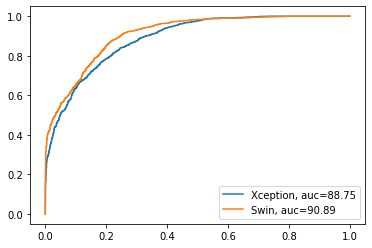

In [41]:
#xception dfdc
true_labels = []
predicted_labels = []
predicted_probs = []

for key, value in predictions.items():
    predicted_probs.append(value[0])
    true_labels.append(value[2])
    predicted_labels.append(value[1])
    
# y_pred_proba = predicted_probs
# y_test = true_labels
fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)
auc = metrics.roc_auc_score(y_test, y_pred_proba)
plt.plot(fpr,tpr,label="Xception, auc="+str(round(auc*100, 2)))
plt.plot(swinfpr,swintpr,label="Swin, auc="+str(round(swinauc*100, 2)))
plt.legend(loc=4)
# plt.axis('off')
plt.savefig("roc.png", bbox_inches='tight', pad_inches=0, dpi=300)
plt.show()


## Accuracy

In [11]:
from sklearn.metrics import accuracy_score

true_labels = []
predicted_labels = []
predicted_probs = []

for key, value in predictions.items():
    predicted_probs.append(value[0])
    true_labels.append(value[2])
    predicted_labels.append(value[1])
    
acc = accuracy_score(true_labels, predicted_labels)
acc

0.99925

# Confusion Matrix

In [33]:
from sklearn.metrics import confusion_matrix

true_labels = []
predicted_labels = []
predicted_probs = []

for key, value in predictions.items():
    predicted_probs.append(value[0])
    true_labels.append(value[2])
    predicted_labels.append(value[1])
    
confmtrx = confusion_matrix(true_labels, predicted_labels)
confmtrx

array([[2000,    0],
       [   3, 1997]], dtype=int64)

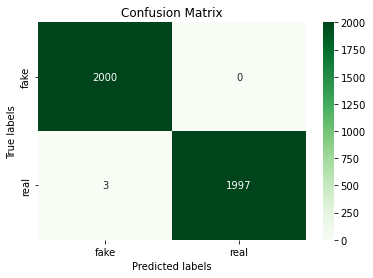

In [37]:
import seaborn as sns
import matplotlib.pyplot as plt     

ax= plt.subplot()
sns.heatmap(confmtrx, annot=True, fmt='g', ax=ax, cmap='Greens');  #annot=True to annotate cells, ftm='g' to disable scientific notation

# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['fake', 'real']); ax.yaxis.set_ticklabels(['fake', 'real']);

In [47]:
fieldnames = ['LogLoss','AUC','Accuracy']
with open(r'CrossEvaluationTestScores/Image/xception_trained_on_FakeAVCeleb_evaluated_on_FakeAVCeleb.csv', 'a', newline='') as csvfile:
    writer = csv.DictWriter(csvfile, fieldnames=fieldnames, lineterminator='\n',)
    writer.writeheader()
    writer.writerow({'LogLoss': logloss, 'AUC': auc, 'Accuracy': acc})

In [48]:
df = pd.read_csv('CrossEvaluationTestScores/Image/xception_trained_on_FakeAVCeleb_evaluated_on_FakeAVCeleb.csv')

In [60]:
logloss = list(df['ImagePath'])[-1]

'0.004654508359650931'

In [62]:
df

,ImagePath,ProbabilityScore,PredictedLabel,OriginalLabel
0,/Users/Sohail/Desktop/Research/PhD/Year1/NewDe...,0.999994993,1,1.0
1,/Users/Sohail/Desktop/Research/PhD/Year1/NewDe...,0.999952435,1,1.0
2,/Users/Sohail/Desktop/Research/PhD/Year1/NewDe...,0.999999046,1,1.0
3,/Users/Sohail/Desktop/Research/PhD/Year1/NewDe...,0.999985576,1,1.0
4,/Users/Sohail/Desktop/Research/PhD/Year1/NewDe...,0.99342984,1,1.0
...,...,...,...,...
3999,/Users/Sohail/Desktop/Research/PhD/Year1/NewDe...,0.004743636,0,0.0
4000,LogLoss,AUC,Accuracy,NaN
4001,0.004654508359650931,0.99999675,0.99925,NaN
4002,LogLoss,AUC,Accuracy,NaN


In [66]:
auc = list(df['ProbabilityScore'])[-1]
auc

'0.99999675'

In [65]:
acc = list(df['PredictedLabel'])[-1]
acc

'0.99925'